### import packages


In [1]:
## EDA Packages
import pandas as pd

In [2]:
#Data Visualising tools 
from matplotlib import pyplot as plt
import seaborn as sns 

In [3]:
#Hide Warnings
import warnings
warnings.filterwarnings('ignore')

In [4]:
# Load dataset
dataset = r"D:\Programming Stuffs\Data Science\NLP\Covid_19-Data-Analysis\covid19_tweets.csv"
data = pd.read_csv(dataset)

In [5]:
data.head()

,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,is_retweet
0,ᏉᎥ☻լꂅϮ,astroworld,wednesday addams as a disney princess keepin i...,2017-05-26 05:46:42,624,950,18775,False,2020-07-25 12:27:21,If I smelled the scent of hand sanitizers toda...,NaN,Twitter for iPhone,False
1,Tom Basile 🇺🇸,"New York, NY","Husband, Father, Columnist & Commentator. Auth...",2009-04-16 20:06:23,2253,1677,24,True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,NaN,Twitter for Android,False
2,Time4fisticuffs,"Pewee Valley, KY",#Christian #Catholic #Conservative #Reagan #Re...,2009-02-28 18:57:41,9275,9525,7254,False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump nev...,['COVID19'],Twitter for Android,False
3,ethel mertz,Stuck in the Middle,#Browns #Indians #ClevelandProud #[]_[] #Cavs ...,2019-03-07 01:45:06,197,987,1488,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me...,['COVID19'],Twitter for iPhone,False
4,DIPR-J&K,Jammu and Kashmir,🖊️Official Twitter handle of Department of Inf...,2017-02-12 06:45:15,101009,168,101,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirus...,"['CoronaVirusUpdates', 'COVID19']",Twitter for Android,False


In [6]:
# Check the size of data 
data.shape

(179108, 13)

## Task
+ Text
     + Text Preprocessing
     + Sentiment Analysis
     + Keyword Extraction
     + Entity Extraction

In [7]:
# Check the number of Columns
data.columns

Index(['user_name', 'user_location', 'user_description', 'user_created',
       'user_followers', 'user_friends', 'user_favourites', 'user_verified',
       'date', 'text', 'hashtags', 'source', 'is_retweet'],
      dtype='object')

In [8]:
# Checking for the datatype of each column
data.dtypes

user_name           object
user_location       object
user_description    object
user_created        object
user_followers       int64
user_friends         int64
user_favourites      int64
user_verified         bool
date                object
text                object
hashtags            object
source              object
is_retweet            bool
dtype: object

# Analyse the soure column

In [9]:
# Checking the sources of the tweets
data['source'].unique()

array(['Twitter for iPhone', 'Twitter for Android', 'Twitter Web App',
       'Buffer', 'TweetDeck', 'Twitter for iPad', 'Africa Newsroom',
       'Blood Donors India', 'TweetCaster for Android',
       'Alexander Higgins', 'IFTTT', 'Hootsuite Inc.', 'Sprout Social',
       'Sprinklr', 'assarofficial', 'IAMBLOG2TWITTER', 'CrowdControlHQ',
       'COVID19-Updates', 'EveryoneSocial', 'Dynamic Signal', 'Instagram',
       'TweetCaster for iOS', 'GlobalPandemic.NET', 'Venrap Radio',
       'HeyOrca', 'Twitter for Advertisers', 'Paper.li',
       'Twitter Media Studio', 'Twitter for Mac', 'dlvr.it',
       'Cheap Bots, Done Quick!', 'Prof. Shanku', 'LaterMedia',
       'SEMrush Social Media Tool', 'Twitterrific for iOS',
       "Sebastian's Twitter Bot", 'Threader_client', 'COVID19FactoidBot',
       'PwC UK SMART', 'tweet pro stiff', 'UK COVID-19 Alerts',
       'Resistbot Open Letters', 'preprint-alert', 'ContentStudio.io',
       'Peeping Moon', 'TweetAutomaticos', 'Orlo', 'AgoraPulse Ma

In [10]:
# Count_Values in the source column
data.source.value_counts()

Twitter Web App              56891
Twitter for Android          40179
Twitter for iPhone           35472
TweetDeck                     8543
Hootsuite Inc.                7321
                             ...  
DataBlogger                      1
Dear_Assistant                   1
OnlyPultCom                      1
Washington Square Parkerz        1
Radiology: AI app                1
Name: source, Length: 610, dtype: int64

In [11]:
# Get the top 10 of the source column
data['source'].value_counts().nlargest(10)

Twitter Web App        56891
Twitter for Android    40179
Twitter for iPhone     35472
TweetDeck               8543
Hootsuite Inc.          7321
Twitter for iPad        4336
Buffer                  2728
Sprout Social           1833
Instagram               1759
IFTTT                   1545
Name: source, dtype: int64

<function matplotlib.pyplot.show(close=None, block=None)>

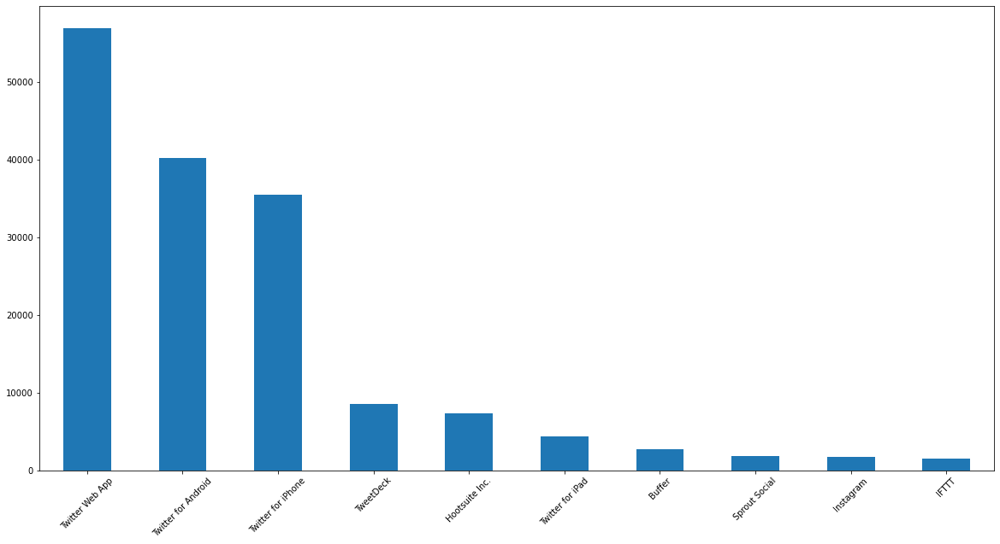

In [12]:
# Visualize the first 10 source columns
plt.figure(figsize=(20,10))
plt_data = data['source'].value_counts().nlargest(10).plot(kind='bar')
plt.xticks(rotation = 45)
plt.show


## tweetb Text Analysis

In [13]:
pip install neattext


Note: you may need to restart the kernel to use updated packages.


In [14]:
from neattext import functions as nfx

In [15]:
dir(nfx)

['BTC_ADDRESS_REGEX',
 'CURRENCY_REGEX',
 'CURRENCY_SYMB_REGEX',
 'Counter',
 'DATE_REGEX',
 'EMAIL_REGEX',
 'EMOJI_REGEX',
 'HASTAG_REGEX',
 'MASTERCard_REGEX',
 'MD5_SHA_REGEX',
 'MOST_COMMON_PUNCT_REGEX',
 'NUMBERS_REGEX',
 'PHONE_REGEX',
 'PoBOX_REGEX',
 'SPECIAL_CHARACTERS_REGEX',
 'STOPWORDS',
 'STOPWORDS_de',
 'STOPWORDS_en',
 'STOPWORDS_es',
 'STOPWORDS_fr',
 'STOPWORDS_ru',
 'STOPWORDS_yo',
 'STREET_ADDRESS_REGEX',
 'TextFrame',
 'URL_PATTERN',
 'USER_HANDLES_REGEX',
 'VISACard_REGEX',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__generate_text',
 '__loader__',
 '__name__',
 '__numbers_dict',
 '__package__',
 '__spec__',
 '_lex_richness_herdan',
 '_lex_richness_maas_ttr',
 'clean_text',
 'defaultdict',
 'digit2words',
 'extract_btc_address',
 'extract_currencies',
 'extract_currency_symbols',
 'extract_dates',
 'extract_emails',
 'extract_emojis',
 'extract_hashtags',
 'extract_html_tags',
 'extract_mastercard_addr',
 'extract_md5sha',
 'extract_numbers',
 'extr

In [16]:
data['text']

0         If I smelled the scent of hand sanitizers toda...
1         Hey @Yankees @YankeesPR and @MLB - wouldn't it...
2         @diane3443 @wdunlap @realDonaldTrump Trump nev...
3         @brookbanktv The one gift #COVID19 has give me...
4         25 July : Media Bulletin on Novel #CoronaVirus...
                                ...                        
179103    Thanks @IamOhmai for nominating me for the @WH...
179104    2020! The year of insanity! Lol! #COVID19 http...
179105    @CTVNews A powerful painting by Juan Lucena. I...
179106    More than 1,200 students test positive for #CO...
179107    I stop when I see a Stop\n\n@SABCNews\n@Izinda...
Name: text, Length: 179108, dtype: object

In [17]:
data['text'].iloc[2]


'@diane3443 @wdunlap @realDonaldTrump Trump never once claimed #COVID19 was a hoax. We all claim that this effort to… https://t.co/Jkk8vHWHb3'

### Noise to be Removed
+ mentions
+ hashtags
+ links
+ special characters
+ emojis

In [18]:
data.head()

,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,is_retweet
0,ᏉᎥ☻լꂅϮ,astroworld,wednesday addams as a disney princess keepin i...,2017-05-26 05:46:42,624,950,18775,False,2020-07-25 12:27:21,If I smelled the scent of hand sanitizers toda...,NaN,Twitter for iPhone,False
1,Tom Basile 🇺🇸,"New York, NY","Husband, Father, Columnist & Commentator. Auth...",2009-04-16 20:06:23,2253,1677,24,True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,NaN,Twitter for Android,False
2,Time4fisticuffs,"Pewee Valley, KY",#Christian #Catholic #Conservative #Reagan #Re...,2009-02-28 18:57:41,9275,9525,7254,False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump nev...,['COVID19'],Twitter for Android,False
3,ethel mertz,Stuck in the Middle,#Browns #Indians #ClevelandProud #[]_[] #Cavs ...,2019-03-07 01:45:06,197,987,1488,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me...,['COVID19'],Twitter for iPhone,False
4,DIPR-J&K,Jammu and Kashmir,🖊️Official Twitter handle of Department of Inf...,2017-02-12 06:45:15,101009,168,101,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirus...,"['CoronaVirusUpdates', 'COVID19']",Twitter for Android,False


In [19]:
data['extracted_hashtags'] = data['text'].apply(nfx.extract_hashtags)
data['extracted_hashtags']

0                                      []
1                                      []
2                              [#COVID19]
3                              [#COVID19]
4         [#CoronaVirusUpdates, #COVID19]
                       ...               
179103                       [#WearAMask]
179104                         [#COVID19]
179105                                 []
179106                         [#COVID19]
179107                                 []
Name: extracted_hashtags, Length: 179108, dtype: object

In [20]:
data[['hashtags','extracted_hashtags']] 

,hashtags,extracted_hashtags
0,NaN,[]
1,NaN,[]
2,['COVID19'],[#COVID19]
3,['COVID19'],[#COVID19]
4,"['CoronaVirusUpdates', 'COVID19']","[#CoronaVirusUpdates, #COVID19]"
...,...,...
179103,['WearAMask'],[#WearAMask]
179104,['COVID19'],[#COVID19]
179105,NaN,[]
179106,['COVID19'],[#COVID19]


In [21]:
# Data Cleaning
data['cleaned_tweet'] = data['text'].apply(nfx.remove_hashtags)

In [22]:
data[['text','cleaned_tweet']]

,text,cleaned_tweet
0,If I smelled the scent of hand sanitizers toda...,If I smelled the scent of hand sanitizers toda...
1,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,Hey @Yankees @YankeesPR and @MLB - wouldn't it...
2,@diane3443 @wdunlap @realDonaldTrump Trump nev...,@diane3443 @wdunlap @realDonaldTrump Trump nev...
3,@brookbanktv The one gift #COVID19 has give me...,@brookbanktv The one gift has give me is an ...
4,25 July : Media Bulletin on Novel #CoronaVirus...,25 July : Media Bulletin on Novel \n@kansa...
...,...,...
179103,Thanks @IamOhmai for nominating me for the @WH...,Thanks @IamOhmai for nominating me for the @WH...
179104,2020! The year of insanity! Lol! #COVID19 http...,2020! The year of insanity! Lol! https://t.c...
179105,@CTVNews A powerful painting by Juan Lucena. I...,@CTVNews A powerful painting by Juan Lucena. I...
179106,"More than 1,200 students test positive for #CO...","More than 1,200 students test positive for a..."


In [23]:
# Remove mentions
data['cleaned_tweet'] = data['cleaned_tweet'].apply(lambda x : nfx.remove_userhandles(x))
data['cleaned_tweet']


0         If I smelled the scent of hand sanitizers toda...
1         Hey     and   - wouldn't it have made more sen...
2               Trump never once claimed   was a hoax. W...
3           The one gift   has give me is an appreciatio...
4         25 July : Media Bulletin on Novel     \n      ...
                                ...                        
179103    Thanks   for nominating me for the     challen...
179104    2020! The year of insanity! Lol!   https://t.c...
179105      A powerful painting by Juan Lucena. It's a t...
179106    More than 1,200 students test positive for   a...
179107    I stop when I see a Stop\n\n \n \n \n \n \n \n...
Name: cleaned_tweet, Length: 179108, dtype: object

In [24]:
data[['text','cleaned_tweet']]

,text,cleaned_tweet
0,If I smelled the scent of hand sanitizers toda...,If I smelled the scent of hand sanitizers toda...
1,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,Hey and - wouldn't it have made more sen...
2,@diane3443 @wdunlap @realDonaldTrump Trump nev...,Trump never once claimed was a hoax. W...
3,@brookbanktv The one gift #COVID19 has give me...,The one gift has give me is an appreciatio...
4,25 July : Media Bulletin on Novel #CoronaVirus...,25 July : Media Bulletin on Novel \n ...
...,...,...
179103,Thanks @IamOhmai for nominating me for the @WH...,Thanks for nominating me for the challen...
179104,2020! The year of insanity! Lol! #COVID19 http...,2020! The year of insanity! Lol! https://t.c...
179105,@CTVNews A powerful painting by Juan Lucena. I...,A powerful painting by Juan Lucena. It's a t...
179106,"More than 1,200 students test positive for #CO...","More than 1,200 students test positive for a..."


In [25]:
# Remove links
data['cleaned_tweet'] = data['cleaned_tweet'].apply(nfx.remove_multiple_spaces)
data[['text','cleaned_tweet']]

,text,cleaned_tweet
0,If I smelled the scent of hand sanitizers toda...,If I smelled the scent of hand sanitizers toda...
1,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,Hey and - wouldn't it have made more sense to ...
2,@diane3443 @wdunlap @realDonaldTrump Trump nev...,Trump never once claimed was a hoax. We all c...
3,@brookbanktv The one gift #COVID19 has give me...,The one gift has give me is an appreciation f...
4,25 July : Media Bulletin on Novel #CoronaVirus...,25 July : Media Bulletin on Novel https://t.co...
...,...,...
179103,Thanks @IamOhmai for nominating me for the @WH...,Thanks for nominating me for the challenge. I ...
179104,2020! The year of insanity! Lol! #COVID19 http...,2020! The year of insanity! Lol! https://t.co/...
179105,@CTVNews A powerful painting by Juan Lucena. I...,A powerful painting by Juan Lucena. It's a tr...
179106,"More than 1,200 students test positive for #CO...","More than 1,200 students test positive for at ..."


In [26]:
data ['cleaned_tweet'] = data['cleaned_tweet'].apply(nfx.remove_urls)

In [27]:
# Remove punctuations
data['cleaned_tweet'] = data['cleaned_tweet'].apply(nfx.remove_punctuations)

In [28]:
data[['text','cleaned_tweet']]

,text,cleaned_tweet
0,If I smelled the scent of hand sanitizers toda...,If I smelled the scent of hand sanitizers toda...
1,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,Hey and wouldnt it have made more sense to ha...
2,@diane3443 @wdunlap @realDonaldTrump Trump nev...,Trump never once claimed was a hoax We all cl...
3,@brookbanktv The one gift #COVID19 has give me...,The one gift has give me is an appreciation f...
4,25 July : Media Bulletin on Novel #CoronaVirus...,25 July : Media Bulletin on Novel
...,...,...
179103,Thanks @IamOhmai for nominating me for the @WH...,Thanks for nominating me for the challenge I n...
179104,2020! The year of insanity! Lol! #COVID19 http...,2020 The year of insanity Lol
179105,@CTVNews A powerful painting by Juan Lucena. I...,A powerful painting by Juan Lucena Its a trib...
179106,"More than 1,200 students test positive for #CO...",More than 1200 students test positive for at m...


### Sentiment Analysis

In [30]:
from textblob import TextBlob

In [36]:
def get_sentiment(text):
    blob =TextBlob(text)
    sentiment_polarity = blob.sentiment.polarity
    sentiment_subjectivity = blob.sentiment.subjectivity
    if sentiment_polarity >0:
        sentiment_label = "Positive"
    elif sentiment_polarity < 0:
        sentiment_label = "Negative"
    else:
        sentiment_label = "Neutral"
    
    result = {"polarity":sentiment_polarity,"subjectivity":sentiment_subjectivity,"sentiment":sentiment_label}
    return result 


In [38]:
example_1 = data['cleaned_tweet'].iloc[0]

In [39]:
get_sentiment(example_1)

{'polarity': -0.25, 'subjectivity': 0.25, 'sentiment': 'Negative'}

In [41]:
data['sentiment_results'] = data['cleaned_tweet'].apply(get_sentiment)

In [42]:
data['sentiment_results']

0         {'polarity': -0.25, 'subjectivity': 0.25, 'sen...
1         {'polarity': 0.5, 'subjectivity': 0.5, 'sentim...
2         {'polarity': 0.0, 'subjectivity': 0.0, 'sentim...
3         {'polarity': 0.0, 'subjectivity': 0.3571428571...
4         {'polarity': 0.0, 'subjectivity': 0.0, 'sentim...
                                ...                        
179103    {'polarity': 0.2, 'subjectivity': 0.2, 'sentim...
179104    {'polarity': 0.8, 'subjectivity': 0.7, 'sentim...
179105    {'polarity': 0.3, 'subjectivity': 1.0, 'sentim...
179106    {'polarity': 0.26325757575757575, 'subjectivit...
179107    {'polarity': 0.0, 'subjectivity': 0.0, 'sentim...
Name: sentiment_results, Length: 179108, dtype: object

In [44]:
pd.json_normalize(data['sentiment_results'].iloc[1])

,polarity,subjectivity,sentiment
0,0.5,0.5,Positive


In [46]:
# Join then normalized result with the original data
df = data.join(pd.json_normalize(data['sentiment_results']))
df.head()

,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,is_retweet,extracted_hashtags,cleaned_tweet,sentiment_results,polarity,subjectivity,sentiment
0,ᏉᎥ☻լꂅϮ,astroworld,wednesday addams as a disney princess keepin i...,2017-05-26 05:46:42,624,950,18775,False,2020-07-25 12:27:21,If I smelled the scent of hand sanitizers toda...,NaN,Twitter for iPhone,False,[],If I smelled the scent of hand sanitizers toda...,"{'polarity': -0.25, 'subjectivity': 0.25, 'sen...",-0.25,0.250000,Negative
1,Tom Basile 🇺🇸,"New York, NY","Husband, Father, Columnist & Commentator. Auth...",2009-04-16 20:06:23,2253,1677,24,True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,NaN,Twitter for Android,False,[],Hey and wouldnt it have made more sense to ha...,"{'polarity': 0.5, 'subjectivity': 0.5, 'sentim...",0.50,0.500000,Positive
2,Time4fisticuffs,"Pewee Valley, KY",#Christian #Catholic #Conservative #Reagan #Re...,2009-02-28 18:57:41,9275,9525,7254,False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump nev...,['COVID19'],Twitter for Android,False,[#COVID19],Trump never once claimed was a hoax We all cl...,"{'polarity': 0.0, 'subjectivity': 0.0, 'sentim...",0.00,0.000000,Neutral
3,ethel mertz,Stuck in the Middle,#Browns #Indians #ClevelandProud #[]_[] #Cavs ...,2019-03-07 01:45:06,197,987,1488,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me...,['COVID19'],Twitter for iPhone,False,[#COVID19],The one gift has give me is an appreciation f...,"{'polarity': 0.0, 'subjectivity': 0.3571428571...",0.00,0.357143,Neutral
4,DIPR-J&K,Jammu and Kashmir,🖊️Official Twitter handle of Department of Inf...,2017-02-12 06:45:15,101009,168,101,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirus...,"['CoronaVirusUpdates', 'COVID19']",Twitter for Android,False,"[#CoronaVirusUpdates, #COVID19]",25 July : Media Bulletin on Novel,"{'polarity': 0.0, 'subjectivity': 0.0, 'sentim...",0.00,0.000000,Neutral


In [47]:
# Drop the sentiment_results column
df = df.drop('sentiment_results',axis = 1)

In [48]:
df.head()

,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,is_retweet,extracted_hashtags,cleaned_tweet,polarity,subjectivity,sentiment
0,ᏉᎥ☻լꂅϮ,astroworld,wednesday addams as a disney princess keepin i...,2017-05-26 05:46:42,624,950,18775,False,2020-07-25 12:27:21,If I smelled the scent of hand sanitizers toda...,NaN,Twitter for iPhone,False,[],If I smelled the scent of hand sanitizers toda...,-0.25,0.250000,Negative
1,Tom Basile 🇺🇸,"New York, NY","Husband, Father, Columnist & Commentator. Auth...",2009-04-16 20:06:23,2253,1677,24,True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it...,NaN,Twitter for Android,False,[],Hey and wouldnt it have made more sense to ha...,0.50,0.500000,Positive
2,Time4fisticuffs,"Pewee Valley, KY",#Christian #Catholic #Conservative #Reagan #Re...,2009-02-28 18:57:41,9275,9525,7254,False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump nev...,['COVID19'],Twitter for Android,False,[#COVID19],Trump never once claimed was a hoax We all cl...,0.00,0.000000,Neutral
3,ethel mertz,Stuck in the Middle,#Browns #Indians #ClevelandProud #[]_[] #Cavs ...,2019-03-07 01:45:06,197,987,1488,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me...,['COVID19'],Twitter for iPhone,False,[#COVID19],The one gift has give me is an appreciation f...,0.00,0.357143,Neutral
4,DIPR-J&K,Jammu and Kashmir,🖊️Official Twitter handle of Department of Inf...,2017-02-12 06:45:15,101009,168,101,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirus...,"['CoronaVirusUpdates', 'COVID19']",Twitter for Android,False,"[#CoronaVirusUpdates, #COVID19]",25 July : Media Bulletin on Novel,0.00,0.000000,Neutral


In [50]:
# Get the count for sentiments
df['sentiment'].value_counts()

Neutral     75490
Positive    74154
Negative    29464
Name: sentiment, dtype: int64

<AxesSubplot:xlabel='sentiment', ylabel='count'>

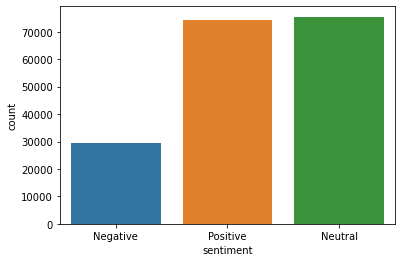

In [53]:
# Visualize the sentiment results
sns.countplot(df['sentiment'])

# Keyword Extraction
+ For Positive and Negative Sentiments
+ General


In [65]:
positive_sentiment = df[df['sentiment'] == 'Positive']['cleaned_tweet']

In [66]:
neutral_sentiment = df[df['sentiment'] == 'Neutral']['cleaned_tweet']

In [67]:
negative_sentiment = df[df['sentiment'] == 'Negative']['cleaned_tweet']

In [68]:
positive_sentiment

1         Hey and  wouldnt it have made more sense to ha...
6         How Will Change Work in General (and recruitin...
8                 Praying for good health and recovery of  
12        👋🏻 — no one will be safe from until everyone i...
13        Lets all protect ourselves from Its real and t...
                                ...                        
179096    We were really bummed we couldn’t cop one of t...
179103    Thanks for nominating me for the challenge I n...
179104                       2020 The year of insanity Lol 
179105     A powerful painting by Juan Lucena Its a trib...
179106    More than 1200 students test positive for at m...
Name: cleaned_tweet, Length: 74154, dtype: object

In [69]:
# Remove Stopwords and convert to Tokens
positive_sentiment_list = positive_sentiment.apply(nfx.remove_stopwords).tolist()

In [70]:
negative_sentiment_list = negative_sentiment.apply(nfx.remove_stopwords).tolist()

In [71]:
neutral_sentiment_list = neutral_sentiment.apply(nfx.remove_stopwords).tolist()

In [73]:
positive_sentiment_list

['Hey wouldnt sense players pay respects A…',
 'Change Work General (and recruiting specifically) via/',
 'Praying good health recovery',
 '👋🏻 — safe safe commit ensure…',
 'Lets protect real numbers climbing fast Continent Lets n…',
 'Second wave Flandersback',
 'COVID Update: infection rate Florida following natural curve experts predicted initial cu…',
 'Good Patriots Volunteer Election Judge Polls open without…',
 'comprehensive review amp Analysis: key ways WASH help reduce transmission…',
 'crosses 2 lakh mark 150055 ppp recovered far positive today 6988/total…',
 'Actor father MrGKReddy tested positive 15/20 days s…',
 'safe place visit guests said hotel meticulous applying hand sanitation als…',
 'CEO live WSU talking “The effects Covid19 students”…',
 'Actionables healthy recovery',
 'understood hadnt missed meeting In…',
 'released new podcast episodes week: Technology Platforms Conduct Telehealth Visits C…',
 'reports 1142 positive cases 29 deaths Saturday Death toll rises 3

In [75]:
# Remove emojis
positive_sentiment_list = positive_sentiment.apply(nfx.remove_emojis)
neutral_sentiment_list = neutral_sentiment.apply(nfx.remove_emojis)
negative_sentiment_list = negative_sentiment.apply(nfx.remove_emojis)

In [77]:
# Tokenization
for line in positive_sentiment_list:
    for token in line.split():
        print(token)

Hey
and
wouldnt
it
have
made
more
sense
to
have
the
players
pay
their
respects
to
the
A…
How
Will
Change
Work
in
General
(and
recruiting
specifically)
via/
Praying
for
good
health
and
recovery
of
—
no
one
will
be
safe
from
until
everyone
is
safe
Will
you
commit
to
ensure…
Lets
all
protect
ourselves
from
Its
real
and
the
numbers
are
climbing
up
fast
in
the
Continent
Lets
n…
Second
wave
of
in
Flandersback
to
more
again
COVID
Update:
The
infection
rate
in
Florida
is
following
the
natural
curve
that
experts
predicted
if
the
initial
cu…
Good
Patriots
Call
to
Volunteer
to
be
an
Election
Judge
Polls
cannot
open
without…
The
first
comprehensive
review
of
amp
Analysis:
key
ways
in
which
WASH
can
help
reduce
transmission…
crosses
2
lakh
mark
and
150055
ppp
has
recovered
so
far
positive
today
6988/total…
Actor
and
his
father
MrGKReddy
tested
positive
for
15/20
days
back
While
s…
A
safe
place
to
visit
Here
is
what
our
guests
said
The
hotel
were
meticulous
in
applying
hand
sanitation
and
als…
Our
C

patients
recovered/discharged/migrated
and
29
deaths
today
There
are…
Great
to
be
with
yesterday
on
Yes
is
the
real
We
are
pleased
to
announce
the
inclusion
of
the
Virology
Laboratory
University
of
Nigeria
Teaching
Hospital
Enugu…
Great
tips
from
our
friends
at
Does
a
football
jersey
count
First
MD
in
the
NFL
opting
out
to
care
for
others
Pandemic
could
push
more
N
Carolina
families
to
home
school
|
Miami
Herald
Government
(Tabla
player)
of
most
of
the
countries
during
Since
everything’s
changing
with
can
we
start
playing
this
version
of
Sweet
Caroline
at
games
Th…
I
use
many
sources
for
my
guidance
I
do
use
the
CDC
for
some
things
but
I
have
to
fact
check
their
sour…
It
so
brilliant
to
see
people
awake
and
not
accepting
the
mainstream
narrative
100%
feeling
good
Sounds
like
a
soul
song
Thanks
⁦
for
stressing
personal
responsibility
with
a
limiting
the
spread
of
This
development
is
very
worrying
and
will
continue
to
be
monitored
very
closely
by
the
RKI
A
further
exacerbati…
A
new
begin

As…
Peace
is
better
then
holding
a
grudge
Life
is
too
short
I
knew
could
not
keep
it
up
In
more
ways
than
one
New
preprint:
COVID19
Vulnerability
of
Transgender
Women
With
and
Without
HIV
Infection
in
the
Eastern
an…
Washing
your
hands
is
one
of
the
best
ways
to
protect
yourself
from
But
millions
of
people
in
refugee
c…
The
latest
update
of
(
in
the
New
preprint:
Development
of
a
quantumdot
lateral
flow
immunoassay
strip
based
portable
fluorescence
smar…
First
trip
to
the
shops
in
10
days
and
first
since
the
mandatory
mask
wearing
became
lawseen
more
people
wearin…
How
Will
Change
Work
in
General
(and
recruiting
specifically)
via/
New
preprint:
Presence
of
SARSCoronavirus2
in
sewage
More
and
more
singleuse
masks
gloves
amp
bottles
of
sanitizer
are
ending
up
on
the
streets
in
the
seas
amp
among
wil…
The
2020
submission
deadline
for
amp
solutions
is
July
31st
The
top
Call
for…
Actor
and
his
father
tested
positive
for
15/20
days
back
While
s
fat…
I’m
done
with
you
Just
more
lies
and
propa

kids
at
the
height…
Actor
And
His
Father
MrGKReddy
Tested
positive
For
15/20
Days
Back
While
s…
Actor
and
his
father
MrGKReddy
tested
positive
for
15/20
days
back
While
s…
Such
beautiful
chaos
My
midsummer
garden
is
quite
the
metaphor
for
life
at
the
moment
So
many
things
to
be
gratef…
7100
Americans
confirmed
dead
from
just
on
Friday
The
community
is
the
best
part
of
a
country
I
love
my
country
Covid
19
helping
team
Love
you
all
Stay
safe
Spe…
Dont
forget
that
the
openly
admits
that
they
intentionally
misconstrue
the
numbers
right
here
on…
just
held
the
online
launch
of
the
New
with
lots
of
new
features
youll
definitely
need
check
it…
featured
in
this
video
our
paper
on
high
covertness
amp
high
transmissibility
of
COVID19
high
chanc…
I
have
a
joke
about
perfumes
but
you
may
not
perceive
it
the
right
way
You
started
wearing
masks
after
and
people
are
wearing
them
for
many
years
puts
so
much
stress
on
our
lives
self
care
is
extremely
important
think…
Societal
upheaval
during
the
COVID19

Characteristics
of
Covid
19
Subscribe
for
more
videos
on
health
and
medicine
:…
survivor
who
had
most
of
his
fingers
amputated:
‘This
can
happen
to
you’
“It
sho…
Some
have
pointed
out
the
“low
death
rate”
in
Oman
As
I
understand
deaths
lag
new
cases
by
about
a
month
(someone…
Actor
and
his
father
MrGKReddy
tested
positive
for
15/20
days
back
While
s…
Worth
a
share
More
than
700000
new
infections
in
three
days
reloads:
Graphics
show
sad
records
they
have
their
re…
No
return
to
‘old
normal’
says
health
chief
as
cases
top
15
million
So
much
opportunity
that
brought
to
right
wrongs
is
being
lost
by
politicians
eager
to
return
to
a
normal…
Your
belief
in
GOD
or
a
higher
power
does
not
transfer
to
good
morals
If
ONLY
it
was
that
easy
Morality
is
a
cho…
Brilliant
minds
giving
us
an
insight
into
post
Worth
a
read
just
for
the
reality
check
and
reminder…
Stop
spreading
deny
and
lies
Covid
is
spiking
in
many
states
Amercians
are
banned…
Actor
and
his
father
MrGKReddy
tested
positive
for
15/20
da

35
test
positive
for
in
Cuttack
city
They
HAD
to
see
this
coming
Cult
of
Personality
was
attractive
AT
A
DISTANCE…
Its
reasonable
Having
lived
in
China
I
have
never
considered
him
their
leader
More
like
their
cap…
The
Arts
and
cultural
industries
are
worth
far
more
to
the
economy
and
far
more
enjoyable
than
fish
Why
arent
t…
Hi
—
may
trigger
a
global
food
crisis
and
push
many
more
people
into…
—
no
one
will
be
safe
from
until
everyone
is
safe
Will
you
commit
to
ensure…
Cancel
neet
exam
2020
this
is
a
critical
situation
at
this
moment
conducting
exam
at
safe
way
is
not
possible
stude…
“raids
by
the
authorities
pushed
prices
slowly
down
and
more
production
units
had
been
set
up
as
major
textile
fir…
Covid
has
caught
many
by
surprise
and
some
asymptomatic
Our
findings
over
the
last
few
weeks
have
been
quite
an
ey…
in
There
is
a
total
of
726
confirmed
deaths
from
Xavi
is
recovering
in
isolation
after
testing
positive
for
Its
reasonable
Having
lived
in
China
I
have
never
considered
him
thei

has
trea…
PUERTO
RICO
COVID19
DAILY
UPDATE:
July
25
2020
244
new
confirmed
cases
(PCR
tests)
294
new
possible
cases…
Have
a
nice
trip
See
you
next
fall
As
they
say
Soak
the
rich
The
spokesperson
for
Ministry
of
Health:
Since
yesterday
2316
new
confirmed
cases
of
have
been
id…
Didn’t
the
Lancet
find
indicators
that
may
have
been
more
prevalent
in
China
way
sooner
than
reported
Have
been
busy
Speeded
up
my
rate
of
work
and
finished
the
enzyme
playlist
Am
Continuing
project
Hopin…
Top
10
causes
of
death
in
US
(annual
average)
vs
(so
far)
Heart
disease:
647K
Cancer:
599K
Accidents:
1…
When
take
IV
to
remember
old
times
but
check
that
here
you
must
also
fight
against
The
promask
amp
antimask
is
incredible
to
see
No
one
dares
back
down
or
compromise
Only
way
it
ends
is
for
nonm…
flood
situation
still
worsening
100
people
die
so
far
32m
marooned
DAILY
SNAPSHOT:
Total
Cases
inched
towards
239000
at
7:00
pm
with
over
4400
New
Cases
reported
across
the
region…
Leading
health
officials
in
have
wa

is
helping
not
just
her
own
village
m…
Thinking
about
changing
your
job
but
want
something
thatll
fit
around
your
commitments
PCB
Care
will
find
a
role…
This
is
actually
more
deadly
and
important
then
the
virus
itself
people
just
dont
have
any
compassionate
feelings…
amp
tracing
will
help
break
the
chain
of
transmission
of
Successful
contact
tracing
relie…
Early
data
shows
the
experimental
vaccine
developed
by
amp
is
safe
and
triggers
an…
Claire
Hanna:
Why
we
must
act
now
to
help
the
millions
facing
deadly
threat
of
virus
in
worlds
most
fragile
states…
The
total
number
of
positive
cases
of
in
reaches
34178
Here
are
the
of
Rajast…
This
is
a
whole
new
level
of
or
buy
one
of
these
FREE
DriveThru
Testing
in
DeSoto
County
TODAY
*10am2pm
*Landers
Center
in
Southaven
*You
must
have
symp…
This
is
a
great
thread
about
what
you
could
expect
if
you
get
Top
10
of
worst/useless
gifts
for
2020:
10
Year
planner
9
Work
your
way
up
Live
Press
briefing
A
few
days
ago
following
the
Stars
League
protocol


White
House
Tentatively
Agree
On
Part
Of
Coronavirus
Aid
Bill
READ
MORE:
New
account
Let’s
follow
each
other
and
will
follow
back
everyone
A
pestilence
is
sweeping
our
land
The
gods
are
pissed
Its
time
to
take
this
situation
into
our
own
hands
with
an…
Why
waste
billions
on
annual
vaccinations
that
serve
limited
purpose
when
that
money
could
be
better
spent
giving
e…
Heres
a
thought
has
a
9970%
survival
rate
amp
generally
only
affects
those
that
are
older
or
have
underly…
First
posted
01/01/2020
Britains
Death
Knell
Peter
Hitchens
Mandating
the
wearing
of
face
masks
is
a
step
too
far
amp
people
who
wear
face
masks
are
making
a…
Insight
from
weekly
summary
touches
on
all
the
key
points
needed
Masterful
Thanks
for
your…
The
BBC
should
not
be
allowing
this
propaganda
without
having
a
credible
person
challenging
Johnsons
dissembling
w…
Update
of
the
day
1021
New
cases
have
been
reported
so
far
on
24th
July
1782
cases
of
23r…
Filmmaker
and
elite
marathon
runner
Alexi
Pappas
wants
to
make
su

5
new
deaths
in
the
United
States
[11:36
GMT]
Romania
reports
1284
new
cases
setting
a
new
daily
record
along
with
24
new
recoveries…
A
full
days
work
🤫
Enjoying
the
spread
of
stories
on
You
can
read
about
as
well
as
really
thoughtful
analysis
of…
Hi
KOT
Im
a
fashion
designer
and
blogger
I
just
launched
new
merch
for
my
brand
tshirts
bucket
hats
face
masks…
We
hope
you
can
enjoy
the
summer
safely
Not
sure
how
Check
out
the
government
advice
here:…
Iran
reports
2316
new
cases
along
with
195
new
deaths
Despite
the
government
telling
us
to
eat
out
to
help
out
many
are
still
scared
to
go
to
a
restaurant
This
new
te…
Despite
the
government
telling
us
to
eat
out
to
help
out
many
are
still
scared
to
go
to
a
restaurant
This
new
te…
Despite
the
government
telling
us
to
eat
out
to
help
out
many
are
still
scared
to
go
to
a
restaurant
This
new
te…
Despite
the
government
telling
us
to
eat
out
to
help
out
many
are
still
scared
to
go
to
a
restaurant
This
new
te…
Despite
the
government
telling
us
to
e

I
woke
up
to
148492
dead
from
Now
tell
me
how
you
think
thats
winning
Update
of
the
day
1021
New
cases
have
been
reported
so
far
on
24th
July
1782
cases
of
23r…
Yesterday
the
recorded
its
highest
number
of
new
cases
of
In
fact
it
is
the
highest
number
of
new…
Are
We
in
the
UK
They
Dont
have
as
many
cases
of
Because
they
have
their
Sht
together
unlike
the
US
The
term
bc
will
have
a
whole
new
meaning
What
and
trust
a
tory
lol
enjoy
the
last
days
of
the
union
Live
Updates
From
SA
Farmer
Ntate
Mthimkhulu
addressing
at
the
Handover
ceremony
in
Pretoria
SA
Ntate
Mthimkhulu…
Update
of
the
day
1021
New
cases
have
been
reported
so
far
on
24th
July
1782
cases
of
23r…
Safety
first
Our
son
will
now
wash
his
hands
when
asked
because
of
ABA
Teaching
self
care
is
absolutely
health
c…
confirmed
an
additional
513
cases
of
in
the
country
today
raising
the
tally
of
infec…
Joke
of
the
year
Uganda
has
recovered
its
first
covid
19
death
today
BUSINESS:
Wall
Street
down
after
worldwide
slide
gold
at
record
h

to
over
1336
lakh
death
toll
at
31358
A
look
at
statewise
tall…
Highly
Important:
The
network
of
food
banks
is
working
nonstop
to
feed
every
family
they
can
during…
If
you
cover
your
mouth
when
you
sneeze
in
publicwearing
a
mask
is
the
same
principle
Respectfully
covering
you…
Someone
can
explain
to
me
this:
Why
if
you
have
been
exposed
to
a
positive
COVID19
case
but
you
dont
have
the
v…
NTDC
Successfully
Installed
600
MVA
Transformer
at
500
kV
Grid
Station
Yousafwala
Sahiwal
The
latest
Life
Chronic
Pain
amp
Autoimmune
Systemic
Diseases
amp
Dementia®
Thanks
to…
What
most
Irish
people
know
in
their
hearts
is
you
arent
the
least
bit
credible
and
are
preying
on
our
n…
tested
positive
did
assist
him
this
time
(le
Xavi:
but
Messi
deserved
it
more)
Dr
Rashid
Buttar
Full
Disclosure
From
INSIDE|
HR
6666
IS
COMING
Another
Agency
falls
to
Trump
The
fact
is
that
children
1019
are
the
age
group
most
likely
to
bring
coro…
Pretty
much
sums
it
up
right
now
“Where
are
we
going”
said
Pooh
“Nowhere”
sai

that
th…
O
LORD
let
every
soul
under
the
captivity
of
the
devil
be
delivered
right
now
(Isaiah
49:25)
Covir
is
an
innovative
and
profitable
project
OCTOPUS
BIOSAFETY
IS
A
mobile
intelligent
fully
autonomous
and
mod…
Is
being
a
vegan/vegetarian
good
for
the
planet
Link
In
Bio
The
new
normal
It
took
4
million
cases
for
to
just
pretend
he
is
pivoting
and
give
us
more
lip
service…
Speaking
of
education
I
will
rather
financial
education
Speaking
of
a
good
teacher
I
will
rather
say
experience…
Thanks
to
Pakistan
for
providing
free
of
cost
testing
kits
for
COVID19
Interesting
development
said
that
its
vaccine
candidate
will
be
a
public
benefit
of…
Read
this
Journal
for
Clinical
Studies
article
for
recent
guidance
operational
processes
amp
best
practices
designed…
Health
Ministry
spokeswoman
Sima
Sadat
Lari
said
on
Saturday
that
some
195
more
Iranians
have
died
from…
See
the
latest
figures
in
the
Chipping
Campden
area
here
we
are
ple…
How
many
of
those
deaths
are
truly
funny
how
the
TB
deaths


to
thriving
i…
Wake
up
to
good
music
WHO
IS
MONST3R
EP
by
MONST3R
via
the
app
not
bad
for
a
passing
fad
driven
by
people’s
inability
to
budget
I
think
you
used
words
to
that
aff…
|
The
number
of
cases
in
Goa
rose
to
4540
as
on
July
24
Update
on
newly
detected
amp
cured
cases
in
the
last
24
hrs
under
the
area
Hello
Our
weekly
live
stream
is
out
where
we
discuss
everything
Backend
Development
Todays
topic:
Int…
A
Weekend
Special
While
there
is
a
big
buzz
around
digital
adoption
by
Indian
necessitated
by
the
disrupt…
65
new
cases
of
were
detected
in
the
last
24
hours
in
the
district
of
which
six
are…
We
were
on
a
very
emportent
with
wonderful
awesome
potential
sponsors
stay
tuned
for
more
information
Boris
Johnson’s
antiobesity
thing
has
nothing
to
do
with
a
hospital
bed
epiphany
he
had
while
apparently
fighting…
Should
we
not
be
implementing
mandatory
testing
at
from
high
risk
countries
Deaths
Toll
Rises
in
Nigeria
591
New
Case
Re
The
refuseniks
about
masks
appear
incredibly
loud
and
pro

himself…
from
The
New
Statesman
magazine
Wow
You
need
to
listen
to
this
Is
life
fair
to
some
and
unfair
to
others
Happy
One
Year
Anniversary
with
your
fantastic
hotspot
barblendnl
dear
valypintiuc
and
jorgepessanha
See
you
tonig…
Yea
I
know
it’s
early
and
only
a
few
thousand
people
have
checked
in
on
the
App
but
this
is
the
first
time
I
ha…
Wondering
where
to
get
PPE
gears
You
wait
for
ends
here
We
offer
reusable
at
the
most
costeffective
p…
Get
our
tools
from
our
Website
More
contact
details
on
our
Bio
Prices
fro…
The
man
who
admits
to
not
understanding
soon
enough
having
missed
the
first
5
to
dis…
We
will
hear
more
from
gov
officials
that
UK
could
have
done
better
in
early
days
of
I
dont
buy
the
exc…
Oman
reports
1067
new
cases
along
with
1054
new
recoveries
Probably
even
when
there
isnt
a
pandemic
on
the
*actual*
population
is
much
higher
due
to
illega…
Yup
elections
in
are
done
so
w
dont
have
to
pretend
it
is
getting
better
with
584
new
cases
toda…
Every
principled
person
with
a
br

says
Join
him
in
pledging
solidar…
Bureau
of
Corrections
spokesperson
Gabriel
Chaclag
refutes
reports
high
profile
inmate
Raymond
Domi…
There
are
now
more
‘I
Miss
You’
hearts
available
in
my
Send
a
smile
and
hug
to
someone
you
haven’t
seen
f…
TRACK
OUT
NOW
Happy
and
proud
to
share
my
new
hit
Check
it
out
on
Cabinet
Secretary
reviews
the
management
of
in
9
States
with
a
high
active
caseload
Advises
Telangana
An…
Hatutachoka
kukukumbusha
ukeep
safe
wear
your
mask
properly
maintain
social
distance
Frequently
w…
More
than
15
crore
samples
tested
so
far:
v…
It
feels
like
its
over:
Psychology
prof
explains
rise
in
COVID19
among
young
people
|
|
Yes
Back
again
tonight
For
everyone
join
me
for
my
from
8
till
9pm
More
love
LR…
The
Philippine
foreign
service
posts
today
reported
31
new
confirmed
cases
in
the
Americas
Asia
and
the
P…
Follow
us
for
this
and
more
Governments
losing
support
for
their
handling
of
COVID19:
sur…
Get
my
art
printed
on
awesome
products
Support
me
at
Redbubble
or
not
the


can
you
make
sure
ALL
listene…
Okay
whos
up
for
a
backyard
zombie
invasion
Looks
like
were
on
our
own
The
need
for
clean
water
amp
soap
couldn’t
be
more
urgent
Billions
of
people
around
the
world
are
facing
wi…
Karnataka
High
Court
in
its
recent
judgement
said
Welfare
Of
Law
Students
Is
Also
A
Matter
Of
Public
Interest
As
F…
When
exploited
to
rip
up
the
contracts
of
42k
loyal
staff
they
thought
they
had
the
upper…
Swedens
plan
to
restart
the
economy
Find
out
more
about
our
transformation
maps:…
Dozens
face
legal
action
for
changing
test
results
to
enter
Abu
Dhabi
in
9615
new
cases
278
deaths
reported
total
tally
crosses
35
lakh
mark
|
Up…
NEW
Research:
Treatment
with
allogeneic
cell
therapy
showed
clinical
improvement
in
70%
of
patients…
FREE
SUPPORT
FOR
BUSINESSES
in
who
are
having
to
restructure
because
of
Get
the
best
suppor…
Win
$195B
“Warp
Speed”
Order
for
via
For
the
first
time
a
record
number
of
more
than
420000
tests
conducted
in
a
single
day
With
420898
s…
Many
concerns
in
thi

I
have
donated
most
of
my
Retire…
A
huge
thanks
to
Monty
Devchand
from
Laxmi
Cash
amp
Carry
in
for
going
the
extra
mile
amp
having
my
shopping
d…
Ive
been
very
di…
591
New
Cases
Recorded
In
Nigeria
As
Total
Cases
Approaches
40000
Mark
update
New
cases
14
Total
confirmed
cases
1103
New
samples
tested
2488
Total
tested
258…
Start
with
“Why”
+
innovation
=
long
term
sustainable
healthcare
Fostering
the
right
organ…
In
8
new
deaths
were
reported
in
last
24
hours
Info
from
Dont
book
anything
if
Lyinair
mess
up
they
dont
refund
If
they
clean
as
well
as
refund
youll
get…
IN
THE
PHILIPPINES
Siquijor
logged
its
first
coronavirus
cases
With
this
only
4
provinces
in
the
countr…
I
see
that
have
now
incorporated
in
their
storylines
It
was
great
but
the
time…
Good
read
on
creative
industries
the
Caribbean
and
Key
areas
that
have
been
flagged
tend
to
lean
toward…
12
new
death
cases
of
have
been
recorded
This
brings
the
total
number
of
deaths
in
the
Sultanate
to
371…
Go
Headlines:
Of
The
Hour
cases
cr

list
of
new
cases
as
announces
591
new
cases
in
18
states
meanwhile
recoveries
ris…
Wont
lift
lockdown
just
to
address
economic
concerns:
Maharashtra
CM
Uddhav
Thacke…
Oyo
tops
list
of
new
cases
as
announces
591
new
cases
in
18
states
meanwhile
recoveries
ris…
tally
crosses
1000
mark
with
65
new
cases
Governments
are
fast
losing
support
for
their
handling
of
the
outbreak
from
a
public
that
wi…
India
has
recently
started
with
Human
Trials
of
vaccine
Making
vaccine
available
to
everyone
will
take
co…
Here
is
an
excellent
video
about
what
it
will
take
for
us
to
reach
“Herd
Immunity”
for
(
The
Centric
Lab
podcast
is
now
available
on
Check
out
the
latest
show
where
the
team
came
togeth…
The
Philippines
reports
2019
new
cases
along
with
20
new
deaths
I
can
forgive
Tom
Hanks
for
catching
I
am
less
forgiving
for
his
role
in
Full
attendance
will
be
introduced
during
the
third
and
last
phase
in
all
schools
and
at
all
levels
by
September…
New
COVID19
Data
at
20200725
04:30:01
am
EDT
Our
team
of
6

now
on
in
covid19
free
New
Zealand
Pity
covid19
invested
south
africa
will
n…
I
find
it
super
funny
to
hear
say
repeatedly
that
no
one
could
have
predicted
Anyone
know
a
reputable
company
in
London
offering
24
turnaround
on
COVID19
tests
Dont
have
any
symptoms
purely…
UPDATE:
Three
more
PCOO
employees
test
positive
for
total
now
at
13
|
via…
Here
is
a
graph
of
the
cases
in
Austria
Notice
how
we
got
it
quickly
under
control
Masks
Notice
how
it…
amp
are
leaders
in
the
simplest
yet
most
fashionable
amp
sustainable
Apparel
Accessories…
A
documentary
on
“my
75
days
lockdown
journey
“
An
inspiring
story
Tell
me
you
love
me
even
if
its
a
lie
I
follow
back
and
try
to
reply
to
all
Dms
Trump
Admin
Secures
Up
To
600M
Virus
Vaccine
Doses
Free
To
Americans
vaccines
wi…
Melbourne
and
regional
Victoria
are
interconnected
as
far
as
providing
goods
and
serv…
The
only
good
thing
that
has
come
out
of
the
pandemic
is
The
US
reported
more
Covid19
cases
in
the
last
two
weeks
than
it
did
for
all
of
June
READ

year
since
I
graduated
as
a
MH
nurse
Its
been
pretty
eventful
TBH
It
feels
like
its
been
about
25
years
But…
Headed
to
the
newly
reopened
this
week
Read
what
to
expect
when
dining
out
in
the
new
awar…
researchers
claim
to
have
developed
a
novel
technology
for
rapid
test
Ultraportable
devic…
new
patented
offers
contactless
touchscreen
to
help
fight
bacteria
and…
Could
have
told
us
at
the
start
of
this
increased
weight
put
you
at
higher
risk
of
complications…
Oh
Hamie
your
Mom
sez
such
wise
and
honest
things
we
know
how
devastating
is
and
how
man…
arriving
passengers
must
be
SYMPTOM
FREE
for
TWO
CONSECUTIVE
WEEKS
IN
ADDITION
TO
QUARANTINING
A
HOTEL:
hashtags
TH…
Regarding
to
coronavirus
Japanese
are
also
victims
The
original
place
of
COVID19
spreads
is
Wuhan
in
China
Don…
Read:
stressing
you
out
8
ways
you
can
sleep
better
Benguet
has
recorded
eight
new
Covid19
cases
today
bringing
the
provinces
total
number
of
confirmed
cases
to
25…
24480
New
Cases
1155
New
Deaths
15955925
Cases
643040


cannabis
factory…
agreed
that
to
deliver
a
special
financial
product
(loans
with
attached
grants)
to
the
t…
In
the
US
evangelical
midwestern
southern
churches
most
likely
to
be
meeting
in
person
again
Positive
cases
reach
421
996
Covid19
cases
continue
to
rise
rapidly
across
the
country
as
the
socalled…
Germs
can
fly
over
twenty
feet
from
Toilet
flushing
when
you
do
not
close
the
lid
{1
2}
amp
COVID19
S…
Positive
cases
reach
421
996
Covid19
cases
continue
to
rise
rapidly
across
the
country
as
the
socalled…
Yo
/
folks
have
any
of
you
seen
any
good
studies
on
attitudes
towards
wearing…
Air
pollution
exposure
linked
to
higher
COVID19
cases
and
deaths
–
new
study
Positive
cases
reach
421
996
Covid19
cases
continue
to
rise
rapidly
across
the
country
as
the
socalled…
Positive
cases
reach
421
996
Covid19
cases
continue
to
rise
rapidly
across
the
country
as
the
socalled…
The
right
wing
in
America
is
a
complete
disgrace
They’ve
shown
they
care
about
their
conman
cult
leader
over
their…
Positive

A
national
mobile
phone
survey
by
the
Social
Weather
Stations
from
July
36
shows
that
the
crisis
brought…
German
made
FFP2
N95
CE
approved
masks
made
from
German
meltblown
let’s
win
covid
How
can
people
with
high
IQs
do
that
Masafa
Tours
Clients
in
Masafa
Mara
enjoying
the
view
of
2020
Wild
Beast
Migration
Be
part
of
this
Post
Covid
ma…
You
can
trust
yourself
Enjoy
life
live
happily
and
do
what
makes
you
happy
🦋‍‍🤸‍‍‍🤽‍🤾‍…
Whoever
thought
my
old
town
would
become
the
capital
for
a
historic
battle
for
freedom
Give
them
hell…
Found
this
in
the
photo
archive
Looking
forward
to
getting
out
and
taking
some
new
photos
now
that
the
lockdown
ha…
As
of
1:00PM
of
25
July
2020
DOHCordillera
reports
18
new
cases
in
the
region
(1
in
Abra
12
in
Baguio
3
in
Beng…
I
really
cant
remember
the
last
time
I
agreed
with
on
anything
but
hes
right
to
suggest
that
anti…
HOW
TO
INCREASE
FAMILY
LOVE
AND
CONNECTION
DURING
and
beyond
Along
with
we’re
calling
on
the
government
to
make
sure
people
at
high
risk
if
th

Allergy
and
Clinical
Immunology
|
JAMA
|
JAMA
N…
Shivraj
Singh
Chouhan
Madhya
Pradesh
Chief
Minister
Tests
Positive
for
COVID19
Excellent
job
by
the
team
Gym
protocol
is
nice
and
safe
and
cleaning
is
on
point…
Focus
on
the
bright
side
New
TShirt
Prints
available
book
yours
soon
Sink
or
swim:
How
the
challenger
brand
mentality
is
keeping
afloat
under
Read
more
on
this
on
F…
Patient
318
🤗
6year
old
boy
who
had
tested
positive
for
has
been
discharged
from
Tedim
Hospital
His
res…
An
affidavit
was
filed
by
the
Union
Ministry
of
Health
and
family
welfare
that
suggest
a
cost
effective
treatment
f…
To
help
customers
navigate
the
worlds
new
normal
our
teams
created
a
businesscentric
executionfocuse…
World
all
praise
for
PM’s
smart
lockdown
strategy
FREE
open
access
COVID19
elearning
programme
available
to
all
working
in
health
and
care
during
the
ongoing
pand…
Yesterday
France
had
1130
new
cases
amp
10
deaths
The
US
had
74360
new
cases
amp
1150
deaths
Even
adjusti…
Success
Story
to
Community
Tr

Also
please
stay
tuned
for
my
first
YouTube
documentary
video
Im
posting
for
their
documentary
to
be…
Madhya
Pradesh
CM
Shivraj
Singh
Chouhan
says
he
has
tested
positive
The
UCSD
trial
sponsored
by
newly
formed
Prevention
Network
(CoVPN)
is
based
upon
a
mRNA1…
Once
more
Covid19
shows
that
care
work
is
largely
left
to
women
–
and
that
must
change
The
Coronahoax
with
all
its
lies
could
take
down
Danish
socialist
PM
and
her
supporting
communists
Right
Truth
matters
Life
matters
The
reelection
of
a
racist
over
privileged
cowardly
criminal🤡does
not
It’…
Coronavirus
vaccine
access
could
come
back
to
old
alliances
as
world
powers
ramp
up
search
for
COVID19
cure…
MP
CM
tests
positive
for
Hope
he
recovers
soon
You
are
ur
own
life
soldier
I
wished
had
also
tagged
the
relevant
individuals/decision
makers
in
this
pos…
Im
65000
dead
youve
consistently
hurt
lied
amp
betrayed
the
people
of
this
countr…
70700+
inmates
in
US
prisons
have
tested
positive
for
Cases
rose
10%
in
a
week
reports
MarshallProj

recovery
from
coronavirus
damage
with
32
per
cent
growth
in
second
quarte…
You
can
clean
a
statue
repaint
a
building
replace
a
window
buy
a
new
car
I’m
not
saying
we
need
to
vandalize
ev…
Amazing
session
by
Ms
Samira
Banat
giving
us
insights
on
Russia
and
giving
us
an
amazing
virtual
tour
of
Russia…
Keeping
at
least
six
feet
between
you
and
others
is
one
of
the
best
tools
we
have
to
avoid
being
exposed
to…
Have
you
visited
our
new
global
site:
The
Education
Exchange
Connect
with
the
global
teaching
profession
and
disc…
More
than
ever
greater
demand
has
been
placed
on
telco
networks
as
a
result
of
How
did
they
cope
Find
o…
MP
CM
tests
positive
and
is
currently
under
quarantine
Watch
LIVE:…
The
minister
said
that
he
got
tested
for
after
he
showed
some
symptoms
and
the
result
was
positive
Health
authorities
in
confirmed
570
new
cases
Friday
raising
the
tally
of
infections
in
the
Nort…
Victoria
recorded
357
new
(
cases
yesterday
More
information:
LOCATION
CHANGE
|
The
Sutherland
drivethrou

positive
for
Get
well
soon
Sir
Herere
details
of
39
new
cases
detected
in
district
of
Public
Health
England
calls
for
action
on
obesity
in
Covid19
fight
We
have
known
this
for
months
out
for
my
morning
walk
in
the
constituency
of
and
good
to
see
a
proliferation
of…
With
48916
new
cases
India’s
tally
reaches
1336861
A
huge
thank
you
to
our
officers
who
have
ensured
our
60
play
areas
across
are
safe
to
be
enjoyed
by
child…
Why
didnt
you
just
cite
science
amp
mandate
from
the
beginning
There
is
no
other
way
to
a…
Chief
Minister
Shivraj
Singh
Chouhan
tests
positive
for
Georgia
reports
13
new
cases
of
coronavirus
5
recoveries
When
in
The
First
Day
after
5pm6pm
Thamks
to
for
a
super
smooth
refi
I
hated
so
much
given
their
lack
of
s…
Important
to
remember
that
face
masks
will
likely
do
nothing
to
protect
you
against
COVID
so
don’t
take
more
risk
w…
reports
1320
fresh
cases
in
the
last
24
hours
Total
number
of
cases
in
the
state
rises…
As
for
were
also
doing
extremely
well
much
better
than
I
e

our
app
or
listen
on…
Stunning
how
virus
only
effects
families
trying
to
send
children
to
school
religious
gatherings
business…
Prone
position
therapy
gives
encouraging
results
in
SMIMER
Read
more
Total
positive
cases
in
stand
at
8232
including
1825
active
cases
6314
reco…
Japan
reports
927
new
cases
setting
a
new
daily
record
along
with
293
new
recoveries…
Coronavirus
positive
childcare
worker
returned
to
creche
days
after
Spain
trip
That
statement
is
made
even
more
clearer
today
with
the
entrance
of
Actress
tests
positive
Brazil
recorded
1156
new
coronavirus
deaths
and
55891
confirmed
cases
on
Friday
taking
its
overall
count
to
234…
Nothing
to
see
here
Just
+74000
new
positive
cases
and
+1100
deaths
reported
in
the
United
States
today
In
times
of
crisis
it
is
easy
to
identify
real
leadership
has
spread
fear
despair
and
suffering
It
has…
Check
out
todays
Live
Class
Schedule
Enroll
now
Peru
reports
4865
new
cases
along
with
189
new
deaths
Jharkhand
reports
377
new
coronavirus
cases
on


fun
fact:
More
Americans
have
died
from
than
were
killed
during
the
entire
Vietnam
war
Guatemala:
is
a
citizen
movement
doing
extraordinary
work
supplying
food
to
those
in
need
during…
Theft
in
shops
will
surely
increase
Well
POTUS
let
the
country
down
and
now
our
own
Governor
Total
silence
on
since
shutterin…
Amazing
job
Congratulations
to
everyone
at
for
all
your
hard
work
fighting
A
medical
plant
is
in
hot
demand
as
South
Africans
seek
relief
for
Covid
symptoms
Jharkhand
case
rally
rises
to
7627
with
377
new
infections
The
total
number
of
active
cases
in
the
state…
Also
the
more
we
develop
without
correcting
our
attitudes
to
each
other
the
more
we
will
draw
to
ourselves
increa…
Nobody
does
it
better
makes
me
feel
sad
for
the
rest
nobody
does
it
half
as
good
as
baby
you’re…
Claims
Four
More
Lives
JampK
Toll
Now
302
Many
employees
do
not
feel
fully
included
at
work
amp
want
their
organizations
to
do
more
to
advance
amp…
FREE
video
course
For
anyone
getting
more
stressed
as
grinds
on
L

many
ballet
companies
from
around
the
world
participating
in
this
initiativ…
Ugandan
Embassy
in
Qatar
has
successfully
seen
off
167
Ugandan
Nationals
who
have
been
stranded
in
Middle
East
coun…
🤣🤡
I
love
food
Shrish
Madhan
of
CPS
Anna
Nagar
is
a
seasoned
speaker
and
has
attended
several
MUN
and
has
won
appreciations
and
a…
Very
good
set
of
tips
Crisis
Resources
for
Startup
Leaders
from
our
friend
A
happy
lady
on
a
boat
during
the
famous
Canal
Parade
as
part
of
Pride
Amsterdam
And
look
at
the
shirt
A
photo
of…
Astros
win
Only
way
this
weekend
gets
better
is
if
I
wake
up
and
these
tropical
storms
have
done
a
180
Fauci
has…
UPDATE:
New
cases
of
Uzbekistan
(+293
tot
19653)
Japan
(+20
tot
28903)
Thailand
(+3
tot
3282)
One
of
the
largest
most
densely
packed
slums
is
Asia
beat
amp
is
selflessly
helping
out
society
through
pla…
A
30yearold
male
on
Friday
became
the
first
person
to
be
administered
the
first
dose
of
India’s
indigenous…
This
is
our
store
Every
time
I
went
in
unmasked
people
all
a

of
detected
what
first
local
case
in
the
co…
True
he
want
to
handover
the
banks
to
with
clean
slate
now
Godi
media
doesn…
does
not
discriminate
Why
should
we
Spread
Facts
Hope
amp
Love
Not
the
Virus…
pandemic
in
a
way
helped
bring
new
users
onto
social
media
because
at
tha…
LIVE:
With
the
spike
of
48
916
cases
Indias
total
count
surge
over
13
lakh
LIVE
|
Indias
active
cases
stand
at
456071
while
849431
people
have
recovered
from
disease
so
far:…
One
turn
away
from
the
wheels
coming
completely
off
Neymar
scored
the
winning
goal
as
Paris
SaintGermain
defeated
10man
SaintEtienne
10
in
the
French
Cup
final
on…
Although
I
was
sure
that
I
had
a
course
of
disease
infection
with
involvement
plus
cons…
The
COVID19
pandemic
is
causing
untold
fear
amp
suffering
for
older
people
across
the
world
Two
brilliant
public
h…
has
killed
many
people
around
the
world
and
you
are
still
alive
today
Use
a
few
seconds
to
thank
Allah…
With
10
more
fatalities
death
toll
rises
to
130
in
tally
rises
to
7627
with
3

each…
Singleday
spike
of
48916
positive
cases
amp
757
deaths
in
India
in
the
last
24
hours
Total
positive
cas…
A
research
group
based
at
the
Icahn
School
of
Medicine
at
Mt
Sinai
in
looked
at
nearly
20000
people
w/
m…
And
20
more
cases
in
bringing
the
total
to
111
level
cases
in
XJ
while
9
in
give
us
11…
Ok
seriously
What
is
being
done
in
the
US
to
combat
the
spread
of
this
Great
tips
to
share
with
a
college
student
returning
to
school
I
start
teaching
August
3rd
Only
online
this
fall…
To
manage
stress
and
anxiety
during
these
challenging
times
focus
on
the
positives
What
are
you
grateful
for
at
t…
The
more
I
read
social
media
and
people’s
comments
the
more
I
realise
how
fucked
up
the
world
really
isJust
sen…
Actual
Patient
with
June
27th
Test
Positive
[Symptomatic]
July
14th
ReTested
Positive
[No
symptoms]
Th…
For
as
the
heaven
is
high
above
the
earth
so
great
is
his
mercy
toward
them
that
fear
him
Psalms
103:11
KJV…
Rode
by
2
bars
both
are
jammed
packed
These
folks
aint
worried
about


have
helped
Bahrain
take
a
global
lead
in
the
fight
against
Covid19
it
has
been
r…
Keep
safe
and
save
lives
The
symbol
on
this
truck
looks
very
much
like
the
god
of
death
Now
more
than
ever
lets
practice
wisdom
Lets
send
love
Lets
have
compassion
for
our
community
our
neighbors…
Dining
Tips:
•Do
not
smoke
while
dining
out
•Have
some
general
conversation
topics
ready
at
all
times
•Say
“no
t…
COVID19
tally
soars
to
1336861
with
48916
fresh
cases
death
toll
now
31358
Continue
social
distancing
wearing
a
and
washing
your
hands
frequently
to
help
protect
yourself
and…
“Were
very
concerned
about
the
longrange
implications
that
that
is
going
to
have
for
the
care
of
chronic
health…
If
the
gov
really
wants
to
stop
the
just
give
a
preventive
kit
to
every
American
Will
be
a
lot
cheaper
t…
1320
fresh
cases
in
local
contacts433
174
Odisha
Saturday
reported
1320
new
COVID19
cases
taking
the
total
tally
in
the
state
to
24013
This
is
downtown
Wellington
NZ
right
now
People
walking
around
No
masks
No
n

is
raped
in
isolation
while
COVID19
and
race
disputes
capture
our
minds…
US
deaths
rose
by
at
least
1019
to
a
total
of
145352
on
Friday
compared
with
a
rise
of
1140
on
Thurs…
So
clear:
it
is
not
over
Things
haven’t
been
looking
good
for
—
has
America
in
its
grips
more
and
more
people
are
bec…
Looking
for
high
quality
pipes
for
your
home
construction
Order
the
best
quality
of
pipes
in
the
market
from
our…
Good
morning
Everyone
Positive
impact
of
and
is
building
a
new
education
journey
for
the
best
outcome
of…
Who
else
agrees
that
women
talk
too
much
amp
loves
authourity
situation
in
as
of
25
July
2020
Thailand
reported
3
new
confirmed
cases
from
people
on
repatria…
We
are
ready
to
take
our
discussions
on
and
to
Instagram
We
are
launching
our
campaign…
How
many
degrees
of
separation
does
that
equate
to
how
many
people
and
families
Globally
are
grieving
and…
Many
predictions
were
made
going
into
2020
about
the
future
of
but
noone
could
have
predicted
He…
testing
data
for
24
July
2020:
268

deaths
A
total
of
153520
cases
and
2807
deaths
Cabinet
Secretary
reviews
the
management
of
in
nine
States
with
high
active
case
load
Union
Govt
advise…
The
latest
Fowlers
Final
Word
Masks
made
for
the
family
ready
to
go
out
for
a
bike
ride
(not
that
we
will
wear
them
for
the
ride
itself)
Defini…
ELPL
is
moving
forward
to
reopening
the
library
for
the
We
are
excited
to
announce
that
we
are
now
in
P…
reports
singleday
spike
of
48916
positive
cases
amp
757
deaths
in
the
last
24
hours
Tota…
Covid19
fallout:
More
than
100
staff
turn
up
to
work
only
to
find
out
theyre
sacked
NEW
Vitamin
on
possible
prevention
of
infection:
For
the
first
time
folic
acid
(folate)
or
Vitamin
B12
is…
Singleday
spike
of
48916
positive
cases
amp
757
deaths
in
India
in
the
last
24
hours
Total…
while
looking
at
thousands
of
face
masks
and
while
doing
the
washing
it
struck
me
that
a
normal
B…
Daily
Positive
cases
till
8am
everyday
July
25
48916
July
24
49310[Highest]
July
23
45720…
Listed
as
a
death
This
is
in
a
litt

GIVIT
donors
We’ve
been
working
wit…
More
than
Rs
500
CRORE
reached
to
from
to
topple
government
Schemes
Top
Digital
Frauds
Survey
Says
via
Check
out
this
great
info
for
people
about
communicating
with
masks
on
to
be
advanced
by
a
week
New
schedule
will
be
from
Sep
19
to
Nov
8
The
51day
window
will
allow
60
matc…
My
friends
brace
yourself
for
a
VIRUS
CONSPIRACY
shit
fest
If
this
is
true
then
there
will
be
a
blowout
of
m…
This
weekly
science
review
from
is
a
snapshot
of
new
amp
emerging
scientific
evidence
related
to
The
threat
of
to
ourselves
our
loved
ones
and
our
community
can
lead
to
worry
fear
sadness
even
hopel…
ETRealty
|
Rajasthan
government
lost
stamp
duty
worth
Rs
500
crore
during
lockdown
Todays
Stats
Confirmed:
228169
Recovered:
222672
Deaths:
6251
Its
a
total
of
15446800
Confirmed
87637…
Jinjiang
convention
centre
hosts
inaugural
event
amid
fluid
situation
More
than
24000
visitors
attended…
New
COVID19
Data
at
20200725
12:00:01
am
EDT
It
was
nice
having
some
baseball
to
wat

I
should
get
about
10k
new
follow…
“Teachers
are
strong
resilient
amp
creative
but
this
is
one
situation
I
don’t
think
we
can
‘Donors
Choose’
our
wa…
In
regular
schools
are
still
closed
Strict
measures
against
are
much
better
than
nonmeasures…
Were
losing
such
beautiful
people
to
I
feel
like
Maureen
and
I
could
have
been
friends
I
had
a
busy
dr…
County
reported
490
new
cases
of
Friday
with
7%
of
the
6974
tests
coming
back
positive
12
mor…
More
and
more
studies
show
that
kids
are
actually
stoppers
of
the
disease
and
they
don’t
get
it
and…
Saint
Simons
Island
on
southeast
coast
of
Georgia
is
jam
packed
full
of
people/tourist
crowds
tonight
Observed
fro…
00113/00114
CSMTSHM
Daily
Special
Parcel
Train
extended
upto
31122020
In
the
news:
The
first
Phase
3
coronavirus
vaccine
trial
in
the
US
is
expected
to
begin
next
week
Heres
how
the
…
In
the
news:
July
24
evening
update:
The
latest
on
the
coronavirus
and
Maine
In
the
news:
Alabama
reports
1669
new
coronavirus
cases
Friday
38
deaths
World


major
place
in
India
that
has
controlled
What
did
they
do
How
did
they
mak…
Cant
tell
us
its
not
catchy
though
sing
along
lol
Video
Cred:
VOTE
/
RETWEET
Which
best
describes
your
personal
view
about
We
have
over
4
million
cases
in
this
country
and
this
broomstick
wants
to
legislate
what
kids
his
par…
EVERY
8
MINUTES
KILLS
SOMEONE
and
says
EVERYTHING
IS
JUST
FINE
Victoria
recorded
357
new
cases
of
overnight
When
people
tell
Melburnians
to
be
positive
they
don’t
mea…
doesnt
work
like
that
youre
gonna
need
to
get
new
glasses
too
sry
can
anyone
see
one
of
our
own
doing
this
🤷‍
declassified
Understanding
why
your
body
creates
when
it
senses
something
unusual
is
also
i…
Wow
How
many
residents
of
Fairview
have
because
you
didn’t
mandate
masks
New
data
from
the
reveals
there
were
107
cases
in
the
in
the
last
two
weeks
and
just
t…
657
new
cases
and
50
new
deaths
in
Honduras
[4:19
GMT]
We
dont
have
enough
beds
Papua
New
Guinea’s
outbreak
could
overwhelm
its
health
system
within
days
—
no
one
wil

Total
COVID19
Infections
R…
⎆
Youre
gonna
love
this
Quick
Countertop
Easy
to
Use
Defrosting
Plate
⎆
⎆⁣
All
this
is
simply
due
to
the
feeling
of
uselessness
in
having
‘some’
free
time
now
A
fact
that
before
was
unthink…
New
COVID19
Data
at
20200724
11:00:01
pm
EDT
Update:
Avoid
handshakes
hugs
and
direct
facial
contact
with
others
Post
Pandemic
who
wants
a
ride
with
this
driver
I
got
a
new
cat
and
named
it
Covid
Is
this
1
A
great
name
2
Not
appropriate
3
Fine
by
me
A
Brave
New
World:
Psychological
Resilience
In
The
PostCOVID19
age
–
my
webinar
for
is
now
on
Identify
isolate
and
Delivering
widely
available
testing
capacity
is
a
critical
step
in
t…
Online
prayer
meetings
are
easy
get
started
on
GroupCall
the
prayer
meeting
platform
The
New
Zealand
border
can
be
reopened
to
all
travellers
from
free
locations
But
the
principle
must
be
t…
As
speculation
about
a
provincial
election
intensifies
BCs
top
doctor
says
she
is
looking
for
ways
to
safely
ho…
It
seems
that
has
become
a
good
pretext
fo

Rump’s
convention
that
he
just
canceled
it’s
not
safe
for
kids
to
go
back
to
school…
Lose
the
Booze
NHLLearn
more
why
The
Of
The
70s
(Revealed
On
60
Minutes)
And
How
Relevant
it
is
to
You’re
not
allowed
to
clear
your
throat
anymore
These
niggas
made
a
whole
song
about
a
reckless
chick
who
caught
This
madman
must
be
stopped
before
he
blows
up
the
world
He
doesnt
care
how
many
people
die
as
long
as
his
name
m…
Well
see
here’s
the
thing
ya
MIGHT
be
racist
if
Ya
REALLY
believe
in
spite
of
a…
Henry
County
health
commissioner
Mark
Adams
is
urging
people
to
combine
social
distancing
with
wearing
masks
as
now…
reported
86660
accumulative
confirmed
cases
4657
deaths
and
80782
recovered
by
July
23
2020
Besides
th…
Social
distancing
Quarantine
Flatten
the
curve
Thank
you
testing
turnaround
is
currently
714
days
which
makes
contact
tracing
completely
ineffective
in
contai…
Need
convincing
to
Just
watch
this
demonstration
from
and
YIKES…
can
result
in
prolonged
illness
even
among
persons
with
milde

blog:
LIVE
|
Uttarakhands
coronavirus
tally
rises
to
5717
Catch
all
LIVE
updates
on
here:
Special
guests
Bonkohara
Kunihiko
amp
Watanabe
Junko
(Association
of
for
Peace)
also
joined
Due
t…
Due
to
COVID19
I’ll
be
blessing
the
first
300
people
to
like
amp
retweet
this
$500
to
$1000
through
CashApp
Venmo
…
Breaking:
US
records
over
1000
deaths
for
fourth
straight
day
Is
this
for
real
After
US
success
against
‘The
two
nations
are
hoping
to
make
new
announcements…
THE
NITRILE
GLOVE
#
Premium
NonLatex
Examination
Gloves
(avoids
latex
allergic
reactions)
#
Soft
and
comfortable…
Let’s
decongest
the
hospitals
Full
video
at
Sign
“Stop
Trumps
latest
attack
on
the
CDC
and
American
public
health”
and
I’ll
deliver
a
copy
to
your
officials…
From
the
start
of
the
pandemic
enforcing
the
use
of
masks
has
been
a
major
topic
of
debate
But
why
has
a
simple
y…
ltltlt
In
The
Last
24
Hours
(10:07pmET
to
10:05pmET)
The
Had
A
New
Record
Of
78336…
Several
international
projects
on
the
vaccine
represent
the
best


big
accomplishment:
met
someone
new
and
had
a
socially
distanced
beer
and
a
laugh
Something
so
small
and
i…
Wow
🦮‍🦺Diagnoses
by
dog
noses
–
Dogs
can
sniff
out
patients
with
COVID19
Best
part
about
I’m
reliving
my
youth
Falling
aleep
listening
to
Mike
Shannon
tell
me
about
baseball
Completely
true
/
would
have
been
The
media
would
have
assisted
No
testing…
We
couldn’t
resist
that
$1
for
1
wing
amp
3
fries
deal
Follow
for
more
recipes
cases
grew
by
145
today
for
a
cumulative
total
of
5695
Nearly
a
third
of
the
new
cases
(4…
Hi
all
here
is
the
talk
I
prepared
for
our
dept
seminar
series
given
via
Happy
to
give
anyone…
Be
prepared
though
is
FAR
bigger
than
left
or
right
politically
Its
a
goddamn
mess
for
a
good
long
ti…
Lets
face
it
folks
We
have
to
ride
through
this
thing
and
hope
for
the
best
until
is
gone
He
l…
Update
8
new
cases
reported
today
The
past
7
days
have
averaged
7
new
cases
per
day…
Trump
is
making
America
great
by
winning
the
race
1
to
1M
cases
in
99
days
1M
to
2M
cases
in


not
capturing
b…
1/
Don’t
care
how
this’ll
sound:
this
game
tonight
was
for
me
at
this
moment
so
much
more
than
baseball
I…
Wear
the
right
personal
protective
equipment
at
the
right
time
Show
your
health
facility
management
this
package…
Portland
is
happening
on
Dear
Leaders
watch
wants
2
give
police
more
money
than
trumpKeep…
Total
40960
new
451
The
1st
death
in
IA
was
reported
4
months
ago
today
Since
then
820
have
die…
you
guys
have
kept
your
lights
on
the
whole
building
during
even
though
your
office
is
emp…
Always
wanted
to
write
a
book
or
just
enjoy
to
write
Many
people
are
finally
writing
that
novel
during
quarantine…
Venrap
Radio
Now
Playing
Venrap
Radio
by
Stay
safe
during
this
we
love
you
Download
our
app
or
listen
on…
Wow
Not
even
24
hours
later
California
could
overtake
New
York
in
coronavirus
cases
this
week
READ
MORE:
In
case
you
missed
it
SoCal
may
be
thanking
its
lucky
stars
that
Latinos
have
been
the
largest
growing
set
of
case…
Corona
Update
7/24/2020
USA
posted
gt780

service
with
Mount
Calvary
Baptist…
citizen
activism
is
really
the
best
chance
for
the
best
outcome
from
pandemic
from
where
we
are
no…
SPINS
HIS
OWN
GRANDMOTHER’s
DEATH
and
appears
ignorant
of
the
per…
Latest:
15938525
confirmed
cases
amp
642617
deaths
78
countries
with
10000+
23
with
100000+
13
with
250000+…
new
coronavirus
cases
is
the
new
normal
thanks
ps:
“During
times
of
crisis
play
has
a
significant
therapeutic
role
helping
children
recover
a
sense
of
normality
and…
Im
pretty
sure
wasnt
breast
fed
because
hes
pointing
the
blame
at
others
that
he
himself
should…
segment
on
Georgia
and
has
mother
who
wants
inperson
school
and
led
protest
at…
Eight
more
deaths
in
Rajasthan
BJP
MP
Meena
tests
positive
Follow
liv…
Powerful
prospective
The
difference
is
that
this
fellow
Veteran
has
a
conscience
something
those
from
the
RIGHTEO…
Lets
make
one
thing
perfectly
clear
to
the
in
Chief
With
representing…
Has
anyone
thought
about
the
kids
who
will
potentially
be
bullied
or
made
fun
of
if
they

Covid
is
an
equal
opportunity
disease
for
young
senior
male
or
female
Very
Cheap
Drugs
Are
Hidden
From
Public
via
amp
ALERT:
New
CDC
guidance
adds
pressure
for
schools
to
reopen
in
the
fall
but
teachers’
demands
for
remote
learning…
I
would
much
rather
hear
about
the
exact
treatments
people
are
getting
how
to
better
identify
the
symptoms
of…
We
are
back
and
gearing
up
for
Fall
2020
Be
sure
to
check
out
our
updated
website
Pandemic
sets
new
course
for
virtual
care
AI
in
health
care
There
have
been
many
plagues
as
war
in
history
yet
always
mankind
thrive
to
the
next
phase
and
evolve
Logs
4800
New
Cases
Friday
As
Deaths
Climb
|
⁦⁦
This
week
saw
Georgia
report
its
2…
On
Friday
the
Chinese
mainland
reported:
No
new
deaths
34
new
cases:
5
imported
cases
and
29
domest…
Me:
babe
I’m
ordering
food
do
you
want
a
sweet
treat
My
husband
after
a
super
gutting
day
of
work
at
the
hospital…
Add
away
Honest
to
Christ
stupid
is
as
contagious
as
right
now
Can
we
get
a
vaccine
for
THAT
too
The
corner
box


parcel
to
the…
New
York
reports
2
new
cases
bringing
total
confirmed
cases
there
to
438427
and
32665
total
deaths
with
898
new…
(57)
A
short
clip
shows
the
condition
inside
one
of
many
schools
turned
into
prison
in
State
One
of
the
p…
Fresh
out
the
oven
with
a
side
of
Mac
And
Cheese
(my
dawgs
always
help
me
bring
my
thoughts
to
life)…
Not
sure
where
this
would
be
considered
‘culturally
appropriate’
If
he
*wins*
2020
%
he’ll
have
Barr
find
any
way
to
arrest
Hillary
Obama
Schumer
Nadler
amp
every…
Oh
ok
So
cool
cool
we
get
our
after
TN
extended
the
eligibility
to
include
less
exposure
to…
We
need
more
data
with
transwomen
amp
HRT
Estrogens
protective
effects
are
increasingly
crystal
clear
Ch…
Here
is
my
latest
project
thats
all
finished
Its
a
customized
that
reflects
the…
Got
a
test
today
No
symptoms
just
being
responsible
before
traveling
soon
Urgent
care
waiting
room
was…
Yesterday
joined
LA
County
essential
workers
who
spoke
about
the
need
for
greater
protections
on
the…
We
would
do
b

amp
we
d…
If
you
have
trouble
sleeping
in
this
quarantine
put
on
this
video
and
happy
dreams
and
when
you
wake
up
Subscribe…
California
for
the
first
time
took
the
first
place
from
New
York
as
the
state
with
the
highest
number
of
patients…
Miamis
mayor
asks
people
to
wear
face
masks
in
their
own
homes
to
reduce
the
spread
of
coronavirus
within
families…
Texas
reports
564
new
cases
and
23
new
deaths
bringing
total
confirmed
cases
there
to
385888
and
4927
total
death…
It’s
reassuring
to
know
that
amidst
a
global
pandemic
we
Americans
can
keep
our
priorities
straight
it’s
a
beautiful
partnership
In
the
news:
Coronavirus
Hot
Spots:
Could
The
MidAtlantic
And
Northeast
See
A
COVID19
Rebound…
In
the
news:
Coronavirus
In
Maryland:
Total
Cases
Climb
More
Than
900
To
817K
Hospitalizations
Nearly
Flat…
Welp
By
Sunday
night
not
only
will
New
York
no
longer
have
the
highest
official
rate
of
infection
in
the…
The
Five
Best
Things
About
the
Coronavirus
Pandemic
We
love
our
critter
masks
They
are
Made

wear
a
face
covering
in
stores
today
Air
Conditioning
and
stale
air
conditions
widen
spread
radius
indoors
Better
ventilation
and
far
UVC
light
should…
Something
creative
amp
artistic
from
Bravo
Good
news
Zero
cases
in
this
Baltimore
nursing
home
where
staff
live
in
the
LTC
home
neighborhood
and…
The
first
post
in
the
thread
is
a
little
misleading
one
could
think
the
US
has
been
doing
ok
with
the
virus
up
til…
Informative
thread
on
the
latest
numbers
in
LA
County
2
new
imported
cases
of
reported
in
Guangdong
Province
China
(Live):
15930021
641842
9715847
Some
people
should
just
stay
home:)
Thanks
Bullsheet
DeTectur
for
the
follow
Ive
had
it
This
insanity
needs
to
stop
and
being
stuck
at
home
…
Powerful
reporting
showing
that
the
areas
in
Alabama
populated
by
slaves
in
1860
mirror
those
sites
today
with
Ala…
Our
new
thermalimaging
product
Screener
Ti
is
easier
than
you
might
think
when
you
need
to
scan
thermal
temperat…
Even
more
important
during
this
challenging
stressful
time
On
July


in
ChathamKent
since
Monday
That
amounts
to
almost
25%
of
all
diagnosed
cases…
I
have
no
deep
love
for
the
Liberals
or
the
Prime
Minister
but
they’ve
done
a
hell
of
a
lot
more
than
As
of
the
latest
figures
given
on
July
24:
•
Total
number
of
confirmed
cases:
3419
(294
active)
•
New
cases
since…
Protect
with
Love
to
place
your
order
Enjoy
10%
your
order
Why
because
w…
I
don’t
know
why
a
bug
that
is
around
every
year
that
most
get
the
is
now
all
of
the
sudden
a…
EVERYTIME
I
see
those
stands
empty
I
just
can’t
believe
that
this
is
what
we
are
going
thru
But
so
glad
to
watch
s…
Today
is
Check
out
these
ideas
for
staying
busy
healthy
and
connected
today
and
ever…
The
line
“call
me
a
friend
but
hold
me
closer”
The
whole
mood
of
the
song
is
about
how
you
are
just
starting
to…
A
girl
in
hs
on
mt
FB
said
something
like
this
and
Im
stealing
it
and
posting
here
Funny
schools
cant
make
pp…
24
July
2020
CoVid19
Québec
Update
Quebec
reported
163
new
cases
of
COVID19
an…
you
will
be
responsible
if
a


into
this
pandemic
Despite
the
suspension
of
routine
transfers
81
incarcerated
people
have
been
moved
between
New
Orleans
jails
Lear…
Painfully
funny
please
tell
me
despite
our
estrangement
there’s
a
plan
Captures
the
mood
of
every
decent
American
right
now
Just
to
mention
that
there
are
already
SEVENTY
SEVEN
THOUSAND
new
US
cases
of
and
over
ONE
THOUSAND
new
de…
BREAKING:
announce
latest
test
results
6
of
the
10939
samples
(005%)
were
new
positi…
Check
out
our
podcast
from
discussing
the
latest
solutions
including
IQVIA
CARE…
and
frequent
hand
washing
are
still
effective
methods
to
and
limit
the
spread…
When
COVID19
ravaged
New
York
City
starting
in
March
2020
Valdostabased
family
nurse
practitioner
Ashli
Scruggs…
New
cases
in
Ontario
jump
to
195
mostly
younger
people
but
with
no
new
cases
in
greater
regio…
Does
thrive
on
hot
weather
No
It
thrives
on
plans
made
for
rallies
Trump
made
plans
for
a
Republ…
We
are
resilient
we
will
get
through
this
we
will
be
OK
If
has
left
you
feeling
he

Homegrown
Filipino
Fast
food
Binalot
is
showing
its
characteristic
Pinoy
resilience
amid
the
challenges
of
the
new…
THE
PERFECT
SONG
FOR
IN
DIFFICULT
TIMES
Sta…
The
Department
of
Health
thanks
more
than
10
thousand
volunteers
who
participated
in
the
global
clinical…
321
new
cases
in
Great
social
distancing
shown
by
the
selfrighteous
hipsters
of
the
northwest
According
to
NICE
between
1/3
1/2
of
appropriate
medicines
for
long
term
conditions
aren’t
taken
as
recommended…
2020
Edition
of
the
Agricultural
Outlook
is
out
The
report
provides
market
projections
for
major
agr…
Just
watching
interview
with
Malice
said
something
very
interesting
about
North
Korea…
Why
African
women
in
agriculture
face
the
greatest
double
burden
of
amp
Food
insecurity
Does
this
resonate…
I
didn’t
read
the
article
soz
too
busy
visiting
my
mum
in
a
nursing
home
and
helping
create
f…
Oh
really
As
if
we
didnt
know
that
already
Do
you
believe
that
Covid
is
more
or
less
deadly
than
the
flu
Follow
me
Please
retweet…
If


suffering
consequences
of
health
physical
amp
menta…
How
to
Be
Free
in
an
Unfree
World
via
This
young
Palestinian
mans
vigil
for
his
dying
mother
seems
to
have
struck
a
cord
in
a
lot
of
the
press
where
it…
The
DOH
records
2110
new
cases
382
new
recoveries
and
39
more
deaths
on
Sunday
Total
number
of
confirmed
cases
i…
The
global
efforts
on
producing
an
effective
vaccine
to
fight
against
since
the
pandemic
outbreak
are
alre…
Over
500
people
in
the
UK
died
from
last
week
Over
700
new
cases
still
a
day
why
is
it…
Bajaj
Auto
is
witnessing
a
strong
revival
in
demand
for
twowheelers
even
as
it
continues
to
face
headwinds
in
the…
DOHPH
are
now
reported
today
As
of
4PM
July
26
2020
Philippines:
2110
New
Cases
Total
now
at
80448
39
New…
The
DOH
records
2110
new
cases
382
new
recoveries
and
39
more
deaths
on
Sunday
Total
number
of
confirmed
cases
i…
When
virus
levels
in
the
population
are
very
low
the
chances
of
a
test
accurately
detect…
Well
said
The
lurch
to
authoritarianism
needs
challenging


beginning
of
the
outbreak
I
thought
the
[
virus
was
probably
nothing…
Catalonia
Aragon
and
Galicia
and
possibly
Madrid
all
showing
marked
rises
in
The
rise
in
Catalonia
linked…
710
new
cases
and
7
new
deaths
in
Israel
[9:54
GMT]
We
lift
our
Father
high
in
our
worship
amid
|
at
greater
risk
of
Covid
illness
and
death
So
Prime
Minister…
We
all
need
to
play
our
part
strongly
to
defeat
the
spread
of
Well
said
“Corona
destroyed
me
and
my
dreams
and
future
in
a
very
unexpected
way
Heartbreaking
and
important
from
Always
good
to
squash
lies
and
fake
news
|
In
phase
I
the
vaccine
would
be
tested
on
healthy
375
volunteers
with
no
comorbid
conditions
aged
betw…
If
you
like
no
calm
down
make
person
love
u
ooo
🤷‍🤷‍🤷‍
Hope
u
remember
no
Shiloh
this
year
🤔🤔‍‍…
Because
Islamist
aka
the
Kaum
you
support
wants
to
do
this
in
India
An
Islamic
State
onlin…
25th
July
reports
50072
new
cases
and
703
new
deaths
Highest
spike
so
far
in
the
country
The
Pak
Emirates
Military
Hospital
has
managed
during
the
past

with
2110
more
confirmed
infections
It’ll
be
OK
for
Grant
Shapps
when
he
comes
back
from
Spain
He’ll
just
need
to
give
one
of
his
other
names
to
the
b…
15
days
delay
until
getting
your
testing
results
is
a
perfect
answer…
Himachal
Pradesh
reports
21
new
cases
today
taking
the
total
number
of
cases
to
2072
including
869
activ…
Marketing
ploys
have
changed
altogether
post
Corona
you
are
good
only
if
you
offer
something
beyond
product
and
pr…
Xinjiang
capital
in
lockdown
over
spike
in
coronavirus
cases
READ
MORE:
To
everyone
hitting
the
gym
today
welcome
back
Remember
to
update
your
reading
and
set
some
new
goals…
England
sees
2800
new
coronavirus
c
deaths
are
IN
ADDITION
to
other
causes
How
many
ADDITIONAL
deaths
wo…
9/
In
the
weeks
since
the
HHS
took
over
from
the
CDC
much
of
US’s
data
has
become
inaccessible
Similar…
If
you
are
interested
Tell:
+234
70
6354
4902
Urges
Nigerians
in
Diaspora
to
Play
Active
Role
in
Economic
Recovery
Post
COVID19
|
The
Sight
News…
As
a
trusted
voice
this
w

We
are
enforcing
the
law
but
people
aren’t
acting
responsibly
Are
your
friends
and
family
all
social
distancing
Take
a
moment
to
explain
why
its
important
to
somebody
close
to…
Wish
get
well
soon
Being
tested
positive
to
you
are
not
w…
We
had
a
lot
of
responses
to
our
latest
webinar
Applying
for
a
Travel
Ban
Exemption
If
you
missed
it
you
can
se…
Leonardo
is
wearing
a
special
face
mask
that
makes
it
possible
to
communicate
with
his
mum
who
has
a
hearing
impair…
Key
Developments
Cases
exceed
16
million
deaths
top
644000
North
Korea
locks
down
city
after
su…
Health
authorities
in
say
that
more
than
50
percent
of
those
who
have
died
from
in
the
country
had…
AbujaKaduna
Railway:
Spread
Bothers
Me
More
Compared
To
Security
—
ElRufai
Yes
but
whys
it
ok
for
protests
towards
police
killings
and
cancel
culture
around
the
country
and
the
world
to
ta…
In
the
current
situation
of
where
many
organizations
or
institutions
are
off
The
most
impacted…
You
are
an
absolute
embarrassment
are
you
competing

sees
you
Be
careful
the
kind
of
mirror
you
look
into
and
the
person
that
holds
up
the
m…
Almost
done
editing
this
wedding
and
looking
forward
to
all
the
amazing
weddings
we’re
booked
for
this
year
This
b…
The
latest
batch
of
2246
homebound
OFWs
who
tested
negative
for
took
their
rides
back
to
their
respect…
Adhering
to
the
government
prescribed
timings
for
maweshi
mandis
is
important
Let’s
help
ensure
that
we
work
toget…
Health
authorities
in
reported
691
new
cases
of
on
Saturday
bringing
the
total
number
of
known…
26
July
1385522
Total
cases
48661
new
cases
in
24
hrs
705
deaths
in
24
hrs…
A
government
governed
by
a
sinks
deeper
into
denial
‘
ridiculed
and
largely
ignored
‘
Imagine
the
huge
numbers
of
people
who
survived
their
diagnosis
amp
who
will
be
the…
|
We
will
make
pay
the
whole
or
part
of
the
cost
for
their
hospitalization…
Singleday
spike
of
48661
positive
cases
amp
705
deaths
in
India
in
the
last
24
hours
Total
positive
case…
25
jawans
of
19th
Battalion
have
tested
positive
f

f…
Protecting
a
Pregnant
Women
shall
during
Finally
some
good
news
from
Delhi
for
life
or
resell
to
get
good
profit
For
inspection
and
enquiries
Call/Whatsapp:
08079645870
08038131374…
Fantastic
to
hear
the
excellent
safety
adjustments
from
and
airports
Bologna
coach
Sinisa
Mihajlovic
says
he
would
rather
Serie
A
was
not
played
next
season
if
it
meant
more
matches
be…
Why
change
our
streets
This
clever
short
animation
from
N
America
perfectly
illustrates
need
for
measures
in
the
U…
Really
looking
forward
to
the
day
when
this
is
no
longer
a
part
of
my
“frequently
visited”
websites
Such
confusing
times
with
all
this
parallel
universe
explanations
floating
around
So
its
good
to
see
that
peop…
During
you
can
now
order
PURE
amp
DELICIOUS
food
from
restaurants
FREE
HOMEDELIVERY
deli…
1593
positive
cases
998
patients
recovered
and
8
deaths
reported
in
Telangana
today
The
total
number
of…
This
is
why
I
just
love
Christmas
Commercials
Especially
the
ones
in
July
2020
T…
Abrupt
worsening
of
Chin

on
status
of
positive
cases
in
Telangana
(Dated
26072020)
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
26072020)
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
26072020)
hrbartender:
How
Will
Change
Work
in
General
(and
recruiting
specifically)
via/
ProactiveTalent…
hrbartender:
Your
Welcome
Back
to
the
Workplace
Communication
7
Things
to
Include
Bartender
hrbartender:
Your
Welcome
Back
to
the
Workplace
Communication
7
Things
to
Include
Bartender
hrbartender:
Your
Welcome
Back
to
the
Workplace
Communication
7
Things
to
Include
Bartender…
hrbartender:
Your
Welcome
Back
to
the
Workplace
Communication
7
Things
to
Include
Bartender
hrbartender:
7
Things
to
Include
in
Your
Welcome
Back
to
the
Workplace
Communication
Bartender
hrbartender:
7
Things
to
Include
in
Your
Welcome
Back
to
the
Workplace
Communication
Bartender
hrbartender:
7
Things
to
Include
in
Your
Welcome
Back
to
the
Workplace
Communication
Bartender…
:
ASI
among
three
fresh
victims
JK
toll
311


specific…
No
local
contact
case
in
district
today
All
the
11
new
positive
cases
reported
today
in
the
dist…
Singleday
spike
of
48661
positive
cases
amp
705
deaths
in
India
in
the
last
24
hours
Total
positive
case…
Reports
48661
new
Cases
705
Deaths
On
Sunday
will
be
built
through
concrete
achievements
which
first
create
a
de
facto
In
its
response
to
t…
Central
banks
becoming
increasingly
positive
about
central
bank
digital
currencies
(CBDCs)
Catalysts
have
been
the…
I
need
local
producers
of
surgical
face
masks
that
can
produce
up
to
1
million
pieces
per
day
kindly
DM
ASAP…
In
the
fight
to
control
the
pandemic
this
will
be
the
main
issue
The
conflict
of
our
human
rights
as
a…
in
the
top
executive
cabinet
She
has
been
pioneering
digital
initiatives
during
this
pandemic
Since
th…
28
July
Join
uswebinar
Older
Persons
amp
Strengthening
health
amp
rights
through
collective
action
Wi…
has
become
a
blessing
for
the
tyrant
in
1)
lockdown
the
whole
country
(4+months)
into
famine
2)…
To
all
thos

deserted
look
as
the
state
observes
complete
lockdown
on
Sunday
visuals
from…
Another
major
outbreak
at
a
choir
practice
There
are
so
many
similarities
between
assets
and
also
when
it
comes…
8
deaths
amp
1593
new
cases
recorded
in
today
Of
them
641
recorded
in
GHMC
amp
952
in
districts…
Streets
in
Chennai
wear
a
deserted
look
as
the
state
observes
complete
lockdown
on
Sunday
visuals
from…
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
26072020)
Out
of
the
22
new
cases
reported
from
11
are
local
contact
cases
(District
administration)…
Live
streaming
to
start
at
09h00
Streets
in
wear
a
deserted
look
as
the
state
observes
complete
lockdown
on
Sunday
visuals
fro…
An
Interesting
initiative
by
the
World
Bank
with
testimonies
from
people
around
the
world
World
Bank
on
Instagram:…
VV
amp
advices
from
an
encouraging
preliminary
experience:
high
blood
flows
to
achieve
proper
oxygen…
As
part
of
a
new
Govt
Strategy
UK
Prime
Minister
Boris
Johnson
is
going
to
tell
Britons
they
need

in
is
stigmatized
as
Patient…
This
is
my
umpteenth
rewatch
of
and
I
still
talk
to
it
as
if
its
my
first
time
is
a
fairly
new
virus
When
individuals
talk
of
herd
immunity
regarding
a
virus
whose
longterm
impacts
ar…
The
most
important
thing
Kenyans
can
do
to
protect
themselves
is
to
demand
that
the
state
do
the
job
they
pay
it
to…
More
than
5
million
cases
have
been
declared
since
the
beginning
of
July
14
new
cases
in
Georgia
[7:30
GMT]
||
8
deaths
amp
1593
new
cases
recorded
in
today
Of
them
641
recorded
in
amp…
In
0
new
confirmed
case
was
reported
in
last
24
hours
Data
from
Ministry
of
Health
and
Family
Welfare
GOI
owns
this
young
man’s
fate
he
owns
the
mass
shooting
amp
murder
in
Austin
he
owns
every
life
lost…
New
COVID19
Data
at
20200726
02:30:01
am
EDT
Even
during
these
challenging
times
we
always
have
the
option
to
look
around
us
and
appreciate
the
beauty
in
the
p…
preparedness
requires
new
knowledge
13
FREE
online
courses
Newest
programme
=
rehab:
post
acute
commun…
Please
respe

Kindly
refer
to
the
link
()
for
registration
of
international
passengers
arriving
in…
a
fantastic
Please
and
support
them
and
others
more
tha…
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
26072020)
Alberta
reports
133
new
COVID19
cases
two
deaths
|
CTV
News
North
Korea
holds
emergency
meeting
following
first
suspected
case
KCNA
reports
North
Korea
declares
in
border
as
first
suspected
case
reported
…
recovery
rate
in
our
country
is
better
than
others
and
our
fatality
rate
is
much
less
than
most
countries…
All
now
realise
the
suffering
of
the
old
people
Earlier
the
old
had
to
take
permission
to
go
out
defend
the
nece…
PM
dedicated
his
address
to
and
inspirational
stories
from
acr…
NEWS:
announces
the
hiring
of
its
first
wave
of
salespeople
to
support
the
commercial
launch
of
the…
Media
Bulletin
on
status
of
positive
cases
in
(Dated
26072020)
1593
new
COVID
cases
…
South
Asian
communities
are
not
to
blame
for
their
current
higher
risks
C19
will…
Media
Bulletin
on
status

the
testing
proc…
Confirmed
Covid19
Cases
by
Country:
4007859
US
2227514
Brazil
1238798
India
793720
Russia
394…
continued
to
remain
a
hostpot
with
111
more
persons
testing
positive
for
novel
coronavirus
in…
Enjoy
my
for
only
$299/each
Fre…
Maharashtra
reports
over
9000
fresh
cases
in
a
day
Andhra
Pradesh
and
Tamil
Nadu
add
over
6500
new
c…
I
me
my
mine
This
is
the
kind
of
selfishness
that
is
keeping
in
business
The
mask
is
for
others
Consult
our
doctors
on
YOUR
SMILE
via
Whatsapp
through
this
link
for
an
appointment…
ALERT:
North
Korea
declares
emergency
as
first
suspected
COVID19
case
reported
Global
Pandemic
News
|…
After
20
years
when
makes
a
movie
about
the
pandemic
I’m
positive
America
will
be
the
one
sav…
I
made
my
novel
FREE
for
all
of
YOU
ENJOY
🥰
Resilience
Theory
tells
us
to
get
ready
for
an
innovation
explosion
thanks
to
Matisaks
blog
Can
still
really
revise
(political)
approach
to
the
KAMI
follow
SOP
🤩
And
juga
perlu
follow
kami
🥰
Counting
days
for
a
better
and
bigger
Our
h

about
JoeBefore
and
now
We
deserve
better
than
we
have
Spike
of
48661
cases
and
705
deaths
reported
in
India
in
the
last
24
hours
Total
positive
cases
stand…
Lets
pay
more
attention
to
our
aged
ones
they
already
have
a
compromised
immunity
that
might
not…
INDIA
COVID
UPDATE
:
reported
48661
cases
in
the
last
24
hours
taking
the
total
so
far
to…
How
to
beat
fast:
These
elite
contact
tracers
show
how
to
stop
spread
without
Many
construction
projects
are
slowing
down
by
the
impact
of
COVID19
our
team
can
help
you
mitigate
risks
Reach…
And
kids
have
no
problems
catching
amp
spreading
8
month
pregnant
lady
was
found
abandoned
by
Sakhi
OSC
team
in
Khammam
who
had
handed
her
over
to
Sakhi
Yadadri
B…
Details
of
10
new
deaths
in
1
63year
old
male
of
Gajapati
district
who
was
also
suffering
from…
Happy
to
pick
this
up
in
morning
(as
my
own
mom
amp
2
yo
nep…
First
payback
the
looted
Osaka
is
emerging
as
a
new
very
spot
Agreed
America
does
not
value
education
We
clean
our
own
classrooms
We
buy
our

COVID19
Tally
Inches
Closer
Towards
14Lakh
Mark
With
a
Spike
of
48661
New
Coronavirus
Cases
Death
Toll…
There
are
no
exceptions
to
the
protocol
Nobody
is
excused
from
wearing
a
face
mask
in
public
social
dis…
Statewise
details
of
Total
Confirmed
cases
(till
26
July
2020
8
AM)
States
w…
reports
1376
new
positive
cases
in
last
24
hours
total
cases
25389
In
Quarantine:…
1376
new
cases
in
Local
Contacts:
459
Seven
Ways
to
Effectively
Cope
with
Emotional
Stress
HERSYS
to
replace
faxes
is
live
but
mostly
unused
in
Tokyo
The
contact
tracing
app
depends
on
HERSYS
so
I
think…
A
fitting
description
as
the
death
toll
skyrockets
there’s
a
profound
disco…
This
was
confirmed
by
Minister
in
the
Presidency
Jackson
Mthembu
Mthembu
says
Patel
received
his
results…
Meanwhile
the
Minister
of
Trade
Industry
and
Competition
Ebrahim
Patel
has
become
the
latest
minister
to…
Wonderful
Taco
Recipes
To
Try
At
Home
Social
distancing
rules
will
be
applied
since
1:00
pm
tdy
in
after
two
residents
have
been
confirme

case
reported
Accurate
amp
for
early
of
watch
video…
Report
At
A
Glance
Wardwise
No
Of
Positive
ActiveDeath
Recovered
Patients
Wardwise
No
of
Sea…
This
is
how
the
works
Preliminary
data
from
Phase
I/II
trial
of
the
vaccine
developed
by
O…
One
thing
about
i
saw
who
was
riding
for
me
and
who
came
alone
for
the
free
ride
This
is
not
a
race
anyone
wins
by
winning
Pay
attention
Lets
not
go
backward
with
Singleday
spike
of
48661
positive
cases
amp
705
deaths
in
in
the
last
24
hours
Total
posit…
The
arrogance
of
the
people
who
run
this
country
is
breathtaking
We
are
the
sick
man
of
Europe
not
Spain…
You
dont
really
recover
from
you
survive
it
Breaking
News
:
First
Covid
19
Death
Reported
In
Sikim
68
Years
Old
Man
Of
Rongli
With
Hypertension
and
Diabetic
S…
situation
in
Thailand
as
of
26
July
2020
Thailand
reported
9
new
confirmed
cases
from
people
on
repatriat…
Wow
Those
are
some
serious
“peaceful”
protests
taking
place
Funny
part
is
Not
one
pe…
More
than
30
million
people
have
applied
for
un

Ballet
rehearse
for
v…
Boeing
to
delay
777X
as
demand
drops
for
big
jets
sources
For
more
information
:
don…
Trump
and
Barstool
Sports
founder
Portnoy
talk
stock
market
rebound
For
more
information
:…
Smithfield
Foods
says
not
all
plant
workers
can
be
socially
distanced
For
more
information
:…
Fire
Putin
Free
if
shes
still
alive
after
contracting
Chevron
to
improve
diversity
ratio
amid
company
layoffs
For
more
information
:
dont
fo…
In
a
major
achievement
Governmentrun
Srirama
Chandra
Bhanja
Medical
College
and
Hospital
(
h…
The
GOOD
NEWS
for
US
financial
markets
is
that
the
number
of
daily
new
cases
in
the
US
may
be
TOPPING
OUT…
BREAKING
reaches
daily
positive
cases
to
19
The
second
largest
since
April
16’s
34…
Global
situation
26
July
2020
11:00
AM
Total
confirmed:
16202385
Recovered:
9913795
Active
cases:…
Big
teen
party
in
Lee’s
Summit
linked
to
more
Officials
want
everyone
tested
Read
mor…
Study
identifies
six
different
types
of
The
discovery
could
potentially
open
new
possibiliti

Fortnite
Video
Game
Party
Highlights
Reposted
from
Are
you
willing
to
take
the
vital
steps
necessary
to
protect
your
friends
and
family
from…
who
wants
to
bet
cases
will
either
go
up
or
down
EXPONENTIALLY
after
November
(despite
the
genera…
Remember
when
you
wanted
to
play
and
Mom
told
you
to
clean
your
room
first
Remember
when
they
asked
you
Do
y…
reports
first
suspected
case
of
Latest
count
of
confirmed
cases
in
hardesthit
countries
at
0100
GMT
July
26:
JHU
World:
15983502
U…
This
guy
is
80
Apparently
we
should
be
following
his
guidance
on
all
aspects
of
life
Tv9
Impact
Police
reach
GMDC
ground
after
youths
in
large
numbers
were
seen
playing
cricket
amid
pand…
News
flash
Wellnot
really
But
you
should
still
do
this
146460
confirmed
deaths
in
the
United
States
so
far
Gd
may
love
you
but
a
mask
and
social
distancing
will
protect
you
from
oh
and
wash
those
hands
Help
UStrained
international
physicians
continue
to
provide
excellent
healthcare
to
Americans
Please
include…
WHY
THE
HELL
YOU


more
interested
in
fact
shes…
I
understand
family
members
want
to
comfort
their
dying
loved
ones
but
no
dying
perso…
Rio
de
Janeiro
cancels
traditional
New
Year’s
Eve
celebrations
on
Copacabana
beach
Healthcare
Facilities
amp
Retirement
Homes
looking
for
QUALITY
NITRILE
GLOVES
in
a
great
price
shall
contact
us
Bul…
in
New
Jersey
What
we
know:
178858
positive
cases
13856
deaths
831
people
are
hospitalized
56
venti…
Texas
is
reporting
8112
new
cases
of
coronavirus
and
168
new
deaths
Saturday
375846
cases
and
48…
More
Americans
have
now
died
of
than
were
killed
in
World
War
I
Global
COVID19
Cases
Near
16
Million
With
Over
643k
Deaths
In
response
to
Congress
has
passed
several
coronavirus
aid
bills
all
of
containing
significant
exclusion…
in
Hospitalized
Patients
With
in
New
York
City
Myocardial
Infartc
more
Frequent
than
PE
and
D…
Ondo
records
13
new
cases
Fun
amp
different
ways
to
view
maskwearing:
1
As
an
anti
superhero
2
A
form
of
selfexpression
with
your…
Brazil
reports
more
than
5000

finds
three
simple
acts
can
stop
wash
your
hands
regularly
wear
masks
keep
social
distance…
Vatican
City
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
1494
new
cases
in
Kazakhstan
[4:16
GMT]
From
lung
scarring
to
heart
damage
COVID19
may
leave
lingering
marks
Mild
and
asymptomatic
cases
too…
song
idea
Natural
Selection/Evolutionary
rejection
/
Wont
avoid
infection
Lead
item
Radio
One
9pm
national
news:
had
more
new
cases
in
past
4
days
than
all
of
June
So:…
Its
okay
if
you
need
to
take
a
nap
Original
research
on
deep
pockets
pushing
denialism
Provides
Unique
Opportunities
for
Fraudsters
Britain
advises
citizens
not
to
travel
to
Spain
as
it
removes
the
country
from
the
list
of
safe
places
to
visit
fol…
Planes
grounded
and
parked
for
months
will
that
pose
more
risk
when
countries
open
up
What
are
the
airline
operat…
After
finally
over
should
professional
sports
focus
more
on
African
American
Owners
amp
Coaches
(
Question
Via
Facebook
)
Both
should
be
sued
if
the
customers


Rest
easy
uncle
is
monitoring
and
disasters
from
his
course
Virginia
require
customers
to
wear
masks
Just
left
Brooks
Rd
location
and
many
customers
were
serviced
inc…
Total
Samples=13185
Results
received=12797
Positive
=914
Negative=11883
Recovered=565
Death…
Pushing
myself
working
to
unpack
safe
disinfect
repair
sterilize
but
these
are
excuses
to
avoid
dealing
with
g…
Karen
on
full
display
Science
medicine
out
the
window
Heck
the
c…
LIVE
STREAMS
OF
17000
ASIAN
GIRLS🤩
Lowerincome
people
and
particularly
minorities
were
doing
better
(in
terms
of
unemployment…
An
excerpt
from
my
fb
posting
today
Its
always
the
boomers
Also
my
little
bitmoji
is
spot
on
and
cute
and
a…
Be
optimistic
Be
calm
Be
safe
Health
is
Wealth
Lets
be
responsible
not
to
spread
by
doing…
11
confirmed
dead
as
NCDC
announce
438
new
cases
of
123
in
Lagos
top
the
list
bringing
the
country’s
tot…
ITS
JUST
A
MASK
RIGHT
Cute
baby
shower
or
baby
welcome
cupcake
Given
the
politicised
nature
of
in
the
US
I
wonder
how
many
thous

Thatcher’s
decisiveness
was
seen
as
inspirational
by
many
in
the
1980s
But
they
also
left
a
legacy
of
gr…
First
Now
theres
been
cases
of
in
879
new
cases
and
37
new
deaths
in
Honduras
[3:25
GMT]
Did
anyone
took
a
domestic
flight
recently
in
the
US
How
was
your
experience
Is
it
safe
given
the
COVID19
cases…
VACCINE
17
May
Sharma:
UK
will
be
first
to
get
access
to
vaccines
Alok
Sharma
announced
on
Sunday
17
May
T…
Address
the
Elephant
in
the
room
All
thanks
to
|
Special
prayers
held
for
Chief
Minister
Shivraj
Singh
Chouhan
at
Ujjain
Mahakal
Temple
after
he
t…
But
are
selfish
and
cant
have
good
things
is
making
time
go
slower
than
Ive
ever
experienced
it
its
like
were
living
in
a
black
hole
and
as
soc…
Indias
testing
hits
record
high
of
420898
tests
per
day
It
would
be
interesting
to
see
answers
for
1)
women
2)
men
w/
school
aged
children
amp
3)…
Update
for
Saturday
July
25th:
a
total
of
244
new
confirmed
cases
of
across
the
cities…
BREAKING
NEWS:
A
White
House
source
reported
that
may
be

the
US
than
on
9/11
result
Latest
Updates
Positive:
775
|
Active:
104
|
Recovered:
669
|…
Ordinarily
but
Covid19
and
you
need
it
more
Stay
safe
Most
doctors
agree
that
the
mindset
deployed
against
this
lifesaving
drug
early
on
has
cost
100s
of
thousands
live…
Interpreting
the
effect
of
social
restrictions
on
cases
of
using
mobility
data
…
Is
it
true
that
Universities
are
not
being
required
to
make
reports
public
of…
Absolute
mess
in
tonight
Hundreds
of
ppl
on
the
street
with
90%
not
wearing
masks
you
ne…
Our
stats
in
Free
Syria
as
it
stands
waterfront
family
fun
the
R
C
Harris
Water
Filtration
Plant
is
fabulous
amp
fascinating
amp
never
gets
old…
Happy
days
to
you
my
friends
Remember
the
people
in
your
close
circle
of
friends
and
family
…
Former
COMELEC
Chair
tests
positive
for
COVID19
This
is
such
a
better
idea
Ms
Wallace
than
endangering
yourself
and
loved
ones
by…
On
the
left
is
the
amount
of
suicide
deaths
for
the
year
On
the
right
is
the
amount
of
coronavirus
deaths
for
the…
More


Time
by
reinterpreted
by
of
Vancouver
to
reflect
these
unusual
times
E…
The
fact
that
3
in
10
people
with
disabilities
have
experienced
discrimination
may
be
entrenched
by
the
cr…
We
think
a
lot
of
people
are
not
getting
groceries
at
this
time
So
you
can
easily
find
a
grocery
store
near
you
wi…
Foreigners
arriving
in
the
country
must
bear
full
cost
of
COVID19
quarantine…
“Fairy
tales
are
more
than
true:
not
because
they
tell
us
that
dragons
exist
but
because
they
tell
us
that
dragons…
Covid19
is
real
Stay
home
as
much
as
possible
Or
Mask
up
Keep
a
distance
Wash
your
hands
Wishing
you
all
good…
Seems
the
termmedical
supervision
or
opinion
doesnt
matter
much
these
days
even
with
amp
Everyone
is
a…
UP
becomes
the
first
state
to
set
the
record
if
testing
1
06
tests
of
samples
of
suspected
corona
cases…
Nasdaq:
changed
the
IPO
roadshow
Traditional
roadshows
normally
require
two
weeks
traveling
around
the
co…
Interesting
comparative
study
in
Unfortunately
weaknesses
in
study
design
and
avail

culture
viruses
or
model
spread
of
SARSC…
so
much
for
the
aged
care
Royal
Commission
Perhaps
if
that
had
resulted
i…
Modi
regime
shall
spare
the
students
by
risking
their
lives
its
huge
risk
since
majority
of
students
will
not
aff…
Canizares:
Investors
await
President
Duterte’s
economic
recovery
map
from
Peso
strong
bec…
I
like
to
call
it
the
Trump
Virus
because
more
people
have
died
from
because
of…
Just
wanted
my
mom
to
empathize
and
say
it
would
be
ok
Told
her
bout
my
overwhelming
anxiety
as
a
teacher
bout
ne…
Decent
blacks
dont
experience
police
brutality
The
sudden
demand
for
medical
supplies
amp
other
equip
has
exposed
global
inequalities
in
access
New
UNO…
Our
content
is
still
online
Take
a
look
at
one
of
our
stories:
These
stories
show
a
great
example
o…
A
group
of
people
in
Uganda
are
taking
legal
action
against
those
in
power
alleging
they
were
tortured
af…
What
do
or
Tom
Nichols
have
to
say
now
about
the
latest
maps
showing
that
the
concentration…
Which
areas
of
training
do


Ideas
for
Any
Date
Night
The
new
Ethereum
Defi
token
has
grown
100000
percent
in
one
week
Happy
to
share
my
new
paper
Towards
a
DataDriven
Financial
System:
The
Impact
of
explores
the
use
of…
Trust
in
the
Lord
with
all
your
heart
And
lean
not
on
your
own
understanding
In
all
your
ways
acknowledge
Him
A…
Just
finished
(first
draft)
converting
R
for
Research
notes
to
bookdown
and
a
gitbook
Yes
it
has
a
section
on
visu…
Very
well
served
ur
last
assignment
was
in
a
friendly
country
China
but
challenges
emerged
amp
mul…
NEW
POD
Will
spell
the
last
act
for
local
film
television
amp
theatre
is
joined
by
an
A…
Ashok
Gehlot
directed
officials
to
make
available
lifesaving
tocilizumab
injection
and
plasma
therapy
to
every…
Happy
birthday
to
my
special
one
I
pray
everyday
puts
a
smile
on
your
face
and
what
ever
you
wish
f…
A
nutritious
diet
and
healthy
lifestyle
is
significant
in
building
a
strong
immune
system
to
fight
COVID19
…
National
conference
block
president
among
06
fresh
victims
JK
toll
3

Pyongyangs
statement
that
its
first
suspected
case
was
a
returning
defect…
During
whats
more
important
to
pin
and
save
than
accurate
public
health
advice
Pinners
dont
m…
Find
best
suitable
Medical
Disposable
Products
for
your
Pharmaceutical
Companies
We
have
talks
on
Debates
on
who
is
dumb
re
We
have
people
fighting
over
who
hates
who
more
footballing
great
tests
positive
for
CNN
Thanks
for
listening
it
was
an
absolute
pleasure
The
lockdown
has
strained
the
mental
health
of
many
people
and
many
are
suffering
silently
However
heres…
According
to
a
latest
study
is
among
the
top
3
States
in
India
in
the
reporting
of
data
in
terms…
New
stock
with
luxury
feel
is
up
at
now
Shop
the
below
dresses
and
jumpsuit
now…
Coronavirus
positive
woman
delivers
baby
at
Diphu
Medical
College
What
good
are
wings
whiteout
the
courage
to
fly
Read
more:
There
has
to
be
a
blanket
ban
on
Spain
as
what’s
to
stop
people
flying
into
a
‘safe
zone’
and
t…
More
happy’s
aura
in
everyday
Total
Look
by
UA
Resting
or
Bac

life
Webconference
We
are
happy
to
announce
that
the
registration
for
Attendees
is
now
OPEN
gt
6
Keynote
Lec…
Let
me
address
those
noncaring
Republicans
in
the
who
are
talking
rubbish
about
paying
people
more
than…
Social
distancing
Quarantine
Flatten
the
curve
A
new
vista
emerging:
local
diverse
food
chains:
Check
out
new
Discussion
Paper
applying
the
findings
of
our
on
27Jul20
11:14:47
Cases
274289
+1176
New
Deaths
5842
+20
New
Recoveries…
I
thought
Bridges
got
a
fair
amount
of
attention
during
Not
Labours
fault
it
was
all
whingeing
and
complaining
Very
nice
Its
excellent
the
way
she
performs
this
ancient
Martial
Arts
form
BUT
its
a
shame
that…
Please
is
real
make
use
of
your
face
mask
and
sanitizer
always
While
supportive
of
position
to
continue
education
amid
amp
respectful
of
the
enthusiasm
demonst…
has
expedited
the
age
of
remote
work
amp
disrupted
worklife
balance
Predictions
are
that
many
companies
wi…
India
Tracker
(As
on
27
July
2020
08:00
AM)
Confirmed
cases:
1435453
Act…
Ni

fit
into…
Never
stop
believing
in
your
dreams
keep
going
keep
pushing
keep
believing
most
of
all
keep
praying
remember
i…
Covid19
India
Update
The
total
confirmed
cases
on
Monday
stood
at
1435453
in
India
with
the
addition…
OYO
CASE
UPDATE
26th
July
2020
56
NEW
CASES
CONFIRMED
Visionary
Talks
Series:
Join
candid
with
Kirit
Somaiya
Firebrand
BJP
Leader
and
Kaila…
The
way
back
for
New
Zealand
job
seekers
and
businesses
through
the
use
of
digital
technologies
So
Kaleed
said
when
Tiktok
went
bad
Lol
Question
What
was
she
looking
for
up
the
roof
I
just
hopw
shes
safe…
Migrant
workers’
remittances
are
indispensable
for
many
countries
However
across
the
world
will
decl…
If
you
leave
home
to
exercise
remember
to
keep
a
safe
distance
away
from
others
and
immediately
wash
your
hands
wh…
The
whole
country
is
trying
to
survive
a
pandemic
thousands
have
lost
their
jobs
and
are
about
to
be
evicted
tho…
If
you
missed
our
past
live
webinars
dont
worry
You
can
now
access
the
full
webinar
recordings
and

for
gives
an
update
on
his
health
to
fans…
Just
imagine
trying
to
explain
this
picture
to
your
children
in
20
or
30
years
lol
from
Greater
Visakhapatnam
Municipal
Corporation
are
working
hard
to
stop
the
spread
of
PM
to
launch
High
Throughput
testing
facilities
Today
via
The
location
of
the
three…
What
Share
of
People
Who
Have
Died
of
Are
65
and
Older
–
and
How
Does
It
Vary
By
State
|
KFF
As
founders
count
their
cash
many
other
Australian
companies
are
hanging
on
by
their
fingerna…
FIRST
DEATH
IN
AampN
ISLANDS
Official
sources
confirmed
death
of
Mr
Alphonse
a
revenue
staff
working
in
Dis…
COVID19
Testing
Update
For
more
details
visit:
The
era
presents
new
challenges
to
both
organizations
and
society
shares
how
we’re
confr…
A
complete
imposed
in
town
of
and
district
to
curb
the
spread
of…
Here
is
a
29
year
old
elite
athlete
in
the
prime
of
his
life
amp
look
at
how
affected
him
Please
hey
i
just
saw
your
red
rocks
CO
concert
on
(well
i
DVR’d
it
a
while
back)
thanks
for
a
sma…
You
can
lea

study
on
empirical
contact
data
Nearly
50000
new
cases
in
India
in
the
last
24
hours
a
57yearold
grandfather
in
the
city
of
Danang
with
no
history
of
travel
tested
positive
for
and
has
be…
Lol
u
really
need
to
do
your
homework
on
in
India
first
Keep
your
workplace
free
of
Follow
our
whitepaper
on
safety
precautions
for
and
Dow…
COVID19
IN
SOUTH
KOREA
S
Korea
reports
25
new
COVID19
cases
on
Monday
1
additional
death
Gone
are
those
nights
glad
that
company
is
still
there
Be
thankful
and
grateful
for
that
you
have
…
You
all
really
think
its
sexy
to
hookup
in
a
bathroom
during
Air
cargo
has
played
a
vital
part
during
the
COVID19
crisis
in
delivering
muchneeded
medicines…
India
achieves
a
record
number
of
more
than
515472
tests
in
a
single
day
on
July
26
2…
High
Rate
of
Transmission
due
to
Choir
Practice
in
France
at
the
Beginning
of
the
Pandemic
Train
your
mind
to
see
the
good
in
everything
Positivity
is
a
choice
The
happiness
of
your
life
depends
on
the
qu…
|
In
the
postpandemic
world
the

mark
of
positive
cases
with
the
detection
of
1503
new
cases
This
is
the
fifth
consecutive
day
when
cases
have
increased
by
more
than
45000
while
rising
nos
of
cases
is
a
matter
of
concern
4
us
we
also
need
2
appreciate
that
India
is
able
2
test
ALERT:
Portland
police
detain
two
suspects
after
reported
shooting
near
federal
courthouse
protest
site
Global
Pa…
Four
new
Covid19
cases
in
state
quarantine
Greetings
to
CRPF
personnel
and
their
families
on
82nd
Raising
Day
The
very
personification
of
coura…
I
Clean
Oxidised
Headlights
R300
for
both
headlights
i
do
free
Callout
around
GAUTENG
during
Lockdown
Dogs
sniff
out
Truly
humankind’s
best
friend
Social
distancing
has
brought
about
significant
changes
and
promoted
online
channels
has
been
significa…
7
more
die
of
in
in
the
last
24
hours
Death
toll
stands
at
147
Dear
all
teachers
thank
you
for
your
hard
work
through
this
unprecedented
time
It
has
required
discipline
from
ea…
1503
new
cases
2nd
biggest
single
day
spike
in
1002
in
quarantine

far
that
also
protects
against
the
D614G
mutation
retail/Property:
New
World
Development
3%
Wharf
4%
as
Hong
kong
government
extends
the…
A
9
year
old
died
from
yesterday
in
Florida
A
5
year
old
died
from
Covid19
in
Dallas
today
A
major
co…
how
long
does
it
take
to
get
your
taste
back
i’m
realizing
food
was
responsible
for
some
of
my
happiness
and
i’m
c…
Audiences
allowed
for
the
first
time
since
March
in
England
sports
competitions
If
the
Kapahulu
turns
out
to
be
a
hotspot
I
wouldn’t
be
surprised
2
employees
w/
customer…
For
those
who
say
we
have
more
cases
because
were
testing
more
people:
The
number
of
cases
in
NJ
has
gone…
Yet
ANOTHER
young
healthy
person
who
had
no
preexisting
conditions
that
has
been
decimated
by
Making
s…
First
time
in
the
Political
History
of
Govt
leads
by
conducting
vertual
Cabinet
Meeting
t…
on
Monday
registered
the
highest
singleday
spike
of
almost
50000
(49931)
fresh
cases
ta…
Worldwide
Coronavirus
Statistics
Confirmed
Cases:
16420289
(+9810)
Recovered:
100

climate…
may
add
83132
mn
to
the
number
of
undernourished
people
in
the
world
in
2020
per
the
latest
edition
of…
Flippant
answer
If
you
had
even
been
bothered
to
look
at
the…
Dear
God(Allah)
if
today
I
lose
my
hope
please
remind
me
that
your
plans
are
better
than
my
dreams
Thailand
situation
27
July
2020
11:30
AM
Total
confirmed:
3295
(+4
all
Thai)
Recovered:
3111
(+2)
Ac…
Me
even
though
it
wont
be
much
of
one
AOC
doesnt
have
the
same
mental
clarity
debate
skills
or
t…
Hyderabadi
Biryani
all
over
your
mind
We
got
you
covered
with
the
best
lipsmacking
biryani
in
the
city
For
orde…
Research
released
by
Yellow
of
consumer
social
media
habits
during
has
shown
the
travel
industry
was
the
h…
Remember
going
over
to
a
friends
house
for
dinner
or
something
That
was
interesting
huh
The
US
reports
56130
new
cases
along
with
451
new
deaths
Big
hospital
buildings
with
latest
medical
equipment
are
no
good
without
and
The
world
is
acutely…
Brazil
reports
23467
new
cases
along
with
556
new
deaths
Magn

is
not
over
Stay
Home
Stay
Safe
Thanks
amp
team
You
bring
out
all
the
right
information
amp
actually
help
put
thoughts
tog…
|
Top
10
global
developments
this
Monday
morning
[
Updates
From
Singapore
This
Thurs
(30
Jul)
we
welcome
Dr
Chikwe
Ihekweazu
Director
General…
91000
people
have
died
from
since
the
first
state
reopened
on
April
24
91000
people
91000
Deaths
since…
To
all
those
who
believe
has
a
mild
symptoms
and
its
not
a
deadly
Do…
Here’s
my
version
of
a
mask
And
yes
my
face
felt
fantastic
thank
you
No
The
flu
is
an
epidemic
is
a
pandemic
have
a
right
as
a…
Coming
to
Europe/Berlin
soon
right
Ahead
of
the
exciting
24
Hour
Virtual
Global
Conference
todays
launch
event
will
explore
equitable
acc…
Reminder:
remote
locations
and
indigenous
populations
(in
the
Andamans)
may
seem
safe
but
they
are
HIGH…
South
Korea
has
theaters
back
up
and
running
Thats
impressive
progress
Is
your
county
Ready
to
handle
Corona
Virus
27
new
corona
cases
in
Agra
35
in
Mathura
You
owe
it
to
yourself
to
be
c

The
country
that
infected
the
world
with
wants
Joe
Biden
to
win
the
presidency
Remember
in
November…
Total
Samples=13502
Results
received=13265
Positive
=973
Negative=12292
Recovered=595
Death…
Nearly
80%
of
flights
have
been
cancelled
on
after
further
cases
were
reported
in
the
city…
I
thought
trending
McStay
was
a
new
directive
Like
McStay
Home
First
time
seeing
the
grandkids
in
4
months
It
was
everything
I
need
y’all
to
know
that
officially
has
more
cases
than
It’s
fast
approaching…
Social
distancing
amp
lockdowns
would
be
a
hell
of
a
good
r…
after
your
bad
advice
to
young
people
to
“storm
the
beaches
and
stores”
on
June
19th
more
amp
more
of
t…
The
tragic
yet
apt
visualmetaphor
regarding
how
significant
amounts
of
people
in
the
more
affluent
parts
of
the
No…
Craig
H
Neilsen
Foundation
Donates
Nearly
$10M
in
Crisis
Funding
to
Spinal
Cord
Injury
Communities
an…
Pennsylvania
state
needs
to
be
purchasing
more
tests
Manufacturing
more
tests
What
is
the
state
legislat…
live
at
This
is
wh

has
shifted
Total
positive
cases
stand
at
1435453
including
485114
active
cases
917568
cured/discharged/migrate…
Escape
from
New
York
City
pushes
Hamptons
home
prices
to
13year
high
Escape
from
New
York
City
pushes
Hamptons
home
prices
to
13year
high
Escape
from
New
York
City
pushes
Hamptons
home
prices
to
13year
high
00113/00114
CSMTSHM
Daily
Special
Parcel
Train
extended
upto
31122020
Good
for
them
We
are
sure
you
would
be
able
to
relate
to
this
NEW
NORMAL
of
our
lives
00113/00114
CSMTSHM
Daily
Special
Parcel
Train
extended
upto
31122020
If
you
want
to
beat
and
get
back
to
a
modestly
more
normal
life
this
thread
from
a
highly
knowledgeable…
Coronavirus
EXPLODES
with
amp
Breaking
ALL
TIME
RECORDS
ACROSS
THE
GLOBE
Total
Confirmed
16199931…
Quite
inspirational
approach
for
the
hospitality
businesses
on
how
to
treat
your
customers
during
Total
tests
conducted
in
last
24
hours
is
515472
Thats
a
great
number
and
appreciate
efforts
how
has
inc…
Senior
political
figure
Maher
Salah
tests
posi

suspect
a
con
oh
Gigi
have
I
been
standin
up
too
close
or
back
too
far
(line
from
Maurice
Chevalier
song)
Happy
to
announce
that
my
colleague
amp
MLA
Cuncolim
Shri
Clafasio
Dias
has
been
tested
negative
for
COVID19
and
s…
Excited
to
share
the
latest
addition
to
my
shop:
Spirituality
Kit
(prices
may
vary)
1200
US
Marines
have
arrived
bed
in
NT
They
arrived
in
4
waves
with
so
far
one
testing
positive
Mixing…
Ideal
time
to
convert
all
religious
work
ship
place
to
MASK
manufacturing
centres
to
upbeat
the
moral
of
a
Common
m…
Field
Hospitals
or
some
kind
of
AID
was
still
being
debated
in
Friday
for
Hildago
County
Looks
like
there
were
del…
I
have
one
more
prediction
for
the
geniuses
social
distancing
will
create
huge
lines
and
bottlen…
Today
7/26
there
were
786
more
cases
(52635
total)
amp
7
deaths
(1501
total)
in
WA
Of
these
178
cases
amp…
Human
trials
for
a
vaccine
could
begin
in
as
early
as
this
week
Called
LunarCov19
the
vacci…
New
Research
Report:
COVID19
Impact
on
Contact
Centers:
Ami

handy
overview
of
the
methods
you
can
use
to
calc…
Super
Spiritual
Post
of
The
Day:
Some
of
yall
are
walking
around
with
masks
when
inwardly
your
hearts
are
deceit…
The
fee
might
be
high
however
it
has
always
been
there
it
was
just
not
enforced
and
Nigerian
companies
lo…
500+
new
cases
in
one
day
If
thats
not
the
trigger
for
a
total
lockdown
what
is🤔
Exhortation
is
not
working
fas…
dont
work
Check
this
site
so
many
go
to
The
numbers
are
going
UP
not
down
More
people
wearing
masks…
Result
of
government
propaganda
Get
the
citizens
feeling
that
are
superior
for
following
the
mandates
Then
those…
Our
Chief
Business
Officer
John
Young
spoke
to
the
Energy
amp
Commerce
Committee
yesterday
to
update
them
on
our
on…
A
good
tool
to
have
as
we
adjust
to
life
with
gtgt
Withings
Thermo
Review:
Smart
Touchless
Thermometer…
Newsflash:
LATAM
leads
the
world
with
more
cases
Unfortunately
no
signs
of
slowing
down
Will
there
come
a
time
when
teachers
are
not
expected
to
be
martyrs
We
can
actually
‘get
ba

New
Normal
via
More
than
30%
recovered
patients
cannot
be
donors:
26
July
2020
||
11:30
PM
The
US
can
expect
over
11
million
filings
in
the
next
four
months
With
demand
for
legal
aid
a…
LIHDO
A
LESSON
IN
SUCCESS
AND
SELFPRESERVATION:
A
soldier
walked
up
to
a
much
decorated
senior
officer
in
the
army…
Population
Health
amp
Infection
Control
It
takes
tremendous
will
it
takes
tremendous
leadership
and
the
work
of
a…
We
talked
about
parenting
online
elementary
school
and
(of
course)
during
these
times
of
deaths:
‘We
do
it
for
free
only
thing
we
ask
people
is
to
pray
for
us’
As
deaths…
10
Best
Wired
and
Wireless
Networking
Solutions
for
remote
working
Intelligent
and
classy
Take
notes
Mike
Ditka
and
I’m
tired
of
hearing
about
infection
rates
Every
day
we
get
better
at
preventing
deaths
We
should
only
b…
Pattaya:
Masks
and
life
jackets
Tourists
head
to
Koh
Larn
in
large
numbers
California
sees
large
outdoor
worship
events
despite
virus
7
more
in
JK
toll
312
records
615
cases
tally
17920
Repo

staff
but
highly
fatal
in
aged
care
residents
is
a
challenge
wor…
4/
Aged
care
residents
are
at
very
high
risk
of
death
from
General
fatality
risk
of
agegt80
:
~15%
or
mor…
2/
Aged
care
staff
are
mostly
younger
fairly
healthy
people
if
there
is
any
community
transmission
of
Be
glad
youre
still
alive
Beautiful
abstract
painting
4
sale
If
has
to
be
tested
for
so
much
it
should
be
MANDATORY
that
take
cognitive
t…
Oluwatoyin
Akinmoladun
needs
to
go
home
is
ridiculous
If
they
were
good
Moms
they
would
be
keep…
good
thing
he
didnt
order
assisted
living
facilities
to
take
in
positive
people
like
the
governors
in
NY
IL
NJ
PA
MI
Why
is
this
important
Immune
response
is
governed
by
rhythm
Generally
we
are
better
able
to
mount
an…
win
and
take
the
series
2/3
I’m
so
glad
is
back
Kennedy
Jr
warns
parents
about
danger
of
using
largely
untested
on
kids
|
News
|
LifeSite
LOL
is
an
absolute
JOKE
They
still
haven’t
given
me
my
test
results
back
in
13
days
A
global
pandemic
a
reckoning
on
race
and
an
eco

Officials
in
the
Elementary
School
(
district
continue
to
weigh
reopening
options
for
this
fa…
English
teachers
face
unique
challenge
amid
|
NHK
WORLDJAPAN
News
⁦
⁦
hope
your
watching
amp
n…
Can
we
add
an
amendment
extending
the
right
to
sue
for
when
elected
officials
botch
a
natio…
No
More
Insomnia
Get
A
Good
Nightamp
Sleep
With
These
5
Unconventional
Tips
I
thought
was
a
2016
shirtTrump
didnt
make
America
great
So
now
its
MAGA2020
In
4
y…
Though
plasma
therapy
for
treatment
has
so
far
remained
successful
in
Punjab
the
authorities
are
still
st…
[READ]
and
other
measures
during
introduced
a
range
of
new
risk
areas
I…
Reasonable
criticism
But
as
a
doctor
who
formerly
worked
in
managing
hospital
I
think
7
days
delay
ref…
may
arise
from
a
temporary
loss
of
function
of
supporting
cells…
Published
prior
to
more
research
God
bless
the
students
ready
to
go
to
help
lead
our
country
past
The
companies
sure
need
t…
NSW
Info
Updated
incl
new
places
that
are
on
alert
Potts
Point
Banskstown
Mount
P

I
agree
with
all
the
points
here
re
but
it’s
worth
hearing
out
contrarian
views
Given…
New
Reality
for
School
Nearly
600000
of
our
neighbors
struggled
to
access
nutritious
food
before
the
pandemic
Now
38%
more
peop…
I
know
lol
congrats
At
least
you
h…
How
much
has
NOT
PREVENTING
cost
Will
be
a
wake
up
call
for
largest
Learn
more
by
of…
How
can
schools
and
business
possibly
reopen
safely
with
still
spreading
in
New
Queensland
border
restrictions
have
come
into
effect
this
morning
There
are
now
200000
Sydneysiders
who
are…
black
is
king
full
movie
is
leaked
right
now
2020
is
the
year
of
china
Top
White
House
negotiators
are
pushing
to
scale
back
next
coronavirus
legislation
READ
MORE:…
Watching
NCIS
New
Orleans
November
episodes
from
my
DVR
and
a
Holiday
Inn
commercial
comes
on
Its
featuring
han…
More
than
10
Million
patients
in
the
World
(and
more
than
2
Million
in
the
USA
alone)
have
already
been
recovered
f…
Until
there
is
a
vaccine
for
there
will
not
be
a
safe
method
for
actors
in
li

until
we
reward
thos…
A
few
ideas
for
safe
summer
activities
during
when
it
feels
like
we
cant
do
anything…
Very
well
served
in
particular
ur
last
assignment
was
in
a
friendly
country
but
challenges
emerged…
Movie:
Independence
Day
Question:
How
did
human
race
win
Answer:
By
coming
together
to
fight
one
cause
Me
:
Why…
1148
new
cases
and
48
new
deaths
in
Bolivia
[2:34
GMT]
Stop
your
mask
quack
science
Masks
do
absolutely
nothing
to
prevent
amp
actually
increase
you…
points
here
worthy
of
response
an
essential
part
of
our
job
as
foreign
correspondents
is
fighting
inter…
If
U
decide
to
venture
out
mingle
w
ppl
that
aren’t
in
ur
normal
circle
of
health
and
trust
travel
and
then
do…
US
virus
experts
urge
Wow
If
this
happens
it’s
big
Australia’s
secondmost
populous
state
of
Victoria
reported
on
Monday
six
new
deaths
from
the
coronavirus
and
logge…
“Certainly
seeing
packed
party
barges
is
not
the
kind
of
scene
we
would
like
to
witness
going
into
the
fall”
Scarp…
Solskjaer
demands
more
as
Man

devel…
There
are
now
4775
active
cases
in
VIC
with
384
new
cases
6
more
people
have
died
and
were
keeping
the…
Two
Constables
Accused
in
Thoothukudi
Custodial
Deaths
Case
Test
COVID19
Positive
signals
can
cause
human
cells
to
CREATE
This
article
isnt
so
much
a
scientific
paper
as
a
represen…
⏰⏰
death
toll
higher
than
previously
thought
as
of
The
change
in
reporting
shows
Te…
More
exciting
news
reported
in
thetimes
today
cycling
is
a
great
way
to
tackle
obesity
which
increases
the
risks…
That
has
been
my
reply
SO
many
times
we
can
a
vaccine
in
a
year
not
have
a…
Everyone
is
at
risk
from
young
and
old
Even
if
you
feel
and
look
healthyyou
could
be
infectious
Stay
S…
Which
blood
groups
are
at
higher
risks
(
)
as
per
Maritime
Update
2027072020
So
far
in
2020
Libyan
Coast
Guard
rescued
6518
at
sea
incl…
Perfect
question
asked
by
to
“what
would
you
have
done
different
”
no
real
answer
from…
Lt
Gov
Girish
Chandra
Murmu
who
was
accompanied
by
the
First
Lady
Dr
Smita
Murmu
inaugurated
the
new
in

still
reeling
under
stress
we
asked
experts
whether
or
not
the
moratorium
should
be…
When
many
lost
their
jobs
due
to
the
pandemic
and
the
subsequent
tribal
women
in
Thane…
There
are
many
scams
around
Globally
The
biggest
is
the
WHO
China
scam
Then
faulty
PPE
fau…
Busy
day
the
heavens
poured
out
its
blessings
Deuteronomy
28:12
The
LORD
will
send
rain
at
the
proper
time
from…
Todays
prayer
:
Teach
me
to
think
and
speak
well
to
speak
a
word
in
season
that
will
be
like
cool
water
to
a
th…
The
pandemic
has
created
a
huge
surge
of
interest
in
Ayurveda
which
has
long
had
champions
in
the
most
un…
NEW
NORMAL:MPEG
Clinic
will
be
open
Monday
to
Thursday
as
of:
9am
5
pmltgtOn
Contact
:clinician/WhatsApp/call/sms:0…
The
total
confirmed
Covid19
cases
at
8:00
AM
on
Tuesday
stood
at
1483156
in
India
with
t…
In
case
youre
not
looking
at
the
stats:
Only
13%
of
the
US
population
has
tested
positive
for
Only
0…
In
an
effort
to
curb
outbreaks
in
the
Latino
community
a
new
testing
program
is
set
to
launch

YOUR
STATUS
TODAY*
*DONT
DELIBERATE
ON
IT
FOR
TOO
LONG
I…
Symptomatic
in
their
70s
are
20x
more
likely
than
young
adults
to
require
hospitalizatio…
Would
be
good
to
capture
amp
include
in
‘what
we
have
learnt’
from…
Will
Play
A
Major
Role
In
Recovering
From
Both
And
Crises
I
made
my
novel
FREE
for
all
of
YOU
ENJOY
🥰
You
become
a
product
of
your
environment
Surround
yourself
with
positive
people
and
things
In
case
you
missed
it
our
amazing
ready
to
wear
garments
DM
to
order
More
than
5
lakh
tests
conducted
in
a
single
day
over
two
consecutive
days
On
26th
July
India
tested
a
t…
|
New
cases
as
of
July
28
Dr
is
REALLY
curing
patients…
Put
God
first
and
youll
never
be
last
It
was
early
now
it’s
more
like
challenge
accepted
all
across
lol
lol
Sure
right
of
course
we
can’t
spend
anymore
to
stop
a
pandemic
that
is
ruining
millions
of
lives
So
silly…
Medical
masks
should
be
discarded
immediately
after
use
Cloth
face
masks
should
be
washed
frequently
based
on
use
Bright
is
at
it
again
Kidd
said

the
next
best
time
is
now
Talk
to
us
to
invest
in
our
affordable
prope…
IS
NOT
BY
FORCE
BUT
FOR
THOSE
WILLING
TO
TAKE
A
STEP
AND
WORK
FOR
IT*
*NO
STORY
NO
GLORY
A…
Teachers
are
told
every
injustice
inequity
and
societal
problem
is
our
problem
to
fix
But
it
takes
more
than
jus…
27July
WW
Fatalities
Progress
chart
The
7day
average
of
daily
reported
US
deaths
is
up
significantly
(+…
Latest
data
of
confirmed
cases
at
06:00
GMT
July
28:
World:
16482592
US:
4290263
Brazil:
2442…
1215
new
cases
in
753
from
quarantine
amp
462
local
cases
Tally
at
28107
Women
of
the
greater
nyc
area
do
you
feel
like
it’s
safe
to
get
a
haircut
or
no
Everyone
keeps
telling
me
I’ll
be…
Wheres
the
Good
Lords
generosity
Parishioners
rocking
up
to
start
Whorshipping
Bins
in
BorthyGest
not
emptied
enough
Seagulls
a
real
problem
Please
provide
additional
‘Summer…
Conceivable
Moderna
COVID19
vaccine
data
may
come
before
US
elections
–
Fauci
reports…
What
made
you
more
spiritual
than
the
other
man
The
brainwash
must
stop

the
most
common
cause
of
deaths
with
13
million
lives
los…
Coronavirus
can
spread
by
droplets
from
coughs
sneezes
and
speaking
This
is
why
social
distancing
regular
hand…
HPM
today
called
for
engaging
with
decisionmaking
ideas
and
innovations
to
fight
p…
Venrap
Radio
Now
Playing
Venrap
Radio
by
Stay
safe
during
this
we
love
you
Download
our
app
or
listen
on…
Proud
Indian
would
like
to
recall
the
efforts
of
their
Online
as
well
as
Field
Optimists
who
have
worked
for
COVID…
NEW
REPORT
by
Ambassador
Zvi
Mazel
on
Egypt
caught
between
the
looming
Libyan
threat
and
the
pandemic…
While
most
workers
are
willing
to
try
utilisation
to
date
has
been
low
explains
the
criti…
New
COVID19
Data
at
20200728
02:00:01
am
EDT
Focus
on
your
breath
Try
and
gently
notice
the
fear
To
feel
it
To
acknowledge
it
To…
But
wants
you
to
believe
restaurants
with
his
sticker
of
approval
are
safe
Crowded
bea…
45000
and
more
daily
cases
reported
in
for
the
6th
straight
day
45000
and
more
daily
cases
reported
in
for
the


your
workplace
is
clean
amp
hygienic
↗
Regula…
More
than
5
lakh
tests
conducted
in
a
single
day
over
two
consecutive
days
On
26th
July
India
tested
a
t…
Funny
that
you
faked
having
Trumps
approval
rating
for
his
handling
of
sank
to
32%
Xinhua
reported
Furthermore
a
striking
majorit…
NOW:
Health
authorities
provide
a
update
for
South
Australia
See
the
full
story
600pm
on
Coronavirus
update:
New
York
Total
test
results:
5627149
412344
tested
positive
5214805
tested…
Coronavirus
update
US:
Total
test
results:
52252334
4275188
tested
positive
47977146
tested
negati…
The
first
in
a
series
of
Expert
Advisories
on
how
to
respond
to
Covid19
Another
interesting
paper
from
Germany
based
on
cMR
on
100
pts
around
70
days
after
(2/3
not
h…
Pertinent
and
thoughtprovoking
read
by
Paul
Krugman
Nobel
Memorial
Prize
winner
in
economic
sciences
A
lot
of…
Facebook
is
leaving
links
to
the
Superb
Summit
up
on
the
“Access
Hydroxychloroquine…
Special
shoutout
to
genuine
bold
doctors
who
are
speaking
their
tru

is
critically
important
that
we
DO
NOT
open
schools
until
we
can
do
so
saf…
As
the
world
struggles
to
come
to
terms
with
the
of
one
of
the
most
puzzling
facts
that
stare…
Maharashtra:
138
policemen
found
Corona
positive
3
died
in
the
last
24
hours
taking
the
death
toll
to
97
and
tota…
Well
if
we
needed
a
tidy
way
to
sum
up
this
administrations
response
to
the
crisis
this
one
does
a
pret…
We
all
know
its
very
important
to
have
Airtime
whenever
you
are
traveling
We
have
already
sort
you
with
the
Airti…
Israeli
team
arrives
to
weaken
spread
in
India
Israel
is
the
model
for
sincere
and
constructive
diplomacy…
Where
would
you
escape
in
for
your
perfect
Holiday
Gateway
Now
more
than
ever
we
must
tighten
our
discipline
regarding
social
distancing
wearing
masks
and
practicing
hygien…
A
new
association
called
Americas
Frontline
Doctors
()
held
a
pressconference
today
(07/27…
The
decided
to
show
itself
today
Great
for
a
quick
Join
us
this
afternoon
from
2pm
EAT
for
a
CME
on
Supporting
HomeBased


So
let
me
get
this
straight
Following
an
elegant
articulation
of
the
situation
by
his
opponent
ar…
I
told
you
they
were
sending
me
into
a
hot
zone
I
made
sure
I
spent
several
hours…
First
time
in
the
World
during
this
Pandemic
Situation
MantoMan
Yoga
Practise
along
with
Sufferers…
Dear
Patrons
We
are
glad
to
announce
the
close
of
the
and
we
would
like
to
thank
all
the
particip…
Leachon:
We
need
to
invest
more
in
healthcare
systems
Funny
advice
on
n
gujrati
for
Corona
These
would
be
very
useful
as
medics
they
must
be
recognized
as
doc…
case
tally
increased
to
220716
on
Monday
with
6993
testing
positive
At
1138
a…
Swiggy
to
fire
350
more
employees
in
the
second
layoffs
round
says
could
only
recover
50%
of
their
peak…
do
you
really
support
this
Tell
us
why
you
are
prioritizing
weapons
of
war
over
people
in
need…
32
more
nurses
at
Mpilo
Central
Hospital
in
have
tested
positive
for
Both
the
woman
and
the
accused
tested
positive
for
last
week
This
year’s
theme
is
“Hepatitisfree
future”
with


exposed
to
get
tested
Or
the
symptomatic
but
still
mobile…
True
Odisha
Tuesday
reported
1215
new
cases
taking
the
total
tally
of
the
state
to
28107
informed
the
IampPR
De…
GO
GOVERNOR
GO
DEPARTMENT
OF
HEALTH
Get
that
investigation
underway
better
not
spread
on
Lo…
Drifting
in
through
my
window
on
a
warm
summer
breeze:
from
somewhere
unseen
a
young
man
says
to
his
beloved
O…
1215
new
cases
reported
in
Odisha
taking
the
total
number
of
cases
to
28107
including
17373
recoveries…
Vietnam
which
was
lauded
for
fight
is
on
high
alert
after
the
nation
recorded
its
first
local…
Really
excellent
thread
here
with
latest
research
on
children
as
vectors
for
the
virus
and
the
i…
reports
1215
new
cases
Total
positive
tally
rises
to
28107
Jul
26
15337^5
1150dead
14
day
rolling
avg
amp
new
^
2631
^5
2533…
Its
not
too
late
to
save
more
lives
Mr
President
from
AND
from
the
sideeffects
of
t…
Launch
of
Mass
MicroTraining
Campaign
on
by
leveraging
successful
adoption
of…
UPDATE:
New
cases
of
Colombia
(+8125

Technology
used
to
its
potential
can
save
lives
and
change
lives
We’ve
learned
this
and
so
much
more
as
we
do
our…
Thermo
Fisher
Scientific
CEO
Marc
Casper
spoke
recently
with
CNBC
Closing
Bell
to
explain
how
we
are
able
to
scale…
Read
todays
edition
of
The
Peninsula
(July
28)
for
latest
updates
on
There
is
a
small
amount
of
students
who
are
taking
classes
on
campus
right
now
at
Thompson
Rivers
University…
Due
to
its
huge
in
RampD
has
raked
up
high
and
compromised
on
cash
flows
How
does
the…
🧹Practicing
good
environmental
hygiene
makes
your
surroundings
safer
Visit…
TODAY:
first
ISN
webinar
(In
English):
A
Collision
of
Pandemics:
Diabetes
Mellitus
and
with
Anki…
Here
is
the
entire
clip
Truth
will
set
us
free
and
lead
us
without
fear
tally
crosses
28000mark
with
1215
new
cases
highest
from
(332)
followed
by
Rare
video
of
teaching
dynasties
what
Hustler
Nation
is
all
about
1The
People
2
Housing
3
Electr…
And
this
thread
in
both
directions
(from
top
to
bottom)
Not…
I
acknowledge
the
fact


with
The
has
reported
the
countrys
first
confirmed
case
in
an
animal
according
to
the
countrys
Chief
Vet…
With
love
Due
to
‘right
decisions
taken
at
right
time’
India
better
placed
in
fight:
this
is
how
MESSED
UP
THE
WORLD
is
right
now
instead
of
giving
FOOD
or
other
things
TRENDY
gifts
are
now
HAND
SAN…
UPDATE:
New
cases
of
India
(+44620
tot
1480073)
US
(+22
tot
4290259)
Japan
(+…
First
posted
01/01/2020
Britains
Death
Knell
currency
fell
a
record
low
10831
shillings
against
the
dollar
last
week“The
economic
health
of
the
country
is
tie…
Effectively
managing
staff
is
one
of
the
many
challenges
presented
by
Whether
theyre
working
remotely
or…
is
a
PhD
student
and
an
assistant
professorial
lecturer
at
interested
in
promoting
mental
well…
My
prediction
for
today
is
that
in
10
years
time
Adolf
will
be
used
as
a
girls
name
more
times
than
Karen…
The
third
phase
of
the
worlds
biggest
COVID19
vaccine
study
has
been
confirmed
|
|
As
you
make
more
residual
income
you
can
start
to
scale
back
th

Shree
Krishna
on
the
phone
but…
Spending
an
hour
or
two
in
a
bar
or
restaurant
with
maybe
30
people
in
it
is
not
the
complete
rise
of
the
cases
It
is
with
deep
sorrow
we
report
the
death
of
this
sweet
9
yr
old
Fl
student
She
had
no
underlying
conditions
Sh…
Great
list
of
reasons
not
to
wear
mask
Prisons
still
overcrowded
despite
special
parole
for
thousands
to
curb
Covid19
spread
341764
MT
Fresh
has
been
exported
from
Old
Raghna
LCS
(
To
As
far
as
spreading
YES
—
no
one
will
be
safe
from
until
everyone
is
safe
Will
you
commit
to
ensure…
I
love
her
It’s
pretty
fecking
hard
to
beat
ur
meat
with
wings
I
can’t
fap
but
I
sure
can
flap
Everyday
the
positive
cases
and
death
rate
keeps
increasing
still
the
sir
is
not
promoting
f…
REALLY
MORE
MONEY
TO
STEAL
South
Africa
has
responded
swiftly
t…
We
welcome
the
release
of
UK
Obesity
Strategy
targeting
advertising
of
unhealthy
food
amp
meal
deals
amp
more
action
o…
Hi
—
may
trigger
a
global
food
crisis
and
push
many
more
people
into…
Empowering
Le

roughly
4x…
One
of
the
leading
health
institutions
in
Michigan
believes
is
effective
treating
B…
Also
fantastic
Please
share
I
don’t
get
it
How
can
the
say
that
children
don’t
easily
spread
the
when
most
kids
have…
if
it
has
affected
HUGE
metropolises
such
as
HONG
KONG
NEW
YORK
amp
LOS
ANGELES
how
could
it
NOT
affect
hashtag
THR…
I
legit
thought
is
the
biggest
challenge
that
the
world
is
facing
right
now
Waiting
for
Unesco
to
decl…
Let’s
be
clear:
Republicans
refused
to
act
for
MONTHS
on
a
bill
They
wouldnt
even
vote
on
the
The
will
once
again
start
the
frontrunners
Heres
a
quick
look
at
them
through
this
SWOT
analysis
ahe…
Mid
Day
COVID19
Mortality
rate
top
20
CA
Counties
a
much
more
aggressive
approach
is
needed
for
th…
Great
interview
by
Incident
Manager
of
National
Control
Centre
on
ABC
RN
Thinking
of
everyone
in
PNG
as
more…
Remote
work
practices
are
setting
new
standards
for
business
worldwide
Here
is
a
comprehensive
eguide
to
help
bus…
Singleday
spike
of
47704
cases
amp
654
in
I

Here
are
7
signs
you’re
doing
better
than
y…
Singleday
spike
of
47704
positive
cases
amp
654
deaths
in
India
in
the
last
24
hours
Total
positive
case…
So
interesting
to
see
the
companies
that
are
using
as
an
excuse
for
their
own
poor
management
Their
behav…
148201
confirmed
deaths
in
the
United
States
so
far
notwithstanding
Okinawa
Autotech
will
go
ahead
with
its
plan
to
start
a
factory
and
launch
new
models
lat…
Singleday
spike
of
47704
positive
cases
amp
654
deaths
in
India
in
the
last
24
hours
Total
positive
case…
What
the
hell
is
this
thing
Is
there
anyone
who
can
say
they
know
it
completely
really
So
Trump
was
right
about
There
are
some
side
effects
but
we
dont
need…
Live
on
from
8
Am
discussing
teenage
pregnancies
Chile
marriage
and
FGM
amidst
the
pandemic…
Insight:
Latest
results
highlight
high
cost
of
Covid19
Don’t
get
too
excited
Hong
Kong
had
it
pretty
much
under
control
amp
now
it’s
gone
crazy
It’ll
happen
here
too
2917
new
cases
and
58
new
deaths
in
Brazil
[5:17
GMT]
Really

India
in
the
last
24
hours
Total
positive
case…
Singleday
spike
of
47704
positive
cases
amp
654
deaths
in
India
in
the
last
24
hours
Total
positive
cases…
West
Bengal
Chief
Minister
Mamata
Banerjee
on
Monday
urged
Prime
Minister
Narendra
Modi
to
release
more
funds
to
co…
India
registers
47703
new
cases
35175
recoveries
and
654
deaths
in
the
last
24
hours
Read
LIVE
Blog:…
Yeah
and
they
removed
the
video
that
tells
you
right
there
that
it
is
factual
information
that
they
dont
want
us
t…
Singleday
spike
of
47704
positive
cases
amp
654
deaths
in
India
in
the
last
24
hours
Total
positive
cases…
Eliminate
the
spread
of
COVID19
by
staying
safe
Heres
what
you
can
do
as
a
real
estate
seller
during
house
show…
CURE
for
COVID
Sing
it
baby
Loud
and
proud
A
honest
hero
of
medicine
He
was
only
56
years
old
is
no
joke
I
wish
so
many
more
people
would
take
it
seriously
RIP
doc
Working
on
it
feels
sarcastic
to
to
finish
a
call
with
a
hospitalized
man
whose
entire
fa…
Singleday
spike
of
47704
positive
c

a
single
day
over
two
consecutive
days
On
26th
July
India
tested
a
t…
Oh
good
thought
they
were
worried
about
rise
in
Hope
this
helps
Vancouver
Park
Board
voted
in
favour…
It’s
simple
patients
infected
w/
should
have
ALL
options
available
to
them
They
should
b…
Q:
So
why
doesnt
the
president
try
harder
to
save
tens
of
thousands
of
American
lives
Thats
his
job
right
Was…
Why
is
it
cool
to
wear
a
mask
now
but
when
I
did
it
last
year
people
kept
calling
me
a
sub
or
a
furry
Asking
for
a…
Florida
adds
8892
lowest
since
early
July
32%
of
the
new
cases
are
in
Dade
Three
new
cases
for
the
island…
Keep
a
distance
from
humans
Make
sure
you
are
not
distancing
from
humanity
Regards
Tanu
How
is
this
a
priority
right
now
Andhra
pradesh
and
Karnataka
joined
in
1
Lakh
Covid19
Club
Andhra
pradesh
is
top
state
which
recorded
fastest
do…
doesnt
care
who
you
are
what
your
job
is
or
how
much
money
you
have:
it
will
kill
you
Chief
of
critical…
is
there
a
need
for
general
Malaysian
people
to
follow
SOP
anymo

movie
scaring
me
when
I
was
a
teenager…
Sign
“New
relief/stimulus”
and
I’ll
deliver
a
copy
to
your
officials:
No
1
is
from
Da…
In
the
end
it’s
always
a
Black
Mama/Woman
willing
to
speak
truth
to
powerALWAYS
Yep
Started
a
bit
with
Kim
Guilfoyle—hit
too
close
to
home
there
He
still
didn’t
care
much
until
he
st…
Ladies
and
gentlemen
your
feed
tonight
Yes
This
real
And
yes
it
explains
exactly
w…
New
Podcast
First
COVID
cancellation
on
1610
new
cases
of
reported
in
last
24
hours
in
deaths
reported
28/07/2020
Cure
From
Near
Human
Clinical
Trial
of
Covaxin
Begins
at
Odisha’s
SUM
Hospital
324
new
cases
and
4
deaths
reported
in
Jharkhand
today
The
total
number
of
cases
stands
at
8803
includin…
1st
kid
that
catches
watch
how
fast
they
remove
their
kids
from
school
Starting
school
professional
sports
etc
is
the
dumbest
thing
when
numbers
are…
Say
it
loud
OK
but
pooled
testing
is
not
a
novel
concept
amp
works
best
in
places
w/
prevalence
(eg
not
US)
W/
case…
Respectfully
I
dont
think
even
you
coul

than
40000
Doctors
at
one
go
in
indian
health
care
system…
Georgia’s
26
public
universities
could
lose
nearly
$500
million
in
room
board
and
student
fees
if
no
students
ret…
Ready
for
checkin
Lessons
from
the
German
travel
recover
A
new
report
provides
insights
on
how
the
indus…
news
live
updates:
*
India
conducts
over
5
lakh
tests
in
a
single
day
for
second
day
in
a
ro…
Is
it
me
or
is
the
ONLY
thing
more
sane
than
online
dating
in
is
(on
I
swea…
Japan
thought
they
had
beaten
The
whole
world
thought
they
had
But
got
loose
and
now
its
back
w…
If
you
help
your
community
by
following
good
hygiene
you
can
reach
zero
Like
these
countries
are
clos…
Texas
has
1844
new
cases
per
week
and
is
closing
at
87
per
day
If
they
could
maintain
that
rate
they
would
have
ze…
Okone
of
the
highlights
People
not
being
able
to
go
to
Denny’s
Like
a
fighter
pilot
is
evasive
tricky
and
dodges
you
must
stay
on
target
Connecticut
has
110
new
po…
OMG
Eureka
Dark
Sky
Innovative
Solutions
tracker
zeroes
in
on
stoppi

the
world’s
population
but
we
account
for
more
than
25
percent…
First
They
Will
Try
IT
NOW
Because
once
you
allow
that
LIKE
ALWAYS
THEY
WILL
DO…
I
love
Governor
Sisolak
Thank
you
for
protecting
Nevadans
study:
Loss
of
smell
among
COVID19
patients
postulated
to
be
caused
not
by
direct
infection
of
olfacto…
SCCPSS
teachers
prepare
for
new
changes
as
online
learning
continues
In
my
childhood
Barber
used
to
come
home
for
family
Haircut
today
its
old
methods
coming
back
in
new
s…
The
US
is
just
over
4
percent
of
the
world’s
population
but
we
account
for
more
than
25
percent…
Do
we
really
need
th…
Yet
another
instance
which
shows
multidisciplinary
treatment
approach
is
the
key
to
success
when
treating
Millions
of
Americans
are
facing
eviction
through
no
fault
of
their
own
Structural
racism
is
built
into
this
cris…
Now
just
imagine
how
high
those
case
numbers
would
be
if
we
started
testing
above
41%
of
the
na…
The
US
is
just
over
4
percent
of
the
world’s
population
but
we
account
for
more
tha

shame
on
Sunday
o
dont
split
vote
I
am
amazed
What
kind
of
blood
these
guys
are
having
Humanity
is
fighting
agaist
COVID
19
these
guys
(Dandiya…
In
the
US
more
people
have
died
from
than
live
in
Murfreesboro
TN
The
has
endeavored
to
take
a
more
systematic
approach
to
these
reports
to
try
to
determine
whether
there
are…
is
such
a
funny
country
Our
numbers
are
l…
National
Security
Advisor
with
were
they
smart
enough
to
contact
trace
him
We
are
waiting
for
a
time
of
healing
but
still
theres
terror
around
(Jer
14)
In
these
overwhelming
times
lets…
Isn’t
this
the
best
thread
about
immunity
you’ve
seen
I
sure
think
so
The
paper
itself…
national
security
adviser
Robert
OBrien
has
tested
positive
for
Good
meets
good
for
the
common
good
is
real
Good
morning
I
think
the
one
thing
we
will
never
recover
from
this
pandemic
is
the
absolute
number
of
garbage
podcasts
people
th…
Coronavirus:
Good
News
On
Therapeutics
Within
Two
Weeks
Says
These
doctors
are
awesome
Global
COVID19
Cases
Top
164
Million


showcasing
leadership
to
the
people
Best
of
luck
New
social
distancing
hack
for
people
that
still
wont
give
you
the
6
feet
you
require
Eat
a
big
clove
o…
I’m
pretty
sure
“Florida
of
Canada”
is
at
Wreck
Beach
Vancouver
🤷‍
I
guess
We
need
testing
we
need
PPE
we
need
universal
masking
We
need
childcare
economic
relief
for
those
who
lost
thei…
In
they
are
showing
that
because
percentage
of
covid
patients
from
contributing
to
whole
of
Maharas…
Texas
coronavirus
numbers
showing
improvement
READ
MORE:
A
new
study
finds
rural
Americans
are
at
higher
risk
for
than
their
urban
counterparts
but
less
likely
to…
It
probably
wouldnt
be
possible
to
design
a
pathogen
that
could
shred
social
cohesion
more
effectively
than
is
doing
We
have
masks
they
will
be
available
non
stop
at
our
new
ecommerce
store
in…
Capitalizing
on
suffering
by
so
many
Americans
to
privatize
public
education
for
the
profit
of
a
few
thro…
of
by
SNORT
more
+
entertainment
business
deductions
has
caused
the
greatest
reduction
in
no

available
data
do
not
show
the
whole
truth
but
weve…
Russians
are
all
set
to
approve
the
first
vaccine
Chinese
are
in
the
final
stage
USA
Pharma
R
amp
D
stoppe…
Good
thing
theyve
evolved
to
making
ummm
digital
photograph
vaccines
🤬
PSA:…
Ahead
of
resumption
of
commercial
flights
to
as
of
August
1
2020
here
are
important
gu…
We
are
LIVE
with
for
the
latest
on
in
Newfoundland
and
Labrador
There
will
be
no
daily
tallies
of
new
confirmed
cases
announced
by
from
July
31August
5
Quick
question:
Y’all
think
they
checked
them
animals
they
feeding
y’all
for
🤔
This
piece
is
very
misleading
as
isnt
about
positive
students
at
these
schools
At
t…
There
are
no
suspected
or
confirmed
cases
of
COVID19
in
Vanuatu
🫂
ANNOUNCEMENT
//
Were
thrilled
to
announce
our
partnership
w/
In
response
to
we
worked
with
t…
We
still
have
about
700
new
cases
a
day
surely
were
still
in
the
first
wave
Our
mobile
testing
is
walkin
welcome
Check
out
the
schedule
on
our
website:
WATCH
LIVE:
Associate
Medical
Officer
of
Healt

our
twopart
series
on
wearing
masks
during
COVID19
View
the
full
video
online
at:…
Quick
and
easy
at
CPH
airport
This
is
what
it
looks
like
5
min
wait
and
results…
We
are
working
with
schools
around
the
country
to
determine
how
we
can
help
them
with
a
first
line
of
defense
again…
software
can
help
w/
social
distancing
by
tracking
the
distance
between
two
people
If
it
falls
below
a…
SubDistrict
3
which
includes
Laudium
now
has
9935
confirmed
cases
with
6034
recoveriesSub…
Via
Another
players
has
tested
positive
for
ICYMI:
CEO
talks
about
the
need
for
close
communication
among
teams
especially
in
light
of…
Flatten
the
curve
and
stay
safe
everyone
There
is
a
poverty
of
imagination
on
schools
reopening
Many
options
but
very
few
policy
makers
amp
business
leaders…
Excited
to
with
as
we
discuss
Join
us
for
the
Foresight
Summit…
Im
new
here
please
follow
me🤲🤲
Thanks
to
support
from
we
provided
300000
more
meals
to
families
in
and…
Many
people
have
been
laid
off
because
of
and
are
struggling
t

tests
in
the
After
4month
the
whole
world
should
sue
because
of
People
lost
everything
because
they
didn’t
tell…
What
is
the
future
of
Commercial
Real
Estate
in
CT
amp
NY
post
COVID19
Read
the
blog
post
to
learn
more…
586
new
cases
and
4
new
deaths
in
Germany
[17:19
GMT]
in
Africa
are
mobilizing
effective
responses
to
and
Leaders
like
and…
Trust
is
everything
and
our
clearly
have
lost
all
trust
in
Minister
is
at
leas…
ICYMI:
We
are
pleased
to
report
that
the
first
phase
of
the
PIDG
response
has
been
successfully
closed
Fi…
A3:
LSU
Health
Shreveports
new
Emerging
Viral
Threat
Lab
(
was
designed
to
address
the
need
for…
Take
a
look:
great
examples
of
social
media
campaigns
to
encourage
students
to
wear
masks
Gotta
get
tested
cause
some
mom
had
to
take
my
son
to
a
party
full
of
covid
people
My
handmade
face
masks
have
just
arrived
from
the
talented
Amazing
quality
and
excellent
value
for…
New
data
for
Wed
7/29:
848
cases
14
deaths
(3rd
highest
for
single
day
most
since
April
21)…
Serious


DSS
offers
onetime
Home
Disinfecting
Service
for
Seniors
age
60
or
older
through
a…
It
was
the
latest
video
to
go
viral
from
apparent
experts
quietly
backed
by
evangelizing
tr…
Before
the
county
was
on
track
to
surpass
2019
in
terms
of
revenue
and
had
been
able
to
build
up
a
rainy…
The
test
results
will
determine
the
whole
baseball
season
attempt
Can
the
please
explain
to
me
why
am
I
legally
obligated
to
send
my
children
to
school
amidst
a
pandemic
wit…
Read
the
full
scoop🥄on
how
South
Yorkshires
Leaders
have
called
on
the
government
to
back
their
£17bn
re…
22
students
from
one
school
tested
positive
Prof
Mosepele
Mosepele
2
amazing
pieces
in
US
coronavirus
deaths
top
150000
toll
ranks
sixth
in
deaths
per
capita
globally
Doesnt
take
a
doctor
to
see
the
effect
this
isolation
is
having
on
my
12
year
old
I
dont
need
a…
Restarting
your
business
in
this
new
reality
post
is
challenging
–
you
need
the
trust
of
your
employees
an…
I
sooo
miss
travelling
Can’t
wait
for
life
to
return
to
normal
m

leaders
surveyed
in
June
say
their
orgs
plan
to
allow
employees
to
work
remotely
full
ti…
Social
Distance
There
were
only
76
new
cases
of
in
all
of
ON
today
Its
clear
that
mandatory
mask
legislation
serves
no…
Can
these
people
stop
touching
the
mask
It
defeats
the
purpose
of
containing
wow
this
is
your
gold
standard
of
clean
during
a
when
i
told
the
rep
all
i
got
was
The
crisis
highlights
the
need
for
urgent
action
to
cushion
the
pandemic’s
health
and
economic
consequence…
If
you
havet
seen
our
latest
operations
summary
you
may
have
missed
the
end
of
our
PPE
distribution
acti…
Attn
Teachers
‍
NEW
on
the
website
=
information
on
educator
preparation
programs
Could
this
be
the
NEW
Gateway
to
Safety
WalkThrough
Disinfectant
Portal
Sprays
SkinSafe
Chlorine
Mist
v/…
good
morning
Another
day
another
1000
Americans
dead
in
‘s
botched
respon…
I
hope
that
both
and
caught
from
And
Im
not
sorry
for
saying
that
7/29/20:
Oklahoma
data
from
Another
new
daily
high
for
reported
deaths
(+14)
Case…
A
de

wi…
POLITICO:
who
refused
to
wear
a
mask
tests
for
More
Red
State
Idiots…
2/7
77
positive
inpatients
are
in
one
of
our
Intensive
Care
Units
Note
the
rest
of
these
ICU
beds
are…
1/7
Daily
update
from
our
5
academic
med
centers:
1772
positive
patients
admitted
to
date
in
ou…
Alrighty
then
Clearly
I
should
not
have
answered
)
(For
many
of
us
its
entirely
not
free
money
and…
Have
you
checked
out
our
resource
yet
It
covers
important
subjects
impacting
the
at
thi…
2/
In
most
states
including
North
Carolina
a
UI
claimant
who
is
recalled
to
work
amp
refuses
to
go
back
typically
i…
BREAKING:
who
has
*refused
to
positive
for
in
a
prescreen
a…
How
to
build
a
better
after
Transform
into
a
program:
Love
to
see
the
positive
energy
Dianne
is
bringing
to
campaigning
during
—
one
silver
lining
to
all
of
thi…
thanks
u
dragged
me
out
of
the
shadows
now
i
see
the
reality
jesus
be
with
u
brother
dont
just
prevent
you
from
spreading
when
you
are
most
contagious
(before
you
get
symptoms)
they…
When
gets
over

specific
outputs
to
help
society
understand
the
imp…
Ive
been
teaching
since
1990
and
Ive
had
many
emotionsBut
this
is
the
first
year
that
Im
scared
Pit
in
my
st…
Important
fact
to
remember
your
nutrition
directly
affects
the
strenght
of
your
immune
system
Your
immune
system…
Indoor
dining
equals
higher
transmission
Right
No
masks
indoor
at
a
bar
When
your
eating
indoors
D…
Within
a
special
Young
Professionals
Side
event
will
be
held
The
panel
of
international
speak…
610
new
cases
and
14
new
deaths
in
Ethiopia
[17:02
GMT]
Florida
reports
217
more
people
have
died
from
COVID19
the
highest
of
pandemic
Force
the
Governor
to
prove
the
Validity
of
the
Positive
tests
Wearing
a
mask
is
still
necessary
to
stop
the
spread
of
to
protect
yourself
and
loved
ones
fro…
The
latest
volume
of
NERD
is
out
It
covers
different
plans
CV
health
at
t…
Re:
sports
gyms
restaurants
etc
any
rational
person
knows
the
“right”
thing
to
do
Right
and
wrong
aren’t
valued…
Were
more
amp
more
abt
is
virus
Mayor
Bowser
a

Campus
residents
contract
Happy
to
contribute
to
this
issue
and
recognise
the
significant
contribution
of
Radiographers
clinical
and
academi…
Even
after
7
months
there
are
still
many
unanswered
questions
about
how
host
and
cellular
metabolism
influences…
Make
sure
to
to
our
newsletter
We
will
be
talking
about
everything
from
to
a…
and
officials
warn
of
a
possible
new
wave
in…
The
Canada
Revenue
Agency
announces
an
extension
to
the
payment
deadline
and
offers
interest
relief
on
outstanding…
Congress
has
taken
bipartisan
action
to
limit
the
spread
of
and
address
both
the
health
and
economic
chall…
has
introduced
a
host
of
new
social
practices
to
every
day
life
like
the
wearing
of
face
masks
For
som…
The
pandemic
requires
clear
concise
and
consistent
Check
latest
guides
on
how…
amp
working
together
to
provide
diagnostic
saliva
testing
Excited
to
get
this
proxied…
Our
new
series
take
a
closer
look
at
the
financial
implications
of
on
the
financial
services
industry
Che…
With
these
the
resta

economic
low…
KPMG
is
building
smart
healthcare
ecosystems
using
private
networks
powered
by
advanced
technologies
such
as
Honesty
and
authenticity
are
key
anytime
but
especially
now
as
we
all
make
our
way
in
this
strange
new
normal
a…
Honestly
abolishing
a
generation
or
two
I
just
heard
the
best
description
of
the
on
how
they
are
handling
the
“short
sided
and
stupid…
State
of
California
COVID19
Data
is
Now
Available
to
Public
via
Data
Marketplace
Heres
the
latest
look
(by
county)
at
the
total
number
of
cases
in
South
Carolina
so
far:
*Richland
County…
I
live
in
the
part
of
the
county
where
the
curve
resembles
more
of
a
vertical
lin…
Preprint
data
on
and
fatigue
from
52%
of
patients
still
had
high
Chandler
fatigue
scores
10
w…
Mayor
Sylvester
Turner
and
Houston
Health
will
launch
a
new
campaign
to
empower
Houstonians
with
knowledge
and
skil…
They
should
put
45
in
that
lawsuit
he
did
say
it
would
disappear
like
magic
it
was
a
hoax
it
was
part…
explains
how
infectious
disease
outbreaks
r

effect
the
worlds
first
crossborder
app
according
the
so
why
isnt
it
one
of
y…
Huge
congrats
to
our
friends
at
for
TWO
major
accomplishments:
1)
Chosen
as
finalist
candidates
for…
So
many
considerations
and
challenges
for
my
fellow
parents
as
we
face
the
back
to
school
season
What
Back
to
Sc…
People
are
looking
for
ways
to
stay
connected
in
the
midst
of
Stay
safe
but
dont
social
dis…
“By
not
wearing
a
mask
what
you
are
saying
is
that
your
perceived
freedom
in
not
wearing
a
mask
is
more
important…
Free
25Page

Job
Search
Guidebook
Brand
New
Tips
Tricks
Tools
amp
Templates
to
Help
Jump
Start
Your
Job
Searc…
Curious
how
many
patients
has
treated
SPECIAL
EVENT
TONIGHT
Join
for
a
virtual
discussion
with
leading
American
and
Chinese
experts…
Covid19
are
you
ready
to
be
a
guinea
pig
for
the
NWO
Or
is
that
WHO
So
first
was
a
hoax
and
wouldn’t
wear
a
mask
and
his
actions
cost
his
life…
When
will
movie
magic
return
to
One
day
soon
(hopefully)
Read
about
the
states
Film
industry
on
ho…
Youre
goi

racial
divide
in
concern
over
the
potential
cost
of…
Today
announced
1636
new
confirmed
cases
of
in
South
Carolina
Free
Jit
he
was
fed
up
Hats
off
to
the
great
organizations
and
projects
supporting
work
on
Pleased
to
be
part
of
this
c…
should
offer
an
to
people
who
got
the
The
apparently
that
a
lady…
Rasta
man
ash
tray
available
in
different
models
N
3500
each
Nationwide
delivery
We
are
your
plug
for
premium…
Had
to
get
tested
for
for
a
second
time
since
this
pandemic
began
Anyone
else
tested
more
than
once
1015%
of
elderly
suffer
depression
Many
are
at
risk
of
suicide
Another
reason
that
is
widespread
amongs…
Simple
but
great
analogy
by
Jon
on
head/tail
winds
over
time
for
SaaS
products
(esp
100%
Cloud
CAD)
wrt
i
have
been
busy
helping
a
friend
packing
and
all
stuff
She
says
we
wont
cook
today
we
will…
Connecticut
reports
130
new
cases
and
6
new
deaths
bringing
total
confirmed
cases
there
to
49670
and
4431
total
d…
If
anything
is
clear
from
press
conference
on
guidelines
today
is
that

the
year
then
we
would
not
have
su…
Now
available:
latest
edition
of
the
Sharkbytes
Podcast
where
Alan
Shark
from
CompTIAs
Public
Technology
Institute…
7/30/20
update
from
659
NEW
positive
cases
of
were
reported
Thursday
(including
22
kids…
Persons
with
have
been
affected
disproportionately
by
and
also
by
many
other
compounded
fac…
Hey
“next
stop
America”
might
not
be
a
great
campaign
Huge
rates
of
an
orange
racist
idiot
pres…
New
Remote
Job
Listing
Senior
Engineering
Manager
at
Auth0
57%
of
New
Mexico
hospitals
didnt
report
COVID19
data
last
week:
4
things
to
know
When
you
realize
we
need
to
be
concerned
about
more
than
just
the
current
The
Survival
Medicine
Ha…
In
just
10
weeks
cases
of
in
meatpacking
workers
have
exploded
from
around
12000
to
more
than
38400
tod…
This
is
a
great
read
New
numbers
659
New
cases
29386
Total
cases
621206
Total
tested
566
Positivity
rate…
Excited
to
have
our
own
frontline
nurse
talk
to
host
of
While
the
battle
rages
on
between
science
and
whatever
the
Tr

to
prolong
the
economy
downturn
Knowing
this
will
hert…
Number
One
cottage
now
has
its
own
exclusive
and
private
hot
tub
available
from
Friday
7th
August
2020
please
ca…
This
afternoon
I
received
an
update
from
on
I
am
incredibly
optimistic
that
we
will
ha…
Dems:
here
is
a
responsible
plan
to
deal
with
the
pandemic
GOP:
foams
at
the
mouth
Journalists:
both
sides
faile…
Latest
data
in
Michigan:
80887
cases
6191
deaths
IF
you
want
to
protect
the
eyes
nose
and
mouth
it
makes
much
more
sense
to
use
a
face
shi…
The
results
from
the
July
29th
samples
are
back
Due
to
high
bacteria
levels
Amberley
Beach
Ashfield
Township
Par…
The
first
political
GIANT
to
die
from
is
THE
Black
Republican
It
confirms
what
we
ALL
suspected
:
Compassionate:
Jacinda
Ardern
ranked
worlds
most
eloquent
leader
Communication
has
been
a
key
reason
NZ
has
we…
Couldnt
have
said
it
better
myself
with/for
Even
fun
for
the
…
Times
are
tough
but
so
are
you
Take
time
to
network
even
through
the
pandemic
Here
are
my
top
tips
to

pandemic
Science
on
aero…
NEW
NUMBERS:
Utah
reporting
500
new
cases
4
new
deaths
Overall
Report
India
31/07/20
New
cases
added
Confirmed
:
+57212
Active
:
+16725
Recovered
:
+36554
Deaths
:…
TANZANIA
nullifies
approvals
for
KQ
in
protest
after
her
citizens
excluded
from
list
of
passengers
allowed
to
fly
i…
Enjoying
a
great
lunch
with
on
a
physically
distanced
patio
at
Taverna
in
Dallas
Nice
to
feel
sort
of
hu…
Unite
reps
will
work
with
employers
if
they
are
genuinely
suffering
hardship
due
to
reps
won’t
abdicate…
100+
physician
groups
told
CMS
they
strongly
supported
the
sunset
of
waivers
involving
scope
of
practice
and
licens…
The
number
ONE
killer
of
this
year
72/145
nearly
50%
of
the
in
the
for
2020…
Sir
we
need
your
help
during
this
time
of
crisis
and
help
people
to
move
to
a
better
position
in
li…
Are
you
a
prolife
Trump
voter
supporting
school
reopenings
If
so
then
you
consider
a
childs
life
to
be
expendab…
is
responding
to
rising
need
as
our
first
line
of
defense
against
hunger


it
safe
to
take
a
road
trip
in
the
age
of
Covid
My
kids
and
I
found
out
by
heading
to
the
Lake
of
the
Ozarks
in…
WOAH
coming
in
with
the
hot
take
that
there
is
racial
inequality
in
the
Texas
healthcare
system…
Visit
our
website
for
more
info
about
our
contactless
checkin
app
Communities
of
color
need
culturally
amp
linguistically
appropriate
health
care
to
get
through
the
We
must…
I
love
when
people
tell
me
is
killing
us
with
these
restrictions
because
I
always
retort
with
“better
t…
Yelp
Review
for
homeschooling
during
:
I
reeeeaaallly
wanted
to
love
this
place
but
the
service
was
rude…
Happy
Friday
I’ll
be
closing
out
the
week
with
my
friend
with
the
latest
on
We
will
be
t…
I
think
every
parent
can
relate
given
the
new
working
situation
with
Kudos
to
fellow
gal
Need
to
get
back
into
your
workout
routine
Dont
let
stop
you
Support
a
GREAT
cause
amp
look/feel
awesome…
“this
latest
chapter
in
the
COVID19
chro…
Thanks
to
is
providing
and
shelter
to
Julio
and
his
family
in
during
lockdowns

reported
a
€15
billion
loss
for
the
2nd
quarter
as
the
continues
to
take
a
huge
toll
on…
Facemasks
will
be
on
sale
until
Sunday
if
you
use
the
coupon
code
WEARAMASK
and
I’ll
be
creating
more
designs
tod…
[6/7]
…
—
a
muchneeded
respite
from
the
intense
and
relentless
surveillan…
Can
you
help
stop
the
spread
of
by
coming
up
with
a
better
back
to
school
plan
Lets
be
honest
here
A
more
precise
rationale
for
this
administrations
depraved
decision
is
to
consider
that
the…
Due
to
I
will
be
blessing
the
first
700
people
to
retweet
amp
comment
on
this
with
$300
$1500
through
cashapp
only
for
the
families
to
be
able
to
express
their
gratitude
I
want
all
(phone
operators
janitorial
s…
for
her
She
brought
her
husband
and
two
daughters
(8
and
11)
Second
special
one
was
for
a
friend
of
mine
whose
fa…
The
2
really
special
food
deliveries
I
did
were
to
One
from
a
patient
w
a
cochlear
implant
wh…
This
should
be
new
government
slogan
Get
tested
Get
Lockdown
The
more
people
that
get
tested
for
a
slight
c

worship
But
it
wasn’t
until
the
pand…
If
your
college
or
university
is
going
to
be
ready
to
reopen
safely
then
you
must
understand
and
implement
contact…
so
what’s
good
wit
when
are
they
gonna
shut
everything
down
again
Once
all
this
is
over
Bolivia
will
be
happy
to
receive
volunteers
to
help
the
country
recover…
FYI
HUGE
DEVELOPMENT:
51
Global
Studies
Find
HCQ
Effective
in
Treating
COVID19
16
Fi…
Not
gonna
lie
I
kinda
just
hope
every
single
member
of
congress
gets
at
once
Then
well
just
let
Darwin
sort
out
whos
right
An
indepth
look
at
the
Chief
Legal
Officers
role
in
the
transition
back
to
the
workplace
Absolute
great
study
for
I
think
this
paper
could
potentially
be
a
game
changer
Exciting
read
MEET
OUR
TEAM
We
are
open
and
ready
to
fight
for
you
Contact
us
TODAY
for
a
FREE
case
evaluation
Experimental
and
approved
drugs
mentioned
in
the
context
of
on
07302020
collected
by
using
t…
Did
you
know
You
can
find
our
fact
sheet
on
pediatric
and
many
other
fantastic
resources
for
healthcar

Georgia
Department
of
Public
Health
has
partnered
with
the
GA
Poison
Center
to
provide
Georgians
with
free
alerts
a…
Your
company
is
stretched
to
its
limit
due
to
Are
you
ready
for
a
attack
A
hurricane
In
his…
Everyone
is
required
to
wear
a
mask
in
all
facilities
We
encourage
you
to
wear
your
own
If
you
forget
it…
CA
economy
remains
severely
depressed”
the
Legislative
Analyst’s
Office
wrote
in
an
economic
update
last
week
“Th…
Brilliant
A
Special
Meeting
of
the
has
been
called
for
Tuesday
August
4
2020
at
10AM
This
meeting
is
called…
The
White
House
is
willing
to
cut
a
deal
with
Democrats
that
leaves
out
Senate
Republican
legislation
aimed
at
prot…
Well
this
aged
very
well
Hi
—
may
trigger
a
global
food
crisis
and
push
many
more
people
into…
Just
in
case
you’re
confused
over
the
rules
brought
in
tonight
in
Greater
Manchester
you
can’t
meet
up
inside
unle…
Helpful
chart
about
Covid
risk
Stay
safe
all
Hmmm
Anything
to
do
with
facilities
getting
more
money
if
a
death
or
illness
is
related

a
decent
haircut
and
had
to
ruin
it
by
closing
barnet
dressers
Ask
Giroir
just
said
that
this
article
is
FULL
OF
SHIT
But
who’s
surprised
that
is…
Q11
Using
a
gif
how
far
along
are
you
in
Fall
2020
course
prep
Im
deeply
concerned
about
the
impacts
of
cost
escalations
on
BC
ratepayers
Gov
cannot
honestly
blame
the
c…
This
is
a
recovery
rate
of
913
per
cent
Some
good
news
as
we
head
into
the
long
weekend
A
new
study
of
2519
Americans
indicates
that
those
who
embrace
nationalist
ideology
are
more
likely
to…
Texas
has
been
hit
hard
Thats
going
to
cost
more
in
November
Its
been
said
before
but
imagine
if
the
climate/planet/environment
got
the
same
intense
coverage
as
with…
The
latest
Drishtikone
Very
well
said
Strong
consensus
among
economists:
Treating
the
root
cause
not
the
symptom
With
so…
Can
Detect
Symptoms
Smartwatches
smart
rings
and
patches
that
gather
your
temperature
heart…
So
you
could
accurately
say
was
~
6
times
better
for
minorities
(pre
)
just
on
unemployment
data
alone
in
Nu

election
delay
Her
concern
is
th…
Pls
grant
clemency
to
Patty
Prewitt
amp
other
nonviolent
inmates
at
risk
from
YOUR
HEALTH
IS
YOUR
RESPONSABILITY
YOU
WERE
TOLD
TO
STAY
HOME
amp
PROTECT
YOURSELF
BECAUSE
MOST
DI…
The
new
cases
announced
today
are
in
Nova
Scotia
and
are
related
to
travel
outside
of
the
country
Workers
over
age
50
suffer
more
in
recessions
is
a
hypocrite
wants
kids
to
die
from
in
school
where
they
spend
many
hours
but…
The
“new”
classroom
in
the
pandemic:
new
artifacts
and
old
practices
Unsealed
Court
Docs
Suggest
Bill
Clinton
Was
On
Epsteins
Pedo
Island
With
2
Young
Girls
|
Zero
Hedge
Here’s
wishing
all
and
everyone
a
heartfelt
Please
celebrate
responsibly
and
stay
safe
RANDs
has
spent
years
studying
how
economic
shocks
ripple
outward
like
a
contagion
through
the
economy…
A1
Hyflex
I
know
I
know
But
I
*chose*
it
and
think
its
best
for
what
were
doing
San
Antonio
Teachers
Resigning
Ahead
of
New
School
Year
Due
to
Threat
of
others
threaten
safety
strikes…
Incomplete
shutdo

(scho…
True
but
we
don’t
yet
know
the
longterm
affects
of
We
do
know
that
in
1
study
78%
of
recovered
patien…
Gov
update:
42511
total
cases
(+752)
507
hospitalized
(+3)
453
deaths
(+11)
Top
countie…
programs
will
adapt
to
keep
kids
safe
amp
learning
Congress
needs
to
keep
kids
at
top
of
mind
as
they
n…
Experts
still
say
that
we
are
still
deep
in
the
first
wave
of
the
COVID19
pandemic
programs
will
adapt
to
keep
kids
safe
amp
learning
Congress
needs
to
keep
kids
at
top
of
mind
as
they
n…
July
31
update
752
new
cases
42511
total
cases
3
new
hospitalizations
507
total
hospitalizations
11…
Wow
Rep
still
doesnt
understand:
INDOOR
vs
OUTDOOR
10%
masked
vs
70%
masked
And
pushing
for
the
F…
Thanks
to
the
anonymous
donor
for
the
N95
masks
We
were
able
to
provide
much
needed
masks
to
the
can’t
won’t
handle
crisis
Good
Gracious
help
ppl…
Free
course
Full
(real)
lockdown
and
UBI
for
every
American
household
until
we
isolate
the
virus
That’s
the
ONLY
way
this
coun…
When
the
pandemic
hit
it
was
busi

In
order
to
ensure
the
fair
reopening
of
early
childhood
centers
we
must
prioritize
children
from
families
with
lo…
One
quarter
of
plan
to
postpone
their
due
to
the
pandemic
economic
conditions
At
your
mental
health
matters
to
us
As
surgeons
you
hold
an
everincreasing
busy
and
responsible
p…
are
encouraging
patients
not
to
put
off
important
care
duri…
Our
own
Edward
Y
Lee
coauthored
this
report
in
on
imaging
findings
in
MISC
(multisystem
inflammato…
There
are
currently
at
least
25
vaccines
in
human
clinical
trials
worldwide
with
more
than
160
candid…
With
the
importance
of
social
distancing
and
self
isolation
in
mind
Logit
has
converted
all
our
call
centres
to
wo…
From
Vietnams
dedicated
hotlines
and
apps
to
South
Africas
community
healthcare
workers
there
is
much
we
can
le…
I
am
NOT
wearing
goggles
That
is
a
step
too
far
Thank
you
essential
workers
you
deserve
better
Wouldnt
continuing
this
unprecedented
practice
just
be
delaying
the
inevitable
Global
economies
have
not
been
b…
Ontari

Should
we
limit
protesting
then
Fauc…
Is
new
income
replacing
lost
ticket
income
A
new
conducted
by
examines
the
effects…
test
prices
listed
on
large
hospitals’
websites
range
from
$20
to
$850—with
the
median
being
$127
Patie…
I
think
🤔
I
finally
get
it
right
I
stuffer
verbally
and
mentally
🤪
the
more
the
focus
on
normal
being
is
tied
to…
has
an
interesting
paper
about
sports
and
seasonal
influenza
mortality
Link
to
paper:…
One
can
only
imagine
where
wed
be
if
we
didnt
have
the
best
in
the
history
of
the
world…
And
cant
go
to
the
gym
maybe
Thats
the
place
does
his
best
impersonation
of
a
lying
weasel
🤥…
We
need
to
keep
in
mind
that
we’re
only
safe
if
everybody
is
safe
Hear
from
on
how
the
COVAX
Facility…
response
to
in
will
be
exactly
the
same
New
walkin
testing
dates
announced
in
downtown
It
is
open
August
37
from
9
am
1
pm
and…
This
is
exactly
why
we
have
put
extra
measures
in
place
this
afternoon
so
we
are
proactively
and
preventively
resp…
Free
weights
are
the
new
toilet
paper
What

per
capita
gt40
per
1000
Also
thats
more
than…
You
President
Trump
(
are
responsible
for
the
death
of
Herman
Cain
This
is
what
America
looks
like
when
Vaginas
get
elected
Welcome
to
truth
btch
Prove
me
Wrong
Feminized
the…
So
apparently
a
group
of
kids
in
close
proximity
can
in
fact
spread
the
virus
rapidly
with
a
high
rate
of
infectio…
Ive
heard
Starmer
amp
Nandy
today
both
say
effectively
that
the
Tories
are
doing
the
right
things
on
but
La…
I
think
it’s
pretty
obvious
looking
at
that
u
can
test
for
one
day
amp
+
the
next
It
must…
Here
we
can
see
the
tremendous
success
Trump
is
having
with
the
corona
virus
and
why
he
deserves
to
continue
this…
How
do
you
reopen
your
office
safely
One
way
is
to
set
expectations
Letting
staff
and
patients
know
what…
My
Beats
will
Musically
Lure
U
In
then
Baby
We
Bout
to
Have
Isolated
Good
Time
by
everyone
we
really
hope
everyone
enjoy
the
day
tomorrow
even
with
celebrations
mu…
All
The
And
On
Are
Non
Sequitur
Uncoordinated
And
Full
Of
Shit…
Thought
Id


So
true
We
the
people
must
go
into
crisis
mode
prepare
to
do
battle
as
if
our
very
existence
is
on
the
line
whic…
In
case
of
we
Celebrating
this
Festival
i
am
so
happy
Ya
Allah
you
are
the…
“To
stay
safe
is
to
save
lives”
Congrats
Anna
amp
many
thanks
to
you
amp
the
team
during
th…
Lucky
Dube
sang
there
will
be
no
schools
anymore
and
you
thought
he
was
high
on
bhang
See
now
The
pandemic
is
accelerating
deployment
but
is
enough
consideration
being
given
to
its
ethical
applic…
Oh
right
and
Trump
has
done
so
much
to
help
Americans
Where
are
the
manufacturing
jobs
negotiations
w/N
Korea
im…
In
response
to
limited
access
to
resources
in
many
parts
of
rural
America
weve
organized
a
national
coal…
One
guy
is
attacking
your
own
employee
at
your
behest
and
you
congratulate
them
both
on
doing
a
great
job
How
is…
336
new
positive
cases
and
3
deaths
have
been
reported
in
Chhattisgarh
today
Total
number
of
cases
now
at…
The
crisis
is
real
however
looking
at
how
countries
like
South
Korea
amp
Austra

w/
all
this…
but
w/
1
minor
changetoo
broad
a
brush
to
charac…
is
turning
out
to
be
highly
impactful
in
making
healthcare
easily
accessible
affordable
amp
manageable…
So
far
this
year
Mission
Arlington
has
provided
food
for
48000
families
or
171822
individuals
That
represents…
Our
resource
center
provides
you
with
the
latest
research
to
support
the
work
you
do
in
the
fight
against
This
week
on
Podcast
talks
on
the
results
the
latest
about
Austins
transit
plan
a…
Heres
my
question:
Daily
riots
for
weeks
Masses
of
people
Why
is
Oregon
not
seeing
a
greater
spi…
companies
that
communicate
what
they’ve
done
to
keep
people
safe
and
support
the
community
are
getting
more…
The
more
we
have
on
the
better
equipped
we
are
at
fighting
it
The
problem
were
running
into
is
th…
is
in
panic
mode
with
all
the
positive
tests
Its
a
challenge
to
manage
a
returning
workforce
comply
with
social
distancing
identify
individuals
with
symptoms…
In
the
last
24
hours
Ohio
has
reported:
1533
new
cases
47
deaths
112

of
them
are…
2
new
cases
and
6
new
deaths
in
Yemen
[19:04
GMT]
This
is
a
really
informative
thread
about
kids
and
that
helps
answer
some
of
your
burning
questions
about…
Go
to
so
all
neighbors
can
see
your
new
outfits
and
understand
you
follow
what
they
follow
so
they
will…
Ultrastructural
Evidence
for
Direct
Renal
Infection
with
ca
2020
from
…
Manitoba
reports
6
new
probable
cases
of
today
bringing
the
total
to
415
70
active
cases
6
in
hospit…
Go
and
download
the
Covid
Alert
app
and
protect
yourself
and
those
around
you
Available
on
IOS
and
adroid
Canada’…
In
followup
to
collaboration
free
and
antibody
tests
by
with
chair…
LIVE
STREAMING
TONIGHT
and
I
will
sing
songs
take
request
and
forget
our
troubles
for
a
bit
8p…
At
every
stage
of
reopening
see
how
speeding
the
permitting
process
can
ensure
safe
community
development:…
So
we
set
a
record
in
yesterday
172
new
deaths
reported
but
sure
go
ahead
and
smoke
because
and
compromised
lung
capacity
sounds
like
a
good
combination
Singleshot


more
than
a
stimulus
Might
work
shares
be
the
solution
Read
…
Nearly
a
dozen
of
local
health
directors
urged
to
mandate
face
covering
Wearing
it
shows
we
c…
Grocery
shopping
is
the
new
porn
Heres
the
latest
on
whats
happening
with
and
the
workforce
around
the
world:
We’re
moving
the
time
for
our
weekly
Virtual
Town
Halls
on
Facebook
Live
Going
forward
join
us
each
Friday
at
3
P…
|
reports
56999
new
cases
and
763
new
deaths
till
2330
hrs
IST
on
Friday
raising
to…
Why
in
the
world
are
we
still
discussing
the
spread
during
the
games
as
the
primary
concern
The
issue
is
outside
t…
Delighted
to
complete
my
latest
challenge
running
for
31
days
in
July
Staying
active
and
showing
support…
my
only
prayer
to
bhagwan
ram
is
that
I
recover
quickly
from
before
5th
august
so
that
I
can
watch
the
ina…
Glorimar
Pagan
was
24
weeks
pregnant
when
she
arrived
at
last
spring
with
She
was
on
a
ven…
Listen
up
Canadians
The
app
is
now
available
from
⁦
Download
it
Use
it
And
wear…
Cracking
up
Science
is
sound
C

ready
Key
theme…
Be
positive
god
bless
have
faith
80%
of
people
with
have
no
symptoms
It
is
a
mild
virus
Citing
concerns
related
to
Health
Commissioner
Lance
Frye
wants
to
undo
a
new
OSDH
rule
that
parents
unde…
Deacons
Cares:
The
ABCs
Of
Law
launched
The
First
eStory
Book
On
today’s
liveblog:
1
Most
garment
workers
in
have
been
paid
July’s
wages
and
Eid
festival…
Looking
for
answers
to
your
clinical
questions
Free
until
the
end
of
August
Oh
this
disease
So
pernicious
Huge
economic
impact|Everything
from
human
capital
implications
(online
education
i…
🦠
Global
conversations
w/
getting
updated
w/
⁦
on
latest
outbreaks
in
The
slapdash
reimposition
of
lockdown
measures
by
Boris
Johnson’s
administration
exposes
its
real
attitude
towards…
Coming
soon
to
a
road
near
you:
local
businesses
band
together
to
mobilize
their
advertisements
It’s…
What
public
polling
place
in
hot
spot
will
he
and
his
fami…
has
changed
medical
science
One
of
the
dictums
was
professional
secrecy
meaning
if
u
had
a
dis

school
meals
are
the
only
healthy
food
they
eat
during
the
week
but
is
threatening
the…
We’re
pleased
to
announce
a
new
partnership
between
Lawfare
and
the
StanfordMIT
Healthy
Elections
Project…
Erie
County
reports
18
new
positive
cases
of
as
of
12:01
am
on
July
31
•123
active
cases
•923
cumulati…
Everyone
deserves
a
safe
and
healthy
place
to
live
free
from
fear
of
evictions
The
last
thing
people
sh…
Iowa
reports
47
new
cases
and
1
new
death
bringing
total
confirmed
cases
there
to
44522
and
866
total
deaths
with…
Nice
wording
about
masks
and
From
the
UK
but
seems
on
point
in
the
us
79
new
cases
and
3
new
deaths
in
Albania
[18:42
GMT]
It’s
important
to
take
a
harm
reduction
approach
to
Part
of
that
is
realizing
that
there
are
contagious
i…
THIS
IS
THE
BEST
THING
EVER
🤨🤨🤨
Its
my
last
day
with
the
wonderful
team
at
amp
I
will
be
found
at
as
a
Lecturer
i…
is
home
to
some
incredible
health
care
professionals
who
have
made
it
their
lifes
work
to
keep
their
p…
Are
you
hosting
or
going
to
an
o

With
accelerating
change
these
are
interesting
times
for
the
business
AI
is
making
retail
more
e…
LATEST
—
Number
of
daily
recoveries
in
Turkey
stand
at
996
as
982
new
infections
recorded
on
Friday
total…
If
your
is
adopting
to
better
understand
attitudes
and
needs
during
dont…
A
vital
and
informative
cancer
prevention
message
from
experts
and
highligh…
Trump
claimed
“young
people
are
almost
immune”
to
WHO
Chief:
“Although
older
people
are
at
a
higher
risk…
•
Congress
needs
to
bridge
significant
gaps
to
reach
an
electionyear
package
on
how
to
best
provide
relie…
1063
new
Covid19
cases
in
24
hours
the
record
since
the
epidemic
start
PLEASE
WEAR
A
MASK
S…
You
would
think
that
ethnic
groups
that
especially
suffer
with
more
than
average…
So
far
this
year
Mission
Arlington
has
provided
food
for
48000
families
or
171822
individuals
That
represents…
Today’s
news
wasn’t
good
for
us
it’s
now
Day
132
amp
Week
18
of
never
thought
it
would
go
on
this
long
but…
Health
Minister
announces
additional


cause
for
the
postpon…
I
made
my
novel
FREE
for
all
of
YOU
ENJOY🥰
WATCH
LIVE:
MPs
and
federal
health
officials
update
Canadas
coronavirus
measures
How
many
renters
got
a
rent
increase
during
this
Anyone
get
a
10%
increase⁉
Residential
amp…
England
“probably
near
or
at
limits
of
what
we
can
do
in
terms
of
opening
up
society”
says
All
my
family
miss
me
and
my
son
daughter
and
new
born
baby
We
don’t
drink
alcohol
We
don’t
go
nightlife
activi…
We
applaud
the
directors
efforts
at
making
a
film
safely
during
the
time
of
Congratulations
Two
players
have
tested
positive
for
New
recoveries
continued
887
864
833
816
772
…
Seattle
Fire
Chief
Harold
Scoggins
says
19
Seattle
firefighters
have
tested
positive
for
After
downloading
it
only
takes
about
20
seconds
to
set
up
and
you’re
ready
to
go
You
can
be
part
of
the
contact…
Canada
has
announced
new
restrictions
against
Americans
entering
the
country
in
an
attempt
to
limit
those
who
are
t…
I’m
excited
to
see
invest
more
than
$248
million
in
testing


unless
the
government
steps
in
Despite
the
chal…
With
the
coming
in
action
will
apps
be
able
to
retain
their
growth
A
detailed
report
on
the
status
of
Assam
with
regards
to
pandemic
till
30th
July
2020
Courtesy:
Kumar
Sa…
Look
at
this
McConnell
is
going
to
lie
until
the
end
He
is
as
responsible
for
the
150k
casualties
as
Tru…
and
still
alive
regarding
the
huge
strike
that
came
from
when
almost
100%
was
closed…
If
your
staff
travels
to
work
by
car
it’s
important
for
them
to
take
safety
precautions
The
CDC
advises
people
to…
COVID19
Testing
Complete
Have
you
completed
your
testing
*
Cool
Heat
destroys
Everyone
should
go
outside
and
enjoy
the
heat
I
do
not
re…
This
is
fun
Find
out
how
at
risk
you
are
from
with
the
survival
rate
calculator
at
High
prevalence
of
asymptomatic
identified
in
our
cohort
study
in
Blantyre
17/150
(11%)
healthca…
New
cuts
threaten
the
Neither
snow
nor
rain
nor
heat
nor
gloom
of
night
nor
stays
these
c…
Women
leaders
around
the
world
are
shining
examples
of
effecti

the
We
must…
Despite
a
gubernatorial
pardon
letters
from
Congress
amp
pandemic
ICE
refuses
to
free
Ousman
Darboe
from
I…
HR
must
provide
leadership
from
all
levels
of
the
organization
to
respond
with
timely
accurate
and
clear
communic…
Thank
you
Philly
mags
for
the
amazing
story
about
our
pivot
and
reopening
during
these
unprecedented…
Dear
How
to
Do
It:
Is
there
any
way
to
have
right
now
without
your
hearing
via…
Now
more
than
ever
we
need
solutions
by
women
for
women
Find
out
what
investors
can
do
in
new…
New
Remote
Job
Listing
DevOps
Engineer
at
Interpersonal
Frequency…
Six
major
league
teams
–
or
20%
of
MLB’s
30
teams
–
will
been
sidelined
on
Friday
due
to
positive
coronavirus
test…
The
pandemic
has
disrupted
many
travel
plans
We
wanted
to
know
how
travel
providers
compensated
their
customers
du…
38
new
cases
of
in
Ireland
bringing
the
total
to
26065
Let’s
keep
our
eye
on
the
good
news
but
stay
vigilant
LIVE
BLOG:
Japan
braces
for
coronavirus
spike
amid
domestic
travel
campaign
via

your
projects
for
diagnosis
treatment
and
therapeutic
management
at
the
Better
Health…
Check
out
The
Great
Ramen
Available
for
the
next
2
days
via
Seeing
in
clinic
an
increasing
number
of
pts
who
had
Today
I
saw
50
year
old
female
Diabetic
Heart
Fai…
The
latest
Procurement
and
Supply
Chain
NOW
Thanks
to
If
you’re
wondering
why
conspiracy
theories
about
abound
right
now
this
hits
the
nail
right
on
the
head…
Many
colleges
and
universities
have
changed
their
plans
for
the
fall
semester
explains
why
Gowns
face
shields
REUSABLE
masks
and
gloves
Our
Governor
making
sure
students
amp
school
staff
will
be
safe
fro…
Despite
a
gubernatorial
pardon
letters
from
Congress
amp
pandemic
ICE
refuses
to
free
Ousman
Darboe
from
I…
KDHE
UPDATE
as
of
July
31
2020
9AM:
27812
Confirmed
Positive
Test
Results
(up
942
since
Wednesday)
in…
Our
case
numbers
continue
to
remain
low
and
remains
our
greatest
asset
in
keeping
the
region
safe…
Illinois
reports
1980
new
cases
and
22
new
deaths
bringing
total
confirmed


equitably
so
that
they
feel
safe…
If
you’re
a
large
commercial
or
industrial
natural
gas
or
electric
business
customer
who
has
been
impacted
by…
So
more
positives
for
and
doubleheaders
reduced
to
7
innings
Off
to
a
string
start
Is
your
child
worried
about
Learn
the
facts
so
you
can
answer
your
children’s
questions
Make
sure
to
exp…
Our
customers
say
it
best
Head
over
to
to
see
if
the
UltraLight
Face
Mask
Helix
is
right…
Sympathy
For
The
Devil
by
The
Rolling
Stones
Pleased
to
m…
You
have
the
power
to
help
of
Wearing
a
mask
social
distancing
and
washing
your
hands
are…
Many
participants
have
shared
blood
samples
with
the
program
And
now
some
of
those
samples
may
h…
Wearing
a
face
covering
is
a
great
way
to
help
reduce
the
spread
of
and
the
great
news
is
that
there
are…
Top
10
food
trends
that
brewed
amidst
COVID19
ALERT:
General
Iron
closer
to
fully
reopening
in
Lincoln
Park
Global
Pandemic
News
|
Prediction:
if
45
keeps
divebombing
into
hot
zones
he
will
eventually
catch
it
himself
More

depleted…
In
tripledigit
temperatures
hospitals
ramp
up
efforts
to
keep
COVID19
testers
cool
The
Salt
Lake
Tribune
⁦…
As
of
July
28
nearly
79000
people
in
prison
have
tested
positive
for
an
11%
increase
from
the
week
be…
“We
have
more
cases
because
we
have
tested
far
more”
🤦‍
Donald
J
Trump…
U
continue
to
repeat
this
testing
lie
but
the
only
folks
u
fool
r
the
dim
people
u…
Wow
women
great
job
Ndavele
ngabona
I
iphelela
and
taking
our
power
back
“They
want
us
begging
for
our
own
enslavement”
Is
ban
distracting
from
CovidPass
My
opinion:
Both
need…
Rapid
Decay
of
Anti–SARSCoV2
Antibodies
in
Persons
with
Mild
is
my
hero
This
woman
is
real
and
a
truth
teller
This
is
a
preventative
cure
for…
From
my
cousin’s
son
They
want
a
big
festive
Lebanese
wedding
in
California
with
our
far
flung
family
and
they
w…
1
Schools
dont
have
nurses
any
more
No
medical
professional
will
see
a
child
at
school…
Everything’s
ok
when
there’s
a
package
on
the
way
Interfor’s
Updates
July
31
2020
Latest
numbers
(as


Together
we
can
get
through
Together
we
can
build
a
better
wo…
Professor
Aguzzi
please
dont
stop
your
important
research
This
pandemic
will
only
be
so…
Kuwait
bans
flights
from
31
high
risk
countries
over
virus
concerns
Our
Program
Coordinator
Rhodes
making
sure
the
public
knows
how
to
contact
us
during
That
would
completely
help
me
out
during
this
COVID19
Pandemic
Be
kind
and
compassionate
—mostly
everyone
can
wear
a
mask
that
just
may
prevent
transmission
of…
And
the
reason
the
USA
has
more
deaths
(157000)
than
any
other
nation
by
far
would
be
Wondering
will
change
back
into
a
more
manageable
Virus
even
though
the
figures
will
rem…
McLean
Countys
testing
positivity
rate
is
now
ticking
up
as
28
new
cases
(new
singleday
record)
were
re…
Free
Car
Park
during
Beside
GAA
grounds
in
Laragh
open
8AM
to
8PM
Mon
to
Sun
Distance
to
Glendalough…
The
nonCOVID
excess
deaths
were
high
in
early
weeks
as
GPs
initially
didn’t
put
on
Death
Cert
without
+ve
test
2n…
But
can
you
wear
your
mask
properly


previous
high
Americans
Who
is
Dr
Fauci
by
the
way
How
is
his
conclusions
on
more
important
to
how
we
treat
ac…
One
Hot
Mess:
Letter
to
My
Pre
Self
|
Then
why
do
we
have
more
deaths
just
shut
up
and
follow
Media:
to
I
worry
that
because
is
a
problem
in
more
marginalized
communities
peop…
Speaking
to
HUBs
Bob
Jellen
explains
how
new
TV
and
film
productions
will
struggle
to
find
coverage
for…
COVID19:
How
to
access
the
right
support
package
We
have
created
an
infographic
to
help
you
determine
which
init…
KUNRs
newsroom
is
here
to
keep
you
informed
with
the
latest
updates
in
Learn
more
at…
Another
mask
fitting
with
as
they
are
investing
heavily
in
PPE
This
one
wins
for
me
as
it
manages…
You
do
know
that
is
your
main
health
official
and
expert
youre
screaming
at
right
You
do
know
t…
Extremely
alarming
as
we
approach
opening
of
schools
in
areas
hot
for
Went
out
to
eat
in
a
popular
restaurant
this
week
Social
distancing
perspex
maze
time
slot
table
(15
hours)
QR…
Flags
Soar
As
Will
Be
Exempt

oped
by
⁦
and
⁦
that
explains
how
a
vaccine
can
confer…
if
you’re
a
healthcare
professional
and
get
in
contact
with
a
patient
who
results
being
positiv…
Arsenal
winning
the
brings
back
fond
memories
of
three
years
ago
when
I
saw
them
win
the
same
title
in…
Kevin
Maybe
if
Gomert
didnt
act
as
super
spreader
Raul
would
not
have
10000
more
child
deaths
per
month
around
the
world
due
to
COVID
related
disruptions
in
production
supply
chain
is…
Thank
you
for
your
support
I
hope
more
organizations
cont…
Iowa
reports
3
new
cases
bringing
total
confirmed
cases
there
to
44975
and
873
total
deaths
with
393
new
cases
an…
We
are
so
grateful
for
your
efforts
to
make
our
beloved
safe
this
summer
We
know
it
ha…
Hello
Do
you
really
believe
is
cancelled
Winter
is
coming
The
new
exposure
notification
app
is
now
available
in
the
Apple
App
Store
and
on
Google
Play
for
residents…
They
say
staying
home
is
the
best
way
to
stop
So
why
is
CA
about
to
evict
millions
of
renters
We
need
to…
good
point
and
another
m

notification
app
rolls
out
in
Download
and
install
the…
No
deaths
from
for
16
days
in
Scotland
How
many
have
died
from
cancer
Last
time
I
saw
a
co…
The
percent
positive
rate
for
kids
younger
than
18
in
Florida
for
is
just
under
15%
Volusia
amp
Osceola
high…
with
R
47
bil
we
could’ve
refurbished
the
entire
public
health
care
system
incl
new
hospitals
fo…
It
may
be
that
its
at
the
command
of
a
regime
that
wants
to
end
your
freedom
and
your
childrens
freedom
Still…
Small
pieces
of
good
news
the
fraction
of
total
cases
who
are
in
the
hospital
is
much
lower
than
earlier
on
Our
p…
It
may
be
that
its
at
the
command
of
a
regime
that
wants
to
end
your
freedom
and
your
chil…
Rep
Lee
Our
most
important
tool
to
get
kids
back
in
classrooms
is
to
stop
the
community
spread
of
Tha…
Logical
conclusions
Everyone
plays
an
important
role
to
help
slow
the
spread
of
Its
up
to
all
of
us
Econ
Insights:
US
initial
jobless
claims
have
been
above
1
million
for
19
straight
weeks
Pandemic
Unemployment
Ass…
The
lat

best
to
my
Interscholastic
AD
friends
colleagues
former
students
amp
current
interns
who
are
tasked…
The
US
response
if
done
right
Cause
according
to
credible
doctors
it
doesn’t
work
unless
your
in
the
land
of
make
believe
Look…
Its
here:
Natural
Sanitizing
Hand
Gel
Musthave
of
current
times
Oops
yet
another
one
tested
positive
for
Democratic
Congressman
Raul
Grijalva
tests
positive
for
COVID1…
2/2
Most
parents
cant
choose
to
keep
their
kids
at
home
Our
made
it
clear
safe
reopening
would
require
t…
If
the
corona
virus
doesnt
take
us
out
here
in
Fla
the
damn
hurricanes
sure
will
try
too
You
better
come
better
t…
Ummm
that’s
like
27
people
most
of
whom
will
have
by
next
week
because
of
your
“event”
In
a
time
of
uncertainty
New
Orleans
would
still
love
to
have
visitors
VIRTUALLY
ICYMI:
ranks
second
in
the
nation
for
aid
available
to
impacted…
Stfu
JR~i
JUST
got
back
fr
taking
my
17
yr
old
son
ampI
fr
getting
tested
4
wks
outside
t…
Find
your
preferred
diagnostic
laboratory
with
us
amp
boo

cases
there
to
92087
and
3515
total
deaths…
As
a
30
year
commercial
real
estate
professional
I
implore
you
t…
Is
Kodak
looking
to
make
hydroxychloroquine
the
most
photographed
drug
since
weed
Studies
have
alrea…
Dining
Al
Fresco
with
Mich
at
Royal
Forresters
Ascot
Plenty
of
outside
sitting
which
is
nice
the
only
kind
of
ea…
In
person
school
is
sounding
better
and
better
because
you
know
kids
don’t
get
infected
or
carry
the
vir…
It
was
great
to
host
a
football
game
again
today
as
our
1st
team
played
90
mins
v
for
the
first
time
si…
Good
Open
your
businesses
amp
enjoy
your
rights
as
Americans
Keep
‘em
coming
One
day
we’re
going
to
be
seeing
lawyers
doing
commercials
on
TV
talking
about
you
or
your
loved
contracting…
Don’t
be
the
next
victim
of
especially
during
When
doing
business
online
be
sure
to…
My
tweet
that
if
steps
to
contain
lead
to
ECONOMIC
DEPRESSION
a
resurgence
of
something
like
this
will
fol…
Rotterdam
has
~a
quarter
of
Netherlands´
new
cases
(125)
The
city
says
students
hes

the
most
effective
w…
Please
remember
to
secure
your
facial
protection
gear
carefully
proceed
to
the
next
level
of
hell
safely
distanced…
”Weve
been
lucky
so
far
but
come
October
things
might
start
getting
stressful”
Rahul
Dravid
expects
the…
Benipur
MLA
amp
Rajya
Sabha
MP
cum
JDU
General
Secretary
have
been
found…
Inspiring
words
at
a
time
when
we
need
it
more
Love
this
Gaelic
blessing
NEW
on
YouTube
Stafford
CSI
Learning
Rx
new
customer
1
month
and
meter
blank
no
boiler
no
hot
water
issue
Help
Don’t
unlock
the
doors
until
you
know
your
business
is
truly
clean
Ga
Commercial
Cleaning
can
get
your
business
r…
Is
it
“clean”
or
is
it
“disinfected”
What’s
the
difference
and
which
one
is
your
business
or
facility
At
Dympas…
Paints
colour
ideas
Nepal
Safe
Painting
Service
In
the
time
of
Covid19
the
major
concer…
most
fundamental
impact
on
the
will
be
most
apparent
by
the
inefficiencies
that
are
d…
Learn
more
about
the
to
develop
vaccines
for
by
following
the
Human
Challenge
Trials…
Three
new

ALL
of
their
schools
to
the
online
Teacher
Acute
Concussion
To…
Restricting
dividend
distributions
has
the
potential
to
significantly
improve
effectiveness
of
countercyclical
capi…
This
kid
has
more
sense
than
the
mask
deniers
If
its
safe
for
to
open
a
bar
and
gather
without
or
in
a
city
with
an
extre…
Study
Professional
courses
carrying
Continuing
Professional
Education
(
credits
in
First
3
sessions
for
our
senior
sides
completed
safely
this
week
within
phase
one
guidelines…
Read
this
and
follow
immediately
Here
he
gives
a
summary
of
key
August
issues
like
hot
spots
spreading…
Make
sure
it’s
not
a
positive
player
Official:
California
topped
half
a
million
(500130)
confirmed
cases
to
date
The
7day
average
number
of…
With
My
7
yr
old
son
coming
in
contact
with
someone
w/
what
better
time
to
get
a
mask
from
t…
Close
the
Pubs
Spaffer
Booze
amp
social
responsibility
do
not
make
happy
bedfellows
But
things
changed
It
wasnt
that
bad
It
was
probably
in
my
mind
I
just
had
to
give
a
best
try
An

a
sweetie
Most
of
us
know
how
hard
it
is
to
deal
with
a
recalcitrant
p…
By
Were
into
the
8th
month
of
the
pandemic
The
US
has
learned
that
far
along
plans
for…
So
like
how
is
trump
not
sick
New
episode
of
with
Dr
answering
your
questions
10
minute
episode
u…
Loved
to
visit
all
over
CO
regularly
but
not
through
Frontier
anymore
Running
scared
I
see
You
have
no
hope
of
winning
You
screwed
this
country
big
time
You
need
to…
Trump
heads
to
his
own
club
as
surges
and
expire
President
makes
283rd
tr…
Would
hate
to
see
your
beautiful
face
covered
up
dude
Just
wear
a
mask
Just
switched
on
the
FACup
Final
to
see
1no
crowd2
recorded
sound
of
a
crowd
and
3
There
all
taking
the
knee
S…
Thanks
James
Shields
for
All
your
excellent
service
since
Just
got
back
from
and
I
have
to
say
very
impressed
Fun
thrilling
rides
with
plenty
of
safety
proto…
In
this
piece
I
am
quoted
about
the
tensions
between
accurate
information
and
realtime
i…
Complete
opposite
of
what
it
should
be
Summer
Streets
should
be
most

at
12:00
pm
the
says
67122
people
in
Indiana
have
tested
positive
for
th…
Our
randomized
titles
today
Hope
everyone
has
a
happy
amp
healthy
weekend
out
there
Latest
USA
cases
=gt
Confirmed:
4733163
Recovered:
2337079
Deaths:
157214
Criticals:…
US
reports
more
than
25000
COVID19
deaths
in
July
Test
Trace
Isolate
is
z
best
known
way
to
reduce
the
transmission
ampmitigate
z
impacts
of
I
urge
fellow…
Happy
new
month
to
all
our
loyal
and
intending
customers
We
love
and
celebrate
you
I
learned
a
new
word
today:
antiherder
(anteehurdur)
noun:
someone
who
views
herd
immunity
as
a
mi…
A
nonsense
piece
to
mislead
the
masses
The
real
origin
of
Trump
supporters
would
look
a
lot
smarter
if
they
wore
a
mask
they
would
sound
a
lot
smarter
if
they
had
a
ball
gag…
In
the
case
of
BDB
I
can
safely
say
it’s
beyond
individual
opinions
The
majority…
Anyone
who
takes
covid
advice
from
may
very
well
NOT
live
to
regret
it
Gov
Cuomos
vis…
I
really
dont
know
whether
these
people
are
telling
the
truth
when
they
r

be
fine
they
cant
get
it
Educate
yourselves
As
more
schools
stay
online
o…
Maharashtra
reports
9601
new
cases
and
322
deaths
today
taking
total
number
of
cases
to
431719
includ…
Please
keep
in
mind
that
5
employees
has
tested
positive
for
so
if
youre
p…
Breathtaking
how
opinion
on
for
prophylacti…
Back
from
the
long
forgotten
days
when
Id
run
around
campus
with
a
video
camera
just
for
fun
and
get
some
media…
Did
you
know
that
the
month
of
August
is
National
Breastfeeding
Awareness
Month
Sound
off
in
the
comments
and
tell…
Cant
tune
in
live
for
the
Summer
Series
each
week
Dont
worry
all
previous
sessions
are
free
and…
Happy
Eid
AlAdha
Have
a
wonderful
time
celebrating
but
please
stay
2
metres
apart
avoid
shaking
hands…
A
new
set
up
by
and
the
is
set
to
guarantee
fair
access
to
various
worldw…
wants
an
extended
as
long
as
keeps
growing
“This
virus
isn’t
going
away
until
there’s
a
vaccine
Might
as
well
go
about
life
and
live
with
it”
Well
countr…
Its
straight
of
their
1990s
antigovt
antit

to
die
from
mimic
than
original
Just
announced
on
has
tested
positive
for
He
has
been
working
on
Capi…
Vaccine
NEJM
In
all
of
medicine
across
animals
amp
humans
the
MOST
consistently
convincing
signal
of
TRU…
The
new
Italian
hospital
study
also
showed
only
43%
of
patients
on
ended
up
on
venti…
More
positive
results
with
An
Italian
hospital
study
shows
+
azithromycin
was
ass…
Russian
media
quoted
Mikhail
Murashko
as
saying
that
doctors
and
teachers
would
be
the
first
to
receive
the
vaccine…
I
was
never
so
sure
who
was
my
most
favorite
hero
🤔
But
now
I
can
proudly
say
this
man
Mr
is
the
one
Y…
Dont
forget
to
wash
your
hands
Great
marketing
campaign
by
Lego
during
the
coronavirus
(Covid19)
pandemic
Vi…
Such
a
great
program
especially
during
Learning
from
other
countries
is
important
to
manage
Observations
on
the
software
model
used
to
decide
on
the
lockdown
in
many
countries:
including
lack
of
engineering…
A
Christian
hymn
when
most
of
the
football
muppets
promote
causes
like
POLL:
Do
you

of
us
can
help
to
break
the
chains
of
transmission
It
is
a…
Fine
Art
face
coverings
by
The
most
unique
aspect
of
during
is
that
its
a
shared
experience
We
are
living
thr…
A
funny
side
affect
of
is
footballers
running
to
the
stands
to
celebrate
a
goal
and
remembering
there
are
no
fans
I
want
him
to
be
able
to
do
all
the
things
other
children
do
but
the
reality
is
our
world
is
indirectly
discrimina…
Make
an
emergency
plan
amp
be
prepared
for
hurricane
season
during
Make
an
emergency
plan
that
best
fits…
5172
new
cases
and
98
deaths
reported
in
Karnataka
in
the
last
24
hours
taking
total
cases
to
129287
i…
and
could
be
deadly
Both
deserve
adequate
attention
by
the
government
New
research
from
Eastern
Europe
and
Central
Asia
has
shown
how
is
affecting
genders
differently
The
pand…
We
are
live
on
Facebook
with
join
us
via
You
can’t
tell
us
that
the
Female
African
Doctor
that
listens
to
regarding
isn’t
cool
or…
Have
fun
this
weekend
but
do
it
safely
please
As
more
schools
abandon
plans
for
i

info
from
Amazon
about
response:
•Anyone
who
tests
positive
or
is
presumptively
positive
gets
2
weeks…
Free
weight
loss
and
keto
diet
guide
Important
thoughts
from
⁦
breaking
down
the
big
problem
into
manageable
pieces
learning
f…
If
people
feel
they
have
a
right
to
know
who
has
should
we
also
know
who
has
or
the
flu
or
the
commo…
And
for
context
in
case
you
were
wondering:
Why
did
it
take
so
long
Library
staff
have
been
busy
working
on
the…
New
York
reports
609
new
cases
and
1
new
death
bringing
total
confirmed
cases
there
to
444354
and
32766
total
dea…
GET
REAL
Who
cares
about
taxes
when
it
is
the
Senate
amp
House
w…
has
created
new
challenges
and
opportunities
for
businesses
But
how
can
boards
apply
foresight
in
guiding…
a
sign
of
things
to
come
Wouldnt
it
have
been
nice
if
all
school
system
employees
and
students
were…
The
UC
Berkeley
had
developed
resources
for
maintaining
wellbeing
during
these
trying
times
These…
Ceasing
to
look
like
a
building
site
Tiles
go
down
on
Monday
At
th

the
only
place
these
young
people
care
about
social
distancing
is
on
Twitter
and
Instagram
Not
outsid…
Much
appreciation
to
for
making
accommodations
when
I
expressed
my
worries
about
choirs
Wish
wo…
Glimpses
from
first
postlockdown
episode
which
has
as
a
guest
The
actor
shared
m…
Relief
amp
gloom:
3860
discharges
but
5172
new
cases
and
98
deaths
My
new
blog
post
A
message
to
our
students:
If
you
are
thinking
about
sitting
out
the
fall
semester
please
recon…
Ayyyy
man
I
love
my
and
I
love
American
football
Its
a
huge
part
of
my
life
But
in
the
interes…
Veteran
Affairs
reports
31
new
cases
bringing
total
confirmed
cases
there
to
39251
and
2126
total
deaths
with
18…
Good
to
see
that
case
numbers
continue
to
fall
in
still
at
a
high
level
though
so
let’s
not
get
complacent
The
is
trying
their
darndest
to
make
their
feel
better
about
his
wee
tiny
crowd
at
his…
At
10:00
NZST
in
Program
Room
1
Ill
be
reading
from
a
very
different
kind
of
Zombie
story
and
the…
The
more
they
test
the
more
they


of
“freedom”
after
131
days
of
in
my
house
Having
seen
the
current
rate
of
infection…
Many
of
you
have
asked
us
HOW
we
calculate
our
estimates
of
the
total
percent
of
kids
who
have
been
infected
with…
I
would
watch
but
it
won’t
change
my
mind
we
won’t
have
a
recognizable
country
if
trump
stays…
will
launch
a
special
reporting
features
on
the
daily
realities
of
the
lives
of
ordinary
people
Their
p…
Been
wondering
if
the
vaccine
/
drug
is
the
new
‘space
race’
but
now
it’s
not
just
2
countries
its
many…
2/
Hosp:
was
indep
assoc
w/decreased
mortality
distinct
benefit
from
steroid
effect
Safe
do…
It’s
normal
to
feel
stress
related
to
and
everyone
reacts
differently
to
stress
suggests
ways…
is
todays
new
STD
get
infected
and
you
need
to
tell
all
your
friends
and
colleges
about
it
at
those
you
been
in
touch
with
Hey
I
love
baseball
I
love
going
to
games
But
stop
Now
Shut
it
down
It’s
already
back
in
France
It’s
the
best
answer
is
not
quitting
324
people
decided
NOT
to
stick
to
any
public
heal

theyd
come
out
and
say
hey
everyone
ge…
This
is
a
very
interesting
read
It
would
be
tectonic
if
any
Republicans
cared
It
is
traceable
to
a
report
of
the…
Oncologist
wellbeing
is
critically
important
during
Our
new
Onc
Wellbeing
TF
is
on
top
of
it
Thx…
Tamil
Nadu:
Minister
for
Health
amp
Family
Welfare
Dr
C
Vijayabhaskar
says
that
the
State
Government
has
clearly
in…
Let’s
send
lots
of
love
to
amp
her
family
Read
their
story
below
Since
March
we’ve
relied
more
heavily
on
our
essential
workers
than
ever
before
Our
goal
at
Give
Essential
is
to…
“Scientists
say”
and
“Scientists
published
an
new
research
study
in
the
journal”
Is
not
the
same
thing
01
COVID19
positive
patients
reported
thus
far
today
increasing
total
confirmed
cases
in
Sri
Lanka
to
2815
Heal…
Don’t
forget
to
own
the
libs
by
injecting
yourself
with
bleach
and
then
sticking
a
UV
lamp
up
your…
The
WPIAL
amp
PIAA
met
this
week
to
offer
new
guidance
on
the
reopening
of
athletics
The
AD
wrote
a
let…
adds
9642
new
cases
and
reports

coach
tennis
$50000
match
fine
re
breach
Aussie
Alic…
Unfortunately
I
live
in
Tampa
Bay
and
am
not
surprised
which
is
why
I
stay
in
and
use
delivery
serv…
Can
prevention
messaging
trigger
and
sustain
Success
depends
on
how
a
message
is
crafted…
Happy
In
light
of
the
outbreak
we
need
to
find
creative
ways
to
increase
online
engagement
and…
The
will
go
on
as
planned
despite
a
player
testing
positive
for
Details
|…
This
is
an
extremely
important
issu…
Let’s
get
more
of
this
happening
More
transparency
of
regulations
with
all
track
meets
happening
please
Currently
live
on
hosted
by
discussing
the
lockdown
in
West
Yorkshire/
East
Lan…
Just
a
little
warning
masks
are
made
of
polyester
not
cotton
so
they
actually
aren’t
super
helpful
in…
Due
to
high
volumes
and
limits
to
our
capacity/staff
resources
the
Assessment
Centre
at
Ouellette
Campus…
fixed
it
for
ya
IF
YOURE
SICK
and
cannot
STAY
HOME
Wear
a
face
covering
AND
have
a
great
weekend
N…
Its
so
interesting
to
see
people
studying
all
kind
of

of
the
illness
please…
Still
hoping
this
is
a
short
lived
series
(a
bit
surprising
how
many
I’ve
seen)
Are
there
any
lawyers
in
the
Netherlands
representing
people
who
do
not
want
to
get
infected
with
Thanks
in
advance
Two
schools
of
thought
with
and
1)
Major
League
Baseball
*should*
have
had
a
much
more
stringent
sa…
Lauren
amp
have
been
fast
at
work
building
a
community
for
their
daughter
Sophie
all…
Kuwait
bans
flights
to
31
high
risk
countries
due
to
coronavirus
8:30pm
report
1160
new
+ve
cases
14
deaths
reports
207
163
129
127…
A
person
in
the
Corinth
School
District
in
Mississippi
has
tested
positive
for
the
school
district
an…
Strong
work
Stephen
Congratulations
on
a
thoughtful
and
evidence
based
return
to
school
program
VT’s
mask
mandate
is
off
to
a
good
start
in
28
out
of
28
customers
visiting…
Madhya
Pradesh
reported
808
new
cases
and
9
deaths
in
the
last
24
hours
With
this
number
of
total
cases…
Misinformation
on
coronavirus
is
proving
highly
contagious
READ
MORE:
Hey
its
Au

today
It
would
be
a
big
boost
to
the
healthcare
services
in
the…
New
review
finds
Holder
pasteurization
(625ºC
30
min)
of
human
milk
should
be
sufficient
to
inactiv…
I
have
an
announcement:
hydroxychloroquine
is
a
‘safe
and
effective
medicine
to
trea…
Governor
tells
football
players
to
get
ready
for
practice
|
By
Tony
Burns
|
First
out
Orlando
Pirates
superfan
Joyce
Mama
Joy
Chauke
has
issued
advice
to
fellow
football
supporters
on
how
to
deal
wit…
We
need
your
help
to
understand
how
North
Carolinians
have
felt
the
effects
of
Can
you
complete
this
shor…
Did
you
know
it
can
take
up
to
14
days
for
symptoms
to
appear
That’s
why
it’s
important
that
if
you’v…
Certificate
of
Need
laws
prevent
medical
providers
from
facing
real
competition
in
the
marketplace
–
causing
their…
Taiwan
on
Saturday
confirmed
seven
new
infections
including
one
puzzling
case
that
the
Central
Epidemic
C…
🦠
Read
our
top
research
lessons
from
scientists
Update
(as
of
8/1/20
at
12:00
am):
•
888
additional
positive
cases

talks
with
two
top
tRump
aides
on
Sat
to
try
to
reach
a
deal
to
pump
more
money
into
the
US…
—
no
one
will
be
safe
from
until
everyone
is
safe
Will
you
commit
to
ensure…
It’s
right
to
return
to
normal
life
respecting
however
the
measures
of
social
distancing
and
the
use
of
protecti…
Hi
—
may
trigger
a
global
food
crisis
and
push
many
more
people
into…
When
needed
timely
and
accurate
groundlevel
awareness
to
effectively
combat
the
pandemic…
Utter
domination
by
Mercedes
and
a
super
sub
following
a
scare
Talking
points
ahead
of
the
R…
Announced
today
there
were
7
new
cases
identified
since
yesterday
amp
the
5day
average
of
daily
new
positi…
Looks
kike
it
wont
be
much
Theres
a
new
problem
though
Wake
up…
If
this
were
a
real
pandemic
you
wouldn’t
see
one
protester
on
the
street
You’re
seeing
thousands
instead—plus…
—
no
one
will
be
safe
from
until
everyone
is
safe
Will
you
commit
to
ensure…
So
wed
normally
take
stickers
to
conferences
meetups
and
events
We
cant
because
of
…
We
have
advanced

Especially
if
its
in
September
Despotic
Act
Too
many
but…
So
interesting
Triaging”
pediatric
surgical
cases
during
a
pandemic
amp
Petition
and
Prod
TrumpPence
to
Reset
the
War
on
to
Actually
Win
What…
Recent
surges
spikes
around
the
globe:
How
worried
should
we
be
So
glad
to
join
conversation
again
with…
Absolutely
glorious
Japanese
feed
in
10
courses
down
and
still
wanting
more
Not
because
you…
Is
it
possible
for
the
early
childhood
media
literacy
practitioner
g…
has
killed
more
people
this
year
than
AIDS
heroin
crack
cocaine
alcohol
car
accidents
fire
and
m…
UPDATE:
New
cases
of
Kosovo
(+695
tot
8799)
Zimbabwe
(+262
tot
3921)
Egypt
(+…
New
blog
post
Easy
Switches:
Indoor
School
Activities
that
Can
Easily
Be
Done
Outdoors
No
deal:
Hill
coronavirus
relief
talks
falter
as
benefits
expire
READ
MORE:
All
the
doctors
nurses
and
first
responders
globally
wore
masks
as
they
ba…
As
we
head
into
our
5th
6th
7th
month
of
infections
in
the
USA
there
is
STILL
a
significant
delay
in
c…
If
you
live

55947
Confirmed
Case
(769
New)
1614
Dead
(8
New)
5241
Tota…
They
say
staying
home
is
the
best
way
to
stop
So
why
is
CA
about
to
evict
millions
of
renters
We
need
to…
IAmBiotech:
Fauci
optimistic
vaccine
will
be
widely
available
It
would
be
awesome
if
there
was
some
enforcement
regarding
smoking
when
youre
lined
up
with
other
people
outside…
These
people
disgust
me
Actually
that’s
an
understatement
But
they
clearly
don’t
care
about
their
own…
Top
5
Trending
Hashtags
on
Twitter
in
the
World:
1⃣
2⃣
3⃣
4⃣…
What
COVID19s
impacts
means
for
one
of
Spains
leading
tourism
economic
generators
So
much
for
no
costsharing
and
reimbursement
for
Out
of
Network
fees
in
the
CARES
Act
On
why
testing
may…
Working
on
a
systems
HFE
model
of
the
return
from
lockdown
There
are
some
extremely
clear
and
early
leading
indica…
New
COVID19
Data
at
20200802
05:30:01
pm
EDT
Free
testing
will
be
available
August
3
10
am
2
pm
in
Raleigh
County
at
Beckley
ARH
Southern
Clinic…
TRY
AMAZON
PRIME
DISCOUNTED
MONTHLY
OFFERI

is
multifactorial
But
with
size
matters
Malmö
(no
tube)
is
nothin…
Heartwrenching
How
many
communities
are
facing
this
across
America
I
dream
about
going
back
to
normal
I’d
lov…
That
if
our
country
did
a
strict
twoweek
lock
down
we
could
get
on
top
of
spread🤦‍
LA
County
sheriff
Employees
Friday
night
Party
Posted
to
social
media
Friday
night
by…
Arkansas
reports
637
new
cases
and
4
new
deaths
bringing
total
confirmed
cases
there
to
43810
and
464
total
deaths…
Important
study
about
and
its
safety
profile
for
in
the
era
Important
thread
describing
a
number
of
problems
with
deploying
a
vaccine
before
the
completion
of
Phase
I…
Masks
are
one
of
the
most
effective
ways
to
of
when
you
breathe
cough
or
sneeze
Do
your…
The
latest
episode
of
the
podcast
is
now
out
and
break
down
Russian
hacking…
Let’s
say
that
not
sending
patients
to
nursing
homes
is
a
better
strategy
not
to…
A
provision
in
the
new
GOP
version
“RELIEF”
pkg
is
a
protection
for
business
owners
which
allows
them
to
SUE
an
emp…
5
W

really
has
to
deal
with
the
gun
issue
someday
after
they
finally
get
a
handle
on
amp
show
some
improvement
as
some
clean
workers
returned
to
their
jobs
in
June…
spreads
mainly
from
person
to
person
when
an
infected
person
coughs
sneezes
or
talks
and
droplets
land
o…
Out
of
7425
COVID19
tests
carried
out
on
2
August
2020
346
new
cases
have
been
detected
among
145
expatriate
work…
Thank
you
for
helping
the
spread
of
Covid19
by
NOT
having
hand
sanitizer
available
in
public
bathrooms
fo…
was
brought
into
by
more
affluent
travellers
returning
mainly
from
the
U…
The
top
7
learnings
from
for
via
The
best
friendships
are
built
on
trust
love
and
support
The
has
many
friends
that
we
are
thankfu…
work
Not
sure
if
you
know
San
Diego
but
we
have
a
huge
homeless
amp
drug
issue
Every
morning
when…
Together
we
can
slow
the
spread
of
by
practicing
good
hygiene
social
distancing
wearing
a
mask
and
gett…
Social
media
has
become
even
more
important
during
Marketers
predict
what
social
media
will
look
like

is
doing
more
cases
than
each
passing
day
but
major
media
houses
are
giving
headline
miss
to
Corona
Govt
is…
Upside
to
Being
able
to
have
your
allergic
reactions
in
the
privacy
of
your
residence
instead
of
the
workplace
Instagram
Social
Media
Growth|Marketing
Agency
Sevices
for
you
reports
167
new
cases
and
31
new
fatalities
bringing
the
countrys
total
to
94483
cases
and
48…
Since
there
seems
to
be
interest
maybe
a
medical
professional
can
explain
how
is
different
how
15
years…
Why
are
Shit
Hole
countries
doing
so
much
better
than
US
Spains
foreign
minister
claims
that
Spain
is
safe
for
tourists
This
is
after
more
than
3000
cases
July
3…
The
August
2020
issue
of
Logistics
Manager
Magazine
is
now
available
to
read
online
Inside
you’ll
find
detailed
a…
Masks
are
one
of
the
most
effective
ways
to
slow
the
spread
of
when
you
breathe
cough
or
sneeze
Do
your…
Total
number
of
tests
conducted
so
far
in
Lagos
now
stands
at
64585
2216
of
the
confirmed
cases
have…
If
I
keep
seeing
people
walking


update]
Total
Cases:
18167699
Total
Deaths:
691191
More
details:…
US
healthcare
system
pushed
by
Americans
as
“best
in
the
world”
but
regarded
by
every
sane
person
on
Earth
(exce…
Peoples
Digest
Online
California
has
become
the
first
US
state
to
record
more
than
a
halfmillion
cases
of
the
co…
Wow
Incredible
It’s
like
it
mutates
how
it
attacks
the
body
There
is
no
binding
obligation
in
any
diocese
I
am
aware
of
to
watch
the
Mass
on
television
for
those
who
are
at…
hope
everybody
else
is
safe
today
from
current
world
situation
with
pandemic
covid19
shit
keep
safe…
For
millions
of
nonnative
English
speakers
across
the
country
theres
no
easy
way
to
get
the
latest
most
compreh…
Keep
safe
during
these
dark
times
as
we
face
off
with
the
Covid
19
Pandemic
protect
us
by
protecting
yourself
We…
Breaking
away
from
the
pack
in
the
next
normal
of
retail
distribution:
has
accelerated
the
shift…
Ayodhya
Ram
Temple
priest
4
cops
test
positive
ahead
of
bhumi
pujan
ceremony
“Major
incident”
declared
in


Marion
(53)
Multnomah
(48)
and
Washington
(47)
counties”
goes
one
on
one
with
Maryland
⁦
about
new
book
Baltimore
riots
surviving
cancer
c…
Thread:
Apparently
the
has
nothing
else
better
to
do
on
a
Sunday
while
Americans
are
dying
from…
AI
FOR
GOOD
|
COVID19:
Using
mobile
phones
amp
AI
for
contact
tracing
while
respecting
privacy…
Heard
this
good
news
No
learning
curve
here
from
the
father
of
modern
management
Yammering
about
curbs
igniting…
If
you
are
planning
on
sending
your
children
to
school
make
sure
all
adults
in
the
home
have
an
advanced
directive…
Domain
for
Sale
This
election
is
more
important
than
ever
Get
it
Today
New
Hutchins
Center
report
shows
how
the
Fed
can
use
its
nonemergency
statutory
authority
to
substantially
improve…
Stem
Cell
Therapy
is
now
taking
a
bigger
step
Current
studies
claim
that
SCT
is
very
useful
for
critical
patien…
Large
Granary
Baps
cooling
before
being
packed
Our
first
time
performing
since
It
felt
great
to
get
back
out
there
and
we
thought
on
the
W

outside
we
still
want
to
maintain
some
level
of
cont…
We
are
fighting
a
war
losing
colleagues
to
COVID19
makes
the
reality
more
real
Prof
NanaAkyaa
Yao
If
theres
any
Tool
Id
recommend
for
right
now
itd
be
Unbounce
Sign
up
now
amp
Get
20%
off…
Legendary
Statesboro
High
Basketball
Coach
Lee
Hill
has
passed
way
losing
his
fight
with
Facing
a
crisis
Abbott
charts
a
lonely
middle
course
on
a
fine
line
in
a
gray
area
threading
the
ne…
India
backs
hydroxychloroquine
for
virus
prevention
and
has
had
amazing
results
We
are
fighting
a
war
losing
colleagues
to
COVID19
makes
the
reality
more
real
Prof
NanaAkyaa
Yao
i
really
hope
one
of
these
motherfuckers
freeing
these
astronauts
from
doesn’t
give
them
the
fucking…
We
are
fighting
a
war
losing
colleagues
to
COVID19
makes
the
reality
more
real
Prof
NanaAkyaa
Yao
It
figures
that
the
first
person
Bob
amp
Doug
see
is
the
doctor
taking
a
temperature
Welcome
to
Florida
I
imagine
the
market
will
explode
during
these
uncertain
times
My
latest
post
on
and


sotto
osservazione
Coronavirus
live
news:
Melbourne
under
curfew
worldwid…
Remember
these
important
tips
from
to
wear
your
face
covering
correctly
Wash
your
hands
Place…
Place
your
bets:
Which
company
will
reach
a
Covid19
first
The
world
has
gone
so
crazy
that
we
can
no
longer
easily
separate
reality
from
even
the
most
ridiculous
comedy
I…
Another
accomplishment:
it
looks
like
I’m
down
a
whole2”
around
my
waist
as
well
That’s
like
what
a
whole
dres…
Thanks
if
you
look
at
countries/territories
that
have
contained
well
globally
one
thing
they
a…
1550ET
Today
is
a
good
day
to
help
save
a
starving
and
ill
childs
life
What
a
month
Results
for
July
2020
🤑
Join
us
on
telegram
to
earn
an
income
right
from
your
phone
…
Countries
like
have
benefited
from
having
leaders
who
react
quickly
to
control
the
economic
and
human
co…
Youth
present
health
≠
invincibilty
If
not
for
others
follow
guidelines
out
of
pure
selfishness
Since
the
outbreak
of
the
and
have
committed
more
than
$15
billion
in
assistan

COVID19
after
US
summ…
“260
children
amp
staff
members
tested
positive
4
in
an
outbreak
that
spread
in
just
days
at
a
summer
camp
i…
Appalling
that
good
news
has
to
come
from
the
USA
whilst
our
government
floods
our
media
with
scare
stories
about
a…
Curious
how
many
ppl
will
download
the
app
Fascinating
data
about
post
DoBu
the
door
opener/button
pusher
is
ready
for
distribution
on
campus
when
we
return
Americans
can’t
even
handle
a
couple
weeks
of
lockdown
due
to
how
the
hell
do
they
think
they
can
live
in…
Astronauts
in
a
capsule
have
splashed
down
into
the
Gulf
of
Mexico
the
first
water
landing
from
spac…
Because
Trump
recommenced
amp
no
one
can
make
a
profit
for
this
60
year
old
drug
that’…
Diagnostic
accuracy
of
signs
amp
symptoms
to
determine
if
a
patient
presenting
to
a
primary
care
or
hospital
setting…
They
say
staying
home
is
the
best
way
to
stop
So
why
is
CA
about
to
evict
millions
of
renters
We
need
to…
Well
done
great
blog
illustrating
how
Occupational
therapy
and
technolog

for
Rutherford
County
according
to
…
I
really
wish
had
asked
Dr
Birx
about
the
article
that
described
how
Kushner’…
AFTERNOON
ANNOUNCEMENT:
We
will
be
having
an
important
election
on
Nov
3rd
To
safely
cast
your
ballot
and
avoid…
Effectand
the
and
is
evident
in
more
deaths
across…
is
right
We
cant
just
have
things
back
to
the
way
they
were
before
We
must
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justifie…
GREAT
ARTICLE
FROM
ON
LIKE
ELIMINATING
THE
The
changes
around
social
distancing/isolation
reduced
pleasurable
activities
job
loss
financial
inse…
must
pay
greater
attention
to
today’s
global…
Seniors
Do
you
have
questions
about
and
how
you
can
stay
safe
as
Toronto
reopens
Join
a
webinar
on
Augus…
LGA
ADVOCACY
SENSITIZATION
CAMPAIGN
ON
INCREASED
RISK
COMMUNICATION
AND
COMMUNITY
ENGAGEMENT
ON
FIRST
OUT…
new
cases
reported
by
the
Wisconsin
DHS
on
Sunday
with
1
new
fatality
The
percent
o…
new
cases
reported
by
the
Wisconsin
DH

I
wont
infect
anyone
els…
When
you
unexpectedly
see
your
book
on
out
of
stock
coz
publication
date
has
been
postponed
until
Sept…
On
the
First
Day
of
School
an
Indiana
Student
Tests
Positive
for
Coronavirus
A
17
year
old
lost
both
parents
to
“Hunter
plans
to
live
with
relatives
He
had
one
message
to
people
abo…
Streaming
Live
NOW
Rose/Icke
V
Sure
is
just
like
the
flu
especially
for
younger
people
yeh
right
Red
Sox
ace
27
wo…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justifie…
“There
are
now
more
than
four
million
confirmed
cases
in
the
US
a
quarter
of
the
total
number
of
known
cases
in
t…
Important
thread
The
best
information
of
versus
Just
for
your
information
In
the
words
of
the
“Y’all
hoes
better
tighten
UP”
cause
said
she
ain’t
going
nowhere
…
Hey
there
I
pray
that
you
get
better
Youve
touched
so
many
lives
especially
during
Ma…
Top
story:
Hope
In
The
Worldwide
Storm
Full
video
gt
in
There
is
a
total
of
954
confirmed
d

to
the
community
spread
of
Wearing
a
mask—combined
with…
As
the
worlds
food
systems
face
an
unprecedented
threat
we
need
your
partnership
to
prevent
a
global
food
emergen…
So
worth
the
wait
Will
the
Face
Mask
become
2020s
new
Fashion
Passion
Watch
Video:
Dont
let
that
mask
steal
your
bridal
glow:
Brides
in
Turkey
adopt
new
gilded
accessory
to
ensure
both
sty…
Giving
from
their
and
resources
to
help
those
negatively
impacted
by
On
the
latest
The
Bottom
Li…
More
Filipino
frontliners
fall
victim
as
coronavirus
cases
top
100000
We
want
to
keep
you
informed
about
in
Data
are
provisional
and
change
frequently
For
more
inform…
Welcome
home
1st
launch
from
US
soil
1st
splashdown
in
45
years
But
there
is
no
truth
to
rumor…
Mascon
Medical
is
helping
frontline
workers
and
businesses
stay
safe
by
supplying
thousands
of
PPE
to
frontline
wo…
Stuart
Bradford
illustrated
a
recent
article
for
PennStater
magazine
about
promising
research
into
an
intranasal
va…
testing
at
Texas
Station
is
moving
to
Cashm

to
relax
COVID19
rules
on
visiting
nursing
homes
Global
Pandemic
News
|…
When
missus
makes
light
of
Covid19
tender
corruption
‘a
major
blow
for
healthcare
workers’
/Healthcare
experts
fear
that
swirling
allegations…
An
Arizona
superintendent
on
safely
reopening
schools:
Its
a
fantasy
The
Washington
Post
There
were
14
new
cases
of
in
Malaysia
reported
on
Sunday
(Aug
2)
bringing
total
infections
to
8999
Re…
These
kids
could
very
easily
catch
this
virus
spread
it
and
bring
it
back
home
It’s
not
safe
There’s
no
way
it…
Whole
semester
is
going
to
be
conducted
in
online
p…
We
all
have
to
die
sooner
than
later
67
and
I
choose
Im
not
so
flippant
as
to
say
such
a
thing
Especia…
Karnataka
Chief
Minister
tests
positive
for
Will
this
be
the
same
kind
of
action
as
his
healthcare
plan
Russia
and
the
wall
I
can
hardly
wait…
Mecklenburg
NC
Weekly
Totals
298%
week
to
week
decline
in
new
infections
Deaths
on
the
rise
Sad
News
Chief
Minister
of
Karnataka
tests
Covid19
Positive
He
was
a
Good
Chief
Ministe

ruining
lives
and
stealing
from
franchisees
to
live
their
Gucci…
things
we
should
not
do
again:
cruise
dining
out
These
seem
to
b
particularly
high
risk
activities
Who
is
going
2
watch
the
sponsored
by
the
source
country
amp
its
Chinese
companies
WOW
what
a
pa…
Why
is
Trump
more
reactionary
to
a
social
media
app
than
he
was
to
a
global
pandemic
In
the
news:
Here
are
five
charts
illustrating
US
economic
trends
amid
the
coronavirus
pandemic…
Protection
Action
via
Omg
my
son
and
friend
wanted
to
do
one
and
got
everything
ready
and
I
was
the
one
to
say
we
have
to
re…
Framing
the
as
something
that
impacts
only
“old
people”
exposed
something
else:
rampant
has
not
seen
his
lawyers
in
17
weeks
amp
its
likely
he
wont
be
able
to
see
them
until
the
first
day…
Changes
must
happen
in
the
way
is
managed
in
the
We
need
effective
measures
to
flatten
the
curve…
—
no
one
will
be
safe
from
until
everyone
is
safe
Will
you
commit
to
ensure…
So
we
can
grow
a
man
a
penis
but
we
can’t
control
cool
Glad
scienc

listens
and
take
action
on
fervent
pleas
of
the
people
But
on
the
other
hand…
NO
ONE
IS
SAFE
in
Donald
Trump’s
America
158180
Americans
have
died
from
Cases
are
rising
Deaths
a…
Top
10
most
expensive
cities
in
the
world:
1
Singapore
2
Hong
Kong
3
Osaka
4
New
York
5
Paris
5
Zurich…
It
will
take
at
least
three
more
days
for
Thursdays
emergency
announcements
to
have
an
effect
in
Manchester
Oldha…
The
beauty
of
the
Andrey
Kovatchev
one
of
favorite
MEPs
threatens
that
a
resig…
Awesome
Best
wishes
Know
you
had
to
make
adjustments
but
so
g…
:
Karnataka
Chief
Minister
BS
Yediyurappa
tweets
he
has
tested
positive
for
In
a
brief
post
on…
After
tests
positive
Oh
thats
a
good
look
Not
Dr
Brix
is
in
a
tough
spot
Be
more
generous
of
heart
or
discrete
Thanks
Interesting
thread
by
master
modeller
Relevant
to
forecasts
too
Appreciate
the
difference
with…
AVAILABLE
TOMORROW
Limited
Quantities
Most
of
the
Indian
politicians
are
thieves
pimps
and
worse
than
the
and
and
then
theres
his
public
statements
in

actually
returned…
Great
breakdown
of
the
app
CM
B
S
Yediyurappa
tests
positive
for
He
confirmed
the
same
in
a
tweet
late
night
on
Sunday
(A…
I
took
Throat
Swab
of
high
amp
low
risk
contacts
of
patients
amp
peoples
belongs
from
containment
zone
It
l…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justified…
BREAKING:
Karnataka
CM
BS
Yeddiyurappa
tests
positive
for
COVID19
Had
my
first
day
out
in
so
long
with
and
surgery
was
so
lovely
just
watching
the
birds
in
Garryvoe
and
the…
:
CM
is
tested
positive
for
He
is
hospitalized
on
Doctors
advice
Wishing
him
a
speedy
recovery
INDIA
Aug
2
1135PM
New
Cases
:
52531
Total
Cases
:
1804702
Active
Cases
:
578879
Todays
Recoveries
:
40…
|
After
HM
Now
CM
BS
tests
positive
for
COVID19
research:
Antiviral
strategy
with
double
effect
effective
viral
replication
blocking
Charities
and
not
for
profit
groups
of
all
sizes
working
with
those
most
impacted
by
can
apply
for
funding…
Funny
if
the
curr

new
projection
for
Brazil
until
31st
of
October
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justifie…
I
know
too
many
people
who’ve
tested
positive
for
corona
virus
I
am
not
sure
what
to
think
or
how
to
feel
Karnataka
CM
Tests
Positive
for
GET
WELL
S…
I
pray
for
your
speedy
recovery
Glad
you
found
a
bed
for
yourself
unlike
in
The
situation
i…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
t…
The
same
ppl
against
maps
are
okay
with
the
highschool
football
team
running
a
train
on
your
freshman
daughter
I’m…
A
tsunami
of
positive
news
on
vaccine
research
Great
datadriven
interview
with
top
vaccine
immunologist…
Whole
sem
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justified
We…
this
is
also
true
for
publishers
in
the
states
i
had
a
book
release
pushed
back
from
July
to
December
this
year
f…
Check
out
this
share
on
how
to
get
fre

Momentum
on
social
media
seems
to
be
gathering
around
a
certain
drug
remedy
that
doctors
r
apparentl…
Rough
maths
Its
estimated
that
30ish%
of
patients
in
the
are
becoming
There
have
been…
I
wear
my
mask
I
take
all
precautions
so
I
am
not
down
playing
the
at
all
but
politics
is
the
real
virus…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justified…
Today
reports
90274
confirmed
cases
of
in
Maryland
The
statewide
positivity
rate
is
now…
🤣The
GOP
are
killing
their
own
Daily
Coronavirus
Positivity
Thread
is
giving
people
super
powers
to
die
and
resurrect
freaking
out
co…
Fighting
the
Coronavirus
from
New
York
to
Utah
|
The
New
Yorker
Amazing
story
about
⁦
ICU
team
members…
We
know
who
won’t
be
watching
today’s
show
At
a
time
when
the
USA
and
world
could
use
a
few
strong
tall
glasse…
Wonderful
to
be
back
on
the
bench
this
morning
It
has
been
FAR
too
long
Safe
to
say
it
was
quite
a
variety
Bach…
As
many
of
us
worry
about
the
effec

The
CanadaUS
border
could
be
closed
for
months
Heres
what
you
need
to
know
now
If
theres
any
Tool
Id
recommend
for
right
now
itd
be
Unbounce
Sign
up
now
amp
Get
20%
off…
The
reason
were
asking
you
to
The
same
reason
we
ask
you
to
fasten
your
seat
belt:
To
safe
your
life…
dear
sir
since
last
week
numbers
shows
you
are
right
is
not
the
solution
fo…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justifie…
And
yes
independent
data
monitoring
committees
also
can/do
recommend
stopping
early
when
looking
at
adverse
events…
So
much
for
that
is
the
perfect
example
of
dysfunction
and
college
football
seems
intent
on
travelling…
Summary:
None
of
us
are
safe
from
It’s
now
widespread
in
both
and
areas…
GLOBAL
Top
Casos
4788680
2711132
1804258
850870
503290
434193
…
Ferries
in
are
Now
Allowed
to
Carry
More
Passengers
In
the
news:
Indias
home
affairs
minister
tests
positive
for
coronavirus
In
the
news:
Is
Turkmenistan
really
coronavirusfree
I

this
what
policing
looks
like
when
you
actually
care
about
communities…
Tonight
at
08:57pm
a
89
years
old
Maldivian
male
admitted
at
HMF
has
passed
away
This
is
the
18th
deat…
New
travel
guidelines
for
international
travel
in
India
from
AUGUST
8:
Submit
selfdeclaration
form
72
hrs
befo…
Felt
good
to
be
again
haven’t
shot
a
commercial
in
a
long
time
(I
used
to
be
on
location
seve…
When
closeminded
politicians
amp
their
clerks
harm
their
people
amp
country
Read
on
it’s
a
brilliant
break
down
of…
Support
Florida
scientist
and
action
website
please
share
Until
this
interview
Dr
Birx
has
consistently
downplayed
to
go
along
with
the…
I
really
hope
your
followers
arent
as
dumb
as
you
or
attention
whore
as
much
as
you
do
Heres
an
epidemiologist
f…
If
youre
interested
in
learning
more
about
where
your
county
stands
in
regard
to
spread
I
will
tell
you…
We
all
have
our
suspicions
but
theres
no
way
our
government
would
admit
it
if
true
Theyd
be
pressured
too
har…
Youre
not
alone
Unemployed
Caring


Aug
02
(18/100K
pop)
growth
rate
14%
64Kgt63000
new
cases/…
14/21
Russia
reported
5462
new
cases
on
Aug
02
(37/100000
pop)
growth
rate
07%
With
5400gt5200
ne…
FINALLY
some
good
news
during
so
excited
that
is
coming
back
13/21
South
Africa
reported
10107
new
cases
on
Aug
02
(17/100000
pop)
growth
rate
21%
With
9900gt9…
12/21
India
reported
54735
new
cases
on
Aug
02
(4/100000
pop)
growth
rate
33%
With
56600gt64300
ne…
nice
to
see
you
have
so
much
time
to
join
today
and
in
weeks
prior
This
supports
my
claim…
11/21
Iran
reported
2548
new
cases
on
Aug
02
(31/100000
pop)
growth
rate
09%
With
2600
new
cases/d…
10/21
Saudi
Arabia
reported
1573
new
cases
on
Aug
02
(46/100000
pop)
growth
rate
06%
With
1600gt1…
9/21
Israel
reported
1313
new
cases
on
Aug
02
(15/100000
pop)
growth
rate
2%
With
1300
new
cases/day…
8/21
Turkey
reported
996
new
cases
on
Aug
02
(12/100000
pop)
growth
rate
04%
With
980gt1000
new
cas…
7/21
The
United
Kingdom
reported
771
new
cases
on
Aug
02
(116/100000
pop)
growth
rate
0

Worth
noting
that
Louisiana
completed
more
than
THREE
times
as
many
tests
as
was
our
goal
for
July
—
more…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justified…
I
think
has
actually
spurred
more
creativityespecially
among
my
musician
friends
So
many
people
making…
Trump
is
scrambling
Where
is
the
great
h…
Every
other
country
affected
by
is
making
a
real
effort
to
keep
their
citizens
safe
and
give…
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justifie…
7
new
microcontainment
areas
declared
by
AMC
Did
we
prepare
adequately
thats
the
biggest
question
Don’t
know
this
creator
but
I
want
to
virtually
high
five
this
person
while
winking
knowingly
Wishing
Shri
a
speedy
amp
complete
recovery
from
Whole
semester
is
to
be
conducted
online
But
NITians
are
to
pay
FULL
TUITION
FEE
amount
of
₹62500
Is
this
justifie…
Please
ask
your
fellow
politicians
to
live
on
a
single
payment


new
cases
and
12
more
fatalities
taking
the
tally
of
those
infected
by
the
viru…
The
emotion
that
can
break
your
heart
is
sometimes
the
very
one
that
heals
it
Great
brasstacks
insiders
take
on
why
inequality
is
so
damaging
in
crises
like
08/09
+
What
would
you
think
of
a
government
which
allows
its
own
people
to
die
I’m
asking
as
a
friend…
Good
evening
My
name
is
Shinichiro
Yamashita
I
am
Japanese
NHK
General
Walking
around
the
World
I
saw
Seattle…
SEE
result
gets
published
Others
:
Finally
I
passed
SEE
exam
Me:
Conraatulation
Congraagulation
Great
Suckcess
Par…
Decent
quarter
Minimal
impact
from
compared
to
peers
Sony
Pictures
made
a
profit
despite
fall
in
r…
Info’s
been
publically
available
for
months
about
infectivity
disease
severity…
Last
week
we
wrote
a
letter
alongside
to
highlighting
that
more
support
is
needed
for
rough…
Thank
you
very
much
These
are
from
my
“blue”
swatch
and
have
been
very
popular
Most
of
my
design…
social
distancing
gone
for
a
toss
No
one
seems
to
follow
the

now
available
on
Flipkart
Amazon
and
Paytmmall
Early
to
the
and
stay
at
Sleeping
Pods
to
ensure
you
do
not
miss
your
flight
Operated
by
Dont
forget
to
join
us
today
at
6pm
PKT
for
a
webinar
on
Early
Years
Learning
in
with
You
can
now
easily
and
securely
use
our
Mobile
Banking
App
Corporate
Internet
Banking
or
ATM
services
to
donate
an…
US
doing
‘very
well’
against
India
has
a
‘tremendous
problem’
says
I
love
this
song
As
part
of
efforts
to
contain
the
spread
of
in
Ekiti
the
state
government
has
directed
that
social
gather…
In
view
of
pandemic
and
the
ensuing
lockdown
which
have
brought
acute
misery
and
hardships
to
lakhs
of
Sh…
The
priorities
of
the
UK
economic
recovery
are
totally
out
of
whack
Vouchers
for
the
luxury
of
eating
out
while
ha…
Why
don’t
you
get
under
control
first
you
Samantha
Ngina
will
soon
be
a
motivational
speaker
and
on
the
cover
of
top
40
under
40
magazines
scandals
health
authorities
have
announced
that
their
first
plasma
therapy
treatment
has
been
successful
acco

put
a
*posit…
United
Nations
Secretary
General
Antonio
Guterres
says
the
coronavirus
pandemic
has
created
the
largest
disruption…
I
love
this
idea/approach
often
think
of
it
when
planning
adventures
Good
job
too
as
this
time
th…
Does
that
guy
sound
like
he
can
hide
a…
///////////////////////////
—
Family
Ties
Parents
now
spend
twice
as
much
time
with
their
children
as
50
years
ago…
Tune
in
on
06/08
12h00
Brussels
time
to
learn
about
the
new
ENC
study
in
cooperation
w/
Seems
the
democracy
trend
is
rampant
on
I
have
completely
deleted
it
because
of
being
bombarded…
Just
when
I
think
has
become
toothless
I
see
so
many
tweets
by
people
about
testing
positive
This
virus…
Today
is
my
first
work
since
9th
February
177
days
ago
Invoice
2020/02
already
prepared
Wish
me
luck…
I
didnt
know
was
getting
a
new
season
WHO
TF
IS
THIS
FINE
YOUNG
MAN
OPEN
THAT
CELL
LET
THAT
BOY
OUTTA
JAILLLLLL
The
fact
the
the
US
government
cannot
easily
come
to
terms
on
ways
to
help
their
fellow
human
beings
says
so
mu

a
very
good
time
to
involve
your
children
(age
6
to
13)
in
the
international
children
network
TAPORI…
Social
distancing
is
the
only
way
I
was
a
student
when
this
Europeanwide
study
was
going
on
led
by
my
professor
That
was
more
than
10
years
ago
T…
Can
3D
Printing
Really
Solve
PPE
Shortage
in
COVID19
Crisis
The
Myth
and
The
Facts
Household
Utilities
are
necessary
so
is
Food
Items
Essential
Shop
Easy
@
detects
1286
fresh
positive
cases
in
last
24
hours
cases
reach
to
68946
Recove…
[JUST
IN]
MOH
has
confirmed
295
new
cases
of
Covid19
in
Singapore
as
of
12pm
on
Aug
4
There
is
2
cases
in
the…
Indias
tally
increased
to
1855745
with
52050
people
testing
positive
for
coronavirus
infection
in
a
d…
US
deaths
rise
for
fourth
week
new
cases
drop
5%
The
reason
why
the
love
of
many
wax
cold
today
is
because
iniquity
is
abounding
We
cry
for
the
Mercies
of
Yeshua…
“It
is
also
important
not
to
lose
sight
of
the
fact
that
Brexit
is
another
once
in
a
generation
issue
that
is
loomi…
Tripura
CM
Biplab
Kum

Lovely
review
of
current
knowledge
about
T
cell
responses
in
12
COVID19
deaths
1286
fresh
cases
in
Telangana
I
really
enjoyed
listening
to
new
podcast
to
find
out
what
the
future
might
hold
for
the
sector…
Who
needs
a
take
away
from
the
fish
and
chip
shop
when
our
zoom
cooks
are
around
Another
impressive
weeks
cooking…
The
Hume
family
appealing
to
people
stay
at
home
this
evening
and
not
line
the
streets
because
of
the
risk
of…
REPORT:
Study
Used
by
Dr
Fauci
to
Condemn
Hydroxychloroquine
Use
Was
Debunked
But
New
England
Journal
of
Medici…
State
Health
Director
Warns
Coronavirus
Is
Widespread
On
Oahu
READ
MORE:
1384
new
positive
cases
have
been
reported
in
Odisha
taking
the
total
number
of
cases
to
37681
including…
3
deaths
and
231
fresh
cases
in
Maharashtra
Police
in
the
last
24
hours
So
far
7950
police
personnel
ha…
Around
3/4s
of
global
are
now
above
their
12m
avgs
and
more
than
50%
are
back
above
the
50expansionary
line…
Soon
we
will
witness
the
very
first
produced
by
the
South
Afri

Victorian
Government
must
urgently
commit
to
safely
reducing
the
number
of
people
locked
away
in
Victorian
pris…
Midday
Summary
4029939
+42778
pts
(+107%)
Top
Contributor
to
KSE
100
Commercial
Banking
Secto…
GOOD
MORNING
BEAUTIFUL
AMAZING
KING
amp
QUEENS
Music
by
If
you
have
already
defeated
a
noble
job
is
awaiting
for
you
Be
a
sav…
Fresh
prediction
Second
COVID19
wave
twice
as
big
as
the
first
without
effective
test
trace
isolating
stra…
“Effective
thinking
to
effective
precautions
“let’s
fight
together
the
two
pandemics
one
is
and
second
the…
Overall
zonewise
detailed
status
of
COVID19
cases
in
Need
to
think
about
my
citizenship
This
too
much
soon
they
gonna
rob
us
our
citizenship
Real
Estate
Investments
is
the
path
most
millionaires
take
to
accumulate
wealth
overtime
Dont
say
nobody
never…
Let’s
be
responsible
and
quit
spitting
in
public
places
as
it
can
increase
the
risk
of
spread
of
COVID19…
Shut
Your
Mouth
Lies
lies
and
more
lies
HOAX
FATHER
reports
3
new
cases
of
3
recoveries
Th

best
Which
frame
was
your
best
fam
It
is
not
quite
obvious
to
me
You
need
to
be
cristal
clear
I
am
afr…
I
been
tellin’
y’all
we
need
to
be
spending
as
many
nights
under
open
sky
as
possible
I
really
wish
I
still
could…
With
all
my
full
chest
Dorathy🤣
Did
do
the
right
thing
in
choosing
her
as
the
Deputy
Head
of
House…
The
new
pandemic
buzzwords
are
Social
Distancing
amp
“Social
Isolation”
people
with
disabil…
BESA
Supports
I
recognise
that
many
young
people
in
have
felt
the
disruption
caused
by…
promising
bring
the
hope
should
some
of
that
fall
into
the
lap
of
share
holders
that
has
been
under
perfor…
WOW
I
WON
AGAIN
GAMES
ARE
REAL
AND
TRUSTED
NO
DOUBTS
AM
SO
GRATEFUL
SIR
Tech
evolution
at
its
best
This
is
helping
with
reduce
the
number
of
PPE
kits
and
human
engagement
with
the
patien…
When
someone
you
love
is
suffering
from
I
hope
your
ignorant
post
comes
back
to
your
mind
You
are
the
problem
Why
do
I
have
a
feeling
that
will
be
a
big
flop
in
the
He
really
isnt
so
exceptional
tho…
clai

promote
healthy
immune
systems
lower
obesity
rates
proper
nutrition
along
with
critical…
This
is
the
leader
of
the
free
world
who
cant
understand
a
graph
says
you
cant
do
that
like
a
child
in
pres…
This
new
resource
from
provides
advice
and
education
about
what
to
expect
during
recovery
from
Jump
in
New
Zealand
unemployment
may
curb
soaring
kiwi
My
six
years
old
girl
asks
me:’mum
why
those
schools
can
open
how
about
my
school
My
teachers
and
I
also
know
how…
The
drop
is
real
but
no
room
to
be
complacent
was
introduced
to
us
It
wasnt
something
we
naturally
are
in
contact
with
each
day
and
suddenly
just
happ…
to
open
tomorrow
direct
owners
to
not
to
allow
persons
with
symptoms…
Its
not
hard
for
us
to
choose
your
insurance
burdens
on
a
Tuesday
We
call
it
a
no
brainer
Dont
forget
to
always…
With
Covid19
cases
on
the
rise
and
lockdown
underway
in
Greater
Gaborone
Botswana
it
is
more
important
than
eve…
Thank
you
These
are
great
resources
for
family
visitation
restrictions
in
during
Iowa
rep

to
point
out
that
many
of
the
herbal
remedies
that
are
listed
in
Buhners
book
for…
If
you
survived
you
may
have
a
special
ability
to
help
those
still
fighting
the
virus
simply
by
donating…
What
ssr
do
in
lockdown
he
work
and
research
on
vaccine
with
the
instruction
of
many
scientists
on
zoom
ev…
Nothing
to
see
here
Opening
schools
will
definitely
be
completely
fine
Coronavirus:
How
are
pubs
keeping
customers
safe
BBC
News
Look
at
the
graphs
they
give
to
simplified
so
much
that
even
a
kindergartener
could
understand
t…
Accountants
Body
gets
New
Leaders
Cant
believe
people
have
and
will
vote
for
this
complete
idiot
Practice
social
distancing
when
picking
up
a
copy
of
The
Guardian
at
your
local
newsstand
to
read
the…
Interesting
to
see
how
the
response
to
Covid19
will
transform
healthcare
in
the
UK
in
2020
and
beyond…
New
COVID19
Data
at
20200804
02:30:01
am
EDT
This
is
what
our
modern
day
heroes
do
and
we
seldom
see
is
proud
to
be
onlending
£2m
from
to
help
SMEs
in
Coventry
amp
Warwicksh

not
believe
this
interview
until
you
see
it
Thank
you
for
your
pressing
questions
We…
This
not
a
fake
news
below
Quoted
tweet
My
new
article
on
how
amp
also
other
countries
should
use
the
as
opportu…
Honestly
this
physically
hurts
I
am
torn
between
frantic
laughter
and
pure
shock
cant
even
explain
the
g…
The
number
of
COVID19
cases
has
continued
to
rise
globally
which
are
the
ten
most
affected
countries
in
the
world…
Boeing
clears
air
on
social
distancing
Onboard
Sounds
like
a
good
idea
Assuming
of
course
they
are
actually
effective
against
Its
time
to
introduce
our
speakers
for
the
webinar
today
on
Children
and
safe
schools
during
Here
we
hav…
Japan
reports
1998
new
cases
setting
a
new
daily
record
along
with
581
new
recoveries…
Global
Death
Toll
amp
number
of
Positive
Cases
Check
here
Some
employers
were
forced
to
make
a
shift
due
to
the
pandemic
but
many
may
end
up
keeping
those
changes
for
the…
Incredible
India
another
innovative
for
social
distancing
for
shops
near
highway
(Note:


offices
tipped
to
boom
Article
by
Read
more
From
online
shopping
to
conscious
consumerism
has
fasttracked
the
evolution
of
many
existing
consumer
tr…
The
number
of
positive
cases
was
same
previous
day
Hope
it
is
a
coincidence
🤔
There
was
a
very
marked
spike
in
tweets
about
spinal
manipulation
and
immunity
in
March
2020
around
the
time
that…
Ex
Karnataka
CM
siddaramaiah
been
tested
positive
for
amp
also
been
admitted
to
the
hospital
on
the
advice
o…
Santati
Fertility
Center
IVF
And
Test
Tube
Baby
Center
For
More
Information
Visit
or
C…
WRLD3D
and
SmartCitti
Launch
Social
Distancing
App
‘SafeDistance’:
Interview
A
look
at
Victorias
hospital
and
ambulance
performance
data
Read
more
From
online
shopping
to
conscious
consumerism
has
fasttracked
the
evolution
of
many
existing
consumer
tr…
|
Zimbabwe
provides
more
money
for
rapid
response
teams
as
almost
9%
tested
at
Mbare
Musika
po…
From
online
shopping
to
conscious
consumerism
has
fasttracked
the
evolution
of
many
existing
consumer
tr…
The


AM)
Confirmed
cases:
1855745
Ac…
Fantastic
local
leadership
from
in
Transparency
visibility
and
clear
and
empathic
messag…
In
the
USA:
A
virus
with
99%
recovery
rate
A
positive
rate
of
0013%
A
mortality
rate
of
000042%
And
you
w…
No
still
positive
article:
Professional
takeaways
from
Resilience
adaptability
and
transformability
in
social
marketin…
W/
borders
closed
disruptedampreg
eco
activity
fallen
we
are
facing
the
most
severe
global
recession…
Today
at
09:30am
an
80
yr
old
Maldivian
female
admitted
in
HMF
ICU
has
passed
away
This
is
the
19th
de…
1286
new
positive
cases
reported
in
from
last
24hours
Russian
tests
positive
for
Covid19
in
state
quarantine
supports
this
manhow
can
you
trust
her
judgement
on
anything
She
wants
kids
to
go
back
to
school…
1384
new
cases
detected
10
die
in
889
in
quarantine
595
local
contacts
Samples
tested:
14002
Pos…
The
FREE
summer
campaign
Happy
amp
Safe
is
still
running
in
August
and
supports
hoteliers
restaurant
owners
and
l…
Strict
restrictions
have

performedand
when
the
results
come
back
We
can
have
a
more
environmentally
friendly
future
Were
working
to
develop
response
amp
recovery
plans
tha…
Melbourne
woman
allegedly
smashed
police
officers
head
into
concrete
when
told
to
wear
a
mask…
After
the
pandemic
the
industry
is
all
set
to
good
growth
via
SAP
migration
or
SAP
migra…
Mensturation
is
normal
unstoppable
and
knows
no
stay
home
lock
down
Many
girls
who
hitherto
would
at
lea…
To
prevent
the
spread
of
it
is
important
to
regularly
disinfect
commonly
touched
surfaces
Together
we
c…
पूरी
खबर
:
Follow
Darbhanga
Live
for
News
updates
from
Darbhanga
and
the
world…
Hey
look
heres
a
unicorn:
a
News
Corp
journo
reporting
the
facts
without
demonising
a
govt
putting
lives
first
an…
New
COVID19
Data
at
20200804
01:30:01
am
EDT
latest
update
for
Germany
per
20200803
02:34
AM
overall
211220
confirmed
cases
latest
daily
inc…
Specific
community
screening
amp
testing
sites:
3
August
2020
Apple
says
its
new
iPhone
12
will
be
released
later
due
t

time
of
heath
crisis
always
r…
In
these
hard
and
unprecedented
times
we
need
to
stay
as
fit
and
healthy
as
possible
But
it’s
not
as
easy
as
we
th…
has
killed
more
than
How
many
have
sued
Pharma
for
death
by
overdose
like
they
sue
gun
manufa…
HAPPY
TUESDAY
TO
YOU
STILL
EXIST
TAKE
CARE
OF
YOURSELF
AND
PEOPLE
AROUND
YOU
MUHAHE
MURONKE
Former
CM
tests
positive
for
admitted
to
hospital
Decoding
Happy
Hypoxia
in
1
What
is
it
Happy
hypoxia
or
silent
hypoxemia
a
condition
when
a
pers…
In
last
1
week
While
other
states
are
surging
ahead
with
Positive
numbers
Delhi
seems
to
have
controlled…
India
has
so
far
done
20864206
total
number
of
tests
In
its
fight
against
India
scales
a
new
high
of
661715
tests
in
the
last
24
hours…
1030am
update
551
new
+ve
8
deaths
reports
Kota
73
Udaipur
32
Dungarpur
24
Baran
17
Bikaner…
During
switched
900
colleagues
in
London
to
work
full
time
on
crisis
they
worked
with
ne…
Typical
ignorant
Apt
duellers
at
a
Party
Reason
is
crosscontamination
How
realistic
is
it
for

enough
with
liberal
use
of
our
legal
California
weed
and
I…
Those
travelling
to
Dubai
can
now
take
preflight
tests
from
a
much
wider
range
of
overseas
clinic…
Makes
me
wonder
is
this
why
hes
letting
run
wild
to
create
a
November
crisis
The
Independent:
Trump…
Hi
We
are
Israeli
scientists
studying
the
sense
of
in
We
developed
a
simple
home
test
th…
FIVE
months
ago
the
first
of
my
(many
(*))
posts
about
how
to
take
advantage
of
:…
This
article
is
interesting
It
looks
like
RLF100
might
be
a
better
treatment
to
than
hydroxychlo…
To
empower
the
youth
we
are
organising
virtual
career
fair
with
2000+
opportunities
from
more
than
40+
companies
on…
Yet
in
early
January
Why
would
she
be
concerned
in
early
January
if
there
supposedly
was
no
human…
ALERT
Stay
home
and
be
Safe
is
real
and
it
kills
Those
who
violate
Lock
Down
rules
and
aid
the
spr…
Separate
Compartments
coach
trains
in
a
modern
design
would
be
more
appealing
to
travel
to
work
th…
FREE
WEBINAR
TONIGHT
Building
Community
and
Leadershi

wearing
a
mask
means
you
are
100%
protected
against
Not
tr…
Former
Chief
Minister
of
Karnataka
Sri
ji
Tested
Positive
for
Covid19
We
wishing
him
a
Speedy
Recov…
|
Singleday
spike
of
52050
positive
cases
amp
803
deaths
in
India
in
the
last
24
hours
Roque
reiterates
that
RTPCR
tests
remain
as
the
gold
standard
for
testing
LIVE:
Read
more
on
how
China
is
using
autonomous
vehicles
in
cities
and
hospitals
across
the
country
to
combat
covid19
a…
Wow
This
obituary
is
REAL
from
Longview
Texas
David
W
Nagy
died
of
amp
his
family
is
pissed
You
have
t…
Singleday
spike
of
52050
positive
cases
amp
803
deaths
in
India
in
the
last
24
hoursIndias
tally
rises
t…
More
likely
existed
before
2019
but
had
not
been
discovered
Please
do
not
help
MAGA
conspiracy
t…
Hmm
the
professor
is
no
devil
sperm
alien
dna
quack
Interesting
reading
indeed
India
has
reported
52050
new
cases
in
the
last
24
hours
Total
cases
1855745
Active
cases
586298…
The
right
energy
speed
and
resilience
needed
to
control
the
spread
of
is

wont
ca…
Thailand
situation
4
August
2020
11:30
AM
Total
confirmed:
3321
(+1
Russian)
Recovered:
3142
(+0)
Ac…
Does
anyone
think
like
me
if
Bams
and
the
LFT
tests
are
the
real
deal
we
not
only
get
world
beating
tests
we
also…
Atract
more
amp
by
shwing
dem
dat
is
of
utmost
importance
fr
ur
amp
u
Get…
LOL
good
idea
but
in
the
USA
the
tests
cost
$200…
Salzgitter
for
all
your
Elevator
Needs
For
More
Info:
:
:94408
00222
Available
at
the
ArizonaArtware
shop
at
RedBubble:
It
is
essential
thay
young
people
are
put
at
the
forefront
of
policy
in
recovering
from
As
an
organisatio…
He
moved
to
for
a
new
start
to
be
with
his
girlfriend
and
find
a
job
just
as
the
began
to…
25%
jump
in
confirmed
cases
over
the
weekend
in
my
very
rural
county
All
but
one
of
the
new
cases
are
sta…
Exactly
Please
join
a
national
town
hall
meeting
TODAY
Tues
Aug
4
w/
Although
Im
happy
the
Pentagon
declassified
this
(Finally)
it
does
allow
governments
and
the
shady
people
therein…
How
can
anyone
of
clear
mind
give
this
m

to
shift
the
dial
on
employment
Shelley
Cable
CEO
of…
raging
through
aged
care
homes
being
undisclosed
“due
to
loss
of
reputational
damage’
proving
more
importa…
Do
your
part
to
by
washing
your
hands
often
Hand
washing
is
a
simple
and
effective
way
to
stop
the…
I
NOW
want
to
live
in
SWEDEN
For
and
to
be
effective
Teachers
have
to
be
Trained
and
Govt
must…
This
is
what
incompetence
on
looks
like
The
whole
world
watches
us
in
horror
and
rightfully
so
BREAKING:
The
Board
of
Trustees
will
vote
on
Thursday
to
push
the
first
day
of
school
back
to
Tuesday
S…
One
of
my
closest
friends/
favorite
humans
will
be
on
Good
Morning
America
on
8/4
at
8:20
EST
Tune
in…
Trumps
ignorance
is
on
full
display
in
this
clip
and
this
shot
of
Jonathan
Swan
reading
Trumps
chart
of
Here
is
your
Monday
update
on
for
PA
NJ
DE
VA
amp
IL
The
numbers
for
new
cases
and
deaths…
A
look
at
the
latest
figures
related
to
cases
in
India
Total
cases:
1855745
Active
cases:
586298
Reco…
Millennial
investors
surveyed
were
more
i

tally
rises…
Open
your
heart
and
your
imagination
of
how
many
parents
kids
and
teachers
you’re
endangering
29
of
Monday’s
new
cases
are
–
19
in
Pennington
County
two
each
in
Dewey
Lawrence
and
Meade
Counties…
This
is
the
highest
number
of
tests
conducted
in
the
country
in
a
single
day
so
far
So
u
seek
to
endanger
the
good
ppl
of
WA
by
trying
to
force
open
their
border
also
risking
the
border
restrictions…
reports
52050
fresh
cases
and
803
deaths
in
the
last
24
hours
Total
number
of
cases
in…
Yoga
and
a
Healer
that
answers
so
many
questions
Toughen
up
youre
not
paying
for
anything
Isolating…
Has
anyone
thought
to
stop
and
ask
why
most
major
industrialized
nations
have
contained
Covid
and
their
numbers
are…
Singleday
spike
of
52050
positive
cases
amp
803
deaths
in
India
in
the
last
24
hours
Indias
tally
rises…
LAPD
Responds
To
Large
Party
Being
Held
At
Beverly
Crest
Mansion
•••
California
•••
Pandemic
and
Stupidly…
Are
you
ready
to
send
your
kids
back
to
schools
like
these
India
recorded

everyone
who
donated
and
made
our
July
Toy
Drive
a
monster
success
All
the
toys
books
and
games
wil…
Latest
Coronavirus
stats
from
Lahore
Active
cases
in
Lahore:
3463…
Two
consecutive
days
below
the
fourweek
trend
is
good
news
(Yes
it
happened
earlier
this
week
and
then
it
jumped…
On
a
positive
note
other
countries
have
made
progress
with
and
so
can
we
let’s
vote
Former
CM
tests
positive
for
|
Poll
Strategies
|
Management
|
Digital
Bharat
a…
5/
All
this
to
say
I
feel
like
we
should
be
collecting
more
data
on
and
menstruation
as
well
as
the
pote…
ExKarnataka
CM
Siddaramaiah
tests
positive
for
admitted
to
hospital
How
about
for
whos
families
have
lost
loved
ones
as
res…
Etowah
High
School
super
spreaders
in
Cherokee
County
Woodstock…
Update:
1286
positive
cases
on
Monday
12
Deaths
in
the
last
24
hours
True
Fact:
I
am
in
ACTUAL
pain
The
narrator
went
from
Cupola
to
Couplea
within
two
audiobooks…
Dream
key
for
many
Since
1901
He
(
is
undergoing
appropriate
evaluation
and
management
by
a
mu

Former
Chief
Minister
said
he
has
tested
positive
for
and
has
been
admitted
to
th…
numbers
nationwide
have
been
declining
significantly
Scumbag
media
doesnt
say
a
word
about
this
K…
This
is
exactly
what
we
need:
More
town
halls
with
scientists
and
less
politicians
We’ve
also
heard
a
version
of
“y’all
stay
home
and
live
in
fear
we’re
healthy
and
going
out
to
live
lif…
82%
deaths
in
is
due
to
comorbid
conditions
3336%
had
both
amp
hypertension
Older
p…
Brazil
has
reported
16641
new
coronavirus
cases
Monday
according
to
the
countrys
health
ministry
Total
now
275…
Awe
Lynsey
We’re
thrilled
to
have
the
whole
region
join
us
in
this
momentous
occasion
The
EU
and
SDC
cofunded
project
“Time’s
Up
for
sexual
violence
against
children”
is
redirecting
part
of
the
funds…
Do
your
part
and
wear
a
mask
and
practice
social
distancing
So
the
spread
of
covid19
It
will
save
lives
Pls
ret…
Attention
Mr
Trump:
When
you
fly
in
Air
Force
One
you
use
science
When
you…
You
put
everyone
at
risk
causing
an
unforgi

control
MUST
limit
gatherings
and
set
fin…
“The
America
people
want”
our
children
to
be
safe
“The
America
people
want”
a
plan…
Good
on
you
Kerryn
I
see
your
up
to
the
task
of
doing
both
Morrisons
and
Murphys
jobs
for
them
They
certainly
n…
2/
Pretty
sure
schools
would
have
a
clearer
path
forward
to
reopening
if
teachers
amp
parents
knew
they
could
have
a…
Good
to
know
Agree
that
we
need
to
take
break
and
rest
We
are
definetly
for
a
very
long
haul
and
it
w…
Former
CM
and
Leader
of
Opposition
tests
positive
for
is
admitted
t…
Sometimes
I
feel
Pharmaceutical
companies
create
a
hoax
that
their
medicine
is
showing
positive
results
on
covid
Pa…
Except
most
of
those
people
are
dead
because
Trump
said
was
a
hoax…
Simple
economic
solution
Control
the
virus
Get
back
to
normal
Read
scientific
studies
critique
them
ask
questions
This
is
a
good
preliminary
study
coming
out
of
Mumb…
already
testing
positive
for
and
wants
you
to
send
your
kids
back
to
scho…
The
decision
to
postpone
HK
LegCo
elections

Karnataka
Congress
leader
Siddaramaiah
tests
positive
For
COVID19
Video
Link
I’m
all
for
treatment
options
for
If
they
say
works
I’d
love
to
see
each
patient
ch…
Discoms
outstanding
dues
to
power
gencos
rise
47
pc
to
Rs
133
lakh
cr
in
June
and
the
aid
coronavirus
aid
looks
like
a
wealth
transfer
to
the
wealthy
It
will
widen
t…
President
Donald
criticized
Dr
Deborah
after
she
warned
the
pandemic
is
extraordinarily
wid…
Without
proper
containment
of
Covid
spread
schools
cannot
open
safely
Economic
fallout
from
pandemic
will
worsen
conflicts
warn
UN
diplomats
One
more
thing
for
Democrats
to
oppose
Keeping
Americans
safe
during
the
Pandemic
must
be
pro
Putin
no…
Email
Sent
Masks
Endanger
The
Childrens
Future
Join
Our
Email
Family
In
Bio
Get
My
Free
eBook
New
Evidence
Suggests
Young
Children
Spread
Covid19
More
Efficiently
Than
Adults
Former
CM
and
Leader
of
Opposition
tweets
he
has
tested
positive
for
admitted
to
HospitalPTI
Isn’t
it
true
that
more
men
die
from
covid19
than
women
Who
REALL

new
COVID19
positive
cases
detected
in
Assam
Get
well
soon
You
have
been
a
leader
on
combating
and
a
good
partner
with…
BREAKING:
has
tested
positive
for
as
Trump
is
in
Air
Force
One
on
his
way
to
Ohio
Turn…
Since
the
beginning
of
the
COVID19
crisis
in
Latin
America
Social
Medicine
sectors
have
gathered
to
discuss
the
u…
Where
congregate
living
has
resulted
in
an
unscceptably
high
incidence
and
death
from
Covid19
it
is
reckless
and…
Thank
you
I
have
been
supporting
others
with
mental
health
issues
by
volunteering
as
an…
Ohio
GOP
Governor
DeWine
tests
positive
for
NYC
is
opening
streets
to
allow
for
greater
social
distancing
during
Stay
uptodate
with
the
Open
Street…
My
latest
parenting
column
makes
the
case
that
theres
still
time
to
influence
how
school
looks
in
Sep…
12
million
more
unemployed
25
mill…
The
is
proud
to
serve
Nebraskans
by
providing
the
PPE
they
need
to
combat
We
are
happy
to…
We
hope
you
will
join
us
in
the
noble
cause
of
motivating
Texans
to
stay
healthy
and
fit
d…
New

and
political
support
that
Lebanon
can
receive
from
the
French
republi…
PLEASE
GIVE
if
you
are
able
to
help
support
our
local
heroes
with
thank
you
lunches
$50
provides
5
thank
you
lunc…
Councils
can
BULLDOZE
contaminated
homes
and
crush
cars
as
a
last
resort
under
new
laws
to
stop
second
wave
of
coro…
initiatives
have
been
especially
popular
during
Going
forward
it
will
be
important
for
ESG
reportin…
NEWS:
Ohio
Governor
Mike
DeWine
tests
positive
for
wealthy
taxpayers
may
not
return
fears
The
mismanagement
by
in
their
cities
with…
Governor
Mike
DeWine
has
tested
positive
for
~25%
of
UK
has
pets
My
are
in
pain
without
meds
There
is
a
shortage
huge
prise
rises
(low
£…
We
hope
you
will
join
us
in
the
noble
cause
of
motivating
Texans
to
stay
healthy
and
fit
du…
Today
at
1pm
(ET)
join
to
learn
all
about
the
Recovery
Cohort
a
brand
new
incubator/accelerator
pr…
Were
waiting
for
to
start
his
weekly
press
call
Clayton
Christian
the
Commissioner
of
Higher
Ed…
Id
say
first
start
with
not
coveri

From
the
mainstage
Dr
Patel
suggested
that
academics
need
to
democratize
our
knowledge
work
to
get
better
res…
This
cant
be
true
biased
sampling
maybe
Nearly
A
Third
Of
America…
Proud
to
be
Canadian
but
heartbreaking
all
the
same
as
splays
open
the
lack
of
universal
healthcare
in
the…
Connecticut
CRNAs
like
Renee
Rathbun
were
able
to
to
the
frontline
of
the
pandemic
to
save…
JUST
IN:
Ohio
tests
positive
for
ahead
of
President
Trumps
arrival
in
Cleveland
His
offic…
Read
the
latest
from
Bill
Tammeus
Worth
repeating
that
a
person
must
diligently
selfisolate
while
awaiting
a
test
result
It’s
why
quick…
Better
to
use
social
distancing
to
fight
Maskne
is
adding
to
the
stress
many
already
face
Seemal
Desai
MD
from
spoke
to…
Quarantine
Diary:
How
Im
Handling
the
Fear
and
Stress
Sometimes
just
doing
the
best
we
can
is
good
e…
LIVE
FLY
IN
ASDA
ROMAINE
LETTUCE
Did
an
online
shop
at
ASDA
only
to
find
not
one
but
TWO
LIVING
flies
on
the
let…
Finland:
New
infections
nearly
doubled
from
a
month
ago
v

of
the
better
reads
I’ve
seen
on
what
we
actually
need
to
do
in
the
to
get
under
control
We
need…
Very
proud
to
be
a
part
of
this
initiative
in
to
bring
to
longterm
care
homes
Its…
New
release:
Freaky
available
now
on
all
major
music
platforms
via
Does
being
stinky
help
prevent
because
it
increases
social
distancing
India
Crosses
2
Million
Coronavirus
Cases
On
July
28
India
had
recorded
15
million
cases
The
new
five
million
c…
The
decision
to
suspend
the
academic
year
affects
more
than
90000
schools
amp
over
18
million
students
in
preprimar…
In
the
latest
sign
of
Covid19related
racism
Muslims
are
being
blamed
for
Englands
coronavirus
outbreaks…
The
state
machinery
has
elements
that
are
better
equipped
to
deal
with
this
corruption
(Public
Protector…
LOL
CARAVANS
OF
AMERICANS
How
the
tables
have
turned
whos
the
shithole
country
now
The
way
the
left
proves
a
fact
is
to
put
out
more
material
backing
up
their
facts
so
a
simple
search
reveals
an…
This
seems
like
The
student
that
took
these
p

are
running
supply
chains
planning
returns
to
the
workplace
or
involved
in
economic
recovery
use…
And
can’t
or
won’t
even
answer
direct
questions
about
the
lies
that
tells
or
the
remova…
has
chosen
as
his
favorite
best
POTUS
in
our
history
Over
159000
dead
Americans…
dedicated
full
amount
of
booking
against
can…
Good
idea
for
“In
three
months
lost
a
decade’s
worth
of
economic
advancement”
economy
The
latest
total
for
new
cases
provides
a
“wakeup
call
for
the
complacent”
Health
Minister
Robin
Swann
h…
discusses
how
investing
GEER
funds
to
create
new
educational
opportunities
for
SC
families
will
help…
has
exposed
existing
vulnerabilities
in
systems
and
created
new
dangers
as
work
forces
conn…
is
suffering
as
a
result
of
Increased
operations
costs
to
meet
new
staffing
needs
amp
procure
es…
Check
out
my
masks
then
go
live
a
little
many
more
options
available
in
my
Etsy
shop…
Having
a
healthy
immune
system
is
crucial
most
definitely
when
there
is
a
deadly
virus
going
around
Are
you
follo…


should
be
PROVES
this
was
all
a
RACKET
g…
Look
I
want
a
vaccine
as
much
as
anyone
but
let
science
do
its
job
Wait
for
the
results
of
the
trials
Immune
res…
Wherever
or
whoever
creates
and
disseminates
the
best
will
have
a
seller’s
market
Technology
is
a
huge
dist…
Harm
reduction
workers
are
not
often
thought
of
as
frontline
workers
against
the
pandemic
but
theyre
a
vital
part…
This
is
the
first
hit
that
Indonesias
economy
the
largest
in
Southeast
Asia
has
taken
since
the
Asian
Financial…
To
address
the
inequitable
outcomes
that
are
surely
to
come
with
in
the
midst
of
A
new
communitybased
testing
site
in
Las
Vegas
opened
to
the
public
on
Tuesday
and
is
now
accepting
appoi…
Tune
into
Facebook
Live
today
at
1:00PM
ET
for
a
message
from
regarding
the
research
and
innovation
takin…
The
last
few
days
Minnesota
has
seen
nearly
as
many
people
under
20
diagnosed
with
than
20somethings
(O…
In
the
past
100+
years
there
have
been
four
pandemics:
1918
195758
1968
amp
2009
🤒
In
our
latest
blog
we
o…

ready
to
deliver
“people
without
symptoms
carry
just
as
much
virus
in
their
nose
throat
and
lungs
as
those
with
symptoms
and
for
a…
in
the
response
amp
recovery
Our
hometowns
need
help
NOW
through
DIRECT
re…
How
has
the
process
changed
because
of
the
pandemic
Join
us
for
a
webinar
exploring
the
key
legal
f…
Lots
of
new
cases
today
in
Minnesota
and
not
explained
by
testing
either
which
grew
more
slowly
We’ll…
coverage
is
on
top
of
everyones
minds
especially
those
without
it
Those
searching
for
mus…
4
days
later
Barrow
county
has
now
moved
to
online
classes
after
90
people
tested
positive
for
covid
Time
to
sta…
Registration
is
FREE
and
open
for
the
Annual
Conference
which
will
touch
on
impact
on…
What
are
workplace
rights
for
those
with
during
the
pandemic
Check
out
the
latest
article…
This
really
speaks
to
the
tremendous
toll
of
in
terms
of
chronic
illness
““I
dont
know
which
was
scarie…
During
these
times
of
do
you
feel
comfortable
talking
about
with
your
employer
A
friend
died
of
Covi

I
say
lets
reopen
everything
in
Indiana
as
soon
as
possibleHow
much
a
life
is
worth
This
right
here
Breathe
in
Exhale
and
your
test
is
complete
Nanoscent
is
using
nanosensor
and
with…
New
must
read
FROM
She
says
she
is
impressed
that
the
Sekhukhune
district
has
managed
to
move
from
being
the
epicentre
of
COV…
Earlier
today
the
MEC
commissioned
the
use
of
50
Phoenix
high
flow
oxygen
machines
at
St
Ritas
hospital
in
Sekhukhune
TMM
Great
way
to
set
the
example
Interest
in
apparel
resale
has
not
waned
during
the
pandemic
Read
our
full
report
with
Fantastic
library
of
reports
leveraging
insights
from
in
amp
across
its
15
internatio…
QUICK
SIGNATURE:
Tell
Congress
to
include
immigrants
in
the
next
relief
package
vi…
Addressing
during
Here
are
the
we
have
found
for
you
from
detecting
early
signs…
Wondering
if
your
clothes
or
shoes
can
carry
COVID19
Worry
no
more
your
answer
is
right
here…
Excited
to
present
my
two
abstracts
at
from
Gender
should
not
predict
your
treat…
Due
to
still
going
I
wa

our…
Gartner
forecasts
worldwide
public
revenue
to
grow
63%
in
2020
Read
more
from
Gartner
here
Sukhram
Chaudhary
Himachal
Pradesh
Power
Minister
tests
positive
for
He
took
oath
as
state
minister
in…
Mike
speaks
on
his
thoughts
on
the
and
the
in
his
free
Sign
up
here:…
IBio
is
the
answer
to
the
Covid
Pandemic
Single
dose
plant
based
vaccine
cost
effective
made
i…
A
wonderful
analysis
by
stating
that
Normal
skills
have
grown
and
developed
from
longheld
assumptions…
Telemedicine
is
booming
—
but
many
people
face
barriers
to
virtual
care
Wearable
social
distancing
device
startup
chose
SiP
module
to
vastly
a…
A
glimpse
of
the
future
of
and
traveling
Will
be
interesting
to
see
if
this
is
adopted
elsewhere…
Flexible
Long
Arm
Lazy
Tablet
Holder
This
is
one
amazing
tablet
holder
It
is
affordable
wellmade
and
very
easy…
Latest
7day
average
for
COVID19
in
England
759
are
among
those
hit
hardest
by
the
pandemic
According
to
a
new
report
refugees
in…
43%
think
there’ll
be
more
employees
in
the
nex

State
in
Last
24
Hours
Now
Total…
Alliance
for
Positive
Health’s
food
pantry
efforts
have
been
successful
From
March
through
June
we
provi…
66
new
cases
and
1
new
death
in
Luxembourg
[16:56
GMT]
The
US
has
what
it
takes
to
get
levels
down
to
more
manageable
levels
by
Election
Day
This
should
be
do…
Cant
wait
to
unbundle
windfall
health
insurance
profits
during
the
pandemic
to
understand
the
real
impact
of
drama…
please
do
what’s
right
and
keep
schools
remote
until
this
is
fully
under
control
I
applaud
your…
Prior
to
the
outbreak
of
international
political
order
was
undergoing
a
period
of
profound
systemic
fluid…
The
risk
to
our
childrens
longterm
wellness
due
to
COVID19
is
enough
to
exercise
tremendous
caution
ra…
you
push
K
West
when
he
really
needs
support
for
his
mental
health
You
say
will
go
away…
Families
are
struggling
more
than
ever
during
the
pandemic
Kinship
care
can
prevent
families
from
being
b…
More
cases
More
deaths
More
inequities
After
4
months
of
avoiding
people
and
kee

Bill
Pune
reports
1512
new
cases
31
deaths
on
Thursday
as
per
state
data
(reports
The
coronavirus
pandemic
has
greatly
accelerated
the
trend
of
online
learning
As
people
are
forced
to
learn
from
h…
We
need
action
immediately
says
Mayor
Suarez
(
Miami
didnt
qualify
for
funding
in
the
first
round…
Worth
revisiting
this
🧵
by
Coupled
w/
emerging
data
on
transmissibility
w/
older
“children”…
Facebook
say
they
know
better
than
the
health
experts
and
authorities
August
is
National
Immunization
Awareness
Month
the
perfect
time
to
make
sure
your
are
up
to
date
Iron…
Congress
is
still
far
apart
on
negotiations
over
the
stimulus
bill
They
haven’t
closed
the
gap
much
since…
As
we
certify
COVID19
death
cases
it
really
brings
home
the
human
toll
of
this
moment
in
history
is
right
Keeping
doing
a
great
job
West
Virginia
so
we
can
get
back
to
normal
and
beat…
Yes
Still
awaiting
The
final
phase
before
rollout
has
been
delayed
by
Can
type
so
much
quicker
than
writing
Case
Western
Reserve
University
has


watch
at
your
convenience
REACHING
OUT
into
the
community
Yo…
We
have
far
and
away
the
most
robust
ability
in
the
world
to
deny
all
for
all
my
actions
and
all
my…
Adapting
is
better
than
pivoting
The
iconic
Katz
Deli
in
NYC
has
200
people
on
staff
and
hasnt
let
go
of
any
d…
In
southern
Africa
is
just
the
latest
hurdle
women
are
overcoming
to
fight
New
Freestyle
Alert
IG
saw
it
first
Theres
no
second
wave
either
gt
New
Evidence
Indicates
Intelligence
Not
Contagious
|
The
New
Yorker…
In
light
of
s
economic
upheavals
the
sector
is
facing
a
crisis
In
response
Social
distancing
applies
to
pets
as
well
as
humans
in
households
with
positive
cases
of
See
what
the
CDC…
5
Ways
to
Keep
Your
Employees
Safe
Through
COVID19
|
Need
a
FREE
test
ASAP
Weve
still
got
some
spots
for
drivethru
testing
in
the
parking
deck
of
the
Sunnyb…
Get
used
to
it
there
will
be
more
vigils
when
all
sports
are
cancelled
Kills
I
love
how
hillbillies
think
they
are
the
authorative
source
for
the
news
now
🤡
🤡
🤡
MUST
READ:
E

the
new
for
covid…
Top
9
Updates
Of
The
Day
reports
no
new
deaths
Total
remains
13
1438
total
cases
34
newly
reported
cases
2week…
So
cute
to
see
the
protectors
coming
up
for
their
litte
irrelevant
cult
leadertjie
Sweet
man
has
exposed…
ltlaughsgt
Im
not
sure
which
reality
is
better:
the
or
the
On
the
efficacy
of
the
I
explained
how
it
was
“effective
in
slowing
down
the
rate
of
growth
of
cases
and…
The
New
Normal
246
patients
got
discharged
today
239
new
cases
reported
taking
the
total
cases
to
8450
and…
A
big
welcome
to
our
official
industry
partner
I
wish
the
and
had
this
kind
of
teeth
were
as
willing
to
bite
and
did…
Housing
amp
homelessness
resources
in
were
an
important
step
but
Congress
must
do
more
to
address
the
need…
has
1
new
deaths
for
total
of
782
(Must
be
revising
some
numbers)
60058
total
cases
7…
950
new
cases
and
49
new
deaths
in
the
United
Kingdom
[16:40
GMT]
QUICK
SIGNATURE:
Tell
Congress
to
include
immigrants
in
the
next
relief
package
vi…
LEED
projects
can
now
acces

4
weeks
the
world
would
have
changed
data
will
be
fully
available
Adam
will
owe…
The
winning
ideas
announced
in
fight
against
Learn
more
about
these
li…
Donald
Trump
swims
in
a
sea
of
the
coronavirus
—
outside
the
White
House
—
on
Time’s
new
cover…
I
truly
believe
the
constituents
dont
believe
is
real
They
just
partying
like
its
First
medical
expert
speaker
at
meeting
is
Dr
Charles
Lockwood
He
says
risk
of
schools
becoming…
Glitches
in
Californias
infectious
disease
reporting
system
lead
to
significant
COVID19
undercount
warn
School
districts:
“I
want
to
be
very
clear
schools
that
choose
not
to
return
to
school
for…
Thank
you
to
Martin
and
Jackie
Stokes
for
your
kind
donation
There’s
still
time
to
donate
at…
Thanks
to
innovative
research
better
tests
and
better
treatments
for
are
coming
Get
the
latest
on
the
pr…
ICGNCorpGov
series
is
available
on
demand
listen
to
our
experts
address
issue…
The
science
is
in—wearing
a
mask
works
Even
if
you
feel
fine
to
protect
yourself
and
those
around

on
the
minds
of
all
practices
Here
is
an
educational
resource
(FAQ)
pub…
Go
watch
this
out
You
will
be
surprised
Masks
mandates
have
major
impact
study
finds
910
new
cases
57
deaths
amp
988
recoveries
reported
today
in
Mumbai
The
total
number
of
cases
in
Mumbai
st…
258
new
cases
and
5
new
deaths
in
Bosnia
and
Herzegovina
[16:29
GMT]
The
first
general
election
presidential
debate
was
held
on
September
26
1960
between
US
Senato…
You
don’t
know
about
in
Syria
Because
Syria
is
not
much
in
the
news
that
doesn’t
mean
people
are
safe
fro…
When
they
say
and
claim
blacks
are
disproportionately
affected
by
when
their
own
data
shows
that…
May
12th
began
wearing
a
facemask
after
there
was
a
notable
increase
in
the
proportion
of
peopl…
Setting
your
goals
is
the
first
step
persuing
them
is
when
you
reap
the
reward
US
surgeon
General
says
no
facemask:
7/24/2020
They
Keep
Movin…
Students
and
Parents
On
August
12
were
hosting
a
free
webinar
about
applying
to
college
during…
Todays
lawyer
is
a
multidisc

departments
latest
updates
upcoming
deadlines
and
any
announce…
In
light
of
as
part
of
its
initiative
Gandhi
Smriti
and
Darshan
Samiti
conducted
the
RTPCRantigenantib…
Join
SADAG’s
Online
QampA
TOMORROW
1pm
2pm
Educational
Psychologist
Chris
Uitzinger
unpacks
Stud…
We’ve
stayed
home
for
months
had
endless
zoom
meetings
designed
online
instruction
on
the
fly
all
in
the
hopes…
made
some
financial
decisions
very
quickly
when
it
came
to
however
when
it
comes
to
sorti…
*Citra
Modern
Triangle
5W
LED
Wall
Sconce
Light*
[home
decor]
Must
check
this
out
Check
description
given…
Also
the
unique
US
failure
to
control
Donald
Trump
NY
AG
Letitia
James
Fun
little
fact3
people
I
personally
know
all
tested
positive
One
of
them
actually
gave
birth
w
bless…
The
fear
of
has
led
to
many
misconceptions
in
the
minds
of
public
unveils
some…
I
think
the
was
around
in
the
autumn
of
last
year
i
have
spoken
to
many
people
including
my
own
part…
Join
us
tonight
at
7PM
on
LIVE
for
a
conversation
with
and
BrachoSan

spread
it’s
important
you
sanitise
your
footwear
to
protect
yourself
and
you…
The
free
trillions
you
gave
them
does
not
appear
to
have
any
affect
on
their
drug
prices
I
imagin…
Three
crises
facing
the
nation—
systemic
and
the
economic
recession—have
placed…
Finally
Percy
Tau
Finds
A
New
Club
Fauci
wants
a
more
totalitarian
response
to
pandemics
This
is
a
great
piece
from
about
a
topic
that
people
often
dont
think
about:
its
REALLY
important
to
con…
said
amp
are
trusted
figures
in
supporting
amp
complementing
nat…
Read
our
latest
findings
on
COVID19
symptoms
and
hair
loss
via
Mail
Online
If
you
are
experiencing
hair
loss
and…
Secure
contact
tracing
for
campuses:
researchers
have
released
a
digital
contacttracing
technique
th…
Oh
great
mask
fines
Another
way
for
liberals
to
get
in
our
pockets
and
take
our
freedom
They
found
a
way
to
f…
News
06:08:2020
For
more
promotions
Legal
Notice
Follow
us
Instagram:
Twit…
To
stop
from
spreading
it
is
important
to
avoid
crowdedness
That
is
why
we
rea

New
Court
Filing
by
AAPS
Rent
is
due
amp
many
dont
know
how
theyre
going
to
pay
during
The
Republican
Senates
failure
to
act
m…
It
seems
most
of
the
globe
is
grappling
with
whether
or
not
to
send
their
kids
back
to
school
So
how
serious
is…
No
line
no
wait
including
antibody
testing
right
now
Test
Site
Until
5
pm
today
Top
stories
at
4pm:
No
new
deaths
of
in
Northern
Ireland
for
24th
day
in
succession
Jury
in
trial
o…
Absorbing
lessons
learned
and
building
sustainable
changes
into
business
models
are
of
the
essence
What
you
need
to
know
as
tees
up
first
major
of
modified
pandemic
schedule
|
CBC
Sports…
When
one
American
dies
from
every
80
seconds
and
Trump
says
“Right
now
I
think
it’s
under
control”
the
gaslighting
is
up
to
11
NEW:
saw
7
more
hospitalizations
(no
ICU)
from
July
29Aug
4
Heres
the
breakdown
by
age:
1
i…
What
a
sorrowful
story
People
need
to
understand
that
this
is
a
real
killer
and
I
dont
think
people
are
really…
News
06:08:2020
For
more
promotions
Legal
Notice
Follow
us

a
whole
lot
of
falling…
Health
Canada
recalls
more
than
50
hand
sanitizers
in
evolving
pandemic
list
|
CBC
News
There
cannot
be
an
honest
wellinformed
person
in
the
world
who
doesnt
believe
that
isnt
a
bigge…
Apparently
if
the
R
rate
in
England
reaches
reaches
Pi
then
we
are
entitled
to
a
free
steak
bake…
Nearly
every
country
has
struggled
amp
made
mistakes
but
the
US
is
the
only
affluent
country
to
have
suffered
a
seve…
New
Guidance
Allows
Premium
Credits
For
Consumers
via
OMG
The
average
American
particularly
those
on
unemployment
or
who
are
GIG
workers
will
not
be
able
to
pay
for
t…
Prof
Who
Founded
AntiHarassment
Group
Created
Hoax
Professor
Dying
Of
COVID
Learn
more
here:…
3
new
deaths
in
Big
Horn
Co
including
a
woman
in
her
40s
Per
email
they
are
approaching
400
total
cases
whi…
Congrats
fam
We
move
DM
to
start
your
journey
to
success
at
touted
by
for
reopening
must
quarantine
due
to
Folks
REALLY
need
to
take
a
pa…
announced
1775
more
recoveries
taking
the
total
number
of
recover

H…
Practicing
Establishing
healthy
Staying
connectedbut
not
too
connected
These
are
all
ways…
By
deploying
Nitro
as
your
distance
learning
network
you’ll
be
free
to
modify
your
network
as
your
school’s
techno…
Israel
claims
excellent
vaccine
in
hand
set
to
start
human
trials
Read
Just
had
another
young
healthy
friend
with
no
symptoms
stroke
out
from
Y’all
has
already
taken
away
so
much
We
must
seize
this
moment
to
come
together
in
national
unity
and
global…
Confirmed
cases
in
for
August
6
For
cases
and
deaths
by
counties
gender
age
range
and
race
a…
The
industry
has
never
been
more
critical
to
the
world
than
now
With
forcing
so
many…
Medisolv
Implements
First
eCQM
Easily
prescreen
visitors
before
they
visit
your
workplace
or
job
site
with
Fantastic
news
from
in
response
to
For
every
ticket
purchased
even
more
v…
Thank
God
Im
in
one
of
those
lucky
red
States
that
gets
to
vote
for
Dear
Leader
From
32nd
Special
Session
Sine
Die
StatementCarson
City
NV–Today
the
32n…
Live
now
on
Zoom
and
F

Dept
is
busy
going
after
Democrats
and
undermining
the
rule
of
law
for
Trump
Try
to
keep
u…
Welcome
to
the
real
world
Chelsea
New
York
City
We
have
demonstrated
enrollment
capabilities
including
health
record
queries
to
ensure
accurate
asses…
WHO
has
launched
the
world’s
first
AI
health
worker
to
provide
information
on
smoking
and
COVID19
Read
more
he…
Please
tune
in
live
for
today’s
Union
Facebook
broadcast
of
Parent
Connection
Sp…
The
last
24
hours
of
data
shows:
649
new
cases
from
7005
new
tests
13
new
deaths
and…
This
is
61
days
of
solitude
life
and
love
Benjamin
Chambers
’20
offers
a
glimpse
into
his
life
during
th…
Have
you
read
our
latest
monthly
newsletter
A
NEW
Tool
for
Operational
Plans
Reflecting
New
eCourses…
Crises
like
the
pandemic
highlight
the
importance
of
effective
collaboration
for
longterm
commercial
succ…
How
can
districts
promote
a
safe
and
secure
digital
learning
environment
Now
you
can
quickly
access
solutions
that
provide
contact
tracing
prehealth
screening
the

and
more
wary
of
reform
proposals
the
context
shows
that
in
a
weakening
multilateral
syst…
How
has
changed
home
working
You
can
find
out
in
our
most
recent
white
paper
available
here:…
361
+ve
confirmed
152
discharged
amp
total
death
198
Democratic
Gov
of
ME
Janet
Mills
is
doing
a
great
job
Public
health+
med
experts
agree
that
Mainers
dese…
A
new
series
of
national
survey
data
compiled
by
amp
CAMH
is
out
showing
changes
in
perspectives
around…
There
are
creative
ways
employers
can
provide
meaningful
support
to
working
parents
while
showing
the
that…
Today
more
than
185
million
cases
of
have
been
reported
to
WHO
and
700000
lives
have
been
lost…
QUICK
SIGNATURE:
Tell
Congress
to
include
immigrants
in
the
next
relief
package
vi…
What
has
taught
us
about
our
We
are
strong
resilient
and
together
are
capable
of
great
things…
QUICK
SIGNATURE:
Tell
Congress
to
include
immigrants
in
the
next
relief
package
vi…
Excellent
reporting
by
on
in
and
listen
again
via
habitual
liars
Telling
lies
as
eas

in
patie…
A
report
from
OSHA
provided
details
of
the
violation
detailing
two
incidents
regarding
lack
of
social
distancing…
Mass
General
Brigham
supports
Massachusetts
new
campaign
to
encourage
always
wearing
a
mask/face
coverin…
Bravo
for
the
new
collaboration
with
the
NIH
on
a
system
to
support
vaccine
trials
Aim
is…
has
had
an
undeniable
impact
on
and
this
is
true
when
it
comes
to
management
in…
76
Come
on
Kentucky
we
can
do
better
reported
5684
new
cases
and
110
deaths
today
Total
number
of
cases
in
the
state
is
now
at…
Warwick
RI
81004
+
Brighton
CO
41554
+
Happy
Valley
OR
22553
+
Lander
WY
7458
+
Newburgh
IN
3252
+
Questa
NM
1…
Great
guidelines
for
keeping
volunteers
safe
during
Please
join
me
on
Facebook
page
at
10
am
for
a
live
update
in
partnership
with…
Stay
safe
Really
good
discussion
of
prior
war
games
and
lessons
that
went
unlearned
by
the
current
administration…
If
amp
had
censored
3
3/4
yrs
ago
most
of
the
161…
Yes
I
am
very
interested
in
hearing
how
these
three
business

in
light
of
the
rise
in
local
cases
REMEMBER:
Thermal
scanners
are
effective
in
detecting
a
fever
but
cannot
detect
whether
or
not
someone
has…
If
u
are
still
depending
on
ur
salary
it
is
high
time
u
get
a
business
that
pays
u
weekly
U
dont
have
to
leave
u…
discusses
concerns
from
professional
societies
and
shares
helpful
resource
links
during
these
uncertain…
In
line
with
the
latest
guidance
from
the
Govt
please
be
advised
that
upon
entering
one
or
our
homes
or
a…
Uganda
Registers
6th
Death
32
Cases
Confirmed
Put
another
way:
When
the
pandemic
first
triggered
lockdowns
22
million
jobs
were
lost
in
the
United
Sta…
Make
sure
to
take
a
look
this
month
(a
great
issue
as
always)
Julia
from
our
employment
team
discu…
Paid
family
and
medical
leave
under
the
Families
First
Act
World
leaders
believe
is
the
only
way
to
end
and
yet
to
the
first
proven
Latest
watch
Aug
7:
Hong
Kong
to
launch
massive
free
COVID19
testing
Africa…
‘RRR’
producer
DVV
Danayya
has
tested
positive
for
coronavirus
We
wis

such
as
banning
gatherings
in
closed
spaces
and
reg…
Three
more
Covid19
deaths
Death
toll
now
23
82M
r/o
Sec
7
62M
r/o
Sec
39
amp
77M
r/o
Sec
45
4…
What
has
been
your
proudest
moment
so
far
as
a
teacher/educator
during
this
pandemic
Three
Western
Canadian
provinces
have
reported
hundreds
of
new
cases
of
the
coronavirus
on
Hutterite
colonies
in
r…
Kildare
factory
suspends
operations
following
80
confirmed
Covid19
cases
Walking
cycling
amp
using
your
own
vehicle
are
better
than
car
shares
right
now
But
if
you
need
to
travel
by
car
wi…
Today
is
Purple
Heart
Day
when
we
remember
amp
honor
the
brave
men
and
women
who
were
either
wounded
or
gave
their
l…
Read
this
full
list
of
backtoschool
supplies
necessary
for
children
in
states
that
plan
to
reopen
schools
for
in…
As
of
6PM
of
07
August
2020
the
DOHCordillera
reports
10
new
recoveries
15
new
confirmed
cases
and
1
death
reco…
According
to
the
a
large
majority
of
governments
have
failed
to
take
adequate
measures
to
mitigate…
Early
action
is


may
have
had
dire
consequences
on
early
c…
Producer
DVV
Danayya
Tested
Positive
Pray
For
Him
Speed
Recovery
Tamil
Nadu
COVID
19
–
District
Wise
Case
Details
(07/08/2020)
Say
it
with
me
now
“COVID
testing
should
be
accessible
for
all
Enter
for
your
chance
to
change
th…
Footballers
depend
on
high
cardiovascular
function
leaves
capacity
compromised
even
after
recovery
Young…
Premier
McNeil
confirmed
he
will
stay
on
as
the
Premier
until
the
elects
a
new
leader
to
take
his
place…
How
has
impacted
your
business
your
team
and
most
importantly
your
leadership
I
regularly
coach
leaders…
Feeding
your
body
certain
foods
may
help
keep
your
immune
system
strong
Plan
your
meals
to
include
these
powerful…
Deadly
diseases
from
wildlife
thrive
when
nature
is
destroyed
study
finds:
the
greatest
zoonotic
threats
arise
wh…
COVID19
Update:
has
registered
one
new
death
bringing
the
total
number
to
six
31
new…
During
this
week
classes
started
again
at
some
German
schools
And
already
the
first
two
schools
are

work
So
much
diversity
So
much
passion1
goal
To
fight
…
States
have
authority
to
fine
or
jail
people
who
refuse
coronavirus
vaccine
attorney
says
“Could
the
government
r…
10080
new
positive
cases
reported
in
from
last
24hours
UPDATE:
reports
8502
NEW
cases
in
TOTAL
#
526577
Over…
Immediate
past
President
Dr
gives
a
touching
tribute
to
our
lost
healthcare
heroes…
Pray
for
my
youngest
niece
symptomatic
amp
has
tested
positive
for
She’s
on
TDY
isolating
away
f…
Many
thanks
to
Cafe
Mojo
for
providing
nutritious
meals
to
the
participants
and
to
Glasswaters
Foundation
for
part…
Some
insist
is
nothing
Look
at
the
real
people
suffering
even…
Thousands
of
Americans
are
dying
from
and
millions
are
endangered
by
catastrophic
economic
conditions
The…
How
many
related
to
these
will
contract
because
of
their
lack
of
common
sense…
used
to
say
hes
basing
his
public
directives
on
the
science
However
apparently
he
has
no
fact…
The
latest
The
Phenix
NLP
Daily
News
Thanks
to
I
want
to
spread
to
the
Rich
D

Canada
Has
Placed
Its
First
Vaccine
Order
but
Don’t
Expect
a
‘Silver
Bullet’
B4
the
feds
announc…
OffG
(and
many
others)
warned
this
EXACT
thing
would
happen
and
were
called
conspiracy
theorists
(and
wors…
“These
pets
are
providing
much
needed
relief
and
happiness
to
everyone
around
the
world”
The
number
of
dog
influe…
77%
Indians
satisfied
with
PM
Modis
handling
of
crisis
Dont
say
now
Godi
media
to
IndiaToday…
The
State
of
Michigan
and
have
joined
forces
to
help
you
keep
a
strong
and
healthy
mind
during
The
workbook
for
the
awardwinning
Virtual
Divide
will
be
available
in
September
2020
“I
turned
the
lemon
life
had
given
me
into
lemonade
I
am
happy
that
it
is
gaining
traction
within
the
industry”…
governments
represent
80%
of
the
world’s
economic
input
amp
have
pledged
trillions
of
dollars
to
counteract
the…
Wondering
how
the
UN
General
Assembly
will
function
in
the
era
gives
the
inside
scoop
…
How
long
have
we
been
calling
on
the
government
to
address
staffing
amp
funding
shortfalls


this
new
virus
more
chance
to
undergo
mutations
Sustai…
Rare
syndrome
linked
to
COVID19
found
in
nearly
600
US
children:
CDC
Just
wow
As
a
family
we
have
put
in
place
a
capable
team
to
keep
watch
over
the
situation
Thirteen
districts
in
eight
states
and
Union
Territories
reporting
mortality
higher
than
the
national
aver…
“Labs
are
performing
more
tests
than
ever
lab
workers
are
strained
and
states
are
bidding
against
one
ano…
Georgia
second
grader
tests
positive
day
after
attending
the
first
day
of
school
CNN
Yes
but
it
is
NOT
in
fact
$12500
for
every
man
woman
amp
child
mostly
it
goes
to
those
who
vote
LNP
the
poor
get…
While
people
are
dying
due
to
lack
of
access
to
healthcare
the
rich
are
getting
richer
Over
160000
d…
With
1544
new
recovery
cases
the
total
number
cured
cases
now
cross
30000Mark
in
560
from
Ganj…
ROS
Signaling
in
the
Pathogenesis
of
Acute
Lung
Injury
(ALI)
and
Acute
Respirat…
From
creating
a
decentralized
app
to
adopting
a
smart
city
dashboard
countries
have
been
usi

lining
in
any
crisis
and
pand…
New
government
guidelines
come
into
force
from
today
If
you’re
visiting
us
to
play
our
in
th…
Virginia
launches
the
first
US
Contact
Tracing
using
To
all
the
out
there
is
much
more
common
than
and
there
are
millions
of
people
who
ca…
Exactly
He
thinks
if
kids
go
back
more
will
return
to
work
Its
a
game
of
numbers…
hotline
workers
know
is
increasing
abuse
are
calling
to
report
more
violent…
Coronovirus|
An
Excellent
Time
to
start
your
Home
Gymhttps://wwwbigbonedfitnesscom/bigbonedfitness/coronavirusan…
Visit
our
calendar
for
FREE
upcoming
webinars/events:
220/day
week
avg
deaths
39%
more
than
twe
weeks
prior
155/day
average
No
2
in
country
f…
I
was
called
a
science
denier
as
were
many
others
for
insisting
that
the
best
defense
from
is
YOUR
OWN
BUILT
IN
IMMUNE
SYSTEM
I
wasnt
the
first
to
notice
the
Abrahamic
treachery
and
deceit
Undermining
society
they
say
Tell
me
with
|
02
more
arrivals
from
tested
positive
for
COVID
19
bringing
total
infected
in
Sri
La…


manage
anxiety
in
these
uncertain
times
Creating
a
routine
even
a
simple
one…
First
and
now
move
entirely
online
for
fall
because
of
County
departments
are
facing
impacts
when
their
own
employees
test
positive
for
has
highlighted
our
reliance
on
lowwage
workers
and
the
need
to
invest
in
better
jobs
according
to…
Eight
new
positive
cases
reported
in
Dharavi
today
Two
returnees
from
Saudi
Arabia
tested
positive
for
COVID19
Total
confirmed
COVID19
cases
in
Sri
Lanka
rises
to…
More
than
a
thousand
children
in
Toronto’s
shelters
majority
of
them
under
ten
and
numbers
have
doubled
in
jst
fou…
Well
the
messing
with
the
olfactory
receptors
certainly
suggests
neurologic
components
to
A
hot
response
culture
is
emerging
in
our
social
discourse
heightened
by
Hyperemotive
ove…
members
have
been
placed
in
over
20
assignments
all
over
Montgomery
County
There
are
over
100
young
pe…
Three
weeks
from
this
weekend
is
going
to
see
another
spike
in
numberssame
with
towns
with
major
univer…
has
opened
the
f

And
here’s
more
information
on
how
to
get
tested
at
the
Center
It
really
is
that
easy
Wednesdays
and
Fridays
from…
in
24h
3657
tests
59
positive
(41
imported
18
local
transmission)
no
deaths
in
4
days
but
356
ac…
Ghana’s
total
case
count
rises
to
40
533
after
recording
436
new
cases
The
new
cases
were
recorded
fro…
In
this
piece
Lionel
Shriver
offers
some
much
needed
context
and
sanity
about
BC
player
tests
positive
for
I
wonder
how
many
of
the
migrants
arriving
on
British
shores
have
been
tested
🤔
Abdication
of
responsibility
and
emblematic
of
the
type
of
institutional
failures
that
have
contributed
so
much
to…
Frm
gt
NYC
Breakdown
Shows
Why
Trumps
Was
STRONG
Dem
Governors
Cant
Nobody
add
18M
NEW
jobs
These
were
jobs
people
returned
to
Spin
spin
spin
You
kn…
With
and
health
freedom
happiness
and
optimism
are
by
no
means
gone
still
there
more…
How
many
need
to
die
to
satiate
Trumps
thirst
for
power
is
an
indiscriminate
KILLER
A
6
yr
old
in
TN
A…
So
do
and
have
a
bet
to
see
who
can
kill

year
is
so
very
important
If
you
want
a
national
response
to
econo…
Dickheads
in
masks
are
like:
I
wear
this
because
I
believe
in
science
Well
asswipe
science
has
developed
ZERO…
Decoding
the
power
of
data
through
our
Modern
Marketing
Webinar
Series
To
learn
more
about
modern
marketing
regi…
186
new
cases
and
4
new
deaths
in
Portugal
[14:40
GMT]
The
moment
of
booth
|
a
fresh
paint
color
and
a
rustic
walnut
table
top
courtesy
of
signaturewood
|
this
is
what…
An
update
on
new
deaths
reported
by
states
in
the
and
account…
On
Cybercrime
Magazines
offices
and
production
studio
in
Our
latest
fulltime
hire…
A
culture
which
is
not
given
to
questioning
has
inculcated
an
amount
of
social
anxiety
for
questioning
even
in
yo…
Out
of
73
(69
Local
cases)
new
+ve
cases
detected
in
in
last
24
hrs
57
are
men
amp
16
are
women…
These
days
with
everything
in
Italy
(and
I
suspect
EVERYWHERE)
is
EXACTLY
as
it
was
thre…
Im
not
a
parent
or
health
expert
and
yesterdays
announcement
on
schools
in
makes
me
very
n

A
Youd
better
get
tested
for
too
Hi
When
are
you
going
to
extend
TRUE
foreclosure
amp
evictions
protections
for
residents
T…
It
scares
me
because
we
don’t
have
many
cases
around
here
but
now
this
increases
the
chances
of
us
locals
gett…
Not
only
are
many
deaths
STILL
being
counted
as
deaths
when
they
arent
theres
no
comparison
w/current
d…
So
what
lessons
have
been
learned
in
as
a
result
of
Because
the
primary
rule
of
“Animal
Farm”…
Please
tell
me
why
my
boss
thinks
its
okay
to
jam
a
ton
of
people
in
to
a
small
bakery
and
act
like
it
fine
This
week
a
study
suggested
that
viral
load
may
be
just
as
high
in
asymptomatic
as
symptomatic
patients…
A
challenge
for
even
parents
of
neurotypical
(NT)
children
can
be
a
greater
challenge
for
parents
w…
Let
op
mensen
Sound
On
check
the
video
2
major
hotspots
(Amsterdam/Rotterdam)
and
contact
tracers
are
already
having
issue
with
the
workload
Remind
m…
Friendly
reminder
there
is
still
a
statewide
mask
mandate
Wearing
a
mask
helps
us
stay
in
good
sta

Climate
change
is/remains
a
major
issue
I
do…
Amid
fear
of
big
jump
in
crossing
60K/day
in
for
last
34
days
Here
is
a
positive
news
rep…
children
to
attend
after
government
interventions
17
year
old
Bhavana
who
started
working
in
a…
When
the
teacher
asks
more
questions
to
the
students
they
get
to
question
the
student
as
well
as
themselves:
What…
If
prior
exposures
to
SARS
virus
types
confers
protection
it
would
be
interesting
to
study
if
healthca…
cases:
324692
(2125
new
cases
since
yesterday)
recovered:
282122
fatality:
18264
(132
n…
viral
load
predicts
mortality
A
Cox
proportional
hazards
model
yielded
a
significant
independent…
:
194
new
cases
183
discharges
amp
6
fatalities
reported
in
DK
Kerala
reports
1420
positive
cases
on
Saturday
It
is
the
highest
for
a
day
so
far
1216
infected
through…
This
kill
peoplemedications
medical
supplies
so
many
things
people
need
Trending
With
few
higher
ed
institutions
offering
discounts
for
a
semester
that
will
largely
take
place
on…
So
many
resta

Yet
too
many
immigrants
havent
received
fi…
The
CEO
of
Ontario’s
equivalent
BC
Children’s
Hosp
weighs
in
on
what
a
safe
return
to
school
in
the
fall
looks
like…
records
1420
new
cases
4
deaths
in
the
last
24
hours
There
are
few
relationships
like
the
ones
you
have
with
the
dads
of
your
Annapolis
roommates
It’s
good
to
hear
Bob…
Good
News
Family
Wins
Battle
On
COVID19
Finally
first
event
of
welcome
back
:)
Insanity
superspreader
event
Sturgis
Motorcycle
Rally:
South
Dakota
town
ready
to
welcome
250000
bikers
District
wise
break
up
of
Coronavirus
cases
in
Tamil
Nadu
as
of
August
8
21
ESIC
hospitals
across
India
have
been
converted
into
dedicated
hospitals
More
than
2400
isolation
beds…
Hey
SLAYERS
Lets
stay
safe
and
SLAY
together
150
different
designs
to
choose
from
Buy
any
4
or
more
for
20%
of…
The
students
are
right:
lets
not
endanger
the
bright
future
of
our
nation
by
rushing
precipitately
into
holding
ex…
The
only
motive
of
Drishti
Foundation
Trust
is
prevention
is
better
than
Curing

(08082020)
Earn
up
to
3
CEs
at
the
free
Aug
11
McKnights
Online
Forum:
Update
VI
Learn
more
and
register
here:…
10080
new
positive
cases
of
reported
in
in
last
24hours
9151
Discharged
and
97
Deaths
Sa…
Wanna
fly
to
nowhere
🤷‍Now
you
can
on
Eva
Air
Do
you
know
a
quaranteen
The
has
an
exciting
new
project
for
youth
and
young
adults
where
they…
Prof
Joshua
Plotnik’s
(
latest
research
on
mentioned
as
a
possible
link
to
sheds…
are
responsible
for
vegetable
contamination
Carnivores
are
also
responsible
for
Maybe
it’s…
Coronavirus:
New
90minute
tests
for
and
hugely
beneficial
All
is
not
lost
of
US
travels
There
are
a
bunch
of
beautiful
countries
in
the
world
where
US
passport
holders
can…
Rare
syndrome
affected
nearly
600
coronavirus
infected
children
CDC
report
must
protect
right
to
health
amp
nutrition
amp
reduce
vulnerabilities
due
to
ensure
acce…
Preregister
for
free
saliva
testing
TODAY
at
“Great
things
can
be
achieved
when
people
work
together”:
blueberry
grower
talks
about
what
his
fam

dont
win
elections
saying
a
hoax
while
kids
die
BIG
DAY
TODAYgonna
put
on
my
hazmat
suit
and
find
some
furniture
for
my
new
home
A
COVID19
Vaccine
Could
Be
Ready
Sooner
Than
You
Think
Before
you
go
out
and
enjoy
your
Saturday
I
urge
you
to
follow
and
reflect
on
for
a
few
minutes
as
a…
A
brilliant
solution
for
times
Most
homes
have
TVs
and
radios
will
broadcast
classes
on
ch…
Milbank
asks
about
total
failure
vs
How
was
the
most
powerful
amp
advanced
nation
on
earth
brought
so
low…
Mask
up
so
we
can
enjoy
life
outside
safelyClick
link
in
bio
to
my
amp
enjoy
the
in
s…
How
do
we
establish
the
right
window
phase
for
passengers
to
run
a
test
Will
the
virus
inform
the
individ…
U
dont
win
elections
saying
a
hoax
while
kids
die
As
I
said
you
sound
like
a
legend
I
live
in
Boston
now
but
even…
U
dont
win
elections
saying
a
hoax
while
k…
An
incredible
service
based
on
true
experience
and
professional
knowledge
How
Covid19
could
change
the
higher
education
sector
permanently
GENs
DRUG
amp
VACCINE
C

Left
Center
Right
and
lets
all
beat
this
virus
cautiously
and
sensibly
No
masks
No
social
distancing
“Peaceful
protest”
Persecution
paranoia
“Great”
economy
Watch
those…
1420
new
positive
cases
today
(485
cases
in
Trivandrum)
1715
recovered
cases
Highest
single
day
increase
in
ca…
“Adding
largescale
natural
hazardrelated
disasters
like
cyclones
amp
hurricanes
to
the
mix
only
exacerbates
these
a…
The
burden
of
austerity
+
falls
greatest
on
Women’s
shoulders
Wouldn’t
it
be
something
if…
Dr
Mark
Siegel
just
said:
False
positive
tests
is
more
common
than
most
people
realize
The
rapid…
Daily
Update
08/08:
According
to
the
John’s
Hopkins
University
there
were
58173
new
cases
and
1243
fatalities
r…
August
8
from
and
NICE
(57987)…
Attn
case
managers
Check
out
new
special
issue
on
COVID19
in
case
management
Free
to
read:…
“’
”
reminds
me
It’s
true
w/
protections
and
w/Fibro
treatment
remed…
Snap
CEO
Evan
Spiegel:
has
laid
bare
inequity
in
America
Good
morning
8K
of
your
people
died
from
This
is

Dr
Parthsarathy
will
be
LIVE
at
Saturd…
Great
article
on
immune
response
to
and
what
that
means
for
a
vaccine
aspirations
17
more
individuals
have
tested
positive
for
in
Meghalaya12
recoveries
and
1
death
reported
t…
The
authority
that
will
make
declare
most
people
dont
have
preexisting
conditions
no
doubt
I
cant
im…
The
Government
masks
that
boarded
a
turtle
have
finally
arrived
in
my
zone
New
mask
stock
added
in
my
closet…
I’m
bothered
It
matters
Call
it
accountability
is
that
the
right
word🤷‍…
sir
requesting
you
to
raise
the
for
fees
waiver
in
this
struggle
many
sch…
Indian
Medical
Association
says
196
doctors
in
country
succumbed
to
so
far
requests
PM
for
his
attention
on
issue
Update
of
the
day
3992
more
+ve
cases
have
been
reported
so
far
on
7th
August
Total
count
of
posi…
Preventing
lifestyle
induced
diseases
amidst
a
pandemic
by
Dr
Parthsarathy
will
be
LIVE
at
Saturday10
AM
Eastern…
Theyve
got
to
take
it
seriously
mask
up
keep
your
hands
clean
and
keep
a
social
distance
Preston

September
or
October
depending
on
the
directives
of
the
Presidential
Task
Force
on
If
the
really
supported
the
then
why
arent
they
calling
out
BC…
Update
of
the
day
3992
more
+ve
cases
have
been
reported
so
far
on
7th
August
Total…
Clear
again
Busy
time
ahead
for
our
colleagues
in
Newbridge
as
mass
testing
in
one
of
the
areas
affecte…
Wow
Marie
eve
doyon
🤡
Good
morning
If
me
and
my
class
still
went
to
North
Paulding
high
school
there
would
probably
be
photos
and
videos
of
people
everywhere
267
new
cases
of
in
296
recoveries
and
two
deaths
city
reported
76
new
cases
in
last
24
hours
Came
in
and
not
a
single
staff
member
has
a
on
Fantastic
leadership
from
NZ
How
I
wish
this
intelligent
decisive
approach
could
have
been
that
of
the
WM
governme…
really
proud
of
my
daughter
marching
today
for
a
fair
wage
Real
shame
she
has
to
do
it…
I
know
my
dont
get
seen
but
please
comment
places/websites
that
sell
please
I
would
love
to
c…
today
has
77
new
cases
and
2
new
death
active
cases
569
soruce:…


Black
children
five
times
more
likely
to
be
hospitali…
Line
up
for
U14
protocol
great
day
for
football
U14
ve
Ballymoe
FC…
Todays
global
extrapolation
chart
now
available
This
is
Sturgis
2019
on
the
left
Photo
on
the
right
is
the
beginning
of
2020
Sturgis
rally
If
youve
ever
attende…
As
we
respond
to
you
can
help
us
ensure
and
social
care
services
have
the
information
they
need
to
r…
Identifying
supportive
peers
Staying
connected
Practicing
mindfulness
Getting
enough
exercise
Prof
Should
the
rally
be
reclassified
as
a
peaceful
protest
so
that
nobody
there
gets
What
kind
of
mask
should
you
wear
while
flying
during
Medical
mask
for
those
over
60
or
people
with
un…
Very
interesting
daily
reports
and
analyses
by
the
Spanish
Gov
One
of
the
most
intriguing
slides
shows
th…
What’s
becoming
clear
is
that
the
has
been
the
greatest
gift
to
insider…
Polasara
BDO
and
Tehsildar
conducted
joint
visits
to
CCHs
and
interacted
with
CCMs
We
are
trying
our
best
to
tackl…
Rest
in
Peace
Brother
The
Service

best
but
start
preparin…
Beautiful
talk
by
on
bringing
into
This
is
incredibly
important
…
MATCH
REPORT:
The
have
humbled
the
4512
to
breathe
fresh
life
into
their
ca…
LA
mayor
Eric
Garcetti
has
announced
that
he
will
shut
off
power
and
water
for
households
that
hosts
large
parties…
Centre
directs
the
States
to
focus
all
efforts
on
reducing
mortality
States
reporting
high
COVID
deaths…
Guarding
my
chickens
HAPPY
MONDAYS
‘Call
the
Cops’
face
mask
+
other
mask
amp
tshirt
designs
available
now
from…
United
States
Virgin
Islands
reports
6
new
cases
bringing
total
confirmed
cases
there
to
528
and
9
total
deaths…
321Im
back
in
the
pool
So
happy
to
restart
my
challenge
for
after
5
months
out
cos
o…
The
students
are
right:
lets
not
endanger
the
bright
future
of
our
nation
by
rushing
precipitatel…
Wait
here’s
an
old
tweet
about
how
Trump
thinks
Obama
was
failin…
|
Of
the
98
new
positive
cases
reported
today
in
district
76
cases
belong
to
Cuttack
city
(CMC
a…
Guarding
my
chickens
HAPPY
MONDAYS
‘

of
or
our
international
students
will
still
be
able
to
access…
Outsourcing
of
clinical
trials
may
increase
due
to
more
expertise
needed
in
COVID19
scenario
increasing
cost…
“
precautions
need
to
stay
consistent
—
whether
or
not
the
numbers
are
coming
down
—
because
the
more
Ameri…
SAS
plane
from
Nice
landed
1
minute
after
midnight
in
Norway
60
second
after
the
new
restrictions
were
in…
We
should
all
be
very
grateful
to
the
and
club
secretaries
for
whom
there’s
additional
work
getting
rea…
Do
you
think
the
next
logical
step
in
the
administration’s
response
is
the
embracing
of
m…
Get
yourself
tested
from
COVID19
Rapid
Test
and
be
safe
and
healthy
Reach
out
to
JAS
Dental
for
COVID
Testing
Ca…
Getting
a
negative
Covid
test
doesnt
mean
youre
safe
from
Covid
It
just
means
you
dont
have
it
right
now
You
c…
yet
another
success
in
using
hydroxychloroquine
in
combination
with
zinc
has
faced
criticism
for…
update
in
Cuttack
city
(CMC
area)
Out
of
the
98
new
COVID19
+ve
cases
reported
today
in
dis

says
“I’m
so
happy
to
be
able
to
go
home”
So
many
choices
The
UK
moves
into
stricter
mask
wearing
rules
Make
sure
to
wash
your
cloth
masks
regularly
especi…
What
a
world
we
live
in
its
ok
to
go
packed
beaches
and
parks
but
not
OK
for
under
100
fans
to
go
footy
grounds
l…
pandemic
is
deepening
preexisting
inequalities
exposing
vulnerabilities
in
social
political
and
ec…
Drama
is
needed
in
schools
now
more
than
ever
One
of
our
members
shares
their
thoughts
on
the
importance
of
t…
Just
in:
130
more
cases
of
has
been
detected
in
Tinsukia
district
so
far
today
Sources
said
more
cases
are
likely
to
be
added
Worth
rereading
after
new
lockdown
in
the
midlands
What
is
germany
trying
to
do
its
also
had
outbreaks
in
meat…
The
meat
processing
industry
particularly
JBS
continues
to
be
under
scrutiny
for
keeping
doors
open
and
risking
w…
Normal
ppl
see
20
lakh
cases
and
counting
as
a
serious
worry
Bjp
sees
it
as
More
ventilator
scams
More…
Normal
ppl
see
20
lakh
cases
and
counting
as
a
serious
worry

measures
and
the
biggest
fiscal
stimulus
in
has
been…
Be
safe
while
commuting
FRI
AUG
7
UPDATE
Two
positive
patients
two
tested
and
waiting
for
results
zero…
Thanks
for
reaching
out
Sir
Requesting
your
attention
please
O+
Blood
plasma
needed
in…
We
have
enough
cases
of
going
around
already
Why
do
we
need
to
make
more
Just
its
not
a…
The
students
are
right:
lets
not
endanger
the
bright
future
of
our
nation
by
rushing
precipitately
into
holding
ex…
Will
the
Emergency
Decree
pave
the
way
to
a
full
autocracy
“Climate
change
can
act
as
a
high
risk
multiplier
exacerbating
the
drivers
of
food
insecurity”
says…
Nothing
like
little
With
1500
Naira
you
will
be
providing
one
teenager
with
our
Vertopia
Stay
Safe
Packs
cont…
I
doubt
that
people
are
willing
to
expose
themselves
to
in
order
to
treat
their
cancer
But
you
know
some…
Councils
need
more
time
and
flexibility
to
distribute
funding
to
businesses
through
discretionary
schemes…
DAILY
SNAPSHOT:
Total
Cases
crossed
the
319000
mark
at
7:00
pm
wi

Robins
Nest
Features
18
Brands
of
and
Accessories
S…
An
important
measure
is
not
to
cough
near
othercough
far
away
are
proud
to
have
supported
with
this
great
tribute
to
Postal
workers
Telecoms
worke…
ICYMI:
Heres
the
latest
chart
on
cases
in
and
Canada…
Time
to
have
a
nuanced
honest
discussion
about
reopening
schools
during
Huge
thank
you…
$SPY
201
new
cases
of
in
These
percentage
moves
are
big
85%…
Worrisome
In
doctors
have
succumbed
to
so
far
Union
minister
Kailash
Chaudhary
tests
positive
Exclusively
Marketed
by
Mice
Hospitality
Services
Pvt
Ltd
For
more
information
visit:
Whats
the
big
deal
Soo
much
exaggeration
What
about
hundreds
of
other
who
passed
away
by…
Fourteen
new
Covid19
cases
announced
in
Cyprus
on
Friday
Good
news
finally
tested
negative
for
Congrats
to
whole
Bachchan
family
for
battling…
The
truth
is
you
will
one
day
become
a
memory
so
what
kind
of
memory
will
you
leave
It
pays
to
be
good
Many
wil…
UPDATE:
New
cases
of
Romania
(+1350
tot
60623)
US
(+738
tot
4942746)
G

we
will
joine
this
interesting
program
on
the
status
of
the
in
Ghana
and
the
impact
of…
ALERT:
When
Covid19
Hit
Many
Elderly
Were
Left
to
Die
Global
Pandemic
News
|
…
Returning
from
holidaying
in
hot
zones
shouldnt
they
be
isolating
(at
own
cost)
AND
get
tested
What
a
we…
Wall
murals
being
done
at
the
major
road
junctions
of
to
sensitize
the
public
on
and
to
adopt…
During
many
defenders
and
attorneys
are
against
inperson
hearings
Seaborn
Larson
reports
on
Missoula
Co…
Holy
shit
a
tree
with
I
count
them
and
its
was
really
19
:)
Amid
the
outbreak
the
challenges
of
are
many
and
hase
become
more
important
tha…
Thanks
for
taking
one
for
the
team
🥂
New
COVID19
Data
at
20200808
06:30:01
am
EDT
Working
remotely
is
not
a
luxury
Its
a
necessity
Here’s
our
perspective
on
getting
work
done
virtually…
This
is
the
message
ALL
countries
need
to
hear
(especially
high
income)
amp
approach
of
Framework
for
Socioecono…
June
and
July
we
had
less
deaths
This
proves
more
than
ever
that
the
lockdown
needed
t

via
medication
🤔I
just
cant
get
over
how
many
she
t…
None
of
the
Chinese
communist
party
high
officals
got
Why
Because
they
have
been
taking…
Despite
more
sleep
my
eyes
are
worse
than
yesterday
so
will
do
some
washing
Arthur
the
Squirrel
ready
to
go
on
the
rampage
LIVE
|
196
doctors
succumbed
to
Covid19
urge
PM
to
pay
attention
says
IMA
Catch
all
the…
Hey
yo
this
friend
of
mine
has
heard
about
all
your
wonderful
services
and
would
love
to
travel
soon…
Vaccines
play
an
important
role
in
educating
your
immune
system
Keep
your
immune
system
healthy
and
strong
Sta…
Opening
remarks
by
Dept
Minister
Condolences
to
the
families
who
have
lost
their
loved
ones
through…
Great
to
see
so
many
supported
by
and
during
the
pandemi…
Most
who
get
recover
from
it
People
should
not
wear
masks
while
exercising
As
masks
reduce
the
ability…
This
week
President
Museveni
posted
on
his
social
media
platforms
depicting
how
sports
activities
across
the
whole…
This
will
be
really
interesting
Get
in
touch
with
us


getting
the
more
Intl
hundreds
and
hig…
more
evidence
that
can
cause
brain
damage
do
you
still
feel
invincible
you
are
the
inspiring
All
together
looks
like
during
Retuning
the
world
COVID19
A
greater
responsibility
lies
on
individuals
in
keeping
themselves
healthy
and
effect…
To
all
those
who
are
fellow
Scottish
teachers:
God
speed
for
the
absolute
mayhem
that
is
about
to
ensue
this
week
…
Man
who
wants
to
knowingly
risk
the
lives
of
our
children
and
orphan
many
of
them
has
the
temerity
to
talk
abou…
The
community
is
in
great
need
of
these
ambulances
as
the
nearest
referral
hospital
is
in
Arua
We
promised
to
deli…
Hygiene
is
important
Face
mask
protects
The
Department
of
Health
reports
3109
new
cases
The
Philippines
now
has
129913
total
cases…
Lessons
of
leadership
New
Zealand
has
gone
100
days
without
community
transmission
of
COVID19
—
heres
how
they
d…
As
a
population
biologist
I
am
puzzled
by
the
discussion
about
the
true
value
of
the
IFR
based
on
global
data
f…
When
you
got
to
go

of
for
reduc…
Bangkoks
rich
purr
through
pandemic
Video
For
New
Mother
People
donated
in
good
faith
for
good
cause
at
a
difficult
time
Now
surely
needs
to
be
an
audit
t…
This
is
a
very
good
gesture
reciprocating
the
medical
diplomacy
of
Cubans
who
flew
many
mile
to
help
wi…
the
uk
nation
will
be
affected
from
postbrexit
crisis
and
importantly
from
foolishness
of…
So
let
me
get
this
right
Those
without
kids
will
once
again
have
to
put
up
with
closed
shops
restaurants
etc
just…
8
Aug
Zone
wise
Active
cases
analysis
of
Chennai
Visit
Facebook
page
for
instant
and
more
updates:…
The
will
be
the
first
in
the
world
to
get
registered
for
since
the
outbreak
of
the…
test
of
Home
Minister
Amit
Shah
has
not
been
conducted
so
far:
Ministry
of
Home
Affairs
(MHA)
Official
8
Aug
Chennai
Zone
wise
Positive
Recovered
and
Deceased
separate
chart
on
descending
order
Visi…
Knowing
that
you
are
destined
to
die
best
decision
you
can
make
is
to
spend
your
last
days
on
earth
wearing
a
mask…
here’s
something
th

NonEthnic
people…
Number
of
recoveries
more
than
doubled
the
number
of
active
cases
recovery
rate
improves
to
6878%…
See
I
realize
New
Zealand
is
slightly
smaller
than
us
but
still
they
figured
out
a
way
to
stop…
100
days
without
How
New
Zealand
got
rid
of
a
virus
that
keeps
spreading
across
the
world
via
8
new
cases
in
Faeroe
Islands
[9:44
GMT]
in
short
FEAR
the
most
powerful
amp
intimidating
natural
trait
one
possess
among
other
traits
Malawi
health
minister
says
people
will
not
like
the
newly
gazetted
measures
but
says
not
in
verbatim
ge…
Restaurants
shall
ensure
that
social
distancing
is
observed
To
operate
between
6am
and
9pm
Herere
details
of
222
new
cases
reported
from
district
31
cases
reported
from
BeMC
area
The
new
Amazon
Indigenous
Health
Route
provides
basic
to
8
nationalities
and
200
health
centers
in…
Good
point
why
were
older
superspreading
hospital
patients
crammed
into
care
hom…
When
you
have
a
leader
running
the
country
100
days
without
How
New
Zealand
got
rid
of
a
vi

—
heres
how
they
did
it
Peter
Hitchens
now
a
vanguard
for
the
right
for
people
to
spread
in
Australia
Your
words
are…
Happiness
can
be
found
even
in
the
darkest
of
times
when
one
only
remembers
to
turn
on
the
light
Albus
Dumbledor…
Fiji
and
are
now
among
the
only
countries
on
Earth
to
go
100
days
or
more
without
cases
of
in…
two
words
New
Zealand
In
the
new
normal
of
marketers
are
having
to
keep
up
and
stay
ahead
of
the
curve
in
a
world
that
has
g…
Combating
is
not
impossible
but
it
needs
the
cooperation
of
the
nation
so
could
never
work
in
the
UK
w…
173
new
cases
48
Discharges
amp
3
Deaths
reported
in
District
last
night
Now
total…
This
hero
on
a
Honda
kicked
off
our
weekend
duty
for
us:
samples
to
the
via
the
kind
services
of…
We
have
seen
in
the
last
six
months
of
the
as
to
how
the
villages
and
farmers
are
supporting
the
whole
co…
We’re
proud
of
our
Dawoodi
Bohra
volunteers
in
for
teaming
up
with
to
provide
food
relief
to
loc…
Hey
PM
surely
your
“moral
duty”
is
to
stop
killing
UK
ci

morning
is
diffe…
Welcome
back
DC
pop
requires
to
free
DC
pop
to
grow
its
infrastructure
amp
economy
long
term
so
become
equally
empo…
Fiji
and
New
Zealand
are
now
among
the
only
countries
on
Earth
to
go
100
days
or
more
without
cases
of
in…
Everyone
Read
this
A
wonderful
commentary
on
the
decline
of
America
Two
more
COVID19
deaths
in
Kerala
Winston
Churchill’s
astute
remarks
in
the
commonalities
between
the
Greek
and
Jewish
cult…
The
Latest
Coronavirus
statistics
are
as
follows:
Tweeted:
20200809
08:19:47788178
Confirmed:
19637506
Death…
not
gonna
lie
but
canada
could’ve
done
a
much
better
job
responding
to
Images
Of
Covid
19
Wisconsin
As
Good
Info
For
You
100
days
without
How
New
Zealand
got
rid
of
a
virus
that
keeps
spreading
across
the
world
via
I
like
this
new
culture
obasanjo
just
launched
Nigeria
needs
to
STOP
CANONIZING
CRIMINALS
who
definitely
have…
Congratulations
to
Public
and
govt
of
New
Zealand
on
completing
100
days
without
community
transmission
of…
100
days
without
Covi

no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
One
more
day
If
Queensland
again
records
no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
One
more
day
If
Queensland
again
records
no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
One
more
day
If
Queensland
again
records
no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
One
more
day
If
Queensland
again
records
no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
One
more
day
If
Queensland
again
records
no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
One
more
day
If
Queensland
again
records
no
new
cases
health
authorities
will
finally
be
confident
weve
dodged
a…
CORRECTION:
test
of
Home
Minister
has
not
been
conducted
so
far:
Ministry
of
Home
Affairs
(MHA)…
68
positive
cases
were
reported
during
last
twenty
four
hours
in
20
cases
were
detected…
Today
marks
100
days
since
any
community
transmission
of


wished
the
weekend
would
last
forever
Well
wish
granted
Happy
now
are
one
of
the
most
important
weapons
in
the
fight
against
Wearing
a
mask
combined
with…
new
report
has
actionable
insights
about
how
the
industry
can
make
up
ground
during
reports
1084
fresh
cases
in
the
last
24
hours
Total
number
of
cases
in
the
state
ri…
The
pandemic
has
put
even
more
weight
on
the
latest
Dbriefs
offers
insight
on
how…
2020:
The
election
lawyer
full
employment
act
Axios
https://covi
Another
reason
why
walking
amp
cycling
needs
to
be
actively
promoted
and
enabled
by
safe
low
traffic
routes…
test
of
Home
Minister
Amit
Shah
has
not
been
conducted
so
far:
Ministry
of
Home
Affairs
(MHA)
Official
Thats
a
fair
compromise
I
think
the
whole
country
will
accept
a
permanent
Interesting
fact
More
NHS
staff
have
died
from
than
UK
servicemen
in
the…
test
of
Home
Minister
Amit
Shah
has
not
been
conducted
so
far:
Ministry
of
Home
Affairs
(MHA)
Official…
Im
77
years
old
Interesting
point
from
on
how
zero
Vat
for
might

New
York
University
Abu
Dhabi
(NYUAD)
say
they
are
honoured
to
contribute
to
fight
against
coronaviru…
WolframResearch:
Due
to
we
chose
to
make
our
summer
programs
accessible
to
students
amp
faculty
from
across…
Need
Type
:
Opositive
At
:
Kailash
hospital
Greater
Noida
Blood
Component
:
Need
Plasma
from
O+ve…
could
not
care
less
about
us
poors
so
long
as
his
rich
friends
can
still
take
a
test
and
have
a
fun
time
skateboarding
Right
Any
complaints
You
want
to
BUY
an
election
with
aid
You
want
to
overturn
Congress
o…
has
been
convicted
for
breaking
lockdown
cum
social
distancing
protocols
made
mock…
Live
updates
|
situation
under
control
in
Delhi:
Chennais
daily
positivity
rate
falls
to
seven
per
cent
Follow
LIVE
updates
here…
test
of
Home
Minister
Amit
Shah
has
not
been
conducted
so
far:
Ministry
of
Home
Affairs
(MHA)
Official
How
will
the
Forex
market
be
affected
Read
more:
A
campaign
has
been
started
by
with
amp
to
aware
the
people…
And
how
much
pollution
are
these
masks
causing
to
th

of
the
Warsaw
Ghetto
beat
typhus
New
poll
shows
what
people
think
coronavirus
will
do
to
their
economies
Y…
Is
First
Cardiologist
Hospitals
approved
to
treat
patients
only
or
they
also
handle
cardiac
patients
So…
Very
cool
that
is
cool
with
rich
people
using
tests
to
have
fun
skateboarding
lessons
without…
Proud
the
is
among
the
funders
of
research
that
can
help
AotearoaNZ…
Important
guidelines
to
follow
when
using
your
facemask:
Wear
your
facemask
at
all
times
w…
Good
News
Home
Minister
ji
tests
negative
for
JUST
IN:
A
resident
from
Shepparton
Villages
Maculata
Place
site
has
tested
positive
for
the
facility
i…
I
see
so
much
flesh
and
lack
of
antisocial
distancing
🥰
NOW
This
looks
like
the
summer
of
love…
Im
sure
by
now
some
people
are
still
searching
for
their
Bible/Quran
Well
I
just
wanna
say
happy
Sunday…
09
patients
were
killed
in
a
huge
fire
that
broke
out
at
a
hotel
which
was
being
used
as
a
facili…
I
don’t
agree
with
(or
often
understand)
much
the
PM
says
but
I
do
agree
with
th

the
worklife
balance
debate
in
times
(
blijft
sterk
aanbevolen)
As
we
keep
working
to
bring
you
the
Maximum
Digital
Experience
we
are
also
staying
safe
by
observing
social
distan…
TNT
|
ASSAM
MLA
tests
positive
for
DETAILS:
Great
read
Captures
the
frustration
of
many
With
so
many
issues
with
the
governments
handling
of
p…
set
to
register
first
vaccine
on
August
12
via
tests
negative
for@
A
sincere
request
to
all
shanti
doots
Pls
ab
apne
kagach
dhund
lo
Mota
bhai
aave
chhe
How
to
wear
a
nonmedical
fabric
mask
safely:
Do’s
More:
Maintain
appropriate
distance
when
greeting
someone
during
the
time
of
Curious
as
to
how
the
and
release
different
data
Does
anyone
know
how
much
longer
this
pandemic…
Sure
no
one
else
would
ever
have
thought
of
hotel
quarantine
If
thats
the
best
accolad…
Cloth
face
coverings
may
help
prevent
people
who
have
from
spreading
the
virus
to
others
Learn
more
at:…
Just
two
days
to
go
until
our
free
on
health
and
with
Professor
Margaret
Rayman
Come…
All
that
I
kuku
need

and
have
go…
I
miss
been
in
church
worshipping
and
listening
to
the
word
yes
online
service
is
okay
but
just
been
in
house
of…
Early
morning
distributions
taking
place
in
Mafikeng
today
We
continue
to
meet
amp
engage
with
communities
across
Ga…
and
more
3
layered
filtered
masks
recommended
by
Adult
and
kids
available
in
multiple
colours
5
star
r…
Drop
your
handles
and
lets
see
the
magic
in
gaining
How
a
simple
cough
landed
a
journalist
into
the
ICU
after
testing
positive
for
Well
could
not
yet
get
for
destroying
the
Free
State
but
he
sure
as
hell…
There
are
reports
that
cases
are
increasing
in
Delhi
reason
for
this
is
that
many
people
from
outside
Del…
of
which
must
surely
have
been
taken
into
account
already
as
part
of
the
whole
“the
government
discharged
people
wi…
Union
minister
Arjun
Ram
Meghwal
tests
positive
for
Few
days
back
Meghwal
was
promoting
Bhabhi
Ji
Papad…
Last
week
some
hospitals
did
not
have
a
single
patient
on
their
wards
with
one
top
doctor
suggesting
that…
Thank
u
yo

Heres
what
experts
say
Russia
is…
Excellent
article
Well
worth
the
read
The
Unraveling
of
America
via
typical
PAK
wonderful
performance
If
a
treatment
exists
you
can’t
fast
track
a
vaccine
It’s
why
Fauci
wants
his
remdesivir
fasttracked
Its
easy
to
see
how
easily
can
spread
in
Packed
restaurants
6
foot
spacing…
The
power
of
LovingKindness
as
been
in
full
flow
during
Meditation
Teacher
Sharon
Salzberg
Talks
About
th…
New
COVID19
Data
at
20200809
02:30:01
am
EDT
total
tally
rose
to
2153010
and
the
number
of
deaths
surged
to
43379
according
to
the
latest…
Last
24
Hours:
New
Cases=
64399
(Highest
in
one
day
all
over
world)
Deaths
=
861
Total
Cases
=
2153011
Indigenous
people
represent
gt6%
of
the
world’s
population
yet
they
are
3
times
more
likely
to
be
living
in
extreme…
|
“I
have
like
50
masks
that
I
travel
with
I’m
super
super
careful
with
what
I’ve
been
doing
and
eve…
New
Zealand
marked
100
days
on
Sunday
with
no
recorded
cases
of
the
coronavirus
in
the
community
but
health
officia…
Ne

cases
Today
total
tally
899
Another
Day
Another
4000Plus
New
Cases
Saturdays
report
of
4445
newly
confirmed
cases
of…
Hey
any
chance
of
showing
this
fellow
Canadian
some
love
This
guy
has
been
dancing
his
way
throug…
In
the
midst
of
a
pandemic
with
the
support
of
the
main
business
chambers
with
the
silence
of
Presid…
At
least
48
million
cases
of
the
novel
coronavirus
have
been
reported
and
more
than
158000
people
have
died
in
th…
India
added
about
65000
new
corona
cases
yesterday
highest
ever
even
in
Delhi
where
corona
was
claimed
to…
This
pandemic
is
nauseating
So
many
Corona
cases
So
many
deaths
Yet
the
human
spirit
fails
to
die
We
must
put
on…
Have
you
made
Sigourney
Weaver
happy
Our
episode
our
quarantine
isolation—gt
98%
of
respondents
from
African
CSOs
confirmed
that
they
had
been
adversely
affected
from
pandemic
effects
Neverth…
The
Indian
Medical
Association
says
196
doctors
have
died
of
so
far
and
in
an
open
letter
to
Prime
Minist…
LNEM
Podcast
Episode
47:
Free
at
last
MGTOW
F

next
virus
outbreak
gets
you
Let
that
sink
in…
તમને
પોતાને
અને
તમારા
પ્રિયજનોને
સલામત
રાખો
Keep
yourself
and
your
loved
ones
safe
•
Don’t
attend
big
family
gath…
My
degree
didn’t
teach
me
financial
planning
I’m
very
aware
of
the
mistakes
I’m
making
Is
finally
maki…
Good
is
vital
for
good
health
While
no
one
food
or
supplement
can
prevent
illness
it’s
still
importa…
How
the
fuck
has
the
had
the
most
time
to
get
a
plan
together
for
a
new
season
during
yet
it
seems
l…
Nationwide
200700
more
people
have
died
than
usual
from
March
15
to
July
25
according
to
CDC
estimates
That…
Great
to
be
under
400
new
cases
Hard
to
tell
if
its
a
delayed
reaction
to
mandatory
or…
NO
My
immune
system
knows
what
to
do
thanks
PLUS
I
value
my
health
US
Covid19
Daily
Statistics
Confirmed
Cases:
4997929
Total
Deaths:
162423
Total
Recoveries:
1643118
New
Conf…
District
reports
126
new
positive
cases
in
last
24
hours
total
tally
2236
gym
hygiene
marshals
are
the
sliver
lining
of
this
pandemic
Stocked
wipes
and
*fri

Study:
Current
patients
in
mostly
infected
with
mutated
Check
out
the
artwork
of
this
talented
artist
A
Memphis
woman
barely
recoveri
1734
new
cases
in
14
die
1075
in
quarantine
659
local
contacts
Samples:
16093
Positivity
rate:
1…
Are
you
looking
for
an
corporate
flyer
for
your
company
profileAn
eye
catching
flyer
is
must
for
a
successful
busi…
Lines
like
this
have
become
so
common
that
we
should
have
learned
how
to
effectively
implement
soci…
District
reports
342
new
positive
cases
in
last
24
hours
total
tally
6445
will
win
only
128
seats
out
of
543
seats
if
election
held
today
according
to
Rajasthan
detects
596
fresh
positive
cases
and
6
deaths
taking
the
total
positive
cases
and
deaths
to
51…
Assam
n
Andhra
Pradesh
r
opening
up
their
colleges
Live
wid
d
virus
the
new
normal
A
major
fire
reported
in
Vijayawada
10dead
after
a
fire
broke
out
at
a
COVID
Care
Centre
Hotel
Swarna
palace
was…
Benefit
Boys:
Another
video
of
benefit
boys
calling
his
teacher
fine
girl
surfaces
online
(video)

your
preferred
diagnostic
laboratory
with
us
and
book
for
free
home
sample
collection…
2020
has
sure
been
a
slice
maybe
2021’s
our
year
🤞
confirmed
cases
and
deaths
in
the
Western
Pacific
Region
as
of
10
AM
Manila
time
on
9
August
Fo…
More
than
90
per
cent
of
people
in
who
have
tested
positive
for
have
successfully
recovered
from
th…
And
now
tries
to
exploit
fear
by
pushing
its
flu
vaccines
A
full
page
advert
in
Todays…
Debunking
Trumps
gaslit
travel
advice
was
welcome
but
please
make
it
clear
that
the
NZ
communit…
|
reports
1734
new
cases
in
the
last
24
hours
Tally
rises
to
45927
True
but
theyre
just
as
capable
of
exhaling
into
the
ice
cream
shop
as
Karen
The
about
There
are
more
truths
Days
after
photos
of
packed
hallways
go
viral
Paulding
high
school
reports
9
cases
I
am
not
worthless
but
I
am
really
workless
I
notice
the
number
of
Indian
baby
birds
are
growing
gradually
amp
theyve
been
consistently
in
top
10
of
streamings…
DAOs
In
Valley
Shut
Down
Services
Read
More:
Are
you
lookin

and
entertainment
venues
Im
ready
t…
I
have
more
thoughts
about
the
silence
of
the
CCPOA
about
its
workers
the
prison
guards
and
the
health
risks
they…
Vaccinehogging
richer
countries
would
not
be
safe
coronavirus
havens
if
poor
nations
remained
exposed:
WHO
Chief
T…
No
it
isnt
safe
to
go
back
to
school
or
live
as
if
never
existed
Almost
100
more
babies
test
positive…
Shits
just
got
fricking
real
in
the
United
States
of
America:
By
the
end
of
2020
will
mutate
so
more
females
and
less
men
will
be
born
Understanding
is
deeper
than
love
There
are
many
people
who
love
us
but
very
few
who
understand
u…
reports
23
new
cases
in
mainland
vs
31
day
earlier
That’s
fine
by
me
especially
since
yesterday
there
were
152
new
confirmed
cases
in
Stay
home
O…
LIVE
|
reports
biggest
singleday
spike
of
64399
cases
tally
reaches
2153
lakh
45s
greatness
vs
other
countries
of
effective
leadership
Professional
Ethics
are
you
following
it
Are
you
getting
Emergency
Medical
Care
What
can
i
say
2020
is
really
my


of
the
Story
Bridge
at
the
store
situation
in
as
of
9
August
2020
Thailand
reported
3
new
confirmed
cases
from
people
on
repatri…
Really
coffee
plants
in
the
shop
TheDigitalCoach
Defunding
Social
Security…
How
on
earth
can
schools
open
safely
in
much
of
the
US
They
cant
The
virus
is
rampaging
through
that
country
(…
Snapshot
Confirmed
Cases:
99969
(8510/mil)
Up
131%
(101280
Sun
102608
Mon)
Hospitalizations:
1…
Is
SEO
during
COVID19
has
become
more
important
Than
Ever
Before
Are
you
ready
to
fight
all
odds
Tracking
Live
updates:
Europes
Top
Health
Officials
Say
Masks
Arent
Helpful
in
Beating
COVID19
The
top
medical
experts
in
the
world
ca…
It’s
time
we
upgrade
to
Smart
DBs
and
prevent
short
circuit
fires
New
COVID19
Data
at
20200809
12:30:01
am
EDT
has
put
out
of
reach
for
many
Can
create
a
more
sustainable
Update:
Avoid
touching
your
face
mouth
ears
nose
when
hand
are
not
sanitized
100%
VITAL
OXIDE
CLEANS
gt
INFO
Thank
u
Ocean
Beach
—gt
While
has
impacted
overall
consumption
nonmetros


hospitals
for
Amit
Shah
Arjun…
India
reports
64399
fresh
cases
and
861
deaths
in
the
last
24
hours
COVID
tally:
2153011
Active
case…
The
majority
of
employees
believe
that
more
investment
is
needed
by
their
companies
to
address
the
impact
of
the
cr…
Yeah
What
are
YOU
doing
about
it
besides
quoting
the
Old
Testament
All
the
best
to
Ontario
students
and
parents
this
year
Be
safe
Immigrant
workers
have
been
at
the
forefront
of
fighting
this
pandemic
Yet
too
many
immigrants
havent
received
fi…
blocking
evidence
they
are
responsible
for
the
initial…
Musical
chairs
to
avoid
Really
Really
I
just
published
Economic
Impact
of
Covid19
soci…
Smfh
Wow
On
Air
Resume
Next
With
Corona
interiorcolor
=
xlnone
Boders
=
xlnone
Address
=
whole
world
End
With
Happy
Birthday
to
the
better
half
and
boss
What
are
Celebration
plans
in
the
times
of
I’m
certain
myself
and
family
had
it
in
February
of
this
year
My
son
missed
two
weeks
of
school
and
wasn’…
Concrete
steps
taken
on
ground
to
AssistEmpowerSupport
the

approved
vaccine
th…
The
new
has
killed
gt100000
people
in
Brazil
With
gt3
million
confirmed
cases
the
country
is
the
2nd…
Crises
present
us
with
unique
conditions
that
allow
innovators
to
think
and
move
more
freely
to
create
rapid
impac…
There
will
be
20
million
cases
by
mid
next
week
Many
countries
are
in
a
2nd
wave
A
before
winte…
A
huge
thank
you
once
again
from
and
Station
Zebra
News
to
for
stepping
to
the…
Again
it’s
like
you
and
have
forgotten
that
there
are
ppl
under
65
who
are
high
risk…
effects:
Interesting
that
Kids
was
the
most
used
video
platform
in
Q1
this
yr
ahead
of
Netflix…
Thatd
make
a
lot
more
sense
if
you
could
differentiate
the
government
from
public
health
nurses
who
try…
Which
raises
the
question
why
the
silence
from
whose
members
are
just
as
much
at
risk
of
contagion
6/
This
pandemic
has
shown
us
all
just
how
important
it
is
that
we
look
after
ourselves
amp
the
people
around
us
But
w…
52:00
maybe
not
be
as
lethal
as
first
feared
but
huge
numbers
of
recovered
vic

at
the
Swarna
Palace
Hotel
which
is
being
used
as
the
Ramesh
Hospital…
Alyssa
Blackface
Milano
got
is
so
triggered
right
now
because
she
got
caught
lying
about
having
the
Covid…
:
A
fire
broke
out
in
a
hotel
in
Vijayawada
in
the
early
morning
Fire
tender
reached…
Earlier
the
Hong
Kong
Govt
announced
on
Aug
6
that
the
free
tests
would
be
expanded
to
domestic
workers…
If
C19
death
numbers
were
honest
and
accurate
and
we
had
a
vaccine—deaths
around
60k
US—
worse
than
flu
but
not
mu…
Face
it
There
is
so
much
greed
in
that
leaders
in
the
conferences
were
willing
to
bet
som…
I
love
seeing
people
wearing
masks
to
protect
from
but
cyclists
‍
wearing
masks
and
no
helmet
Are…
So
he
took
away
general
healthcare
(ACA
made
it
no
longer
employerbased)
just
when
hit
amp
n…
First
posted
01/01/2020
Britains
Death
Knell
VMSNews
Dr
Mohamed
Ashraf
Mir
feom
Konibal
Lost
the
battle
he
was
Positive
and
today
he
Breath…
Report
warns
that
the
US
may
be
facing
the
most
severe
housing
crisis
in
history
Enhanced


eat
Close
to
the
dumbest
stuff
Ive
read
all
week
There
is
nothing
the
focuses
on
more
than
the
wellbeing
safety…
Online
satsang
Shrunkhla
9
August
2020
Naam
satsang
Bhav
satsang
Bal
Sanskar
class
Special
discussion
W…
You
applaud
him
He
started
the
fire
in
the
first
place
chuckle
Senator
amp
I
will
be
LIVE
on
Tuesday
to
answer
your
questions
about
amp
what
Congress
is
doing
t…
Putin
is
attacking
our
Country
to
elect
because
A…
Top
story:
Hope
In
The
Worldwide
Storm
Full
video
gt
I
find
myself
wanting
to
know
more
about
the
numbers
Who
got
it
and
where
and
how
Update
4
new
cases
in
today
Not
a
surprising
increase
but
still
right
at
the
thresh…
Another
significant
jump
in
numbers
Saturday
in
the
Islands:
197
confirmed
cases
and
2
dea…
God
became
man
and
the
love
woman
(Dieu
sest
fait
homme
Et
lamour
femme)
Faeroe
Islands
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
Should
Takeaway
Food
Vendors
like
hold
responsible
for
breaches
in
by
allowing
Food
Delivery
Ppl…
The
incomp

of
us
said:
Watch
soon
the
media
will
be
reporting
kids
cases
skyrocketi…
Studies
find
that
exposure
to
high
levels
of
PFAS
could
affect
the
immune
system
and
may
increase
the
risk
of
getti…
How
can
the
development
community
become
more
creative
with
data
collection
in
complex
operating
environments
or
e…
I
will
not
be
surprised
if
$srne
outdo
$nvax
on
stock
pricing
once
the
world
realizes
that…
Every
CLABSI
like
every
patient
or
staff
member
incident
including
infections
is
preventable
Proud
our
partner…
Although
has
brought
many
changes
to
the
way
GP
surgeries
operate
we
are
still
open
for
business
If
you…
With
55%
of
midmarket
firms
identifying
a
shortage
of
orders
as
a
barrier
to
growth
in
light
of
effectiv…
As
the
pandemic
thunders
on
and
scientists
accumulate
more
information
they’re
analyzing
it
to
understand…
There
are
many
lessons
to
be
learned
from
weakening
requirements
isnt
one
of
them
Join
tomorrow
at
11am
EDT
for
a
free
online
masterclass
in
inspiring
publicsector
innovat

high
quality
50%
discount
for
every
purchase
that
donates
$
1
to
childre…
Our
fight
against
is
a
Team
Canada
approach
Our
Government’s
Safe
Restart
Agreement
includes
an
investm…
In
Ebola
is
still
fresh
in
the
memories
of
religious
leaders
This
has
compelled
them
to
use
media
to…
scheme
increases
high
street
footfall
How
sustainable
is
this
How
man…
We
know
that
nurses
are
made
with
love
To
say
that
for
the
most
recent
quarter
was
challenging
is
an
enormous
understatement
How
can…
Me
too
first
then
Im
a
happy
covid19er
lol
July
was
a
very
eventful
month
–
pubs
most
shops
and
hotels
reopened
and
the
vast
majority
of
people
are
back
to
w…
Costco
no
toilet
paper
again
Although
has
brought
many
changes
to
the
way
GP
surgeries
operate
we
are
still
open
for
business
If
you…
New
cases
August
9
2020
14
countries
with
2000
or
more
new
cases
Source:…
Venrap
Radio
Now
Playing
Venrap
Radio
by
Stay
safe
during
this
we
love
you
Downloa…
…Amid
challenges
(
agents
should
take
advantage
of
new
opportun

of
legally
paying
worke…
As
the
publics
attention
has
shifted
largely
toward
the
pandemic
the
race
is
on
to
tackle
antimicrobial…
In
the
news:
US
Hits
More
Than
5
Million
Confirmed
Cases
Of
Coronavirus
NEW
Individually
wrapped
Karat
Black
Face
Mask
These
stylish
black
masks
offer
multiple
layer
protection
against
h…
In
the
news:
A
coronavirus
vaccine
is
on
the
horizon
thanks
to
a
key
discovery
by
UT
researchers…
$RDHL
SP
is
starting
to
wake
up
a
valuable
company
with
a
new
standard
of
care
for
Hpylori
imho
not
including
th…
The
pandemic
is
allconsuming
almost
all
facets
of
have
changed
in
unexpected
ways
Taking
care
of…
is
all
excited
about
getting
kids
back
in
school
He
doesn’t
care
about
the
positivity
rate
and…
Todays
Rhode
Island
update
Zero
deaths
reported
only
28
new
positive
cases
Statewide…
So
let
me
get
this
straight
the
UK
gov
allowed
10s
of
1000s
of
possibly
infected
people
to
enter
the
UK
Are
res…
An
inspiring
story
of
a
New
Hampshire
man
who
returned
home
after
battling
fo

be
si…
Mass
gatherings
in
US
as
cases
top
5
million
It
sounds
like
my
alma
mater
is
about
to
cancel
fall
sports
including
football
today
or
tomorrow
Honestly
been
a…
Their
past
town
hall
sessions
on
Allyship
amp
Advocacy
in
the
Age
of
are
also
available
here
IMF
has
quickly
pivoted
to
support
institutions
in
formulating
economic
policy
responses
to…
A
new
global
COVID19
map
for
journalists
But
hey
WHY
SHOULD
care
He
has
the
best
healthcare
money
can
buy
The
fact
that
Mr
O’Connell
is
standing
here
at
all
–
and
now
awaiting
a
permanent
apartment
–
is
a
kind
of
positi…
Due
to
pandemic
when
avoiding
public
places
is
the
new
mantra
makes
your
life
easy
by
bringing…
Baylor
College
of
Medicine
Dean
of
Tropical
Medicine
Dr
author
of
this
new
bo…
New
habits
boost
healthcare
worker
during
the
pandemic
We
explain
how
to
make
and
maintain
ne…
UPDATES:
12
489
new
cases
in
in
the
last
24
hours
At
a
time
when
we
should
be
united
we
are
more
divided
than
ever
But
together
Florida
can
recover
from…
415

320
stil…
Why
is
not
slowing
in
warm
weather
Dr
Jeff
Shaman
believes
it
could
be
too
new
for
humans
t…
Meet
Kirsty
Shes
looking
for
ways
to
engage
the
older
population
with
research
Its
another
video
in
t…
Obviously
allows
this
kind
of
reckless
conjecture
from
on
More
than
75
graduate
student
workers
undergrads
and
public
school
employees
holding
a
Peoples
Press
Conference…
A
new
amp
poll
finds
that
voters
across
party
lines
overwhelmingly
support
investing
in…
Blog
Retail
Business
as
Unusual
How
to
Respond
to
Customer
Needs
‘Now’
and
in
a
PostCOVID
World…
Swab
+
2day
quarantine
sounds
like
a
brilliant
way
forward
”I
am
very
aware
that
this
is
an
intrusion
in
personal…
If
only
there
were
something
we
could
use
Oh
right
it’s
called
science
That
and
actually
caring
ab…
Safety
First
The
safety
of
our
employees
customers
and
suppliers
are
our
top
priority
Face
Masks
Hand
Washing…
Masks
work
so
work
your
mask
Check
out
these
fun
and
stylish
masks
courtesy
of
for
inspiration
P…
Share
your
th

Call
for
Proposals
is
out
now
Join
us
for
our
28th
Annual
Conference
which
for
the
first
time…
Despite
the
pandemic
Etsys
sales
and
business
continues
to
grow
This
is
a
great
win
for
small
businesses
and
the…
Take
a
look
at
for
the
latest
numbers
by
county
provided
by
our
data
partner…
Want
to
know
what
airflow
looks
like
between
two
people
talking
Check
out
this
awesome
set
of
visuals
illustrat…
Stay
COVID
safe
in
your
office
and
workspace
Printed
signs
stickers
and
more
Contact
us
today
Meet
the
participants
The
Virey
Family
Nurse
Miguelita
(nicknamed
“Mike”)
and
her
husband
Dr
Virey
own
a
pri…
Thank
you
to
Evelina
for
her
recent
meal
donation
to
To
learn
more
about
how
to
donate
meals
to
Hou…
Today
on
Parent
Connection
Facebook
Live
show
Join
us
at
2:30
pm
CST
this
episode
we
will
discuss…
Through
ECWs
response
children
and
youth
have
a
greater
chance
of
continuing
their
education
through
rem…
Hey
Anteaters
Wearing
a
mask
is
an
easy
amp
effective
way
to
limit
the
spread
of
amp
keep


new
questions
about
and:
testin…
Diary
of
a
maddening
man
Dont
forget
your
antique
bat
gel
young
Padawan
During
these
times
Coach
Schut
has
been
trying
to
give
back…
Safely
running
his
NE
C…
114
deaths
and
4267
new
cases
reported
in
Karnataka
today
till
5pm
taking
the
total
number…
At
whos
expense
is
real
you
know
Physio’s
working
in
the
heat
in
full
PPE
for
adults
with
profound
and
multiple
learning
disabilities
Lots
of
movin…
Many
companies
are
currently
struggling
to
mitigate
the
impact
of
COVID
19
on
their
operations
Here
is
how
Amazo…
Civil
society
amp
social
movements
are
demanding
respect
for
peoples
basic
rights
in
the
face
of
unjust
amp
ineffecti…
has
published
new
information
about
the
job
retention
bonus
Please
head
to
our
latest
story
for
everything
y…
Some
cleaning
and
disinfecting
products
can
cause
irreparable
damage
to
historic
surfaces
We
have
produced
new
gu…
Could
the
crisis
stimulate
a
better
deal
for
UK
makers
The
turned
to
producing
vital
PPE…
$AmandaSlewaRT
Due
t

regulations
making
it
possible
to
apply
to
defer
a
payment
s…
Check
out
this
hot
Country
song
by
Available
on
iTunes
and
other
music
platforms…
816
new
cases
of
reported
in
the
UK
6
deaths
in
English
hospitals
according
to
NHS
statistics
no
figure
f…
Our
students
told
us
overwhelmingly
in
summer
surveys
that
they
will
honor
these
commitments
[to
follow
s…
NEW:
The
today
reported
179
new
cases
the
lowest
24hour
increase
since
1
April
Active
cases
now
d…
Our
work
to
inform
rural
Africans
during
the
pandemic
continues
Most
recently
weve
published
this
serie…
Indias
biggest
slum
has
so
far
nailed
coronavirus
Heres
how
they
did
it
via
1LT
Whitehouse’s
promotion
to
Captain
last
night
on
while
we
are
here
supporting
miss…
New
post
Why
Im
worried
about
the
Orlando
Pride
amidst
the
pandemic
New
Zealand
has
Rugbywith
fans
in
the
stands
South
Korea
has
baseballwith
fans
in
the
stands…
More
going
on
then
For
first
responders
and
outreach
workers
who
may
be
assisting
individuals
affected
by
the
thi

India
[16:47
GMT]
Its
been
a
busy
month
Catch
up
on
briefs
blogs
and
webinars
exploring
the
implications
of
Pull
The
Plug
freestyle
If
mix
sounds
weird
cause
its
my
first
time
so
bear
wit
me
lol
Youtube
IG
amp
SoundClou…
has
amplified
household
poverty
and
disrupted
supply
pathways
for
essential
commodities
for
many
Read
ho…
Important
and
timely
information
during
As
Covid19
brought
the
world
to
a
physical
lockdown
reliance
on
data
centres
increased
even
more
as
the
need
for…
Your
environment
needs
to
become
a
healthy
ecosystem
While
guaranteeing
a
building
is
free
isn’t
somethin…
Last
COVID19
positive
patients
a
motherson
duo
in
ShiYomi
district
discharged
Working
on
one
of
my
own
structures
of
the
Main
Protease
of
on
twitch
for
the
next
hour
or
so
Drop
by
an…
We
know
these
are
anxious
times
You
may
find
yourself
smoking
more
cigarettes
than
you
used
to
Smokers
are
more
l…
In
response
to
social
conditions
we
are
offering
of
our
facilities
led
by
Lab
staff…
New
Remote
Job
Listing
DevSe

model
most
effective
ur
comments
ag…
794
new
positive
cases
have
been
reported
in
Haryana
today
taking
the
total
number
of
cases
to
42429:
Sta…
Pandemic
highlights
the
need
for
more
and
better
By
Maureen
M
Charlebois
via
⁦…
Your
10
friends
cant
even
plan
a
surprise
party
and
keep
it
secret
but
sure
I
suppose
could
be
a
global…
Some
new
data
to
add
to
the
debate
as
US
reports
97000
child
infections
in
last
2
wee…
US
commuting
still
remains
below
50%
of
pre
levels
in
many
major
cities
with
little
upward
momentum
Still…
I
signed
up
for
the
2/3
stage
clinical
trial
vaccine
by
BioNTech
Got
my
first
dose
today
We
are
going
to
hit
20
million
cases
documented
globally
today
In
reality
this
is
a
huge
underestimation…
Mark
Hamill
wins
Northumberland
Economic
Recovery
Task
Force
wraps
up
by
making
six
final
recommendations
READ
MORE:…
The
sheer
magnitude
of
the
crisis
can
seem
overwhelming
(hence
my
break
from
twitter)
especially
as
it
co…
Did
people
really
think
there
would
be
a
college
football

were
from
Mumbai
new
song
“quarantine”
is
just
phenomenal
and
so
old
school
I
love
it
Fighting
for
breath:
how
the
medical
oxygen
industry
is
failing
African
hospitals
Great
report
by
puts…
WHY
is
nobody
following
New
Zealand’s
lead
They
have
NO
cases
Complete
lockdown
until
the
i…
Friendly
reminder
to
play
your
part
in
limiting
the
spread
of
Stay
home
if
you
are
sick…
licenses
tech
for
instant
PoC
Developed
by
Mona
Zaghloul
amp
J…
has
an
electronic
survey
asking
if
youve
experienced
because
of
your
race
sex
gende…
Check
out
our
FREE
trainings
this
week:
8/10
—
Motivate
Your
Team
to
Meet
Goals
8/10
—
Support
Your
Campaigns
Duri…
As
continues
to
increase
food
prices
amp
unemployment
in
the
US
is
reaching
new
heights
tha…
business
group
wants
members
to
join
a
letter
campaign
asking
Gov
Newsom
and…
countries
and
the
Response
Invest
Initiative
provided
legal
means
for
countries
to
readapt
the…
Today
we
are
preparing
over
200
TA/GAs
on
how
to
teach
(and
learn)
remotely
during
We
are
confid

promotions
Legal
Notice
Follow
us
Instagram:
Twit…
can’t
implement
anything
because
their
teachers
have
free
reign
We
have
the
monkeys
running
the
z…
LAST
CALL:
Don’t
miss
this
upcoming
free
webinar
to
hear
from
Prof
Linfa
Wang
DukeNUS
Medical
School
about
the…
Many
AsianPacific
countries
have
weathered
the
pandemic
remarkably
well
so
far
But
now
in
some
of
those…
If
you
are
unwell
and
need
to
seek
medical
attention
it
is
important
that
you
do
this
has
meant
that
th…
Some
crazy
payout
figures
coming
to
light
through
the
pandemic
An
interesting
read
ICYMI:
To
best
serve
adult
learners
in
returning
to
the
workforce
after
there
are
2
policies
that
can
be…
Please
continue
to
keep
a
safe
distance
from
others
and
remember
to
wear
a
face
covering
in
shops
and
supermarkets…
Learn
more
and
sign
up
for
your
9Health
Discovery
Kit
today:
LIVE
|
With
1056
new
cases
Gujarats
tally
rises
to
72120
death
toll
up
by
20
to
2674
Follow
for
up…
Check
out
this
40point
plan
for
filmmakers
and
producers
to
sh

I…
Were
seeing
the
creation
of
thousands
of
new
jobs
to
help
keep
people
safe
from
Here
is
a
list
of
some
o…
Siri
show
me
the
most
tone
deaf
privileged
take
on
during
the
This
summer
PCRC
conducted
its
first
virtual
internship
amidst
Twelve
young
women
from
all
over
the
worl…
Calls
For
Stricter
Lockdown
To
Fight
Read
More:
Not
sure
how
I
should
respond
to
this:
Guess
the
CDC
didnt
follow
their
own
advice…
USA
and
other
tech
companies
filed
a
legal
brief
chal…
Monday
morning
8/10/2020:
Confirmed
cases
5047401
Deaths
162950
Meanwhile
continues…
Now
this
is
funny
259
new
cases
and
4
new
deaths
in
Italy
[16:25
GMT]
My
short
piece
on
how
paid
domestic
workers
in
Brazil
have
become
a
powerful
symbol
in
the
media
for
the
ways
in
wh…
A
RetroMullet
MulletClipping
Video
from
Apr
11
2020
Media
Literacy:
Are
80%
of
COVID19
tests
really
recording
fals…
Thx
Moises
to
still
be
able
to
help
out
patients
in
need
during
times
of
uncertainty
w/…
With
more
screen
time
due
to
children
especially
younger
on

with
the
of
a…
During
the
pandemic
many
physical
stores
figured
out
they
needed
to
step
up
their
online
presence
to
diversify
the…
Using
the
new
CDC
Influenza
SARSCoV2
Multiplex
Assay
as
an
example
learn
how
to
validate
internal
and
external
co…
🤣WERE
BACK
in
is
open
The
New
of
is
upon
us
Please
visit
our
webs…
Stress
can
take
a
toll
during
the
pandemic
even
without
getting
A
new
study
found
higher
rates
of
broken…
New
Zealand
and
Pakistan
are
just
two
countries
that
are
doing
far
better
at
contai…
The
evidence
is
growing
counterintuitive
and
unwelcome
to
many
public
health
officials:
Smoking
may
lower…
Looking
for
a
way
to
supplement
(or
replace)
your
income
Were
excited
to
announce
our
new
affiliate
program
Ever…
Want
to
know
more
about
the
study
to
understand
the
effects
of
on
the
brain
Weve
got
the
de…
4178
new
cases
and
40
new
deaths
in
the
United
States
[16:19
GMT]
10
Aug
2020
projection
of
Covid19(UK)
using
confirmed
cases
up
to
yesterday
horizontal
axis
is
the
sequential…
The
r

boy
amp
a
cancer
survivor
has
defeated
amp
is
ready
to
be
back…
Thanks
to
the
Healthy
Lakewood
Foundation
HFLA
of
Northeast
Ohio
is
able
to
provide
Get
ready
for
this
weeks
topic:
Designing
amp
Implementing
Virtual
Group
Field
Trips
During
COVID19
Tune
in
Tomor…
We
are
coming
out
of
another
World
War
financially
speakingDuring
the
awakening
as
in
1945
the
best
bet
is
t…
urging
not
to
miss
out
on
emergency
Read
our
latest
at…
True
story
🥊
More
news
to
know
series
postponedboy
🤨🤨🤨…
By
understanding
the
factors
that
put
the
aged
ones
at
an
increased
risk
you
can
make
decisions
about
what
kind
of…
I
cannot
take
any
more
of
the
“faith
mongers”
believing
because
a
event
(Ohio)
happens
in
church:
100%
ob…
The
risk
for
severe
illness
from
increases
with
age
with
older
adults
at
highest
risk
Severe
symptoms
wo…
The
best
thing
covid19
ever
did
was
eliminate
group
projects
We
made
the
Top
15
states
with
the
most
cumulative
cases
Id
rather
be
in
the
bottom
15
If
you’ve
ever
felt
completely
overwhe

Total
Number
of
Active
Cases
6958
Total
Confirmed
Cases
68159
Total
Recov…
Good
news
My
latest
test
came
back
negative
After
7
weeks
the
active
virus
has
finally
left
my
system…
Will
Soon
Be
Paying
$1250
To
People
Who
Test
Positive
For
What
we
learn
with
fun
and
pleasure
we
never
forget
~
Talentdroom
In
todays
email
among
other
worthwhile
tidbits
reminds
how
glowingly
the
media
spoke
of
Obamas
use
of…
New
Talking
Dicks
talking
This
pic
of
78
year
old
our
dear
leader
Sir
should
inspire
all
positive
patients
I…
Chandigarh
reports
80
new
positive
cases
taking
the
total
number
of
cases
to
1595:
Health
Department
Chandigarh
Hanks
ANUKU
is
Click
on
the
BLUE
LINK
to
Watch
Complete
VIDEO…
Families
of
more
than
6000
patients
who
died
in
these
facilities
deserve
answers
We
needs
to
find
out
what
lesson…
WHY
is
nobody
following
New
Zealand’s
lead
They
have
NO
cases
Complete
lockd…
I’m
sure
you’re
already
on
it
but
was
wondering
if
you’ve
looked
at
the
most
advanced
Covid
testing
techn…
Healthy
Me

longer
causes
stiffness
or
bitterness
A
beautiful…
becomes
first
country
to
approve
vaccine
Rapid
testing
is
becoming
more
widely
available
We
absolutely
need
quick
results
when
people
are
sick
but…
claims
worlds
first
and
says
his
daughter
has
been
inoculated…
Russia
approves
first
vaccine
for
use
Putin
says
his
daughter
inoculated
The
latest
update
of
(
in
the
Best
tacos
in
San
Antonio
stay
safe
during
BREAKING:
Russia
has
officially
registered
a
vaccine
developed
by
the
Moscowbased
Gamaleya
Institute
W…
Is
nengi
indirectly
inviting
ozo
to
her
room
(
room
of
love
)
Women
and
young
people
in
are
being
let
down
by
highly
restrictive
antiabortion
legislation…
In
the
webinar
he
will
discuss
that
though
India
could
emerge
as
a
new
investment
destination
but
are
we
ready
in
t…
7)
But
let’s
in
mind
that
NZ
has
done
an
amazing
job
under
NZ’s
containment
is
many
fold
better
tha…
The
whole
world
wants
to
keep
Americans
out
of
their
countries
because
our
case
rate
is
so
high
but
Trump…
The
famo

again
thats
certainly
one
way
to
celebrate
more
than
100
days
of
no
community
transmission
Russia
has
developed
the
first
vaccine
offering
sustainable
immunity
against
coronavirus
disease
Presi…
|
04
arrivals
from
UAE
reported
positive
for
Covid19
raising
total
in
Sri
Lanka
to
2875
is
not
going
away
but
we
can
limit
the
damage
done
if
we
all
wear
masks
and
social
distance
Our
Govt
mis…
positive
cases
from
facilities/laboratories
inside
Kathmandu
Valley
since
July
1
2020
Government
data…
Brighton
amp
Hove
Labour
are
backing
the
campaign
for
urgent
action
to
address
fuel
poverty
in
the
UK…
Congrats
now
the
first
country
in
the
world
to
grant
to
a
4
new
community
cases
of
in
New
Zealand
Auckland
going
into
level
3
lockdown
as
of
midday
tomorrow
for…
The
speed
at
which
is
moving
to
roll
out
its
highlights
its
determination
to
win
the
global
race
f…
Take
a
deep
breath
of
fresh
mountain
air
and
let
yourself
feel
unlimited
freedem
resting
at
the
top
of
highest
summ…
ALERT:
Antimaskers
looking

across
including
Radio
City
Tower
will
be
lit
up
red
tonight
as
part
of
a
day
of
action
tryi…
GRAB
YOUR
SAVINGS
BUY
3
GET
1
FREE
Butterflies
Mini
Mold
SALES
Supply
chain
disruption
major
impact
of
COVID19:
US
study
Two
great
stories
about
adapting
to
the
challenges
brought
on
by
the
in
Northern
Ireland…
Today
at
12:12pm
a
67
yrs
old
Maldivian
male
at
IGMH
ER
has
passed
away
He
was
taken
to
hospital
on
10th
August
a…
Im
praying
for
NZ
amp
their
PM
who
always
acts
fast
Coronavirus:
New
Zealand
records
first
cases
in
102
d…
From
interrupted
education
to
withdrawn
internships
the
crisis
has
adversely
affected
many
of
the
younger…
New
COVID19
Data
at
20200811
06:00:01
am
EDT
Russia
apparently
claims
victory
in
the
vaccine
race
Putin
says
the
vaccine
works
“effectively
enough”
ev…
Managing
the
pandemic
especially
as
economic
activity
resumes
will
require
specific
measures
and
changes…
The
Barter
System
Isnt
Noble
Last
month
1200
representatives
came
together
to
discuss
how
to
secure
progress

Mosc…
Auckland
at
Level
3
Everywhere
else
Level
2
Stay
safe
folks
says
that
the
BCG
vaccine
has
a
general
stimulatory
effect
on
the
immune
system
and
is
therefore
effec…
New
Zealands
run
of
102
days
Covid
free
comes
to
an
end
with
a
tiny
popup
of
4
new
cases
Does…
After
62
years
of
regulating
immunity
dexamethasone
meets
COVID19:
See
this
excellent
new…
report
198000
kids
have
in
the
Why
isn’t
the
UK
gov
honest
Can
we
trust
s…
has
shown
in
times
what
smart
social
investment
is
able
to
achieve
They
are
ready
for
a
local…
This
morning
for
the
first
time
in
the
world
a
vaccine
against
the
new
coronavirus
was
registered
in
Russi…
No
but
by
prolonged
usage
they
do
cause
bacterial
infections
that
are
exponentially
higher
percentages
to
contract
than
•
Wearing
face
mask
•
Hand
washing
•
Maintaining
social
distancing
These
are
three
effective
ways
of
preventing…
Sometimes
the
greatest
kindness
amp
help
we
can
offer
is
to
share
our
story
This
is
the
mission
of
po…
New
Zealand
leading
the
way
to

Lol
🤦‍
is
like
calculus
To
most
people
transmission
makes
no
sense
This
just
in:
NZ’s
PM
announced
4
new
cases…
Nothing
surprises
me
about
Trump
anymore
his
mental
deterioration
since
is
astonishing
W…
Putin
says
Russia’s
Health
Ministry
has
approved
world’s
FIRST
vaccine
–
his
own
daughter
has
been
vaccina…
I
hope
this
Russian
Vaccine
really
works
like
they
said
it
would
The
world
needs
a
dose
right
now
and
we
lost
too…
First
coronavirus
vaccine
has
been
registered
from
Russia
Russian
President
Vladimir
putin
daughter
has
been
vacci…
Cook
Island
New
Zealand
bubble
will
not
happen
this
year
with
discovery
of
four
community
cases
of
Covid…
Protect
your
Early
morning
Whaaattt
🥺🥺🥺🥺
Thats
the
best
man
🧢
[Free
Download]
The
COVID19
Fundraising
Template
Kit
for
Nonprofits:
via
Win
BounceBack
Land
an
online
course
written
by
John
Hattie
and
Stephen
Cox
full
of
practical
tips
on
how
to
dea…
conditions
mean
home
becomes
a
school
for
many
families
Here
are
some
tips
for
adding
feminism
to
the…
Y

how
might
be
better…
The
Russian
food
and
medical
Minster
has
officially
announced
the
production
of
the
first
approved
vac…
Aotearoa
New
Zealands
just
announced
first
Covid
19
cases
outside
quarantine
in
over
100
days
Kia
kaha…
Case
in
point
has
happened
I’m
suddenly
high
risk
and
have
more
chances
of
succumbing
to
the
virus
than…
now
also
open
for
a
special
issue
on
the
theme
of
care
and
caring
during
edite…
look
watch
what
NZ
do
here
4
cases
Auckland
into
full
lockdown
inside
24
hours
Swift
decisive…
Russia
is
the
first
country
making
it
to
the
finish
line
in
the
race
for
vaccine
However
scientific
data…
How
smart
do
we
all
feel
about
our
knowledge
of
In
particular
looking
at
you
and
approves
first
use
Putin
says
his
daughter
inoculated
Cooper
Standard
sees
bright
spots
in
challenging
second
quarter
For
the
first
time
since
the
scheme
(
was
introduced
in
April
businesses…
Trump
wants
to
use
Gettysburg
or
the
White
House
to
accept
the
nomination
Wouldnt
Arlington
Cemetery
be
more
fi…

work
with
my
brilliant
colleagues
on
this
very
important
topic
Hot
off
the
press
(pre…
announces
world’s
first
vaccine
Putin’s
daughter
gets
vaccinated
First
vaccine
of
COVID19
is
trialed
today
on
Putin’s
daughter
in
Russia
However
Russia
is
claiming
that
for…
New
Zealands
director
general
of
health
Dr
Ashley
Bloomfield
tells
the
nation
at
9pm
at
night
after
a
hasty
press…
Safety
Tip
for
Back
to
Basics:
Avoid
touching
other
people
outside
of
your
household
where
possible
es…
Breaking
News
Russia
becomes
first
country
to
approve
a
COVID19
vaccine
says
Putin
Do
I
seem
rattled
CBS
News:
Trump
holds
news
conference
after
signing
economic
aid
measures
over
the
weekend
…
The
first
vaccine
is
by
the
king
of
the
north
4
cases
(maybe)
in
new
zealand
we
had
322
over
here
in
victoria
today
and
we
reckon
that
was
good
BREAKING:
New
Zealand
confirms
first
new
case
of
communityacquired
cases
in
102
days
PM
Jacinda
Arden…
Exactly
The
disjointed
oversight
of
education
has
never
been
so
apparent…
More


approved
world’s
FIRST
Covid19
vaccine
–
his
ow…
Ganesh
Chaturthi:
celebrate
Ganesha
with
vibrant
colors
figures
and
treats
Read
more
on
the
religious
ho…
Early
signs
that
the
third
wave
of
coronavirus
cases
in
Hong
Kong
could
be
subsiding
Health
officials
confirmed
33…
dedicated
full
amount
of
booking
against
cancellation
charges
on
this
i…
New
Zealand
has
confirmed
its
first
case
of
outside
managed
isolation
for
the
first
time
in
10…
Russia
announces
worlds
first
vaccine
President
Vladimir
Putins
daughter
gets
vaccinated
students
Do
you
have
a
burning
question
about
Ask
our
academic
experts
live
on
Mon
17…
Hope
this
vaccine
will
show
better
results
to
contain
the
spread
is
back
in
the
community
in
New
Zealand
A
family
in
Auckland
with
no
travel
history
unknown
source
Putin
says
he’s
sure
of
Corona
Vaccine
developed
by
his
nation
for
his
daughter
have
used
it
and
it
works
Oh
the
joys
continue
in
When
the
whole
country
was
in
lockdown
we
were
all
in
the
same
boat
tha…
Big
Breaking
News

he
went
into
organ
failure
Global
P…
So
the
government
is
more
interested
in
our
perception
of
their
handling
of
than
in
actually
fixing
said
s…
are
asking
for
views
of
young
people
on
the
impact
of
how
has
COVID19
affected
you
Can
y…
As
are
now
compulsory
in
many
public
settings
across
the
UK
it
is
important
to
ensure
that
you
are
adeq…
Despite
the
furlough
scheme
UK
unemployment
as
risen
by
the
biggest
amount
in
over
ten
years
Find
out
more
in
our…
Is
this
a
super
spreader
event
Or
was
it
before
And
Trump
is
a
POS
lying
mass
murde…
We
offer
(DTT)
a
particularly
strong
reducing
agent
widely
used
for
the
reduction
of
disulfide
bri…
Never
in
most
of
our
life
times
has
a
politics
of
hope
been
more
needed
than
now
Hope
that
we
can
overcome…
‘We
now
fit
the
system
to
the
person
et
al
describe
a
progressive
future
for
healthcare
amp
psychology…
COVID19
positive
shifted
to
hospital
after
oxygen
level
drop
is
going
to
be
1st
Social
Media
Trial
where
each
MEDIA
company
has
enough
evidence
BUT


airflow
preventing
transmission
If
Russia
was
really
that
close
to
an
effective
vaccine
it
seems
unlikely
they
would
be
spendi…
Please
take
precautionsCorona
virus
is
real
Call
us
to
discuss
your
next
Project
Event
Or
even
Product
L…
If
during
sex
she’s
grabbing
your
head
and
looking
at
you
straight
in
the
eyesslap
her
she
wants
to
get
pregnant…
Gear
change…
is
it
finally
time
to
get
excited
by
the
Government’s
vision
for
cycling
and
walking
Our
Researcher…
is
the
first
to
register
a
against
says
President
Vaccination
rounds
arr
expect…
Lets
just
hope
this
does
wonders
and
we
can
enjoy
next
yearEvery
Friday
Big
Movies
Olympics
EuroCupT20
World…
160
new
cases
of
reported
in
7
more
deaths
9th
Aug
is
celebrated
as
‘Vishwa
Adivasi
Diwas’
to
raise
awareness
amp
recognise
the
achievements
glimpse
of…
Interesting
comment
re
HampS
claims
as
priority
claims
that
should
be
triaged
for
early
determination
(p
8)
fr…
Thanks
for
the
beautiful
sunrise
this
morning
Melbourne
We
can
get
through
this
to

of
the
population
as
possible
I…
Sales
of
newenergy
vehicles
in
China
posted
robust
growth
in
July
as
the
worlds
largest
auto
market
steadily
rec…
Malawi’s
recovery
rate
has
surpassed
the
50%
mark
as
they
have
for
the
first
time
exceeded
number
of
activ…
Russia
announces
approval
of
worlds
first
Coronavirus
vaccine
President
Vladimir
Putin
says
his
dau…
announces
registration
for
worlds
first
vaccine
LIVE:
Pretty
scary
how
much
sounds
like
putin
just
registered
a
vaccine
and
gave
it
to
his
daughter
when
pigs
fly
FinallyGood
news
Russia
approves
first
Covid19
vaccine
President
Putin
says
“There
is
always
someone
there
to
help
and
they
are
very
friendly
and
quick
to
respond
Nothing
is
ever
too
much
tr…
COVID19
Claims
One
More
Oregon
Life
via
Fascinating
piece
by
in
The
way
he
uses
visual
imagery
to
explain
things
enabled
me
as
a…
I
can
be
the
first
one
they
can
experiment
on
President
Rodrigo
Duterte
said
at
a
press
conference
a…
Russia
has
reportedly
confirmed
having
a
vaccine
for
Covid

and
his
daughter
was
already
vaccinated
If
you
havent
already
download
your
Free
COVID19
support
pack
for
older
people
via
…
|
Russian
President
Vladimir
Putin
says
Russias
first
Covid19
vaccine
receives
approval
from
health
min…
Liven
up
your
with
beautiful
nature
photography
Were
back
everyone
A
new
issue
of
BTSB
is
online
once
more
and
as
always
theres
no
better
place
to
start
than…
MakerBot
VP
Engineering
Dave
Veisz
examines
what
learnings
we
can
take
from
recent
events
to
help
build
more
resili…
Get
complete
peace
of
mind
Order
one
of
our
easytouse
999%
accurate
coronavirus
testing
kits
today
Easy
a…
As
the
travel
industry
starts
showing
signs
of
recovery
its
a
great
time
to
get
your
travel
agency
online
with
ou…
President
Vladimir
Putin
announces
that
has
developed
the
FIRST
vaccine
I
just
realized
I
got
a
high
GPA
at
college
and
I
am
so
prod
of
myself
Nothing
is
more
important
than
the
safety
and
health
of
our
patients
With
this
we
care
to
inform
you
that
wearin…
This
year
we
mo

VectorPortraitCartoonillustration
portrait
and
children
book
designer
Please
check
out
m…
Saved
From
Surgery:
Kristin
Lupinoamp
Success
Story
Russia
has
developed
first
coronavirus
vaccine:
Putin
|
via
🤦🤦🤦🤦🤦‍🤦‍🤦‍🤦‍
Rule
One
of
Tory
Club
Don’t
Compare
With
New
Zealand
Aslimaral
is
another
wonderful
student
enrolled
in
’s
inclusive
arts
programme
funded
by
the
is
a
global
issue
amp
the
virus
isnt
sparing
anyone
But
what
more
can
be
done
to
fight
Join
a
We…
Why
should
profit
from
a
dollar
inflow
for
Nigerian
football
when
the
full
value
of
that
money
which
is…
Putin:
Russia
approves
first
vaccine
hopes
to
begin
mass
production
soon
Take
your
point
However
from
a
public
health
point
of
view
I
don’t
think
that
it
is
best
for
the
customer
t…
For
your
Gorgeous
and
affordable
Thrift
Bodysuits
we’ve
got
u
covered
Price
range
15002500…
hello
Im
Professional
VectorPortraitCartoonillustration
portrait
and
children
book
designer
Please
check
out
m…
42
police
trainees
in
Calapan
City
Oriental
Mindor

Instead
I’ve
been
making
the
mos…
What
do
y’all
seee
in
laycon
pls
you
guys
vote
for
nengi
a
woman
needs
to
win
if
you’re
a
woman
pls
support
nengi…
The
latest
Thanks
to
A
new
COVID19
media
mention
added
Putting
The
Gloryhole
Into
The
Hole
from
listed
on…
approves
first
vaccine
says
Russia
approves
what
it
says
is
first
vaccine
from
President
says
that
successfully
developed
a
COVID19
vaccine
His
daughter
was
vaccinated…
A
disheartening
news
but
together
we
can
defeat
this
Stay
strong
stay
safe
amp
stay
home
The
Department
of
Health
reports
2987
new
cases
The
Philippines
now
has
139583
total
cases…
Bangladesh
today
New
Cases
2996
Death
33
Total
Cases
263503
Death
3471
In
case
you
missed
it
Multiple
stakeholders
commit
to
the
Expression
of
Interest
for
a
responsible
AI
[Find…
BREAKING:
Russias
president
Vladmir
Putin
has
announced
the
registration
of
the
first
coronavirus
vaccine…
If
you
were
that
charitable
James
why
did
a
footballer…
Putin
says
russias
first
vaccine
receives
approval


co…
A
great
metaphor
for
all
the
old
white
MAGA
dudes
Your
kids
barely
tolerate
you
now
and
will
be
ashamed
of
you
in…
Its
a
Brand
New
Day
Make
sure
you
stay
true
to
yourself
amp
Make
it
a
productive
day
To
make
the
most
of
the
UKs
thriving
market
all
open
to
the
public
have
achieved…
RUSSIA
PRESIDENT
VLADIMIR
PUTIN
SAYS
RUSSIA
REGISTERED
FIRST
CORONAVIRUS
VACCINE:
RIA
Anyone
else
noticed
that
more
than
90%
of
workers
at
the
test
centre
are
Black
This
is
a
city
where
only…
I
know
more
about
viruses
than
I
care
to
know
and
Im
shaking
hands
with
everyone
Scotty
From
Marketing
aka
The…
Were
proud
to
have
assisted
in
the
of
which
comprised
a
2storey
extension
of
the…
|
Vladimir
Putin
says
Russian
registered
first
vaccine
(From
Agencies)
welcomed
close
to
19200
new
in
the
month
of
June
WhatsApp@
While
amp
dominate
the
headlines
is
working
to
make
sure
research
doesnt…
16
new
cases
in
Slovakia
[9:36
GMT]
China
has
350
million
smokers
meaning
the
Chinese
smoking
population
is
higher
than
the


new
special
issue
by…
Are
you
aware
of
how
your
business
can
access
workplace
Since
the
outbreak
of
there
ha…
As
of
August
11
2020
4PM
the
Department
of
Health
reported
2987
new
COVID19
cases
bringing
the
total
number
of…
A
new
Accenture
POV
finds
4
areas
that
agencies
should
focus
on
now
to
continue
transforming
ways
of…
Were
pleased
to
announce
a
fund
raised
from
the
to
support
charities
amp
social
enterprises
mak…
What
exactly
has
it
been
like
for
during
the
Check
out
our
distributes
P73B
worth
of
2
aid
benefits
some
1126
million
family
beneficiaries
…
WHO
said
all
possibilities
should
be
put
on
table
when
trying
to
identify
the
Patient
Zero
the
first
hu…
LIVE
AT
10am:
Tune
into
our
session
on
the
impact
of
on
BAME
communities
in
London
We
are
also
discussin…
Talking
Therapies
now
available
online
Book
a
FREE
consultation
here
How
safe
it
is
to
board
public
transport
amid
Were
urgently
appealing
for
plasma
donations
from
people
who’ve
recovered
from
Donation
is
safe
and
ea…
Very
int

from
New
Zealand
where
theres
not
only
no
but
also
100
day…
registers
more
than
15
crore
downloads
Aarogya
Setu
becomes
the
most
downloaded
contact…
Happy
to
connect
with
Hadi
Akoum
VP
Africa
amp
enjoy
strong
partnership
Despite…
Easy
steps
tothe
transmission
of
gt
Possibly
the
best
read
on
the
end
of
the
American
Century
available
right
now
May
Peace
Harmony
health
and
happiness
prevail
over
May
Krishna
Smile
on…
Social
Distancing
on
Public
Trans
Guys
comeon
We
can
and
we
will
win
Dont
stop
and
dont
give
up
Rukh
jana
nhi
7…
We
have
seen
that
in
some
districts
of
UP
Haryana
amp
Delhi
there
was
a
phase
when
became
a
huge
problem…
As
if
being
a
trustee
of
a
charity
was
not
hard
enough
The
financial
pressure
thats
on
the
charity
sector
by
Covi…
Weve
seen
that
in
some
districts
of
UP
Haryana
amp
Delhi
there
was
a
phase
when
became
a
huge
problem
Th…
Employee
engagement
is
the
best
technique
for
companies
to
achieve
their
longterm
business
goals
and
objectives…
Very
interesting
statistics
H

a
suspect…
Phase2
clinical
trial
of
indigenously
developed
for
begins
in
Nagpur
today
Hyder…
We
cant
ignore
adolescent
girls
in
response
says
and
Read
the
full
OpEd
The
amp
EUI
were
crafted
on
the
notion
that
America
was
capable
of
managing
the
epid…
BREAKING:
tally
nears
140K
with
2987
new
infections
Many
people
are
following
our
vaccine
development
tracker
But
what
happens
when
we
get
to
the
manufacturi…
3
days
to
go
Aug
14th
soon
come
Get
ready
cos
its
gonna
be
explosive
Democratic
Mayor
[Andrew
Como]
begging
WEALTHY
PEOPLE
to
come
back
to
New
York
[Como
even
wants
to
cook
them
dinne…
Join
in
the
challenge
amp
protect
your
loved
ones
from
To
break
the
chains
of
transmission…
Deeply
concerned
to
know
that
Editor
of
Sambad
Daily
amp
Khandapada
MLA
Soumya
Ranjan
Patnaik
has
tested
positive
for…
Are
you
a
woman
who
owns
and
runs
her
business
Is
your
business
innovative
Do
you
need
a
grant
to
expand
your
b…
From
CoronaTotalitarianism
To
The
Invasion
Of
The
New
Normals
I’ve
been
calling
t

in
place
to
help
couples
affected
by
“Were
ensuring
that
all
who
have
booked…
15
Cr
users
on
continues
to
play
a
pivotal
role
in
our
fight
against
…
Remote
work
has
become
todays
new
normal
as
nations
across
the
world
enforce
quarantine
measures
to
contain
the…
Sikh
community
has
been
very
prominent
in
Australia
in
relief
efforts
on
bushfires
and
in
They
are
keeping
the
whole
thing
extreme…
With
COVID19
infection
rates
below
1%
in
most
Massachusetts
towns
many
parents
wonder
why
can’t
schools
open
full…
Burna
Boy
is
set
to
release
his
own
comic
book
The
Secret
Flame
along
with
his
Twice
As
Tall
album…
With
COVID19
infection
rates
below
1%
in
most
Massachusetts
towns
many
parents
wonder
why
can’t
schools
open
full…
Has
your
business
changed
how
it
works
due
to
Discover
the
advanced
tips
that
will
help
you…
While
organisations
are
finding
new
ways
of
working
pests
remain
active
Keep
your
business
protected
with
a
remot…
While
organisations
are
finding
new
ways
of
working
pests
remain
act

of
COVID19
Useful
article
from
The
Guardian
about
face
masks
and
face
cov…
has
barely
been
addressed
in
public
announcements
about
the
precautions
it’s
taking
S…
The
impact
of
on
young
people’s
employment
becomes
clearer
today
with
new
figures
released:
Very
please
as
are
going
to
be
busy
with
people
having
mental
issues
dealing
with
/how
we
have
been…
Venrap
Radio
Now
Playing
Venrap
Radio
by
Stay
safe
during
this
we
love
you
Download
our
app
or
listen
on…
From
Corona
with
love
The
world
recorded
one
million
cases
more
than
three
months
later
on
April
2
is
having
a
huge
impact
on
prevention
programmes
These
steps
are
essential
if
we
are
to
save
liv…
Breaking
2
more
positives
for
this
time
at
Following
tests
on
Monday
either
two
players…
[JUST
IN]
MOH
has
confirmed
61
new
cases
of
Covid19
in
Singapore
as
of
12pm
on
August
11
There
are
2
community…
The
High
Cost
of
a
Strong
by
India
is
leading
in
top
3
nations
which
are
affected
by
covid19
The
politicians
and
cele…
India
records
more
tha

August
1
pm
For
more
updates
on
log
on
to…
AI
tool
leads
to
significant
reduction
in
COVID19
mortality
isnt
the
only
thing
to
be
careful
off
keep
cool
keep
out
of
the
sun
and
keep
plastering
on
that
sunsc…
Honored
2
give
welcoming
speech
in
the
Virtual
Wksh
Building
Urban
Economic
Resilience
during
and
after
Practice
makes
improvement
No
matter
how
frequently
you
practice
you
can
never
be
perfect
cuz
no
one
is
perfect
ex…
Theres
large
amp
small
available
for
groups
responding
to
amp
Can’t
from
home
during
if
there’s
no
Internet
connection
Do
better
and
rest…
Therapy
can
be
so
confusing
Which
one
too
choose
Do
I
need
therapy
I’m
okay
It
has
to
be
a
personal
choice
som…
4945
new
cases
and
130
new
deaths
in
Russia
[8:41
GMT]
Delighted
to
see
that
18173
in
have
been
supported
by
and…
Yes
In
essence
NZ
response
matched
the
speed
and
scale
of
Exactly
what
you
do…
There
were
140
new
cases
reported
in
the
Czech
Republic
on
Monday
the
lowest
weekday
increase
in
nearly
a…
China
Reports
44
New
Co

on
the
rise
highest
excess
deaths
in
Eu
and
a
govt
busy
lining
their
poc…
Singleaisle
aircraft
demand
will
be
first
to
recover
says
Airbus:
want
to
hear
from
children
teenagers
and
young
adults
about
their
experience
of
the
global
pa…
app
is
one
of
the
most
important
applications
invented
in
the
era
of
because
when
someone
close
to…
Very
proud
of
Malaysia
for
being
in
the
top
ten
I
was
there
from
December
to
August
and
their
pro
active
stance
an…
Download
the
latest
Omdia
Location
Platform
Index
to
better
understand
the
role
that
location
technology
can
play
i…
Corporations
have
increased
their
public
trust
during
the
crisis
Learn
more
via
BRINK
News…
In
the
news:
UPMC
Study
Says
Negative
Coronavirus
Test
Will
Most
Likely
Not
Retest
As
Positive…
TO
LET
Decent
4
Bedroom
semi
detached
duplex
fitted
with
air
conditioners
and
a
mini
flat
BQ
at
Gbagada
phase
II…
Paul
Krugman
a
Nobel
economic
prize
winner
has
warned
that
the
seems
to
be
headed
for
a
greater
recession
com…
Mouth
care
for
hosp

My
little
team
doing
the
best
they
can
to
despatch
content
from
the
oil
spill
in
while
our
air…
Its
Our
Pleasure
to
meet
with
Mrs
SadhnaPatri
in
Bhubaneswar
She
Gifted
us
a
Holy
book
of
Sikh
Gurus
life
story…
Why
dont
people
see
that
is
black
supremacist
but
Theyre
black
So
its
okay
cant
call
em…
Exactly
this
where
is
the
support
for
people
No
one
listening
to
their
experiences
right
now
Listen
he
Trump
the
President
of
the
United
States
actually
says
this
the
great
pandemic
of
1917
probabl…
Official
post
doc
ad
finally
approved
Come
join
us
and
help
us
with
some
great
projects
examining
…
Odishas
cases
rose
to
48796
with
the
detection
of
1341
fresh
infections
a
health
department
official
s…
Fantastic
example
of
a
whole
community
response
in
Liverpool:
a
model
for
the
rest
of
the
country…
Hope
rising
is
one
of
the
leading
nations
leading
the
campaign
on
hope
that
that
soonest
we
will
win
the
bat…
Its
so
easy
to
forget
the
because
people
need
their
jobs
People
need
their
shops
and
busin

10
fresh
fatalities
push
toll
to
296:
Health
official
(PTI)
NCDCgov:
In
Cross
River
our
Rapid
Response
Team
(RRT)
is
supporting
the
state
to
enhance
sample
collection
and
ram…
Sooner
or
later
those
who
win
are
those
who
think
they
can
Here
are
some
volunteers
at
Abu
Dhabi
facility
They
say
they
are
happy
to
help
speed
up
the
development
of
a
vacci…
“Creating
a
more
workplace
through
a
foundation
of
and
will
allow
us
to
move
togethe…
WHO:
A
Global
Vaccines
Facility
is
engaging
over
160
countries
The
first
therapy
for
severe
–
dexametha…
WHO:
The
ACTAccelerator
has
already
harnessed
the
international
public
health
ecosystem
in
a
unique
way
of
workin…
Great
panel
discussion
by
leaders
in
the
private
sector
on
impact
of
in
radiology
practice
not
only
fri…
This
article
is
worth
reading
the
reader
comments
SJWs
WOKEs
Snowflakes
and
highly
inflammatory
‘Liberals’
in
fu…
After
102
days
reports
one
new
case
NEW
How
can
you
have
sex
while
managing
the
risk
of
Weve
been
asked
that
question
a
lot


Covid
sufferers
Luke
Harding
a
Guardian
newspaper
correspondent
If
you…
Over
20
million
people
have
been
infected
with
Coronavirus
Lets
continue
to
stay
safe
More
here:…
China
Outbreak
Urumqi
Xinjiang
15Jul10Aug
790
locally
confirmed
cases
(including
1
Kashgar
19Jul)
92…
Police
made
1445
home
quarantine
checks
yesterday
took
action
against
nine
individuals
for
not
complyin…
There
has
been
a
fair
amount
of
mask
confusion
on
UKFrance
flights
So
what
exactly
does
an
appropriate…
HBO
GO
spreading
its
reach
in
Taiwan
following
TOP
partnership
Good
article
Trump
doesnt
care
if
our
troops
or
regular
Americans
DIE
Its
unbelievable
And
th…
‘
showed
impressive
results
as
the
country’s
to
nontraditional
markets
in
2…
New
Twerk
Battle
Alert
This
week
on
my
channel
we
got
2
sexy
Latinas
going
battling
it
o…
Great
job
Nissar
Ahmed
Butt
(District
Youth
Coordinator)
and
Banish
Handa
(National
Youth
Volunteer)
also
briefs
t…
opens
doors
at
various
locations
hopeful
about
To
read
full
story
tap
below…
C

caring
for
even
older
generations…
Very
well
written
Total
take
down
of
the
irresponsible
and
faulty
column
carried
by
⁦
on…
This
is
a
little
shout
out
to
my
own
technologically
advanced
country
Denmark:
Yes
we
can
use
technology
in
the
fi…
In
light
of
many
training
providers
are
delivering
learning
remotely
new
Virtual
Classroom
o…
NCBI
is
currently
enrolling
for
a
virtual
workshop
for
5th
and
6th
class
students
click
here
for
more
information:…
Great
to
see
Paul
Griffin
in
w/
good
news
on
vaccines
with
his
team
amp
so…
Giving
away
$900
to
the
first
person
to
dm
me
got
to
be
cashapp
ready
15
second
process
instant
cash
in
your
acc…
Very
sensible
with
the
looming
egg
shortage
just
around
the
corner
722
new
cases
and
23
new
deaths
in
Kazakhstan
[7:54
GMT]
1896
new
cases
1788
recoveries
and
8
deaths
reported
in
Telangana
on
August
10
tak…
Hello
Made
it
easier
to
keep
in
touch
soon
new
palette
and
projects
There
is
always
an
underlying
fear
of
and
I
live
in
Canada
Specifically
in
a
place


All
you
need
to
know:
Air
bubble
and
updated
rules
detailed
report
with
some
inputs
from
me…
Meat
processing
plants
are
home
to
the
latest
clusters
we’ll
be
hearing
from
the
sector
about
what
they’r…
As
the
world
battles
the
engagement
of
young
people
in
spreading
awareness
as
well
as
fighting
the…
We
do
not
have
a
right
now
under
rules
which
mirrors
type
rules
UK
economy
plunges
into
deepest
recession
since
records
began
The
lack
of
coherent
leadership
from
the…
The
weather
is
hot
amp
everyone
is
trying
to
have
fun
amp
using
hand
sanitiser
physical
distancing
amp
face
masks
Its…
Engaging
in
ways
to
prevent
the
spread
of
is
one
way
of
engaging
them
usefullyThey
have
a
key
rol…
3
more
positive
case
Its
time
to
Relax
Have
Fun
and
Link
Up
as
present
a
oneday
linkupNchill
beach
hangout
that
is…
Total
confirmed
cases:
20306856
Total
recovered:
12602544
Total
deaths:
741723
(Data
Sources:
WHO
CDC
ECDC…
Ninetysix
more
people
including
61
security
personnel
have
tested
positive
for
in
tak…
sta

amp
disc…
registers
423
new
cases
6
deaths
This
meet
some
of
the
young
entrepreneurs
in
Malawi
who
are
taking
on
the
fight
against
using…
39
new
cases
ampampamp
19
recovered
cases
reported
in
Himachal
Pradesh
pushing
the
tally
in
the
state
to…
On
the
hub
now
and
new
in
the
series
Senior
Research
Nurse
Tho…
New
COVID19
Data
at
20200812
05:30:01
am
EDT
Learn
how
technologies
and
its
vast
network
of
talented
data
scientists
can
be
leveraged
to
help
curb
and…
Mapping
your
marketing
to
the
next
normal:
My
favourite
kind
of
mess
Belongs
to
COVID19:
Why
We
Need
More
Than
Ever
via
5
Top
Strategies
To
Retain
Your
Customers
During
The
Outbreak
Premiering
Monday
night
a
brand
new
web
TV
show
featuring
live
musical
performances
interviews
with
staff
and
stu…
The
new
guidelines
that
you
have
to
follow
in
Delhi
metro
in
coming
days
See:
India’s
former
President
Pranab
Mukherjee
was
tested
Covid
positive
earlier
this
week
and
was
admitted
to
the
Army…
Need
a
pause
in
routine
Join
Stephanie
our
instru

recorded
for
the
state
As
at
11th
August
2020
1972
confirmed
cases
1721…
The
Northeastern
state
has
reported
845
fresh
cases
in
August
so
far
Lack
of
global
solidarity
⁦
says
An
effective
vaccine
against
Covid19
would
pay
for
itself
in
five
or
si…
Puducherry
registers
481
new
cases
five
more
deaths:
Officials
In
his
speech
said
a
zoonotic
disease
most
likely
the
result
of
unsafe
interactions
by
hu…
The
late
has
left
us
with
a
brilliant
soundtrack
for
TimorLeste
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
The
woman
had
earlier
uploaded
a
video
on
social
media
in
which
she
is
purportedly
heard
saying
she…
Shane
Dawson
still
has
more
subscribers
than
the
global
infection
count
for
COVID19
(20
million
plus
cases)
How
c…
pandemic
situation
in
as
of
August
12
2020:
201
new
positive
cases
40794
overall
cases…
Most
people
are
on
the
unconscious
incompetence
level
of
the
competence
spe…
Here
is
detailed
statistics
of
the
Gauteng
region
^LM
and
it
appears
wants
you
to
believe
Vi

a
too
early
also
leads
to
crucial
questions
related
to
ca…
The
number
of
new
cases
in
France
in
the
24
hours
was
1397
These
figures
are
very
worrying
for
the
french
governm…
Do
you
work
in
Read
this
new
report
which
explores
the
experiences
of
NHS
communicators
during
Australia
has
seen
its
deadliest
day
of
the
pandemic
yet
with
21
new
deaths
linked
to
reported
on
Wednesda…
White
House
clarifies
limits
of
jobless
aid
plan
as
talks
with
Congress
dim
⁦
Hey
*Take
action
*Share
information
*Clarify
misinformation
That’s
how
can
play
their
part
d…
Here’s
a
look
at
the
spread
of
active
cases
a
disease
which
has
killed
more
than
746000
people
worldwide…
Our
portfolio
company
was
on
Bloomberg
HT
yesterday
to
share
its
success
story
with
in
term
H…
RunnymedeTrust:
50%
of
Bangladeshi
and
40%
of
Black
African
key
workers
havent
received
adequate
PPE
Tune…
Interested
in
recovery
post
Get
fullyfunded
support
from
our
team
of
experienced
innovatio…
‘We’re
reyt
proud
of
where
we
come
from
🤩
With
our


2020
1
New
cases
confirmed
in
the
last
24
hours
2473
the
accumulative…
Former
Kakamega
Senator
has
asked
President
Uhuru
Kenyatta
to
take
appropriate
action
over
alleged
co…
When
I
thought
there
was
only
one
genius
idea
(warm
water)
on
how
to
prevent
this
article
will
spell
out…
Covid19
Updates(INDIA)
Last
updated
on
:
12/08/2020
12:42:36
Todays
Report:
New
Cases
:
4526
New
Recoveries:
2…
If
you
are
an
organisation
or
group
coordinating
response
efforts
with
particular
emphasis
on
serving
low…
enters
biggest
recession
in
history
fall
in
GDP
of
204%
greater
than
any
other
economy
Interesting
t…
This
is
week
First
(monthly)
offer
since
April
when
it
was
suspended
because
of
Lockdown
fans
Here
come
the
tax
rises
your
obedient
silence
has
precipitated
Latest
news
on
the
how
the
global
pandemic
is
impacting
manufacturing
and
supplychain
activities
as
well…
The
best
thing
about
offering
digital
services
to
businesses
around
the
world
is
the
positive
impact
you
make
on
yo…
Auckland
in
lockdow

lawmaker
Senator
Shehu
Sani
has
called
on
the
Minister
of
Health
Dr
Osagie
Ehanire
to
consider
the
newly
d…
Working
together
and
following
the
new
lockdown
measures
is
the
fastest
way
to
see
them
lifted
Visit…
The
comparison
between
the
before
and
during
COVID19
classes
in
Royale
High
(Just
pretend
that
the
girl
in
the…
Has
Recorded
60963
New
In
A
Day
Clean
hands
stop
the
spread
of
COVID19
–
just
wash
and
go⁣⁣
As
NZ
braces
itself
once
more
Christchurch’s
hospitality
businesses
are
cautiously
optimistic
the
latest
coronavir…
Be
more
like
Jason
xxx
2nd
International
Conference
on
Natural
Products
amp
Traditional
Medicine
November
1617
2020
|
Webinar
(Vienna
Aus…
Access
to
friendly
must
underpin
a
response
to
help
protect
the
most
vulnerable
amp…
To
reach
and
engage
young
people
during
this
pandemic
we
must
share
information
clarify
misinformation
and
equip…
Today
is
and
the
theme
of
“Youth
Engagement
For
Global
Action”
is
especially
powerful
in
a
t…
New
Zealand
health
authorities
have
id

businesses
reopen
during
Covid19
We
are
o…
often
overlooked
by
the
+
social
norms
amp
have
deep
implications
for
health
amp
rights
of
exacerb…
Lately
as
many
as
60%
people
who
are
consulting
me
for
diet
or
wellbeing
assume
that
they
are
surely
affected
by…
Create
the
perfect
socially
distanced
using
Uniun®
and
modules
Adding
a
planting
m…
Today
at
09:20am
a
77
yrs
old
Maldivian
female
at
HMF
has
passed
away
This
is
the
21st
death
in
the
Ma…
Breastmilk
the
best
source
of
food
and
water
for
babies
and
it’s
also
their
first
vaccine
Learn
more:…
Community
Health
Volunteers
trained
by
PACS
Project
are
playing
a
pivotal
role
in
supporting
Lib…
Spirited
festivities
delectable
savories
and
the
famous
Dahi
handi
The
ageold
tradition
of
Janmashtami
does
not…
Pennsylvania
offers
new
guidance
for
reopening
schools
during
pandemic
has
hit
displaced
people
hard
With
financing
from
has
developed
an
impressive
forecas…
“Stay
kind
look
after
one
another”
The
words
of
this
week
when
4
new
cases
of
715
n

International
Youth
Day
2020
“Youth
Engagement
for
Global
Action”
Many
youngsters
acr…
The
app
would
allow
Australia
to
open
up
faster
Well
more
So
yo…
looking
for
a
in
Number
of
new
job
ads
for
fulltime
positions
with
unlimited
contracts
that…
Are
we
missing
an
evolutionary
opportunity
If
we
let
loose
would
the
survivors
have
more
natural
genetic…
Re:
Lockdown
Good
on
her
No
mucking
around
But
the
crack
where…
Huge
thanks
to
and
their
scheme
where
they
offered
3
months
membership
for
a
small
donation…
George
Muganga:
The
pandemic
has
shown
us
that
we
need
to
talk
about
the
individual
social
fund
ESD
is
ab…
Nothing
could
be
more
satisfying
than
witnessing
a
significant
rise
in
recoveries
in
For
the
firs…
The
latest
on
amp
(ht
Please
see
the
latest
Labour
Court
Directive:
Media
Access
to
the
Labour
Court
during
Alert
Level
3
Lockdown…
Agility
Flexibility
Open
Communications
Transparency
Learning
from
others
All
have
been
vital
too…
is
live
again
all
day
today
with
DN
Studio
for
link
her

for
supporting
during
a
that
has
infected
more…
Kaptiche
monitors
whether
the
workers
are
following
the
SOP
and
wearing
appropriate
PPE
specified
for
their
tasks…
I
wonder
how
happy
is
with
now
we
are
officially
in
recession
That
strategy
of
throwing…
The
had
a
hugely
competent
governnent
in
terns
of
matters
economic
the
Isolationism
xenop…
Learn
The
Secrets
of
building
billionaire
ideas
in
Africa
For
more
information
Click
below
READ
THIS
ITS
HILARIOUS:
“SURE
THE
VELOCIRAPTORS
ARE
STILL
ON
THE
LOOSE
BUT
THAT’S
NO
REASON
NOT
TO
REOPEN
JUR…
Today
is
and
its
all
about
the
young
peoples
voices
making
a
difference
Many
of
thei…
“This
crisis
brought
to
light
the
promise
of
and
its
ability
to
change
the
world”
If
disaster
capitalists
were
going
to
make
hundreds
of
£billions
from
the
economic
hit
of
God
only
knows
h…
What
an
excellent
example
of
male
professorial
arrogance
and
narcissism
in
the
Swedish
context
of
Mail
e…
Essential
reading
–
three
pillars
to
effective
response
in
developing
co

colossal
failures
on
the
economy
which
was…
My
new
fav
tweet:
Offlabel
use
of
RLF
100
in
India
NeuroRx
has
been
granted
Investigational
New
Drug
(IND)
pe…
Papers
and
opinion
pieces
on
social
vulnerabilities
in
and
the
impact
of
on
…
During
weve
all
found
ways
to
make
our
food
go
further
Lets
keep
up
those
good
habits
and
drive
down
f…
Help
customers
safely
reopen
their
businesses
by
delivering
AIautomated
solutions
to
ensure
public
safety
DETECT…
The
Chancellor
gets
a
lot
of
praise
for
his
handling
of
the
crisis
but
to
be
fair
I’d
be
awesome
too
if
I…
Heres
wishing
a
speedy
recovery
to
fielding
Tests
Positive
for
Looking
at
previous
financial
crises
in
Ukraine
we
can
see
a
pattern:
fast
devaluation
of
the
local
currency
duri…
I
delivered
“Mandate
masks
and
more
restrictions”
from
Sheryl
a
constituent
in
Murfreesboro
Tenn
to…
In
six
months
has
changed
the
way
the
world
works
and
while
weve
been
forced
to
be
more
conscious
of…
Trends
That
Will
Continue
to
Stay
Relevant
in
Digital
Marketi

24
hours
taking
the
d…
As
closest
port
of
entry
most
likely
going
to
AR
as
mismanagement
of
has
AR…
3741
more
test
positive
for
in
Bihar
taking
total
count
of
active
cases
in
Bihar
to
33049
has
magnified
the
challenge
of
sustaining
peace
Watch
Security
Council
debating
on
effective
support
fo…
Singapore
reports
42
new
infections
lowest
daily
case
count
since
Mar
30
11
of
the
new
infections
were
i…
”the
suspension
of
elective
activity
in
public
acute
hospitals
may
have
a
lasting
impact
on
health
outcomes
the…
Normally
we
would
help
in
the
region
of
400
households
a
year
with
food
Read
more
COVID19
PAKISTAN
(UPDATED:
09:41
AM
12
AUG
2020)
SOCIAL
DISTANCING
CAN
STOP
IT
Flatten
the
graph
of
new
cases
o…
42
new
cases
reported
in
lowest
since
Mar
30
including
1
in
the
community
The
latest
Lead
Generation
News
Daily
I
really
can
not
wait
to
see
the
and
been
delivered
to
25
million
peop…
Thanks
to
the
UK
will
likely
have
the
highest
per
capita
death
rate
combined
with
the
deepest
recessi…
Winn

positive
for
virus
Premier
League
and
Championship
manage
to
close
out
whole
season
yet
Superleague
and
Scottish
football
cant
make…
Yesterday
ended
a
102
day
streak
with
its
first
community
transmission
as
was
put
bac…
In
remains
an
unmitigated
disaster
but
the
virus
is
sweeping
across
the
whole
continent
Look…
garment
industry
hit
again
on
top
of
crisis
withdrawal
enforced
today
to
tax…
The
is
seeing
infections
climb
as
a
2nd
wave
builds
there
In
new
daily
Experts
warns
this
state
is
becoming
the
next
hotspot
I’ve
got
a
new
blog
post
live
today
all
about
flying
and
travel
during
Covid19
Link
in
my
bio
Please
follow
and…
Let’s
not
forget
oh
and
also
but
sure
go
ahead
and…
OK
Gallery
has
reopened
The
aims
to
support
emerging
and
established
They
are
still
keep…
UK
in
recession
for
first
time
in
11
years
Happening
at
9
AM
WAT:
Lauch
of
the
Youth
amp
Report
How
has
the
pandemic
impacted
young
people
with
regar…
Happy
to
amp
G
B
all
Hoping
alls
well
SJ
amp
I
purr
for
all
as
we
deal
with
w

York
governor
Andrew
Cuomo
has
a
very
important
description
or
statement
about
facemask
protection
and
ho…
Important:
Russia’s
vaccine
is
not
one
of
the
6
that
WHO
has
been
monitoring
in
clinical
trials
And
the
Organizat…
Were
enjoying
this
resource
from
Helps
children
think
about
times
when
part…
The
face
of
grand
theft
is
this
one
Stop
diverting
our
attention
amp
protecting
your
favorit…
Update
of
the
day
3741
more
+ve
cases
have
been
reported
so
far
on
11th
August
Taki…
Warm
congratulations
to
for
being
selected
as
one
of
10
to
join
the
Lloyds
of
London
i…
We
Will
Survive
Coronavirus
But
if
we
Social
Distance
We
Will
Survive
Coronavirus
But
if
we
Stay
Home
We
Will…
Update
of
the
day
3741
more
+ve
cases
have
been
reported
so
far
on
11th
August
Taki…
We
are
in
the
second
week
of
our
21day
incubation
programme
of
the
top
10
solutions
from
the
UNICEF
Malawi
Youth…
corporate
bankruptcies
are
on
pace
to
reach
a
10year
high
in
2020
as
the
US
economy
plunged
into
a…
Celebrating
youth
who
de

the
dissolution
of
parliament
after
4
new
cases
of
YES
4
cases
And
we
are
still
having
more
deaths
per
day
than
the
rest
of
Europe
23rd
March800+
casesBoris
Johns…
WHO:
QampA
with
SCBriand
on
the
role
of
young
people
in
stopping
the
infodemic
WHO:
How
to
wear
a
medical
mask
safely:
Do’s
More:
brought
the
reality
to
us
early
enough
Coronavirus:
Which
face
covering
works
best
Scientists
test
14
masks
and
find
one
actually
increases
risk
of
inf…
Important
decision
made
by
the
UK
regarding
a
centralised
contact
tracing
approach
It
seems
the
risks
were
greater…
Chandler
High
School
security
guard
credits
family
community
for
helping
him
beat
after
30
days…
We
are
doing
all
we
can
to
keep
visitors
staff
and
volunteers
safe
–
and
are
proud
to
hold
the
‘We’r…
Theres
always
plenty
of
fresh
pheasant
carcasses
on
the
roads
of
East
A…
approves
first
amid
concerns
via
Fielding
coach
of
Rajasthan
Royals
Dishant
Yagnik
tests
positive
for
He
is
now
quarantining
himself
for…
Fielding
coach
of
Rajasthan

deb…
the
latest
news
about
GPs
at
very
high
risk
of
death
from
COVID19
are
more
than
three
times
as
likely
to
be
working
in
the
most
deprived…
Rewarded
as
One
of
The
Best
Ambassador
in
HAC
Hack
Against
Covid
conducted
by
during
79th
August…
Here’s
a
look
at
the
spread
of
active
cases
a
disease
which
has
killed
more
than
746000
people
worldwide:
51
Cases
tested
positive
at
Icelands
Swindon
based
DC
manged
by
XPO
in
July
2020
Happy
Incredible
to
see
amp
young
people
across
surpassing
unforeseeable
ch…
GM
Still
hot
and
still
hot
outside
too
)
go
on
have
a
outstanding
and
safe
day
:
)
Go
on
do
the
right
thing
You
b…
Fielding
coach
of
tests
positive
for
He
is
now
quarantining
himself
for…
Its
funny
how
suddenly
everyones
using
antivax
arguments
against
the
I
wonder
how
many
of
th…
Hard
to
know
all
the
repercussions
but
a
good
rehearsal
for
difficult
choices:
at
Phase
3
most
vaccines
likely
to…
India
reported
60963
new
cases
834
deaths
and
56110
recoveries
in
the
last
24
hours
Track
all…
“Hi

sure
everyone
is
healthy
amp
safe
before
during
and
after
training
🧼
Here
coach
is
sanitizing…
2020
theme
is
Youth
Engagement
4
Global
Action
crisis
is
an
opportunity
2
ensure
full
equal
amp…
Open
the
Open
the
borders
Open
the
borders
Ok
close
them
No
for…
FREE
for
4
days
on
KINDLE
Reflections:
Forty
six
years
on
planet
Earth
Creativity
and
Innovation
exist
as
critical
constructs
towards
this
In
this
light
upholding
and
displaying
the
ab…
BBC
News
UK
officially
in
recession
for
first
time
in
11
years
The
technical
hurdle
to
develop
a
vaccine
is
extremely
high
We’re
capable
of
amazing
things…
Stem
Cell
therapy
is
a
non
invasive
procedure
as
it
can
easily
be
extracted
and
reintroduced
into
the
system
via
bl…
COVID19
Testing
Update
For
more
details
visit:
Thanks
for
rushing
to
the
rescue
India
reports
61252
new
cases
along
with
835
new
deaths
A
look
at
the
intense
spread
of
active
cases
of
which
has
infected
over
20
million
people
since
the
start…
VIP
TOILETS
on
special
for
a
quote
and
ca

to
the
pandemic
These…
Russia
launches
world’s
first
registered
COVID19
vaccine
Sputnik
V
today:
Heres
all
you
need
to
know…
be
out
there
doing
the
devils
work
stealing
people
from
their
loved
ones
Youre
probably
wondering
wha…
Director
of
Professional
Education
says
As
a
result
of
We
had
to
cancel
the
exams
in…
Re:
Xmas
Best
Xmas
gift
is
not
to
give
someone
else
Whats
the
big
deal
with
the
s…
Brand
new
MercedesBenz
G63
2020
model
Location
is
Lekki
Price
is
150m
Duty
fully
paid
Tel
08034221109
The
has
caused
a
huge
hit
to
peoples
livelihoods
with
many
struggling
to
pay
rent
amp
buy
food…
District
reports
30
new
cases
in
last
24
hours
total
tally
419
Its
game
on
tonight
at
18:00
Which
team
will
win
tonight
Success
seems
to
be
connected
to
action
Successful
men
keep
goingthey
make
mistakes
but
do
not
quit
Use
to
boost
your
efforts
Its
the
best
affordable
tool
around
now…
Volunteered
to
take
part
in
a
vaccine
Lets
be
part
of
the
success
Register
at:…
“It
is
a
disastrous
situation
for
peop

a
fresh
outbr…
Keep
everyone
safe
and
have
hand
sanitiser
available
at
both
entrances
and
exits
In
a
context
amid
the
pandemic
the
lines
between
work
and
nonwork
are
blurring
in
new
and…
Businesses
that
prioritised
have
been
better
prepared
for
Now
theyre
ready
to
move
forwa…
Well
Insured
Well
Lived
Expert
Advisor
Yogendra
Verma
More
Query
Contact
Us
:
9818826521
Mail
Us
:
caykverma
After
Stabilization
In
its
recent
State
of
the
Economy
report
the
rightly
noted
that
the
shock
from…
Here’s
why
the
IRDAI
introduced
the
Arogya
Sanjeevani
Policy
Watch
the
full
video
here:
in
20
countries
Data
from
Johns
Hopkins
fitted
by
SEIR
model
No
model
is
perfect
be
careful
with
number…
San
Antonio
doctor
opening
first
recovery
clinic
to
help
fight
longterm
effects
wow
can
someone
explain
please
The
pandemic
has
made
businesses
grow
out
of
conventional
strategies
and
incorporate
more
technol…
is
a
comprehensive
harmonious
mutual
connection
the
main
effect
of
which
is
precisely
as
a
resul…
Simple
COVID

bum
keep
moving
WHO
was
on
the
ground
straight
away
when
the
first
suspected
case
of
was
reported
Read
on
how
the
WHO…
Statewise
details
of
Total
Confirmed
cases(till
12
August20208
AM)
via…
“Bunny
Series”
available
from
450
each
Series
Just
a
reminder/
We
still
don’t
know
that
much
about
the
but
even
less
about
it
in
children…
MAJOR
DEVELOPMENT:
SA
Police
Commissioner
Grant
Stevens
says
education
shopping
providing
or
receiving
care
and
g…
11August
US
perstate
chart
of
cumulative
deaths
per
capita
and
trends
27
out
of
52
have
higher
(worsen…
Russian
strong
man
and
his
Chinese
counterpart
Ping
Pong
Xi
have
announced
they
got
vaccines
In
or…
District
reports
71
new
cases
in
last
24
hours
total
tally
2111
Most
predictable
aspect
of
amp
Big
Qs
remain:
what
exactly
is
doing
(LT)
to
protect
j…
|
New
cases
as
of
August
12
Lets
take
Sri
Lanka
for
example
Recently
Gotabaya
Rajapaksas
party
did
pretty
well
in
election
Even
though
coun…
Precisely
why
we
need
much
more
information
on
hospital
acq

has
asked
PM
Narendra
Modi
to
provide
more
ventilators
fo…
The
Show
with
Mike
Dilke
on
Many
stations
parks
shopping
areas
stadiums
offices
e…
586000
confirmed
cases
10654
deaths
18%
You
shut
down
the
worlds
8th
largest
ec…
How
the
culture
fired
up
Indias
market:
As
pandemic
amp
kept
most
profess…
9
more
patients
succumb
to
the
disease
in
4
from
Ganjam
2
from
Rayagada
1
each
from
Khurda
Bal…
The
world
needs
you
now
more
than
ever
Be
one
of
these
volunteers
and
let
us
help
speed
up
the
development
of…
OMG
LOL
I
am
literally
dying
here
🤣🤣🤣🤣
I
vote
for
this
to
be
a
new
campaign
against
looks
like
nz
will
be
super
dooper
safe
in
your
little
bubble
No
chance
of
opening
to
tourists
beca…
death
toll
breaches
300mark
with
9
more
persons
succumbing
to
the
disease
in
last
24
hours
Tota…
District
reports
109
new
cases
in
last
24
hours
total
tally
3387
After
Stabilization
In
its
recent
State
of
the
Economy
report
the
rightly
noted
that
the
shock
from…
More
16
die
of
in
Rajkot
in
past
24
hours
US
Co

honestly
i
forgot
about
these
two
Am
dealing
with
my
shit
Aside:
I’m
virtually
certain
n…
1897
new
positive
cases
1920
and
9
deaths
reported
in
Telangana
on
August
11
taking
the
total
number
o…
The
latest
Health
Paper
Daily
Happy
Today
we
recognize
and
give
thanks
to
the
young
people
who’ve
supported
their
communi…
May
Lord
Krishna
Fill
Your
home
with
lots
of
Happiness
Happy
Janmashtami
Expediting
measures
to
detect
more
cases
in
the
State
Capital
the
has
initiated
rapid
antigen
te…
CIOs
have
increased
their
organisational
credibility
during
the
pandemic
but
there
are
more
complex
challenges
tha…
Man
I
love
and
picked
up
a
Win10
on
with
support:
signed
into
vi…
UPDATE:
New
cases
of
Peru
(+6547
tot
489680)
Pakistan
(+730
tot
285921)
Kyrgy…
7
new
deaths
in
El
Salvador
[6:39
GMT]
Why
do
we
need
a
vaccine
for
a
very
preventable
very
treatable
disease
from
communist
China
Lets
just
tell
d…
Oscillating
b/w
good
news
amp
bad—b/w
warm
blankets
of
hope
amp
dark
clouds
of
despair
b/w
Lenis
empat

number
of…
So
while
the
people
in
power
try
to
learn
how
to
count
consistently
we
serfs
continue
to
be
locked…
A
Russian
vaccine
is
a
great
distraction
to
the
Russian
bounties
on
American
troops
and
the
incompeten…
1897
new
positive
cases
1920
and
9
deaths
reported
in
Telangana
on
August
11
taking
the
total
number
o…
As
logically
accepted
asymptomatic
cases
mean
more
population
immunity
leading
to
quick
herd
immunity…
ഏറ്റവും
പുതിയ
കോവിഡ്
കണക്കുകൾ
India
Tracker
(12
August
2020
8
am)
Confirmed
case…
America
NEEDS
national
testing
tracing
and
financial
stimulus
GOP
WANTS
to
deflect
and
bitch
about
football
595
new
positive
cases
and
10
deaths
have
been
reported
in
till
1030
am
today
Total
n…
Lockdown
imposed
due
to
COVID19
has
changed
the
way
people
bank
Mobile
banking
amp
net
banking
are
the
new
normal
i…
UPPSC
conduct
BEO
exam
on
16
th
August
Its
really
soo
risky
in
this
critical
condition
of
plz
order
to…
The
sooner
amp
return
to
the
better
These
rotten
Tories
are
being
held
to
accoun

cases
Vote
OLDENHORRID
2020
if
you
want
NEW
WORLD
ORDER
for
the
US
TRUMP
2020
or
Bust
$ATWT
has
a
huge
chart
correction
yesterday
and
is
back
in
the
hunt
for
20
this
week
Strong
traders
didn’t
get
sh…
This
little
one
proudly
wears
their
mask
in
the
wake
of
the
pandemic
in
Children
must
have…
We
featured
on
with
to
discuss
how
we
adapted
to
the
huge
demand
for
in
the
fa…
This
quick
read
details
one
of
the
few
beneficial
effects
of
reduced
particulate
and
NO2
air
pollution…
The
Catalan
government
has
launched
an
ad
campaign
to
highlight
the
importance
of
making
the
right
choices
to
avo…
How
many
unplanned
for
babies
are
we
expecting
come
January
2021🤔
Are
the
Counties
prepared
How
will
the
teen
mo…
Raghavi
on
Lockdown
and
Google
fun
Another
285371
new
cases
yesterday
and
6821
deaths
within
a
24
hour
period
NZ
cases
up
to
18
Germany
says
vaccine
ready
in
months
More
here
…
ALERT:
Why
Teachers
Aren’t
Ready
to
Reopen
Schools
Global
Pandemic
News
|
…
Meet
newly
appointed
BMC
HEast
ward
offic

from
the
HIV
epidemic
have
shown
that
a
rights
based
approach
is
not
just
fair
it
is
effective
I…
Philippines
will
test
Russian
vaccine
China
finds
virus
in
more
frozen
food
via
Many
times
you
have
to
create
it
Many
times
Texas
testing
is
down
about
50%
while
the
percent
positive
rate
is
going
in
the
opposite
direction
just
as
signific…
Stay
healthy
stay
safe
Former
President
Pranab
Mukherjee
(file
pic)
alive
amp
haemodynamically
stable
says
his
son
Abhijit
Mukherjee
Pran…
Prevention
is
better
than
cure
Cover
your
nose
and
mouth
when
coughing
or
sneezing
please
Its
in
ou…
so
I
just
read
that
multiple
people
who
have
had
have
reported
a
lot
of
hair
loss
glad
to
know
I’m
not
cr…
We
are
live
Enjoy
30
days
of
free
trial
Surely
it
is
included
in
their
package
who
owns
the
properties
I
wonder
Read
the
latest
publication
from
TRC
colleague
investigating
experiences
of
knowledge
workers
using…
Minding
our
minds
during
Dont
panic
if
you
get
infected:
Remember
that
most
peopl…
Republicans
blocki

1400
people
stranded
in
back
to
and
They
are
tourist…
Read
what
children
amp
young
people
have
said
about
living
through
a
pandemic
to
RCPCH
ampUs
here
…
Be
the
first
in
the
world
to
experience
the
new
workplace
5
more
days
to
go
Watch
this
space
closely…
In
their
first
meeting
since
becoming
Taoiseach
will
meet
with
UK
Prime
Minister…
Long
before
the
hit
the
United
States
cashstrapped
public
higher
systems
looked
to
privat…
Over
1
million
confirmed
cases
on
the
African
continent
with
more
than
770000
recoveries
amp
more
than
24…
International
Youth
Day
2020:
Ooni
wants
Big
Brother
Naija
replaced
Here
is
a
short
video
highlighting
the
amazing
work
being
undertaken
by
and
primary
care
in…
They
are
rats
they
move
in
large
groups
and
like
rats
they
are
afraid
of
light
an…
Even
in
the
middle
of
summer
we
need
to
be
preparing
for
the
winter
months
If
you
want
to
be
crisis
ready
get
in
t…
According
to
has
increased
gender
inequality
and
hit
women’s
jobs
in
the
most
impacted
sectors
such…
Mor

contracts
awarded
to
chums
that
effectively
WORSENED
t…
reports
277
new
cases
Thousands
dying
of
every
day
but
his
hair
has
to
be
perfect
I
fear
for
the
future
of
the
US
while
this…
The
stop
imposed
by
demonstrates
that
we
need
business
models
that
enhance
and
secure
not
just
the
functi…
Good
conversation
with
Foreign
Minister
of
Germany
Heiko
Maas
Discussed
the
situation
and
vaccine
cooper…
Will
we
ever
find
out
how
many
of
loved
ones
actually
died
from
As
we
continue
to
celebrate
we
honour
our
young
workers
who
are
playing
a
key
ro…
Good
afternoon
everyoneI
sell
affordable
bagscourier
is
R60(pep
paxi)
please
whatsapp
0678196505
for
orders
or
DM…
Indoors
Doesnt
show
how
much
exposure
is
required
to
spread
the
virus…
I
Guarantee
You
The
Best
Trade
Result
Investing
Your
Bitcoins
Trade
Wisely
amp
Gain
financial
freedom
Invest
With…
This
is
not
the
man
labour
are
not
the
party
eitherthere
has
to
be
something
new
the
same
old
political
mer…
Sign
the
petition
protect
childrens
future
and
th

them
today
to
let
let
them
know
one
of
our
party
had
tested
positive
for
they
said
f…
Among
the
2
million
people
who
live
in
Gaza
there
have
only
been
80
confirmed
cases
of
Therefore
PLEASE
DONATE
WHAT
YOU
CAN
Our
page
is
still
up
amp
running
if
youre
able
to
donate
any
amount
of
money…
so
contacted
them
today
to
let
let
them
know
one
of
our
party
had
tested
positive
for
they
said
f…
82531
total
confirmed
cases
of
in
the
Sultanate
and
551
total
deaths
Tip
from
Get
informed
reach
out
for
support
and
prioritize
self
and
communitycare
Be
sure
you…
A
novel
coronavirus
(CoV)
is
a
new
strain
of
coronavirus
The
disease
caused
by
the
novel
coronavirus
first
identif…
so
contacted
them
today
to
let
let
them
know
one
of
our
party
had
tested
positive
for
they
said
f…
inspiring
news
from
Chief:
Although
most
young
people
are
not
at
high
risk
of
severe
disease
during
the
Covid19
pandemic
they
pl…
Greetings
We
can
make
USA
and
any
friendly
nation
free
from
misery
and
be
back
to
normal
life
within
2
m

works
and
is
safe
don’t
use
it…
Affectionate
communication
with
the
older
people
will
help
improve
their
mental
health
and
wellbeing
during
this…
All
of
data
on
confirmed
cases
and
deaths
has
just
been
updated
for
August
13
Since
ea…
Frances
Alex
Levy
out
of
Celtic
Classic
golf
after
coronavirus
contact
READ:
Thank
you
very
much
Mr
Krishna
Pavan
(
Your
appreciation
will
always
motivate
us
to
become
better…
Time
for
a
laugh
Hope
this
made
you
smile
There’s
virtually
no
in
but
they
are
setting
up
quarantine
‘camps’
This
is
full
on
shit…
Contractors
get
£2k
per
month
for
Pharmacy
First
Plus
service
Nearly
820
million
children
worldwide
do
not
have
basic
facilities
at
school
putting
them
at
increase…
The
Child
Friendly
Activity
Cards
developed
by
the
and
World
Vision
are
now
available
in…
A
new
interview
with
Dr
Marta
Induni
of
PHIs
Tracing
Health
initiative
explores
how…
Dynamic
Skills
Training
for
High
Graduates
preparations
are
on
full
swing
in
district
Special
care
being
maintained
due

more
years
unless
the
energy
crisis
is
addressed
a…
Stop
the
spread
of
COVID19:
Wash
your
hands
Wear
Your
Mask
and
practice
Social
distancing
This
is
such
an
important
message
especially
since
Fujifilm
expects
to
complete
in
Sept
clinical
tests
in
Japan
of
antiviral
drug
a
potential
candidate
trea…
Dos
en
dont
during
the
Spanish
flu
(1918)
Pretty
accurate
and
useful
advice
Check
out
the
highlighted
bits
:)…
Have
you
noticed
how
people
waiting
outside
shops
and
socially
distancing
resemble
a
scene
from
a
Zombie
film
The
is
bringing
more
hardship
to
people
already
struggling
These
emergency
food
parcels
amp
hygiene
pro…
Out
of
all
the
stuff
I
bought
online
during
that
I
didn’t
really
need
this
milk
frother
is
the…
If
your
team
are
returning
to
your
workplace
they
may
be
in
need
of
relevant
Covid19
supplies
Please
get
in
touc…
Recently
brands
are
reevaluating
their
business
models
and
rethinking
how
best
to
connect
with
consumers
globally…
The
quarantaine
camps
are
here
The
modern
day
gul

tally
to
3687
including
1257
active
cases
2386…
India
recorded
biggest
singleday
spike
of
66999
COVID19
cases
death
of
942
patients
Full
news:…
Production
activity
in
the
EU
steel
tube
industry
has
become
more
closely
aligned
with
downstream
sectors
such
as
c…
3
Staged
Laundry
Process
for
you
to
get
your
clothes
like
New
Able
shareng
Laundry
is
located
in
Ibadan
Opposit…
Excited
to
announce
my
new
research
paper
has
been
accepted
by
Journal
of
Medical
Ethics:
The
Carnage
of
Substanda…
Momentum
is
building
for
the
hard
seltzer
in
2020
despite
Find
out
more
from
our
Lead
Category
Manager…
Is
it
safe
to
drink
from
a
water
fountain
during
the
pandemic
Just
in:
registers
2
new
deaths
bringing
the
total
number
of
deaths
to
11
21
new
cases
ha…
Monitoring
reports
with
the
latest
information
Tune
in
every
Thursday
at
7:15pm
for
monitoring
repo…
This
is
interesting
airborne
virus
plays
a
significant
role
in
community
transmission
experts
believe…
We
wish
for
a
speedy
recovery
of
MLA
Ji
who
teste

August
16
nearly
five
months
after
it
was
suspen…
The
Rose
and
the
Sphinx
–
the
abridged
imaginary
conversation
between
Madonna
and
Ravi
Zacharias…
As
transcends
borders
so
must
fair
access
to
vaccines
and
treatments
The
UK
must
take
the
global
lead…
BBNAIJA
NENGI
MAKES
FISH
STEW
FOR
OZO
|
LAYCON
IS
OVER
ERICA
|
MORE
REA
via
So
youre
saying
we
need
a
New
World
OrderInteresting
Updates
for
12th
August
2020
🦠
New
Cases
199
🧿
Recovered
19519
Deaths
713
Active
Cases…
It
was
interesting
to
be
part
of
this
panel
debate
Tuesday
night
with
Fred
Muhumuza
(
and
Aram
Ziai
(…
LESOTHO
CASES
AS
AT
13
AUGUST
2020
69
new
confirmed
cases
of
with
1
new
death(s)
Total:
88…
More
details
of
our
latest
research
for
govt
with
Imperial
it
shows
Black(17%)
and
Asian
(12%)
people
far
more
l…
The
latest
The
Left
Turn
Tribune
Always
protect
your
physical
mental
emotional
and
spiritual
health
Love
amp
light
Ronal…
Fast
food
places
with
plastic
guards
in
the
wi
der
that
eveyone
ducks
under
and
reaches
through
like


biology
and
natural
resistance
to…
AG
Cera
has
strong
antiaging
antioxidation
and
anti
inflammatory
properties
and
it
deals
with
over
200
CONDITIO…
“So
don’t
worry
about
tomorrow
for
tomorrow
will
bring
its
own
worries
Today’s
trouble
is
enough……
The
pandemic
has
been
challenging
for
communities
and
people
are
pushed
to
risk
their
lives
and
going
to
e…
Bus
company
National
Express
reported
a
pretax
loss
of
61
million
pounds
for
the
first
half
on
Thursday
and
pledge…
BREAKING:
sees
4002
new
cases
as
total
nears
148000
|…
New
post:
Fujifilm
announces
first
quarter
results
I
Just
saw
STUDIO
NEXX
Mens
Regular
Fit
Jeans
Hey
I
dont
give
a
flying
🤬🤬🤬🤬
if
someone
was
a
brilliant
but
now
unemployed
A
decade
of
crisis
in
NE
Nigeria
has
left
millions
of
people
vulnerable
has
forced
more
ppl
more
th…
New
Remote
Job
Listing
Front
End
Engineer
(Angular
2+)
at
Modus
Create…
It’s
a
bright
new
day
new
hope
continuity
new
beginning
Make
it
count
#
More
than
100
employees
of
Mumbai
have
tested
positive
f

to
say
luck
to
everyone
getting
th…
Were
facing
a
triple
planetary
crisis
amp
we
need
to
shift
from
promises
to
action
1
Nature:
Loss
of
nature
is
one…
Teenage
pregnancy
child
marriage
defilement
and
female
genital
mutilation
remain
great
threats
to
girls
in
Uganda…
thank
you
for
an
interesting
chat
this
morning
on
It
is
always
good
to
talk
to
you
about…
We
all
want
this
to
END
We
are
hopeful
that
a
will
be
available
in
the
future
but
lets
be
c…
I
just
cancelled
a
trip
due
to
should
be
available
through
9722
but
are
sh…
Damn
this
giving
it
to
me
recklesslyBeen
looking
for
great
online
stuff
with
a
back
home
nostalgic…
Its
up
to
you
to
do
the
right
thing
for
you
and
your
club
Take
a
look
at
the
below
resources
Club
Education
…
Gov
Gerardo
Noveras
says
an
LSI
who
returned
to
Baler
is
the
first
case
of
in
the
province
|
via
NEW
IN
AIIRFlo
Type
IIR
Disposable
Face
Masks
High
quality
|
Fluid
resistant
|
Made
in
Available
now
at
FA
P…
Please
wear
your
masks
The
explosion
happened
and
Corona


the
payments
to
those
PPE
suppliers…
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
Update
Today
=gt
New
Cases:4002
New
Recoveries:1403
New
Death:23
Total
Case…
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
Hi
if
you
want
our
planet
can
be
free
from
:
see
how
simple
it
is
Sweden
herd
immunity
plan
fails
with
just
15%
catching
despite
no
lockdown
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
It
is
timely
amp
will
provide
important
new
information
which
to
date
has
not
been
available
for
Ireland
says
Cono…
[
NEW
POLICY
PAPER
]
in
times
of
a
pandemic
what
harm
can
posts
actually
do
…
The
first
year
Johnson
is
convicted
amp
sentenced
for
his
crimes
against
the
British
people
will
be
a

As
ex
vice
chair
to
+
ex
educational
comittee
member…
trust
chief
Mahant
Nritya
Gopal
Das
tests
positive
for
shared
stage
with
PM
on
Aug
5
People
living
with
are
at
greater
risk
of
serious
complications
from
To
help
COPD
patients
to
stay…
Practical
advice
document
available
for
reducing
the
risk
of
airborne
transmission
of
COVID19
via
HVAC
systems…
Another
supine
BBC
employee
bows
down
before
the
great
God
Cummings
JW
Francis
New
York
via
School
amp
what
could
the
UK
have
learned
from
EU
Get
more
…
trump:
1000
deaths
a
day
is
what
it
is
also
trump:
Muh
shower
isnt
powerful
enough
Im
signing
teh
executive
order
20
cases
of
listed
for
over
the
last
seven
days
Not
bad
at
all
for
Irelands
largest
county
which
a…
Great
video
on
the
The
Good
The
Bad
The
Ugly
Anthony
Mazza
from
interv…
Feeling
very
grateful
amp
lucky
to
have
our
own
inhouse
psychotherapist
on
our
SLT
team
Em…
CORONAVIRUS
APP
We
know
youll
have
an
opinion
on
this
new
trial
A
questionnaire
of
showed
that
labs
worldwide
were
ope

to
17
Confirmed
Cases
Australian
Govt
IT
spending
to
shrink
76%
in
2020
Read
more
Guess
the
right
answer
…
cases
(August
13th)
•
new
cases:
69
•
local:
65
(32
linked
33
no
source
yet)
•
imported:
4
•
Days…
Amazing
how
some
of
them
have
so
diligently
worn
their
masks
to
avoid
Effective
training
of
complemented
with
learnings
from
contact
tracing
is
critical
to
in…
Thank
you
Lorna
and
Claire
supporting
in
aid
of
fund
we
can
be
sup…
To
isolate
the
impact
of
air
pollution
on
deaths
we
developed
a
statistical
model
to
compare
deaths
among…
~
That
means
is
more
powerful
than
Rum
Russian
Deputy
Prime
Minister
Yury
Trutnev
has
tested
positive
for
The
first
incident
in
a
and
reception
and
identification
centre
on
the
islands
of
the…
In
view
of
the
pandemic
there
are
restrictions
on
large
religious
congregations
So
no
permission
has
be…
1981
new
cases
(Including
267
in
274
in
131
in
)
1673
Recoveries
rep…
2020
leader
survey
on
The
has
brought
to
the
fore
the
importance
of
social
issues
such
as
u

to
the
new
normal
we
have
extended
one
of
our
training
rooms
to
accommodate
more
delegates
at
a
safe
so…
The
Department
of
Health
reports
4002
new
cases
The
Philippines
now
has
147526
total
cases…
Covid19
has
destroyed
the
industries
and
capitalism
But
interestingly
producer
of
this
disease
China
and
the
countr…
Is
no
one
gonna
talk
about
that
cases
are
consistently
going
up
Im
concerned
by
what
I
saw
today
at
return
to
school
Social
distancing
and
masks
abandoned
by
pa…
Are
you
interested
in
how
is
affecting
mental
health
The
network
has
published
a
blog
of
5
t…
The
head
of
the
trust
(80)
has
tested
positive
for
officials…
Def
enjoyed
yesterday
Such
a
beautiful
lounge
Ram
Temple
trust
head
tests
positive
‘There’s
nothing
magic
about
county
borders
that
protect
you’
–
acting
CMO
We
have
updated
our
guide
to
to
now
include
a
Coronvirus
section
Download
the
free
guide
when
you
say
change
fees
will
apply
what
you
really
mean
is
youll
pay
more
than
the
flight
cost
to
mov…
Impact
on
This
is

this
year
apart
from
Tibetans
suffering
a
huge
loss…
It
is
Lets
to
keep
ourselves
and
our
loved
ones
safe
In
our
kitchens
we
have
a
st…
I
support
amp
challenge
to
keep
myself
and
my
loved
ones
safe
from…
confirms
147526
total
confirmed
cases
(
late
and
fresh
cases)
nationwide
70387
total
recoveries
an…
OK
Tedi
Mine
Records
37
New
COVID19
Cases
via
New
Zealand
13
new
cases
of
covid19
were
announced
on
Thursday
Timeline
of
cases:
[
New
ways
to
get
things
done
with
HMG’s
untact
services
Till
date
more
than
370
crore
litre
of
hand
sanitizer
has
been
produced
making
it
available
at
reasonable
prices…
[Live]
Follow
the
23rd
Press
Briefing
on
the
Coronavirus
Disease
Outbreak
live
now
Covid19:
reports
229
new
cases
405
recoveries
Total
Cases:
20820463
New
Cases:
+23081
Deaths…
News
bulletin:
UAE
to
train
1
million
medics
for
free
former
India
president
Pranab
Mukherjee
remains
critical
Ne…
In
fiscal
year
2020
IFC’s
investments
+
mobilization
from
other
investors
helped
to
drive
economic
divers

African
brand
and
is
foun…
I
support
amp
challenge
to
keep
myself
and
my
loved
ones
safe
from…
The
notion
that
these
newly
restrictive
measures
in
maternal
healthcare
are
necessary
in
light
of
the
pandemic
off…
Pandemic
Impacting
Young
as
well
as
Elderly
reveals
studies
New
developing
work
coming
soon
FACE
WIPE
It
probably
was
going
to
be
to
be
fair
Shall
we
blame
a
global
virus
first
recession…
Held
warm
and
fruitful
discussion
with
Maldives
Foreign
Minister
Abdulla
Shahid
Agreed
that
the
pandemic…
Good
question
There
really
isn’t
any
need
to
rush
things
so
why
the
urgency
A
new
bilateral
partnership
struck
between
UK
and
the
Indian
governments
to
plug
the
gap
between
demand
an…
The
article
The
Evolution
of
Digital
Banking
Post
COVID19
by
our
very
own
was
listed
as
one
of
Insi…
Gentle
Reminder
from
to
wash
your
hands
clean
On
and
off
the
bike
handle
WHO
in
Talks
With
Russia
About
New
Vaccine
This
book
is
dedicated
to
all
those
who
want
to
change
their
habits
and
style
The
Complete
Cov

firm
dissolutions
when
first
hit
shows
how
s…
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
As
news
becomes
the
norm
in
mass
media
coverage
are
forced
to
get
creative
to
keep
their…
Access
to
was
in
crisis
even
before
Read
about
partner
“Magic
Sc…
In
view
of
the
pandemic
there
are
restrictions
on
large
religious
congregations
So
no
permission
has
be…
As
we
adapt
to
a
world
altered
by
more
resources
are
being
created
to
support
notforprofit
organisation…
The
sector
must
focus
on
efficiency
and
customer
retention
to
emerge
successfully
in
the
post…
Reopening
schools
too
early
could
spread
even
faster
especially
in
the
developing
world
via
BRINK
News…
Happy
National
Prosecco
Day
One
of
my
favorites
🥂
A
huge
thank
you
to
the
for
keeping
the
CGCC/DH
Food
Bank
stocked
If
you
are
in
the
Did
you
know
it
can
take
up
to
14
days
for
symptoms
to
appear
That’s
why
it’s
important
that
if
you’v…
in
virus
lockdown
for
the
first
time
Upasana
Dahal
Many
young


distribution
will
be
challenging
says
wise
⏰
reported
234
new
cases
9
deaths
on
Dont
get
complacent…
COVID19:
Zero
positive
cases
recorded
in
NBA
before
restart
How
many
died
in
the
world
trade
towers
They
started
to
burn
the
world
down
for
that
and
continue
to
this
day
How…
is
the
final
nail
The
Tories
should
at
no
cost
to
the
UK
legalise
Intellectual
P…
Read
our
latest
Active
Practice
Update
for
information
on
CORPORATE
TAX
PLANNING
IN
2020/21
Managing
and
planning…
Many
in
Israels
small
Maronite
community
followed
the
unfolding
news
about
the
explosions
with
frustration
horror…
Now
more
than
ever
the
health
of
one
person
depends
on
the
health
of
all
people
A
vaccine
must
be
availa…
Is
the
and
aware
that
buses
are
charging
travellers
two
times
the
normal
price
in
the
n…
How
has
adult
further
amp
responded
to
the
pandemic
The
2021
edition
of
The…
4
You
can
replace
your
pillows
You
can
never
underestimated
how
elegant
your
will
be
by
just
simply
replaci…
wef:
COVID19:
The
current
econo

infrastructure
organisation
in
were
really
proud
to
support
our
communitys
response
to
5057
new
cases
and
124
new
deaths
in
Russia
[8:37
GMT]
The
global
spread
of
COVID19
in
early
2020
has
significantly
increased
the
demand
for
face
masks
around
the
world…
“I’m
not
antimask
I’m
antiYOU
telling
me
to
wear
a
mask”
Despite
numbers
spiked
many
said
a
NEW
RUNNING
BLOG
POST
Has
you
autumn
marathon
been
cancelled
Here’s
what
I’ll
be
doing
instead
reports
229
new
coronavirus
cases
405
recoveries
Region
is
experiencing
alltime
highs
in
cases
and
a
popular
lawmaker
has
stated
hes
c…
Meanwhile
in
Aotearoa
New
Zealand
We
are
proud
to
announce
that
accepted
the
proposal
of
the
SHARECOVID
research
project
to
investiga…
The
lockdown
in
China
in
the
first
few
months
of
2020
and
in
Europe
and
North
America
over
mid2020
caused
a
huge…
Binod
is
doing
his
part
Are
You
Tag
a
Binod
you
know
in
the
comment
box
below
Stay
safe
stay
healthy
Clin…
Some
bright
news
out
of
from
zero
to
chatbot
in
a
couple
weeks
t

booze
and
cigarettes
10000
hav…
Keeping
spaces
clean
and
sanitary
has
become
vital
especially
during
this
pandemic
Many
are
looking
to
ge…
45
new
cases
and
2
new
deaths
in
Hungary
[8:25
GMT]
What
life
has
been
like
in
since
COVID19:
a
young
persons
perspective
The
latest
article
published…
LONG
COVID
Imagine
being
young
amp
healthy
a
nonsmoker
with
no
preexisting
health
conditions
and
then
you
wake
up…
has
recently
issued
a
policy
brief
useful
for
everybody
working
for
longterm
care
domain
in
the
light
of…
Ayodhya
head
priest
tests
positive
for
So
who
should
be
quarantined
Fascinating
thread
on
prevalence
of
infection
Quantifying
threat
from
infection
hazard
in
Primary
Schools
in
England
PLEASE
work
with
your
fellow
lawmakers
to
pass
pandemic
relief
measures
for
the
live
event
industry
and…
The
results
of
our
video
poll
are
out
We
see
that
finance
industry
professionals
in
Singapore
are
more
op…
The
latest
Daily
Thanks
to
Need
for
AgeAssistive
Technology
for
older
people
in
resilience


COVID19…
The
whole
fiasco
of
has
been
the
biggest
hoax
the
world
has
ever
seen
Maryada
Purushotham
Sri
Rama
watch
BJPRSS
intellect
Right
decision
taken
at
right
time
Amazing
e…
The
sooner
humanity
learns
to
function
as
one
the
easier
and
smoother
will
be
our
transition
into
the
new
era…
Revolutionise
the
way
you
sanitise
your
work
area
or
building
Comac
has
provided
creative
and
innovative
solutions…
There
are
so
many
examples
of
companies
taking
advantage
of
this
pandemic
to
profiteer
its
tough
to
keep
track…
569k
cases
432k
recoveries
259
newly
recorded
deaths
208m
total
confirmed
cases
137m
recoveries
74…
“Its
not
enough
to
have
set
up
Its
important
to
manage
the
network
to
ensure
a
competitive
edge”
says
B…
Pay
attention
British
Columbia
This
applies
to
us
also
We
had
more
new
cases
today
than
weve
had
since…
We
have
entered
a
new
era:
the
era
of
oneness
Australian
women
(in
general)
are
horrid
people
Cunts
the
lot
of
them
Apart
from
Margot
of
course
Thanks
for
making
this
a
fantas

South
Koreas
response
The
country
has
been
able
t…
The
news
that
you
apparently
cant
die
of
if
youre
in
hospital
for
more
than
28
days
is
the
most
squalid…
Trumps
new
coronavirus
adviser
echoes
his
bull
views
When
the
drain
blocks
do
you
call
a
sparky
or
a…
The
drive
to
get
people
back
to
work
is
responsible
for
a
rise
in
infections
not
individual
behaviour
argues
Kevi…
Read
our
latest
blog
by
Dr
Nausheen
Hameed
–
an
East
London
GP
and
UCLPartners
Health
Technology
Advisor
as
she
lo…
In
poverty
is
over
twice
as
high
for
Afrodescendants
than
others
In
it
is
over
3
times
as
high…
Were
thinking
of
all
our
YFC
members
who
are
collecting
A
Level
results
today
under
challenging
circumsta…
New
poll
shows
what
people
think
coronavirus
will
do
to
their
economies
registers
a
record
number
of
1981
new
cases
in
last
24
hours
taking
the
states
tally…
New
COVID19
Data
at
20200813
03:00:01
am
EDT
While
delivers
a
painful
economic
downturn
these
are
the
latest
trends
in
global
politics
social
dynamic…

c…
Russia
receives
orders
from
20
countries
for
ONE
BILLION
doses
of
world’s
first
vaccine
…
Ready
or
not
here
comes
the
vaccine
Who
deserves
premium
pay
for
being
on
the
front
lines
of
the
pandemic
Great
article
by
⁦
Dominic
Cummimgs
now
head
of
security
Cummimgs
head
of
all
the
forces
UK
Cummimgs
now
monitoring
our
social
media…
HIGHEST
EVER
SPIKE
1981
new
cases
in
last
24
hours
1225
from
quarantine
centres
amp
756
local
contacts…
Teenagers
I
bought
some
really
nice
Calvin
Klein
brand
undies
for
the
teenager
(who
is
always
quite
clean…
registers
a
record
number
of
1981
new
cases
in
last
24
hours
taking
the
states
tally…
A
good
friend
scaling
heights
with
sheer
h…
Can
we
take
a
moment
to
acknowledge
that
the
median
age
of
death
for
Covid19
is
higher
than
life
expectancy
Cov…
PARK
N
SHOP
ADVERT:
OKINAWA
POPULAR
BLUE
SEAL
ICE
CREAM:
hashtags
THREE
amp
FOUR
(August
13
2020
11:00
HKT)…
Another
reason
elimination
is
better
than
flattening
the
curve
Worldwide
demand
for
the
first
vaccine
of

NEXT
at
3:30
am
ET
talks
w/
Healthcare
attorney
amp
fellow
radio
host
about
legal
is…
The
latest
Daily
Thanks
to
Are
you
taking
your
kids
to
parks
to
play
w/
other
kids
This
dad
thinks
its
important
and
explains
why
Parents…
There
are
now
7877
active
cases
in
VIC
with
372
new
cases
Tragically
14
more
people
have
died
due
to
t…
COVID19
Reports
as
14/08/2020
07:24
(UTC)
Confirmed
Cases:
20895161
Recovered:
13010652
Deaths:
759707
Inquisitor:
*
restrictions
well
open
schools
at
right
time
Says
Education
Minister
*Let
us
be
civil…
Here
is
sure
way
of
eliminating
without
lock
down
and
without
social
distancing
1732
new
cases
and
19
new
deaths
in
Ukraine
[8:24
GMT]
The
virus
moves
when
people
move
This
does
not
mean
borders
need
to
be
closed
But
people
need
to
be
tested
on
arr…
We
can
win
the
scudetto
A
team
coached
by
Pirlo
cant
beat
us
to
the
titlemore
so
if
the
team
ma…
2
men
(aged
24
and
25)
and
a
32yearold
woman
who
are
the
primary
contacts
of
the
positive
case
from
Phuntsholing…
For
no

ADF
was
spoken
about
It
was
the
week
after
my
workplace
was
closed
for
cleaning…
The
nowretracted
Lancet
study
on
served
to
halt
multiple
global
research
projects
on
the
60
yr
old
d…
The
kind
of
affecting
and
animals
is
different
from
the
one
causing…
Despite
the
economic
impact
of
likely
being
greater
for
SA
than
the
20072008
financial
crisis
SA
banks
…
The
latest
HIV/AIDS
News
of
the
Day
Daily
Newspaper
is
out
Please
visit
read
subscribe
and
share
at…
I
just
took
action
with
We
must
meet
this
moment
and
respond
to
the
pandemic
Sign
on:
Hi
thanks
for
sharing
Now
you
can
also
check
our
online
map
for
the
latest
and
complete…
During
these
challenging
times
and
only
in
4
months
RET
provided
assistance
and
support
to
almost
33500…
Children
wearing
face
masks
and
shields
stand
in
social
distancing
squares
after
arriving
at
school
in
Johannesburg…
Impact
on
This
is
a
latest
report
covering
the
current
COVID19
impact
on
the
mar…
says
investment
in
our
network
has
long
been
vital
to
rebuildin

in…
FFS
we
already
have
positive
kids
from
the
cluster
this
is
why
Im
worried
were
taking
this
to…
Tomorrow
is
Saturday
pick
an
order
on
the
menu
to
have
a
wonderful
treat
this
weekend
Contact:08181935526
Deliver…
I
was
sent
this
article
by
and
its
got
some
great
questions
in
here
What
would
you
add
to
the
list
I…
Despite
mask
requirements
many
people
in
the
developing
world
cant
even
afford
a
proper
face
mask
Delighted
to
see
the
Royal
Society
DELVE
report
Economic
Aspects
of
the
Crisis
in
the
UK
which
includes…
Good
Morning
Uganda
lets
embrace
the
New
Normal
as
by
Thanks
for
the
guidance
This
from
the
man
of
many
names
Testing
on
return
isnt
quite
as
straightforward
as
it
sounds
Transport
Secretar…
has
turned
me
from
a
real
life
scientist
to
a
scientist
on
Hahaha
Great
You
had
the
right
postcode
the
right
school
the
right
job
notoriety
(or
fame
w…
9
deaths
amp
1921
new
cases
recorded
in
today
Of
them
356
recorded
in
GHMC
amp
1565
in…
He
is
a
winner
but
readily
admits
that
he
is
nowhe

Victoria
records
372
new
cases
and
14
deaths
neighbouring
NSW
records
9
new
cases
Causing
CDC
finds
Read
more
about
depression
research
her…
SUPER
THREAD
Good
primer
on
how
to
manage
national
final
year
grades
when
school
years
and
standardized
have
bee…
First
Covid
Kiosk
and
Automatic
Vending
Machine
has
been
inaugurated
by
Union
Minister
at
Patna
JN
rail…
Won’t
change
true
figures
1623/3
estimated
800K
new
cases
but
UK
only
tested
those
formally
admitted
to
hospital…
Secondary
School
participants
are
creatively
connecting
during
Using
360degree
camera…
Statewise
details
of
Total
Confirmed
cases(till
14
August
20208
AM)
via…
Replying
to
and
to
advise
loved
ones
before
signing
one
into
Care
that
it…
Watching
interview
to
Topics
are
Karabakh
and
so
far
Waiting
for
quest…
Latest
easing
plans
means
wedding
receptions
are
back
on
indoor
theatres
casinos…
BREAKING:
In
3
months
we
can
all
remove
our
proof
cloth
masks
Thank
you
Youre
a
brilliant
lea…
Circular
Lean
Inclusive
and
Clean
(CLIC™)


India
reported
64553
new
cases
1007
deaths
and
55573
recoveries
in
the
last
24
hours
Track
news
amp
d…
Brands
must
be
held
accountable
for
their
supply
chains
The
people
who
make
our
clothes
deserve
safe
working
con…
The
election
is
in
November
which
is
already
the
busy
holiday
season
for
the
postal
service
when
mail
is
slower
th…
Latest
Coronavirus
News
Update
For
Fri
14
August
2020
Its
awesome
to
see
churches
doing
things
with
one
another
Whether
they
are
worship
fellowship…
Total
Samples=58466
Results
received=55033
Positive
=2557
Negative=52476
Recovered=1553
Dea…
13August
US
perstate
chart
of
cumulative
per
capita
cases
and
trends
16
out
of
52
have
higher
(worseni…
Ok
this
is
a
page
from
an
Ontario
Health
Assessment
of
does
anything
particularly
stand
out
to
you
It…
THAI
Airways
registers
first
half
loss
of
28
billion
baht
Mr
Nolan
also
tells
the
programme
that
his
trade
union
is
making
a
new
call
for
construction
workers
to
wear
face
m…
Uncertainty
over
the
near
future
continues


its
admissions
exam
USTET
this
year
in
light
of
the
pandemic
Instead
admission
shall…
has
changed
how
we
work
Instead
of
offices
many
of
us
However
while
the
location
amp
how
w…
Create
your
own
sensauilty
Aqple
Interiors
9897045114
Aqple1
New
COVID19
Data
at
20200814
02:00:01
am
EDT
Indias
death
toll
rose
to
48040
after
1007
succumbed
to
the
disease
The
total
case
count
stands
at
24…
Coronavirus
sparks
huge
demand
for
clean
home
technology
innovations
Help
lessen
the
spread
of
Wear
a
and
keep
a
social
distance
of
2m
in
public
Avoid
crowds
and
ensur…
Nearly
every
aspect
of
society
has
been
affected
by
Businesses
and
economies
have
been
brought
to
their
k…
The
Black
Death
and
the
Spanish
Flu
devastated
Basel
Switzerland
but
the
city
has
fared
far
better
responding
to…
“Trainee‐led
collaboratives
clinical
trials
and
new
opportunities
in
the
era”
publis…
Get
FREE
access
to
all
the
latest
coverage
of
the
impact
of
the
pandemic
on
the
legal
system…
A
blend
of
office
and
home
working
is
most


better
at
it…
One
can
easily
overcome
this
quarantine
stress
by
following
some
easy
process
such
as
maintain
a
healthy
lifestyle…
The
main
rules
that
must
be
adhered
to
are
the
wearing
of
face
masks
practising
physical
distancing
us…
Holy
shit
this
is
powerful
is
not
Worlds
FIRST
to
Develop
claims
Chairperson
of
this
Heres
Wh…
Join
if
available
I
am
mindful
of
the
extraordinary
disruption
to
business
and
the
anxiety
this
will
be
causing
PM
says…
Which
is
why
putting
students
in
school
isnt
such
a
bright
idea
The
best
economic
response
is
a
strong
health
response
Going
hard
and
early
The
economy
runs
at
80%
in
Alert
Leve…
In
todays
and
more
for
biggest
outfi…
Good
morning
when
should
we
expect
international
flights
resumption
Countries
that
are
the
hardest
HIT…
1977
new
cases
detected
in
10
die
1241
in
quarantine
736
local
contacts
Samples:
42761
Positivi…
Hi
FIT
is
now
on
Telegram
Click
on
the
link
below
to
follow
us
on
Telegram
for
updates
diet
tips
sexua…
Tracker
Positive
test
ratio


everyone
knows
a
friend/neighbour/…
Never
hesitate
to
call
937
of
you
are
feeling
and
if
the
symptoms
and
also
be
sure
to
download…
Body
screening
to
identify
infected
young
adult
travellers
is
ineffective
traditio…
Venrap
Radio
Now
Playing
Venrap
Radio
by
Stay
safe
during
this
we
love
you
Download
our
app
or
listen
on…
This
lot
should
be
slapped
with
a
compound
that
is
more
than
RM1000
for
their
attitude
or
send
them
t…
Studies
state
Among
people
who
had
experienced
physical
or
sexual
violence
from
their
current
or
former
partner
pr…
9/11
‘Tribute
in
Light’
memorial
in
canceled
amid
concerns
Or
for
the
with
the
most
tweets
Prioritising
their
people
during
is
paving
the
way
for
UK
CEOs
to
be
more
ambitious
about
purpose
and
the…
Q2/2020
Installations
Slump
To
205
MW
Lowest
Since
Q3/2014
Thanks
To
:…
Kenyans
have
no
issue
with
We
know
its
a
global
challenge
The
major
concern
is
how
the
governmen…
US
deaths
13/8
were
1284
(expected
1270)
Texas
NC
higher
than
expected
AZ
Florida
lower
Las

the
virus
and
was
undergoing
treatment
in
isol…
Marvelous
Masks
TShirt
Marvel
Comics
tshirt
from
amp
for
just
$1…
Bois
Forte
Band
which
has
no
cases
decided
to
allow
elementary
school
to
reopen
for
inperson
classes…
response
has
resulted
in
major
reductions
in
health
facility
births
in
(499%)
significantly
incre…
Through
GEEL
is
working
to
address
some
of
the
most
pressing
challenges
related
to
the
reduction
of…
New
COVID19
Data
at
20200814
01:00:01
am
EDT
For
healthy
coping
with
and
isolation:
Stay
in
contact
with
family
amp
friends
reach
out
regularly
to
those…
Laugh
Now
Cry
Later
ft
via
🥇
Customs
Kolkata
guarding
Economic
frontiers
while
fighting
On
13/08/2020
officers
of
the
Preventive
Comm…
Hotel
night
manager
is
patient
zero
in
Victorias
wave2
possibly
catching
from
a
returned
traveller
Happy
Independence
Day
Best
wishes
Dr
Shahzad
Naseem
Consultant
The
home
continues
to
be
the
focus
for
living
working
and
shopping
Our
latest
retail
consumer
research
explains…
People
already
shar

prevents
severe
disease
in
mice
via
Countries
in
coronavirus
epicenter
Latin
America
reported
troubling
new
statistics
on
Thursday
with
Mexico
and
Per…
So
there’s
concern
a
delayed
endangers
health
amp
lives
of
people
getting
meds
by
mail
Maybe
certain
powers
ma…
Good
News
for
Residents
of
under
From
today
14th
August
Avai…
JUST
IN
UPDATES
AS
Ghana
has
recorded
122
new
cases
Case
count
now
41847
New
Cases
122…
Spread
the
love
Nice
Dont
forget
the
families
and
friends
not
in
the
church
Check
out
Better
Than
Nothing
Masks
on
Instagram
at:
Sleeper
trains
are
making
a
comeback
thanks
to
Covid19
respect
to
all
the
medical
staff
right
now
Im
of
the
mind
that
everyone
is
pretty
much
free
to
do
what…
Aged
care:
new
model
deals
with
issues
spotlighted
by
…
in
InSIght+
…
COVID19
has
brought
to…
or
not
This
cannot
happen
in
and
no
amount
of
mental/verbal
gymnastics
should
allow
the
most
v…
has
calmed
down
some
people
and
to
some
extent
put
us
on
a
reasonable
equal
Level
Do
you
agree
Then
Dis…
Dow

camps
Are
armbands
required
Pune
district
on
Thursday
reported
over
2388
new
COVID19
cases
reports
that
is
actively
engaging
in
Voter
Suppression
particular…
With
our
wonky
rural
internet
amp
keeping
2
kids
in
primary
school
home
this
plan
will…
Here
is
the
us
numbers
seems
like
no
one
really
knows
what
information
is
correct
so
I
dont
know
how
ac…
Our
partnership
is
geared
for
the
common
good
of
our
region
and
the
global
community
and
this
will
be
critical
as…
Donald
Trump
is
sabotaging
the
United
States
Postal
Service
a
basic
service
because
he
wants
to
deprive
Ameri…
Political
is
vital
for
the
development
of
the
country
Personal
interests
of
Presidential
aspirants
shou…
Nonviolent
offenders
released
due
to
COVID19
benefit
from
plea
deals
⁦
Enjoy
your
Labor
Day
vacation
while
is
killing
Americans
and
your
preside…
proactively
plans
to
test
possible
and
for
to
effectively
c…
Sat
8:30pm
Award
Winner
talks
about
the
making
of
her
first
feature
film
How
smart
prepared
organizations
for
t

A
treat
to
join
the
prime
time
special
with
“Coronavirus
and
the
Classroom”
with
an
amazing…
Top
producing
of
what
have
our
country
successful
invented
and
tested
vaccine
It
is
not
impo…
Some
time
for
chemistry
lol
2
new
studies
describe
methods
to
improve
the
protective
capacity
of
face
masks
and
disinfect
the
air
to
prevent
th…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
voting
st…
Looks
and
sounds
like
the
real
story
behind
the
origins
of
has
been
exposed
and
it
aint
pretty:
China
did…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
voting…
This
is
a
great
reminder
to
always
stock
up
on
water
The
threat
of
to
ourselves
our
loved
ones
and
our
community
can
lead
to
worry
fear
sadness
even
hopel…
How
we
feel
after
a
long
day
of
keeping
safe
from
stay
safe
everyone
How
many
more
escapes
and
sick
people
wandering
the
countryside
are
we
going
to
get
before
the
government
decides
t…
Balancing
the
scales
of
is
the
better
approach
thanks
to

their
film
industry
starting
s…
Which
company
will
be
successful
more
with
A
new
law
will
offer
nursing
home
and
providers
some
liability
protections
tied
to
treatment
of
Covid1…
One
more
death
and
six
new
cases
discovered
on
Friday
morning
The
pressure
is
on
for
drugmakers
to
get
a
vaccine
to
market
for
But
its
not
that
easy
Heres
what
it
a…
As
of
today
a
cumulative
total
of
572
865
confirmed
COVID19
cases
in
SA
have
been
recorded
Number
of
tests
done…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
ear…
Nearly
five
months
after
the
Yatra
was
suspended
amid
the
Jammu
and
Kashmir
administration
a…
This
schoolteacheramp
vegan
jingle
will
be
stuck
in
your
head
for
weeks
—
and
it’s
kind
of
amazing…
There
are
two
plagues
in
this
country
right
now:
and
and
have
pl…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
voti…
This
is
an
excellent
take
Not
to
say
the
virus
will
just
disappear
magically
but
it
will
eventually
just
be
anoth…
Many
across
are
do

these
tips
to
help
protect
your…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
voting…
167097
confirmed
deaths
in
the
United
States
so
far
3/
Kerala
State
Medical
Board
study:
Early
treatment
led
to
decline
in
fatality
rate
as
well
as
severity…
We
need
this
kind
of
transparency
on
the
radio
Unfortunately
hes
got
another
builtin
excuse
If
this
is
his
track
record
on
foreign
policyyou
really
want
this
guy
leading
the
country…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg…
After
236
days
safeathome
I
will
put
my
life
at
risk
to
ensure
my
ballot
is
safely
delivered
to
the
County
Regus…
For
the
umpteenth
time:
its
true
that
Washington
state
conducts
way
more
tests
than
BC
but
doesnt
explain
some
k…
China
gifted
7
batches
of
106
tons
of
medical
supplies
to
Pakistan
to
help
Pakistan
fight
against
Long
Li…
A
look
at
the
frontlines
with
An
honest
and
scientific
discussion
about
…
Correct
More
qualified
staff
Training
and
supervision
Prompt
action
to

the
pande…
History
will
not
be
kind
to
those
that
don’t
heed
these
words:
There’s
so
much
unknown
about
everything
to
do
with…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
votin…
Hot
off
the
press
Created
specifically
for
parents
and
legal
guardians
our
new
21page
Parent
Guidebook
for
Scho…
We
surveyed
young
leaders
across
They
believe
that
the
local
region
is
in
better
condition
than
the
nation
as…
As
the
intensifies
nearly
64%
people
with
disabilities
say
they
are
facing
problems
and
near…
Mexico
has
recorded
more
than
55000
deaths
from
the
outbreak
READ:
Russias
is
not
included
by
WHO
in
the
nine
experimental
vaccines
which
are
in
the…
Lol
Are
you
having
a
most
outrageous
lie
contest
reported
89625
accumulative
confirmed
cases
4707
deaths
and
83253
recovered
by
August
13
2020
Besides…
Chiles
cases
top
380000
death
toll
reaches
10299
Grass
rout
respond
is
important
in
order
to
control
Thank
you
donors
and
team
[
mainland
reports
30
new
confirmed
COVID19
cas

asshole
who
said
that
it
doesnt
matter
if
my
grandma
gets
because
shes
old
how
would
you
like
to…
We
have
deep
cleaned
Robyn
Webster
Sports
Centre
today
as
a
precaution
Read
more
about
our
response:…
THE
CHINESE
COMMUNIST
PARTY
IS
THE
GREATEST
THREAT
TO
THE
WORLD
With
1092
new
cases
in
the
last
24
hours
Gujarats
tally
crossed
the
75000mark
on
Thursday…
Made
another
meal
tonight
Sweet
Pea
amp
pancetta
carbonara
during
keeping
busy
Now
we
nee…
I
had
a
great
time
creating
this
video
for
fellowship
applicants
who
will
not
have
the
opportunity
to
come
and
visi…
Good
morning
In
print
today:
in
historic
deal
to
stop
annexation
of
land
15…
I
have
a
funny
feeling
this
tweet
isn’t
going
to
age
well
Trump
and
Kushner
will
be
prosecuted
for
Warning
over
conflicting
medical
advice
to
coronavirus
recovery
patients
Another
great
piece
from
Collateral
damage”
from
—
Doctors
worry
patients
diagnosed
with
more
advanced
because
of
delays…
cases
in
cross
2
lakh
mark
after
6706
people
tested
positive
in
la

MRI
scanning
do…
Our
peaceful
protest
Set
us
free
15
new
cases
in
Sint
Maarten
[3:35
GMT]
Why
isnt
anyone
talking
about
the
rash
of
suicides/attempts
among
high
school
students
Yesterday…
“We
want
to
have
a
certain
freedom
that’s
what
we’re
about”
But
the
167092
dead
from
With
today’s
34
new
cases
there
have
now
been
6921
total
known
cases
of
in
New
Hampshire
to
date:
lmagine
how
many
lives
would
have
been
saved
if
the
FDA
amp
had
not
lied
about…
At
87
my
mom
is
sewing
the
most
beautiful
masks
for
family
amp
friends
15
cent
movie
tickets
$6
hot
dogs
priceless
is
meeting
with
who
supports
who
cages
children
wants
to
take
away
health…
Is
there
a
bright
side
to
Nah
But
for
sports
junkies
could
you
have
ever
dreamed
you
would
be
watching…
Glad
has
given
time
for
innovation
Want
this
yesterday
What
a
touchfree
airplane
bathroom
is
going
to…
Whew
Glad
we
passed
on
this
offer
Somebody
ask
how
come
Sweden
didnt
need
a
vaccine
to
get
back
to
normal
How
come
they
not
stressing
top
w…
is
right
ha

of
my
mentor
Dr
Daniel
Laroche:
He
Discusses
EyeRelated
Implications
And
Structural
Barriers…
Public
Safety
More
than
9289
Texans
are
DEAD
in
5
months
directly
due
to
your
failed…
⁦
thanks
for
making
sure
Georgia’s
kids
contract
Another
reason
you
are
the
GOVERNOR
IN…
If
is
so
important
to
childrens
physical
and
mental
wellbeing
why
is
it
funded
$1800
less
PER
STUDENT
PER…
|
Plasma
Therapy
safe
amp
effective
for
patients:
Study
A
Man
in
his
20s
is
among
the
fatalities
confirmed
today
Edge
Computing
and
Why
It
Matters:
2020
is
a
key
transition
year
for
the
ecosystem
A
new
series
and…
Same
people
who
were
calling
the
“Wuhan
virus”
are
suddenly
very
worried
about
discrimination
against
Asia…
Sweet
Potato
Tacos
Sweet
potato
House
made
pickled
jalapeños
Radish
Citrus
Avocado
moose
Onion
and
chile
pepper
med…
result
Latest
Updates
Positive:
11151
|
Active:
6727
|
Recovered:
4116
|…
result
Latest
Updates
Positive:
1258
|
Active:
424
|
Recovered:
819
|
Dece…
result
Latest
Updates
Urban
Positiv

met
you
through
the
project
Glad
you
got
the…
i
dont
normally
meme
BUT:
whos
a
good
boy
The
latest
on
how
COVID19
affects
cancer
patients
We’re
excited
to
be
part
of
the
WA
State
COVID19
amp
Cancer
Rese…
Thank
you
for
such
a
GREAT
conversation
about
Navigating
is…
Hey
while
your
hubby
is
busy
being
racist
and
lying
about
birth
certificates
and
the
post…
COVID19
Quarantrivia
with
Dr
Pixel
brilliant
Article
worth
reading
from
a
top
infectious
disease
specialist
We’re
lucky
enough
to
have
him
in
our
community
par…
When
struck
nearly
99
per
cent
of
Australian
homes
and
businesses
were
able
to
connect
to
the
NBN
allowi…
Okay
so
theres
a
Covid
vaccine
entering
phase
3
of
trials
1
Would
you
sign
up
to
be
one
of
the
first
30000
t…
President
said
on
Thursday
that
the
best
tribute
to
the
leader
of
the
Cuban
Revolution…
Except
for
Spain
and
italy
and
Germany
and
the
UK
and
New
Zealand
(both
of
whom
are
hav…
Well
what
do
you
know
it
turns
out
more
testing
does
not
necessarily
lead
to
more
cases
Wh

on
the
Throug…
BREAKING
NEWS
NSW
reporting
9
new
COVID19
cases
The
only
thing
thats
clear
is
that
not
a
single
thing
is
clear
From
Learning
Network
Module:
Superinte…
Hello
and
good
morning
Malaysian
teachers
Please
share
your
school
morning
routines
here
down
in
the
repl…
Meet
the
longhaulers
thousands
of
people
who
have
but
their
symptoms
are
labeled
“mild”
despite
lasting…
The
coverage
has
been
a
health
risk
of
its
own
The
way
Chinese
civil
aviation
dealt
with
was
hand
down
the
best
response
in
the
world
Efficient
policies…
The
city
will
host
a
roundtable
discussion
on
federal
programs
which
are
available
to
help
the
community…
exposed
inequities
in
education
that
have
most
deeply
impacted
our
systematically
disadvantaged
students…
create
a
lot
of
jobs
—
about
25
for
every
USD
million
invested
according
to
latest
analysis…
More
than
20
countries
have
interest
in
getting
Russian
Foreign
Ministry
announced
Thu…
This
ingenious
device
is
helping
patients
to
breathe
in
SA
It
delivers
con

::…
I’m
sure
they’re
deeply
appreciative
of
you
lying
to
us
about
amp
protecting
so
they
can
wor…
How
do
fit
within
market
society
in
Australia
and
globally
during
and
beyond
Join
our
panel…
Interesting
This
is
for
anyone
going
through
a
tough
day
during
this
pandemic
this
will
melt
your
heart
I
love
my
wi…
Its
amazing
what
Twitter
does
for
you
says
who
says
he
heard
about
first
through
Twitter
Two
confirmed
Tokoroa
cases
linked
to
Auckland
cluster
Was
listening
to
former
federal
homicide
prosecutor
on
podcast
He
laid
out
a
clear
case…
folks
5
new
cases
today
We
are
at
7
(possibly
8)
new
cases
for
the
month
of
August
Here
in
after
magically
disappeared
and
people
were
told
they
could
protest
and
th…
Shuttler
N
Sikki
Reddy
and
physiotherapist
Kiran
C
test
positive
for
reports
ANI
quoting
ministry
of
youth
affairs
and
sports
No
turning
back
My
first
ever
marathon
is
a
virtual
one
North
Carolina
reports
894
new
cases
and
34
new
deaths
bringing
total
confirmed
cases
there
to
141718
and
232

Telangana
reports
1102
new
cases
1930
recovered
cases
amp
9
deaths
in
Telangana…
New
Vlog
Makati
ang
lalamuna
(itchy
throat)
COVID19
agad
Daily
Learnings
by
Doc
Jerry
Click
the
link
to
watch…
Ready
to
go
‍
//
Enjoy
movie
with
a
projector
It
is
exciting
to
watch
movies
on
ceiling
CDC
warns
of
infertility
amp
orchitis
seen
in
recovered
male
patients
More
studies
are
needed
targets
AC…
The
DOH
records
3420
new
cases
40397
new
recoveries
and
65
more
deaths
on
Sunday
Total
number
of
confirmed
case…
Top
tweets
by
Hindustan
Times
in
last
5
days
We
all
need
a
little
bit
of
chocolate
during
these
times
I
loved
the
from…
To
speed
up
the
recovery
of
it
is
necessary
to
do
an
SARS
session
every
35
hours
until
complete
recovery
Good
Nutrition
and
enough
exercise
will
help
you
fight
obesity
UET
lahore
reopened
after
5
months
with
SOPsWe
are
the
first
to
defeat
Covid19
One
person
who
was
arrested
for
died
due
to
cardiac
arrest
and
was
later
found
to
be
positive
for…
What
percentage
of
children
live
wi

play
our
part
to
protect
our
loved
ones
and
our
community
from
🧼
Wash
your
hands
Wear
a…
Total
Samples=67041
Results
received=64080
Positive
=2763
Negative=61317
Recovered=1765
Dea…
2
new
cases
in
Taiwan
[10:10
GMT]
The
has
not
only
managed
to
bring
the
cases
of
down
but
also
managed
to
rise
the
high
numbers
of…
But
honestly
Mr
President
u
need
to
be
consistent
Last
it
was
with
immediate
effect
Whats
changed…
So
Russia
claims
to
have
developed
an
effective
vaccine
The
reason
its
not
that
straightforward
“Many…
If
you’ve
had
it’s
understandable
that
you’ll
want
to
get
back
to
normal
as
quickly
as
possible
regardle…
Goodness
how
long
has
Twitter
put
this
at
the
tippy
top
of
trending
It
is
ratiod
into
the
wok
of
the
CCP…
Hope
In
The
Worldwide
Storm
Full
video
gt
​
​
​
said
it
has
produced
the
first
batch
of
its
after
President
Putin
announced…
Now
available
for
purchase
You
can
place
your
order
on
WhatsApp
0743143826
or
via
Dm
Delive…
Come
join
me
live
on
its
rae
town
sunday
the
best
in
A

infecti…
Heres
a
random
thought
for
the
break
room:
GOOD
NEWS:
There
are
476
million
indigenous
people
i…
Well
intentioned
but
this
post
is
wrong
on
so
many
levels
It
assumes
the
person
dropping
litter
is
more
educated…
We
want
to
hear
from
children
teenagers
and
young
adults
about
their
experience
of
the
global
pandemic
S…
The
CRIMINALS
who
Deliberately
pushed
this
Fraud
on
the
world
killed
more
people
than
the
“Commoncoldf…
Learn
Power
BI
and
Build
Your
Own
Coronavirus
(Covid19)
Report
via
Strong
report
by
on
during
to
resign
from
and
on
Monday
Good
News
for
As
How
many
children
have
died
from
The
most
cheerful
info
in
Chinas
first
patent
for
has
been
granted
on
August
11
State
I…
People
have
been
living
through
a
very
challenging
period
due
to
In
these
exceptional…
Strict
enforcement
of
preventive
measures
is
important
to
fight
COVID19
New
surges
in
throw
into
chaos
via
Puy
du
Fou
+
1
day
Just
counting
the
days
before
we
see
a
huge
spike
in
the
figures
What
do
you
reckon
…
is
one
of

Find
out
Your
investigation…
Most
comments
on
my
latest
theory
say
its
rubbish
Not
much
I
can
add
I
know
nothing
just
common
sense…
Love
my
new
fashion
face
mask
from
Carly
in
Wellington
Versace
inspired
Is
the
number
of
new
confirmed
cases
dropping
because
the
demand
for
testing
has
dropped
🤔
“SWAPO
Party
extends
her
gratitude
to
the
men
and
women
in
uniform
and
the
brave
men
and
women
in
our
health
sector…
cases
(August
16th)
•
new
cases:
74
•
local:
70
(50
linked
20
no
source
yet)
•
imported:
4
•
Days…
Newly
constructed
Islamabad
International
Airport
Chinese
material
or
Fauzi
foundation
Thanks
to
my
camera
photos
are
no
longer
filled
with
selfies
from
last
nights
outing
🤕
Instead
Ive
be…
Im
very
to
share
the
of
my
upcoming
on
August
20
with
miseen
as
a
part
of
th…
With
a
nationwide
coin
shortage
during
this
epidemic
and
the
poorest
people
being
logical
coin
holders
I…
Covid
films
already
coming
outwait
for
the
surge
by
next
year
Pretty
much
every
story
will
have
a
pandemic
touch
to

your
organisation
Need
extra
support
We
are
connecting
ski…
Drs
of
sindh
province
have
fought
on
front
line
to
defeat
many
on
them
left
the…
Brunei
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
The
administrations
response
to
this
pandemic
is
directly
to
blame
for
americas
downfall
This
is
Pandemic
How
is
ensuring
safety
and
ease
of
in
the
aftermath
of
Watch
the
full
Practicing
what
I
encourage
with
clients
Im
focusing
on
continuing
to
keep
myself
safe
here
in
AZ
through
COVID
(…
REGISTER
INTEREST
|
As
youll
be
aware
all
and
education
courses
are
currently
postponed
as
a
resu…
MPE
COVID19
Video
Series
|
Do
you
want
to
know
what
the
new
normal
will
be
for
and
patients…
Free
oxygen
cylinder
for
COVID
patients
Read
More:
In
the
view
of
large
congregations
community
celebrations
or
idol
immersion
at
public
plac…
amp
alike
with
causing
economic
havoc
amp
the
Fourth
Industrial
Revolution
being
spe…
For
context
you
were
promoting
your
freedumb
to
go
mask
free
by
rationalising
d

MONTH
ANNIVERSARY
OF
LOCKDOWN
With
65002
new
cases
reported
in
24
hours
tally
crosses
25
Lakh
mark
reports
The
regulations
in
South
Africa
have
returned
to
rationality
but
while
the
risk
of
catching
the
disease…
*Foggy*
*sob*
This
feels
like
AGES
ago
Foggys
World
Tour
was
cancelled
6
weeks
early
thanks
to
Team
F…
If
they
are
going
to
use
an
algo
to
predict
results
why
do
you
need
to
risk
your
whole
family
dying
for
your
kid
to…
Catch
me
live
tonight
at
830PM
on
The
show
will
also
be
shared
at
2PM
5PM
amp
8P…
Ten
days
in
ICU
in
NYC
pretty
clear
it’s
Dangerous
leaders
call
for
‘The
Great
Reset’
on
the
back
of
amp
so
the
history
may
repeat
itself
T…
Total
positive
cases
in
stands
at
3995
including
1307
active
cases
2635
recoveries
amp…
Using
a
Tory
Gov
webpage
to
debunk
claims
about
its
own
criminal
failings
in
is
about
as…
is
not
some
other
exotic
place
Its
your
neighbors
down
the
street
who
sought
refuge
after
US
tested…
First
it
was
by
end
of
year
then
it
was
Dec
now
its
2021
Oxford
va

logically
I
know
I
would
have
fired
you
the
minute
you
spouted
your
bullshit
Start
your
own
busin…
Kind
of
wondering
if
brother
died
of
Why
isn’t
the
releasing
the
cause
of
death
brother
died
of
yesterday
Donald
said
his
brother
was
his
best
friend
Donald
after
losing…
How
many
deaths
due
to
delays
in
Rx
or
exposure
to
Was
watching
the
stats
and
you
have
to
say
that
is
lucky
in
that
we
have
23000
cases…
I’m
particularly
concerned
about
the
attempt
to
convey
communication
through
oneliners
such
as
“we’re
following
t…
Chinas
first
patent
for
has
been
granted
on
August
11
according
to
State
Intellectual
Property…
Yes
not
long
before
many
Australians
are
coping
with
two
anxieties
and
August
15
:
Positive
cases
reported
worldwide
in
24
hours
Brazil
90653
positive
cases
1742
deaths
64…
Not
a
bad
view
for
last
weeks
shoot
Great
to
be
back
after
in
a
safe
and
socially
distant
way
are
too
supporting
the
students
as
soon
as
the
date
is
appearing
for
the
exams
nature
i…
South
Australia
records
ne

pregnant
ladies
patients
Not
even
steamed
water
no
proper
diet
Its
shame…
See
this
Predicting
another
record
hot
year
CO₂
accumulation
over
the
decades
plus
current
CO₂
emissions
have
do…
Perhaps
the
should
rebrand
as
the
First
we
had
then
and
n…
7
new
cases
in
Latvia
[8:19
GMT]
The
mainland
has
reported
19
new
taking
the
overall
tally
to
84827
the
National
Health
Com…
Sole
traders
and
tradesmen
affected
by
can
avail
of
a
new
€1000
oneoff
grant
for
related
expenses
This…
384
new
cases
amp
4
deaths
reported
in
Puducherry
today
taking
the
total
number
of
positive
cases
to
7732…
687
new
cases
and
13
deaths
reported
in
Rajasthan
Total
number
of
cases
now
at
60666
including
14265
ac…
2924
new
cases
amp1521
new
recoveries
reported
in
Odisha
on
15th
August
Total
number
of
positive
cases
in…
Political
is
vital
for
the
development
of
the
country
Personal
interests
of
Presidential
aspirants
shou…
Drs
of
Sindh
province
have
fought
on
front
line
to
defeat
many
of
them
left
their
previous
jobs
to
s

is
an
effective
way
to
reduce
emissions
around
schools
improving
for
young…
Update
Newsbreak
This
morning
we
are
waking
up
to
a
new
dawn
with
a
reset
in
many
respects
on
ma…
Cover
your
cough
and
clean
your
hands
Learn
more
at:
Drs
of
Sindh
province
have
fought
on
front
line
to
defeat
many
of
them
left
their
previous
jobs
to
serve…
Be
Aware
Be
Safe
For
any
assistance
regarding
call
our
Tollfree
numbers
Just
Dial
104
181…
Get
Medicine
delivered
to
your
doorstep
Also
get
FLAT
15%
OFF
(New
User)
|
Use
Code:
CKMED
Shop
Now…
The
online
voting
for
the
monthlong
poster
design
contest
on
has
concluded
The
top
5
o…
Part
three
of
the
beach
series
and
local
economic
boosts
at
peak
tourism
season
more
cured
patients
of
have
been
reported
in
Cambodia
for
August
16
thus
the
total
number
of
reco…
Have
a
great
day
ahead
fam
Remember
to
maintain
social
distancing
use
sanitizer
wash
your
hands
wear
a
face
ma…
How
has
been
your
2020
so
far
Cover
your
cough
and
clean
your
hands
Learn
more
at:
Got
any
of
th

and
HI)
is
reporting
an
alltime
high
(7da…
New
Record
of
cases
worldwide
hit
297k
people
in
a
SINGLE
day
Fact/Source:…
15August
US
perstate
chart
of
cumulative
per
capita
cases
and
trends
30
out
of
52
have
higher
(worseni…
Aug15
63986
new
cases
952
deaths
and
53116
recovered
Track
daily
cases
in
App:…
Nobody
is
making
fun
of
Trumps
dead
brother
Thats
on
you
fascists
It
would
just
be
nice
to
see…
The
Subway
is
now
available
to
the
public
w/
precautions
against
the
spread
of
All
passengersr…
Also
available
on
Facebook
Spotify
and
apple
podcast
UPDATE:
New
cases
of
Ukraine
(+1637
tot
93432)
Kyrgyzstan
(+211
tot
41856)
US…
Around
200
experts
urged
the
Office
of
the
Registrar
General
and
Census
Commissioner
of
India
to
release
the
data
f…
Aliyah
Modesty
Models
School
Aliyah
Skills
and
Talent
Development
Agency
Miss
Buffalo
City
High
Schools
pageant
a…
Guess
why
there
are
so
many
infected
in
the
USA
Lestists
are
just
scum
that
are
killing
thousand
of
elder…
Thanks
for
sharing
Naomi
the
evide

269(+20)
Recovered
:
158
Active
:
111(+20)…
We
dedicated
our
74th
celebrations
acknowledging
the
heroic
efforts
of
our
who
are…
One
more
step
towards
privatization
of
NHS
One
more
act
of
cronyism
Already
billions
of
taxpayers
money
gone
into…
Washington
state
reports
746
new
COVID19
cases
and
11
deaths
on
Saturday
totals
now
66885
cases
1766
deaths:…
(12/12)
+279
confirmed
cases
nationwide
over
past
24
hours
(15318
total)
Announcement
on
Tree
Top
Hospital
specialties
for
Today
Sunday
August
16
2020
Telemedicine
consultations
are
a…
(One
of
today’s
2
new
cases
case
484
is
related
to
the
Philippines)
With
107
new
cases
tally
crosses
1500mark
in
district
Total
cases:
1510
Active
Cases:
589
Reco…
Thus
the
blows
currently
affecting
humanity
are
in
fact
tremendous
forces
from
nature
to
protect
and
heal
itself…
is
safe
and
has
been
used
safely
for
years
I’m
alive
today
because
the
2nd
doctor
I
saw
after…
THIS
is
our
SHENANIGANS
DampD
A
Dungeons
amp
Dragons™
LIVE
Campaign
on
YouTube
Basically…

not
be
true
Check
out
this
video
to
find
ou…
Good
reporting
can
shape
public
discussions
that
can
lead
to
effective
decisionmaking
making
it
even
more
importa…
The
is
reopening
its
registration
for
Americans
who
are
eligible
for
the
$500perchild
payment
available
unde…
Researchers
have
found
the
likely
order
in
which
symptoms
first
appear
followed
by
musc…
384
new
cases
amp
4
deaths
reported
in
today
taking
the
total
number
of
positive
cas…
US
Covid19
Daily
Statistics
Confirmed
Cases:
5361165
Total
Deaths:
169481
Total
Recoveries:
1818527
New
Conf…
|
As
we
move
into
we
are
indebted
to
all
the
incredible
health
workers
across
They
are
super
hero…
Neither
If
rejecting
a
superior
politics
that
divides
amp
diminishes
blames
the
poor
for
their
circumsta…
China
outbreak
Urumqi
Xinjiang
15Jul15Aug
826
confirmed
cases
(including
1
Kashgar
19Jul)
92
Dalian
L…
10
more
patients
die
in
2
each
in
Ganjam
amp
Khurda
1
each
in
Bhadrak
Balangir
Cuttack
Kandhama…
Coronavirus
Uganda
looks
online
for
answ

still
doesnt
have
a
natio…
Happy
Sunday
Be
blessed
stay
positive
and
test
negative
it
and
killed
it
Best
friend
remix
out
on
all
platforms
BREAK
All
time
high
2924
new
cases
reported
in
Maximum
from
district
(488)
followed
b…
Happy
11th
anniversary
You
have
always
been
a
great
support
to
us
in
all
of
our
work
On
this
day
w…
23
inmates
of
Rajkot
Central
Jail
tested
positive
for
New
COVID19
Data
at
20200816
01:30:01
am
EDT
has
put
out
of
reach
for
many
Can
create
a
more
sustainable
Find
out
:…
This
is
too
much
Efforts
should
to
increase
recovery
rate
at
same
time
decrease
infection
growth
rat…
Due
to
situation
more
and
more
people
are
opting
to
transact
through
online
platforms
and
fallin…
Russia
claims
to
produce
first
batch
of
its
COVID19
vaccine
SputnikV
Follow
us
for
more
The
threat
of
monsoons
and
means
the
needs
of
the
refugees
in
Cox’s
Bazar
are
higher
than
ever
Refugees…
The
latest
MightyDutchMan®Times
Thanks
to
Good
morning
Maldives…
Have
a
good
Sunday…
Please
remember
to
take
p

of
COVID19
cases
in
the
last
24
hrs:
63612
For
dist…
Your
Modi
sarkar
is
not
doing
much
for
the
rising
cases
Plz
give
utmost
priority
to…
Do
you
like
SHENANIGANS
DampD
A
Dungeons
amp
Dragons™
LIVE
Campaign
on
YouTube
Basically
we
are
five
idi…
How
lovely
of
them
to
help
with
occupancy
for
infectious
foreign
viruses
be
applying
for
permanent
reside…
As
Corona
presented
itself
as
a
opportunity
many
interest
groups
jumped
on
the
bandwagon
and
are
now
using…
This
How
the
Tories
managed
to
convince
the
ppl
who
most
need
the
NHS
most
to
give
them
a
huge
majority
BoJob
Cu…
Six
feet
apart
is
better
than
6
feet
underground
In
our
HQ
amp
programs
close
from
1721
August
for
replacement
Khmer
New
Year
holidays
To
our…
Going
ham
for
the
fam
Pop
up
boyz
for
life
more
greatness
Fantastic
research
and
very
positive
findings
Why
is
there
more
discussion
about
Robert
Trump
than
of
the
170000
deaths
Doesnt
each
victim
not
deserve
to
be
recognized
Notable
that
the
White
House
not
commenting
on
Trumps
brot

Safe
Follow
Tags
I
fixed
the
2020
campaign
logo
for
him
Do
you
think
he
will
pay
my
invoice
live
news:
New
Zealand
active
cases
rise
to
69
Australia
close
to
deal
on
vaccine
This
is
so
surreal
we
can
beat
with
quick
tests
do
you
really
want
to
try
a
vaccine
just
yet
have
been
told
to
remain
calm
and
continue
their
daily
activities
under
the
new
normal
after…
Great
news
from
999%
are
adults
looking
at
the…
Due
to
The
first
50
people
to
dm
rn
will
get
$1000
through
CashApp…
As
markets
open
from
tomorrow
under
expected
adherence
to
SOPs
heres
a
very
strong
(reminder)
about
how
Social
Dis…
170k
Americans
have
died
of
Trump
has
no
“game”
on
that
apparently
for
something
fun
amp
important
(
awareness
and
action)
as
you
prepare
to
exercise
your
civic
vote
in
N…
How
cool
are
there
Beatles
masks
I
expect
is
good
for
5
years
in
Folsom
Penitentiary
for
the
lies
in
California
alone
t…
Women
leaders
around
the
world
are
shining
examples
of
effective
and
successful
management
of
the
pandemic…
We
are

c…
So
bizarre
to
see
walkouts
for
a
fight
of
this
stature
and
no
crowd
roar
Imagine
NOT
actively
planning
for
students
to
die
while
attempting
to
get
their
degrees
“Falling
in
Love”
edition
Day
152
Coffee
mutation
super
spreader
codenamed
D614G
has
been
identified
in
Malaysia
First
dete…
How
many
End
of
the
Era
we
had
already
in
2020
and
How
many
more
to
come
in
2020
Her
Georgia
school
had
1300
students
and
staff
The
nursing
staff
Just
her
As
infections
rose
in
the
st…
The
deceased
Sayyad
Nadeem
(24)
was
found
to
be
positive
and
did
not
respond
to
post…
409
new
cases
in
Kazakhstan
[5:17
GMT]
Very
interesting
read
Not
a
peer
reviewed
clinical
study
but
the
results
are
very
positive
and
worth
further
stu…
As
a
result
of
Tom
Stringer
explains
that
demand
for
good
oldfashioned
warehousing
has
jumpe…
Proud
to
support
this
woman
owned
business
that
goes
the
extra
mile
to
keep
their
customers
safe
Chec…
A
very
good
thread
on
the
current
state
of
in
UK
Up
to
960
But
is
a
classic
India
reports


positive
cases
in
Telangana
(Dt
16082020)
Texass
24hour
data
as
of
5:30pm
ET
8/15/20
via
New
tests:
39635
(10%
vs
7d…
im
living
one
of
the
most
rockin
cliches
of
all
time
right
now
posted
up
alone
the
noght
before
my
wedding
with…
You
know
Donald
Hollinger
looked
cute
with
his
beard
in
That
Girl
🤷‍🤷‍
Saturday
night
in
the
age
of…
Many
dedicated
people
officials
and
politicians
doing
their
utmost
to
contain
the
deadly
progress
of
But…
⁦
Tests
Positive
For
This
is
the
condolences
that
gave
to
the
families
who
have
lost
loved
ones
to
Global
situation
16
August
2020
10:30
AM
Total
confirmed:
21615334
Recovered:
14329742
Active
cases:…
Proud
to
see
this
coming
from
The
nasopharyngeal
swab
test
is
definitely
not
cute
Social
distancing
drama
on
flight
Today
8/15
there
were
746
more
(66885
total)
amp
11
deaths
(1766
total)
in
WA
9f
these
174
were
in
King…
Me
For
real
I
dont
even
like
being
around
people
go
fw
my
new
single
“
ENTANGLEMENT
“
Donald
said
he
was
too
busy
“tending
to
to
go
throw
a


redefined
Goals
let
you
learn
and
achieve
Well
that
happened
fast
Robert
Trump
lasted
about
30
hours
after
that
tweet
214
new
cases
32
Discharges
reported
in
District
last
night
Now
total
no
of
+ve…
A
sample
of
the
papers
showing
virus
is
responsible
for
disease
basic
simple
science
in…
Social
media
and
Covid19
has
really
shown
that
most
humans
suck
and
arent
worth
caring
about
1/
Please
retweet
to
share
AMAZING
LINEUP
Aug
17th
Featuring
international
experts
Apocalypse:
The
rich
and
famous
are
fleeing
in
droves
So
how
many
people
think
Robert
Trump
had
COVID19
New
COVID19
Data
at
20200815
11:30:01
pm
EDT
Who
wants
to
place
bets
that
20
years
from
now
Quarantine
will
be
the
theme
of
a
Prom
somewhere
Free
Guide
Learn
the
Top
25
Ways
You
Can
Immediately
Improve
Your
Job
Search
I
won’t
fly
until
there
is
6’
in
between
passengers
guaranteed
No
“we
will
try
to
leave
an
empty
seat
in…
COVID19
is
easily
the
most
massive
disruption
in
the
education
system
in
the
modern
world
The
PC
now
more
im

my
Helpe…
Market
will
come
first
Politicians
amp
the
are
putting
profits
before
people
Another
great
video
by
Donald
Trump’s
ignorance
and
his
overwhelming
hubris
took
the
life
of
his
own
brother
Sad
Citizens
practice
safety
measures
such
as
wearing
masks
and
keeping
social
distancing
during
the
Having
lost
2
family
members
to
in
April
and
May
I
will
be
honest
I
don’t
give
AFF
that
some
richass
Tr…
Smart
to
stay
away
for
sure
Labor
Day
is
coming
same
thing
will
happen
Went
on
my
first
socially
distanced
date
with
a
Vancouver
transplant
and
well
it
was
nice
Pelosi
weighs
bringing
House
back
early
to
address
Postal
Service
crisis
but
not
to
help
Americans
with
cr…
Doing
our
part
to
help
document
these
extraordinary
times
for
the
National
Archives
As
schools
close
due
to
the
outbreak
millions
of
kids
are
losing
access
to
much
needed
meals
We
can
help…
Is
this
ironic
or
what
and
its
partner
with
to
develop
what
might
benefit
our
great
country
in…
Black
Vermonters
are
10x
more
likely
than
w

Australia
so
easy
for
policy
makers
to
adapt
Gender
Wise
Philanthropy
principles
to
budgetary
me…
VERY
good
news
on
protection
amp
4
leading
Gen1
$MRNA
$BNTX
$PFE
$NVAX
+
$INO
NONE
of
a…
MANY
media
representatives
dont
want
Covid19
successfully
controlled
in
New
Zealand
True
or
False
What
do
you
t…
PEOPLE
TEST
POSITIVE
FOR
CV19
but
D
O
N
O
T
have
CV19
Latest
figures
in
Incheon
South
Korea
(Photo:
$TPTW
Listen
to
first
2
min
here
bring
up
to
talk
about
testing
in
his
par…
Coronavirus
Australia
live
news:
Victoria
records
16
deaths
279
new
cases
state
of
emergency
extended
un…
I
bet
youd
be
in
DC
right
now
addressing
the
The
damage
done
to
lives
+futures
of
the
vast
majority
of
Americans
is
incalculable
The
lives
of
loved
o…
Saturday
update
for
YubaSutter
(2/2)
YS:
New
Cases
per
100k
last
14
days:
314
Test
positivity
last
7
day…
Your
lucky
has
distracted
the
public
allowing
you
to
sneak
in
the
hot
seat
We
didnt
vote
for
you
Find
time
to
do
the
things
that
make
you
happy
while
staying
hom

human
freedoms
to
choose
ones
attitude
in
any
given
set
of
circumstances
and
to
choose
ones
own
way…
The
new
normal:
Nationwide
reciprocity
Will
the
pandemic
accelerate
the
move
to
doing
away
with
psychomo…
Wait
so
a
flight
to
Miami
is
$21
right
now
but
an
Uber
from
Elmwood
to
Hertel
is
$30+
Got
it
appears
to
be
gone
in
today
because
no
one
is
social
distancing
This
is
awesome
news
Yay
“What
I
do
in
my
classroom
has
no
real
substitute
in
the
virtual
world
any
more
than
a
bitmoji
substitutes
for
the…
11
days
ago
there
were
4668336
confirmed
cases
of
in
the
US
and
154860
deaths
Today
there
are
53…
Research
rocks
but
new
info
by
Abacus
Datas
for
isnt
all
that
encouraging
for
our
co…
12
new
cases
found
in
New
Zealand
over
night
They
all
are
connected
to
the
in
One
of…
HUGE:
Obesity
is
a
major
risk
factor
for
mortality
in
*MEN*
but
not
in
women
This
is
a
key
reason
we
stud…
governor
issues
new
executive
order
Play
or
NOT
play
9
positive
tests
in
this
program
is
further
proof
the
needs
to
jo

best
research
labs
Still
one
of
the
best
responses
to
in
Nine
Oklahoma
Sooners
test
positive
for
COVID19
after
returning
from
break
Im
digging
logic
haha
Dont
buy
what
you
cant
afford
right
Videos
of
visiting
a
temple
to
mark
the
end
of
going
viral
amongst
my
majority
loving
fell…
is
launching
a
new
challenge
By
wearing
a
mask
you
are
sending
a
message
of
solidarity
and
prote…
Wow
I’m
relieved
MADNess
a
longtime
er
is
alive
I
really
did
think
his
pet
bats
on
his
farm
near
Mon…
Felt
good
to
be
home
Fancy
mask
with
3
filters
and
all
This
is
the
new
normal
calls
phony
Whats
more
PHONY
than
canceling
your
socalled
opening
pi…
Can
anyone
confirm
a
situation
where
a
runny
nose
was
the
only
symptom
found
in
a
positive
carrier
And
an
at
home
quick
result
test
amp
not
the
Be
honest
New
deaths
yesterday:
France:
18
Australia:
14
Spain:
12
UK:
11
Japan:
10
Germany:
8
Canada:
5
USA:
1120
How
many
people
protesting
antimask
with
my
body
my
choice
are
also
prolife
Asking
for
a
friend
Tag
2
of
your
f

Continental
Free
Trade
Area
on
Track
with
Digital
Tec…
At
more
than
half
a
million
confirmed
cases
we
still
have
the
fifth
highest
number
of
infections
in
the
w…
Build
your
Business
strategy
with
Erudite
Web
Solutions
Utilize
expert
knowhow
and
achieve
your
business
goals…
‘Guidance
for
full
opening:
schools’
recommend
using
teaching
resou…
Bonjour
Twitter
My
Going
back
to
my
old
lockdown
habits
from
now
on:
shopping
very
early
+
cle…
Morrison
needs
to
be
made
accountable
(just
like
Trump)
for
all
of
his
comments
about
Many
have
been
found…
Playing
a
remarkable
and
terrifying
account
of
the
effect
that
can
have
on
a
person
Jill
young
fit
spo…
Learning
has
to
go
on
even
as
students
stay
safe
at
home
Make
the
learner
a
champion
with
this
great
revision
book…
Not
to
be
dramatic
but
now
that
gyms
are
opening
back
up
Im
gonna
be
able
to
work
again
for
the
first
time
in
5
mo…
Pontifical
representative
expresses
his
solidarity
and
gratitude
to
for
their
charitable
work
f…
Pontifical
represent

in
the
Uher…
4
people
at
NCP
chief
South
Mumbai
residence
have
tested
positive
for
As
soon
as
mentioned
it
was
an
effective
cure
for
ALL
the
leftist
parties
news
media
sw…
Investing
in
More
Resilient
Food
Systems
With
food
businesses
struggling
to
cope
with
the
impacts
of
the…
Fixed
it
Coronavirus:
All
New
Zealands
confirmed
cases
to
be
put
in
facilities
from
now
o…
New
blog
post:
Meaningful
approaches
may
be
one
way
to
ensure
and
are
incorpo…
That
means
businessesI
think
its
pretty
clear
life
is
never
going
to
get
back
to
what
we
all
thought
was
normal…
Minister
Susanta
Singh
tests
positive
requests
people
who
have
come
in
contact
with
him
recently…
How
WFSA
are
responding
to
and
supporting
members
Article
in
The
Inte…
Nice
one
Clacton
Pier
launches
new
NHS
pusher
which
is
to
donate
the
profit
as
way
to
say
thank
you
to
the
fron…
We
can
help
you
resolve
key
challenges
postpandemic
and
adopt
innovative
strategies
that
boost
sustainability
and…
helps
brands
navigate
and
grow
during
Crea

education
caused
by
call
for
solutions
that
fit
the
needs
of
learners
everywhereThat’s…
May
God
bless
your
week
Costus
spectabilis
smoothie
really
nice
taste
very
good
Nigs
national
plant
availabl…
Maintaining
good
hygiene
when
you’re
out
and
about
is
important
to
prevent
infection
Discover
Evans
Handsan
an…
and
Local
in
the
Context
of
the
Learn
more
via
Dont
forget
that
weve
produced
a
number
of
visual
aids
to
help
you
make
sense
of
the
latest
information…
A
great
article
from
the
Why
social
entrepreneurs
are
critical
to
our
response
to
and
recovery
from
the…
India
reports
highestever
single
day
recoveries
with
as
many
as
57584
patients
getting
cured
amp
discharge…
Eat
well
and
exercise
regularly
You
can
be
sexy
and
look
and
feel
fabulous
and
not
be
thin
Week
33
(1016
August)
just
06%
up
on
the
previous
week
helped
by
a
strong
pickup
on
Sunday
(+582
fligh…
So
Italy
tightens
it’s
lockdowns
after
450
new
infections
also
France
and
Spain
meanwhile
in
the
UK
where
we
have…
Malaysia
Finds


a
test
gets
a
test
And
the
tests
are
beautiful
They
are
per…
We
have
a
Taoiseach
who
is
completely
absent
and
silent
Guess
can
not
tell
the
truth
if
his
life
depended
on
it
Markie
knows
US
Post
Offices
matter
more
then…
is
still
delivering
for
membership
and
association
clients
Please
take
a
quick
look
at
how
our
work
has
c…
1984
ARRIVES
Here’s
What
Dystopian
Global
Social
Credit
System
Will
Be
Like
After
I…
While
impacts
inperson
events
I
love
to
see
the
use
of
to
engage
with
your
audience…
Your
opinion
whos
your
favorite
Ghanaian
artiste
“We
are
already
seeing
that
the
impact
of
on
business
women
is
profound
with
some
already
closing
shop
due…
Pretty
excited
to
be
going
into
the
office
today
I
NEVER
thought
I’d
say
that
probably
the…
Learn
more
about
the
results
of
our
survey
on
the
impact
of
on
the
horticultural
indus…
wef:
3
steps
for
emerging
markets
to
recover
from
COVID19
Learn
how
the
best
salon
in
Gurgaon
is
offering
completely
safe
and
hygienic
services
at
its
outlets
To
know

because
its
the
right
thing
to
do
to
prevent
the
spread
of
the
Corona
v…
93
new
positive
cases
and
one
death
recorded
in
Maharashtra
Police
force
in
the
last
24
hours
Total
posi…
New
article
on
The
Lessons
from
the
pandemic
crisis
by
Anita
Papachristopoulou
(
)
at…
Doctors
warn
industrial
action
will
resume
if
Covid19
measures
are
inadequate
Covid
kay
Sitaray
(PartIII)
Catch
us
live
on
Wednesday
19th
August
2020
to
know
about
ITAs
initiatives
to
reduc…
New
CDC
guidance
says
rates
in
children
steadily
increasing
Chinese
authorities
have
granted
the
first
invention
to
a
domestically
developed
candidat…
New
post
:
Four
stroke
engine
vs
two
stroke
engine
🤜🤛
Read
🧐
///////////////…
Removing
the
mask
where
there
are
thousand
of
patients
coming
for
diagnosis
is
very
risky
Also
many
USG
centres
ha…
Avoid
3⃣
Cs
There
are
certain
places
where
spreads
more
easily:
1⃣
Crowded
pla…
The
European
Commission
has
adopted
revisions
to
the
programme
that
will
allow
for
extraordinary
calls…
Are
you
search

They
were
admitted
in
the…
IMF
and
WEF
–
From
Great
Lockdown
to
Great
Transformation
The
Covid
Aftermath
By
Peter
Koenig
NEW
Research
Article:
factors
for
related
in
people
with
type
1
and
type
2
in…
RS
Secretariat
working
overtime
to
hold
Monsoon
Session
of
Parliament
in
compliance
with
social
distancing
norms…
Significant
psychological
distress
amongst
anaesthesiologists
and
nurses
working
in
ICUs
in
the
context
of
the…
Is
Supreme
Court
ready
to
take
responsibility
for
every
student
who
catches
during
examination…
Brazil
has
a
universal
public
health
care
system
with
one
of
the
best
programs
in
the
developing
wor…
Another
SSP
tested
covid
positive
in
Punjab
DC
home
quarantine
Elderly
dying
in
droves
young
peoples
hopes
and
life
chances
wrecked
the
heart
of
our
workforce
ripped
out
and
w…
A
shout
to
the
women
who
are
not
afraid
to
follow
their
heart
Women
who
find
themselves
in
societies/cultures
wher…
The
industry
in
is
expected
to
play
a
pivotal
role
in
the
country’s
by
assistin…
Se

3
600
new
cases
of
coronavirus
confirmed:
It’s
been
such
a
strange
holidays
Not
being
able
to
get
away
on
holiday
has
made
it
a
bit
boring
I’m
look…
Over
3
600
new
cases
of
coronavirus
confirmed:
Over
3
600
new
cases
of
coronavirus
confirmed:
Over
3
600
new
cases
of
coronavirus
confirmed:
Over
3
600
new
cases
of
coronavirus
confirmed:
Confronted
with
a
deep
economic
downturn
and
rising
unemployment
amid
the
pandemic
Germany
is
planning
to…
Over
3
600
new
cases
of
coronavirus
confirmed:
Over
3
600
new
cases
of
coronavirus
confirmed:
Over
3
600
new
cases
of
coronavirus
confirmed:
Its
another
Monday
Have
a
fantastic
week
Over
3
600
new
cases
of
coronavirus
confirmed:
Over
3
600
new
cases
of
coronavirus
confirmed:
Latest
update
on
patients
in
the
state
of
Odisha
The
weekly
Situation
Report
provides
the
current
COVID1…
Great
ongoing
discussion
with
senior
interlocutors
on
state
of
peace
process
state
of
bilateral
relationsan…
TMCs
MLA
samaresh
das
has
passed
away
at
hospital
as
he
has
been


Hea…
A
‘new
normal’:
Harnessing
the
experience
of
for
sustained
improvements
in
global
emergency
care
Read
com…
Central
Railway
speeded
up
the
major
infra
project
of
Mumbai
Suburbans
fourth
corridor:
KharkoparUran
section…
2M+
tweets
on
for
would
have
been
more
productive
than
the
tweets
on…
Dear
traveler
friend
in
these
uncertain
times
here
is
a
very
useful
link
to
find
out
what
are
the
obligations
(te…
Part
B
Access
to
water
is
a
basic
human
right
The
rights
of
women
with
disabilities
are…
This
article
looks
at
the
links
between
health
and
income:
from
the
economic
shocks
experienced
in
recent
years
(in…
somehow
i
believe
will
come
up
with
most
effective
vaccine
on
as
they
are
the
manufacturers
of
COVI…
Today
Dutch
schools
open
up
with
high
community
transmission
and
safety
standards
well
below
guidelin…
Abkhazias
health
authorities
are
appealing
for
coronavirus
medical
volunteers
as
the
doctors
treating
pa…
Great
to
see
Dr
Anthony
Fauci
announced
as
keynote
speaker
at
the
51st
on
Lu

impacts
of
the
numbers
for
social
care
(my
highlighting)
ar…
New
week
New
energy
Have
good
feeling
about
this
one
Moving
on
doesnt
mean
you
forget
abou…
It’s
harder
to
be
nice
even
with
small
gestures
when
the
world
most
desperately
needs
it
I’d
like
to
share
some…
The
basic
reproduction
number
can
be
accurately
estimated
within
14
days
after
societal
lockdown:
The
early
stage
o…
NEWS
|
With
1317
more
persons
testing
positive
for
COVID19
Assams
total
tally
has
crossed
76000
cases
tally
crosses
the
26lakh
barrier
on
Monday
as
per
the
latest
numbers
Deaths
due
t…
Thank
you
so
much
for
sharing
amp
raising
awareness
that
screening
services
ar…
And
thank
you
from
all
helping
our
patients
so
much
through
here
ndtv
is
nonstop
posting
important
issues
while
all
other
news
is
busy
celebrating
days
festivals
Boll…
Daily
Graphic:
*
Restrictions:
Normal
life
in
sight
*
Parliament
approves
five
minerals
royalty
agreemen…
Kindly
retweet
so
that
it
reaches
to
max
Vaccine
optimization
for
who
to
vacci

new
job
🤷‍
Part
A
Access
to
water
is
a
basic
human
right
The
rights
of
women
with
disabilities
are…
Let’s
spend
millions
on
a
report
to
work
out
why
the
BAME
community
have
higher
death
rates
🤷‍🤦‍
August
16:
Washington
State
reports
576
new
cases
with
15
new
deaths
for
a
total
of
1781:…
Building
a
new
normal
The
path
towards
regenerative
economies
is
made
by
walking
it
by…
|
district
reports
98
fresh
cases
Total
cases:
1347
Active
cases:
484
After
watching
the
millionaires
i
didnt
sleep
the
whole
night
it
was
so
traumatising
to
say
the
leastke…
Read
more
about
findings
on
the
spatial
clustering
of
in
Punjab
amp
their
impacts
here…
So
if
the
number
of
confirmed
coronavirus
cases
till
date
was
a
country
(218
million)
it
would
be
on
the
list…
Thats
the
best
guidance
Ive
seen
Top
marks
to
whoever
thought
that
up
Just
heard
the
first
cruise
will
be
restarting
soon
being
stuck
with
a
couple
of
thousand
people
and
the
risk
of…
The
everexpanding
Compass
Toolbox
keeping
up
with
the
latest:
DIST

important
indicator
From
this…
We
sincerely
hope
the
government
considers
hosting
exams
in
a
secure
online
facility
instead
of
risking
the
lives
o…
Time
is
Powerful
and
Precious
Some
say
Time
is
Money
It
runs
only
in
the
forward
dir…
Letters
Sadly
the
Government’s
policy
seems
to
engender
fear
which
was
successful
in
imposing
lockdown
original…
A
little
like
the
ones
in
our
garden
wishing
everyone
in
the
a
peaceful
Monday
Off
t…
News
media
reporting
on
this
is
your
weekly
reminder
that
every
piece
of
scientific
research
is
a
very
v…
Its
true
You
can
keep
yourself
and
your
family
free
from
like
the
with
regular…
With
your
donation
and
as
a
collective
response
we
can
yield
more
impactful
results
and
continue
to
provide
our
vi…
never
give
up
rug
available
in
society6
please
visit
the
link
1037
new
cases
and
14
new
deaths
in
India
[7:21
GMT]
District
reports
91
new
positive
cases
Today
total
cases
rise
to
1404
BREAKING
New
Zealand
delays
general
election
by
a
month
amid
Auckland
outbreak
D

new)
26
recovery…
Samples
Tested
on
August
16
50421
New
Cases
2244
New
Deaths
…
83
new
Covid19
cases
in
Singapore
including
4
imported
no
community
cases
via
US
Covid19
Cases
Surpass
54
Million
Death
Toll
Near
170000
While
delivers
a
painful
economic
downturn
these
are
the
latest
trends
in
global
politics
social
dynamic…
Despite
the
weekend
lockdown
and
safety
measures
by
district
administration
28
fresh
cases
were
reported…
For
the
West
Coast
and
insomniacs
everywhere
the
new
COVID
Per
Capita
report
is
live
Off
summer
highs
a
closer
l…
Brands
winning
the
hearts
of
in
Asia
amidst
Office
Real
Estate
Investments
Q2
2020
Help
stop
the
spread
of
coronavirus
in
Greater
Manchester
by
not
getting
in
a
car
with
someone
from
a
different
hou…
In
our
HQ
amp
programs
close
from
1721
August
for
replacement
Khmer
New
Year
holidays
To
our…
Daily
treatment
costs
in
hospitals
range
from:
Asymptomatics
Sh21359
per
day
Mild
symptoms
Sh21361…
reports
10
more
deaths
Karnataka
reports
124
deaths
7040
new
ca

seeking
a
directive
to
chief
not
to…
Karen
wrecked
their
wedding
b/c
convinced
her
that
ratting
ppl
out
over
is
the
right
move…
Hey
the
bright
side
they
solved
the
problem
of
the
downtown
traffic
congestion
kinda
like
killi…
2244
new
cases
in
Over
100
cases
in
8
districts
Khurda
reports
highest
311
cases
followed
by
Gan…
New
Cases
vs
New
Recovered
for
last
2
days
Many
countries
green
Curve
rather
flat
Expanding
in
United…
At
the
start
of
this
year
most
universities
in
lacked
basic
learning
management
systems
and
digital
in…
District
reports
311
new
positive
cases
Today
total
cases
rise
to
8961
TOP
STORIES:
Coming
up
in
your
news
at
8AM
with
Buhle
Mbhele
(
More
than
300
people
have
tested…
Scientists
See
Signs
of
Lasting
Immunity
to
even
After
Mild
Infections
cases:
Death
Toll
New
Positive
patients
Total
tally
Parents
are
a
group
of
first
line
responders
that
need
to
be
recognized
and
supported
Our
advice
to
mot…
Interior
chief
Año
to
take
short
break
as
he
battles
mild
case
This
is
NOT

clearer:
Japan
hit
by
biggest
fall
in
40
years
(28%
annualised
rate)…
As
of
August
16
no
new
cases
have
been
confirmed
Guangzhou
capital
of
south
China’s
Guangdong
Province
announce…
UPDATE:
New
cases
of
Uzbekistan
(+184
tot
35513)
US
(+56
tot
5403269)
Bhutan
(+3
tot
141)
Instagram
Social
Media
Growth|Marketing
Agency
Sevices
for
you
Good
morning
please
wear
you
mask
Amazing
doing
an
amazing
job
fighting
and
making
sure
goes
smoothly
Y’allshe
isn’t
really
wearing
a
MESH
mask
🤦‍
ACT
update
(17
August
2020)
Cases
today:
0
Total
cases:
113
Recovered:
110
Lives
lost:
3
*Due…
Jared
Kushner
Deputy
Assistant
Ratfucker
New
Republic
https:
and
the
lovely
team
at
has
donated
25000+
reusable
masks
for
slums
across
…
Can
you
get
twice
Experts
and
doctors
dont
know
for
sure
yet
but
they
believe
it
is
unlikely
So
far
no…
Dr
Coatsworth
says
deaths
in
Victoria
are
a
“timely
reminder”
the
community
needs
to
be
aware
how
easily
s…
UPDATE:
2
new
cases
in
Latrobe
There
are
now
39
cases
across
the
region
L

solutions
for
safe
travel
during…
Kei
Nishikori
Tests
Positive
for
COVID19
Ahead
of
US
Open
2020
India
Tracker
(As
on
17August202008:00
AM)
Confirmed
cases:
2647663
Acti…
Man
you’re
really
messed
up
This
is
exactly
why
companies
which
allow
to
infect
workers
and…
Webinar:
Lessons
Learned
from
SARSCoV2
in
Wastewater:
Surveillance
Genomics
Early
Warning
August
24
2020…
New
Zealand
election
delayed
for
4
weeks
by
COVID
So
I
assume
this
means
Jacinda
Ardern
is
a
dictator
now
Wasnt…
Many
deals
can
be
brokered
with
opposition
parties
I
can
think
of
many
countries
whose
leaders
are
consi…
10:30am
update
693
new
+ve
10
deaths
reports
Alwar
165
Bikaner
47
Jaipur
122
Udaipur
55
Sikar…
Many
deals
can
be
brokered
with
opposition
parties
I
can
think
of
many
countries
whose
leaders
ar…
693
new
cases
and
10
deaths
reported
in
Rajasthan
Total
number
of
cases
now
at
61989
including
14451
ac…
can
you
comment
on
these
SHSU
agriculture
faculty
meeting
last
week
who
arent
social
distancing
or…
SA
will
from

real…
Coronavirus
vaccine
in
the
new
oil
and
gold
In
March
the
most
eloquent
voice
calling
out
the
govt’s
policy
fell
silent
on…
Make
sure
you
rub
your
hands
until
the
sanitiser
has
evaporated
or
you
wont
get
the
full
protection
Read
more
ab…
New
Zealand
delays
election
over
coronavirus
fears
via
St
Kitts
amp
Nevis
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
Even
during
these
challenging
times
we
always
have
the
option
to
look
around
us
and
appreciate
the
beauty
in
the
p…
Check
out
this
fabulous
poem
of
thanks
in
a
video
format
from
Southern
Health
NHS
Foundation
Trust
titled
You
have…
Unsettling
and
fascinating
to
think
that
there
are
some
180
people
in
the
world
whose
job
is
to:
think
review
an…
Read
todays
edition
of
The
Peninsula
Business
(August
17)
for
latest
updates
on
Maharashtra
Records
More
Than
11000
New
Cases
Very
concrete
case
study
about
how
continue
and
adapt
their
programmes
despite
we…
Global
situation
17
AUGUST
2020
1000
AM
Confirmed
21824807
cases
De

hide
urges
kids
to
shelter
in
place
Trump
has
betray…
New
Zealand
Delays
Election
After
Coronavirus
Return:
PM
Jacinda
Ardern
I
do
not
agree
with
this
at
all
What
if
the
consistent
uniform
policy
was
Cuomos
NY
policy…
COVID19
AROUND
THE
WORLD
US
exceeds
170000
COVID19
deaths
New
Zealand
postpones
general
election
COVID19
IN
S
KOREA
S
Korea
records
197
new
daily
infection
cases
Monday
India
Crosses
3
Crore
Test
Mark
30041400
Samples
Tested
Thus
Far
Australia
reports
deadliest
day
of
COVID19
pandemic
new
cases
steady
22448
test
7
deaths
(total
6175
)
771
critical
and
488
new
cases
in
during
last
24h
India
added
over
57000
new
cases
in
a
matter
of
24
hours
taking
the
total
tally
to
nearly
264
lakh
Tr…
Researchers
at
found
the
rate
of
virus
exposure
among
[pregnant]
and
women
to
be
5
times
hi…
Dont
let
this
selfcongratulation
over
a
high
revovery
rate
fool
you
updates:
closed
main
border
crossing
w/
Syria
after
cases
spike
will
move
into
4th
stage…
INFECTED
FOREIGN
NATIONALS
Foreign
nation

26
lakhm…
Covid19
Updates(INDIA)
Last
updated
on
:
17/08/2020
09:29:51
Todays
Report:
New
Cases
:
1049
New
Recoveries:
2…
This
action
vindicates
but
sheer
hate
against
him
by
certain
orgs
amp
leaders
ensured
that
many
Amer…
Kemp
in
spring:
Listen
to
DT
and
reopen
fast
dammit
Kemp
in
summer:
Listen
to
DT
and
reopen
schools
fast
dammi…
The
Great
Reset
uses
of
pandemics
Reading
Robert
obituary
was
almost
as
good
as
getting
a
2nd
stimulus
Sonoma
County
adds
three
more
deaths
at
the
end
of
a
week
when
it
averaged
more
than
100
cases
daily
Scho…
US
Canada
Brazil
India
experienced
double
digit
increase
in
cash
hoarding
by
their
respective
citizens
Uganda…
3
new
cases
in
Bhutan
[5:38
GMT]
Getting
your
own
strawberry
from
the
garden
makes
it
even
more
sweeter
Always
bumming
it
but
kinda
cute
style
A
fine
example
of
innovating
culturally
appropriate
healthcare
interventions
says
is
what
really
pushed
the
moving
of
school
opening…
Maintain
a
safe
distance
with
DoTale
Love
to
see
new
trends
and
ho

operation
hours
(7E
sta…
Scientists
see
signs
of
lasting
immunity
of
even
after
mild
symptoms
I
saw
oleander
trending
and
apparently
is
saying
it
could
be
used
to
treat
On
one
han…
Time
to
update
Etiquette
guidelines
Right
of
way
goes
to:
Equestrians
Hikers
heading
uphill
Largest
gr…
Theres
more
to
Thomas
Rhetts
new
song
Be
A
Light
than
first
appears
Watch
this
uplifting
video
in
the
US
how
many
relate
to
this
video
and
finding
the
last
“purple
top”
wipes”
in
the
clinic…
PMs
aloof
tone
deaf
and
now
MIA
in
hospital
largely
withdrawn
from
government
decision
making
and
question
d…
As
South
Africa
prepares
to
enter
level
2
of
the
national
lockdown
3692
new
infections
were
picked
up
over
the
pas…
Prime
Minister
Jacinda
Ardern
on
Monday
delayed
New
Zealands
looming
election
by
four
weeks
to
October
17
after
a…
Ryan
is
taking
a
break
this
week
so
Graeme
Hill
is
hosting
Drive
Today:
What
was
really
telling
us…
Ninety
inmates
of
a
government
women
shelter
home
have
tested
positive
for
Deputy
D

and
fans
to
cool
down
sounds
silly
Here’s
why
it’s
important
Ya
know
I
sure
wish
my
tech
worked
so
I
could
do
my
job
as
a
teacher
when
my
kids
are
depending
on
me
from
their
h…
Scientists
are
testing
sewage
collected
from
to
see
how
many
park
visitors
had
Florida
teacher
writes
her
own
obituary
before
heading
back
to
teach
during
the
pandemic
In
Africa
the
country
of
Rwanda
is
winning
the
fight
against
COVID19
pandemic
knows
no
boundaries
and
neither
should
our
efforts
to
respond
to
the
crisis
and
build
back
better
We
nee…
has
created
the
largest
disruption
of
education
in
history
affecting
nearly
16
billion
learners
globally…
🟧
Total
Confirmed:
21613706
🟩
Total
Recovered:
13616495
🟥
Total
Deaths:
774296
Last
update:
20200817
04:00…
New
COVID19
Data
at
20200817
12:00:01
am
EDT
Who
would
have
thought
THIS
would
end
up
being
the
cure
for
Thanks
My
Pillow
Guy
conducts
50421
tests
2244
new
cases
found
Case
positivity
rate
drops
to
44%
RT…
{COVID
STATS}
[Day
158
of
Quarantine]
Increased
Pos

rise
among
young
completes
30
Million
tests
so
far
by
is
up
Click
the
link
to
watch
the
whole
video
Venrap
Radio
Now
Playing
remember
is
real
by
Download
or
Upload
free
music
to
keep…
Taking
bets:
what’s
going
to
kill
more
children
this
coming
year
School
shootings
or
There
are
nine
new
confirmed
cases
of
to
report
in
the
community
today
There
are
no
new
cases
to
report
a…
Coronavirus
update:
New
York
Total
test
results:
7068196
425508
tested
positive
6642688
tested…
100
strong
sport
activities
All
singing
cancelled
Of
course
Nothing
about
sport
would
increase
anyone’s
respirat…
Coronavirus
update
US:
Total
test
results:
66969790
5379370
tested
positive
61590420
tested
negati…
cue
the
climate
change
deniers
on
on
321
The
good
news
is
maybe
can
brand
Am…
Healthcare
workers
are
being
totally
hammered
by
infections
If
its
PPE
related
what
is
the
most
likely…
The
deceased
had
tested
positive
for
a
police
officer
said
adding
that
they
suspect
it
was
a
case
of
sui…
With
Covid19
isolation
thi

The
latest
DSAA
Blog
by
Dr
Tahmina
Rashid
discusses
and
Australian
Ben
Carson
amp
MyPillow
CEO
Mike
Lindell
are
pushing
a
new
unproven
drug
to
cure
COVID19
who
has
a
financial
stak…
8794
samples
tested
in
resulting
in
894
positive
cases
and
a
total
of
92255
10
deaths
takes…
brothers
and
have
been
tested
positive
for
and
admitted
to
Lilavati
H…
//
Practice
musical
instruments
ukulele
if
me
Music
can
be
nice
hobby
at
home
Now
we
see
more
countries
having
a
surge
again
w/
the
new
strain
of
Feel
so
good
$INO
has
pr…
Who
are
these
masked
men
They
are
your
friendly
Thornton
Firefighters
that
assist
at
testing
We
test…
270
new
cases
and
25
new
deaths
in
Australia
[4:25
GMT]
Scientists
See
Signs
of
Lasting
to
Even
After
Mild
Infections
$Ewll
Target
estimates
partnership
🤝
Phzio
so
much
potential
Excellent
presentation
Quarter
Million
in
R…
Hi
I
didnt
have
my
advantage
card
signed
in
on
my
new
phone
recently
(it
was
asking
me
to
reenter
my
a…
Ambassador
pelosi
mail
is
a
for
until
there
is
more


reported
today
New
Hampshire’s
known
case
count
rises
to
6988
cases:
gave
notice
to
expats
4
weeks
ago
it
was
all
over
social
media
Camp
outside
of
Darwin
wa…
Many
COVID
Outbreaks
Traced
to
Restaurants
Bars
I
was
just
at
a
location
in
SoCal
and
noticed
that
the
smells
are
no
longer
free
is
this
in
respons…
Thanks
for
your
reply
greatly
appreciated
I
think
my
question
is
less
about
local
ma…
Telugu
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
17082020)
exposes
lack
of
How
can
it
be
fixed
Here
team
touches
in
some
of
the
topics…
Telugu
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
17082020)
Flu
shot
more
important
than
ever
during
COVID19
pandemic
expert
says
|
CTV
News
Italy
closes
nightclubs
as
coronavirus
cases
rise
among
young
Global
Coronavirus
Case
Count
Surpasses
20
Million
READ
MORE:
As
a
carer
for
a
person
with
dementia
a
return
to
a
higher
alert
level
may
have
left
you
feeling
stressed…
But
NOT
for
relief
Lovely
My
favourite
new
twitter
accoun

in
new
positive
tests
Now
147
cases
in
last
two
weeks
Right
now
we
as
a
planet
are
nowhere
close
to
the
levels
of
immunity
required
to
stop
this
disease
transmitting…
$AGEN
uptrend
is
just
in
its
early
phase
Its
crystalclear
that
CURRENT
EQUITY
PRICE
IS
JUST
PEANUTS…
Make
sure
u
are
following
my
St
Vincent
and
the
Grenadines
announced
they
have
one
new
case
of
COVID19
linked
to
the
USVI
Seems
risky
to
be
disbanding
now
there’s
still
so
much
still
to
do
to
tackle
What
Fresh
Hell
is
This
Thousands
attend
pool
party
in
China
the
city
where
first
emerged
Trying
to
savor
any
win
I
can
get
during
I
haven’t
had
an
empty
inbox
since
2014
ignore
that
I
have…
Please
stay
strong
Take
care
of
you
My
thoughts
are
with
you
All
the
best
for
you
an…
New
data
show
the
number
of
people
incarcerated
pretrial
outside
of
NYC
has
increased
since
was
rolled…
Since
struck
I’ve
really
missed
seeing
music
live
Streaming
is
not
the
same
Never
in
my
life
has
a
party
and
media
attempted
in
real
time
to
gaslight
ev

not
by
a
long
shot
Staff
say
the
best
way
the
public
can
thank
them
is
by
wearing
mask…
Read
the
full
fourpart
series
starting
with
the
way
staff
wrapped
their
arms
around
their
patients
on
t…
PSCSpeaks:
PSC
continues
to
advocate
for
federal
contractors
during
as
we
figure
out
a
new
normal
Find…
Interesting
research
on
what
people
think
vs
actual
data
in
respect
to
Data
from
New
Remote
Job
Listing
Shopify
Developer
at
Tako
Agency
The
“beautiful
White
House”
you
called
a
dump
You
inherited
a
robu…
In
a
time
of
short
revenue
and
it
will
take
higher
education
to
get
us
through
this
and
build…
Before
health
care
venture
funding
was
approaching
record
highs
Now
the
future
of
many
health
care
star…
To
help
struggling
families
amp
to
build
a
more
resilient
economy
on
the
other
side
of
there
is
a
need
for…
In
a
recent
survey
of
working
most
reported
being
concerned
about
the
quality
of
their
kids
education
f…
Ive
heard
someone
saying
over
and
over
again
by
testing
more
you
get
more
cases
Well


than
tests
have
shown
The
mood
in
Hundred
Acre
Wood
wasnt
great
Covid
the
lockdown
and
life
in
general
has
taken
its
toll…
Im
really
eager
to
listen
to
its
great
to
have
women
like
unapologetically
vo…
Top
3
Manitoba
health
districts
by
active
cases:
1
Brandon:
82
2
Winnipeg:
68
3
NivervilleRitchot:
25
Wuhan
today:
In
the
city
where
first
emerged
packed
pools
have
replaced
the
silent
streets…
According
to
reserach
by
nearly
20000
households
have
already
been
made
homeless
during
crisi…
Today
there
are
190
new
cases
and
1
death
in
the
Republic
of
Ireland
44
cases
and
1
deaths
in
Northern
Ireland
T…
Keep
safe
every
one
I
just
saw
3
kids
with
(
2
Mon
7
Mon
12
Yr)
and
am
waiting
for
4th
one
(5
Yr
old)
…
Thread
Trumpers
are
fine
with
because
they
voted
for
White
Nationalist
agenda
This
in…
Welcome
to
another
saga
of
how
the
world
was
baited
into
draconian
over
6
people
on
21yearold
from
Pequannock
New
Jersey
is
a
in
swimming
but
it’s
h…
This
is
true
of
the
k12
as
well
Everyone
wants
the
kid

respiratory
patients
outside
to
see
the
Spitfire
fly
over
our
hospital
today…
Great
to
hear
Professor
acknowledge
on
the
real
benefit
of
wearing
face
masks
w…
Number
of
cases
in
and
Nicobar
Island
rose
to
2399
with
93
more
people
testing
positive
for…
1182
new
cases
and
9
new
deaths
in
Germany
[19:04
GMT]
Anyone
with
me
(Disclaimer:
I’m
NOT
tired
of
wearing
my
mask
as
that’s
VERY
important
Just
remembering…
songs
Add
more
to
the
list
Most
things
are
fate
you
dont
control
Some
are
fate
you
do
choose
When
DOCTORS
poison
patients
with
drugs…
Tip
Tuesday
Did
you
know
there’s
more
than
one
way
to
take
a
sample
Get
detailed
howto
instructions
for…
Phenomenally
impressed
by
the
volunteers
at
Reviewing
their
minutes
revealed
that
they’ve
dealt
with
2…
Pay
attention:
Especially
in
young
people
Your
children
are
neither
immune
nor
getting
off
easy
Th…
Is
this
hope
that
things
CAN
go
back
to
normal
Or
is
this
YET
ANOTHER
misstep
A
holistic
collaborative
approach
that
integrates
smart
solution
uti

amp…
“If
schools
are
reopened
in
areas
with
high
levels
of
community
transmission
major
outbreaks
are
inevitable
and
de…
96%
of
Old
Town
residents
don’t
know
anyone
who
had
died
of
while
955%
said
they
have
not
tested
for
the…
Updated
August
18
2020
Total
Cases
5422242
40117
New
Cases*
Total
Deaths
169870
520
New
Deaths*
C…
With
big
ticket
travel
off
the
table
this
summer
many
of
us
may
be
considering
miniroad
trips
and
weekend
getaway…
Hamad
Medical
Corporation
(
has
reiterated
the
importance
of
creating
a
‘safe
zone’
which
is
a
designat…
A
guide
for
businesses
to
respond
when
a
crisis
becomes
the
new
normal
Learn
more
about
the
threewa…
wants
to
know
more
about
you
What
is
your
favorite
Mexican
food
Tamales
tacos
burritos…
Whos
in
for
some
super
smash
bros
games
Please
be
good
i
aint
tryna
waste
my
time
So
Yall
better
show
Em
Move
…
Enabling
social
distancing
in
workspaces
is
a
critical
element
in
the
fight
against
We
worked
with…
US
Covid19
Daily
Statistics
Confirmed
Cases:
5438325


Congratulations
Please
help
us
during
these
challenging
times
100%
of
your
donation
will
be
used
to
care
for
the
animals…
True
Economics:
18/8/20:
COVID19
Update:
Worldwide
Cases
and
Deaths
If
youd
like
share
a
positive
effect
the
pandemic
has
had
for
you
I
grew
closer
to
my
frie…
is
happy
Contact
us
@
for
the
best
access
control
systems
Even
a
Yale
Researcher
openly
admitting
Sorrento
Therapeutics
$SRNE
just
has
the
better
saliva
test
Cant…
15%
drop
in
cases
for
Swindon
over
the
last
two
weeks
is
a
great
result
long
may
that
continue
New
data
for
Tues
8/18:
615
cases
17
deaths
Hospitalizations/testing
updated
this
evening…
SalivaDirect:
Simple
and
sensitive
molecular
diagnostic
test
for
SARSCoV2
surveillance
So
pubs
can
now
stay
open
until
1130pm
when
they
previously
had
to
close
at
11
I
heard
that
right
I’m
going
to…
In
case
there
was
really
any
question
“Countries
led
by
women
had
“systematically
and
significantly
better”…
New
research
suggests
that
people
exposed
to
are
more
likely

Register…
Oh
boy
they
really
don’t
want
you
to
watch
this
one
guys
Minister
of
Health
Lizzie
Nkosi
announces
three
new
deaths
in
Eswatini
taking
the
total
number
of…
1266
new
cases
and
9
deaths
reported
in
Jharkhand
today
340
patients
recovered
and
discharged
The
total…
44
new
cases
and
3
more
deaths
reported
in
Ladakh
27
recovered
and
discharged
Active
cases
in
Ladakh
has
gone
up…
Because
they
love
money
They
dont
love
humanity
Hopefully
one
day
our
values
will
change
and
we
will
va…
You
know
that
feeling
when
you
see
a
stranger
walking
down
the
street
and
they
look
so
much
like
someone
you
know…
God
Of
The
Overflow
Officially
dropping
on
Friday
21st
August
by
You
first
heard
it
on
…
Good
Information
Cotton
mask
or
neck
fleece
Check
out
how
effective
different
kinds
of
masks
are
AustinTravis
County
offers
information
online
in
American
Sign
Language
🧏
Visit
How
about
a
TRUE
AND
FAIR
ELECTION
Allowing
Americans
to
when
there
is
a
PA…
New
post
by
David
Coil:
Preprint
Journal
Club:
“Viab

2:00
pm
today
on
with
Even
the
most
normal
returns
to
school
will
look
different
in
the
face
of
Explore
recent
innovations
th…
⁦
Louise
o
Reilly
has
mentioned
Direct
Provision
6
times
in
her
interview
about
the
new
r…
So
who
at
thought
it
would
be
a
good
idea
to
put
on
with
What
is
t…
New
cases
and
positivity
rates
continue
to
decline
as
Louisiana
approaches
the
expiration
of
the
extended…
A
teenager
in
tested
positive
for
He
said
he
didn’t
have
symptoms
and
felt
finesohe
went
t…
Arteta
assembling
a
squad
In
his
own
image
🤔
What
is
Dentsu
Commerce
and
how
is
it
helping
support
customers
needs
amid
Learn
more
in…
The
represents
a
strain
of
religiosity
that
is
closer
to
a
kind
of
delusion
di…
Always
give
thanks
to
God
ilovechorale
music
Health
Ministry
reveals
905
new
cases
of
a
total
of
63847
30
patients
died
(2419
+
2)
840…
August
18:
Washington
State
reports
260
new
cases
4
deaths
Monday
67721
cases
1785
deaths:…
Oleandrin
(from
the
Oleander
shrub)
has
been
embraced
by
more
than
one
b

new
cases
and
3
more
deaths
reported
in
Ladakh
27
recovered
and
discharged
Active
cases
in
Ladakh
has
gone
up…
After
the
challenges
We
come
out
more
stronger
amp
vigorous
to
say
YES
to
girls
right
to
quality
education…
And
to
think
we
all
laughed
at
UK
PM
Boris
Johnson
for
his
apparent
mixed
messaging
on
across
the
water
our
Director
of
Business
Development
shared
5
Fundamental
Strategies
amp
Best
Practices
for…
A
new
old
man
blog
post:
The
Uncensored
Guide
to
Surviving
the
SARSCoV2
Pandemic
Lol
is
ripping
Mike
Lindell
about
his
new
“product”
India
on
top
with
their
55000
new
daily
cases
With
evolving
food
regulations
and
protocols
during
the
pandemic
the
food
industry
has
had
to
adapt
to
new
operati…
An
old
man
blog
update:
Ten
Sanity
Saving
Things
to
do
During
the
Pandemic
One
and
his
producers
know
they
have
a
classic
interview
with
LOSING
IT
on
b…
The
latest
The
Wet
Coast
Daily
Thanks
to
Click
Like
Follow
I
LOVE
YOU
My
Tribe
For
providers
in
CA
the
situation
is
dire
A
new
study
fro

years
due
to
an
emergency
aid
program…
ETAuto
|
Rupee
settles
12
paise
higher
at
7476
against
US
dollar
I’m
helping
to
fight
–
We
only
need
496
more
people
on
the
app
to
get
a
COVID
estimate
for
Jeff
Davis
Pari…
New
PSNet
featured
article
discusses
exposure
disclosure
checklist
Top
tips
to
achieve
a
fit
for
purpose
finance
function
during
a
crisis
|
|
“The
MKMVA
is
perplexed
by
the
role
that
the
interministerial
committee
will
play
in
the
investigations
except
to…
The
changes
aim
to
broaden
the
reach
of
the
program
and
provide
more
targeted
support
Learn
how
the
UF
Health
Jacksonville
department
swiftly
instilled
appropriate
health
and
safety
protocols
a…
so
check
this
My
wife
is
39
weeks
pregnant
Some
mechanic
who
worked
on
my
truck
has
unconfirmed
case
of…
Read
todays
confirmed
case
numbers
AND
use
the
helpful
PA
COVID
School
District
Dashboard
created
by
Brigid
Burke…
Exceptional
circumstances
such
as
those
of
require
a
blend
of
courage
clarity
and
humility
Quezon
City
cases
near
90

Deaths:
779897
More
details:…
How
many
more
have
to
die
until
starts
to
do
something
about
Iran
and
the
regimes
reckless
behavior
towards
i…
Is
this
the
way
to
infect
complete
world
and
then
do
pool
party
Chinese
poisoned
the
world
8:30pm
report
1347+ve11
Deaths
Reported
Top
on
the
chart
247
161
148…
is
grilling
big
time
right
now
Our
licensed
agents
are
standing
by
to
find
you
an
affordable
healthcare
plan
Stay
healthy
friends
8777682321…
A
wild
am
conversation
with
Drew
Deener
and
including
saliva
testing
irresponsible
univ…
My
oped
on
why
the
media
needs
to
provide
more
balanced
coverage
on
young
adults
and
was
published
in
the…
Housing
is
an
essential
“Social
Determinant
of
Health”
are
a
key
factor
in
and
closing
the
lif…
Airway
Management
in
the
Operating
Room
and
Interventional
Suites
in
Known
or
Suspected
Adult
Patients:
A…
Wrote
a
song
for
the
government
AND
Its
a
great
song
its
really
catchy
🤣🤣
Generally
federal
funding
is
controlled
by
Congress
leading
to
potential
challenges

FUN
Go
away
REMINDER:
Stop
by
East
Jackson
Church
of
Christ
tomorrow
(Aug
19)
between
5
pm
and
7
pm
and
pick
up
a
FREE
FAC…
Five
Tips
for
Transitioning
Branch
Operations
to
a
New
Normal
Being
agile
decisive
and
responsive
during
times
l…
No
more
than
6
people
should
meet
in
an
indoor
setting
but
sure
send
your
kids
back
to
school
Trump
so
dumb
but
but
so
many
more
have
died
since
then
of
update:
New
record
for
1day
growth
in
death
toll
1200+
new
cases
2wk
avg
declines
to
~1300
new
cas…
Are
you
interested
in
how
to
use
social
media
to
your
advantage
during
Our
friends
at
have…
More
restrictions
expected
as
Gov
David
Ige
and
Mayor
Kirk
Caldwell
plan
their
next
move
Close
to
1000
new
cases
of
in
England
today
NPHET
met
yesterday
to
consider
new
recommendations
for
Government
This
letter
from
Acting
Chief
Medical…
thechicgeek:
How
To
Enjoy
Wearing
A
Face
Mask
Our
Blogs
could
use
some
Readers
Thank
you
Good
Day
Following
{Click}…
16
fatalities
in
last
24
hours
raise
death
toll
in
to
558
tal

US
such
as
food
insecurity
which
disproportionately…
DOH
Aug
17
totals
for
Tests
to
date
4285720
(+26147*)
Positive
Cases…
Many
people
supplement
their
income
by
selling
services
online
Great
news
The
LateBreaking
submission
deadline
for
has
been
extended
until
Thursday
August…
The
postacute
perspective:
Learn
more
about
experience
during
the
Detroit
surge:…
confirms
579932
positive
cases
in
FL
an
increase
of
3838
confirmed
cases
since
the
last
24…
Minister
for
Health
Stephen
Donnelly
tells
us
that
there
have
been
190
new
confirmed
cases
of
notified
in…
Union
County
Public
Health
is
reporting
five
new
cases
of
making
the
count
86
total
cases
reported
in
Unio…
During
should
be
more
active
in
ensuring
workplaces
are
safe
amp
healthy
But
as
The
is
an
example
of
how
public
health
programs
can
be
successful
when
we
commit
the
resources
that
are
need…
First
up
Becca
Bostick
will
present
on
the
effect
of
on
time
to
clinical
improvement
in
patien…
New
Testing
Location:
A
new
statemanaged
testi

its
global
response
was
published
last
week
with
key
data
on
prepar…
For
context:
Last
Tuesday
in
Louisiana
we
reported
1165
new
cases
Today
we
reported
644
new
cases…
So
why
the
fuck
did
you
shut
down
Public
Health
England
which
was
one
of
the
best
pandemicprepared
p…
US
coronavirus
cases
total:
5446233
deaths:
170586
New
Zealand
cases
total:
1643
deaths:
22
I…
–
More
than
1000
new
cases
of
have
been
confirmed
in
the
UK
since
yesterday
Youre
right
Your
fathers
administration
has
made
a
mess
of
this
country
Updates:
Beginning
today
updates
will
include:
Case
and
testing
data
for
most
recent
4
week…
Get
Tested
Tuesday:
Day
of
Action:
today
August
18th
Free
tests
at
200+
locations
To
find
a
site
near…
reports
1347
new
cases
and
11
deaths
as
of
8:30
pm
today
The
total
number
of
cases
in
the
Sta…
The
tourism
sector
needs
to
be
ready
to
implement
strict
nonpharmaceutical
measures
the
use
of
testing
for
the…
“economic
recovery
will
depend
on
suppressing
the
virus
not
just
in
our
neighborhood

a
top
priority
for
me
as…
Three
decades
later
the
Ryan
White
Program
is
as
important
as
ever
to
our
patients
with
HIV
amp
our
nation’s
HIV
res…
What
is
debt
relief
Why
are
we
asking
debt
relief
for
the
countries
most
affected
by
Here
is
an
explain…
Have
a
good
time
getting
Take
a
real…
Another
spike
in
new
cases
in
breaking
the
record
again
at
269
with
39
of
those
being
detected
a…
Strict
legal
action
will
be
taken
and
vehicles
will
be
seized
if
any
nonpermitted
amp
nonessential
vehicular
moveme…
Very
interesting
finding
of
a
tradeoff
between
spring
deaths
and
summer
deaths
using
the
countie…
Scientists
See
Signs
of
Lasting
Immunity
to
/
Even
After
Mild
Infections:
But
you
can’t
actually
see
the
match
sorry
too
much
open
field
for
you
to
socially
distance
They
honestly
are
mak…
On
2
Sept
EIT
Hub
SV
Coast
to
Coast
amp
are
hosting
a
free
webinar
on…
Find
a
list
of
free
or
lowercost
COVID
testing
sites
that
we
compiled
here:
Share
what
yo…
A
great
initiative
following
our
longtime
plastic

practices
for
evaluating
negotia…
By
that
logic
we
have
a
lot
more
cases
than
estimated
not
fewer
It
still
h…
Natural
easy
athome
recipes
to
boost
immunity
for
yourself
and
home
during
***GET
$227
worth
of
Oils…
positive
coronavirus
case
count
jumps
to
147
Remember
all
your
problems
are
temporary
Enjoy
the
video
In
the
fight
against
our
immune
systems
offer
hope
amid
speculation
Nice
roundup
by
Brilliant
to
hear
on
putting
an
important
spotlight
on
the
being
lifted
a…
trump
trying
to
be
funny
with
170000
dead
Americans
on
his
malfeasance
watch
The
Government
is
set
to
make
an
announcement
on
Irelands
COVID19
measures
Well
bring
it
to
you
LIVE
on
Nice
examples
of
and
automation
helping
companies
manage
their
operations
during
This
is
a
great
article
summarizing
what
is
known
and
what
isnt
known
about
right
now
I
feel
like
its
a…
New
Investment
Insight
from
our
Chief
Investment
Officer
Michael
Rosen
Disconnect:
How
Can
Markets
Be
At
AllTim…
According
to
reports
the
ten
states
with
the
mo

earlier
lockdowns
and
lower
de…
Couldn’t
have
said
it
better
Whether
the
virus
came
from
bats
or
pangolins
or
more
likely
from
a
lab
sh…
National
update
in
Canada
data
as
of
7
pm
yesterday:
Confirmed
Cases
122872
(+785)
Active
Cases
4781…
National
update
in
Canada
data
as
of
7
pm
yesterday:
Confirmed
Cases
122872
(+785)
Active
Cases
4781…
hosts
and
give
a
rundown
of
the
week
for
legal
news:
from
pa…
hosts
and
give
a
rundown
of
the
week
for
legal
news:
from
pa…
My
grandma
Rose
Viggiano
Graziadei
turns
104
years
old
today
Her
life
has
been
bookended
by
two
global
pandemics
a…
Very
pleased
to
see
occupier
involved
in
such
a
great
initiative
with
This
would
be
a
good
time
to
make
a
sequel
to
the
movie
Bubble
Boy
National
update
in
Canada
data
as
of
7
pm
yesterday:
Confirmed
Cases
122872
(+785)
Active
Cases
4781…
In
a
first
this
year’s
ceremony
is
likely
to
be
held
virtually
due
to
the
pandemic…
is
offering
Amida
Care
members
free
access
to
its
myStrength
amp
Mental
Wellness
website
a…
Nati

lose
the
battle
The
12
cases
reported
in
New
Zealand
are
in
one
family
because
one
person
in
family
works
at
shipping
yard
where
th…
We
need
17000
new
carrier
routes
since
package
services
went
from
$10B
(2010)
to
$235B
(2019)
and
parcels…
They
don’t
want
everyone
to
know
that
Everything
is
Covid
related
these
days
Old
age
cancer
heart…
Your
actions
matter
Make
informed
decisions
to
keep
yourself
amp
others
safe
from
Continue…
Safe
and
Happy
Khmer
New
Year
សួរស្តីឆ្នាំថ្មី
As
you
celebrate
with
friends
and
family
please
take
precautions
t…
Exactly
He
was
advised
about
in
November
2019
He
was
been
ignoring
it
for
10
months
Trump…
‘Complex
and
potentially
significant’
Tayside
coronavirus
outbreak
likely
to
bring
surge
of
new
cases…
Americas
have
turned
to
tech
platforms
and
the
cloud
to
operate
virtually
seamlessly
more
effectively…
NHS
Tayside
and
council
confirm
coronavirus
case
linked
to
Dundee
primary
The
challenge
was
about
speed
amp
scale
not
so
much
about
technology
amp
certainly


discharged/recovered/migrated
cases
amp12
deaths
today
Total
number
of…
The
confirms
365
new
cases
and
two
new
fatalities
over
the
past
24
hours
raising
the
total
num…
Attention
NYC
owners
New
York
City
is
offering
free
legal
advice
to
small
businesses
struggling
to
make…
Building
components
ready
to
be
assembled
That
was
an
impressive
speech
yesterday
Appreciate
your
leadership
to
Michigan
during
this
difficult…
Panvel
Municipal
Corporation
Aug
18
update:
139
fresh
cases
Strict
limits
on
public
gatherings
announced
Read
more
here:
London
bus
drivers
deliver
massive
strike
vote
over
“COVID
pay”
HampSafety
a
genuine
fight
for
health
safety
pay…
Updated:
3
more
McLean
County
COVID
cases
two
people
released
from
hospital
four
more
recovered…
Ive
overheard
doctors
say
it
was
just
the
flu
in
the
early
days
of
She
wants
to
blame
our
President
I
g…
warnings
throughout
means
keeping
workers
safe
including
who
spent
a
signi…
Please
stay
safe
everyone
for
your
pets
that
depend
on
you
Please
foll

Ca…
signage
is
still
a
need
in
many
communities
And
we
want
to
help
Message
us
or
checkout
our
website
Yeah
it
only
allowed
white
women
to
vote
Get
your
facts
straight
be…
The
brings
out
as
if
he’s
some
great
leader
at
dealing
with
even
though
NYC
has
the
w…
There
is
a
given
greatness
in
every
one
of
us
We
are
unique
and
truly
blessed
DM
now
to
order
Kindly
retweet
Connecticuts
quarantine
travel
advisory
list
now
includes
35
hot
spots
after
Alaska
and
Delaware
were
added
this
w…
When
your
not
in
control
its
important
to
let
things
be
More
than
70%
of
public
school
districts
in
MA
have
plans
to
open
in
hybrid
model
or
fully
in
person
this
September…
Its
OK
to
see
the
doctor
during
Your
doctor
has
added
safety
measures
to
protect
your
child
during
their…
and
safe
your
loved
ones
from
More
colleges
teach
online
Its
the
only
way
to
go
How
to
Clean
Your
Reusable
with
Hes
proud
of
the
deaths
He
doesnt
care
that
a
few
magats
died
hes
really
pleased
is
hitting
people
o…
🤦
More
on
the
way
Lyin


Common
More
Than
You
Might
Think
via
Fauci
on
Try
as
best
as
you
can
to
open
up
the
schools
But
having
said
that
got
to
make
sure
p…
A
Torrent
of
Good
News
Please
dont
forget
to
retweet
and
like
it
if
you
feel
the
track
For
full
track
WhatsApp
here
:
078
638
968…
Being
an
effective
leader
is
tough
and
workplace
changes
resulting
from
the
pandemic
have
only
made
it
to…
A
step
in
my
Community
Leader
Journey
delighted
to
take
a
Webinar
amp
share
the
with
educato…
While
you
may
be
more
likely
to
catch
through
close
contact
with
other
people
explore
this
quick
guide
to…
picking
most
likely
drugs
to
fight
Communicating
even
when
you
don’t
have
a
clear
answer
but
are
saying
you
are
evaluating
a
situation
is
better
th…
The
real
extent
of
domestic
violence
during
is
likely
underestimated
as
survivors
are
stuck
at
home
su…
has
been
tracking
the
economic
and
epidemiological
developments
related
to
read
the
latest
brie…
Teach
kids
how
and
tell
them
why
frequent
hand
washing
is
so
important
Ensurin

today
See
how
you
can
help
be
a
part
o…
Another
day
another
spike
in
cases
in
269
new
infections
announced
39
of
them
detected
at
b…
Two
existing
drugs
point
to
a
potential
new
target
against
Every
American
who
has
voted
for
Trump
is
partly
responsible
for
the
big
mess
America
is
in
the
enormous
numbers
o…
Nursing
homes
w/
higher
nurse
staffing
saw
smaller
outbreaks
Staffing
rates
mattered
more
than
any
other…
TODAY’S
NEWS:
Ed
Department
Appeals
Calif
Emergency
Grant
Case
via
Read
this
story
and
more
abou…
Big
thanks
to
Sen
staff
for
a
great
virtual
meeting
this
morning
to
talk
to
members
abo…
New
Jersey
couple
dies
hours
apart
just
two
days
after
losing
their
son
to
coronavirus
Gov
Phil
Murphy
Its
more
important
than
ever
that
older
adults
stay
current
on
recommended
Dr
William
Schaffner
m…
Interesting
model:
LA
schools
will
implement
largescale
testing
as
they
await
permission
from…
In
Pictures:
mandates
masks
as
case
numbers
rise
again
among
young
|
Planning
for
social
distancing
gu

heat
maps
for
Update:
29
more
cases
of
detected
in
district
today
taking
single
day
count
to
109
Sources
sa…
Multiple
employees
at
a
tested
positive
for
last
week
but
the
owners
refused
to
clos…
If
youre
is
it
a
good
thing
for
him
to
bring
up
that
was
off
in
her
speech…
we
need
to
make
suburban
women
aware
that
democrats
are
willing
to
sacrifice
their
children’s
sports…
is
unique
in
being
home
to
two
Federal
Reserve
Banks
that
form
the
foundation
of
our
robust
banking
industry
T…
There
are
millions
of
conspiracy
theories
that
surround
the
source
and
spread
of
How
many
more
do
you
thi…
Funny
that
Flu
and
pneumonia
killing
more
than
This
is
NOT
a
Flu
and
pneumonia
ki…
According
to
SNAP
Fact
Sheet
released
by
98
million
adults
ages
50
and
older
were
foodinsecure
in
2018
Th…
social
distancing
pedestrian
barriers
have
just
been
installed
on
Queen
Street
in
central
This
isnt
fit
for
purpose
Lets
not
forget
the
only
took
seriously
when
he
caught
it
Can…
The
Best
internal
communications
during

have
asked
questions
about
the
accuracy
and
validity
of
tests
Concerns
about
one
widely
used
test
a…
Does
your
or
organization
need
assistance
tracking
employees/customers
With
Salamander
know
how
many
pe…
🟧
Total
Confirmed:
21927114
🟩
Total
Recovered:
13917917
🟥
Total
Deaths:
775000
Last
update:
20200818
16:00…
Join
us
in
1
hour:
Stephanie
Wagner
(
will
lead
a
live
meditation
This
weeks
theme
is
Dealing
with
Ne…
Yesterday
had
an
increase
of
189
more
infections
in
(Weekly
infection
avg:
280)
There
were
2420
m…
In
our
latest
planning
survey
the
majority
of
organizations
report
that
they
do
currently
use
geograp…
Recovery
from
a
truly
disruptive
situation
like
means
creating
a
new
vision
for
your
organization
and
your…
Alaska
and
Delaware
have
been
added
to
the
NYS
Travel
Advisory
list
based
on
significant
community
spread…
isn’t
a
fantasy
And
it’s
pretty
much
here
Will
now
wait
for
local
media
to
tell
me
I’m
still
wron…
Need
homework
help
Doing
your
home
exercises
is
critical
to
success

miss
the
latest
report
from
our
expert
taskforce
on
the
longterm
immunological
health
effects
of
i…
Lovely
should
be
charged
for
destroying
his
city
and
not
following
his…
If
you
knew
you
would
be
one
of
these
309K
people
to
die
what
would
you
regret
more
than
wearing
a
mask
Mayor
of
Greater
Manchester
Andy
Burnham
says
I
dont
think
we
fully
prepared
people
for
the
challenge
of
living…
My
new
arrived
today
Six
months
overdue
because
of
and
waiting
lists
The
adjustments
w…
New
COVID19
Data
at
20200822
06:30:01
am
EDT
Happy
Saturday
Day
154
with
this…
First
rainy
day
in
August
Seems
August
break
is
over
Is
it
raining
in
your
place
Drop
your
location
and
your
repl…
Agendas
which
emerged
externally
and/or
unexpectedly
sums
up
2020
Where
to
begin
or
c…
Update:
Avoid
touching
your
face
mouth
ears
nose
when
hand
are
not
sanitized
There
will
be
lasting
consumer
impact
resulting
from
this
crisis
including
a
renewed
interest
in
more
meaningful
t…
Its
Up
To
All
Of
Us
Swindon:
take
action
follow
t

any
real
and
honest
answer
((((
what’s
going
o…
Good
luck
Gentle
reminder
to
all
fans
Keep
your
distance
Wash
your
hands
Wear
a
mask
when
appropriate
Or
down…
Excellent
article
by
Local
mask
ordinances
are
working
and
have
been
credited
with
ma…
Most
definitely
In
fact
we
should
have
one
for
all
regions
I
really
do
love
this
blender
The
colour
is
perfect
it
is
super
quiet
its
so
easy
to
wash
and
its
perfect
for…
has
created
an
unusually
stressful
environment
for
a
large
number
of
people
around
the
world
Here
are
som…
My
first
digital
book
as
an
editor
Collective
Learning:
Ecosystem
Meetup
Booklet
is
now
online
I
am
so
pleased
t…
Blog
post
[Updates]
Schools
reopening
in
Scotland
during
lockdown
Read
more
414
new
COVID19
cases
in
Libya
as
the
total
in
the
country
exceeds
10
thousand
The
Libyan
Address
Journal…
Probably
misreported
Somewhat
reckless
As
if
by
magic
it
will
all
be
over
Hard
work
diligence
and
discipline
ma…
Please
support
MBS
Trendy
by
visiting
amp
connecting
on
social
medi

is
still
positive
for
and
will
remain
in
isolation
into…
New
figures
from
the
Office
for
National
Statistics
(ONS)
suggest
that
the
number
of
adults
dealing
with
depression…
must
plan
for
a
range
of
possible
postpandemic
outcomes
Gartners
new
framework
helps
you
think
ahead
an…
CPT
members
can
find
the
latest
member
bulletins
operational
updates
and
CPT
statements
in
our
resources
page
520
new
cases
in
tally
10112
active
cases
3654
toll
rises
to
151
with
8
more
deaths:
Health
official
Another
child
is
dead
from
in
More
than
7000
positive
cases
among
children
occur…
I
decided
to
drop
Keke
lyrics
video
I
hope
youll
will
enjoy
it
Polluters
want
to
use
to
kill
climate
ambition
but
3
powerful
women
amp
Id
rather
we
over
react
than
lose
many
more
lives
because
we
didnt
do
enough
Contagion
Happy
to
risk
catching
for
What
is
X
inactivation
X
inactivation
is
an
important
process
in
which
one
of
a
womans
X
chromosomes
gets
shut
of…
2975701
total
confirmed
cases
2222577
cases
cured/recovered
3449

seen
the
islands
official
corona
death
toll
rise
to
52
There
were
78
new
cases
t…
The
total
number
of
confirmed
cases
in
the
country
is
now
187249
after
4933
new
cases
were
confirmed
Deaths
now…
We
really
pray
to
to
give
us
strength
in
these
difficult
times
We
miss
being
part
of
the
huge
carni…
Troubling
investigation
sheds
light
on
persistent
virulent
social
media
attacks
on
truth
amp
public
health
leader…
It’s
true
that
biopharmaceutical
manufacturing
and
exports
are
performing
well
But
many
newly
launc…
UPDATE:
New
cases
of
Philippines
(+4884
tot
187249)
Indonesia
(+2090
tot
1514…
Today
is
for
2020the
date
when
humanity’s
demand
for
ecological
resourcesampservices
in
a
year
ex…
Former
Jharkhand
CM
and
JMM
president
Shibu
Soren
his
wife
Roopi
test
positive
for
New
and
known
symptoms
Loss
of
taste
Protesting
in
large
numbers
Loss
of
smell
Finding
excus…
Countries
with
high
mortality
due
to
like
Italy
Spain
UK
etc
doesnt
have
universal
vacc…
We
need
to
learn
to
live
with
like
we
do
flu

could
be
on
your
timeline
Beautiful
Ankara
Kimono
Jacket
With
Trouser
–
The
Tokyo
metropolitan
government
on
Saturday
reported
256
new
cases
of
topping
200…
Transcribing
interviews
takes
ages
but
it
does
get
you
excited
about
your
research
project
SOS
is
low
on
firefighters
right
now
because
inmates
who…
Good
morning
to
everyone
except
the
smarmy
politicians
and
their
cronies
who
think
its
ok
to
expect
the
plebs
to
a…
Il
rapporto
tra
casi
accertati
e
mortalità
è
elevato
Coronavirus
updates
LIVE:
Victor…
SOS
is
low
on
firefighters
right
now
because
inmates
who…
New
Zealand
is
definitely
lying
about/
concealing
their
numbers
SOS
is
low
on
firefighters
right
now
because
inmates
who…
To
prevent
a
new
pandemic
we
have
to
change
our
relationship
with
nature
v/
Kindly
retweet
this
My
clients
could
be
on
your
timeline
district
reaches
1900
positive
cases
mark
with
the
detection
of
145
new
cases
Happy
Ganesh
Chaturthi
Interesting
design
to
study
r…
Its
time
to
where
how
and
why
we
73%
of
enjoy


first
3
days
that
you
have
sympto…
Thank
you
club
At
least
one
safe
sports
under
It
all
started
in
2007
it
never
stopped
Phew
I
was
a
baebing
babe
when
the
quarantine
had
just
started
A
whole
spec
Watching
this
on
TV
tonight
2020
feels
like
this
movie
in
real
life
PfizerBioNTech
COVID19
Vaccine
Shows
Promising
Results
in
Early
Testing
Phase
Likely
to
be
Approved
in
US
by
Oct…
People
calling
for
the
to
resit
I
mean
honestly
a
talking
shop
The
cabinet
make
decisions
the
Dail
ratifi…
Be
prepared
for
the
press
to
over
blow
this
One
beer
in
mind
a
Media
love
Bill
Gates
and
Bill
Gates
want…
Why
is
having
a
strong
social
network
important
amid
social
distancing
in
response
to
We
provide
evidence…
Excellent
summary
of
the
current
data
for
use
for
by
in
One
of
the
best
video
I
have
seen
on
the
internet
today
I
just
cant
stop
watching
Thank
you
for
asking
me
to
write
this
blog
it
is
important
we
share
our
experiences
to
help
create
awareness
of
sig…
Interested
to
see
that
the
‘second
wave’
hitti

will
take
another
Covid19
test
early
next
week
India
crosses
a
crucial
milestone
in
the
fight
against
Tests
more
than
10
lakh
people
in
a
day
Cumula…
Exports
of
Agricultural
commodities
increases
by
2324%
823
Lakh
MT
of
worth
Rs
5638
cror…
The
confirmation
of
their
October
goal
first
announced
last
month
would
make
the
vaccine
one
of
the
fastestmovin…
Who
else
wants
the
pump
back
in
fortnite
We
Stand
By
You
Na
We
Should
Adopt
To
New
Normal
Special
Issue
and
the
Future
of
Finance
Guest
Editors:
Prof
Dr
Jakub
Górka
Prof
Dr
Malte
Krueger…
HURRY
HURRY
HURRY
MOVING
⏩
FAST
FREE
delivery
within
Nairobi
cbd
(Town)
call
or
whatsapp
us
on
072745876…
Not
long
ago
we
saw
how
even
one
case
resulting
in
sealing
of
entire
locality
Today
festive
shopping
t…
SAR
reported
on
Saturday
26
new
cases
that
include
24
locally
transmitted
One
more
death
was
re…
We
know
that
reopening
schools
is
not
without
risk
w/r
to
education
of
our
young
is
n…
Someone
should
tell
me
what
to
tweet
about
first
this
morning
Wh

government
is
paying
workers
laid
off
because
of
COVID
$1500
per
fortnight
directly
into
their
bank
acc…
The
cover
of
my
new
book
Energy:
Divine
Secrets
of
the
Universe
Followed
by
to
have
a
direct
OTT
release
by
end
of
this
year
has
made…
Why
innovation
matters
even
more
in
a
time
of
crisis:
CENSIS
CEO
on
the
role
of
during…
UPDATE:
New
cases
of
Russia
(+4860
tot
949531)
Japan
(+371
tot
61379)
Ukraine…
On
it
is
time
to
realise
that
we
can
make
a
change
and
most
importantly
we
need
to
make
a
change…
“Carry
each
other’s
burdens
and
in
this
way
you
will
fulfill
the
law
of
Christ”
–
Galatians
6:2
(NIV)
Thanks
to…
Could
lead
to
your
biggest
opportunity
Are
you
ready
to
innovate
to
tackle
the
challenges…
Sounds
familiar
If
only
followed
their
Australian
colleagues…
India
conducts
more
than
one
million
tests
in
24
hours
for
the
first
time
Interesting
that
NSW
has
far
less
restrictions
in
place
than
other
States
Why
Gladys
is
pup…
Universal
love
Sublimated
Cotton/Polyester
Face
Mask
Waiting
f

may
only
provide
modest
benefit
against
moderate
via
Interesting
data
about
genes
variation
Wuhan
hosts
massive
water
park
party
as
Covid
concerns
recede
READ
MORE:
The
post
Eid
spike
is
very
real
Also
anticipate
some
sort
of
spike
during
Muharram
also
Best
to
continue…
Germany
registers
more
than
2000
new
cases
in
24hour
period
for
1st
time
since
late
April
Thanks
Tom
Great
update
We
are
learning
how
to
live
with
it
will
be
a
tough
winter
as
even
if
immunity…
A
vital
tool
to
keep
store
teams
and
customers
safe
One
thing
has
taught
marketers
Dont
create
content
in
a
vacuum
Instead
make
your
campaigns
relevant
to…
The
percentage
of
Americans
who
own
stock
either
directly
or
through
retirement
or
mutual
funds
is
falling
It
m…
Apparently
is
so
used
to
addressing
braindead
Fox
viewers
that
she
thinks
itll
be
sufficie…
30%
Of
Pay
Cut
Really
Hurts
Total
Cases:
23130443
New
Cases:
+22027
Deaths…
Wishing
you
all
happy
Ganesh
Chaturthi
May
Lord
Gives
us
more
power
to
fight
against
04:20
http://

good
circle
dug
up
by
in
order
to
insert
some
tiles
without
the
use
of
cement
Such
is
life…
More
technology
to
fight
Iowa
State
University
researchers
are
developing
a
notouch
printed
paper
res…
Science
by
press
conference:
What
the
Heinsberg
Study
on
COVID19
demonstrates
about
the
dangers
of
fast
open
scie…
Keneis
Father:
My
son
never
killed
himself
Kenyan
Govt
Please
Dont
Abandon
Us․
Women
are
better
at
advise
than
men
except
for
Chris
Whitty
ICYMI:
In
this
latest
feature
Lesley
McLeod
of
writes
about
changes
need
to
be
made
within
the…
Well
sir
i
never
thought
of
a
global
pandemic
that
too
just
after
i
complete
my
graduation
Its
the
weekend
amp
there
are
plenty
of
special
offers
awaiting
eager
shoppers
around
the
borough
Please
remember
t…
Young
girls
were
regularly
self
harming
well
before
this
lockdown
If
in
Vic…
The
best
part
African
Pentecostal
pastor
Makandiwa
secret
finally
exposed
Video
Three
in
ten
residents
said
they
will
definitely
move
in
the
next
year
with
almost
a
quart

mask
Want
to
be
an
ally
for
during
If
both
partners
are
able
to
work
from
home
by…
The
has
really
been
doing
a
good
job
during
the
pandemic
of
keeping
his
community
safe
Sadly…
Good
to
see
that
India
crosses
the
milestone
of
1
million
tests
a
day
More
than
10
lakh
people
tested
in…
Taiwan
quarantined
1st
week
of
January
They
did
the
MOST
extensive
testing…
I
strongly
believe
that
has
been
spread
by
the
to
not
just
disrupt
world
economies
in
t…
I
have
been
a
bit
worried
about
your
mask
wearing
abilities
I
hope
your
ok
and
you
didnt
bump
into…
Coronavirus:
As
Burkina
Faso
grapples
with
COVID19
new
UN
data
reveals
‘alarming
deterioration’
in
food
security…
Superb
piece
about
by
well
worth
a
read
As
a
freelancer
myself
something
the…
What
will
it
really
take
to
vaccinate
the
world
against
ICYMI:
spoke
to…
Capitalism
versus
Natural
Law
Covid19
is
pushing
everything
to
it’s
limits
Check
out
the
amazing
work
from
group
from
the
HOPEproject
on
social
behavior
during
funded
b…
I
got
a
test
too


the
to…
The
vaccine
EpiVacCorona
produced
no
side
effects
in
the
volunteers
who
received
the
first
shot
of
it
Delighted
as
Chair
we
will
be
open
again
from
Monday
amp
serving
our
communites…
HIMSS:
Threat
actors
are
well
aware
that
many
healthcare
organizations
have
lowered
their
shields
School
closures
in
Africa
are
significantly
impacting
children
some
face
malnutrition
exposure
to
violence
amp
men…
look
I’m
no
genius
but
surely
someone
in…
The
is
and
MONSTROUS
You
better
all
wake
up
and
come
back
from
the
beach
or
for
those
who
bel…
Tokyo
reports
256
new
cases
of
the
novel
topping
200
for
the
third
straight
day
A+
for
73
years
old
patient
in
GVNR
Poulomi
Hospital
patient
na…
Latest
New
confirmed
256
new
infections
in
TOKYO
FNN
Prime
Online
15:06
on
August
22
2020…
Second
Russian
Covid19
Vaccine
EpiVacCorona
Shows
Promise
in
Early
Tests:
Report
If
masks
dont
protect
the
wearer
how
do
the
atrisk
elderly
stay
safe
from
outside
the
house
Update
As
at
17th
of
August
2020
207
new
infectio

press
Here’s
your
official
weekend
banger
artists
keep
the
good…
Two
key
factors
impacting
women
and
work
during
1
Unpaid
Work:
The
closure
of
schools
amp
childcare
exace…
WHO:
WHO
is
committed
to
working
with
all
countries
to
move
into
a
new
stage
of
opening
their
economies
societies…
WHO:
Socalled
lockdowns
enabled
many
countries
to
suppress
transmission
amp
take
the
pressure
off
their
he…
Concerned
to
know
that
Honble
Bhadrak
MP
has
tested
positive
for
Wishing
her
a
speed…
35
new
cases
in
Hungary
[8:13
GMT]
Concerned
to
know
that
MP
Manjulata
Mandal
Ji
has
tested
positive
for
Praying
for
her
good
hea…
Right
on
The
total
tally
of
positive
cases
rises
to
4780
in
Himachal
Pradesh
including
1438
active
cases
3268…
What
I
miss
most
since
lockdown
288
more
police
personnel
found
positive
amp
2
died
in
the
last
24
hours
in
Maharashtra
Total
number
of
Cor…
2819
new
cases
1927
recoveries
amp
9
deaths
reported
in
Odisha
in
the
last
24
hours
Total
number
of
cas…
5
Oahu
hospitals
at
or
near
cap

and
his
scamming
crew
get
ready
for
the
next
st…
Latest
Global
cases
=gt
Confirmed:
23125236
Recovered:
15716386
Deaths:
803245
Great
info
on
Covid
19
NEEDS
2
see
thisampallow
this
cure
in
ALL
USAAvg
American
cant
get
the
curing
meds
pr…
Have
a
great
day
ahead
fam
Remember
to
maintain
social
distancing
use
sanitizer
wash
your
hands
wear
a
face
ma…
ॐ
गण
गणपतये
नमः॥
ॐ
गं
गणपतये
नमः॥
Happy
Ganesh
Chaturthi
from
Ghanshyam
Ayurvedic
Pharmacy
Manage
stress
during
the
pandemic
by
maintaining
a
healthy
diet
exercising
regularly
and
getting
adequat…
Haha
Best
English
Teacher
just
saying
great
leader
fantastic
team
NOT
🤣🤣🤣🤮🤮
Most
were
fined
with
only
11
remanded
says
senior
minister
Ismail
Sabri
Yaakob
Community
nurse
teams
have
developed
innovative
approaches
to
out
of
necessity
to
ease
the
longterm
complications…
Please
help
us
keep
our
sites
safe
This
includes
social
distancing
at
all
times
do
not
bring
a
sweat
towel
into
c…
Heres
what
your
amazing
generosity
to
our
appeal
for
our
global
resp

Whats
the…
Dr
Another
feather
in
the
hat
Education
Excellence
AWARD
To
IIHM
as
Best
Hospitality
Ed…
New
trial
for
Englands
revamped
NHS
contacttracing
app
⁦
Well
Its
been
right
so
far
on
most
big
things
related
Yauweh
has
a
plan
to
free
you
but
you
must
trust
him
Read
Psalms
43
and
47
India
crosses
the
milestone
of
1
million
tests
a
day
More
than
10
lakh
people
tested…
were
given
an
annual
budget
for
the
Earth’s
natural
resources
today
is
the
day
we
blew
it
still
over
4
months
to…
Being
an
employer
during
is
not
easy
but
we
always
have
to
remember
that
our
people
are
our
best
resource…
As
we
step
into
the
weekend
may
you
have
an
enjoyable
saturday
India
has
recorded
over
2975
lakh
cases
of
coronavirus
amp
55794
deaths:
Health
Ministrys
latest
update
Check
the…
The
lead
stories
in
major
Taiwan
dailies
on
Saturday
are
as
follows:
debate
over
tests
in
Changhua
contro…
Stay
safe
wear
a
mask
God
helps
those
who
help
themselves
Be
sane
don’t
follow
the
woke
generation
Not
Everythin…
No
for
N

knows
why
New
COVID19
Data
at
20200822
02:30:00
am
EDT
The
first
priority
should
be
*communicating*
the
safety
and
efficacy
of
any
The
target
groups
fo…
During
these
challenging
times
we
must
not
become
frozen
with
fear
or
worry
What
actions
can
you
take
for
the
bet…
Be
a
champion
with
during
pandemic
join
a
voice
movement
of
Young
volunteers
strivi…
Abortion
is
more
essential
during
the
not
less
Join
the
webinar
(Access
to
Medical
Abortion:…
Coronavirus:
Things
are
getting
better
but
no
one
really
knows
why
Hope
In
The
Worldwide
Storm
Full
video
gt
​
​
​
LIVE
BLOG:
Coronavirus
pandemic
could
be
over
within
two
years
WHO
chief
via
Bengal
Sanitization
is
the
best
choice
when
it
comes
to
safety
Get
oxygen
supply
as
per
you
require
from
us
at
min…
|
As
many
as
215000
people
in
the
US
have
died
as
a
result
of
pandemic
new
CDC
figures
sugg…
Healthy
ways
are
the
new
normal
for
us
A
report
by
Avaaz
found
that
public
pages
on
Facebook
accounted
for
43%
of
all
the
views
to
the
top
health
misinf

dating
world
during
the
pandemic
People…
Thanks
to
we
got
the
necessary
documents
quickly
within
a
week
and
after
all
the
documents
submitted
in…
From
Wall
Street
Journal
“the
problem
is
particularly
acute
in
Spain
where
around
4800
cases
a
day
were
detected…
There
is
a
diversity
of
tastes
coming
out
of
household
restaurants
as
food
deliveries
become
an
appealing
extra
sou…
People
under
the
age
of
60
are
278
times
more
likely
to
spread
the
coronavirus
than
the
elderly
data
from
the
US…
Kendall
Walker
has
done
the
best
he
can
this
season
The
goverment
in
is
currently
too
dogmatic
amp
toxic
to
the
sensitive
modern
amp
diversity
of…
Two
most
isolated
nations
from
rest
of
d
worldone
is
production
house
of
amp
2nd
one
is
for
shame
35
States
and
Washington
DC
in
the
US
have
issued
mandates
(top
chart)
and
the
share
of
total…
This
is
the
22nd
playoff
meeting
between
the
and
No
teams
have
met
more
New
Zealanders
are
so
much
smarter
than
Australians
21August
Fatalities
Progress
chart
for
key
US

irate
neig…
From
FullFact:
Flu
isn’t
the
underlying
cause
of
death
for
more
people
than
Covid19
Weekly
Tracker:
The
number
of
cases
in
India
is
fast
approaching
3
million
While
Maharashtra
continues
to…
Nearly
a
fifth
of
11000
people
enrolled
so
far
in
a
30000volunteer
US
trial
testing
a
vaccine
from
Pfiz…
What
a
lovely
sight
the
skies
of
have
been
for
the
past
couple
of
days
Rain
fed
smog
starved
I
can’t
re…
No
lasting
effects
from
COVID19
They
certainly
have
not
done
much
research
on
this
subject
and
are
subjecting
th…
Your
behaviour
during
this
huge
outbreak
of
at
your
factory
has
been
criminal
Who
would
w…
Wishing
everyone
a
Happy
This
year
remains
a
somber
and
low
key
affair
due
t…
Some
wonderful
tips
for
stressed
parents
to
shield
their
realtionships
at
this
time
and
even
habits
to
continue
w…
Fact:
6
out
the
TOP
10
states
w/
deaths
were
governed
by
which
account
for
~477%
OF
ALLL
COVID
D…
Far
Right
extremist
Jason
Kenneys
United
Kleptocrats
Party
driving
doctors
out
of
Alberta
d

c…
New
infections
continue
to
mushroom
in
various
parts
of
India
but
the
growth
rate
over
a
10day
rolling
p…
leader
tests
positive
In
the
news:
431
New
Coronavirus
Cases
13
More
Deaths
in
Massachusetts
I
dont
normally
retweet
corporate
ads
but
we
really
need
the
hospitals
not
to
fill
up
We
need
you
to
reports
2819
new
positive
cases
in
last
24
hours
In
quarantine:
1691
Local
contacts:
1128
(IampPR
Dept)
So
to
clarify
are
the
wildfires
part
of
bingo
or
did
we
get
an
extra
something
special
for…
8
new
deaths
in
El
Salvador
[6:35
GMT]
Results
are
in:
Smothering
yourself
with
found
to
effective
in
preventing
CoVID19
2819
more
cases
detected
in
in
last
24
hours
1691
from
quarantine
centres
amp
1128
are
l…
update
612
new
cases
167
Jaipur
140
Jodhpur
80
Ajmer
78
Bharatpur
45
Nagaur
26
Banswara
25
Han…
Yeah
I
trust
those
numbers
almost
as
much
as
I
trust
the
numbers
since
cut
out
the…
50
cents
each
way
generally
not
such
a
good
bet
when
it
comes
to
and
1250
new
positive
cases
1082
recoveries
a

last
24
hours…
Read
todays
edition
of
The
Peninsula
Sport
(August
22)
for
latest
updates
on
India
reports
biggest
singleday
spike
in
Covid19
cases
with
over
69000
new
infections
|
Indiablooms
First
Port…
“If
we
don’t
curb
the
spread
(of
the
virus)
in
early
stages
this
will
grow
as
a
largescale
wave
To
us
there
is…
May
bring
peace
happiness
upon
us
and
give
us
strength
to
fight
the
pandemic
My
fan
art
of
Luna
from
Blood
Parade
while
battling
the
Covid
Virus
Stay
safe
everyone
:)
May
Lord
Gives
us
more
power
to
fight
against
SandArt
at
Puri
beach
by
Sudarshan
Pattanaik
Let
us
avoid
huge
gatherings
to
flatten
the
curve
which
is
currently
rising
high
Thank
you
so
much
May
this
good
luck
kitten
ble…
conducts
61379
tests
in
last
24
hours
highest
so
far
on
a
day
RTPCR:
7056
Antigen:
54243
True…
Today
the
whole
world
is
aflame
and
we
are
none
the
wiser
Excited
for
online
teaching
this
weekend
Why
As
well
as
zooming
with
the
fabulous
students
my
new
track…
Read
todays
edition
of
The
Peninsula
B

while
the
death
toll
from
the
pandemic
s…
Wont
claim
these
as
100%
true
but
this
is
what
I
feel
and
may
be
most
of
us
And
these
points
are
equally
valid…
1250
new
positive
cases
1082
recoveries
and
13
deaths
have
been
recorded
in
Delhi
in
the
last
24
hours…
Register
and
join
us
in
the
city
of
Amsterdam
to
know
more
about
he
drive
of
rehabiliaion
and
its
effect
on
survivi…
•
|
Multiple
social
issues
such
as
rising
crimes
poverty
and
lack
of
education
have
made
it
diff…
Meanwhile
Peter
Dutton
wants
Queensland
to
reopen
its
borders
Its
shameless
for
him
to
comment
on
state
border
re…
should
provide
to
all
through
direct
format
which
couldnt
be
successful
in
an
online
form…
Happening
now:
Scott
Rd
and
72nd
in
Surrey
Apparent
celebration
for
the
win
over
the
Blues
First
test
o…
August
21:
Navi
Mumbai
Coronavirus
daily
case
count
records
332
fresh
infections
tally
hits
22607
If
we
go
through
this
quarantine
stuff
until
the
new
year
best
believe
I’m
turning
35
again
in
2021
It
stops
the
virus

on
Monday
and
we
have
n…
A
nuh
world
boss
6
boss
Uptop
boss
vendetta
boss
mi
a
mi
own
boss
India
Records
New
Highest
SingleDay
Spike
of
69878
COVID19
Cases
Total
Count
Reaches
2975
Lakh
|
Read
full
rep…
Todays
US
numbers:
New
cases:
+50455
New
deaths:
+1170
Total
cases:
5796727
Total
deaths:
17920…
New
Zealand
Reports
6
New
COVID19
Cases
Overall
Caseload
in
the
Country
to
1321
6
new
cases
confirmed
in
Queensland
today
are
linked
to
the
Brisbane
Youth
Detention
Centre
with
authorit…
TV
actor
denies
being
positive
Nice
hairdoo
Watching
Gigi
Foster
sharing
the
dark
arts
of
gently
lulling
us
with
assumptions
that
are
probably…
Hmmmmm
if
the
1st
Amendment
protects
protestors
right
to
march
during
this
pan…
Not
only
Humans
A
recent
study
says
Nonhuman
primates
also
at
high
risk
Published
in
PNAS
Oh
wow
Didnt
know
that
b/c
I
dont
have
labspecific
dat…
The
virus
is
very
real
Dont
fall
for
the
no
masker
theology
They
want
real
patriots
to
die…
Watch
|
We
are
like
soldiers
have
to
be
on
duty:
Mo

close
Wishing
you
happy
Reliable
information
is
extremely
important
in
enabling
people
to
make
the
right
decisions
for
their
health…
Congrats
Now
the
fun
begins
Just
an
FYI
we’ll
be
talking
about
your
terrific
article…
Kickin
it
with
family
love
my
girls
mizreta
jeaneebee
COVID19
IN
S
KOREA
New
infections
in
S
Korea
rose
by
332
on
Saturday
admin
has
blamed
the
outbreak
on
students
attending
parties
While
not
entirely
misplaced
it
h…
Learning
how
to
make
video
during
FREE
Special
Download
Crash
Course
for
Every
university
and
college
in
the
US
is
willing
to
sacrifice
their
students
for
profits
as
long
as
students
pay
r…
Donald
Trump
wants
to
kill
Americans
to
create
chaos
so
he
can
commit
crimes
Hes
weaponized
young
adults
when
he…
May
Lord
Ganesha
fill
your
life
with
prosperity
and
success
Happy
Ganesh
Chaturthi🥳
When
was
the
last
time
you
made
an
Epic
Blanket
Fort
Here’s
mine
Family
Fun
Friday
via…
NATIONWIDE
LEVEL2
SOCIAL
DISTANCING
S
Korea
expands
level2
social
distancing
scheme
nat

else
is
real
Its
already
spreading
rapidly
within
our
community/our
backyard…
Indeed
intellectual
crimes
against
humanity
Once
is
over
I’m
getting
my
merry
band
of
YoSemites
and
heading
for
the
clean
swept
forests
of
Thig…
Amazing
new
tech
out
to
help
improve
sleep
readiness
and
even
help
predict
India
crosses
the
milestone
of
1
million
tests
a
day
More
than
10
lakh
people
tested
in
the
last
24
hours…
Can
someone
on
the
PLEASE
test
positive
for
so
we
don’t
have
to
get
our
asses
kicked
again
tomorrow
First
of
my
new
home
studio
equipment
has
arrived
Good
challenge
ahead
Any
guesses
Stay
well
Stay
safe
x
…
Earlier
he
said
we
have
to
live
with
after
that
he
said
will
be
there
for
very…
The
whole
take
vitamins
not
vaccines
thing
is
dumb
BUTthose
with
a
healthy
lifestyle
are
better
at
coping
wi…
in
is
gaining
Please
share
this
important
news
We
are
suing
for
the
right
to
protect
our
school
c…
Pune:
Directorate
of
Higher
Education
seeks
information
about
fee
collection
from
colleges
in
the
l

on
status
of
positive
cases
in
Telangana
(Dated
22082020)
Telugu
:
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
22082020)…
as
it
is
necessary
to
beat
trump
you
need
votes
to
beat
you
need
tracker
we
have
the
better
solut…
Western
has
been
enduring
the
kind
of
infection
levels
not
seen
in
many
months
particularly
in
Germany
Fr…
After
being
sick
for
so
long
I’m
finally
back
to
traveling
for
shoots
and
am
blissfully
happy
in
my
“Old
Kentucky…
Cant
get
too
much
of
this
NCSEA
On
Location
Give
it
a
listenfollow
and
subscribe
WHO
chief
Tedros
has
warned
against
vaccine
nationalism
in
order
to
guarantee
equitable
access
and
fair
allocatio…
46K
new
cases
today
to
stop
it
Arizonas
24hour
data
as
of
5…
Of
course
there
is
no
is
there
I
really
hope
the
good
folks
of
the
USA
under…
Funny
Stage
in
America
Sanction
is
Hostage
Action
by
US
to
Sieze
Power
Domination
First
Stage
step
Tru…
The
is
LIVE
with
their
latest
Prioritizing
Equity
panel
discussing
how
political
determinants
of
h…

am
counting
days/months
for
ending
2020
amp
fast
forwarding
to
times
when
an
eff…
should
be
replaced
by
typical
of
or
2020ish
coz
folk
are
bound
tae
be
hating
on
it
as
much
as…
We
are
proud
to
announce
that
we
are
currently
working
on
setting
up
our
minifurniture
store
eKasi
at
Zonkizizwe…
If
someone
dies
of
a
related
symptom
within
60
days
but
the
positive
test
was
60
days
ago
it
is
a…
as
it
is
necessary
to
beat
trump
you
need
votes
to
beat
you
need
tracker
we
have
the
better
solutio…
news
live
updates:
*
Indias
Covid19
cases
near
30
lakhmark
as
the
nation
celebrates
Ganesh
Chaturt…
As
the
world
has
focused
on
another
familiar
foe
has
taken
hold
in
The
current
outbreak
decla…
health
ministry
reported
5928
new
confirmed
cases
of
infection
and
504
additional
fatalitie…
Those
facial
unlock
users
how
are
you
feeling
right
now
Congress
found
funds
to
help
big
companies
in
past
relief
packages
Let’s
make
sure
they
find
money
to
hel…
Grass
is
growing
outside
as
we
stay
indoors
for
Animals
en

So
you
personally
know
better
than
all
the
scientists
who
state
wearing
a…
2020
additions
to
the
Aussie
lexicon
hotel
quarantine
in
iso
super
spreader
the
rona
border
breacher
Bunning…
death
50455
new
cases
1170
Deaths
last
24
hours
AUG
21
2020
Why
is
the
media
quiet
They
live
in
a
tiny
town
in
Texas
They
didnt
think
would
find
them
It
did
Officials
at
are
in
a
bind
after
a
Revenue
official
who
took
part
in
the
welcome
accorded
to
Chief
Min…
Health
Ministry
says
crosses
the
milestone
of
1
million
tests
a
day
and
more
than
10
lak…
In
stock
and
ready
to
ship
One
year
warranty
FDA
approved
Enter
coupon
code
SHIPFREE
at
checkout
for
free
ground…
records
9544
new
cases
and
91
deaths
in
the
last
24
hours
recovery
rate
now
over
72%
Fol…
I
think
is
trying
to
find
a
happy
medium
with
and
there’s
not
one
to
be
found…
UPDATE:
New
cases
of
Bolivia
(+1370
tot
107435)
Belgium
(+716
tot
80894)
Liby…
India
crosses
the
milestone
of
1
million
tests
a
day
More
than
10
lakh
people
tested
in
the
last
24
ho

goodwood
having
a
wonderful
time
with
friends
Great
coffee
and
food
totally
compliant
And
its
a
good
thing
We
all
needed
a
push
to
stop
eating
out
and
to
cook
more
It
saves
a
ton
of
money
and
Ive
l…
We
are
doing
our
best
to
keep
and
safe
here
at
Testing
masks
physical
distance
v…
We
don’t
need
more
pilots
needs
amp
can
build
on
government’s…
Interesting
story
on
trials
in
in
It
suggests
poor
liaison
compared
to
trial…
New
findings
warn
of
higher
risk
in
airborne
transmissions
|
Special
on
Yo…
Latest
from
me
Exactly
‍
Well
stated
Sir
ji
please
postpone
the
upcoming
This
creates
too
much
mantal
pressure
o…
Really
good
graphic
from
today
that
illustrates
what
is
going
on
right
now
in
with
the
cu…
Greenland
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
The
administrations
response
to
this
pandemic
is
directly
to
blame
for
americas
downfall
This
is
Pandemic
New
cases
fall
but
school
reopenings
and
loom
=
MAGA
Governors
are
underreporting
and
rec…
:
23191021
cases
(+262192)
(8

127:
I’m
getting
pretty
accurate
at
parting
evenly
but
somehow
my
work
is
much
better
on
my
lef…
Mole
Cola
announces
plans
to
distribute
FREE
Mole
Cola
in
all
Public
Schools
across
the
country
to
provide
additio…
We
could
all
stand
to
“fast
a
meal”
From
health
ministry
India
crosses
the
milestone
of
1
million
tests
a
day
More
than
10
lakh
people
te…
‘Flatout
lied’:
Senators
think
Postmaster
General
Louis
DeJoy
committed
perjury
If
Covid19
does
attack
your
blood
cells
then
its
important
to
make
sure
your
body
can
produce
new
ones
efficient…
Do
you
think
the
pandemic
will
go
on
for
two
more
years
as
WHO
predicts
Follow
me
Pl…
I
remember
when
we
used
to
eat
birthday
cake
after
someone
had
blown
on
it
Wild
times
Finally
and
ironically
something
positive
abt
Last
March
same
sh**
Out
of
POs
smokeand…
You
can
find
full
details
of
the
latest
restrictions
from
on
this
link
Nine
new
cases
were…
p38
MAPK
inhibition:
A
promising
therapeutic
approach
for
COVID19
Melato…
Today
I
learned
my
state
say

tested…
This
latest
single
from
Soularflair
is
an
emotional
rollercoaster
and
its
pretty
clear
to
see
what
stance
Soularf…
Better
than
a
mask
Comfier
too
Take
action
to
protect
water
quality
in
Canada:
Demand
government
put
communities
and
environment
ahead
of
corporat…
Where’s
the
article
about
riots
destruction
and
general
mayhem
Health
officials
are
working
to
contain
a
major
outbreak
at
St
Michael
Medical
Center
More
than
30
cases…
So
I
got
tested
today
Sore
throat
and
not
feeling
well
I’m
a
nurse
with
RA
and
asthma
Prayers
and
positive
thoug…
Take
The
Golf
Swing
Speed
Challange
You
Will
Be
Surprised
New
Zealand
22/8/20
+
1671
total
+
Six
new
case
in
last
24
hours
Four
Akld
August
cluster
Two
und…
I
put
on
a
Summer
Hits
of
the
90s
playlist
on
and
found
two
songs
by
a
dance
group
called
Corona
First
song
Tr…
Nature
is
now
closed
because
too
many
of
you
fucks
want
to
enjoy
it
Please
To
Agree:
is
Not
Just
the
is
a
Traitorous
Who
Kills
The
Most
Am…
Would
and
be
willing
to
give
their
bl

To
a
sometimes
you
need
to
your
own
On
Friday
the
Chinese
mainland
reported:
22
new
cases:
all
imported
cases
454
active
cases
in
total…
Thursday
was
the
day
Had
a
wonderful
day
moving
Jared
into
his
dorm
at
I
was
so
impressed
with
al…
New
Jerseys
24hour
data
as
of
5:30pm
ET
8/21/20
via
New
tests:
30485
(+15%
v…
Mr
Barry
why
your
beloved
amp
condemned
Trumps
Travel
ban
on
China
in
the
ini…
Veteran
Affairs
reports
45
new
cases
bringing
total
confirmed
cases
there
to
48896
and
2552
total
deaths
with
52…
The
70th
of
many
films
to
be
watched
while
on
was
the
beautifully
shot
1970s
Columbian
drug
tra…
More
important
is
in
classrooms
vs
hallways
Six
feet
helps
a
bit
but
it
wont
deal
with…
So
ever
since
this
became
a
thing
my
local
has
completely
changed
in
look
I
used
to
be
able
to…
has
chosen
the
right
strategy
in
fighting
the
spread
of
the
new
Prime
Minister
provided
false
information
concerning
Americans
acted
based
on
that
information
and
many
of
them
d…
Total
54653
new
823
deaths
1019
S

care
insurance
is
still
avai…
Well
since
she
talked
to
her
ATTORNEY
let
me
ATTORNEY
CLEAN
HER
TEETH
People
like
her
are
the
reason
COVID19
is
B…
NEW:
to
begin
releasing
private
weekly
White
House
report
that
calls
for
statewide
mask
mandate
in
Oklaho…
New
York
reports
12
new
cases
bringing
total
confirmed
cases
there
to
459096
and
32937
total
deaths
with
817
new…
The
nearest
centre
makes
no
sense
in
this
situation
of
pandemic
accompanied
by
floods
in
many
states
when…
All
should
accept
and
should
prepare
them
to
live
with
we
cant
change
anything
so
try
to
accept
and
p…
Very
let
down
that
so
many
people
who
live
or
currently
vacationing
at
the
Jersey
shore
are
not
social
distancing
n…
State:
More
than
30
infected
with
in
outbreak
at
Bremerton
hospital
In
New
Zealand
not
only
have
they
controlled
but
the
lockdowns
and
precautions
have
actually
resulted…
The
latest
fad
in
virtuesignaling:
asshole
haircuts
High
school
soccer
in
2020
Had
dinner
outside
with
my
family
and
as
nice
as
it
was
i

distancing
and
mask
wearing
policies
As
well
as
provincial
health…
says
it
is
developing
a
handheld
wand
that
emits
ultraviolet
light
to
neutralize
bacteria
and
viruses
par…
13
new
imported
cases
of
were
reported
in
on
Friday:
10
departed
from
the
UK
or
Turkey
via
Russi…
Our
compliant
engagement
photo
shoot
wouldn’t
be
complete
without
representing
Wonderful
first
week
of
classes
The
students
are
doing
a
great
job
of
wearing
masks
social
distancing
and
follow…
I
am
a
teacher
and
I
take
great
offence
to
this
ad
My
stdts
safety
is
my
first
concern
now
and
always
Busses
at…
Don’t
be
afraid
to
live
your
best
life
despite
what
the
media
and
politicians
tell
you
Love
it
to
hear
about
folks
coming
together
to
help
out
:)
Hot
off
the
Presses:
Analytical
and
Clinical
Evaluation
of
the
Automated
Elecsys
Anti–
Antibody
Assay
on
t…
Interesting
read
in
on
vaccines
amp
safety/efficacy
in
children
amp
pregnant
women
If
we
don’t
hav…
It’ll
be
great
looking
forward
to
sitting
on
this
panel
with
my
twee

coronavirus
cases
bounce
back
up
deaths
near
1200
Global
Pandemic
News
|
So
pay
them
like
it
Previously
a
designation
used
for
doctors
first
responders
and
law
enforcement
Teachers…
Washington
reports
171
new
cases
bringing
total
confirmed
cases
there
to
71714
and
1850
total
deaths
with
361
ne…
Everytime
this
is
retweeted
and
I
see
that
PIO
gone
Im
reminded
that
31
depts
now
have
a
greater
need…
Hong
Kong’s
Citybus
New
World
First
Bus
sold
for
HK$32
billion
to
consortium
led
by
private
equity
fund
Lets
accelerate
progress
towards
a
healthy
world
for
all
Canadians
make
a
difference
during
and
beyond
b…
Kisses
Good
morning
everybody
Via
Why
isnt
the
Government
looking
at
Invermectin
to
treat
those
at
most
risk
until
a
vaccine
for
the
be…
Everyone
reading
this
you
are
appreciated
Be
kind
to
others
and
to
yourself
(Now
for
some
hashtags
to
get
this…
PhD
life
is
getting
everyone
you
know
to
post
about
your
research
on
their
social
media
platforms
Im
not
clear
to
which
argument
you
refer
But

tests
COVID
positive
Former
BJP
minister
Gali
Janardhan
Redd…
Latest
Hacked
DSTV
Apk
App
and
configuration
settings
confirmed
working
as
at
today
30th
August
2020
Watch
All…
LIVE
|
Lata
Mangeshkars
building
gets
sealed
singer
and
family
safe
reports
PTI
Live
updates
Oh
my
gigantic
Never
Mind
from
As
always:
Dosage
matters
and:
Testing
isnt
perfect
Sez
may…
Check
out
our
page
for
effective
and
affordable
sex
sweeteners
vjay
tightener
libido
boosters
enhancers
and
lots…
During
unpredictable
times
were
committed
to
the
safety
of
our
Phase
I
unit
Read
all
about
it
in
our
latest
blog…
Mosques
across
the
UK
have
been
on
the
frontline
during
the
pandemic
providing
vital
support
services
to
t…
LateBreaking:
New
cohort
data
from
registry
shows
CV
risk
and
mortality
are
prevalent…
Some
good
reads
on
considerations
related
to
trials
efficacy
safety
and
acceptance:
The
S…
COVID19:
India
breaks
global
record
for
most
cases
in
one
day
For
the
latest
information
around
our
Specific
Covid19
Guidance
p

cramed
in
tiny
rooms
with
bed
and
deskthey
share
kitchen
showers
and
t…
COVID19
requires
urban
mobility
modes
to
become
more
flexible
factory
unveiled
a
device
dubbed
‘Detector
Bio’
capable
of
detecting
amp
analyzing
airborne
pathogens
like
ba…
They
should
let
them
free
social
study
featured
here
Ok
well
then
So
can
we
go
back
to
normal
now
And
just
like
that
the
Democrats
lost
the
election
well
done
peo…
How
does
accelerate
technology
trends
New
update
to
explains
Asymptomatic
residents
living
in
high
risk
zones
like
or
can
also
get
tested
for…
Giulio
Stefanini
on
the
effects
of
on
the
of
published
evidence
in
3
top
medical
journals
Qualit…
Brazil
says
is
confident
US
steel
quota
to
be
lifted
in
time
Have
a
great
Monday
Level
25
for
Auckland
The
END
is
near
OMG
young
man
cries
to
Only
6%
of
the
recorded
covid
deaths
were
accurate
seeds
to
grow
herbs
amp
vegetables
on
the
apartment
balcony
and
watching
most
of
them
thrive…
One
of
the
mildest
pandemics
says
Adam
Creighton
the
soulless
w

I’m
not
into
bullshit
either
Now
tell
me
we
can’t
get
back
to
normal
yo…
Oh
this
is
fun
Anyone
getting
summoned
for
during
Route
checkup
is
going
to
increase
in
the
coming
decade
Lot
of
them
got
to
know
they
had
high
bloo…
All
people
entering
the
state
now
will
have
to
register
at
the
Dehradun
smart
city
registration
portal
to
make
cont…
Stay
Trendy
Stay
Updated
“The
government
directives
are
clear
and
in
addition
to
that
I
also
personally
gave
them
instructions
against
any…
We
have
updated
our
guide
to
to
now
include
a
Coronvirus
section
Download
the
free
guide
at
in
had
greatest
increase
in
excess
at
height
of
the
pandemic…
2020
in
one
week
Join
free
program
on
6
“As
policymakers
look
towards
a
recovery
from
the
pandemic
young
people’s
longterm
health
needs
to
be
at…
thanks
with
her
this
year
All
people
entering
the
state
now
will
have
to
register
at
the
Dehradun
smart
city
registration
portal
to
make
cont…
All
people
entering
the
state
now
will
have
to
register
at
the
Dehradun
smart

exactly
two
things
right
now:
Defeating
Defeati…
COVID
New
Jersey:
Police
arrest
host
after
breaking
up
300person
pool
party
in
Howell
New
Jersey
|
|…
India
has
registered
yet
another
record
high
number
of
daily
new
cases
Its
average
is
well
over
70
tho…
Today
is
my
last
JOCC
shift
for
response
Its
been
humbling
to
work
with
so
many
selfl…
Need
Type
:
AB+
At
:
Balaji
Action
HospitalPaschim
ViharDelhi
Blood
Component
:
Need
Plasma…
|
03
more
arrivals
from
the
tested
positive
for
raising
the
total
in
Sri
Lanka
to…
What
a
magical
disease
is
has
the
ability
to
kill
anyone
yet
98%
at
minimum
survive
it
ye
want
a…
Great
face
masks
from
Bella
In
new
infections
are
continuing
to
pop
in
triple
digits
thanks
largely
to
an
extremist
religi…
Time
to
envision
primary
school
and
give
the
children
the
education
they
deserve:
outdoor
learning
experiential
le…
In
saw
the
most
new
infections
yet
in
the
pandemic
yesterday
with
2481
continues…
The
added
another
42843
new
infection
cases
yesterday
while
95

pushing
its
total
confirmed
cases
to
990326
and
68
people…
Navajo
Nation
reports
9
new
cases
and
1
new
death
bringing
total
confirmed
cases
there
to
9789
and
501
total
death…
Not
being
in
the
UK
made
it
a
bit
difficult
to
watch
but
I
managed
to
do
it
Best
show
I
have
watc…
Earthing
is
good
for
immune
system
and
can
help
prevent
and
fight
almost
all
health
problemgo
DIY
a
groun…
Pak
reports
264
new
cases
national
tally
reaches
295636
The
number
of
fatalities
in
the
country
reached…
IMPORTANT
The
Top
5
symptoms
for
children
are
not
the
same
as
for
adults
Headache
Fatigue
Fever
So…
This
after
the
Command
Council
this
week
embarked
on
a
weeklong
school
monitoring
program
at
more
than
50
schools…
161
police
personnel
test
positive
for
in
Total
number
of
cases
in
the
state
polic…
Puducherrys
tally
rises
to
14127
with
detection
of
571
new
cases
death
toll
mounts
to
221
with
10
more…
infections
going
up
since
restrictions
eased
but
hospitalisations
and
death
rate
coming
down
hugely
THER…
Well


get
hospital
beds
amp
free
treatment
after…
3542733
total
confirmed
cases
2713933
cases
cured/recovered
41461636
samples
tested
H…
A
lively
discussion
with
Pekka
is
an
excellent
way
to
start
a
Sunday
Spoke
about
our
mutual
worries
abou…
New
Federal
State
of
China
in
Los
Angeles
1
new
death
in
China
Hong
Kong
SAR
[8:34
GMT]
Mizoram:
cases
reach
1008
in
state
584
patients
recovered
so
far
as
an
effective
treatment
for
is
a
given
This
is
what’s
at
stake
following
the
human…
A
NAD50
on
Celtic
Chiefs
and
Sundowns
to
win
this
Afternoon
is
returning
NAD375
on
are
your
predic…
Im
part
of
the
community
Use
the
new
community
page
to
contribute
articles
preprints
and…
Yes
We
arent
on
many
picnics
right
now
We
definitely
have
to
wait
until
quarantine
is
lifted
(m…
3542733
total
confirmed
cases
2713933
cases
cured/recovered
41461636
samples
tested
H…
Union
Minister
for
Finance
amp
Corporate
Affairs
Nirmala
Sitharaman
(file
pic)
will
review
with
top
management
of
Sch…
Who
is
responsible
for
this
Ram

from
an
Clean
ur
hands
before
putting
on
amp
after
taking
off
mask
Have…
And
plenty
more
dead
fro
It’s
ok
children
amp
says
it’s
ok
if
you
catch
it
will
just
di…
:
tally
rises
to
14127
with
detection
of
571
new
cases
death
toll
mounts
to
221
with
10
more…
169
new
cases
reported
for
August
26
take
the
case
count
in
Ghana
to
44118
confirmed
since
March
with
42…
What’s
stunning
to
me
Anna
is
that
As
many
people
are
prepared
to
vote
Tory
DESPITE
Johnson’s
record
in
government…
Glad
that
our
farm
visit
sessions
have
kicked
off
on
a
very
high
note
even
during
the
period…
Aerosols
are
the
most
important
thing
to
avoid
PLEASE
Such
as
a
successful
scheme
demonstrating
what
we
achieve
when
we
all
engage
and
work
in
true
collaboration…
Rampant
destruction
of
forests
‘will
unleash
more
pandemics’
Great
articulation
of
harm
that
wrecks
upon
individuals
families
amp
networks
It
even
drags
down
the
econo…
(time
to
recovery)
whatever
is
good
for
your
soul
do
that
If
you
guys
need
a
bodyguard
or
bounce

to
maintain
balance
with
nature
and
that’s
the
inner…
A
wakeup
call
its
still
very
much
real
India
sets
global
record
of
the
highest
singleday
spike
with
7…
India
crosses
another
landmark
records
highest
ever
tests
in
a
single
day
More
than
105
lakh
tests
con…
Just
as
in
other
countries
companies
in
are
dealing
with
biz
disruptions
due
to
For
many
employ…
NEW:
Pentagon
Proposes
Slashing
Military
by
$2200000000
READ:
Mark
ventured
out
amp
about
on
the
high
street
to
look
in
detail
at
some
of
the
changes
that
shops/services
have
put…
Kes
positif
mengikut
negeri
(setakat
29/08/2020
12
pm)
Confirmed
cases
by
state
(as
of
29/08/2020
12
pm)…
PhD
from
on
though
my
work
spans
widely
now
I
also
love
to
ins…
161
more
police
personnel
found
positive
amp
one
died
in
the
last
24
hours
in
Maharashtra
Total
number
of
C…
Natural
disasters
carry
a
message
from
Mother
Nature
for
each
and
every
one
of
us
reported
56
fresh
cases
of
in
the
last
24
hours
even
as
the
55hour
weekend
continues
I
Just
saw
Motor

office
workers
could
b…
the
Great
Reset
Responding
to
a
pandemic
or
saving
lives
has
nothing
to
do
with
it
|
Chennai
Super
Kings’
pulled
out
of
the
Indian
Premier
League
citing
‘personal
reasons’
o…
I
request
you
all
not
to
gather
in
large
crowds
and
follow
the
guidelines
(2/2)
God
favours
the
Communist
Party
of
China
and
how
bravely
they
fought
Only
Satan
asks
for…
Isolation
plays
havoc
with
mental
health
at
the
best
if
times
The
added
“bonus”
of…
Hi
how
are
you
guys
hope
youre
all
safe
amp
healthy
during
this
pandemic
This
is
a
present
from
Fun
Piano
amp…
Da
importance
of
wearing
during
Pandemic
depicted
thru
Block
based
coding
by
my
10
yr
old
son…
An
association
of
affected
people
in
Arunachal
Pradesh
claimed
to
be
the
first
one
associated
with
the
pa…
Grandpa
amp
I
liked
our
monthly
fastfood
outings
His
life
was
taken
earlier
than
I
hoped
by
I
would
like…
Singapore’s
smart
city
response
to
COVID19
Video
cant
be
photoshopped
Better
to
post
videos
India
reports
80000
new
cases
of
amp

door
is
over
your
line
This
is
EXACTLY
how
I
felt
starting
in
late
December
Slept
all
of
Christmas
The
first
half
of
January
was
exactly…
Very
interesting
thread
from
an
expert
Scientists
evaluate
how
effective
vaccine
needs
to
be
to
stop
pandemic
PM
Modi
lauds
Indias
farmers
for
higher
crop
production
amid
pandemic
Stay
tuned
for
coronavirus
LIVE
up…
We
now
live
in
a
time
where
you
have
a
better
chance
of
being
arre…
The
latest
MissionBased
Organizations
News
Thanks
to
Students
are
pleading
exams
to
be
postponed
due
to
but
feku
Modi
still
wants
to
share
his
one
sid…
Washington
Whisper
Only
6%
of
deaths
in
US
were
a
direct
result
of
Covid
I
finally
got
my
free
today
We
all
need
to
protect
ourselves
against
the
flu
and
th…
Students
are
pleading
exams
to
be
postponed
due
to
but
feku
Modi
still
wants
to
share
his
one
sid…
Are
you
or
your
baby
struggling
with
skin
problems
I
have
the
perfect
product
to
assist
you
with
your
skin
conditi…
Weve
our
own
ppl
who
are
just
as
likely2spread
Ive
a


Over
78000
new
cases
in
India
yesterday
amp
total
cases
over
35
million
amp
on
his
monolog…
morning
update
603
new
cases
including
137
from
Jaipur
77
Kota
57
Alwar
47
Jodhpur
36
Jhalawar…
option
data
Analysis
for
next
week
PCR
is
very
High
This
is
one
of
the
best
use
cases
for
that
Ive
seen
It
empowers
the
retail
workforce
which
has
been
pummeled…
9210
people
actually
died
from
in
the
US
Sounds
like
a
pretty
substantial
lie
in
an
attempt
to
fix
an
el…
With
78761
cases
India
is
the
country
to
report
highest
single
day
positive
COVID
cases
I
am
not
at
all
surprise…
Why
do
these
and
people
annoy
me
so
much
I
can
understand
people
not
wanting
to…
As
distinct
from
allowing
people
to
access
their
during
instea…
We
in
the
industry
all
too
often
pay
lip
service
to
the
social
amp
community
imperative
of
sound
destination…
While
Rich
are
getting
Richer
what
are
you
doing
with
your
Money
Thank
you
it’s
good
to
see
your
inputs
in
spreading
the
awareness
for
vaccines…
Great
tips
for
coping
with
eli

concluded
since
o…
Also
UK
(England)
to
a
certain
extent
Strange
that
the
doesnt
mention
morbid…
With
56
new
corona
cases
alarm
bells
ring
again
in
Taj
city
|
tally
breaches
1
lakhmark
in
with
3014
new
positive
cases
in
the
last
24
hours
In
qu…
29
Aug:
India
crossed
35M
reported
cases
amp
63657
deaths
About
5
lac
new
cases
amp
6811
deaths
added
in
t…
108
new
cases
and
1
new
death
in
Kyrgyzstan
[6:42
GMT]
Any
real
time
control
mechanism…
State
Health
Department
of
Rajasthan
reports
603
new
cases
and
7
deaths
taking
the
total
positive
cases
a…
OYO
CASE
UPDATE
29th
August
2020
7
NEW
CASES
CONFIRMED
Nobody
is
safe
until
everyone
is
safe…
2924
fresh
cases
push
Telangana’s
tally
to
over
123000
Track
LIVE
updates
here
I
say
really
If
thats
true
this
whole
is
a
scam
I
knew
was
a
ly…
Update
:
300820
Thailand
reported
0
new
coronavirus
cases
on
Sunday
with
0
deaths
reported
the
total
remains
a…
Seroprevalance
study
found
11%
(estimated
24
million)
of
Pakistanis
have
developed
antibodies
The
89%


stadium
empty
with
awesome
goals
Its
like
OTT
movie
watching
amp
missing
Theater
atmosphere
All
s…
Montserrat
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
Text:
People
w/
disabilities
amp
older
adults
in
disasterimpacted
areas
who
need
disaster
assistance
con…
I
believe
LOVE
can
help
guide
our
way
through
these
challenging
times
Even
with
physical
isolation
how
might
you…
crosses
1
lakh
mark
reports
3014
new
positive
cases
in
last
24
hours
In
quarantin…
Wakanda
Forever:
Chadwick
Boseman
Black
Panther
star
A
True
life
Story
of
the
boseman
who
died
at
43…
continues
this
last
Sunday
of
August
2020
Todays
worship
material
is
available
via…
Hi
We
are
Israeli
scientists
studying
the
sense
of
in
We
have
recently
developed
a
simple…
confirmed
cases
and
deaths
in
the
Western
Pacific
Region
as
of
10
AM
Manila
time
on
30
August
Fo…
Its
high
time
we
should
stop
counting
total
numbers
and
concentrate
on
only
active
cases
No
point
pushin…
What
if
your
team
could
selfmonitor
their
vit

of
78761
new
cases
amp
948
deaths
in
the
last
24
hrs
C…
Many
patients
die
in
a
few
hours
of
arrival
at
govt
facilities
We
have
a
president
more
interested
in
killing
people
than
killing
All
of
a
sudden
numbers
in
Kenya
are
dropping
by
a
super
margin
Wwow
Is
that
not
a
flattened
and
dropping
curve
Wakanda
Forever:
Chadwick
Boseman
Black
Panther
star
A
True
life
Story
of
the
boseman
who
died
at
43…
Quick
unscientific
survey
amidst
exhortations
to
mask
up
on
Sydney
Rail
Passengers
and
those
clearly
visi…
I
have
successfully
channeled
my
anxiety
into
lunches
for
the
work
I
unreservedly
recommend
this
borscht…
Statewise
details
of
Total
Confirmed
cases
(till
30
August
2020
8
AM)
Listen
amp
Learn
This
is
a
good
reminder
from
Lt
Gen
Silveria
Tamil
Nadu:
People
remain
indoors
in
Rameswaram
as
the
state
observes
complete
lockdown
today
State
govt
ordere…
Brazil
and
India
have
more
combined
cases
than
the
USA
Russia
and
United
Kingdom
combined
Brazil
and
Mexico
have…
Republicans
see
immediate
po

this
for
real
The
REAL
reason
WHITLER
has
us…
India
tally
crosses
35
lakh
mark
death
toll
at
63498
Follow
live
blog:
Send
on
to
your
state
health
commissioners
A
possible
new
way
to
better
contain
hotspots
and
outbre…
Wow
update
Wondering
what
will
get
me
first
or
Thanks
for
fogging
ltsarcasmgt
Got…
Hi
We
are
Israeli
scientists
studying
the
sense
of
in
We
have
recently
developed
a
simp…
Hi
We
are
Israeli
scientists
studying
the
sense
of
in
We
have
recently
developed
a
simple
ho…
Media
Bulletin
on
status
of
positive
cases
in
Telangana
(Dated
30082020)
Hey
Good
luck
keeping
out
of
the
school
Its
not
even
September
1
yet
and
I
can
hear
a
p…
Hi
We
are
Israeli
scientists
studying
the
sense
of
in
We
have
recently
developed
a
s…
The
REAL
reason
WHITLER
has
us
locked
down
It
is
time
for
her
removal…
With
a
brand
new
highest
singleday
spike
of
77266
cases
total
cases
is
nearing
the
34lakh
mark
in
Indi…
Total
number
of
cases
crosses
35
lakh
mark
in
India
death
toll
at
63498
Spike
of
78761
new
ca

to
CDC
Ready
to
admit
we
are
being
scammed
yet…
He
is
a
sociopath
and
does
not
care
how
many
people
die
if
any
people
die
What
to
expect
wn
a
minister
says
in
a
press
meet
that
he
is
not
afraid
abt
not
wearing
mask
where…
How
spreads:
real
examples
Top
10
states
with
highest
Recovery
cases
in
last
7
days
74597
60049…
has
seen
a
HUGE
surge
globally
after
has
an
active
amp
growing
community…
As
you
start
a
new
weekPlease
take
this
to
heart
Confirmed
cases
08/29/20
8pm:
5968206
183581
DEAD
“It
is
what
it
is”…
If
CV19
is
soooo
deadly
why
havent
any
of
the
geezers
in
Congress
died
from
it
Wheres
all
the
dead
famous
people…
No
shoes
no
shirt
no
mask
no
service
Nothing
new
in
2020
for…
The
world
to
go
back
to
normal
if
the
covid
therapeutic
Leronlimab
got
approved
Whole
country
has
been
listening
to
your
Mann
Ki
Baat
for
last
6
years
They
do
as
you
say
Janta
Cu…
First
I
thought
he
didn’t
care
bc
minorities
were
mostly
affected
by
Look
at
now
…
Special
interview
about
Naturopathic
Medicine
and

3
weeks
I’m
counting
down
Definitely
ready
to
step
foot
back
in
town
amp
get
some…
WOW
site
daily
documents
all
US
that
have
died
from
sombering
In
India
even
parliamentarians
are
wearing
the
fraud
unscientific
cards
for
making
themselves
safe
f…
He
wants
a
little
power
We
have
over
160000
losses
over
COVID
and
millions
of
jobs
lost
Yeah
sweetheart
About
9
or
10000
TRUE
deaths
from
All
other…
trying
to
find
information
about
where
to
quarantine
if
you
cant
quarantine
where
you
normally
live
having
troubl…
As
a
worker
in
longterm
care
I
understand
we
need
to
be
aware
on
the
lookout
and
need
research
to
support
long…
Huge
issue
How
can
we
protect
students
laboratories
faculty
and
families
from
spread
in
university
envi…
The
most
ironic
about
the
length
some
seem
to
go
to
avoid
catching
through
food
is
that
there
are
actual
f…
Why
are
we
putting
such
poor
people
under
such
stress
They
deserve
a
better
future
Can
we
put
all
suspend
all
suc…
A
powerful
piece
debunking
the
myth
that
the
US
t

about
the
dangers
of
drinking
household
and
in
indus…
Love
the
safety
message
at
the
end
You
can
read
our
latest
publication
“The
Great
Disruption:
COVID19
and
the
Global
Health
Crisis”
is
featured
on
th…
India
Top
the
list
of
cases
and
create
world
record
79k
cases
biggest
Spike
Dr
to
about
If
you
live
in
S
or
W
Auckland:
Did
you
get
a
te…
Impressive
approach
to
reopening
by
my
alma
mater
as
featured
on
saturday
If
you
want
to
be
happy
drop
the
past
drop
the
worries
of
the
future
focus
your
energy
to
fulfill
the
dreams
in…
Whoa
whoa
whoa
why
is
involved
Shouldn’t
states
be
on
their
own
in
emergencies…
11
Eat
fresh
food
12take
milk
with
turmeric
at
night
13Take
hot
kadha
boil
water
with
tej
patta
tulsiazw…
No
in
reflecting
pool
great
news
Check
out
my
latest
Editorial:
GOOD
NEWS
IN
THE
US
ECONOMY
AND
HERE…
//
Clean
whole
room
in
your
house
It
can
make
you
refresh
can’t
it
You
can
read
our
latest
publication
“The
Great
Disruption:
COVID19
and
the
Global
Health
Crisis”
is
featured
on
th…

think
this
is
getting
so
much
attention
and
is
being
the
space
goat
just
to
divert
peo…
Today
India
has
acheived
world
record
in
daily
new
cases
in
the
history
of
this
pandemic
Indias
new
cas…
I
think
these
are
good
qualities
of
any
leader
coach
manager
parent
or
mentor
Everyone
should
strive
to
develop…
recorded
41350
new
cases
and
758
deaths
over
the
last
24
hours
reports
No
doubtAmerica
First
and
only
America
First
in
cases
and
deaths
because
of
the
malf…
835
new
cases
and
15
new
deaths
in
Honduras
[4:01
GMT]
Good
to
see
this
colorcoded
reopening
guide
Unfortunately
Alameda
County
is
in
Purple
Tier
so
strictest
restri…
Should
be
in
the
playoffs
We
can
just
add
this
to
one
more
of
the
things
that…
Global
Covid19
Deaths
Cross
840000
Total
Positive
Cases
Over
248
Million…
Yep
this
is
exactly
what
is
happening
Way
to
go
Boise
This
is
FUN
amp
DELICIOUS…we
just
want
to
make
sure
it
doesn’t
hurt
you
in
the
log
run
LAB
ME
ANALYTICS…
Online
prayer
meetings
are
easy
get
started
on
GroupCall
t

allow
emergency
use
of
any
effective
vaccine
When
the
crisis
hit
Child
amp
Family
psychologist
Dr
Hall
Brown
noticed
new
challenges
families
were
facin…
How
to
safely
return
to
work
(via
⁦
Today
India
has
acheived
world
record
in
daily
new
cases
in
the
history
of
this
pandemic
In…
Robert
Kennedy
Jr
In
Berlin
today
Amazing
He
openly
calls
out
everything
Nearly
1million
human
lives
have
been
taken
by
Real
actual
human
beings
who…
A
few
days
ago
on
the
phone
with
my
brother
a
respiratory
therapist
I
mentioned
our
positivity
rate—he
honestly
c…
Ardern
has
pushed
the
rest
of
New
Zealand
up
This
is
the
general
attitude
in
Victoria
I
am
pleased
to
say
There
are
always
a
few
of
the
tinfoil
hat
brigade
ab…
If
you
haven’t
seen
my
“How
to
two
strand
twist
your
own
hair”
video
you’re
missing
out
How
To
Do
Your
OWN
TWO
STR…
If
you’re
avg
healthy
you’re
at
basically
minimal
risk
Life
is
full
of
calculated
risks
We
must
reopen
Breaking
news
LIVE:
Top
Headlines
This
Hour
The
total
number
of
global
cor

events
of
2020
After
the
Virus
—
A
Special
Report
from
Cognizant
Latest
figures
in
the
Gyeonggi
Province
South
Korea
Remember
to
smile
At
others
(over
video
if
needed)
at
yourself
in
the
mirror
at
your
thoughts
Smiling
is
actual…
This
is
FUN
amp
DELICIOUS…we
just
want
to
make
sure
it
doesn’t
hurt
you
in
the
log
run
LAB
ME
ANALYTICS…
the
most
likely
plan
for
the
Big
Ten
is
that
it
ends
up
playing
football
in
January
(August
30
2020)…
Our
elderly
and
aged
care
residents
are
those
most
at
risk
from
COVID19
This
is
why
the
government
has
released…
India
Covid19
Districts
Top
30
Active
Cases
(7
Days
%
Inc)
Prakasam
tops
with
+568%
and
Thiruvallur
at
the
bot…
Download
Doc
App
and
solve
all
your
doubts
Visit
for
more
information
Some
of
yall
CLEARLY
dont
know
how
vaccines
are
made
tested/trialed
and
distributed
for
folks
amp
it
shows
The
industry
can
greatly
benefit
from
realtime
remote
vital
signs
monitoring
which
is
exactly
what
our
applicat…
are
crucial:
To
building
forward
better
in
respo

total
cases
17097817
recovered
835733
deaths
Source
:
HPB
API
SL
Update
20200830
06:42:44
0
new
cases
2995
total
cases
71
in
hospital
2849
recovered
12
deaths
Source
:
HPB
API
Do
you
have
an
inhome
caregiver
for
yourself
or
a
loved
one
Should
that
person
continue
to
come
during
the
Covid…
WestJet
Threatens
one
Year
Ban
In
New
Zero
Tolerance
Mask
Policy:
Came
in
contact
with
a
COVID19
positive
person
Secure
your
health
with
Antibody
Test
today
The
race
to
find
an
effective
treatment
involves
scientists
from
all
over
the
world
who
are
focused
on
mul…
Dan
Andrews
spruiking
a
sciencebased
plan
Cant
be
good
Latest
figures
in
South
Chungcheong
Province
South
Korea
gt
WANTS
TO
CHANGE
THE
SUBJECT
WHILE
AMERICANS
ARE
STILL
DYING
182735
DEATHS
1200
NE…
My
heart
just
shattered
Found
my
66y/o
neighbor
crying
on
her
porch
Says
she’s
super
depressed
She
lost
her
job…
LitCovid:
City
lockdown
and
nationwide
intensive
community
screening
are
effective
in
controlling
the
COVID19
epi…
More
prayers
needed

today
And
I
still
plan
on
reading
at
least
one
more
It
w…
Perfectly
stated
Endpoints
met
166
active
cases
in
Regional
Victoria
55
active
in
Greater
Geelong
three
new
Thats
cool
I
cant
wait
to
meet
them
Damn
🤬
Would
have
gotten
to
meet…
There’s
a
lot
of
logic
in
that
observation
What
say
you
I’d
love
to…
Saturday
August
29
2020
9:00
PM
EST
Total
confirmed:
USA
Total
Daily
increase:
138748
Total
deaths:
+42513
Da…
Whether
you
believe
is
real
or
notjust
do
the
right
thingthe
sooner
we
do
that
the
sooner
we
can
s…
This
will
be
The
USA
if
happens
to
win
YIKES
But
whos
surprised
tho
O/U
how
many
times
will
be
mentioned
during
tonight’s
broadcast
how
many
cases
today
about
to
find
out
before
going
back
to
level
2
SUBURBAN
WOMEN
SCARED
BY
A
POTUS
ORDERS
ATTACKS
@
PEACEFUL
PROTESTERS
BY
UNIDENTIFIED
ARMED
GAURDS
INCITES
VIOLE…
Workplace
and
talent
in
the
next
normal
Y’all
🤴
”They
moved
into
on
Campus
as
Freshman
early
August
Two
weeks
later
everyone
m…
The
10
most
discussed
tech
topics
during
C

the
government(s)
how
exactly
are
they
benefiting
from
it
And…
Another
whole
load
of
being
spread
Especially
if
its
a
hidden
or
uncommon
illness
With
cancer
everybody
knows
somebody
and
what
they…
Exactly
is
the
scorching
truth
that
has
exposed
the
dark
lies
of
a
capitalist…
Dont
wanna
call
anyone
out
but
Lord
there
sure
were
a
lot
of
people
at
the
beach
today
I
gotta
say
Im
kind
of…
Peru:
At
least
7
Peruvians
die
every
hour
from
the
coronavirus
Click
to
see
more:
is
more
concerned
about
damn
than
he
is
about
I
mean…
That’s
less
than
10000
only
deaths
in
the
United
States
since
first
case
reported
94%
of
all
COVID19
de…
Face
masks
greatly
reduce
risk
of
Watch
this
video
to
see
how
Im
too
famous
to
leave
the
house
seems
like
a
good
lie
to
tell
myself
during
life
An
excellent
video
by
on
and
pseudoscience
I
know
that
would
enjoy
it
Wellworth…
Update
for
Saturday
August
29th:
a
total
of
128
reported
new
confirmed
cases
of
across…
We
know
Trump
is
a
liar
The
problem
is
that
hes
brainwashed

especially
from
groups
highly
impacted
by
is
needed
to
inform
a
study
on
equitable
vaccine…
Well
if
HE
keeps
killing
US
with
and
taking
OUR
money
the
more
number
of
voters
will
be
dead…
To
better
understand
the
impact
of
we
looked
at
anonymized
digital
product
usage
data
from
over
600
produ…
Hey
people
in
downtown
right
now
What
he
said
Geez
Sober
and
safe
Williamson
can
get
lost
If
he
cared
that
much
then
millions
of
kids
would
have
not
been
denied
an
educati…
Caribbean
Netherlands
has
no
active
cases
of
the
novel
coronavirus
disease/COVID19
The
incompetence
of
this
administration
and
the
president
in
particular
has
doomed
us
all
This
is
Trumps
pandemic
There
is
a
linked
article
worth
reading
by
and
highlighting
the
key
principles
neede…
The
continues
to
be
a
strong
catalyst
for
the
massive
adoption
of
services
Catc…
This
is
too
true
BREAKING:
Tingle
breaks
louge
record
with
an
incredible
15’
louge
US
6136955
cases
and
186825
deaths
reported
in
the
United
States
to
date
40720
new
case

looks
different
this
year
—
follow
public
health
guidelines
to
ensure
a
safe
movein
Please
wear
a…
Is
a
needed
Well
look
at
the
economic
numbers
and
deaths
Is
a
more
than
j…
IF
U
REALLY
THINK
YOU
CAN
TRUST
THE
WITH
YOUR
/
I
E
THEN
YOU
KNOW
NOTHING
A…
Quick
q
for
the
conspiracy
peeps
If
this
covid
thing
is
a
plot
to
control
its
citizens
and
track
everyone
why
wou…
A
whole
new
market
for
masks
that
are
both
comfortable
and
personal
is
blooming
meaning
it’s
never
been
easier
to…
Please
reach
out
to
the
people
you
love
many
feel
lonely
amp
isolated
during
Whopping
141
new
COVID19
cases
within
24
hours
reported
18
new
confirmed
cases
on
August
29
bringing
the
total
number
of
infections
in
the
cit…
The
current
death
rate
for
over
80s
for
is
25%
Colebeck
is
responsible
and
must
resign…
Straight
from
mouth
Asymptomatic
transmission
is
very
rare
Why
are
we
wearing
masks
again
From
the
march
in
London
Your
silence
is
their
consent
Brilliant
and
so
true
So
do
what
youre
told
and
r…
1/5
to
summari

voting
s…
Youre
all
talk
and
no
trousers
Stop
pretending
you
care
we
see
right
through
it
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg…
Travis
County
reported
another
three
deaths
from
on
Saturday
along
with
nine
new
confirmed
cases
bringing…
Abbott’s
new
approved
rapid
15
min
test
also
boost
to
Maine’s
economy
especially
Maine
Pride
Actually
it
is
at
a
bar
next
to
Amalie
Arena
Tampa
FL
Lots
o
f
cheering
It
was
a
great
hockey
game
Ready
to
join
in
10
to
talk
about
the
latest
guidelines
on
guidelines:…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early…
issues
new
status
levels
like
DefCon
attack
war
levels
5
lights
like
on
a
racetrack
start
t…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
availabl…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early…
There
is
no
in
person
(able
amp
willing)
in
as
that
would
get
counted
on
No…
Can
this
be
confirmed
any
video
COVID19:
Zero
death
in
48
hours
as
NCDC
confirms

cases
there
to
56
and
2
total
deaths…
As
I
reflect
on
the
pandemic
I
realize
I
was
in
somewhat
of
an
existential
crisis:
My
professional
life…
Among
many
other
studentrelated
concerns
those
who
signed
the
faculty
letter
voiced
particular
concern
for
Dartm…
Please
help
us
find
adequate
spaces
buses
and
a
solution
to
protect
our
right
to
vote
Because
of
th…
So
with
the
old
reports
that
blacks
are
more
susceptible
to
than
whites
white
areas
can
reopen
first
Im
now
back
took
a
little
break
from
social
media
as
was
getting
too
much
for
me
hopefully
goes
away…
Hope
to
be
soon
our
kingdom
free
really
we
are
exhausted
all
our
prayers
for
this
day
to
be
soon
an…
With
the
cancellation
of
many
events
like
the
International
Conference
on
Nutrition
of
the
due
to
us…
Iowa
reports
36
new
cases
bringing
total
confirmed
cases
there
to
63456
and
1109
total
deaths
with
1081
new
cas…
GOP
and
Trump
talked
this
week
as
if
is
behind
us
Meantime
still
more
than
1000
daily
deaths…
The
10
large
markets
most
dev

affects
nearly
everything
we
do
Walking
outside
of
the
hospital…
Todays
update:
139
new
COVID19
cases
totaling
25178
cases
statewide
Two
additional
deaths
total…
Because
of
these
two
individuals
601768
Texans
have
tested
positive
for
and
(Sigh)
over
12259
Te…
Last
minute
backtoschool
shopping
is
better
with
the
Yellow
Buffer
Its
deadly
Protect
ur
family
Protect
neighbors
Its
what
Jesus
would
do
Some
Churches
sat
empty
Loved
1s
died…
Interesting
analysis
of
excess
deaths
due
to
or
collateral
to
across
multiple
countries
and
US
states
Ter…
The
experience
of
shows
how
easily
catastrophe
can
befall
our
species
A
previous…
NYC
alone
has
killed
15
times
more
people
than
Harris
County
(Houston
and
close
suburbs)
2019
NYC
had
exactly
do…
A
flight
attendant
showed
off
her
acrobatic
skills
to
close
the
overhead
bins
with
her
feet
Went
to
my
first
drive
thru
birthday
party
111
new
cases
and
2
new
deaths
in
Tunisia
[23:32
GMT]
MadFish’s
James
Bay
branching
out
on
his
own
with
this
superb
version
o

created
a
highly
effective
vaccine
But
the…
7
year
old
Rupkatha
says
Wearing
a
mask
can
be
fun
too
She
always
maintains
safety
rules
during
the
EGYPT
212
new
confirmed
cases
of
14
new
deaths
883
new
recoveries
Total:
Confirmed
cases
of…
What
a
sad
year
2020
has
taken
so
many
Great
people
in
ways
we
couldn’t
have
imagined
including:
New
York
reports
112
new
cases
bringing
total
confirmed
cases
there
to
464586
and
33011
total
deaths
with
671
ne…
Daily
Updates
(08/29)
:
Maryland
Total
Confirmed
Cases:
107294
+
630
7day
avg:
539
Total
Fatal
C…
Agent
Diary:
job
losses
really
bring
home
the
impact
of
crisis
by
Colin
Burns
for…
Fortunately
we
now
have
widespread
testing
available
so
you
can
oh
Right
Same
here
in
India
We
have
a
more
interested
in
wildlife
both
wit…
POOFone
day
its
going
to
go
away
just
like
magic
It
is
what
it
is
Were
Number
One
Most
deaths
Most
infections
Compared
to
other
First
World
countries
with
smart…
Hey
this
is
not
the
time
to
tell
the
public
to
mistrust
their
positiv

his…
Raise
your
hand
if
you
agree
that
ANY
other
president
would’ve
handled
Thousand
Times
better
than
Trump…
12
more
people
died
in
from
today
6
new
cases
in
Liberia
[22:54
GMT]
10
Super
Health
Benefits
of
Kale
You
Didnamp
Know
About
The
number
of
new
cases
matters
not
With
a
recovery
rate
in
excess
of
9999%
the
vast
majority
will
have…
Ahmedabad
is
one
of
the
leading
cities
for
covid
management
in
the
world
“EPIC
approach”
is
worth
appreciating…
|
In
a
new
paper
with
our
experts
outline
the
connections
betwe…
Can
the
senate
pass
their
own
bill
I
decided
to
elaborate
a
bit
on
what
bothered
me
in
my
parody
Support
essential
workers…
Whole
country
has
been
listening
to
your
Mann
Ki
Baat
for
last
6
years
They
do
as
you
say
Janta
C…
In
Gallups
polling
is
the
top
issue
by
far
The
COVID19
pandemic
has
been
devastating
but
served
as
e
great
use
case
for
crypto
in
an
uncertain
economic
futur…
Thanks
Calendar
Like
I
really
needed
this
reminder
of
what
was
supposed
to
have
been
Here
we
go
amp
9

data
in
Lebanon
what
are
you
most
interested
in
seeing
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
voting
st…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
vot…
brilliant
explanation
with
examples
on
the
for
and
that
the
Covid19
scam
WAS
blatan…
Do
in
person
(able
amp
willing)
it
gets
counted
on
Nov3
EOD
eg
early
v…
8
Reasons
why
you
miss
the
sales
No
1
is
bad
Attitude
Watch
full
video
For
more
information
call/whatsapp:
0803…
Michael
Reagan
was
fit
and
healthy
before
contracting
in
March
Since
then
he
has
been
admitted
repeatedly…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
votin…
Do
in
person
(able
amp
willing)
as
it
gets
counted
on
Nov3
EOD
eg
early
voti…
When
I
become
rich
I’m
going
to
place
a
banner
outside
my
mansion
“From
rags
to
riches”
ZIMBABWE
18
new
confirmed
cases
of
1
new
death
13
new
recoveries
Total:
Confirmed
cases
of…
Lets
go
into
20202021
keeping
the
important
things
in
mind:
Safety
Ment

to
jump
on
me
when
they
know
nothing
about
my
case
they
are
so
blink…
high
viral
load
is
probably
linked
to
drastic
climate
change
mainly
with
the
quality
air
Think
about
it
A
benefit
of
living
near
an
elementary
school
is
spotting
messages
like
these
Always
lessons
to
be
learned
no
mat…
Army
IDs
2
Special
Operations
Soldiers
Killed
in
Helicopter
Crash
Shelton
Split
Image
1800…
Army
IDs
2
Special
Operations
Soldiers
Killed
in
Helicopter
Crash
DSHS
Notes:
Also
a
backlog
of
12
confirmed
cases
were
included
in
the
statewide
total
but
excluded
from
statewide…
DSHS
Notes:
Note
that
a
backlog
of
18
confirmed
cases
were
included
in
the
statewide
total
but
excluded
from
statew…
Mallory
Brown
teaches
in
Jessamine
County
She
wears
her
mask
to
keep
her
students
safe
Please
wear
your
mask
for…
Harvest
in
a
Time
of
Flames
and
Pestilence—Another
Challenging
California
Vintage
from…
T1
month
until
the
first
real
vacation
I
have
taken
in
2020
(Thanks
We
were
supposed
to
go
to
England
t…
FYI
This
is
ju

the…
Today
there
were
7
confirmed
cases
of
in
There
were
no
deaths
today
leaving
the
Region
with
2…
Students
and
parents
are
facing
new
challenges
this
school
year
due
to
Heres
how
to
maintain…
150
FLORIDA
COVID
DEATHS
TODAY
150
FL
COVID
DEATHS
TODAY
150
more
precious
lives
lost
most
due
to
leaders
choosi…
Even
before
the
pipeline
had
reached
$13
billion
We
still
dont
know
the
true
Dr
Aseem
Malhotra
:
The
best
defense
against
is
optimising
metabolic
health
So
True
also
amp
has
no
plan
for…
Read
about
the
he
State
of
in
2020
in
our
latest
blog
More
than
1200
students
test
positive
for
at
University
of
Alabama
due
to
students
partying
Mayor
closes…
When
is
over
and
we
can
finally
be
social
again
So
9683
out
of
161392
deaths
were
COVID
only
or
0029%
of
the
US
population
Nearly
4
times
that
died
from
car…
Powerful
images
of
death
toll
through
a
funeral
directors
eyes:
“they’re
the
only
person
who
does
wh…
Interesting
that
and
climbing
have
about
similar
level
of
risk
of
death
Why
would
gov

to
do
with
the
fact
she
had
major
underlying…
I
agree
with
others
that
its
early
to
count
out
can
still
give
the
industry
a
push
by
…
–
Florida
Reports
150
New
Deaths
3197
Cases
Known
Physicians
fed
a
steady
diet
of
cheap
burger
fries
amp
sodaThank
goodness
Chief
Cardiothoracic
Surgeon
agr…
Roars
On
Campus
Infections
rise
to
more
than
1000
At
University
of
Alabama
Or
Face
The
Consequ…
I
Just
saw
Coolpad
Cool
1
(Silver
4GB
RAM
+
32GB
Memory)
should
stop
telling
the
CDC
what
to
do
He
is
a
“C“
student
at
best
with
an
“F”
in
human
decency
I
don’t
feel
that
it
is
necessary
for
me
in
Newfoundland
however
if
I
was
living
in
Ontario
or
other
highly
popula…
Watch
Friday
Sept
4th
and
stay
tuned
to
to
see
my
latest
story
on
how
is
chargin…
Which
countries
governments
are
the
most
and
least
strict
during
the
Arizona
surpasses
5000
coronavirus
deaths
reports
629
new
cases
He’s
almost
certainly
going
to
get
the
if
he
keeps
this
up
“The
University
of
Arizona
made
a
bold
claim
this
week:
It
stopped
a


refuses
to
free
Ousman
Darboe…
We
have
seen
businesses
all
over
America
rise
to
the
challenges
presented
by
pandemic
Proud
to
have
some…
Veteran
Affairs
reports
21
new
cases
bringing
total
confirmed
cases
there
to
51545
and
2873
total
deaths
with
12…
SIERRA
LEONE
4
new
confirmed
cases
of
no
new
death
1
new
recovered
Total:
Confirmed
cases
of…
Even
the
neighbourhood
statue
has
the
good
sense
to
mask
up
Don’t
be
the
next
victim
of
especially
during
When
doing
business
online
be
sure
to…
In
the
latest
episode
of
our
Monideepa
discusses
amp
Changing
Business
landscape
in
Liste…
–
New
guidance
for
how
schools
in
England
should
manage
future
outbreaks
of
has
been
publish…
Things
are
looking
better
with
Government
Opening
Markets
amp
Offices
Sports
Leauge
without
an
audience
is
a
good
to…
Please
Stand
Here
how
many
of
these
“dots”
do
you
think
you’ll
stand
on
this
year
Clean
your
Download
and
share
this
image
Get
full
here:
Have
we
all
just
accepted
that
there
won’t
be
any
stricter
protocols


tips
you
can
use
to
tap
back…
Great
of
President
Michael
Hogue
of
APhA
with
Check
it
out
…
Remember
when
the
started
and
you
didnt
respond
fast
enough
Now
the
USA
has
more
cases
than
any
country…
Very
cool
Maybe
youre
just
a
fiery
person
🤣
Chinese
food
is
great
I
want
to
try
more
Indian
food
How
has…
ETHIOPIA
1514
new
confirmed
cases
of
12
new
deaths
701
new
recoveries
Total:
Confirmed
cases
of…
Social
distancing
works
N95s
work
even
better
8/29
New
York
Update
②Positive/Tested:
635/93873=068%
③Case
Trend=10405%
④Top5+
by
county:
NYC
233688(…
had
more
deaths
from
shootings
in
July
2020
than
deaths
from
Which
is
more
important
Canada
can
become
a
leader
in
the
world
again
if
we
commit
to
a
socially
just
from
Let’s
l…
Do
you
know
the
building
blocks
of
any
credible
financial
plan
A
financial
expert
shares
tips
to
help
us
turn
lemo…
I
yearn
for
the
days
when
everyone
could
freely
gather
and
hug
and
didnt
constantly
worry
about
whether
the
Presi…
Do
you
have
questions
related
to
Join
us
fo

from
YOU
to
deal
with
We
deserve
better
One
of
the
biggest
indicators
for
complications
from
—
even
more
than
age
—
is
a
general
term
us…
eyes
tax
on
the
rich
to
raise
$4
billion
for
pandemic
response:
Pretty
much
every
university
has
the
technical
ability
to
monitor
its
own
sewage
streams
from
halls
of
residence
d…
Superb
Tony
Hasn’t
this
been
the
summer
of
photos
Wonderful
memories
to
sustain
us
through
We
humans
invaded
their
home
and
space
We
must
cease
destroying
Her
for
our
own
selfinterests…
A
new
UNAIDS
report
warns
of
the
dangers
of
failing
to
respect
human
rights
in
the
response
to
via
Huge
crowd
gathered
in
London
s
Trafalgar
Square
to
protest
against
governments
restricti…
First
responders
need
more
resources
to
combat
more
frequent
wildfires
At
the
same
time
our
state
amp
local
govs
ne…
Thanks
for
being
open
during
the
pandemic
Dunkin
Donuts
Sin
Cara
Ojos
Azules
Consul
General
participated
in
the
food
distribution
drive
organized
by
and
Together
we
w…
210
new
cases
and
4
n

In [79]:
# List Comprehension
pos_tokens = [token for line in positive_sentiment_list for token in line.split()]

In [80]:
# Tokenization
for line in neutral_sentiment_list:
    for token in line.split():
        print(token)

Trump
never
once
claimed
was
a
hoax
We
all
claim
that
this
effort
to…
The
one
gift
has
give
me
is
an
appreciation
for
the
simple
things
that
were
always
around
me…
25
July
:
Media
Bulletin
on
Novel
You
now
have
to
wear
face
coverings
when
out
shopping
this
includes
a
visit
to
your
local
Community
Pharmacy…
POPE
AS
GOD
Prophet
Sadhu
Sundar
Selvaraj
Watch
here
at
49K+
Covid19
cases
still
no
response
from
cancel
the
compartment
exa…
Order
here:
Rajasthan
Government
today
started
a
Plasma
Bank
at
Sawai
Man
Singh
Hospital
in
Jaipur
for
treatment
of
COVID19
pa…
Nagaland
police
on
Covid19
Awareness
at
City
Tower
Junction
Dimapur
July
25
update
6988
Discharge
7758
People
tested
61729
Actice
cases
52273
1329
It
is
during
our
darkest
moments
that
we
must
focus
to
see
the
Coronavirus
South
Africa:
COVID19
update
for
South
Africa
(24
July
2020)
Holy
water
in
times
of
Need
Type
:
Bpositive
At
:
Jalappa
Hospital
Blood
Component
:
Need
Plasma
from
B+ve
recove…
Our
Munitions
Response
Team
in
modified


renewed
the
invitation
to
Abdel
Fattah
alSisi
to
visit
Ukraine
after
is
over
Ab…
DCP
Hari
Kiran
helped
Radhe
Amma
(50)
a
sanitary
worker
get
a
j…
It
would
be
a
commendable
step
taken
by
the
personnel
in
regard
to
fight
a…
If
this
is
not
AWESOMENESS
I
dont
know
what
is
Drivethrough
testing
hours
at
the
Kinsmen
changing
on
Monday
They
say
One
is
the
loneliest
number
anyway
Every
time
you
demonize
the
left
Democrats
liberals
and
people
who
oppose
youyou
are
REJECTING
THE
MAJORITY…
programme
on
customer
service
employees
ongoing
Source:
cases
in
the
last
24
hours
as
on
25/07/2020
till
10
AM
called
for
an
inquiry
into
the
influence
of
on
during
the
H1N1
pandemic
Should
we
call
for…
Our
director
will
be
speaking
shortly
on
the
Peoples
Assembly
event
on
the
future
of
industry
jobs
and
rights
at
w…
A
review
of
the
recent
study
(now
retracted)
which
connected
with
Go
Headlines:
Of
The
Hour
political
crisis:
Will
stage
sitin
outside
PM
House
if
needed
says…
Dear
before
the
Covid
vaccine
goes
to


group
of
Michigan
business
owners
created
coronavirus
safety
solutions
Vadodara
tally
now
at
4102
with
92
cases
from
602
samples
East
6
West
15
North
20
South
28
Rural
22
Discha…
Temporary
ban
on
barbecues
and
tents
at
all
City
of
Barrie
waterfront
beaches
parks
and
trails
begins
today(Saturd…
Younger
age
groups
are
not
invincible
against
COVID19
In
fact
over
60
per
cent
of
cases
reporting
to
the
publi…
Srsly
Its
getting
out
of
hands
like
IIT
Kharagpurs
Portable
Device
Can
Test
COVID
For
Rs
400
I
DO
NOT
KNOW
HOW
STATIONS
LIKE
WWMT
CAN
SLEEP
AT
NIGHT
Updated
preprint:
Relevance
of
SARSCoV2
related
factors
ACE2
and
TMPRSS2
expressions
in
gastrointestinal…
Fashion
During
Pandemic
The
19
trillion
US
fashion
industry
and
500000+
R300
Africa
Map
Puzzle
Order
here
071
976
5146
RUSTENBURG
and
Hartebeespoort
Face
masks/coverings
are
now
mandatory
in
public
spaces
in
The
Gambia
as
of
24
July
We
urge
all
citizens
to
adher…
Updated
preprint:
The
Integrin
Binding
Peptide
ATN161
as
a
Novel
Therapy
f

Hernandez
from
in…
People
of
color
are
disproportionately
exposed
to
toxic
air
pollutants
—
resulting
in
increased
mortality…
🟠
Search
amp
Found
virus
🦠
with
intelligent
in
via
CEO
joined
on
to
discuss
the
biotech
sector
and
the
role
of
technol…
How
has
affected
our
programmes
across
the
world
Rasak
a
programme
officer
in
shares
his
story…
I
do
understand
In
2017
we
suffered
a
standard
further
1
day
delay
of
1st
class
mai…
My
job
isn’t
to
enlighten
you
reflection
in
a
street
art
Ukraine
Houston7/25
4:47
Total
89871
up
1714
1wkAvg=
1938
Harris
up
1201
1wkAvg=
1297
Whos
in
for
a
If
youre
a
like
minded
Anti
Tweeter
lets
unite
today
and
share
ideas
on
how
t…
The
has
been
tracking
the
severity
of
lockdowns
and
the
results
show
that
the
response
is
not…
*The
of
during
is
not
exclusive
to
As
is
discovering
from
a…
Can
I
please
have
the
name
of
the
track
gents
Even
after
looking
at
the
status
of
after
4
months
of
lockdown…
is
counting
on
YOU
We’re
looking
for
people
to
help
us
create
videos
to

be
the
same…
In
a
54
vote
the
rejected
a
Nevada
churchs
request
to
block
enforcement
of
state
restrictions
on
att…
You
can’t
get
handing
out
sandbags
in
Florida
Maybe
this
is
why
Florida
has
a
big
problem…
John
David
Rhodes
at
the
Corpus
graduation
ceremony
2020
|
India
did
350
lakh
tests
every
day
over
the
last
one
week
the
ministry
said
singles
out
30
million
priority
citizens
for
vaccine
via
conducted
program
on
to
prevent
us…
what’s
the
point
in
the
mandatory
mask
when
people
are
just
allowed
to
break
that
law
🤷‍…
At
the
College
of
students
and
faculty
are
helping
to
fight
against
insec…
Rajasthan:
BJP
delegation
led
by
state
party
president
Satish
Poonia
and
Leader
of
Opposition
Gulab
Chandra
Kataria…
My
entire
paycheck
was
deposited
into
my
paypal
account
and
a
limitation
was
placed
on
the
accou…
MALAYSIA
UPDATE
JULY
25
2020
|
SATURDAY
6
Import
(4Mys+2Foreigner)
10
Local
Transmission
(Malaysian)
7…
The
last
5
months
have
really
shown
how
impatient
people
are
and
how
people
are
in

you
from
my
massive
medical
failures
when
it
comes
to
so
youll
vote
for…
32223
patients
recovered
in
the
last
24
hours
taking
the
recovery
rate
to
another…
In
5
minutes
I
will
show
you
how
to
start
a
YouTube
channel
just
click
the
link
If
you
like
the
video
please
en…
Need
Type
:
Bpositive
At
:
Apollo
Hyderguda
Blood
Component
:
Need
Plasma
from
B+ve
r…
it
is
over
here
Staggering
that
the
is
having
yet
another
golfing
weekend
‍
Indonesian
has
received
100
ventilators
from
the
Australian
Government
for
COVID19
handling
that
arrived
in
the
co…
As
per
information
has
offered
financial
support
for
four
days
between
July
25
and
July
28
an
attempt
to
g…
To
the
lady
on
the
train
applying
her
makeup
and
not
wearing
a
mask
Shame
on
you
Deputy
Commissioner
interacts
with
Ludhiana
industry
through
video
conferencing
today
He
assured
the…
I
think
Im
immune
to
COVID19
SARSCOV2
attaches
to
the
ACE2
receptor
and
I
have
the
delta32
mutation
of
the
CC…
CIAS
director
Corona
Blog
Entry
on
(in
german)
Sig

report
that
claimed
the
Indian
Railways
was
making
profit
by
running
Shramik
trains
fo…
Now
in
Spain
the
nightclubs
and
pubs
are
the
places
linked
for
COVID19
resurgence
It
os
despicable
and
irresponsible
for
and
his
cult
to
force
schools
to
reopen
without
proper
safety…
Do
have
a
watch
and
share
Thank
you
for
creating
this
to
our
Lab
Home
Visit
Department
These
phlebotomists
continue
to
make
home
visits
showing
their…
dies
away
isnt
holding
a
briefing
Saturday
but
Im
still
compiling
updates
for
Check
it…
this
week
re
amp
2/4
collapse
could
sp…
What
Arizona’s
Tenuous
Coronavirus
Plateau
Could
Teach
Us
click
the
link
I
Just
saw
Rakhi
for
brother
with
chocolate
Gifts
Combo
Rakshabandhan
Bhai
Bhabhi
Hamper
Greeting
Card
Roli
Chawa…
7
Wellness
Foot
Operated
Hand
Sanitizer
Dispenser
Initiative
by
J
K
Overseas
amp
Satyavarsh
Overseas
+9197734831…
Want
to
take
your
business
to
the
next
level
Or
perhaps
you
need
help
to
recover
after
In
their
webina…
and
yet
offices
are
reopening
with
employer

that…
Some
pools
and
gyms
reopened
in
England
on
July
25
in
another
easing
of
restrictions
In
Wales
some
tour…
Mark
the
date:
UONCHS
RESEARCH
FORUM
WEBINAR
28TH
JULY
2020
Well
said
I
keep
telling
those
who
don’t
believe
the
science
don’t
believe
this
was
preventable…
are
you
suggesting
that
children
cannot
pass
on
And
your
in
charge
of
education
🤬🥺🤮🤦‍
How
to
make
your
office
premises
safer
Ar
Sheshth
Kashyap
Director
KNS
Architecture
Pvt
Led
answers
the
most…
I
cant
understand
how
people
discuss
beauty
in
the
and
and
are
omitted…
Central
African
Republic:
UN
Central
Emergency
Response
Fund
(CERF)
allocates
$5
million
to
NGOs
to…
Your
watch
You
hijacked
the
election
and
now
its
time
to
step
up
amp…
Nutrition
starts
at
day
1
if
not
before
Until
the
government
wholeheartedly
invest
in
breastfeeding
support
edu…
BLOG:
In
response
to
housebuilder
extended
a
helping
hand
to
surrounding
it…
The
172
baffling
symptoms
longhaul
sufferers
are
reporting
including
bed
wetting
and
hair…
Using
the
go

Its
like
a
mugger
wearing
a
mask
that
says
“…
Optimism
from
around
the
timeframe
for
producing
a
During
the
crisis
about
16
billion
workers
in
the
informal
economy
are
at
risk
of
losing
their
livelihoo…
When
there
is
vaccine
will
you
have
it
Prime
Minister
said
are
‘nuts’
so
what
will
your…
Labmade
virus
mimics
COVID19
virus:
Is
safer
to
work
with
can
aid
efforts
to
find
drugs
vaccines
Time
to
WAKE
UP
The
economy
in
the
United
States
Video
shows
how
coronavirus
has
left
parts
of
Koh
Samui
deserted
COVID19
Media
Briefing
20770307
How
COVID
Has
Affected
Me
|
A
selected
group
of
22
spectators
who
were
all
frontline
workers
in
the
fight
against
the
epidemic
are
i…
Ireland
now
has
its
lowest
number
of
hospitalised
cases
since
the
peak
The
head
of
the
says
ther…
After
copping
Melbourne’s
Canberra
hatred
since
the
city’s
inception
(hello
The
defunct
Argus
that
s…
Chief
Minister
Uddhav
Thackeray
today
inaugurated
a
Care
Centre
and
a
testing
lab
in
Dombivli
via
video
c…
Why
doesnt
just
get
her


convinced
is
opportunity
for
to
insert
stuff
into
Our…
Though
ACS
(Health)
has
been
claiming
that
there
is
no
need
to
fear
as
there
is
no
threat
of
community
spre…
amp
the
of
Alice
Season
3
What
are
teams
doing
for
their
outgoing
juniors
Ours
have
been
on
the
job
for
8months
(4
of
which
we
were
exclus…
Please
just
a
retweet
for
my
hustle
Please
donate
amp
Save
life
Fight
against
Sinclair
is
part
of
the
MSM
media:
the
MurdochSinclairMercer
alternative
facts
media
Does
try…
your
Texas
get
rid
of
yo…
SouthAfrica
Station
Update
Since
this
week
I’ve
started
to
watch
the
tvshow
I’m
at
the
end
of
season
2
Now
I
want
David
Palmer…
Back
in
stock
RBI
has
signed
necessary
documents
for
extending
a
$400
million
currency
swap
facility
to
Sri
Lanka
to
boost
the
is…
Who
saw
this
last
night
Does
have
a
spiritual
wife‍‍
I
bet
we
all
need
6
months
after
the
Friday
5:45
PM
my
final
appointment
of
the
day
I
ring
the
number
Patient
answers
tells
me
he’s
i…
Has
any
journalist
taken
time
to
know
if
the
isola

the
fight
against
this
pandemic
continuous
Women
have
been
in
the
frontline
to
reduce
the
spread
of
this
pande…
We
are
inviting
you
to
participate
in
the
to
participate
as
a
and
speak…
Do
be
like
Sailor
Mars
Greetings
from
where
we
thought
was
beaten
Then
some
peo…
Fusion
centre
officials
coming
after
anyone
linked
to
theft
of
monies
Weekly
news
week
30
2020
Are
you
sourcing
procuring
and
importing
Personal
Protective
Equipment
(PPE)
DM
us
for
competitive
rate
and
fast…
Health
Ministry
Spokesperson
Lari
announced
on
Saturday:
Total
number
of
patients
recovered:
25…
The
next
issue
of
Signal
Magazine
will
be
out
next
week
Featuring
reports
from
‘s
inaugural
National
Se…
A
100yearold
woman
in
has
recovered
from
Breakdown
of
deaths
in
the
UK
McDonald’s
and
Chipotle
announce
mask
policies
for
customers
click
the
link
In
coordination
with
explicite
data
charts
and
maps
in
order
to
satisfy
story…
has
brought
the
use
of
technology
to
the
forefront
This
would
be
of
benefit
to
those
considering


I
hug
my
Nan
yet
Need
Type
:
Apositive
At
:
Max
Hospital
Saket
Blood
Component
:
Need
Plasma
from
A+ve
re…
Every
day
this
week
were
celebrating
the
work
carried
out
by
during
the
pandemi…
Distance
slows
the
spread
of
If
you
need
to
go
out:
Limit
contact
with
others
Keep
a
1
metre
distanc…
Students
believe
it’s
an
opportunity
to
talk
about
personal
pursuits
during
the
lockdown
which
they
couldn’t
have…
The
DRCC
trains
teachers
amp
youth
workers
throughout
the
year
delivering
specialist
youth
programmes
amp
wo…
A
patient
suffering
from
Carcinoma
stomach
amp
Carcinoma
breast
was
administered
chemotherapy
at
DHH
Sonepur
in
pres…
whats
the
plan
for
essential
workers
Without
them
this
country
wouldve
sunk
during
this
pandemic…
Yes
Maria
should
invest
in
dairy
production
by
selling
her
to
dairy
cattle
farmers…
In
letter
to
UP
CM
Yogi
Adityanath
Congress
leader
Priyanka
Gandhi
Vadra
says
amid
explosive
rise
in
ca…
How
Israel
obstructs
COVID19
care
in
East
Jerusalem
Reach
out
to
us
to
get
a
cus

highest
number
of
cases
in
the
world
(
Madr…
hospitals
and
pharmaceuticals
their
business
is
not
your
health
your
sickness
is
their
biz
they
aint
in
bizs
o…
Coronavirus:
Obesity
increases
risks
from
Cov
Twitter
family
it
looks
like
we
may
have
to
bankrupt
Sinclair
since
they
are
trying
to
endanger
America…
Plasma
Donation:
Opposition
Slams
Govt
Over
Politics
Himachal
Pradesh:
Superintendent
of
Police
office
in
Baddi
and
police
station
in
Barotiwala
sealed
after
an
accused…
Protecting
and
rebuilding
livelihoods
cannot
wait
until
a
later
date
It
must
be
placed
at
the
core
of
the
The
question
is
What
will
the
permanent
effects
of
be
on
all
and
not
just
trains
Do
w…
In
An
Era
Of
COVID19
Disruption
Brands
Must
Rethink
Marketing
As
Empathetic
Customer
Experiences…
Inadequate
availability
of
antigen
testing
kits
is
hampering
Bihars
aim
to
ramp
up
testing
Wa…
Dr
Birx
discusses
Indianas
COVID19
response
via
Rapid
Strip
Test
Corona
Virus
Test
99%
Accuraty
What
has
stopped
from
appearing
in
publi

patrol
gives
warning
to
a
taxi
driver
for
wearing
a
Tshirt
instead
of
a
longsleeved
shirt
T…
Onethird
of
COVID19
patients
who
arent
hospitalized
have
longterm
illness
CDC
says
When
will
be
over
you
and
will
be
tried
for
against
Would
like
to
thank
for
drawing
my
portrait
I
shall
call
this
the
Moona
Lisa
Moo
amp
POWER
HUNGRY
TRUMP
MAY
SET
UPON
D
WORLD
A
3RD
WORLD
WAR
|
|
|
Its
how
it
is
recorded
could
contract
symptoms
4
months
ago
it
is
still
a
Covid
death
Sam…
The
Pandemic
Has
Escalated
Worldwide
‘Pandemic
Within
A
Pandemic’
Urgent…
KIDS
AND
COVID:
An
8yearold
boy
is
in
a
MiamiDade
childrens
hospital
after
being
diagnosed
with
an
illness
rela…
One
of
our
responsibilities
at
NCDC
is
to
scaleup
capacity
for
diagnosis
in
Nigeria
as
we
respond
to
the…
Corporate
liar
Tell
us
you’re
listening
so
we’ll
think
you’re
listening…
My
boss
and
the
Governor
of
Edo
state
and
his
Deputy
will
officially
kick
off
his
campaign
for
his…
My
Ink
amp
watercolours
started
in
amp
help
me
refocus
my
They’re
24

going
ahead
but
there
are
still
plenty
of
ways
to
get
invo…
The
biggest
threat
to
this
Government
amp
is
not
but
when
Brits
are
faced
with
a
300%
travel
insuran…
Reading
all
of
the
Trumpvangelicals
get
out
their
fainting
couches
over
the
SCOTUS
decision
telling
a
church
that
t…
Himachal
Pradesh:
Superintendent
of
Police
office
in
Baddi
and
police
station
in
Barotiwala
sealed
after
an
accused…
The
world
after
covid19
–
Jennifer
Doudna
on
how
covid19
is
spurring
science
to
accelerate
Hashtags
coverage
Heres
another
article
stating
that
face
masks
are
compulsory
on
TRAIN
STATIONS
not
just
trains
from
yesterday
b…
Droplets
from
an
uncovered
cough
could
travel
up
to
12
feet
double
the
currently
recommended
socialdistanc…
City
Hall
officials
awards
exceed
fighting
doctors
awards
Gyms
and
swimming
pools
reopen
in
England
as
tourists
are
welcomed
back
to
Wales
Prof
Devi
Sridhar
explains
the
difference
between
Scotland
and
England
in
our
approach
to
Whereas
Scotlan…
send
Covid
alarm
bells
ringi

support
for
and
workers
since
and…
As
a
business
owner
what
are
you
doing
to
reach
out
to
a
wider
market
in
this
age
of
Covid19🤔…
Scammers
pose
as
contact
tracers
|
|
|
FLASHBACK:
Doing
our
part
for
keeping
our
society
Floor
Stickers
Get
your
stickers
design…
Amongst
all
the
bullshit
2020
has
brought
personal
space
amp
hygiene
is
something
I’m
here
for
COVID19
lockdowns
reduced
seismic
activity
globally:
Study
One
Costco
has
reported
that
every
employee
has
contacted
They
are
all
required
to
wear
masks
So
if
mask…
Professors
amp
took
part
in
a
meeting
by
the
Clearing
House
for
Medical
Dev…
Return
to
spender
With
the
Northern
Ireland
public
being
urged
to
splash
the
cash
we
ask
three
writers
if
they
we…
Vietnam
detects
1st
case
since
April
in
southern
city
packed
with
local
tourists
Over
100000
patients
have
recovered
from
COVID19
in
Sindh:
Murtaza
Wahab
Hong
Kong
records
another
record
cases
at
133
It
is
not
enough
to
create
procurement
guidelines
what
are
the
evidence
to
show
that
the

the
1st
cluster
of
cases
were
reported
in
🦠
A
look
at
what
we
know
now…
Coronavirus:
Michelle
O’Neill
faces
up
to
wearing
a
mask
while
out
shopping
supports
Punebased
scaleup
production
and
development
of
pathodetect
testing…
Momentum
Proteas
set
to
return
to
training
Cort
Johnson:
“It’s
critical
that
everyone—the
public
doctors
researchers
and
funders—understand
that
the
troubli…
Mr
Hancock
Don’t
say
the
evidence
wasn’t
there
at
time
amp
that
lockdown
was
enforced
but
in
my
opinion
wearing
a…
Johnson
deliberately
put
our
lives
at
risk
3rd
Feb
2020
He
knew
what
he
was
doing…
Despite
COVID
crisis
Congress
seeks
t
Wearing
a
maskwhile
stepping
out
is
the
Take
all
the
necessary
precautionary
mea…
World
can
still
learn
from
Chinas
successes
in
curbing
outbreak:
The
Lancet
Learn…
1%
fatality
rate
and
dropping
The
politicians
in
the
know
do
this
How…
Total
infected
to
date
:49888
513
today
My
cousin
is
walking
40
miles
tomorrow
to
raise
funds
for
the
Sunnybank
Trust
a
charity
set
up
by
his
9…

ltlt
So
what
was
⁦
blathering
about…
|
Mumbai
ramps
up
efforts
in
plasma
therapy
for
patients
Acquisitions
Show
Sector
Strength
Despite
Digging
of
mass
graves
overseas
ALERT:
Barron
Trump’s
School
Won’t
Fully
Open
For
InPerson
Instruction
This
Fall
Global
Pandemic
News
|…
As
Trump
tries
to
do
just
enough
to
get
reelected
dont
for
a
second
forget
the
nearly
6
month
period
he
did
nothi…
St
John
Ambulance
in
Port
Moresby
has
been
inundated
with
calls
of
increased
related
respiratory
cases
in…
Dear
where
are
you
Breaking
her
piggy
bank
grade
8
student
and
a
businessman
help
repatriate
stranded
amid
the…
Singer
Eddy
Kenzo
is
in
the
country
The
‘Tweyagale’
singer
landed
at
Entebbe
Airport
with…
The
race
in
US
was
scheduled
to
take
place
at
Circuit
of
the
Americas
in
Texas
Austin
in
October
but
the
state
ha…
People
who
don’t
wear
masks
🦠
The
two
documents
on
(TWO)
)
must
be
read
together
with
the
Popes
2019
Letter…
Second
Covid19
death
on
Saturday
85
yearold
patient
from
Sankhali
passes
away


rap
song
alerts
to
needed
precautions
when
returning
to
work
to
receive
£225m
in
aid
🤞for
to
be
one
Listen
Linda
Put
your
mask
on
Save
a
life
while
stopping
the
spread
of
Linda
If
doctors
fought
against
the
way
I
trample
problems
they
wouldve
cured
yall
by
now
How
🧐
Did
l…
lockdown
is
the
only
solution
News
of
the
day
Loads
of
freebies
for
customers
Thread
Nutritional
Tips
stopping
our
service
people
to
attend
all
the
complaints
Hence
this
video
might
help
you
to
solve
some
pr…
Two
remand
prisoners
escape
from
Covid
Care
Centre
How
causes
loss
of
smell
in
some
patients
Our
walkthrough
video
gives
you
a
glimpse
of
Have
a
look
at
the
conference
area
and
take
a
note
of
al…
Hospitals
are
selling
out
our
freedom
and
rights
via
and
making
BILLIONS
This
is
why
EVERYONE
is
false…
Vinaka
vakalevu
in
times
such
as
these
vinaka
for
your
making
difference
for
hundreds
of
children
A
gesture
that…
Mankind
makes
me
so
hopeless
because
of
so
called
1
People
wear
masks
2
People
wear
masks
while
rid…
Th

92yearold
Asian
man
to
the
ground
and
yelling
a…
​​​​​​The
Commonwealth
Biosecurity
Act
2015
explains
how
we
manage
biosecurity
threats
t…
Mass
Traffic
Blueprint
How
To
Get
Leads
For
Digital
Marketing
via
According
to
some
projections
will
cost
the
world
EUR
55
trillion
by
the
end
of
2020
up
from
EUR
27…
bcoz
they
dont
wish
to
go
to
govt
hospital
made
by
spending
Tax
payers
money
on
works/commissions
govt
want
m…
why
can
we
go
the
pub
shops
gyms/swim
and
have
protests
Yet
Iv
had
to
cancel
my
wedding
3
times
S…
US
Health
Department
reveals
a
blockchain
project
to
track
COVID19
Article
Someone
is
scared
Why
AOC
voted
against
$75
billion
for
hospitals
like
Elmhurst
that
were
helping…
by
allowing
to
pay
to
the
to…
Covid19
vaccine
update
today:
A
30yearold
man
was
administered
the
indigenous
vaccine
at
the…
Get
well
soon
Sir
Registrations
started
for
on
1718
at
and
grab
an
oppor…
The
highest
spike
in
cases
was
reported
from
Maharashtra
Tamil
Nadu
Delhi
and
Andhra
Pradesh
Must
watch
this
vid

It
comes
once
a
month
an…
Its
possible
he
is
telling
us
that
all
the
noise
about
the
in
Nigeria
is
only
but
a…
UK
jobs
data
25072020
Jobs
amp
apprenticeships:
•
at
risk
12238717
•
planned
1842567
•
saved
662990
•
furloug…
Refreshed
the
data
in
our
tool
I
have
a
joke
about
vaccine
but
China
would
steal
it
ETCIO
|
Tata
Technologies
puts
400
of
its
employees
on
the
bench
in
wake
of
pandemic
6)
All
the
aerosol
data
indicates
we
should
all
wear
masks
Furthermore
remember
that
mask
now
also
found
to
reduce…
Study
identifies
21
existing
drugs
that
could
treat
trending
in
the
UK
It’s
contributed
to
experience
in
undesirable
ways
UK
amp
USA
have
borne
the
b…
Opened
from
July
8
hotels
in
state
see
only
10%
occupancy
…
ETHealthworld
|
Experts
urge
patients
to
prioritize
Covid
precautions
over
fertility
treatment
ICYMI:
Myanmar
Media
Program
carried
out
a
survey
of
Burmese
media
organisations
to
assess
the
impact
of…
to
make
leadership
changes
to
focus
on
its
business
Dr
Fauci
cant
even
trust
hims

objects
with
disinfectant
regularly
One
for
All
amp
All
for
Hygiene
As
a
2nd
wave
of
COVID19
may
be
upon
us
read
my
blog
from
21
March
Punebased
Mylab
has
scaled
up
its
production
and
development
of
pathodetect
testing…
WARNING
Health
hazard
There
are
still
some
of
ur
hommies
you
just
dont
bother
but
handshake
them
and
pull
them
in
for
a
shoulder
bump…
In
Bejing
movie
tickets
must
be
booked
in
advance
attendance
is
capped
at
30%
of
capacity
and
no
eating
or
drinki…
(
of
in
every
COVID19
and
Event
Cancellation
The
Insurance
Implications
Attacks
continue
to
siege
rural
communities
with
impunity
with
data
indicating
an
escalation
of
atrocities
against…
“The
net
result
was
a
feeling
of
watching
a
rehearsal
rather
than
a
show
There
wasnt
the
tension
in
the
air
you
n…
20
million
renters
in
the
US
could
be
evicted
in
the
coming
months
Experts
worry
this
will
only
increase
the
sp…
A
white
man
in
Canada
has
been
charged
with
assault
for
pushing
a
92yearold
Asian
man
to
the
ground
and
yelling…
D

were
here
with
a
book
silence
and
no
if
you
feel
unwell
Global
Google
Community
Reports:
Retail
Recreation
Grocery
Pharmacy
chart
VIDEO:
Managing
patients
in
the
time
of
what
has
changed
w/
of
At
the
start
of
April
accounted
for
01%
of
global
casesnow
we
account
for
8%
In
terms
of
daily
global
de…
Opening
Space:
Can
You
Expand
Civic
Space
During
a
Pandemic
Ends
8pm
BST
TODAY
July
25
11:00
AM
statistics
in
Total
cases:
36996
Recoveries:
26243
Deaths:
700
Deaths
caused…
80%
of
homeworkers
want
to
carry
on
after
pandemic
despite
the
Government
push
to
get
staff
back
to
the
office
The…
Listen
up
From
the
individuals
Get
15%
off
for
the
next
two
weeks
If
you
want
to
help
spread
awareness
and
help
people
realize
to
wear
a
mask
th…
and
will
discuss
the
impact
of
on
African
economies
Don’t
forget
to
registe…
Give
$2000/month
to
every
American
Sign
the
Petition
via
Navigating
through
COVID19:
Taka
Mediterranean
Bar
and
Grill
To
our
esteemed
customers
we
advise
you
to
always
wear
masks
as
you
vi

a
death
sentence
Boris
Johnson
On
BLEACH
Co…
I
have
a
joke
about
relief
fund
and
I
bet
you
aren’t
‘getting
it’
The
positivity
ratio
in
is
today
at
5
per
cent
The
situation
is
satisfactory
but
we
have
to
be
prepared:
D…
The
positivity
ratio
in
is
today
at
5
per
cent
The
situation
is
satisfactory
but
we
have
to
be
prepared:
D…
Moderna
(making
vaccine)
has
never
made
a
vaccine
before
never
made
a
product
for
human
usage
before
amp
ha…
South
Korea
reports
spike
viruswracked
US
states
tighten
controls
Plz
help
Carelessness
in
government
A
103yearold
man
has
recovered
from
in
to
become
one
of
the
oldest
survivors
of
the
disease
in…
Onto
someone
who
won’t
survive
getting
Covid19
Marchers
have
become
unwilling
murderers
means…
Ooohhh
Science
🤩
Hi
anyone
feeling
generous
this
morning
If
you
are
Can
you
send
me
£5
Via
PayPal
I
dont
want
bank
details
It…
As
A
Restoring
For
The
via
screening
Centre
duty
by
Volunteers
of
Indian
Red
Cross
Society
Jorhat
Branch
at
Marwari
Thakurbari
Jorhat…
Moderna
s

wear
a
mask
at
a
public
store
Well
just
watch
this
vid
via
As
of
10:30
am
on
Saturday
Rajasthan’s
coronavirus
tally
is
34735
The
toll
is
608…
Can
you
explain
how
and
why
millions
of
health
care
workers
have
been
coopte…
Policarpio:
We
have
received
some
information
that
several
teachers
who
were
earlier
required
to
re…
This
The
positivity
ratio
in
is
today
at
5
per
cent
The
situation
is
satisfactory
but
we
have
to
be…
Coronavirus:
Luton
mayor
among
councillors
breaking
lockdown
rules
at
party
as
town
placed
on
watchlist…
Did
you
not
know
Winter
is
Coming
Masks
amp
Valyrian
Steel
Daggers
is
the
way
forward
3
simple
acts
stop
Covid19
outbreaks
study
finds:
If
people
washed
their
hands
regularly
wore
masks
amp
kept
thei…
has
brought
global
disruption
in
every
sector
Technology
industries
are
looking
to
shift
away
from
capex…
Do
you
know
a
healthcare
worker
in
your
community
Reach
out
and
thank
them
for
their
service
and
sacrifice
‍…
Biden
Put
Dem
In
DEMentia
Did
I
ever
tell
you
about
the


improves
to
6354%
as
on
July
25
2020
Ste…
India
has
reported
48916
cases
in
one
of
the
biggest
singleday
spikes
in
case
numbers
with
757
death…
Give
$2000/month
to
every
American
Sign
the
Petition
via
will
cover
customers
if
they
contact
while
travelling
Would
you
consider
that
deal
Here’s
why
AI
didn’t
save
us
from
COVID19
via
Follow
these
simple
precautions
to
reduce
the
chances
of
being
infected
and
prevent
COVID19
Spr…
I
have
a
joke
But
you
wont
get
it
Bless
you
Is
your
affected
by
Finally
some
sense
from
the
adults
in
the
various
rooms
of
the
homes
of
the
teenagers
1519
who
went
to
house
party…
India
the
third
worsthit
country
in
the
world
after
the
United
States
and
Brazil
now
has
1336861
cases
of…
Assam
Govt
reduces
home
quarantine
period
to
7
days
Rs
2000
benefit
only
to
BPL
families
Go
elsewhere
A
lot
of
restaurants
in
Vancouver
have
on
duty
staff
wearing
masks
amp…
Then
youre
a
fool
but
its
not
your
fault…
cases
Credit
source
data
to
demands
strict
observance
of
health
protoc

have
to
be
up
by
5
1:31
now
Husband
is
having
a
heart
cath
@
9
Went
by
ambulance
to…
Wear
your
farken
mask
Worldwide
has
created
a
guidebook
for
conducting
or
planning
clinical
studies
for
the
industry
to
use
as
a…
Extra
care
an
Aviator
Sheepskin
RAF
Mens
B6
Waxed
Bomber
Shearling
Two
Tone
Style
Leather
Jacket
BUY
NOW
::…
Anupam
Khers
mother
Dulari
has
recovered
from
COVID19
and
has
been
discharged
from
the
hospital
Give
$2000/month
to
every
American
Sign
the
Petition
via
Hynniewtrep
Youth
Council
demands
shifting
of
State
dispensary
COVID19
:
transmission
While
our
institutional
efforts
are
on
uninterrupted
since
March
to
contain
spreadfor
backup
weve
crea…
Authorities
in
have
added
3000
beds
in
wellness
centres
in
the
district
for
patients
and
will
a…
Cyril
was
never
a
comrade
which
is
why
he
doesnt
know
Mr
Andrew
MlangeniZuma
had
to
speak
about
the
man
since
the…
We
deeply
mourn
the
untimely
demise
of
Constable
Krishna
Kanta
Burman
who
was
posted
in
Hastings
PS
He
was
affe…
Coronavi

68
Book
your
no
swab
required
today
with
via
portal
Lets
get
that
R
Number
do…
Monsoon
double
whammy:
Covid
with
malaria
and
leptospirosis
in
Mumbai
the
Philippines
Government
says
they
have
no
qualms
about
arresting
people
who
spread
amid
housetohou…
Indias
Covid19
case
fatality
rate
drops
to
238%
recovery
rate
rises
to
633%
…
Since
this
is
the
trend
these
days
I
got
a
joke
too
Well
actually
not
a
joke
Indians
will
definitely
see
that
1…
The
total
number
of
samples
tested
up
to
24th
July
is
15849068
including
420898
samples
tested
yester…
Paradoxical
situations
seems
to
be
the
reality
of
present
conditions
But…
Helpful
guide
from
for
patients
public
and
professionals
on
tests
and
testing
kits
Its
time
to
revisit
the
concepts
of
slowing
the
spread
again
as
surges
in
areas
around
the
country
Wear…
Deaths
:
642776
(World)
148490
(USA)
31358
(India)
source:
Worldometer…
Finding
Personal
Certainty
in
Uncertainty
The
only
t…
Finding
a
job
in
the
midst
of
a
pandemic
Learn
how
to
to
standout


IST
for
a
Webinar:
Sa…
No
hats
left
on
earth
because
theyre
all
devoured
Acc
to
as
of
24
July
2020
a
total
of
429664
samples
have
been
tested
for
of
which
10…
If
you
are
ordered
to
evacuate
take
your
emergency
kit
wallet
personal
identification
for
each
family
member
a…
CNN
on
our
mask
video
case
study
in
Thorax:
With
You
I
Can’t
Be
Me
Lets
discuss
the
experience
in
the
last
edition
of
our
on
⁣
July
30th
|…
On
the
request
of
district
administration
an
isolation
facility
was
established
with
the
aim
to
prevent
the
spread…
South
African
public
schools
to
close
for
a
month
as
cases
rise
over
400000…
I
dont
care
WHAT
happens
between
and
Nov3rd
in
ANY
state
of
the
Union
orchestrated
all
THIS
SHIT…
India
=
112
%
+ve
in
testing
US
=
1235%
+ve
in
testing
Prediction:
If
India
could
test
1569%
then…
reports
spike
of
48916
cases
total
count
surge
to
1336861
Beef
Stroganoff
It
took
just
two
days
for
to
jump
from
4000
to
5000
cases
District
has
a
backlog
of
9000…
PMB
citizens
soon
Deafblind
woman
a

within
Municipa
Final
dinner
in
Vegas
These
are
the
ONLY
type
of
response
stories
we
need
or
will
tolerate
Kudos
to
this
company
and
all
of…
India
reported
849431
recoveries
as
on
Saturday
according
to
the
health
ministry
This
takes
the
recove…
All
that
these
arrogant
are
doing
is
putting
all
Australians
at
risk
by
tra…
I
have
to
admit
the
school
argument
is
one
hell
of
a
deflection
In
the
USA
the
number
of
recovered
increased
from
yesterday
and
so
did
the
growth
rate
In
the
USA
1043124
peopl…
Im
reposting
this
article
With
no
rent
relief
amp
no
unemployment
b…
Rainy
day
walk
through
the
park
Thank
you
Forgive
me
I
was
asleep
4hrs
ago
I
work
1st
shiftGood…
corona
virus
got
different
names
in
naija
🤣
:
*Corona
brabus
Corona
buy
bus
Corona
drive
us
Colombia
fight
us…
The
number
of
cases
in
the
USA
reached
the
highest
amount
since
July
16
and
the
rate
of
increase
reached
the
highe…
goal
is
to
help
our
clients
succeed
no
matter
what
the
future
brings
Find
out
how
in
this
video
with…
Global

arOUnd
THe
sTAte
amp
COunTRy
I
AM
goINg
tO
BeaT…
Intel’s
loss
is
AMD’s
gain
as
markets
falter
Friday
has
done
a
series
of
videos
on
This
is
his
latest:…
The
total
number
of
samples
tested
up
to
24th
July
is
15849068
including
420898
samples
tested
yester…
Class
Act
Dr
The
Kansas
City
Chief
Starting
RG
is
opting
to
continue
fighting
instea…
Explore
Your
Research
by
Submit
Your
Abstract
Online…
The
total
number
of
samples
tested
up
to
24th
July
is
15849068
including
420898
samples
tested
yester…
Tonight’s
sunset
from
Wreck
Beach
Vancouver
summer
Friday
Supreme
Court
rejects
Nevada
church’s
challenge
to
restrictions
on
service
attendance
•••…
Feels
like
the
Before
Times
to
see
⁦
⁦
HOF
Baseball
Writer
Rick
Hummel’s
byline
on
a
⁦…
number
of
coronavirus
related
deaths
surpassed
145000
with
the
country
now
recording
1000
deaths
a
day
Because
won’t
spread
when
you’re
protesting
COVID19:
Start
wearing
face
masks
now
Lee
Lam
Thye
Lesson
to
be
Learned:
are
NOT
immune
to
So
wear
your
damn
masks
am

who
dare
violate
his
edicts…
Be
a
x
Madhya
Pradesh:
Priests
offer
prayers
at
Nagchandreshwar
Temple
on
the
occasion
of
Naag
Panchami
The
priest
say…
should
probably
look
into
this
too
inflated
numbers
They’re
Lying
1
person
every
is
the
rate
of
death
from
in
Will
be
next
Or
maybe…
After
being
hit
by
the
and
subsequent
return
of
the
construction
of
State
depar…
What
is
happening
in
the
US
w/
is
madness
We
had
a
window
of
opportunity
in
Apr
to
bring
it
under
contr…
JUST
IN:
Another
inmate
from
has
died
from
Death
toll
is
now
16
Madhya
Pradesh:
Priests
offer
prayers
at
Nagchandreshwar
Temple
on
the
occasion
of
Naag
Panchami
The
priest
says…
I
used
to
do
laundry
because
I
needed
underwear
now
I
do
it
because
I
need
masks
103yearold
Pakistani
man
becomes
world’s
oldest
COVID19
survivor
Dear
sir
we
have
only
one
life
sir
please
unders…
July24
ALERT:
Rockies
fall
short
against
Rangers
in
season
opener
Global
Pandemic
News
|
Give
$2000/month
to
every
American
Sign
the
Petition
via
PlasmaKashmi

December
1
start
date
for
202021
|
Brian
Wiebe
(…
is
not
a
simple
respiratory
flu
It
is
a
necrotizing
virus
It
eats
your
organs
from
the
inside
The
smel…
Someone
teach
me
how
to
do
this
twitter
thing
🥴🥺
imposed
in
city
today
amp
tomorrow
to
curb
the
spread
of
infection…
we
need
to
put
these
antimasker
nutcase
on
a
ventilator
asap
its
the
be…
Sir
plzz
cancel
compartment
examination
who
would
want
this
face
mask
design
My
cup
MAKING
MONEY
CANNOT
BE
EASIER
THAN
THIS
|
|
How
does
this
work
Research
done
with
the
public
purse
of
potential
public
health
importance
resulting
in
indiv…
Your
customer
service
is
a
joke
How
are
we
supposed
to
without
acces…
Planning
Considerations:
Guidance
for
School
Reentry
Thank
you
God
for
giving
us
sports
back
@
Orinda
California
What
an
aweinspiring
day
Humbled
by
the
support
that
our
service
members
are
providing
to
hospitals
in…
The
last
6
months:
you
can
select
the
one
that
is
tailored
to
your
skin
type
Buy
now
As
US
coronavirus
surges
Trump
officials
pr

an
indepth
interview
with
Louise
OConnell…
Interior
Health
is
urging
people
in
Kelowna
and
the
Okanagan
to
decrease
the
demand
for
testing
by
practis…
instead
of
djt
honours
by
Chris
Britt
You
may
have
heard
different
myths
surrounding
the
origins
of
COVID19
specifically
that
it
originated
from
eating…
COVID19:
Updates
for
the
US
to
repeat:
US
systems
of
white
supremacist
oligarchy
amp
racial
capitalism
are
exacerbating
the
scope
severity
amp
d…
Take
a
break
from
stressing
over
and
rumors
this
weekend
and
binge
on
Youtube
Had…
I
had
a…
saves
lives
of
patients
Every
patient
should
post
his/her
testimony
to
save
lives
(I
kno…
Nurses
physicians
hospitals
and
health
systems
have
taken
care
of
our
communities
throughout
the
pandem…
Engineering
Productivity
Lessons
From
COVID19
Expert
House
Cleaning
Service
Expert
House
Cleaning
Service
on
The
Scope
Dr
K
speaks
w/
Dr
Joel
Brill
CMO
of
Predictive
Health
to
discuss
how…
Treatment
with
tocilizumab
does
not
appear
to
inhibit
the
induction
of
ant

Once
again
the
is
diverting
attention
from
the
real
issue:
and
138K
dead
How
cultastic
Date
night
friends
and
Strays
@
Cedar
Rapids
Iowa
Where
are
the
masks
and
where
is
the
physical
distancing
My
world
stopped
spinning:
Life
on
hold
for
millions
of
Philippine
migrant
workers
2/
Through
Through
her
knee
surgery
Through
her
physical
therapy
Through
setting
up
an
estate
sale
Throu…
exile
feat
via
🥇
Sign
“AMERICA
IS
DIMMING”
and
I’ll
deliver
a
copy
to
your
officials:
No
5
is
from
Kim…
Our
schools
must
open
for
countless
reasons
Health
amp
safety
of
our
childre…
Sign
“Putin
Bounty
Russia
Troops
Silence”
and
I’ll
deliver
a
copy
to
your
officials:…
Flight
operations
at
airport
to
remain
suspended
today
and
on
29th
July
amid
induced
l…
26
deaths
in
3
US
convents
as
nuns
confront
the
pandemic
Exactly
Enough
living
in
fear
and
pseudoscience
(ahemmasks)
WITHDRAWN:
5G
Technology
And
Induction
of
Coronavirus
in
Skin
Cells…
(Saved
Entire
Research)…
When
my
son
went
to
college
meningococcal
vaccinat

Ministry
to
decide
A
Texas
hospital
overwhelmed
by
the
may
send
some
patients
home
to
die
COVID19:
Updates
for
the
US
People
Including
Keralites
Stranded
In
Uzbekistan
COVID
19
Spreads
Rapidly
In
South
Indian
States
Would
everyone
please
just
wear
a
freaking
mask
If
was
a
we’d
all
be
grounded
by
now
So
back
to
Wear
a
PLEASE
If
you
dont
OH
WELL
They
still
dont
get
it…
Thought
this
wasnt
going
to
happen
again
Someone
please
stop
the
insanity
FEMA
Sends
Faulty
Protecti…
Sign
“Immediately
impose
a
legislative
moratorium
on
evictions
amp
a
rent
freeze”
and
I’ll
deliver
a
copy
to
your
o…
1000
DEATHS
A
DAY
FROM
SIGN
LETTER
to
your
Senator
urging
them
to
and
extend
and
expand
resp…
Baseball
2020
peanuts
cracker
jacks
and
hand
sanitizer
COVID19
I
went
on
a
comedy
tour
and
they
qent
bowfishing
Win/win
Customers
Flock
To
Ibiza
Kitchens
Sidewalk
Patio
in
Chappaqua
Some
people
are
planning
on
going
back
to
this
weekend
INSIDE
According
to
the
and
the…
please:
admitted
in
immediately
needs
A+
The…
w

massage
since
February
I’ve
reache…
FEMA
Sends
Faulty
Protective
Gear
to
Nursing
Homes
Battling
Virus
Its
now
the
third
inning
and
I
cant
stop
thinking
about
it
Who
were
the
players
that
didnt
join
their…
Im
a
COVID
COWBOY
because
the
Victorian
Government
says
so
The
ban
covers
the
import
of
wildlife
and
wildlife
products
into
Vietnam
as
well
as
markets
including
online
sales…
Can
the
hotel
industry
go
back
to
its
preCOVID
state
What
are
the
permanent
changes
affecting
both
hotels
and
gue…
Yep
just
for
YOU
you
deluded
American
Trumppublican
voters
who
still
believe
Trumps
lies
about…
is
Donald
Trump
calling
a
hoax
amp
the
CDC
shifting
scientific
guidelines
because
o…
Like
a
vaccine
in
time
for
Xmas
Enhanced
MCO
will
not
stop
elections
says
Deputy
CM
Masing
pointed
out
that
Sarawak…
Sign
“Immediately
impose
a
legislative
moratorium
on
evictions
amp
a
rent
freeze”
and
I’ll
deliver
a
copy
to
your
o…
Whats
your
organizations
plan
to
maintain
operational
continuity
during
the
and
beyond
Our

Baltimore
a
struggling
blackowned
nursing
home
keeps
19
at
bay
What
if
every
vendor
and
every
essential
service
provider
gets
infected
Question
of
survival
what
would
be
the
pl…
Biscuits
and
Sausage
Gravy
Died
There
isnt
a
episode
this
week
Were
currently
working
on
a
series
that
focuses
o…
Greta
Thunberg:
100000
euros
for
Amazons
fight
against
COVID19
Watching
a
press
conference
from
the
white
house
is
like
watching
Leslie
Nielsen
giving
a
status
update
in
Airplan…
change
our
lifestyles
or
expect
to
stay
for
the
duration
and
then
some
Had
an
in
person
conversation
with
some
friends
today
(all
sociallydistant)
including
my
friend
who
works
in
publ…
Flatten
the
curve
Scam
targets
grandparents
|
The
Bennington
Banner
|
|
|
Millions
of
Americans
have
health
problems
that
increase
their
risk
for
COVID19
complications…
The
Spot
the
difference
on
YouTube
Looks
like
Im
boycotting
and
sniffing
dogs
are
now
a
thing
NSW
Police
threaten
to
get
people
regarding
compliance
for
Require
a
Royal
Commi

have
a
Kempis
and
Trumphead
Guy…
Y’all
Note
“voting
machines”
at
the
end
|
|
COVID19
and
the
Risks
to
the
Nutritional
outcomes
of
Children
and
Women
in
Eastern
and
Southern…
The
Future
of
Telehealth
[Video]
The
CDC
has
recently
acknowledged
that
some
individuals
even
if
they
are
not
hospitalized
may
have
symptoms
of…
Been
on
my
mind
since
Tropical
Depression
8
My
prayer
is
that
somehow
now
will
get
them
some…
Even
Once
A
Vaccine
Gets
Approved
Big
Hurdles
Remain
For
Distribution
Give
$2000/month
to
every
American
Sign
the
Petition
via
Everyone
go
amp
follow
on
amp
plz
shes
amazing…
If
local
law
makers
are
going
to
pass
laws
that
require
people
to
wear
masks
it
should
go
across
the
board
It
sho…
6⃣5⃣0⃣
🤦‍
nuevos
casos
de
30
importados
620
comunitarios
Total
de
casos:
1⃣4⃣2⃣6⃣3⃣
Recu…
Herd
immunity
to
COVID19
will
take
time
says
WHO
chief
scientist
Mask
up
Melbourne
WE
THE
PEOPLE
OF
AMERICA
WE
THE
POLICE
OF
AMERICA
put
that
in
the
constitution
Isnt
this
a
ray
of
sunshine
after
the
ickiest

said
I
didnt
want
to
hear
it
BBC
News
Coronavirus:
We
could
have
done
things
differently…
Wear
a
mask
or
just
stay
home
🦠
I’m
in
contemplative
mood
in
this
solo
episode
pondering
the
implications
of
the
pandemic
now
soon
and
w…
Florida
unemployment
benefits:
Paid
with
money
from
the
State
of
Floridagt
$2556812089
Paid
with
money
fro…
we
need
a
push
for
and
underlying
diseases
which
affect
immune
response
to
be
documented
for…
TWiV
640:
Harvard
Medical
Schools
Michael
Mina
explains
a
daily
$1
rapid
home
test
that
exists
could
cont…
The
only
guy
who
tells
Americans
the
truth
ALERT:
Reno
schools
to
reconsider
opening
amid
virus
concerns
Global
Pandemic
News
|
Such
actions
with
or
without
fire
are
vandalism
of
private
property
If
an
individual
trespassed
on
my
property
(ho…
Tropical
Storm
Hanna
heads
for
a
South
Texas
coronavirus
hotspot
The
pandemic
has
blown
the
tyres
off
the
governments
debt
truck
s
eco…
CariCRIS
this
week
reaffirmed
the
debt
rating
of
the
Government
of
the
Commonwealth

corona
virus
We
can
save
the
world
Choose
your
mask
or
will
Algorithm
predicts
mortality
of
patients
from
blood
biomarkers
|
Research
|
Chemistry
World:
I
have
a
joke
which
I
know
will
become
viral
soon
Canceled
elective
procedures
putting
pressure
on
nations
hospitals
via
Sign
“Extend
COVID
19
Emergency
Unemployment
Assistance”
and
I’ll
deliver
a
copy
to
your
officials:…
I
delivered
this
from
Avry
a
verified
voter
in
Tujunga
Calif
to
and…
You
got
tested
for
Did
you
wait
three
to
five
hours
to
get
the
RTPCR
test
result
back
Split
5
to
4
Supreme
Court
Rejects
Trump
AGAIN
against
Nevada
Church’s
Challenge
to
Shutdown
Restrictions…
ALERT:
Washington
Post
Settles
Lawsuit
With
Student
in
Viral
Protest
Video
Global
Pandemic
News
|
With
testing
capacity
strained
statewide
Public
Health
is
recommending
for
now
that
you
should
only
seek
testing
i…
this
is
the
WHY
in
the
surge
of
infections
It
has
nothing
to
do
with
the
public
Cleaning
The
Ring
🥊
Norwegian
authorities
grant
and
production
crew
o

can
order
the
same
thing
in
Boston
as
you
can
in
Madrid
or…
Whats
Plan
B
if
theres
no
COVID19
vaccine
Give
$2000/month
to
every
American
via
Heres
what
COVID19
does
to
a
childs
body
via
follow
me
WATCH:
A
author
says
Hutterites
are
being
discriminated
against
as
spreads
through
some
of
the
provi…
Dont
be
a
covidiot
wear
a
mask
and
sanitize
like
you
getting
paid
for
it
As
Republicans
ignore
the
millions
of
Americans
under
threat
of
eviction
I’m
reminded
of
the
line
from
Hamilton
t…
Yesterday
cofounder
of
Rebel
Media
Group
and
Leader
of
the
Mississippi
Chapter
of
spoke
to
parents…
Anybody
know
what
this
slag
was
called
ArtDaily
recommends:
Mathematician
engineer
receive
Newton
Award
for
Transformative
Ideas
during
COVID19
pandemic…
This
is
about
conditioning
your
mind
to
accept
servitude
and
is
not
about
justice
8813235
people
have
recovered
from
You
know
what
they
say
tequila
is
cheaper
than
therapy
Playing
some
Jackbox
games
on
Twitch…
I
delivered
“Protect
Democracy
Stop
Abuse
on
Prote

vaccine
to
se…
have
launched
its
Winter
Summit
Join
them
online
on
1213
August
to
discuss
in
a
post…
ALERT:
A
Texas
hospital
overwhelmed
by
the
coronavirus
may
send
some
patients
home
to
die
Global
Pandemic
News
|…
Dr
Mallikarjun
District
Medical
and
Health
Officer
(DMHO)
Kakinada
East
Godavari
District
speaks
about
the
fact…
says
there
were
only
about
three
callouts
between
midMarch
and
midMay
which
is
well
below
normal…
A
person
tested
72
hours
prior
to
their
arrival
in
Uttarakhand
can
undertake
a
pilgrimage
to
the
shrines…
As
spreads
across
the
United
States
faster
than
at
any
point
in
the
pandemic
the
need
for
better…
The
National
Pain
Survey
2020
will
be
released
on
27th
July
Question
30
amp
31:
During
COVID19
has
the
way
you
mana…
Bolsonaros
poll
numbers
rise
in
Brazil
despite
crisis
I
was
hospitalized
June
24th
while
recovering
I
was
put
on
disability
I
was
charged
650+
in
fees
Citibank…
Facts
gt
Fear
Will
you
15
cases
to
4
million
Wacth
Now
on
Worldtopicvideos
Hello
mentions
2


bill
to
prohibit
use
of
federal
funds
to
teach
1619
Project
…
Even
thought
is
keeping
us
from
going
to
Houston
in
the
we
won
from
to
see
m…
I’m
angry
because
the
priest
should
have
waited
to
get
his
result
before
saying
any
more
M…
Another
reason
to
leave
ArtDaily
recommends:
COVID19
lockdown
leads
to
largest
ever
drop
in
seismic
noise
Chills
California
is
now
for
Wonder
why
ALERT:
NFL
players
reach
deal
for
coronavirus
optout
guidelines
ahead
of
training
camp
Global
Pandemic
News
|…
You
will
get
shot
outside
in
the
parking
lot
NRA
Karen
threatens
to
shoot
man
asking
her
to
wear
mask
inside
Stat…
Heres
a
recap
of
todays
town
hall
Please
read
for
updates
and
info
links
The…
If
You
Don’t
Know
Now
You
Know
COVID19
vs
1918
Spanish
Flu
|
The
Da…
Deaths
per
million
from
the
COVID19
in
US
States
Districts
and
Territories
as
of
20:00
(EDT)
on
July
24…
This
is
Trumps
America
A
Texas
hospital
overwhelmed
by
coronavirus
may
send
some
patients
home
to
die…
Give
$2000/month
to
every
American
Sign
t

is
No
Such
Thing
as
Herd
Immunity
from
as
Recovered
Patients
lose
their
AntiBody
Resistanc…
Daaaaaaaaaaayyyyyyyuuuum
TRUTH
Prepare
your
next
lockdown(s):
Study
identifies
six
different
types
of
So
I
thought
masks
were
required
to
shop
at
I
shopped
at
Walmart
on
Highway
351
today
and
I
saw
people…
Petition
to
rename
to
Trump
Virus
Maj
Michelle
Coleman
a
Critical
Care
Nurse
from
El
Paso
TX
conducts
premob
activities
in
San
Antonio
TX
as
she…
I’ll
kill
you
Florida
man
pulls
gun
on
Walmart
shopper
who
asked
him
to
wear
mask
arrested
amp
charged…
What
do
Republicans
have
against
America’s
working
families
The
second
wave
is
here
Panama
declines
to
host
the
2022
CAC
Games
is
not
just
for
cities
anymore
Rural
northeastern
Washington
has
seen
an
increase
in
cases
over
the
last…
COVID19
State
of
Emergency:
What
are
the
tax
implications
for
employers
in
Massachusetts
About
a
About…
People
rant
and
rave
about
Bu
the
key
is
to
NOT
take
anyone
ser…
Now
everyone
can
stay
home
watch
keep
from
spreadi

with
Covid19…
In
situations
there’s
a
massive
need
for
communication
and
information
transmission
in
a
very
short
period…
Measures
designed
to
curb
the
spread
of
the
virus
including
physical
distancing
and
—
dis…
Chief
Minister
listens
to
PM
Modis
at
COVID19
dedicated
C…
DOH
says
cases
in
the
Philippines
now
at
over
80000
I
dont
understand
Why
the
question
What
has
that
got
to
do
with
someone
appreciating
the
dedicated
and
ama…
RUSSIA
UPDATE
Its
all
political
at
this
point
The
and
the
DO
NOT
want
in…
“The
wave
of
surveillance
were
seeing
even
surpasses
how
governments
responded
to
9/11
The
technologies
being
dep…
s
Court
has
ruled
that
a
substantial
part
of
the
legislation…
This
is
your
mask
when
you
exhale
🦠
COVID19
Update
(20200530)
•
Infected
:
84570
•
Suspected
:
4
•
Deaths
:
4645
(55%)
•
Recovered
:
79806
(94…
Glysophate
is
used
in
products
like
which
actually
has
been
linked
to…
William
Davison
MD
FAAN
neurologist
at
Northwestern
Medicine
Lake
Forest
Hospital
Illinois
tells
Healt

be
raised
by
returning
to
workplaces
Find
it
on…
Friend/former
colleague
writes
of
the
need
to
settle
vaccine
financing/distrib
now
amp
crea…
What
robust
system
is
there
in
place
to
ensure
returnees
from
Spain
will
be
selfisolating
for
14
days
Risking
al…
Anyone
in
the
that
has
symptoms
of
MUST:
•
immediately
•
Book
a
Unless
you
like
paying
fines
or
being
sent
to
prison
Sunflower
maze
in
honor
of
health
workers
opened
in
NW
Anyone
in
the
that
has
symptoms
of
MUST:
•
immediately
•
Book
a
t…
PI
has
coauthored
an
evidence
submission
working
paper
amp
report
with
colleagues
from…
Could
now
be
the
time
to
address
climate
change
This
article
highlights
the
need
to
emerge
from
with
a
lo…
South
Korea
May
Set
Up
“Travel
Bubbles”
with
Three
Asian
Countries
If
the
proposal
is
adopted
travelers
will
be…
Anyone
in
the
that
has
symptoms
of
MUST:
•
immediately
•
Book
a
t…
Progressively
maximize
tortive
excess
mortality
reduction
in
addition
to
adaptive
coronacoasteering
Evening
walk
with
Israeli
mili

to
play
the
sport
that
I
love…
80k+
in
PH
You
may
lose
everything
you
value
in
this
season
but
may
you
not
be
criticized
for
what
you
went
through
but
be
cel…
The
9:21
from
Sheffield
to
Edinburgh
has
been
cancelled
No
explanation
given
We
are
told
we
can
u…
are
preventing
outdoor
fitness
programs
from
increasing
numbers
because
of
an
anomaly
on
the
govt…
Observer
view
on
how
excellence
in
and
centralised
health
service
have
worked
in
favour
of
UKs
clinical
t…
Dont
talk
to
me
until
we
asked
where
was
during
911
terrorist
attackcant
hear
yall
Questions
and
Answers
Episode
from
the
Webinar
by
Abednego
Ugwueke⁣⁣
⁣⁣
and
you
should
be
holding
feet
to
the
fire
over
his
utter…
It
is
likely
those
four
or
five
people
were
passengers
and
ran
away
from
the
bill
Violence
with
use
of
a
vehicle
h…
people
are
experiencing
fears
worries
sadness
amid
How
to
deal
with
it
…
saving
money
for
billionaires
one…
Todays
update
on
COVID19
Test10078
Total
Test1111558
R
u
Luking
2
start
a
Business
amp
need
amp/
T

is
it
sillier
They
should
be
treat
the
same
as
us
all
They
are
not
above
the
law
FFS
PH
COVID19
CASES
BREACH
80000
DOH
announces
on
Sunday
2110
additional
cases
Philippines
now
has
804…
The
has
the
highest
number
of
cases
with
41
million
followed
by
23
million
in
and
13
mill…
:
Sir
Since
has
issued
guidelines
for
Sr
Citizens
to
stay
Indo…
With
a
bigger
population
than
This
report
on
in
the
Amazon
is
heartbreaking
and
stunning
Also
can
English
people
stop
selfishly
travell…
ALERT:
South
Africa
warns
COVID19
corruption
puts
lives
at
risk
Global
Pandemic
News
|
Muppets
All
muppets
“Let’s
go
travel
aboard
for
our
summer
vacation
during
a
pandemic”
What
are
these
people…
evictions
+
COVID
=
murder
develop
portable
rapid
device
to
detect
Media:
Kim
Jong
Un
declares
emergency
in
border
town
over
suspected
coronavirus
case
Trumps
Pandemic
Share
the
“Do
the
Five
to
stop
the
spread
of
filter
and
stickers
with
your
friends
on
Our
15
July
session
is
online
and
Amber
Salter
gave
updates
from
the
Fr

a
Cabinet
Member
amp
played
a
key
part
in…
Now
they
let
sports
fans
return
to
groundsetc
just
as
Spain
enters
2nd
Wave
What
do
you
thinkis…
All
GCP
Finding
ONLY
$49*
news
briefing
on
the
developments
of
will
be
held
every
Monday
6:30
PM
scott
henderson
rethinks
the
face
shield
T…
OK
and
that
worked
so
well
for
predictions
didnt
it
156%
of
statistics
are
flawed
“In
cases
if
patient’s
respiratory
system
is
deteriorating
we
preempt
storm
amp
give
The
Indian
Supreme
Court
asks
governments
to
take
steps
to
prevent
child
amid
People
living
in
countries
that
lack
the
resources
to
deal
with
crises
are
often
the
most
vulnerable
IFAD
invest…
Australia
has
suffered
its
deadliest
day
from
the
coronavirus
since
the
pandemic
began
with
authorities
reporting…
Tune
in
at
10
am
to
Sunday
Morning
with
Cathy
Macdonald
and
Mohammed
Saleh
found…
Thousands
took
to
the
streets
to
protest
against
the
government’s
handling
of
the
crisis
MORE:…
Australia
has
suffered
its
deadliest
day
from
the
coronavirus
since

the
current
trade
bill
Im
not
convinced
Johnsons
priorities
have
been
cha…
How
will
affect
global
value
chains
Businesses
may
react
by
reshaping
supply
chains
and
customer
networks…
Regardless
of
laws
that
require
them
people
who
wear
near
others
should
carefully
keep
track
of
those
who
d…
Went
shopping
yesterday
One
of
the
shops
actually
took
temperature
The
hospital
isn’t
even
checking
my
temperatur…
Only
in
America
And
they
are
getting
paid
extra
for
each
death
(1/2)
The
state
of
Andhra
Pradesh
is
carrying
out
the
maximum
number
of
tests
in
the
country
which
at
tim…
Moscow
records
a
drop
in
cases
and
residents
are
acquiring
herd
immunity
Health
Minister
Mikhail…
Four
police
personnel
deployed
at
Nepal
Police
Headquarters
in
Naxal
have
contracted
coronavirus…
“The
hope
I
see
is
in
the
themselves”
Carl
Adams
Medair’s
Bangladesh
Director
shares
about
the
impact…
North
Korean
leader
convened
an
emergency
politburo
meeting
of
the
Workers
Party
and
adopted
the
maximum
emergency…
Please
we

Remember
All
I
can
say
is
To
God
Be
all
the
Glory
Join
me
and
Celeb…
Record
numbers
of
coronavirus
cases
in
every
global
region:
Reuters
tally
STOP
SAYING
IT
DOESNT
AFFECT
CHILDREN
I
will
NOT
risk
MY
childs
life
or
mine
for
YOUR
ego…
Will
Bitcoin
rise
in
value
as
a
result
View
our
online
catalog
and
tell
us
what
product
you
need
at
a
discount
I
swear
Trumps
Golf
Cart
imported
more
but
hey
I
could
be
wrong
Workplaces
Warned
Of
Fire
Safety
Risk
Of
AlcoholContaining
Hand
Sanitiser
Britons
in
Spain
will
have
to
quarantine
for
two
weeks
after
surprise
announcement
Weekly
update
on
COVID19
from
the
Mask
to
Protect
rabbinic
and
medical
advisor
Rabbi
Dr…
The
study
identifies
21
existing
drugs
that
could
treat
COVID19
The
study
identifies
21
existing
drugs
that
could
treat
COVID19
No
such
requirement
for
anyone
entering
from
areas
around
Europe
Africa
and
the
United
States
with
some
of…
Please
help
me
retweet
my
customer
might
be
on
your
timeline
Price:
11000
Naira
Location:
Ilorin
Police
perso

pubs
opened
before
its
gyms
Coronavirus:
Why
have
Scotlands
pubs
opened
before
its
gyms
Sobering
stuff
via
Transport
vehicles
with
valid
permit
cards
will
be
allowed
to
cross
between
governorates
during
daytime
hours
of
6…
Tuesday
Blips
in
a
Downward
misusing
the
powers
in
the
Period
still
waiting
to
hear
if
government
employees
including
ministers
are
being
admitted
t…
Rolls
Back
Democracy
Under
Cover
of
goes
on
selfquarantine
regularly
since
going
back
to
work
to
protect
his
family
from
possible…
HOME
FRONT
COMMAND
Needs
to
take
control
and
lead
us
out
of
the
2020
PANDEMIC
A
look
at
the
countries
with
the
fastest
increases
in
daily
cases
and
deaths
worldwide
and
where
India
stands
amon…
African
Development
Bank
approves
$53
million
multicountry
grant
for
COVID19
response
in
Gambia
Liberia
and
Sier…
As
was
India
after
Modi
took
over
6+
years
back
Government
in
the
UK
has
issued
a
mask
exemption
card
for
persons
with
disabilities
We’re
here
to
help
if
you
are
unable
to
get
food
because

amp
was
apprehended
transferred
to
the
Kandakadu
quarantine
cent…
Webinar
on
and
an
exchange
of
experiences
between
UK
and
Africa
28/07/2020
at
7pm820pm
N…
North
Carolina
sends
thousands
in
fraudulent
unemployment
claims
during
COVID19
pandemic
|
|
|…
10
things
in
tech
you
need
to
know
today
PLEASE
SHARE
WITH
EVERYONE
YOU
KNOW
SIGN
THE
PETITION
HERE
Cops
in
check
passes
and
IDs
of
commuters
amid
lockdown
imposed
to
curb
the
spread
of
“BuT
wHy
DidN’T
wE
nEed
To
wEAr
maSKs
BefOre
nOw”
WHAT
WHEN
EVERYONE
WAS
LOCKED
INSIDE
THEIR
HOUSES
PLEASE
SHARE
WITH
EVERYONE
YOU
KNOW
SIGN
THE
PETITION
HERE
Need
Type
:
Bpositive
At
:
Max
Hospital
Vaishali
Blood
Component
:
Need
Plasma
from
B+ve…
My
lab
permanently
hosts
a
group
led
by
Prof
J
Wang
His
group
codeveloped
a
that
is
still
a…
Which
one
or
We
all
have
been
exposed
to
Today
I
was
told
that
if
you
die
from
an
underlying
condition
whist
suffering
then
that
is
to
be
expect…
I
have
a
joke
on
but
it
is
out
of
stock
and
you
can
only
pay
out
of
pocket

all
the
books
I
need
for
comprehen…
Kerala:
Police
personnel
check
IDs
of
commuters
in
Kochis
Aluva
which
is
under
curfew
to
curb
the
spread
of…
When
things
are
out
of
our
control
remind
yourself
what
you
can
control
Explore
advice…
Classification
of
from
Chest
Xray
using
Our
fabric
face
masks
are
breathable
comfortableamp
are
hand
washable
Watch
Mr
Bhaskar
Nerurkar
our
Head
Travel
amp
Health
Administration
Team
with
Founder
amp
Chief
Executiv…
ensuring
engagement
of
migrant
returnees
in
Rly
works
under
14
Migrants
on…
There
could
be
a
possible
link
between
male
pattern
baldness
and
coronavirus
How
Franchising
May
Help
Businesses
Overcome
the
COVID
Slowdown
:
So
the
government
that
tells
people
to
prohibit
mass
gatherings
is
the
same
government
that
gathers
these
people…
Ritwika
Sharma
amp
Sneha
Visakha
write
that
the
outbreak
shows
local
govts
need
constitutional
legislative…
Can’t
imagine
the
pain—
a
mother
in
Florida
lost
her
20yearold
son
to
and
then
11
days
later
her
22ye…
ramps
u

all
the
spreading
Need
Type
:
Opositive
At
:
Mallareddy
Narayana
Hospital
Blood
Component
:
Need
Plasma
from
O+ve…
I
delivered
“Support
the
End
Polluter
Welfare
Act
of
2020”
from
Jess
a
constituent
in
Madison
Wis
to…
I
have
a
joke
about
everyone
gets
it
Oxford
epidemiologists:
Suppression
strategy
is
not
viable
Need
Type
:
Opositive
At
:
Yashodha
Malakpet
Blood
Component
:
Need
Plasma
from
O+ve/Ove…
MART
is
organizing
a
Webinar
titled
Re
Skilling
Rural
India
during
COVID
times:
Employment
Opportunities
amp
Chall…
mask
it
or
casket
folks
Here’s
the
remaining
doubles
until
infected
every
person
in
the
entire
world:
32
million
64
million
128
m…
As
COVID19
continues
to
reshape
our
way
of
life
our
homes
have
become
shelters
physically
and
emotionally
d…
Thread:
especially
after
pundits
have
not
realised
yet
who
is
commissioning
an
ExVoto
to…
COVID19:
India
Reports
Over
48K
Cases
705
Deaths
in
24
Hrs
14%
Off
+
clip
$5
Coupon
Face
Mask
Pack
of
50
I
signed
the
petition
🥰
Andrews
deflected
the


lying
just
uninformed
Pooled
testing
speeds
up
the
testi…
Jerusalema
reaches
50
million
Youtube
views
CONGRATS
Congress
needs
to
stand
up
for
our
families
during
Text
SaveCC
to
747464
your
Senator
and
tell
them
to…
Welp
I
found
out
just
now
that
I
didn’t
have
12
days
agothanks
for
nothing
Sir
please
also
report
on
profiting
by
airline
companies
collecting
crores
of
rupees
fo…
RollsRoyce
looks
at
emergency
ITP
Aero
sale
to
fund
shortfall
RollsRoyce
explores
emergency
sale
of
E…
July
25
2020
Day
131
I
think
I
need
to
work
on
a
series
of
chairs…
I
find
them
everywhere
…
has
turned
us
into
hermits
or
How
can
we
regain
our
lives
Multnomah
Cty
numbers
have
been
on
the
rise
since
June
while
Portland
restaurants
and
bus…
I
read
an
article
re
this
that
stated
workers
were
carpooling
which
al…
So
maskhand
washingsocial
distancinggot
it
Cuban
drug
approved
to
treat
in
|
Read
details
at
|
Mitigating
the
Effect
of
COVID19
on
MSMEs
and
Business
Loans:
Lawyers
Advice
“Where
do
you
get
all
the
energy


become
toxi…
A
101yearold
woman
resident
of
Tirupati
has
recovered
from
and
was
discharged
from
Sri
Padmavati
women’s…
Study
identifies
six
different
types
of
COVID19
they
help
predict
need
for
ventilators:…
In
California
the
Latinx
community
is
bearing
disproportionate
impact
of
police
violence
racist
immigration
enfor…
India’s
tally
over
1385
lakh
recovery
rate
nears
64%
This
week
reported
that
all
those
things
the
experts
told
us
to
do
to
stop
only
work
if
we
actually…
Anticaste
Activist
Dies
Of
In
A
36yearold
man
committed
suicide
after
serving
poison
to
his
fouryearold
daughter
and
28yearold…
Hello
Texas
If
governmentimposed
physical
distancing
was
combined
with
disease
awareness
and
personal
steps
t…
Its
time
for
everyone
to
wake
up
and
realize
that
is
the
source
of
EVERYTHING
related
and
STOP
po…
He
probably
believed
and
that
was
a
hoax
1/2
On
National
listen
to
what
children
did
to
ensure
their
parents
health
and
diabetes
stayed
in
con…
We
are
dealing
with
two
contagions:
the
s

Got
a
safe…
World
Chart:
26/07
WorldTotal
:
15984384
•
USA
:
4176716(146420)
•
Brazil
:2394513…
DAILY
NEWS
DIGEST:
Energy
Markets
Recommended
Reading
With
spike
of
48661
cases
in
24
hrs
India’s
tally
tops
138
lakh
(thread)
Prediction:
candy
companies
take
a
hit
in
October
when
Trick
or
Treat
for
Halloween
is
cancelled
World
Chart:
26/07
WorldTotal
:
15984384
•
USA
:
4176716(146420)
•
Brazil
…
The
period
of
lockdown
is
as
stressful
for
children
as
it
is
for
adults
Find
ways
of
expression
with
what
the
chil…
Can
you
be
fired
for
not
acceptin
Trump
and
corruption:
Who
cares
in
the
time
of
COVID
Sal
Moderna
to
begin
final
human
trial
f
PM
Modi
to
address
Mann
Ki
Baat
at
11
am
Prime
Minister
Narendra
Modi
will
address…
On
watch
149398
Americans
have
died
from
(230%
of
all
deaths
worldwide)
That
is
abo…
Last
updated:
20200726
04:05:01+00:00GMT
Coronavirus
[COVID19]
Cases:
16202385
Deaths:
648445
puts
city
in
lockdown
over
suspected
outbreak
NE
Chinas
Liaoning
Province
will
carry
out
govtspon

press
⁦
our
analysis
of
210
patients
hospitalized
14day
ICU
VTE
cumulative…
Build
and
fight
with
these
samples
tested
up
to
July
25
in
:
16291331
On
July
25
:
442263
highest
samples
tested
on
a…
A
family
doctor
is
urging
the
province
to
implement
stronger
policies
and
says
it
should
not…
Coronavirus
ravaged
Florida
as
Ron
DeSantis
sidelined
scientists
and
followed
Trump
Despite
we
must
not
forget
to
commit
ourselves
to
There
needs
to
be
a
worldwide
pandemic
coalition
that
monitors
nations
that
do
not
follow
safety
guidelines
when
ab…
Ancient
teeth
show
that
epidemics
began
much
further
back
in
history
How
to
protect
yourself
Can
we
in
start
grabbing
who
hold
parties
refuse
to
wear
mask
amp
are
killing
people
claiming…
The
total
number
of
samples
tested
up
to
25th
July
is
16291331
including
442263
samples
tested
yester…
Denial
is
never
a
solution
Subway
tomorrow
wont
stop
my
beach
bod
And
I
don’t
want
to
be
put
in
a
position
where
the
only
way
to
control
transmission
or
protect
HCWs
is


nurse
Jorden
Wilson
held
her
wedding
at
the
hospital
where
she
works
Houston
Methodist
Continuing
Care
Ce…
Rampant
prescription
by
private
hospitals
creates
shortage
of
Tocilizumab
Remdesivir
even
as
relatives
of
I
wonder
why
is
leading
in
killing
Americans
w/
Music
and
words
to
die
by
How
convenient
doesnt
wear
a
mask
at
press
conferences
because
he
uses
an
exemption
for
professions
r…
The
narrative
that
children
dont
get
is
a
lie
The
swab
samples
of
jailed
RJD
chief
currently
admitted
in
a
Ranchi
hospital
were
taken
for
UK
has
imposed
from
Midnight
Saturday
an
IMMEDIATE
14day
quarantine
or
self
isolation
for
all
passengers
returning…
Vandana
ji
I
agree
and
support
your
points
if
you
have
photos
or…
finished
them
off
US
Hits
4
Million
COVID19
Cases
Trump
Cancels
Jacksonville
RNC
Activities
WARNING
Health
hazard
239
since
the
ruined
your
life
Race/ethnicity
breakdown
for
the
5622
hospitalized
cases
in
Dallas
County:
White:
790
(14%)
Hispanic:
3…
deaths
seem
to
be
spiking
and
yet
was
st

in
nursing
homes
Some
people
don’t
seem
to
realize
this
Where’s
at
Maybe
someone
should
check
on
him
Hey
how
are
you
holding
up
is
not
the
only
disease
that
can
cause
fever
It
can
also
be
Chikungunya
Dengue
Kala
Azar
Filari…
Covid
Run
I
provided
a
figure
with
CDC
numbers
for
estimated
symptomatic
influenza
illnesses
and
deaths
I…
Businesses
across
the
globe
are
reaching
out
to
audiences
that
have
been
affected
by
Here’s
how
you
too
c…
Update:
Cook
food
and
meat
thoroughly
Nursing
home
Visitation***
Please
allow
us
to
take
our
parents
out
for
a
ride
to
a
park
a
mall
a
beach
They
have…
Global
overnight
developments
from
25th
to
26th
of
July
2020
6
pm
EAT:
16031794
Infections/Deaths
64432…
Where
is
your
mask
calculated
global
production
of
protective
equipment
would
have
to
ramp
up
by
40%
to
meet
sur…
Looking
to
reconnect
with
your
network
or
with
your
values
amp
purpose
We
are
here
to
help
with
Reconnect…
See
how
a
couple
of
parents
had
to
adjust
their
childrens
education
during
the
craz

officers
(
)
to
come
in
building
to
vie…
Dear
I
demand
a
lockdown
so:
1
We
prevent
a
disaster
to
happen
like
the
one
in
at…
may
trigger
ME/CFS
in
those
who
recover
Help
support
and
fund
postviral
disease
and
research…
Give
$2000/month
to
every
American
Sign
the
Petition
via
Follow
the
money
here
Colleges
and
universities
especially
those
with
dormitories
that
are
insisting
on
inper…
Millions
of
boys/men
will
die
during
WORLD
WARS
3
amp
middle
east
warsWHEN
women/girls
age
1939
take
over
the
WORLD…
COVID19
shows
needs
Covid19
will
effect
the
19th
anniversary
of
the
September
11
attacks
Family
members
will
not
read
the
names
of
th…
After
the
intervention
of
doctors
the
ambulance
driver
settled
for
Rs
2000
When
you
realize
the
company
working
on
treatment
is
called
“Gilead”
which
is
the
same
name
of
the
dystopi…
The
same
administration
that
was
lying
to
us
that
was
under
control
On
1
Cut
off
travel
from
China
amp
Europe
2
Ramped
up
CDC/NIH
focus
on…
FYI
—
North
Korea
has
always
said
they


your
life
asks
People
with
longlasting
symptoms
after
contracting
are
losing
jobs
and
struggling
to
get
the
care
they
ne…
My
head
is
stuck
in
March
2020
while
my
tummy
is
approaching
August
2020
But
just
next
to
you
the
Heist
of
R500
billion
continues
These
choropleth
maps
visualize
cases
and
deaths
across
Europe
by
Take
the
necessary
steps
for
prevention
from
COVID19
Father
we
pray
for
the
global
financial
situation
affected
by
coronavirus
and
we
ask
that
you
will
show
yourself…
Did
you
miss
our
recent
blog
on
Take
a
look
as
our
CEO
reveals
how
our
businesses
have
adapted
in
their
l…
Victoria
Police
have
swooped
on
a
Melbourne
church
and
fined
a
group
of
worshippers
for
breaking
restricti…
Join
IJRs
Stan
Henkeman
in
conversation
with
Dr
Robin
DiAngelo
Dr
Wilhelm
Verwoerd
and
Dr
Mandisa
Haarhoff
on
the…
NOT
allowing
people
to
earn
a
living
amp
expecting
them
to
starve
to
death
Never
mind
Ramapho…
Airline
stocks
on
the
dip
She
has
NO
side
to
discuss
As
per
human
rights
lawyers
comment
b

the
way
our
cities
were
plan…
July
27
11:00
AM
statistics
in
Total
cases:
37390
Recoveries:
26665
Deaths:
711
Deaths
caused…
The
death
of
nostalgia
–
is
the
simpler
life
what
its
cracked
up
to
be
At
Alphasonics
we
have
extended
our
cleaning
services
to
the
Hair
Beauty
Hospitality
amp
Culinary
industries
amid…
While
we
emerge
from
the
global
slowdown
around
the
world
EY
Global
Entrepreneurship
Leader
h…
Public
health
expert
Dr
Susan
Mercado
urged
the
government
to
conduct
targeted
testing
to
curb
the
community
trans…
Mineral
Resources
and
Energy
Minister
has
been
discharged
from
hospital
and
is
on
his
way…
Cinemas
museums
beauty
salons
and
tattoo
parlours
can
all
reopen
from
today
as
the
lockdown
is
eased…
The
have
a
mechanism
for
ALL
countries
to
get
access
to
affordable
testing
treatment
amp
vaccines
Y…
feels
bite
of
as
revenue
slides
Even
before
humans
would
have
required
3
Planet
Earths
to
maintain
unsustainable
lifestyles
amp
linear
econ…
The
world
can
amp
will
from
has
identified


on
gyms
There
was
no
need
to
impose
second
in
This
is
a
matter
of
satisfaction:
Delhi
CM…
Nairobi
Safety
Shop
stocks
a
variety
of
Personal
Protective
Equipment(PPE)
for
different
sectors
Our
PPE
are
WHO
amp…
triaging
score
made
and
currently
locally
applied
Reminder
of
this
this
morning
with
on
Setting
the
Benchmark
when…
The
impact
the
pandemic
has
had
on
the
environment
could
be
a
global
wakeup
call
to
accelerate
the…
4/4
The
reason
why
Europe
is
back
on
its
feet
is
because
of
behavioural
change
voluntarily
implemented
by
their
cit…
Have
no
Idea
about
How
to
Build
a
VIRTUAL
TEAM
that
Ensure
Your
Productivity
all
time
especially
when
pandemic
lik…
Amid
Raj
Kumar
of
who
belong
to
a
BPL
family
approcahed
me
for
the…
Coronavirus
news
bulletin
from
UAE:
Vaccine
phase
3
clinical
trials
begin
cops
surprise
patients
with
ros…
Travis
County
case
counts
fatalities
and
hospitalizations
updated
on
7/26
are
like
literally
lottery
tickets
now
because
of
How
B2B
amp
B2C
focused
communication
leader

6:00
pm
(AEST)
Thursday
6
August
Impact
of
on
the
future
of
business
Can
final
year
exams
across
Indian
universities
as
mandated
by
be
cancelled
in
the
wake
of
A
three…
Learn
today
lead
tomorrow
An
online
program
in
that
fosters
your
zeal
to
succeed…
In
this
episode
of
the
podcast
Josephine
Monberg
interviews
Keith
Baranowski
and
Jeff
Howel…
Preparing
for
return
Port
Authority
of
Valencia
(Spain)
held
a
digital
workshop
on
how
to
prepare
the
port…
How
to
Revive
on
during
Stay
in
your
limits
A
diktat
on
its
way
Thailand’s
Monarchy
and
Covid19:
An
Analysis
Read
Shanmugapriya
Balasubramanian
(
Update
No
14:
Measures
taken
to
combat
spread
of
Coronavirus
:
PM
Shri
ji
lauds
JampK
women
sarpanches
for
endeavours
during
crisis
…
Instead
of
fighting
COVID19
and
China
Centre
conspiring
to
topple
Cong
govts:
Maken
How
has
the
GCC
pandemic
trend
evolved
over
the
time
Which
of
the
GCC
country
is
triumphing
over
the
pand…
Monday
morning
motivation
What
ever
your
hands
find
do
it
well
The
lord
shall

Doctors
can
write
prescriptions/giv…
Praying
4
Sean
amp
All
4
standing
up
4
R
Actions:
admirable
honorable
needed…
react
to
quarantine
rules
BBC
News
Based
on
the
data
from
the
metropolitan
government
1147
out
of
1165
hospitalized
patients
(9845…
Onethird
of
patients
who
arent
hospitalized
have
longterm
illness
NBC
News
In
the
news:
With
Coronavirus
Still
Prevalent
How
Will
People
Return
To
The
Office
Douglas
must
have
heard
about
our
14
day
quarantine
and
decided
to
slide
on
by
⁣
will
not
put
a
damper
on
Merdeka
Month
Celebrations
will
not
put
a
damper
on
Merdeka
Month
Celebrations
101
years
earlier
with
the
Spanish
flu
Victorians
also
had
stay
at
home
lockdown
with
fines
and
the
mask
debate
H…
vaccine
testing
going
on
now
Phase
II
showed
effectiveness
with
low
side
effects
at
medium
doses
Phase
I…
The
spike
in
cases
calls
for
concerted
efforts
from
each
and
every
in
order
to
contain
the
pan…
“Today
I
give
advice
and
tomorrow
I
find
that
someone
has
adapted”
Every
Monday
to
Friday
Nil

in
saving
lives
during
the
ongoing
pandemic
How
will
it
be
used
to
resusci…
Santam
commits
to
pay
some
business
interruption
claims
via
Looks
like
sanity…
No
One
Want
Terrorist
Russian’s
or
Not
in
their
City
State
Criminals
What
next
Children
F…
US
adds
over
55000
cases
in
24
hours:
Johns
Hopkins
To
be
on
a
safer
side
call
08000CORONA
if
you
have
sore
throat
you
are
coughing
or
sneezing
Ple…
“Stigma
amp
discrimination
only
undermine
the
solidarity
needed
to
respond
to
the
pandemic”
said…
Last
24
hours
recorded
50k+
cases
in
India
Our
residential
cleaning
services
ensure
you
get
every
part
of
your
house
cleaned
from
your
floors
to
your
windows(…
As
part
of
the
response
to
the
pandemic
EU
member
states
have
adopted
a
set
of
conclusions…
Now
that
Nairobi
County
is
under
the
National
Government
do
we
still
need
the
roles
of
MCAs
and
woman
rep
in
the
county🤔
As
we
face
a
national
treasure
is
at
threat
of
being
deforested
Moon
Camp
are
planning
to
build
50
new…
Things
could
have
changed
fore

Scores
now
include
COVID19
data
Read
on
to
know
how
sources
and
incorp…
Australian
state
records
daily
virus
record
warns
of
lockdown
extension
Prices
of
gold
and
silver
have
jumped
as
rising
infection
numbers
and
job
losses
in
the
US
fuel
concern
th…
With
a
record
singleday
jump
of
49931
cases
caseload
climbed
to
1435453
o…
Need
an
online
business
We
can
help
Health
workers
could
go
on
strike
in
the
next
2
weeks
if
the
government
does
not
address
their
demands
Se…
Ayala
group
beefs
up
initiatives
Some
of
these
balancing
acts
just
blow
my
damn
mind
To
determine
impacts
of
on
employment
amp
business
in
the
Pacific
is
working
with
its
National…
records
highest
surge
in
cases
since
April
With
the
support
of
in
and
and
Dhaka
Universitys
Microgovernance
Research
Initiative
are…
545
health
amp
care
workers
have
died
of
Just
19
families
of
health…
At
4:30
PM
on
Monday
27th
July
highthroughput
testing
facilities
will
be
launched
These
highthroughpu…
Rapid
adoption
of
during
pandemic
by
sectors

chickens
are
coming
home
to
roost
amp
Im
here
fo…
INDEPENDENT
ASSOCIATION
OF
METEOROLOGICAL
CHARACTERISTICS
WITH
INITIAL
SPREAD
OF
IN
INDIA
Current
Status
Of
CoronaVirus
on
the
state
of
in
uganda
on
He
thinks
Ugands
cannot
have
over
1000
cases
testing…
do
spread
dont
they
CRs
corona
warriors
Drivers
and
Guards
Coming
from
a
Man
of
Integrity
Vision
and
care
fro
Humanity
this
means
a
lot
to
Indian
Pharma
This
is
the
perso…
Looks
like
just
responded
to
the
backlash
of
her
going
out
during
a
rising
pandemic…
CR
launches
an
app
on
Indian
Railway
online
training
Churches
need
to
stop
twisting
the
narrative
that
regulations
are
an
attempt
to
persecute
and
silence
Chri…
Simple
steps
will
help
us
overcome
pandemic
Covid18
update:
80%
people
are
recovered
remaining
20%
have
permanent
keera
Riya
Venda
(ft
Lets
take
it
to
10
million
Dont
push
teachers
into
the
deep
end
Don’t
forget
to
wash
your
hands
🤣
(read
all
the
way
to
the
end)
Stepping
up
its
support
for
the
global
response
to
the
Chinese
gov

you
joining
Tune
into
a
conversation
on
between
amp
ac…
Monday
Motivation
Activities
of
the
week
for
kids
Our
society
can
thrive
in
a
environment
when
the
inequities
are
addressed
and
federal
assistance
is
deploy…
21:56:28
==gt
SMI
is
now
offering
Protective
Face
Shields
fight
against
the
Connect
with…
Nova
Scotia
students
to
return
to
class
Sept
8
with
COVID19
protocols
in
place
|
CTV
News
You
can
comment
on
this
clip
but
not
the
soldiers
with
Russian
bounties
on
their
heads
or
the
mill…
Catch
us
here
Why
Did
Attack
Tovuz
District
Of
Azerbaijan
–
OpEd
THE
ORIGIN
OF
A
DISASTER
Looking
at
the
plight
of
patients
in
around
one
cant
hold
its
emotions
Request
to
all
pleas…
Total
Cases
in
India
(as
on
July
27
2020)
6392%
Cured/Discharged/Migrated
(91756…
Let’s
support
President
Trump
by
getting
5000
retweets
and
5000
comments
and
5000
likes
Reflecting
on
the
communityled
response
and
discuss
how
the
respons…
Total
Cases
in
India
(as
on
July
27
2020)
6392%
Cured/Discharged/Migrated
(91756…
Ac

Virus
Under
C…
Its
Monday
Bafethu
let
me
target
them
all
Tebogo
and
Thatego
PestampWeed
Control
Blessed
week
Bafethu
Today
marks
4
months
of
South
Africa
lockdown
amp
today
we
also
celebrate
265
077
recoveries
Today’s
numbers:
Re…
Jake
Tapper
Confronts
Larry
Kudlow:
People
Can’t
Go
Back
to
Work
Because
of
Gov’t
Failures
to
Get
the
Virus
Under
C…
They
defied
health
rules
for
a
storybook
wedding
The
virus
didn’t
spare
them
San
Francisco
Chronicle
(WTH
*why…
As
expected
the
noninoculated
ferrets
that
were
in
direct
contact
with
the
COVID+
ferrets
all
contracted
Has
the
Administration
considered
any
clinical
trials
with
homeopathic
remedies
for
Home…
Hong
Kong
third
wave:
dining
at
restaurants
banned
entirely
masks
required
outdoors
as
city
steps
up
socialdistan…
President
Duterte
will
push
through
with
plans
to
physically
deliver
at
the
Batasang
Pambansa
his
spokes…
Volunteers
needed
for
trial
in
tally
cross
14
Lakhs
mark
with
708
deaths
amp
highest
singleday
spike
of
49931
cases
reported

in
last…
Upcoming
AARES
Epieconomic
Modelling
of
COVID19:
Policy
Implications
for
Australia
Presenters:…
Read
this
thread
As
the
weeks
and
months
went
by
and
the
deaths
kept
going
up
all
I
could
think
was
it
didnt
have
to
be
this
way
T…
State
is
going
through
monsoon
rain
amp
Pray
amp
work
for
peoples
safety
amp
help
Cloudburst
reported
at
Pith…
Indias
tally
crosses
the
14
lakhmark
with
708
deaths
amp
a
highest
singleday
spike
of
49931
cases
report…
Thank
you
here
are
stats
as
of
July
17
2020
regarding
amp
children
death
Expect
those
percenta…
3
Whether
or
not
you
were
infected
with
the
virus
not
wanting
to
adhere
to
the
14
day
quarantine
makes
you
sound…
COVID
tally
cross
14
Lakhs
mark
with
708
deaths
amp
highest
singleday
spike
of
49931
cases
reported
in
las…
I
dont
think
that
Donald
Trump
can
escape
blame
reports
1000
coronavirus
deaths
in
just
6
days
Texas
Tribune
Hear
former
Victorian
Premier
speak
about
the
government
response
to
in
Australia
and
around
the…
Never
is
hoping
he
ca

For
about
a
month
now
Ive
been
hoping
that
would
get
its
act
together
so
I
could
go
on
my
annual
trip
to…
India
Reports
Highest
SingleDay
Spike
of
49931
COVID19
Cases
Coronavirus
Tally
Inches
Closer
to
15
Million…
has
caused
and
to
rethink
supply
chain
processes
–
what
will
exporting
fo…
Step
to
Protect
others
amp
yourself
in
Gains
in
sexual
and
reproductive
health
and
rights
remain
vulnerable
against
a
rising
tide
of
conservatism
compoun…
100day
countdown
The
International
Import
Expo
(
will
kick
off
on
Nov
5
as
scheduled
With
a
larger…
Regional
Assamese
Morning
News
0900
Hours
27/07/2020
শুনক
সম্পৰ্কীয়
সকলো
গুৰুত্বপূৰ্ণ
ক…
No
2nd
wave
yet
data
still
being
studied
—
DOH
Im
a
business
owner
do
I
need
to
rely
the
Governments
State
and
Federal
to
protect
my
staff
and
clients
the…
PM
Narendra
Modi
is
set
to
launch
highthroughput
testing
facilities
in
three
cities
Noida
Mumbai
an…
Randomized
Trial
of
as
Postexposure
Prophylaxis
for
did
not
prevent
illness
comp…
AMCH
doctor
dies
of
COVID19

drive
TradeIdeas
PREMIUM
features
for
2
weeks
via
…
ONLY
IN
AMERICA
“Senior
citizens
are
now
replacing
younger
folks
working
at
FastFood
joints
Eightyfour
year
old…
I
cooked
Oyako
don
for
lunch
Senate
President
Vicente
Sotto
III
delivered
his
message
for
the
opening
of
session
He
said
the…
Cant
wait
to
check
out
how
this
rig
performs
for
streaming
Bulanauca
links
COVID19
to
satanic
groups
despite
the
WHO
saying
coronavirus
came
from
an
animal
The
Chicago
are
discussing
their
concerns
in
advance
of
their
upcoming
fourgame
series
against
the
Reds
at
G…
US
State
level
COVID19
data
for
26July2020
Utah
has
the
lowest
case
fatality
rate
(072%)
and
Connecticut
ha…
Indias
COVID
tally
cross
14
Lakhs
mark
with
708
deaths
amp
highest
singleday
spike
of
49931
cases
reported
in
last…
Indias
tally
cross
14
Lakhs
mark
with
708
deaths
amp
highest
singleday
spike
of
49931
cases
reported
in…
Yes
it
helps
to
not
have
a
crippling
economy
from
a
the
guy
who
called
you
wife
a
dog
is
allowing
to
rage
on
The


Home
Working
Leads
to
Cybersecurity
Hiring
Spree
FSTCled
consortium
promises
USD
100m
initial
investment
to
revive
Jet
Airways
For
those
of
you
who
believe
in
God
and
that
God
focuses
her
attention
on
America:
you’ve
got
to
assume
at
this
p…
Today
was
fourth
highest
day
with
159
cases
for
a
cumulative
total
of
5980
Standard
Operating
procedure
to
contain
spread
of
COVID19
in
Restaurants
(5/8)
…
Update:
Stop
the
spread
save
health
workers
save
all
Ghanaians
Stay
in
the
loop
Uniform
peak
in
cases
in
India
will
not
happen:
Public
Health
Expert
Thoughts
fans🤔
A
tale
of
two
pandemics:
What
happens
when
and
collide
History
may
repeat
—
but
not
for
the
reasons…
Our
doors
are
open
for
you
even
during
the
times
of
Get
the
safest
treatment
for
your
health
Fix
up
a…
Nature
is
going
to
haunt
us
and
the
spread
of
coronavirus
as
a
global
pandemic
has
been
just
a
warning
feels
Das…
The
COVID19
antibodybased
tests
can
aid
in
identifying
individuals
such
as
“frontline
workers
asymptomatic
indi…
10
doct

should
not
be
a
political
statement
People’s
rights
doesn’t…
The
has
disallowed
the
upcoming
EidulAdha
congregational
prayers
in
view
of
COVID19
and
said
the
pre…
I’m
repping
from
hotspot
cc:
Summer
worksheets
The
successes
of
cities
fighting
against
are
now
tracked
on
the
University
of
the
Philippines…
Thread
France
is
fully
mobilized
to
support
countries
in
the
face
of
the
crisis
strengthe…
Congress
raises
questions
over
Madhya
Pradesh
CMs
choice
of
hospital
as
he
undergoes
treatment
for
at
a
p…
“In
the
case
of
the
SNAP
increase
it’s
actual
lives
on
the
line
If
people
are
going
hungry
nothing
else
matters…
COVID19
and
gender
equality:
Countering
the
regressive
effects
via
As
they
say
From
Chaos
Comes
Order
Even
with
the
pandemic
Dan
believes
this
is
a
perfec…
I’ve
been
alone
in
a
hospital
bed
several
times
in
my
life
and
I
can’t
stop
thinking
about
all
of
the
pati…
Vlog
where
tana
mongeau
comes
to
grandas
covid
funeral
Wonderwe
pay
sales
tax
some
pay
state
tax
and
of
course
federal
t

blaming
President
Trump
for
the
Corona
virus
epidemic
for
which
he
is
sure…
|
recovery
rate
stands
at
73
per
cent
80238
patients
have
been
discharged
so
far…
How
the
COVID19
Crisis
Is
Hurting
Sex
Workers
via
MY
GOD
is
hurting…
When
will
yall
open
your
borders
So
i
can
get
my
wife
back
We
finally
got
the
money
togetheralmost
In
support
of
response
has
been
broadcasting
various
COVID19
related
programs
incl…
When
you
come
back
from
after
5
days
when
the
rest
of
the
world
is
dying
and
going
into
14
day
lockdown…
Trump
doesnt
care
about
your
health
or
the
health
of
your
children…
Australian
state
records
daily
virus
record
warns
of
lockdown
extension
My
take
on
Covid19
spread
in
Kenya:
The
govt
should
find
out
the
number
of
people
that
deserve
help
from
its
data…
UPDATE
summary
for
7/25
Second
picture
is
summary
PCB
Explains
Why
Pakistan
Team
Went
Ahead
With
England
Tour
Despite
Rising
Number
of
Coronavirus
Cases…
President
⁦
is
flying
to
Monday
to
check
on
vaccine
progress
If
you
ever…
Pr

so
you
can
actually
concentrate
with
your
toddler
screaming
in
the
background
Governors
forcing
a
mandatory
mask
mandate
are
power
hungry
fools
The
CDC
only
RECOMMENDS
wearing
a
mask
if
you
ca…
Florida
Becomes
State
with
SecondHighest
COVID19
Cases
IndiaIsrael
Partnership
Currently
Focussed
On
Combating
S
Jaishankar
This
map
shows
the
number
of
COVID19
cases
deaths
tests
reported
in
Indiana
The
Indiana
State
Department
of
Hea…
No
one
is
discussing
what
happens
when
parents
send
asymptomatic
students
to
school
even
though
they’ve
been
expose…
Look
what
got
installed
on
all
phones
over
the
weekend
I
hope
my
niece
lives
until
she
turns
18
so
I
can
leave
her
with
all
my
money
and
possessions
Home
remedy
to
boost
immunity
by
indian
yoga
enthusiast
“Whats
cheaper
than
a
gallon
of
gas
An
ebook
Save
a
dollar
stay
home
and
read”~Shandy
L
Kurth
Everyone
reads…
7th
Jan
2019
Kim
JongUn
visits
China
by
train
7th
Jan
2020
Xi
Jinping
made
requests
for
the
preven…
This
is
the
plan
that
is
designed
to


Wear
a
glove
then
bin
it
If
an
economist
told
you
not
to
pay
$4
for
a
take
away
coffee
would
you
listen
And
if
they
told
you
it
‘made
more…
WERE
SAVED
A
Veteran
ATTACKED
trying
to
speak
sense
to
Trumps
Gestapo
If
u
can
go
to
Portland
THEN
GO
Ple…
please
put
a
ban
appeal
into
your
services
since
if
you
won’t
you
will
loss
business
Just
for
the
record
People
like
me
were
treated
like
fools
when
we
tried
to
get
a
test
at
a
NSW
public
ho…
SCIENCE
FRAUD:
Florida
Go…
I
yearn
for
the
July
days
when
the
only
things
we
had
to
complain
about
were
Melbournes
weather
and
the
umps
for
July
23
2020
Now
do
the
Chairman
and
state
Senator
who
is
tweeting
out
propaganda…
Health
company
apologizes…
And
was
a
Trojan
Horse
for
to
run
amok
on
America
Mig…
Woohoo
Just
reclaimed
another
60
square
feet
of
space
for
perennial
fruits
and
annual
veggies
to
climb
And
pick…
How
Taiwan
did
it
Starting
at
7:30
city
in
2019
was:
Total
liesThe
biggest
drivers
were
coverup
disaster
amp
refugee
protests
which
all
led
to…

I’ve
lost
my
job
because
of
covid19
Today…
On
with
we
ask
will
you
be
returning
to
an
office
environment
post
once
we…
THIS
IS
THE
FUTURE
THAT
THE
LIBS
WANT
YOU
THINK
IT
WILL
STOP
WITH
MASKS
THEY
WONT
STOP
UNTIL
THEY
HAVE
ALL
MADE…
in
are
suffering
with
the
extension
of
the
noeviction
order
until
Aug
22
The
way
families
experience
care
in
the
NICU
remains
with
them
for
their
lifetimes
When
asymptomatic
twoparent…
Alabama
doctors
in
the
fight
of
their
lives:
‘Never
seen
anything
like
Breaking:
scientists
have
finally
manage
to
image
the
China
Virus
President
has
been
focused
on…
and
the
are
focused
on
doing
nothing
about
and
know
nothing
about
econ…
At
times
the
pandemic
makes
individual
feel
its
an
unending
lore
sir
We
all
are
wi…
Compassionate
release
for
this
isn’t
political
it’s
advocating
for
life
🤔can
we
get
these
dogs
at
each
school
next
month
My
heart
goes
out
to
this
family:
14
family
members
contract
after
backyard
barbecue
on
July
27
at
6
pm
at
gardens
historian
Give
$2000/mo

this
way
The
Gov
repeatedly
ignored
warnings
from
exper…
Incase
youre
wondering
The
are
designed
to
make
us
into
READ
THIS
READ
THIS
NOW
and
please
share
US
‘failures’
are
holding
back
search
for
coronavirus
drugs
Thnkm
ol
wantoks
Wishing
strength
and
speedy
recovery
fo
oketa
affected
PM
to
launch
highthroughput
testing
facilities
in
3
cities
today
(From
Agencies)
26
deaths
in
three
US
convents
as
nuns
confront
the
pandemic
“and
in
15
days
it
will
just
go
away
“
hows
that
bull
story
working
out
their
now
skippy…
How
come
you
didnt
mention
the
only
company
in
trials
that
produces
killer
Tcells
consistentl…
in
at
a
glance
The
affected
and
infected
by
this
pandemic
overwhelmed
the
globe
be
healed
we
are
praying
for
you
I
think
I
just
opened
a
memory
that
I
didn’t
know
I
had
Standardization
is
critical
to
understand
data
universally
Lack
of
uniformity
can
hinder
data
analysis
and
subsequ…
Media
challenges
in
You
gave
a
date
to
reopen
businesses
and
wear
masks
why
so
slow…
As
COVID19
patie


go
to
school
without
Polio
Hep
B
Measl…
Why
is
the
bill
paying
for
an
FBI
building
There’s
a
public
health
crisis
10s
of
M…
Demand
for
Taiwan
commercial
residential
property
rises
as
Taiwanese
individuals
and
firms
flee
US
trade
tensions…
Coronavirus
crisis
threatens
i
NIGERIAN
TO
RESCUE
AGAIN
FINALLY
THERES
A
CURE
FOR
COVID19
US
based
Doc
Ive
never
seen
such
a
concerted
effort
to
deny
and
suppress
the
truth
on
a
medical
issue
Its
fright…
:
A
rational
fear
of
dying
following
weeks
of
intermittent
and
ago…
Playing
during
a
/
pandemic
ALWAYS
seemed
nuts/
amp
compelled
by
cash
/
Alone
at
night
sweating
of
visions
of
Armageddon
Ive
never
seen
the
threat
yet
I
feel
threatened
Parts
of
our
so…
Ministry
of
Education
Private
schools
owners
reach
truce
on
schools
reopening
via
My
city…
As
coronavirus
outbreaks
continue
in
the
US
Chicago
Booth
scholar
Prof
Ayelet
Fishbach
says
the
public
needs
to…
Waiting
for
Covid19
Guidance
to
Restart
I
fear
bringing
home
something
to
my
babies
and
husband
wit

Politics
in
India
during
Details
be…
President
Museveni
to
Be
Nominated
Today
Your
failings
in
handling
has
lead
to
the
deaths
of
thousands
you
will
go
d…
Our
team
of
healthcare
workers
cheering
for
the
patients
who
fought
the
battle
with
and
has
now
recovered…
some
v
well
protected
chins
in
the
uk
rn
This
thread
is
suggesting
that
has
turned
into
Socialists
It
ignores
the
fact
that
they
have…
Sugarmade(
$SGMD)
Buy
CDC
APPROVED
PROTECTIVE
MASKS
Nothing
to
see
here
1st
death
reported
in
Andaman
and
Nicobar
Total
cases
climb
to
338
recovery
rate
in
Islands
stands
at
57…
conducts
singleday
record
of
tests
IPL
2020:
The
Governing
Council
meet
on
August
2
to
discuss
5
key
issues
including
schedule…
heros
using
treatments
that
are
saving
lives
There
are
hundreds
of
likes
retweets
and
comments
on
this
In
case
you
were
wondering
why
the
USA
has
the
highest…
well
thats
a
fib
hes
been
off
poncing
and
hiding
elsewhere
for
days
head
i…
WA
dotgram
This
is
what
everyone
is
freaking
out
about
This
is

knows
that…
With
lots
off
on
this
year
having
BBQ’s
going
out
on
bike
rides
amp
getting
pissed
at
11am
every
day
the…
PUBG
Going
Ban
In
India
47
Chinese
Apps
Banned
By
India||Pubg
Mobile
||Tamil
IS
NO
JOKE
WORK
How
Out
of
TOUCH
are
YOU
Finding
a
JOB
in
with
NO
JOBS
HIRI…
All
is
now
at
risk
Thats
a
I
am
a
Mortgage
payment
breaks
costing
up
to
€4500
Oireachtas
hears
via
Tomorrow
to
interact
with
District
Collectors
and
30th
July
with
Medical
expert
committee
Is
the
cure
for
says
no
but
sa
via
Check
out
this
link
to
get
info
Everyone
I
know
personally
back
in
the
UK
who
has
had
has
suffered
months
of
similar
symptoms
following
in…
Home
quarantine
Call
for
Cork
airport
to
get
State
aid
as
Covid19
eats
away
its
revenues
via
is
wearing
for
a
mask
not
a
doilie
Numbers
being
of
course
US
State
level
COVID19
data
for
27July2020
Utah
has
the
lowest
case
fatality
rate
(073%)
and
Connecticut
ha…
The
meeting
is
expected
to
conclude
with
a
Joint
Ministerial
Declaration
and
Action
Agenda
which
embodi

the
month
Isnt
the
GOP
supposedly
a
relief
p…
Check
out
our
CEO
Mr
BKShankar
talk
about
business
during
the
crisis
and
how
customer
behaviour
and
tren…
Yes
ThermoGenesis
started
developing
an
antibody
test
for
SARSCoV2
/
Why
ws
in
not
flown
to
Chinatown
hs
no
boarders
nhai
Rest
in
hell
Have
questions
on
Experts
will
answer
your
queries
debunk
myths
about
the
virus
every
weekday
at
1:30…
Yet
is
still
hell
bent
on
keeping
their
confederate
statue…
Over
5
lakh
daily
conducted
rate
at
6423
per
cent
says…
Aerial
view
of
cars
forming
a
queue
in
a
field
as
hundreds
of
people
arrive
to
be
tested
for
The
vast
majority
of
folks
who
contract
will
survive
–
in
excess
of
99%
over…
Washington
Nationals
pitcher
Sean
Doolittle
puts
it
in
a
nutshell
for
ya:
Sports
are
a
reward
for
a
functional
so…
Where
are
they
now
Around
70
patients
registered
at
the
OPD
of
the
hospital
on
Monday
morning
Wheels
of
Wellness
CrowdFunder
Plea
via
Please
watch
and
donate
to
support
at…
The
total
number
of
samples
tested


done
this…
State
tested
91830
samples
for
yesterday
and
in
the
process
becomes
the
second
state
after
Tamiln…
He
revealed
the
truth
that
the
official
of
already
destroyed
the
evidence
that
came
from
an…
Hydroxychloroquine
will
work
both
as
a
preventive
measure
and
cure
to
Covid19
Case
study
finds
Over
350
patient…
credit
to
BBC
#
So
how
has
that
COVID19
cure
from
Madagascar
been
working
out
for
everyone
sir
He
is
excaptain
of
Uttrakhand
Wheelchair
Cricket
Team
Rajendra
Singh
Dhami
who
hai…
The
virtual
doctor
for
coronaviru
(Covid19)
you
can
talk
to
us
about
the
symptoms
you
feel
and
we
will
get
back
to…
As
at
today
Pfizer
Moderna
Sinopharm
amp
AstraZeneca
are
all
officially
in
phase
3
trials
for
a
COVID19…
What
Is
Known
About
and
Abnormal
Blood
Clotting
Having
taken
on
over
25
people
since
with
a
further
14
in
August
inc…
Well
The
Republicans
finally
released
their
plan
TWO
MONTHS
later
and
surprise
surprise
—
its
a
fucking…
At
a
post
meet
of
70+
edotco
leaders
from
8
markets
we
debate

poster
campaign
for
removal
of
stigma
around
in
the
reg…
Billions
upon
Billions
have
been
donated
and
raised
for
relief
Have
you
heard
of
anyone
who
has
been
helped
from
these
charities
Not
understanding
nor
investing
in
the
study
of
personal
protective
behaviours
amp
how
they
interact
with
ea…
can
you
believe
FB
And
Twitter
said
these
doctors
talking
truisms
on…
cases
Credit
source
data
to
All
members
of
a
household
with
people
with
suspected
or
confirmed
should
avoid
unnecessary
exposure…
invites
students
to
share
their
insights
and
experiences
of
This
Thurs
45pm
AEST…
Britain
introduces
quarantine
for
Spanish
travellers
via
🧳
Every
Fever
May
Not
be
a
sign
for
can
also
be
the
symptom
for
In
Settings
PreferredModeOfMobilityIn
PraneethFromNeigh…
Am
Done
Predicts
Will
Harm
700000
Victims
talks
Cov…
Looks
like
there
will
be
a
spike
in
cases
in
Indiana
ALERT:
Miami
man
blows
coronavirus
relief
funds
on
Lamborghini
dating
sites
hotel
stays
Global
Pandemic
News
|…
dared
to
pick
any
girl
of


was
the
only
one
who
voted
to
keep…
another
donation
all
together
in
this
fight
Root
Capital
donates
preventive
materials…
Indias
epidemic
is
growing
at
the
Fastest
rate
globally
Yet
PM
shamelessly
lies
to
the
nation
15
lak…
you
guys
need
to
stop
this
man
from
mass
gathering
in
your
state
On
Sunday
h…
If
you
doubled
their
numbers
that
is
what…
draws
focus
on
the
electric
future
of
air
mobility
Leachon:
I
expect
vaccine
to
come
to
our
shores
probably
by
March
2021
Check
out
the
campaign
page
amp
all
the
shares
and
videos
within
it
In
case
you
missed
this
amongst
the
Goldstandard
randomised…
How
has
impacted
the
agricultural
sector
in
and
the
Find
out
by
watching
the
recording
of…
Vote
by
Mail
is
much
more
difficult
if
you
have
no
address
Probably
why
the
GOP
has
no
interest
in
eviction
relief…
A
glimmer
of
hope
A
pharmaceutical
company
in
the
US
is
already
in
its
3rd
and
final
testing
phase
for
a
We
made
this
back
in
April
because
we
believed
carers
should
get
a
payrise
when
the
crisis


Accelerates
Vaccine
Manufacturing
and
Testing
on
30000
People
The
side
ef…
breaks
the
50K
NC
mark
R=145
NC(T)=481
A
second
wave
is
on
the
rise
Be
diligent
It
Ain’t
Over
’ti…
Lets
Congratulate
Our
Brother
Here
You
Can
Find
Him
On
Insta…
Calling
all
patriots
Please
watch
and
share
daily
update
July
27
Remember
that
Plague
when
they
thought
the
cause
was
cats
and
it
turned
out
it
was
rats
Lockdowns
and
masks
are
n…
US
companies
Moderna
Pfizer
launch
latestage
trials
of
vaccines
A
Collaboration
To
Boost
Nationwide
Mask
Production
Why
is
keeping
this
about
away
from
us
Let
the…
Just
watched
this
video
a
Dr
was
speaking
about
having
a
cure
I
believe
her
100%
This
video
is
dedicated
for
all
the
pieces
of
SHT
who
like
to
give
you
the
look
when
your
without
a
mask
Stop
w…
Out
of
Rs
244
crore
the
Ahmedabad
Municipal
Corporation
has
been
allocated
Rs
50
crore
Surat
Municipal
Corporatio…
VALUES:
The
problem
isnt
having
them
or
wanting
to
have
them
The
problem
is
living
them
out
and
living
them
on


Google
to
Keep
Employees
Home
Until
Summer
2021
Amid
Coronavirus
Pandemic
Rapid
testing
at
shops
offices
in
Guwahati
fro…
ONLY
cares
about
Himself
He
is
a
Cancer
to
America
and
a
Laughing
Stock
to
ALL
World
Leaders…
The
total
number
of
samples
tested
up
to
27th
July
is
17334885
including
528082
samples
tested
yester…
could
you
explain
it
Moderna
begins
phase3
clinical
trial
of
Covid
vaccine
in
US
Why
We
Should
Pray
For
America
|
COVID19
via
DAILY
NEWS
DIGEST:
Energy
Markets
Recommended
Reading
During
the
testing
times
of
Class
10
amp
12
students
can
avail
their
digital
marksheet
through…
Pharmaceutical
company
has
begun
a
phase
three
to
evaluate
an
investigational…
cases
explode
in
district
with
the
highest
singleday
spike
of
312
positives
Ganjam
re…
wear
your
mask
or
stay
staring
at
this
COVID
cure
exposed
🤔🤔
pt2
The
world’s
biggest
vaccine
study
got
underway
today
Moderna
Pfizer
phase
three
clinical
trial
of
the
vac…
A
cure
for
We
are
thankful
to
all
those
who
took
the
pledge
and
joi

in
China
dropped
3825%
yearonyear
to
32329
tons
The
gold
consumption
s…
Cadets
message
posters
2
mitigate
blood
sc…
you
must
watch
Mandryk:
Fighting
COVID19
requires
help
me
out
🤣🤪
Still
no
health
care
plan
to
replace
Obamacare
no
infrastructure
plan
and
still
waiting
on
your…
just
occurred
to
me
that
is
probably
going
to
be
the
only
breakout
factor
for
the
this
season
Health
Minister
Dr
will
Thursday
July
30
deliver
another
comprehensive
health
addr…
cases
for
state
regions
showing
exponential
growth
or
start
of
potential
2nd
wave
Want
to
know
how
you
can
help
to
support
others
locally
during
Check
out
this
article
now
on
ho…
Here
have
you
been
hiding
Trying
to
be
covert
as
you
get
over
your
Singleday
spike
of
47703
cases
654
fatalities
pushes
Indias
virus
caseload
to
1483156
death
toll…
If
we
want
to
get
through
this
pandemic
we
have
to
stop
putting
our
geopolitical
goals
in
front
of
objectively
tru…
We
all
need
to
work
together
to
protect
the
world
from
Will
states
please
step
up
an

Potential:
The
Impact
of
COVID19
on…
All
remaining
babies
in
the
neonatal
intensive
care
unit
at
the
Royal
Childrens
Hospital
in
Melbourne
have
been
te…
Hey
look
at
this
entrepreneurial
roadmap
by
a
coalition
of
150
organizations…
In
our
endeavor
to
contain
and
restrict
the
widespread
of
the
we
have
compiled
all
necessary
products
bei…
Will
I
lose
my
antibodies
if
I
donate
plasma
Dealers
of
Healthcare
products
stay
updated
with
all
the
competitive
information
24*7
with
the
help
of
AAROGYAPATH…
Worlds
biggest
vaccine
study
put
to
final
test
with
30000
planned
volunteers
restaurant
industry
is
struggling
during
and
hoping
the
government
will
help
it
out:…
China
to
assist
Hong
Kong
in
building
emergency
field
hospital
amid
surging
coronavirus
cases
After
almost
seven
months
the
pandemic
continues
to
challenge
the
world
but
some
places
seem
to
have
man…
Hey
look
at
this
entrepreneurial
roadmap
by
a
coalition
of
150
organization…
has
decimated
hotel
businesses
costing
the
leisure
and
hospit

this
imp…
Infection
surges
force
countries
to
curb
European
travel
via
COVID
scams
are
on
the
rise
|
|
|
Who
believes
that
when
HHS
HIJACKED
the
data
and
farmed
it
out
to
a
private
company
with
no
oversight
Our
governm…
Tell
me
again
how
it
was
the
blue
states
that
inflated
deaths
for
political
reasons
Please
watch
Vaccine
alliance
eyes
range
of
prices
for
vaccines
I
thought
had
under
control
Which
is
it
⁉
What
happened
to
S
O
P
S
|
O
|
C
|
I
|
A
|
L
D
|…
Status
of
beds
for
patients
in
Private
Hospitals
Telangana
The
recovery
rate
among
patients
has
increased
to
6423%
The
recoveries/deaths
ratio
is
966%:34%
now:
G…
Lasting
damage
could
be
legacy
for
some
nonhospitalized
survivors
This
warmed
my
soul
today
Unfortunately
a
segment
of
people
believe
conspiracy
theories
vs
peer
reviewed
science
Even
on
a
rainy
day
please
dont
forget
to:
Wash
your
hands
🤲🧼
Wear
your
mask
Keep
physical
distancin…
Doctor
mortis
20
RTPCR
test
costs
Rs
2800
govt
fixes
rates
for
tests
by
NABH
hospitals
and
NABLs

is
also
opportunity
t…
My
husband
is
a
cardiovascular
perfusionist
who
is
sitting
ecmo
tonight
because
‘Iowans
deserve
access
to
the
truth’:
Rep
inquires
why
a
plant…
Please
watch
before
it
got
deleted
FB
and
YouTube
deleted
multiple
times
Hey
are
you
going
to
the
convention
Naw
Why
have
school
if
you
can’t
have
a
convention
Some
will
die
for
a
man
others
will
contract
and
burden
our
for
him
Although
has
hit
Black/Latinx
communities
hardest
it
should
come
as
no
surprise
Red
states
and
his
suppor…
in
treating
malaria
Clorox
and
DDT
work
in
treating
with
s…
While
you
may
have
access
to
groceries
during
the
pandemic
if
you
or
someone
in
your
household
lives
with
food
all…
Sign
“Extend
COVID
19
Emergency
Unemployment
Assistance”
and
I’ll
deliver
a
copy
to
your
officials:…
Some
entertainment
outlets
have
been
ignoring
standard
operating
procedures
under
the
Recovery
Movement…
What
ever
happened
to
that
Climate
girl
Corona
virus
India
updates
Kerala
govt
held
parleys
with
1120
private
hospit

all…
MITI
would
like
to
emphasise
the
importance
of
Malaysian
companies
to
comply
with
the
SOP
set
to
curb
the
spread
of…
Outside
partying
like
a
rockstar
during
a
pandemic
‘Ethics’
Panel
In
Cases
Will
Help
Pick
Who
Gets
Aggressive
Care
Texas
Hospital
Says
|
⁦
Is
twitter
going
to
do
anything
about
donald
tweeting
covid
disinformation
Agree
A
investigation
must
happen
after
Nov
3rd
Presidential
election
in
office
amp
liberal
med…
The
and
respond
to
the
FWC
decision
to
grant
paid
pandemic
leave
by
…
In
every
state
across
the
US
Americans
have
lost
their
lives:
mothers
fathers
sisters
brothers
kids
parents…
It’s
time
to
maximize
healthcare
access
across
America
and
recognize
the
at
the
vanguard
of
the
f…
Sakra
RX
Dr
Vineet
gupta
Senior
consultant
amp
Head
Oncology
and
Haematology
shares
the
Mantra
to
act
as
your…
They
gonna
use
those
weapons
to
suppress
future
protests
over
gov’t
failures
is
stressful
take
care
of
your
Eat
well
sleep
well
think
well
and
dont
forget
to
work
o…
The
penalty


sec
w/
over
100K
tweets
Now
crickets
Who
would
be
the
big
lo…
Mobile
Legends
History
Trump
Grifts
You
Die
via
🦠
BREAKING
NEWS:
OFFICIAL
ANNOUNCEMENT
The
Metro
Atlantic
Athletic
Conference
has
cancelled
the
fall
sports
seas…
A
9yearold
who
died
of
coronavirus
had
no
known
underlying
health
issues
family
says
READ
MORE:…
Youtubers:
Methinks
the
strategizers
misjudged
miscalculated
mistimed
their
assault
attack
They…
Covid
19
Police
Medsafe
raid
bleach
Covid19
cure
seller
Herald
Yes
that’s
why
is
key
avoid
because
it
does
appear
to
have
longer
term
consequences…
It
is
beyond
my
ability
to
comprehend
how
some
politicians
are
pushing
a
treatment
for
that
their
own…
Why
would
Hydroxychloroquine
not
be
trending
when
it’s
literally
a
cure
Twitters
a
joke
And
According
to
reports
the
infectious
disease
specialist
for
the
NFL’s
Minnesota
Vikings
has
tested
positive…
So
didnt
understand
the
severity
when
100K
related
deaths
were
reported
but
now
he
doe…
Uv
mini
sterilizer
Buy
now
China
lied
and
p

pounding
corners
Wonder
if
silent…
Swedish
authorities
have
been
accused
of
killing
elderly
with
symptoms
by
giving
them
morphine
and
denying…
Returning
to
School
with
how
can
the
intention
to
be
destruction
and
reconstruction
while
also
preserving
the
status
quo
of
humans
“Loneliness
is
the
hardest
part
My
husband
and
I
socialdistance
inside
the
house
We
talk
from
adjacent
rooms
or…
Donors
Choose
project
looking
to
get
sanitizer
and
Kleenex
for
my
classroom
Please
help
There’s
a
2x
match
fro…
105M
needs
to
have
gotten
and
survived
to
theoretically
achieve
herd
immunity…
COVID
cases
rise
manhunt
suspended
Process
for
human
trial
of
vaccine
begins
in
Kanpur
hospital
itself
has
extended
wrk
f…
A
question
for
all
you
surgical
mask
wearers
Have
you
had
your
selves
tested
I
ask
because
this
m…
Thank
you
to
all
those
continuing
to
set
the
example
in
this
There
are
24
hours
in
a
day
In
every
hour
of
every
d…
please
notice
she
didnt
wear
gloves
too
I
cant
blame
her
but
I
can
blame
you
guys
onl

hospitality
sector
48
million
jobs
Might
need
a
mask
for
the
toxic
bitches
around
me
Texas
adds
over
600
COVID19
deaths
after
change
in
counting
method
•••
USA
…
Last
updated:
20200728
03:05:02+00:00GMT
Coronavirus
[COVID19]
Cases:
16644067
Deaths:
656550
To
a
community
must
curb
its
spread
put
public
health
safeguards
in
place
and
give
its
sc…
The
Local
Producers
Who
Pooled
Their
Resources
RTE
https://
Dear
sir
is
this
a
treatment
with
patients
if
this
situation
repeat
how
they
can
recover…
Gov
Sis
of
stated
a
need
for
enforcers
enforce
wearing
facial
coverage
no…
Please
cancel
final
year
exams
The
American
Association
of
Physicians
and
Surgeons
sues
FDA
to
release
HCQ
A
reality
check
Over
20
patients
who
were
improperly
charged
an
advance
total
of
Rs
248
lakh
by
a
private
hospital
for
tr…
Amyris
$AMRS
and
The
Infectious
Disease
Research
Institute
partner
to
advance
novel
RNA
vaccine
platform
…
Just
a
reminder
that
hydrochloroquine
still
does
not
work
as
a
treatment
for
$50000
from
De

Movies
to
watch
if
youre
still
in
lockdown
or
possibly
soon
to
be
(yet
again):
Jaws
2…
Why
wash
your
hands
regularly
|
Coronavirus
|
COVID19
Precaution
|
San
via
Please
include
to
strengthen
our
healthcare
system
in
fight
againist
Uk
scandal
Reason
for
big
worry
I
cant
unsee
this
The
plane
that
landed
from
Israel
carrying
testing
equipments
and
RampD
team
will
go
back
with
150
In…
The
US
passed
150000
reported
deaths
Thats:
25
times
the
highest
annual
flu
deaths
in
9…
On
July16
had
a
total
of
23170kids(17ampunder)that
tested
+
since
the
beganaccording
t…
Are
you
kidding
everyone
Can
you
make
any
evidence
that
about
this
source
of…
The
couldn’t
avoid
with
their
VAST
resources
What
on
Earth
makes
anyone
think
kids
in
K12
can
d…
Dont
come
to
me
for
help
ridding
the
world
of
this
virus
Im
still
looking
for
an
epicure
Moderna
just
started
a
Phase
3
vaccine
trial
When
will
it
be
distributed
Probably
not
until
2021
Over
650000…
Five
months
in
and
we
have
not
stopped
the
spread
of
in
the
UK
We

a
national
flag
ceremony
discussing
his
relief
measures
and
the
fight
agains…
Hurts
to
go
backwards
Kentuckians
y’all
need
to
mask
up
and
follow
restrictions
Let’s
get
these
cases…
And
yet
people
are
like
this
EVERYONE
NEEDS
TO
SEE
THIS
There
is
a
cure
for
azithromycin
and
zinc
For…
Check
out
what
is
trying
to
slip
into
the
aid
package
The
last
time
Jeepers
Creepers
came
up
it
was
1997
and
that
it’s
every
23
years
2020
AINT
done
with
us
yet…
We
should
applaud
this
Defines
the
problem
prepares
the
health
systems
amp
informs
the
people
UAE
remittances
business
set
for
rebound
We’re
going
to
need
a
Stay
At
Home
order
Three
neighboring
counties
and
my
county
have
local
sports
ga…
has
given
up
on
fighting
in
the
same
way
he
has
gone
Ben
up
on
fighting
teachers
aren’t
having
nightmares
about
students
dying
and
massive
fires
closing
in
on
them…
Calling
Dr
I
think
the
might
be
in
need
of
your
pitching
services
Well
maybe
should
have
a
word
with
his
mate
Tim
Smith
and
tell
him
to
stop
undermini

border
and
BC
Children’s
has
created
a
video
for
children
who
need
to
be
tested
for
If
your
child
is
showing
symptom…
Today
an
incarcerated
person
died
from
on
SC
Dept
of
Corrections
(
watch
This
person
was
incar…
Global
overnight
developments
from
27th
to
28th
of
July
2020
6
pm
EAT:
16492814
Infections/Deaths
65342…
This
video
has
been
censored
by
the
Left
Coast
has
highlighted
the
toll
that
existing
health
inequalities
takes
on
our
communities
We
need
to
imagine
a…
The
biggest
joke
of
this
generation
is
they
wear
glare
glasses
bcz
they
dont
want
to
wear
glasses🤣…
The
filing
process
for
loan
forgiveness
from
the
Paycheck
Protection
Program
has
its
start
date
God
sent
Trump
to
lead
us
God:
Nope
I
sent
a
plague
t…
Pandemic
Could
Lead
To
Boom
In
Medical
Technology
Innovation
What
would
be
the
direction
of
post
development
cooperation
work
in
NorthEast
Find
out
this
and
mo…
Defector
who
returned
was
not
coronavirus
infected
South
Korea
says
contradicting
Norths
claims
Start
your
prayer
te

Living
with
Two
scenarios
for
the
world
Via
OMG
this
is
just
the
funniest
thing
EVER
🤣🤣🤣
GOP
Congressman
and
AntiMasker
Louie
Gohmert
Tests…
As
we
celebrate
55
years
of
Medicaid
coverage
the
Senate
is
debating
a
relief
package
Join
us
for
a
virt…
Check
out
this
article:
2
photos
of
same
woman
show
pandemics
impact
on
some
nursing
home
residents…
Between
February
2020
amp
July
2020
Lack
of
a
plan
DID:
Kill
150…
In
case
you
missed
the
discussion
on
under
in
add
this
one
to
yo…
SMCK
Magazine
Interview
with
Velten
Eckehart
Schaefer
Details
Of
The
Covid19
Testing
Centres
In
Testing
Ie
Conducting
At
All
Mukhyamantri
Arogya
Ken…
Not
letting
keep
me
down|out|
matters
But
meanwhile
would
not
the
like
everyone
does
in
From
post
today
on
ecommerce
We’ve
done
it
once
and
now
is
the
time
to
do
it
again
Colorado
hospitals
need
your
help
to
flatten
that
US
officials
don’t
need
Russia’s
help
spreading
disinformation
on
🤦‍
⁦
and
the
ha…
Coronavirus
made
me
realize
that
the
only
solution
to
any
problem


updates
it
doesnt
Seem
to
be
working
out
for
Yo…
Press
release
on
29
July
2020
FWIW
Barr
should
isolate
for
14
days
regardless
of
today’s
results
As
should
every
one
who
was
exposed
to
th…
Hey
How
can
I
move
to
from
USA
Goober🤪
FINALLY
tested
+
4
I
dont
need
a
mask
How
do
we
know
His
a…
In
case
you
missed
it:
and
the
lockdown
recession
have
intensified
critical
questions
around
the
role
of
b…
Youre
not
alone
There
are
resources
for
workers
employers
and
families
in
Los
Angeles
County
impacted
by…
12:24
pm
of
Minnesota
is
speaking
about
the
and
its
impact
on
rural
Am…
Students
need
to
engage
in
academically
rigorous
curriculum/learning
feel
affirmed
in
their
identities…
A
different
president
would
have
been
urging
every
American
from
the
start
of
this
pandemic
to
wear
red
white
amp…
Why
you
should
wear
to
prevent
created
an
opportunity
for
technological
leapfrogging
Our
ability
to
recharge
the
economy
and
create
job…
Neither
is
discussing
/
and
deaths
Critical
info
and
need
analysis
of…

this
the
one
he
and
trump
a…
We
have
discharged
a
total
of
1584
patients
from
our
isolation
centres
This
was
after
the
recovery
of
1…
Hi
its
time
to
expel
from
the
House
He
has
knowingly
intentionally
endangered
t…
143
ICU
beds
occupied
by
patients:
Because
as
a
supposed
miracle
drug
it
defies
science
which
is
a
core
priority
for
populist
regim…
Brainstorm
vote
share
Help
MTU
Enterprise
launch
response
projects
Weve
all
been
there
Watch
URGENT
INFORMATION
ON
COVID
VACC1NES
BY
DR
CARRIE
MADEJ
on
YouTube
And
then
you
have
the
Yale
Professor
of
Epidemiology
stating
tens
of
thousands
of
patie…
What
is
the
impact
of
on
global
economies
and
financial
systems
expert
analy…
I
expect
negotiations
or
stonewalling
on
this
We
cannot
continue
to
spend
recklessly
and
that
include…
The
Contact
Tracing
Communications
Toolkit
for
Health
Departments
from
has
talking
points
PSA
tem…
reports
on
data
Fed
health
officials
say
the
most
vulnerable
Medicare
beneficiaries
are
ha…
is
the
newest
incarnation
of
In

ided
by
JDL
as
a
White
Supremacist
Police
suspect
he
is
white…
For
years
Ive
been
fighting
for
to
get
the
medical
and
financial
compensation
they
deserve
—
and
as…
Covid19
pandemic
has
found
an
accelerated
demand
for
cloud
services
–
and
it
has
also
resulted
in
an
increased
nee…
If
you
are
a
believer
of
this
woman
please
seek
a
2nd
medical
opinion
before
submitting
to
the
practices
of
her…
MassBio
Members
register
to
join
KPMG
Life
Science
leaders
and
experts
from
the
Broad…
Join
expert
site
investigators
for
our
upcoming
webinar
Panelists
will
analyze:
The
impact
of
on
conduc…
Two
people
I
know
who
died
from
in
the
Midwest
are
believed
to
have
gotten
it
from
close
contact
to
asympt…
People
Taller
Than
Six
Feet
Are
Twice
As
Likely
To
Contract
|
4
MILLION
Americans
infected
with
and…
Freemen
and
Merchants
Vs
Fedcoats
A2:
leadership
and
faculty
members
who
are
internationally
recognized
virologists
with
NIHfunding
recognize…
Fauci
is
The
Man
Scientific
data
gt
Conspiracy
theories
Second


US
look
like
after
the
system
resilience
in
the
time
of
has
put
a
spotlight
on
medically
underserved
populations
+
persistent
healthcare
inequity
across
the
i…
As
some
states
face
surges
hospitals
will
need
all
the
beds
they
can
get
Back
in
the
spring…
Feds
charge
Florida
man
with
fraud
for
buying
Lamborghini
with
COVID
relief
funds
Dr
Fauci
is
on
I
wonder
if
Andrea
Mitchell
will
ask
him
about
Trumps
Doctor
Who
claims
to
ha…
78
of
100
recovered
coronavirus
patients
have
lasting
cardiovascular
damage
AP
govt
did
706K
tests
today
while
Telangana
govt
did
189K
tests
All
Politics
She
has
done
everything
to
keep
in
Michigan
Her
Track
record
of
Reponses
Claim
it…
Heartbreaking
During
the
day
govt
f…
Has
anyone
tried
to
test
Keith
Richards’
blood
for
a
vaccine
Did
you
miss
the
webinar
on
updates
in
during
the
pandemic
You
can
acc…
While
the
pandemic
triggered
the
biggest
demand
crash
in
history
growth
in
petrochemicals
suggests
oil
de…
For
the
record:
I
have
my
doubts
UK
Govt
today
announced


virus
has
been
circulati…
has
NOW
for
TOMORROW
we
need
YOU
to
tell
Congress
to
and
fund
in
the
response
Find
the…
My
family
of
4
went
for
testing
12
days
ago
and
are
still
waiting
How
is
this
helpful
in…
PA
Update
(as
of
7/29/20
at
12:00
AM)
How
canuniversitiesadaptcovid19
whitepaper
A
guide
for
universities
to
build
amp
scale
online
learning
programs…
Two
women
connected
by
a
desire
to
protect
their
communities
from
Meet
Moyuna
and
Roksana
the
Rohingya…
Here’s
how
scientists
at
the
world’s
largest
particle
physics
laboratory
are
developing
a
nofrills
ventilato…
When
are
you
planning
to
pay
Mr
Nkosana
Makate
for
hes
invention
The
way
we
work
has
shifted
quicker
than
anyone
could
have
imagined
by
“The
postCOVID
landscape
has
made
2020
a
watershed
year
for
the
sustainable
protein
market:
the
sector
has
attract…
1118
cases
916
recovered/discharged
amp
60
deaths
reported
in
today
Total
number
of
cases
in
the…
We
heard
you
got
it
🤭
You
couldnt
keep
your
germs
to
yourself
could
you
Neither
c

way
we
do
things
but
we’re
still
the
same
team
you…
Billions
for
weapons
of
war
The
proposal
stuffs
$8
billion
into
Pentagon
weapons
systems
built
by
defense
contract…
The
magnetism
of
our
CPNs
provides
applications
in
the
separation
concentration
and
purification
of
and…
Oh
the
irony
of
it
all
And
people
are
wondering
why
case
numbers
are
going
up
The
country
can
handle
this
virus
p…
I
wanted
to
create
a
poster
that
had
a
narrative
and
shared
multiple
spotlights
on
the
topic
of
“Trump’s
America”…
Listen
to
our
bilingual
phonein
programme
on
LIVE
And
so
another
day
you
thought
you
couldnt
get
through
is
almost
at
its
end🧘‍
Are
you
leading
a
local
project
that
contributes
to
recovery
in
your
community
This
opportunity
with…
ONA
member
Jacinta
Tucker
is
an
ICU
nurse
at
Cleveland
Clinic
Union
Hospital
People
are
not
taking
it
seriously…
⁦
⁦unless
you
can
decipher
what
is
being
explained
below
shut
the
hell
up
You
know
Nothing
Let
D…
Policy
Chair
explains
how
we
can
all
help
Wear
a
face
co

from
China
What
is
the
Genetic
Link
to
COVID19
Disease
Severity
BioTechniques
Please
properly
dispose
of
masks
and
gloves
Jobless
Employees
These
ones
dont
understand
the
value
of
division
of
labour
How
can
3
of
them
work
at
nig…
Tucker
Carlson:
Big
Tech
censors
COVID19
video
featuring
doctors
This
cracks
me
up
death
rate
per
capita:
now
overtakes
in
the
186
people
died
in
Florida
yesterday
and
is
tweeting
about
a…
Taken
a
recent
payment
holiday
Know
where
you
stand
before
you
apply
for
a
mortgage
Congressman
from
East
Texas
has
May
Allah
protect
and
accept
the
prayer
of
all
the
Hujjaj
So
decides
to
give
close
to
800
million
for
there
in
what
are
they
suppose
to…
The
is
who
is
touting
as
having
the
cure
for…
COV3R
project
is
in
the
media
Dr
Cameron
amp
team’s
research
is
supported
by
Nurses
from
the
hospital
that
treated
the
prime
minister
for
to
protest
tonight
after
being
left
feeling
“…
Tune
in
to
with
as
he
speaks
to
Psychiatrists
Clinical
Psychologists
about
how
to
pick…
|
segunda

Pag…
But
ball
players
get
rapid
result
tests
every
48
hours
I
thought
you
said
was
a
hoax
How
do
you
explain
his
death
then
Russia
is
planning
to
deliver
a
19
in
2
weeks
Over
two
months
of
delay
by
you
GTFO
Obstructionist
POS
Thank
you
Nik
for
a
stimulating
conversation
while
sharing
your
passion
for
and
how
FedEx…
folks
if
you
cant
see
how
played
you
are
getting
by
the
then
by
all
means
drink
the
bleach
They
have
u…
Asked
today
about
transparency
in
local
spikes
This
is
what
transparency
looks
like:
briefings…
Pls
pls
pls
fill
out
my
5
min
survey
about
how
can
improve
their
communication
with
the
community…
This
is
what
happens
if
humans
dont
remain
vigilant
in
the
time
of
Covid
19
conspiracy
–
We
need
the
State
to
pay
on
time
and
to
register
contracts
NOW
so
that
can
continue
to
o…
It
is
really
a
second
wave
of
Each
line
is
different
yr
xaxis
is
week
of
yr
(since
years
start
on
different
days
of
week)
2020
is
brown
one
th…
What
are
your
relationship
goals
We
can
help
you
meet
someone

I
dont
care
who
replaces
him
I
just
hope
he
recovers
and
recovers
well
when
will
you
address
the
current
crisis
and
are
facing
Every
street
c…
Seems
like
the
fans
may
have
stepped
things
up
at
the
local
McDonalds
seemed
extra
“germy”
How
COVID19
Has
Impacted
Media
Consumption
via
Bugger
Todays
call
on
was
about
not
committing
to
anything
Kiss
bye
bye
to
your
grandparents
for
the
last
time
kids
died
of
Because
amp
the
ridiculed
masks
He
got…
is
looking
out
for
the
health
of
all
Wisconsinites
you
and
the
res…
No
It’s
a
sad
thing
that
anyone
has
died
of
when
many
deaths
might’ve
been
prevented
if
people’d
listen
t…
making
a
killing
I
bet
You
survived
stage
4
colon
cancer
to
ignore
what
you
called
a
hoax
I
hope
some
of
the
others
tha…
“What
happened
to
me
can
happen
to
you”
Dems
put
forth
a
bill
2
months
ago
Where
is
that
Oh
sitting
on
your
desk
Bring
it
for
a
vote
…
Report:
GOP
Lawmakers
Keep
Staffers
In
a
COVID
Petri
Dish
via
154766
Deaths
on
YOUR
watch
YOU
are
killing
people
by
NOT
addr

/
Covid19
results
for
Saskatchewan
Separation
across
the
generations
Grandparents
miss
out
on
years
of
hugs
Grandmas
and
grandads
needs
you
to
sign…
Stop
bitching
and
start
wearing
a
mask
Malaka
1/2
To
accelerate
learning
amid
CFC
member
says
schools
must
ensure
students
have
access…
Maybe
for
2021
we
can
quit
doing
and
do
Disco
again
Please
Bargain
hunters
amp
swing
traders
were
happy
with
volatility
today
on
overblown
sect…
3/4
of
patients
from
39
hospitals
were
not
tested
before
they
were
discharged
from
hospitals
into
I
am…
Rip
Herman
Cain
let
his
passing
serve
as
a
lesson
to
us
all
Tell
the
US
Senate
to
pass
critical
protections
for
nurses
during
Sign
The
Global
Collaboration
on
Traumatic
Stress
is
RECRUITING
PARTICIPANTS
for
a
short
5minute
survey
on
your
respons…
People
experiencing
homelessness
in
Ft
Lauderdale
are
being
evicted
from
temporary
housing
by
the
City…
Don’t
make
me
say
somethin
Karen
cause
I
will
DHSS
Announces
84
Resident
Cases
and
36
NonResident
Cases
of
With
an


conferences
a…
news:
Today
Johnson
amp
Johnson
kicked
off
US
human
safety
trials
for
its
COVID19
vaccine
Read…
Screw
Luxembourg
n
Spain
whats
doing
for
us
The
is
providing
relief
on
deadlines
for
rehabilitation
credit
Read
the
details:
Are
we
doing
everything
within
our
power
to
end
Its
What
are
you
thankful
for
today
SVP
amp
Principal
Daniel
Miles
talks
and
in
the
latest…
Aileen
Soto
Staffing
Manager
amp
veteran
Field
Instructor
helped
design
amp
implement
our
firstever…
This
months
and
panel
brought
together
experts
in
the
bankruptcy
sector…
Day
care
centers
should
have
a
plan
in
place
to
protect
children
staff
and
families
from
Encourage
staf…
Millions
of
immigrant
families
have
been
excluded
from
relief
and
continue
to
struggle
during
the
pandemic…
Why
are
you
wearing
a
mask
when
the
test
for
the
virus
🦠
is
6
inches
deep
into
your
skull
‘Unprotected
sneezing
an…
Fold
for
The
simplest
model
that
captures
the
phenomenon
is
the
and
suggests
it
is
correct…
I
heard
Hancock
today
describ

of
Godfathers
Pizza
who
died
of
UK
Government
has
already
rejected
rapid
antibody
testing
to
prevent
people
selfisolating
when
they
travel
will
t…
has
announced
an
independent
commission
into
amp
longterm
care
support
this
revie…
Now
is
the
time
to
strengthen
our
efforts
to
advance
in
access
to
especially
as
cha…
The
alternative
is
to
worry
both
when
we
can
actually
do
something
and
when
we
should
be
resting
The
pandemic
i…
report
for
July
30
2020
Coronavirus:
Tech
biotech
layoffs
surface
in
Bay
Area
A
reported
215
tests
for
the
virus
were
completed
since
Wednesday
in
the
health
unit’s
coverage
area
for
a
cumulati…
The
Bounce
Back
Loan
Scheme
enables
smaller
businesses
to
access
finance
during
the
coronavirus
outbreak
and
the
Industry
The
effect
that
the
pandemic
is
having
on
the
Paym…
Come
onown
up
to
it
How
Clarke
County
Hospital
is
Expanding
Its
Services
Into
Home
Monitoring
Patients
…
Like
the
fires
that
have
devastated
Brazil’s
Amazon
rainforest
the
blazes
in
Indonesia
have
farrea

have
been
on
the
frontline
of
One
of
the
richest
universities
in
the
country
wants…
is
Up
The
Ass
of
Elections
have
consequences
+
both
go
above
in
the
updated
table
of
7dayavg
daily
cases
per
million…
Unemployment
insurance
has
been
key
to
keeping
the
economy
afloat
during
realtime
data
has
been
hard…
Not
even
could
stand
in
the
way
of
🥰
in
wearing
our
plus
fabric
during…
Have
you
recovered
from
Consider
donating
your
to
help
3
others
recover
No
walkins…
2)
knows
no
borders
Here
where
there
is
a
lot
of
crossborder
traffic
it
may
punish
one
country
for
r…
Herman
Cain
had
stage
4
cancer
He
didnt
die
from
I
wish
people
would
stop
lying
Your
name
will
always
be
synonymous
with
Create
a
legacy
by
making
People
who
dies
from
after
having
called
it
a
despite
what
all
health
experts
have
sai…
Visiting
nurses
doctors
say
patients
in
sicker
than
patients
elsewhere
Psst
Do
us
a
whopping
favor
We
need
to
hear
from
you
so
we
can
find
ways
to
help
during…
he
passed
fromt
the
you
lied
now
you
need
t

Germany
would
lost
the
€urozone
and
its
frugal
satellites
Congratulations
to
HFRD
staff
field
nurses
amp
colleagues
on
completing
the
CMS
requirement
of
100%
onsite…
Financial
stimulus
programs
adopted
across
the
world
in
the
wake
of
the
pandemic
may
run
the
risk
of
asset…
The
pandemic
is
over
Whats
your
stance
on
debt
relief
assistance
for
the
businesses
affected
by
i…
BCs
actual
cases
are
8
times
what
govt
has
tested
for
as
they
open
schools
into
cohorts
of
60
and
120…
This:
Wear
Your
Mask
Please
No
Not
on
Your
Chin
Episode
10
•No
Preseason
Games
and
the
challenges
with
that
•Optouts
•NFL
100
•Watson
on
Mahomes
deal
•Alex
S…
Lets
end
this
bullshit
theft
of
wealth
and
stop
pumping
the
lies
The
pandemic
has
led
Americans
to
rediscover
the
outdoors
said:
The
public
is
now
appreciating…
In
response
to
created
a
way
for
students
to
indicate
via
a
Google
Form
that
they
needed…
Man
sent
to
judicial
custody
for
conducting
vaginal
swab
for
test
Sign
“BLAH
BLAH
BLAH”
and
I’ll
deliver
a
copy
to

do
you
know
what
it
would
be
called
Dope
on…
If
your
England
or
Wales
plans
have
been
affected
by
please
consider
spending
c5
minutes
on
an…
Watch
this
PSA
by
the
and
to
learn
how
you
can
do
your
part
to
hel…
Revisiting
preoperative
testing
using
a
Bayesian
approach
In
that
case
I
urge
you
not
to
take
either
CQ/HCQ
if
you
ever
caught…
“We
are
fighting
a
psychological
battle
as
well
as
a
physical
battle”
Read
about
Dave
Sahadeo
a
respiratory
thera…
China
supports
the
idea
of
a
comprehensive
review
of
the
global
response
to
COVID19
after
it
is
brought
under
cont…
unchanged
adds
4
cases
of
fund
airline
testing
Get
airports
back
up
an
running
restore
consumer
confidence
make…
Dr
Jose
Romero:
Singing
choir
guidelines
will
be
issued
later
Here
is
an
update
from
the
CDC
on
COVID19
July
31
2020
15:01:00
Association
Between
Statewide
School
Closure
and
COVID19
Incidence
and
Mortality
in
the
US
|
Infectious
Diseases
|…
COVID19
Update
from
the
CDC
July
31
2020
15:01:00
If
the
American
people
need

risk
for
returning
students
by
county
depending
on
school
/
class
size
We
continue
to
work
to
bridge
the
by
assembling
amp
distributing
our
Tech
Kits
during…
Report
of
a
cluster
at
Boucherville
day
camp
in
Quebec
comprising
27
people
(including
children
amp
staff)…
Revision
of
curriculum
enters
final
phase
for
facetoface
classes
resumpiton
–
Minister
of
Education…
Public
health
emergencies
worldwide
including
the
pandemic
take
a
disproportionate
toll
on
women
Lea…
Contact
tracing
is
used
by
health
departments
to
prevent
the
spread
of
infectious
diseases
like
Learn
mor…
57K+
cases
reported
today
1L+
in
coming
days
Register
today→
Every
business
leader
and
owner
Csuite
executive
vicepresident
directo…
My
son
out
here
making
playz
Lots
of
questions
to
Dr
Fauci
about
protesting
but
no
questions
about
MAGA
rallies
Shouldnt
there
be
equal
conce…
One
of
the
things
have
been
working
tirelessly
on
for
months
during
has
been
working
with
state…
These
frontline
workers
are
working
through
the
pan

as
reporter
revealed
Jared
Kushners
company
told
renters
to
sign
up
for
autopay…
and
he
is
killing
Americans
He
isn’t
the
only
one
Some
Governors
and
elected
officials
l…
Californiabased
orthodontist
Kami
Hoss
DDS
MS
tells
why
the
pandemic
is
the
perfe…
is
just
a
puppet
of
the
they
were
savvy
making
him
believed
that
he’s
the…
Project
Homes
Gloria
Casarez
Residence
Program
has
openings
Please
pass
this
along
if
it
could
help
you
or
anothe…
Friday
July
31
Update
4
additional
deaths
noted
occurred
between
7/23
amp
7/26
The
death…
UPDATED:
CERB
has
served
its
purpose:
Recipients
to
be
moved
onto
EI
soon
Lock
of
the
day
results
Jazz
+25
Overall:
29141
…
Earlier
this
week
T1V
hosted
a
focused
on
the
impact
of
the
on
the
current
status
and…
•
Donate
Plasma
and
save
lives
urges
people
who
have
recovered
from…
Our
13th
wkly
update
on
surgical
renewal:
since
May
18
60563
surgeries
completed
70579
patients
called
All
of…
How
about
stop
sales
tax
on
face
mask
and
hand
sanitizer
Especially
face
ma

of
a
sheriff
The
go
to
person
according
to
Tyrone
I
wonder
if
Mar…
Lockdowns
increase
at
home
deaths
Well
well
well
The
lies
are
falling
apart
Could
we
agree
on
an
equitable
health
cover
for
HCWs
in
the
Health
System
KE
against
risks
at
the
Frontlin…
Coronavirus
leaves
mold
in
Jair
Bolsonaros
lungs
Internationally
acclaimed
Counties
are
battling
to
protect
their
employees
from
the
dangers
of
This
article
shows
us
th…
Convicted
Murderer
Serving
84YearsToLife
In
Prison
Terebea
Williams
Released
Over
Coronavirus
Fears
–
CBS
Sacr…
Explore
possible
gendered
outcomes
of
So
a
mask
is
going
to
conc
of
these
trace
gases🤦‍
The
mold
spo…
Telling
people
to
return
to
work
at
the
precipice
of
a
second
Covid19
wave
is
ludicrous
|
Rachel
Connolly…
Summer
jackets
R300
Winter
jackets
R400
Contact
:073
180
3136/084
087
3489
for
orders
In
this
installment
of
Second
Look
Dr
Dave
interviews
Jon
Clarke
about
COVID19
and
how
it
is
effecting
his
first…
Just
took
a
test
When
I
approached
the
PA
I
didnt
even
let

There
is
growing
evidence
on
connections
between
air
pollution
and
racial
disparities
Florida:
‘How
are
the
bars
still
open’
State
collects
171
complaints
from
Tampa
Bay
area
Coronavirus
Kills
One
American
Every
60
Seconds
Foamsuffocation
is
an
approved
method
used
to
kill
millions
of
birds
during
outbreaks
like
—
a…
s
2nd
wave
is
here
OMG
what
about
the
emergency
shelters
still
rampant
in
Florida
Sanofi
and
GSK
grab
largest
Warp
Speed
deal
yet
securing
$21B
for
a
vaccine
that
might
come
next
year
…
Sadly
still
believes
is
just
a
problem
of
US
conducting
too
many
tests
Below
chart
(no…
The
connections
between
the
Influenza
pandemic
of
1918
and
in
a
discussion
with
historian…
and
who
is
qualified
to
talk
about
and
viruses
The
clown
will
s…
Car
Industry
HIV
Study
Bolster
Covid19
Fight
in
South
Africa
ALERT:
Republican
delay
denials
and
distortions
on
coronavirus
have
caused
death
Pelosi
says
Global
Pan…
How
can
you
support
the
wellbeing
of
your
furloughed
staff
Learn
how
in
this
blog
→
D

shortterm
/
interim
basis
to
bridge
the
gap
on
a
critical
project
especially
now…
Looking
forward
to
chatting
with
about
and
public
health
today
Even
if
some
people
opt
out
America
will
still
achieve
herd
immunity
—
“It’s
not
as
transmissible
a
virus
so
the…
For
todays
I
spoke
with
Micheal
Johnson
with
the
Association
about
their
work
with
churc…
Fool
proof
or
should
I
say
COVID
proof
China
has
asked
local
authorities
to
carry
out
regular
tests
at
wholesale
markets
as
part
of
a
holisti…
Turkish
government
will
not
publish
the
number
of
intensive
care
and
intubated
patients
The
Turkish
Medical
Associ…
Covid
testing
What
a
joke
Doing
It
Getting
It
Feeling
It
Living
It
Heads
up
refuses
to
confirm
that
gangs
of
rioting
is
spreading
the
via
⁦
Is
this
the
Dream
Suburban
Life
extolled
by
⁦
You
know
how
says
only
you
can
prevent
Well
only
YOU
can
prevent
the
spread
of
by…
Since
wawas
trending
i
just
want
it
to
be
well
known
that
they
handed
these
out
to
all
associates
and
gave
us
all
a…
If
any

As
the
weather
heats
up
amp
continues
to
strike
again
let
us
ask
God
to
walk
with…
We
analyzed
15
healthcare
media
publications
from
Mar
Apr
2020
to
see
what
buyers
were
consuming
W…
1/3
DYK:
Your
smartphone
can
help
and
are
teaming
up
on
new…
all
the
time
Jim
Jordan
is
wasting
tax
payers
money
and
time
Ignorant
to
the
science
and
pinning
Dr
Fauci
to
say
untrue
commen…
Sport
Scene
w/
Rewind:
CFB
Analyst
talked
about
the
updated
schedule
scenarios
for
t…
Thank
you
for
reminding
Republicans
that
is
not
Democratic
or
Republican
amp
sha…
How
have
female
scientists
been
affected
by
the
spoke
to
to
learn
more…
Where
is
our
or
our
that
combines
portions
of
individual
samples
to…
31JUL2020
Response
to
STAT
NEWS
AF
Short
Attack
Evidence
of
party
before
country
parents
looking
at
pods
for
this
fall
but
equity
concerns
linger:…
Yup
Kids
can
get
UK
this
goes
for
us
and
our
murderous
Cummings
regime
too
Hillsborough
County
improves
Friday
in
almost
all
metrics
via
Hillsborough
County
improves
Frida

w…
Our
member
shares
in
how
savings
have
helped
it
stay
afloat
financially
amid…
Niagara
Falls
Craft
Distillers
announces
national
partnership
with
for
proceeds
of
sales
of
Niagara…
Q5
How
has
your
approach
to
course
prep
changed
since
the
pandemic
by
the
way…
Prelude
to
opening
schools
today
in
‘Whiskey
in
Your
Coffee’
we
shared
this
Despite
th
economy
dip
ha…
Via
has
been
cleared
to
return
to
the
Bournemouth
amp
Brighton
officials
had
to
tell
people
crowded
together
on
their
beaches
today
to
go
home
are
so
ignorant
that
they
are
both
beyond
redemption
as
human
b…
the
United
Kingdom
has
45000+
deaths
But
Scotland
Wales
and
the
North
of
Ireland
only
have
5000
deaths
between
t…
Sign
“Immediately
impose
a
legislative
moratorium
on
evictions
amp
a
rent
freeze”
and
I’ll
deliver
a
copy
to
your
o…
Italy
31
July
Positives:379
(117
Veneto
77
in
Lombardy)
Tests
(swabs):
68444
Active…
The
Chinese
central
government
fully
understands
and
supports
governments
decision
to
postpone
the
e…
Todays
cas

club
or
group
before
please
take
the
Return
to
Activit…
807540
people
recovered
from
Corona
today
Total
Corona
virus
recoveries:
10745658
Source:
WHO
Situation
Report…
Need
Type
:
Opositive
At
:
Yashoda
Hospital
Somajiguda
Blood
Component
:
Need
Plasma
from
O+ve…
UNITE
HERE
Local
11
is
the
union
of
hospitality
workers
in
LA
County
Our
members
fight
for
worker
amp
immigrant
righ…
UNITE
HERE
Local
11
is
the
union
of
hospitality
workers
in
LA
County
Our
members
fight
for
worker
amp
immigrant
righ…
Looking
forward
to
answering
listeners’
questions
on
at
4:15
today
Tune
in
to
hear
what
you
can…
Four
northwest
Louisiana
parishes
show
increase
in
COVID19
deaths
via
NW…
The
vaccine
for
is
heroin
pass
it
on
E
And
Friends
Podcast
ModelE
is
speaking
In
episode
two
of
Coping
with
we
see
how
girls’
lives
are
being
affected
by
not
attending
school
how
t…
ALERT:
Hong
Kong
Delays
Elections
For
A
Year
Citing
Coronavirus
Pandemic
Global
Pandemic
News
|
Biggest
deal
yet
under
by
the
government
for
$21
B


the
increas…
Need
Type
:
Onegative
At
:
Medicover
Hospital
Blood
Component
:
Need
Plasma
from
Ove
USPS
Treasury
reach
agreement
on
$10B
coronavirus
relief
loan
|
Federal
News
Network
READ
MORE:…
Uganda
Registers
Third
COVID19
Death
SNAP
is
a
critical
support
for
individuals
amp
families
facing
food
insecurity
while
also
stimulating
the
economy
Te…
A
must
watch
A
Class
10
student
in
Tamil
Nadus
Cuddalore
district
died
by
suicide
To
limit
the
spread
of
has
cancelled
all
Journey
tour
stops
until
further
notice
Staff…
In
the
age
of
and
increased
the
need
for
a
mobile
app
solution
has
become
increasing…
Here’s
an
October
surprise
for
how
about
20million
cases
It’s
obviously
a…
has
taught
us
a
simple
truth
–
bureaucracy
hurt
our
nation’s
ability
to
save
lives
and
recover
stronger…
The
United
States
is
proof
that
lockdowns
will
not
stop
the
spread
of
but
rather
postpone
its
outcome
We…
Introducing
01/20/2020
will
sti…
If
NDA
govts
had
taken
same
intrest
as
taken
in
s
case
in
fighting
and
stat

on
two
sides
is
that
physicians
can
do
what
they
want
but
the
standard
of
ca…
Dr
Steven
Smith
confirms
at
5:30
minute
marker
that
his
patients
signed
up
for
Corona
virus
testing
but
did
not
ac…
After
promoting
the
spread
of
Nancy
went
on
vacation
Shut
up
You
are
on
notice
You
messed
up
big
time
with
the
nursing
homes
You
attended
not
one
but
tw…
FYI
If
you
downloaded
the
Beta
test
of
the
GoC
app
note
that
you
have
to
uninstall
that
one
and
downloa…
The
Public
Utility
Commission
of
Texas
extended
the
deadline
for
the
COVID19
Electricity
Relief
Program
to
August…
Say
Hi
with
a
wave
¡Saluda
de
lejos
Were
providing
a
€40m
trade
finance
facility
to
Ethniki
Factors
SA
(NBG
Factors)
a
subsidiary
of
the
National
B…
Help
us
understand
LT
impact
of
on
the
community
amp
how
ESMO
can
help
w/
2nd
ESMO
Resilience
TF
s…
gt75%
of
retail
sales
occur
in
brickandmortar
stores
Learn
how
to
design
and
optimize
an
interactive
storefront
o…
With
a
focus
on
girls
ECWs
education
in
emergency
response
is
expand

Radio
570
WNAX…
Versiti
has
an
URGENT
NEED
for
convalescent
plasma
donations
The
number
of
cases
continues
to
rise
but
p…
Versiti
has
an
URGENT
NEED
for
convalescent
plasma
donations
The
number
of
cases
continues
to
rise
but
p…
Are
you
a
and
a
or
Take
the
Practice
Buzz
survey
to
share
your
voi…
Join
me
to
chat
about
and
on
the
CPC
Exchange
Watch:
with
WH
Task
Force
members
Giroir
Redfield
/…
10
Tips
for
Healthcare
PR
to
Shine
in
the
Covid19
Spotlight
DID
SOMEONE
SAY
7
FOR
30%
OFF
use
code:
JOLLY30
The
created
a
helpful
guide
to
assist
with
identifying
and
avoiding
scams
Take
a
moment
to
familiari…
So
they
did
so
did
the
National
Post
amp
so
did
everything
public
health
official
in
the
planet
until…
Including
a
catchup
proposal
in
the
next
relief
package
would
help
Americans
get
their
saving…
Dr
Barbara
Yaffe
today
re:
in
Ontario
schools
If
a
case
or
2
in
same
class
do
rapid
testing
may
ask
k…
This
is
a
doozy
of
a
study
from
Shows
how
infected
scores
of
children
and
staff
at
s…
Kenyans


are
anticipating
further
financial
hardship
others
have
recently
walked
back
some
austerity
meas…
Our
Summer
2020
Health
Compass
is
here
Click
to
read
all
about
how
we
can
be
Safer
Together
when
you
restart
your…
(1/2)
No
one
could’ve
predicted
the
toll
would
take
on
our
communities
That’s
why
consumers
should
not
b…
As
school
reopenings
falter
some
Texas
parents
hire
private
teachers
Others
can
only
afford
to
cross
their
finge…
How
WEFs
Partnership
Against
Cybercrime
is
helping
the
community
cooperate
to
overcome
rel…
Army
Reserve
medical
personnel
are
answering
the
call
to
support
the
Militarys
medical
supports
At
the
request
of…
Dr
Fauci
says
children
are
NOT
immune
to
COVID19
signing
a
waiver
doesnt
protect
you
and
hydroxy
is
NOT
a
cure…
How
can
companies
manage
amid
loosening
restrictions
See
how
Deloitte’s
MyPath
to
Work
s…
All
these
celebrities
linked
to
child
trafficking
need
to
be
the
ones
COVID19
vaccines
are
tested
on
Not
animals
Survivors
of
domestic
violence
amp
sexual
ass

While
your
company
protects
employees
from
via…
Boosie
Badazz
Ignores
COVID19
Hazards
And
Hosts
Hundreds
At
His
Atlanta
Mansion
For
A
Pool
Party
38%
of
Texans
are
either
lost
souls
or
family
members
These
apps
can
become
seductive
tools
that
governments
will
want
to
keep
well
beyond
the
containment
of
COVID19…
My
friend
made
it
out
of
ICU
with
severe
symptoms
saw
the
suffering
to
come
out
amp
see
all
this…
(DCA)
said
that
contacted
(sic)
the
virus
at
Tulsa
rally
Whil…
Thank
you
and
the
TriCaucus
for
sponsoring
Your
leadership
on
is
crucial
as…
Rebecca:
This
weekend
is
a
LOOOONG
weekend
Monday
is
a
holiday
which
means
there
will
be
changes
to
stor…
Hello
thank
you
for
the
continued
commitment
towards
transforming
farmers
families
through
sust…
update
in
Turkey:
Total
5691
death
been
reported
and
reported
cases
been
raised
to
230
873
cases
214
5…
In
July
got
2x
bookings
on
vs
No
one
could
convince
me
6
mo…
Today
were
participating
in
the
Texas
Senate
Democratic
Caucus
Education
Stakehold

Athletics
Department
at
held
a
DriveThru
COVID19
Testing
for
students…
Why
Florida
hospitals
are
marketing
ERs
as
bed
availability
shrinks
As
we
see
with
any
crisis
is
bringing
out
the
best
and
worst
in
people
The
majority
are
demonstrating
th…
Mask
Up
MA
MHA
and
our
states
healthcare
providers
are
joining
and
to
remind
residents
t…
The
reason
the
public
safety
amp
recommendations
changes
is
because
this
is
a
NOVEL
virus
EVE…
As
the
pandemic
changes
the
and
landscape
staff
development
must
be
reimag…
amp
have
introduced
a
comprehensive
proposal
to
provide
emergency
relief
to
Pennsylv…
Search
engine
Lyst
shares
the
hottest
products
that
people
bought
in
2020
Q2
Catalyst
and
are
collaborating
to
host
Rapid
Response
Open
Calls
(RROCs)
connecting
organizations
in
need
wi…
States
should
leverage
report
cards
to
provide
leaders
and
communities
with
the
info
they
need
to
answer
their
ques…
CEO
Brent
Shafer
says
the
pandemic
has
driven
a
burst
of
innovation
at
health
IT
company
Cerner
Florida


on
our
communities
That’s
why
consumers
should
not
be
faced…
Today
is
the
last
day
to
vote
We
need
your
support
until
July
31
to
help
us
make
it
to
the
and
Florida
Man
Buys
a
Lamborghini
with
Covid19
Relief
Funds
(PPP
Money)
colleagues
follow
me
over
for
industryrelevant
tweets
and
retweets
Im
alway…
the
mgmt
team
bylaw
drafted
to
seemingly
insure
that
regardless
of
danger
to
players
(43
of
which
have…
Multibillion
dollar
industry
flailing
in
its
response
Schools
(lacking
multibillions
of
dollars
in
repa…
Coronavirus
infections
rising
in
England
If
you
have
bleated
on
about
white
people
on
the
beach
and
at
the
pub
but
kept
quiet
about
religious
ga…
Practice
mindfulness
We
each
have
to
let
go
of
how
we
think
things
should
be
and
embrace
this
NOW
moment
It
is
wh…
Where
are
you
Why
isn’t
the
pandemic
inside
California
prisons
your
concern
People
are…
Three
COVID19
Patients
Land
in
the
ER
Here’s
How
the
Virus
Dama…
please
put
all
the
players
coaches
and
team
staff
in
a
environment
before
t

day
I
read
the
hell
they’re
going
through
with
horrendous…
Today
at
Nellis
amp
Harris
two
rival
banks
and
have
joined
forces
to
temporarily
become…
Students
Returning
to
EmbryRiddle
Aeronautical
University
Soon:
July312020
given
3
Choices
for
1+
Million
ONTARIANS
on
SOCIAL/DISABILITY
amid…
Today’s
situation
in
NC:
122148
cases
1924
deaths
1229
currently
hospitalized
Hospitalizations…
Vietnam
reports
second
Covid19
death
VnExpress
International
Goodnight
Timelo
Big
Relief
August
9th
is
my
goto
on
anything
releated
He
tells
the
truth
Skip
Fauci
the
CDC
and
Redfield
an…
Check
out
this
article
I
wrote
with
about
the
impacts
of
in
the
Caribbean
for
people
with
disabi…
Anyone
can
catch
this:
strikes
Volusia
via
asks
us
to
trust
them
to
handle
the
explosion
of
inside
state
prisons
yet
they
deny
incarc…
In
Africa
the
epidemic
is
unfolding
against
a
backdrop
of
the
longstanding
and
epidemics
Read
m…
The
novel
has
disclosed
the
healthcare
system
of
various
amp
defeated
at
home
through
a
virus…
T

progress
against
in
MayJune
employee
distancing
in
offices
across
Asia
was
fa…
Building
Resilience
Beyond
the
Crisis
from
here:
centers
make
up
10k+
healthcare
facilities
but
have
been
grossly
overlooked
during
this
pandemic
Join…
This
study
in
Transportation
Research
Interdisciplinary
Perspectives
provides
insight
into
the
risk
perception
and…
Don’t
leave
justiceinvolved
youth
out
of
the
next
response
package
amp
the
$…
Ontario
is
tracking
you
After
a
month’s
delay
the
smartphone
app
is
availableThe
province
will
now
requ…
*UPDATE
JULY
31*
School
updates
for
all
cities
and
masks
become
mandatory
in
Calgarys
indoor
public
place
and
on
p…
Actions
on
health
inequality
are
set
out
in
next
phase
of
the
NHS
response
to
already
SANITIZED
himself
and
on
the
FEBRUARY
23rd
29th
Such
a
shame
an
reputed…
NOW:
postpones
its
Sept
6
elections
reaction
from
Plus
the
warns
of
a
hunger…
Floridas
teachers
shouldnt
have
to
choose
between
their
lives
and
their
jobs
And
they
shouldnt
have
to
worry
ab…
Coro

th…
I
dont
blame
any
pro
athlete
opting
out
of
playing
while
is
around
I…
approves
🦠
🦠
I
downloaded
the
Covid
Alert
app
because
I’m
a
team
player
Yea
I
said
it
See
how
is
moving
with
safety
and
speed
to
accelerate
the
development
of
a
potential
Because
Commissioner
Rob
Manfred
followed
advice
from
Trump
and
his
theories
Are
Kais
Chloes
DJT
IIIs
Tristans
amp
Spencers
schools
opening
this
fall…
There
has
been
a
resurgence
in
infections
in
Belgium
which
means
the
country
could
soon
be
taken
off
the…
How
RightLeaning
Media
Coverage
of
Facilitated
the
Spread
of
Misinformation
Get
rid
of
the
obituaries
morticians
and
funeral
directors
and
there
would
be
no
deaths
Welp
isnt
panning
out
like
[they]
planned
Time
to
release
the…
It
is
not
known
whether
infected
Grijalva
or
others
The
impact
of
Henrietta
Lacks
lives
on
as
cells
are
used
today
to
find
vaccines
and
treatments
for
passed
the
halfmillion
mark
for
cases
And
over
7000
deaths
A
team
of
researchers
from
estimated
that
if
95%
of
people
wo

your
plan
for
getting
your
Members
to
wear
face
masks
Where’s
your
plan
for
speaking
out
against
Preside…
Your
party
of
the
unmasked
is
spreading
the
virus
The
has
become
the
party
With
157297
Americans
died
from
and
2340197
others
are
recovered
I’ll
never…
Update
situasi
Kab
Grobogan
(01/08/2020)
Link
website
:
Read
another
article
that
there
is
growing
evidence
🦠impacts
kids
It
is
a
“myth”they
are
so…
Many
lessons
to
be
learned
for
Canadians
from
this
fake
pandemic
One
of
the
biggest
for
me
is
just
how
mu…
Florida
is
being
hammered
by
UK
universities
putting
finances
above
student
safety
expert
warns
Death
to
Trump
This
is
how
you
do
it
America
Police
in
Southern
Spain
Do
you
know
somebody
who
knows
somebody
that
knows
somebody
who
knows
somebody
that
received
palliative
in…
Anyone
else
noticed
that
the
people
who
say
that
criticising
handling
of
as
“hindsight”
always…
This
Followed
by
🤦‍
Academic
parents
affected
by
consider
putting
on
your
CV
all
the
opportunities
youve
declined
be

though
“There
are
going
to
be
outbreaks”
one
official
told
o…
Over
150000
of
your
fellow
Americans
dropped
out
of
life
Another
adventure
in
our
pocket
Atlantis
submarine
by
De
Palm
Tours
The
Towards
A
Million
Change
Agents
2/2:
threads
co
mojimaskcanada
johnnymask
to
and
loveleedesigns
Where’s
your
mask
from
Let
us
know
“We
are
not
just
teachers
or
researchers
or
colleagues
We
are
also
role
models
for
the
students
we
instruct
Do
we…
Be
there
Bryan
Cranston
Reveals
Bout
With
“Keep
Wearing
The
Damn
Mask”
Could
there
be
a
bigger
F*CK
YOU
to
the
American
People
than
playing
golf
while
Federal…
Government
institutions
are
charging
2k
per
test
In
a
window
you
may
see
a
Yellow
heart
this
means
that
a
family
has
lost
somebody
dear
to
I
am
running
m…
Must
Say
To
For
Giving
Out
the
Medals
🥇
To
Everyone
Expect
Himself
The
crew
member
quoted
in
this
article
calling
out
the
for
failing
to
pull
filmampTV
permits
during…
Japan
isn’t
doing
so
well
Heres
how
you
can
manage
cash
flow
and
working
capital

climb
education
leaders
teachers
parents
and
students
are
all
grappling
with
to…
Lockdown
Recommendations:
Star
Trek
Continues
via
Where
lesser
mortals
dread
to
venture
Some
walk
tall
The
Avenger
of
people’s
woes
who
says
GO…
modeling
hints
of
optimism
These
are
the
same
people
who
are
blaming
the
protests
for
the
recent
increase
of
cases…
My
thoughts
on
the
current
situation
of
coronavirus
in
the
United
States
(Aug
1
2020)
based
by
With
Virtual
engagement
in
the
time
of
Covid19
Stats
in
USA
by
State
on
August
01
2020
Government
safety
at
their
pressers
What
about
the
children…
Bubble
indemnity:
Big
Pharma
firms
will
NOT
be
held
accountable
for
side
effects
of
Covid
vaccine…
This
is
the
current
situation
of
surat
patient
asking
help
for
injection
with
necessary
doc…
exploited
n
exposed
the
truth
about
the
misnomer
called
the
United
States
Aside
from
paying
taxes
ther…
Federal
unemployment
aid
expired
yesterday
Over
153000
Americans
died
from
amp
the
virus
is
surging
in
m…
Dr
Ronan
Glyn

I
read
something
like
this
it
breaks
my
heart
Rep
Raúl
Gri…
Look
The
gate
we
made
for
our
friend
Vic
Karmazyn
to
say
a
big
Thank
You
for
help
during
initial
lockdown…
Dear
PM
Why
is
the
Government
not
learning
anything
from
Swedens
handling
of
🤔
JUST
IN:
The
have
canceled
the
final
two
games
of
the
season
after
members
of
the
team
tested
positive…
NOT
Incorrect
amp
seperate
from
efficacy
aka…
“CORONAVIRUS
DOESN’T
CARE
ABOUT
POLITICS”
Kevin
McCarthy
Dear
You
can
literally
change
anything
by
changing
your
thoughts
Greetings
Be
our
champion
In
an
uncertain
post
landscape
here
are
five
actions
companies
can
take
now
t…
How
to
sarcasm
Pays
for
unlimited
texts
and
calls
to
talk
to
no
one‍🦯
He
spoke
against
the
tendency
by
some
citizens
who
are
threatening
lives
of
healthcare
workers
partic…
After
35+
years
of
Donald
Trump
it
is
mind
blowing
to
think
that
anyone
would
vote
for
Donald
Trump
in
November…
WHOs
chief
got
the
clarification
in
terms
of
pandemic
at
the
meeting
on
friday
that
corona


We
can…
Why
is
ED
Mnangagwa
still
arresting
people
from
a
“flopped
demo”
according
to
the
government
of
Zimbabwe
the
pro…
This
must
be
in
the
news
cycle
until
election
They
nixed
rolling
out
a
national
plan
bec
was
only
affecti…
Wash
your
hands
frequently
especially
if
you’ve
been
in
public
spaces
or
coughed/sneezed
into
them
Use
soap
amp
wat…
Need
Type
:
Opositive
At
:
JVC
Hospital
Blood
Component
:
Need
Plasma
from
O+ve
recov…
There
will
be
cases
since
is
prevalent
even
in
low
rate
locations
Mitigating
steps
reduce
but
do
not
resu…
what
the
hell
is
on
today
at
4:40pm
2016
are
on
££
or
is
not
le…
Why
are
there
no
travel
restrictions
or
quarantine
mandated
by
California
Is
this
a
competition
with…
15
20
punches
amp
blows
to
her
head
amp
face
mocking
for
who
will
believe
her
Her
parents
say
she
must
have
done
so…
The
4
Step
PATH
to
Reopen
Your
Business
During
COVID19
|
Insurance
GNV
Azzurra
will
be
the
next
quarantine
vsl
to
replace
Moby
Zaza
for
the
migrant
emcy
amp
There
are
contro…
G

believes
that
government
doesn’t
work
is
heading
towards
extinction
The
American
people
will
r…
As
a
nonmedical
mask
maker
I
am
following
the
rules
amp
including
a
label/tag
with
each
one
as
per
the
Textil…
150k+
people
have
not
died
on
a
golf
course
numnuts
produces
(
as
against
China
has
an
rate
of
6%
USA
has
an
obesity
rate
of
42%
You
cant
compare
the
populations
re
death…
Private
school
attended
by
Barron
Trump
prohibited
from
inperson
learning
until
October
as
President
pushes
openin…
the
virus
of
fear
Do
you
think
deaths
are:
If
you’re
still
struggling
to
find
your
footing
amidst
the
COVID19
era
these
digital
marketing
methods
will
help…
I
hope
no
one
who
wears
a
face
mask
in
public
during
will
have
the
guts
to
keep
claiming
that
people
are
n…
For
todays
updated
data
please
visit
Today
47pm
ET
Join
us
for
a
Pandemic
Pokémon
Panel:
How
lessons
learned
as
a
Pokémon
trainer
apply
to
the
journe…
For
once
be
proactive
Post
testing
stations
at
Estate
Leveleg
Test
Station
known
to
amp
s

if
Pres
Trump
had
started
telling
states
what
to
do
the
liberal
uproar
would
have…
Have
you
watched
a
film
at
a
multiplex
since
theaters
began
reopening
I
wonder
when
the
will
start
pushing
like
Can
we
just
call
the
instead
East
residents
have
bemoaned
the
government’s
“reckless”
decision
to
convert
a
guest
house
in
the
heart
of…
Brodie
is
sharing
his
adjustments
to
in
the
workplace
over
at
the
blog
discussing
role
of
prevention
societies
in
helping
build
consensus
for
core
preventive
c…
Up
to
700mil
plant
based
vaccines
can
be
produce
by
this
powerhouse
This
is
the
solut…
Keep
your
eye
on
This
bilobed
hemangiopericytoma
(WHO
grade
2)
recruited
MMA
amp
ophthalmic
a
Rxd
w
onyx18
to
extradural
MMA
feeders…
One
thing
I
havent
heard
addressed:
To
what
extent
does
the
percent
positivity
depend
on
who
is
being
tested
in
a…
This
could
be
the
reason
cases
in
Mombasa
have
been
dropping
gradually
while
Nairobi
cases
are
rising
Tr…
Fught
for
your
freedoms
Its
one
day
closer
to
The
Election
and
Th

relief
bill
for
the
American
people
who
are
in
dire
n…
Disease
carrying
needs
to
keep
his
ass
away
from
his
hometown
Tyler
T…
Hugh
seems
to
have
missed
the
incompetence
it
takes
to
lead
America
to
156000+
deaths
from
CDC
website
today
figures
from
last
evening
Germany
is
jumping
into
the
void
of
and
calling
it
freedom
This
is
Lappel
du
vide
—
The
Call
of
the
Void…
Those
Weve
Lost
section
in
lists
obituaries
of
people
that
died
of
is
not
listed…
Who
would
have
thought
Fuels
Growth
Of
—
Scams
Coming
is
on
the
rise
Noone
should
have
when
£140
mil
clothes
hang
in
UK
wardr…
In
a
city
that
is
saying
Please
dont
come
to
an
unofficial
Pride
b/c
where
we
are
stewarded
and
barrie…
I’m
helping
to
fight
–
Please
help
by
taking
1
min
daily
to
report
how
you
feel
You
also
get
an
estimat…
If
avoidable
its
irresponsible
to
vote
inperson
amidst
a
global
pandemic
KEEP
DRILLING
SON
LINK
IN
MY
BIO
STREAM
SHARE
POST
TO
YOUR
STORIES
TELL
A
FREIND
WHEN
THE
STAGES
OPEN
WE…
any
data
is
essential
if
we
want
to


be
an
ass
And
for
those
suggesting
that
our
numbers
are
only
there
because
of
the
amount
of
testing
we
do
heres
a…
If
the
staggering
death
toll
doesnt
upset
you
then
perhaps
recognizing
that
those
who
get
can
suffer
fro…
The
way
Covid
cases
have
Increased
even
Thanos
would
change
his
mind
by
seeing
this
When
will
it
stop
Celebrating
our
cancelled
wedding
at
Thank
you
We
can
restar…
Check
out
Zachary
Kyles
video
Woman
not
wearing
a
mask
(it’s
the
law
in
to
do
so)
in
said
she
was
medically
exempt
How
is
one…
For
the
people
in
the
back
I’ll
repeat
what
myriad
others
have
pointed
out:
Tracking
the
percentage
of
tests
that…
in
kids
national
summary
8/1
27
PER
100000
RESIDENTS
supposedly
died
from
in
to
date…
Dont
be
Determining
Whether
a
COVID19
Case
is
Workrelated
Preparing
for
a
Second
Wave
of
COVID19…
I
have
recently
booked
a
flight
for
one
of
friends
and
it
was
found
that
any
passenger
travelling
with…
Daily
reminder
that
citrus
peel
helps
reduce
Metabolic
Syndrome
in
addition
to
protec

Chapter
16
Japanese
Rather
like
s
amp
Once
the
media
control
the
narrative
they
control
the
minds
of
millions
I
execute
the
scripts
to
do
the
analysis
of
July
of
the
CORD19
dataset
(pub
on
I
get
a
spi…
This
was
My
thought
as
well
All
that
time
amp
disagreements
regarding
$$
that
when…
You
killing
people
helped
Unemployment
fraudsters
can
kiss
my
bumper
just
kiss
it
Bye
bye
pubs
in
england
See
u
next
year
The
pandemic
caused
to
impact
and
but
the
effect
runs
deeper
than
anticipat…
Romantic
Thriller
today
What
if
you
got
everything
you
wanted
but…
Its
my
Im
31
today
and
I
dont
think
that
we
can
do
anything
because
of
Demystifying
Ventilation
and
Energy
Recovery
Ventilators:
COVID19
2020:
Applications
are
open
now
|
Deadline:
Ongoing
by…
Wearing
a
mask
may
save
the
lives
of
others
and
yourself
Research
led
by
Dr
Monica
Gandhi
at
suggests
that…
Status
of
cases
in
till
1st
August
2020
Louie
Gohmert
any
questions
What
is
the
government
of
Ghana
doing
about
airteltigo
stealing
Ghanaians
just


of
money
pouring
into
the
region
to
militarize”
said
MitchellBennett
referring
to
the
billions
sp…
Weve
all
had
to
adjust
to
the
challenges
presented
by
both
during
quarantine
and
afterwards
Learn…
Glucocorticoids
probably
reduce
mortality
and
mechanical
ventilation
in
patients
with
compared
with
standa…
In
the
face
of
the
pandemic
Toronto
went
quiet
for
over
four
months
photographers
—…
US
Cases
by
Johns
Hopkins
CSSE
as
of
08/01/20
12:04
CDT
That’s
what
kids
will
do
in
school
Or
sneeze
into
their
mask
And
will
they
get
a
replacement
fro…
Finding
a
vaccine
to
address
a
global
pandemic
is
a
risky
time
and
resourceintensive
endeavor
Partnerships
that…
Spike
in
fire
deaths
provincewide
has
Ontario
firefighters
alarmed
Are
we
doing
a
season
this
year
I
just
wanted
to
know
because
of
the
SeeAnd
this
is
why
you
mandate
masks
There…
Global
Cases
by
Johns
Hopkins
CSSE
as
of
08/01/20
12:01
CDT
So
if
someone
claimed
that
their
friend
recovered
from
in
3
days
(after
getting
hydroxychloro…
Mountin

education
union
members
and
suspending
union
work
the
Jordanian
gov…
at
Monday
has
been
postponed
according
to
Joel
Sherman
I
had
tickets
to
see
Octopus
Stinkhorn
with
but
then
COVID
hit
Do
you
or
your
amp
regularly
(daily)
Is
it
to
sit
on
seats
o…
Anyone
who
had
to
scramble
to
get
their
home
working
set
up
may
have
wished
they’d
looked
at
digital
sooner
Digi…
(37779)
Coronavirus
Disease
(
Tracker
4/6
When
choosing
how
and
where
to
exercise
during
take
advantage
of
’s
outdoor
spaces
that
pose
a
lowe…
1/6
key
concerns
in
:
Today
in
lieu
of
a
daily
inperson
update
to
the
media
I
have
issued
a
Saturday…
Crotona
Pool
located
in
the
South
Bronx
has
reopened
This
morning
I
checked
it
out
alongside
Bronx
Borough
Co…
Are
you
reducing
class
size
NO
Are
you
mandating
masks
NO
Are
you
mandating
alcohol
based
hand
sanit…
Replying
to
Tej
Goyal
from
Shutrana
CM
said
that
everyone
is
going
through
problems
during…
1
of
2
WHY
arent
we
discussing
how
2
meet
ALL
the
soc/emotional
acad
+
basic
needs
of
e

McClarin
presented
at
40th
Annual
Conference
last
month
Her
worksh…
AIIMS
Director
Dr
Randeep
Guleria
on
situation
in
the
country
Johnson/Cummings
have
never
deviated
from
this
and
all
their
actions
in
this
context
have
been
to
try…
Those
who
want
to
spread
the
wealth”
almost
invariably
seek
to
concentrate
the
power
It
happens
too
often
and
in…
People
in
can
follow
this
link
to
stay
up
to
date
with
local
news
Dear
madam
Speaker
when
are
you
going
to
demand
oversight
into
DeJoys
ultimate
goal
i…
News
flash
Youre
gonna
wear
one
whether
you
want
to
or
not
This
Saturday
771
cases
vs
767
last
Saturday
3rd
lowest
number
since
March
Deaths
74
vs
61
last
Saturday
Numbe…
and
his
remade
massive
atrocities
and
of
the
American
people
by…
D’oh
About
3%
of
the
global
population
has
15%
of
cases
and
14%
of
deaths
globally
for
Russia
preparing
mass
vaccination
against
coronavirus
for
October
This
article
by
and
explains
the
dangers
of
the
within
states
such
as
Tenn…
Its
all
about
the
cash
incentives
f

•Liberty
County
School
System
Suspends
all
Sports
and
E…
Lt
Gen
Alok
Kler
Army
Commander
Sapta
Shakti
Command
reviewed
operational
preparedness
amp
mitigation
measur…
Made
my
1st
trip
to
weight
room
under
safety
guidelines
and
I
have
to
say
how
impressed…
From
to
Lessons
for
|
The
numbers
are
a
lie
⁦
⁦
⁦
The
governor
of
FL
is
a
callousdangerous
killer
Negligent
homici…
Dear
sir
we
have
only
one
life
sir
please
understand
students
situation
please
sir
dont
play
students
life…
Instead
of
scaremongering
over
a
2nd
wave
lockdown
remind
us
of
the
science:
transmits
via
respirato…
Here
is
a
question
for
(
who
said
that
the
has
more…
2011:
“Supreme
Court
Rules
in
Favor
of
Protecting
Vaccine
Makers
from
State
Lawsuits”
–
Policy
amp
Medicine
So
is
finally
opening
up
worship
centres
restaurants
and
schools
for
exit
pupils
We
pray
that
the
number
o…
We
encourage
you
to
continue
checking
our
info
page
as
it
is
being
updated
regularly
This
is
where
you
ca…
Webinar:
The
Future
of
Occupied
Space
in
t

tackle
football
with
a
pandemic
and
a
solution
all
together
and…
54%
of
companies
that
took
part
in
a
survey
of
300
companies
by
Mercer
plan
to
implement
a
contact
tracing…
Hello
do
you
even
try
at
all
to
follow
what
we
know
about
all
the
causal
factors
that
increase…
by
rampant
unmitigated
spreading
of
subplot
when
has
NO
natural…
54%
of
companies
that
took
part
in
a
survey
of
300
companies
by
Mercer
plan
to
implement
a
contact
tracing…
This
is
Trumps
Pandemic
I
know
it
seems
like
it
is
going
to
be
forever
but
it’s
not
And
it’s
not
time
to
go
back
yet
Genome
sequencing
of
has
revealed
five
clades
of
the
virus
in
Need
Type
:
Opositive
At
:
Yashoda
Hospital
Blood
Component
:
Need
Plasma
from
O+ve
needs
to
revoke
the
removal
of
support
for
those
of
us
shielding
That
decision
was
made
a
month
a…
Confirming
the
development
a
hospital
official
told
IANS
on
Saturday
on
condition
of
anonymity:
The
government
ha…
Thank
you
for
your
continued
efforts
to
educate
the
public
and
advocating
f…
Feel

our
private
medical
records
A
group
of
State
Auditors
want…
Eid
Mubarak
This
year
only
a
handful
of
people
of…
No
one
factor
explains
the
racial
disparity
being
observed
in
Rather
it
is
a
result
of
numerous
forms
of…
and
its
subsequent
and
shocks
have
severe
consequences
for
food
amp
nutrition
security🥦…
Fraser
Tennant
considers
the
impact
of
on
the
global
and
the
looming
possibility
of
a
significant…
Could
the
9to5
workday
disappear
Thats
among
the
items
experts
examine
in
this
look
into
what
the
future
may
ho…
CDC:
Onethird
of
patients
who
arent
hospitalized
have
longterm
illness
Would
you
trust
AI
to
scan
you
for
Would
you
trust
its
diagnosis
or
get
a
2nd
(human)
opinion
Would
you…
Word
about
the
cases
at
the
Sunnyvale
Costco
has
been
spreading
online
for
a
while
now
But
some
people
te…
Kenya
has
today
recorded
the
highest
number
of
deaths
23
with
a
16
year
being
among
the
fatalities
Go…
On
this
auspicious
occasion
of
Strict
Restrictions
have
been
put
in
place
One
wonder’s
how
state

News
Coronavirus:
Pubs
may
need
to
shut
to
allow
schools
to
reopen
The
global
death
toll
from
the
coronavirus
infection
has
topped
678000
over
175
million
cases
of
infection
have…
FACTS
MATTER:
1)
is
a
CDC
reportable
disease
unlike
Flu
which
is
only
repor…
Everyone
has
to
grow
up
and
stop
acting
like
children
I
don’t
care
if
you
think
COVID
is
a
hoax
put
on
your
damn…
2
years
in
college:
i
will
do
STUFF
in
final
year
final
year
of
college:
i
should
have
done
STUFF
in
those
2
years
Informative
local
newspaper
reporting
incidents
in
my
county
in
Exemption
Cards
People
who
have
an
age
health
or
disability
reason
for
not
wearing
a
face
covering
should
NOT
be…
sud
talk
to
PIs
of
clinical
trial
of
is
providing
testing
for
all
p…
Here’s
what
happens
to
the
body
when
invades:
Where
did
they
go
the
voters
who
mysteriously
didn’t
show
up
I
flew
to
just
before
the
lockdo…
Aromatherapy
Wellness
Giftset
Essential
Oil
w/Necklace
Diffuser
@
This
is
the
way
owner
of
en
play
with
people’s
lives
NOBODY


3rd
amp
4th
waves
While
we
may
assume
that
we
all
talk
about
the
same
thing
communicate
the
same…
This
is
⁦
gate
⁦
this
morning
Looks
about
2025%
to
me
I’ll…
The
outbreak
of
at
the
GA
camp
Who
sends
their
kiddos
to
camp
during
a
bloo…
Since
is
in
the
newsthats
countdown
to
end
of
season
doesnt
care
about
or…
Yes
Ive
done
it
regularly
especially
during
the
Yes
Though
I
don’t
understand
why
Dr
Henry
doesn’t
make
masks
mandatory
for
public
indoor
spaces
for
altogeth…
What
we
can
learn
from
Spain
When
u
cant
even
pay
people
to
show
up
anymore
Cloud
is
leading
companies
through
the
crisis
reports
in
Kids
are
suddenly
developing
type
1
diabetes
after
contracting
Covid
The
majority
of
kids
may
not
end
up
with
a
se…
(Note:
Only
using
2020
rounds
as
they
corresponds
Covid)
Factors:
28
roun…
I’m
reluctant
to
bring
this
up
but
the
scientist
in
me
won’t
let
it
rest
We
have
data
showing
that
wearing
masks…
Matt
reflects
on
the
a
virtual
event
that
took
place
last
week
The
conference
discuss…
Are
u


Commander
Sapta
Shakti
Command
reviewed
operational
preparedness
amp
mitigation
measur…
A
Possible
Weapon
Against
the
Pandemic:
Printing
Human
Tissue
Coronavirus
summer
Should
children
skip
backtoschool
checkups
and
vaccinations
this
year
|
|
|
⁦
talks
about
disparities
in
in
communities
of
color
at
the
⁦⁦
virtual
na…
Should
children
skip
backtoschool
checkups
and
vaccinations
this
year
|
|
|
Stop
criticizing
everything
If
you
cant
stand
up
for
a
cause
Zip
your
words
and…
Be
present
It
took
two
days
since
the
last
time
I
posted
but
the
tracker
I
use
says
were
over
48
million
infected
here
in
t…
Sort
of
like
It
is
what
it
is
regarding
If
you
dont
speak
out
against…
Wholeheartedly
support
the
wearing
of
to
minimise
the
spread
of
in
however
spare
a
thou…
Scared
to
return
to
teaching
Two
days
left
Scotland
Wales
NI
RoI
amp
English
Regions
cases
per
100000
residents
reported
in
the…
tests
for
says
in
a
that
hes
being
admitted
in
a
hos…
This
is
Orange
County
CA
are
we
there
yet
or…
did
we
pa

Train
stations
need
restrictions
on
people
passing
on
escalators
as…
Pledge
no
12901
comes
from
Check
your
voter
registration
and
pledge
no…
There
is
People
are
recovering
from
the
114
million
people
have
now
recovered
globa…
Keep
fighting
Doctor
God
has
your
back
Is
The
Vaccine
A
Demonic
Agenda
As
Bishop
Oyedepo
Alleges
We
always
guranteed
profit
daily
Whatsapp
Well
tensions
are
always
part
and
parcel
of
the
very
fabric
of
everyday
life
in
Mideast
How
one
Montreal
longterm
care
home
has
kept
at
bay
By
via
The
people
are
dying
and
will
CONTINUE
to
die
because
of
a
LACK
of
KNOWLEDGE
We
are
trying…
Molecular
Biologists
working
towards
Covid19
Vaccine
via
Testing…
//
Learn
macro/vba
Not
enough
time
if
you
work
Now
you
have
time
at
home
The
second
one
specifically
discussed
resources
over
and
over
That
means
money
for
extra
space
and
ex…
Karnataka:
Idols
of
Lord
Ganesh
in
Bengaluru
have
been
given
looks
of
doctors
ahead
of
Ganesh
Chaturthi
amid…
Eduardo
Rodriguez
27yearold
lefthander
descr

Coinfection
in
pati…
TIPS
FOR
SAFER
HOLIDAY
MOTORING
IN
EUROPE
THIS
SUMMER
Officials
on
some
Spanish
beaches
will
impose
fines
o…
Should
students
go
back
to
school
Prospective
observational
cohort
study
evaluating
myocardial
injury
in
100
patients
recovered
from
8
in…
PAC12
players
opt
out
of
season
|
Remember
when
the
only
viruses
we
had
to
worry
about
were
from
Limewire
Can
help
cure
Scientists
are
on
it:
How
to
at
work
The
is
working
with
local
to
collect
stories
from
across
Share
you…
has
app
⁦
delivered
product
which
no
doubt
will…
Have
you
completed
your
improvement
list
during
If
not
check
out
these
ideas
for
paint
ideas…
The
killing
of
Americans
with
the
aka
and
not
having
enough
equipment
or
the
cure
is…
Could
possibly
impose
or
advice
mandatiry
testning
in
all
airports
Thank
you
The
Tales:
Remember
when
they
say
were
all
in
this
togather
Remember
this
video
of
the
infamous…
Our
outreach
team
providing
masks
education
at
flea
markets
in
why
do
I
keep
getting
ads
that
promote
D

at
once
Leave
the
Northeastern
US
If
youre
planning
to
visit
dont
We
dont
want
a…
World
Updates
Monroe
office
of
reports
2
additional
deaths
from
a
76yearold
woman
and
a
72yearold
man…
US
trying
to
startup
pro
sports
esp
in
cities
ravaged
by
rising
rates
and
increasing
athlete
cases
is
the…
went
to
Space
and
back
and
I
still
haven’t
made
it
to
the
supermarket
entered
the
race
in
April
because
as
an
epidemiologist
and
global
health
advocate
she
knew
s…
shame
his
party
didnt
spend
a
tad
longer
on
Comments
like
these
are
so
divisive
Covid19:
What
everlasting
effect
will
it
have
on
football
The
Coronavirus
pandemic
has
caused
unfathomable
chaos…
The
Gendernomics
audiobook
bundle
now
on
sale
for
the
quarantaine
Written
by
and
narrate…
COVID19
and
its
associated
safetyrelated
research
dimensions
scoping
review
The
mask
goes
OVER
your
nose
fucktard
Outbreaks
of
in
pubs
in
Manchester
(19
people)
Aberdeen
(13)and
elsewhere
in
the
UK
Still
think
it’s
a
g…
The
pandemic
isn’t
over
just
because
you

nah
But
covid
is
spreading
all
over
this
area
and
hitting
my
staff
and
now
it
feels
like
there’s
a
gun
to
my
head
…
White
House
testing
czar:
I
cant
recommend
hydroxychloroquine
why
are
you…
WHO
warns
of
‘response
fatigue’
as
cor
And
that’s
why
IS
SO
UNQUALIFIED
AND
UNFIT
TO
BE
PRESIDENT
“I’m
sorry
but
it’s
a
fantasy”
Jeff
Gregorich
superintendent
on
trying
to
reopen
his
schools
safely
Read
the
newest
edition
of
the
Global
Education
Report
C…
My
extended
family
will
emotionally
blackmail
a
recently
recovered
patient
to
attend
festivities
potentia…
Another
eight
die
in
UK
hospitals
as
coronav
Boris
Johnson
and
Dominic
Cummings
League
of
Rome
NeoTokyo
Unpopular
Truth:
Government
has
no
money
as
it
doesn’t
produce
anything
Redistribution
of
imaginary
dollars
inflat…
The
Florida
Dashboard
shows
37000
pediatric
cases
in
the
state
amp
just
under
3000
pediatri…
Following
the
2007
Recession
What
Did
The
Companies
that
Thrived
do
Differently
Lets
all
keep
save
@
Den
Danske
Kro
What
can
we
belie

Kushner
ALERT:
Deutsche
Bank
Opens
Review
Into
Personal
Banker
to
Trump
and
Kushner
Global
Pandemic
News
|
Urszula
Krauze
63yo
Home
Health
Aide
Queens
NY
died
of
on
4/2
She
survived
ovarian
cancer
several
year…
protects
buildings
amp
statues
with
goon
squads
while
he
lets
Americans
die
without
him
lifting
a
fi…
San
Jose
resident
Dwayne
on
why
we
must
His
landlord
pulled
up
to
his
home
while
he
was
cooking
amp
aske…
Torontos
used
to
analyze
and
tell
story
of
in
our
neighbourhoods
amp
differential
impact
by
race…
“debate”
has
been
a
journey
The
ambiguity
amp
ambivalence
around
them
in
esp
by
polit…
This
wagon
never
had
wheels
kiddo
Fauci
has
tried
but
the
executive
branch
to
a
person
have
block…
EDITORIAL:
2020
AUG
02
Ginsburg
Waited
4
Months
to
Say
Her
Cancer
Had
Returned
decided
he
wasn’t
going
to
be
president
for
blue
states
and
instead
would
punish
them
So
he
scrapped
Kushn…
Curfew
in
Melbourne
Australia
Confusion
about
Covid19
This
Californian
attended
the
douchey
Fashion
House
part

through
one
to
Calgary
and
one
from
Ottawa
exposures
have
been
reported
on
yet
another
two
flights
through
one
to
Calgary
and
one
from
Ottawa
And
Trump
created
exposures
have
been
reported
on
yet
another
two
flights
through
one
to
Calgary
and
one
from
Ottawa
Yes
we
feel
you
testing
rates
have
dropped
in
Aotearoa
NZ
recently
amp
one
reason
is
some
Kiwis
are
declining
to
be
tested
a…
Australias
Victoria
declares
state
of
disaster
amid
record
coronavirus
numbers
giving
sweeping
powers
to
police…
Looks
like
outdoor
concerts
are
viable
Or
do
it
the
way:
choose
to
keep
schools
open
do
not
allow
any
information
on
spreading
at
schools
to
bec…
Comfort
by
…
The
irony
in
this
tweet
as
your
government
continues
to
mishandle
the
pandemic
causing
th…
Instead
of
doing
what
he
promised
would
be
done
He
went
golfing
Instead
of
meeting
the
headon…
Remember
when
we
couldn’t
get
our
hands
on
this
stuff
testing
delays
and
shortages
playing
out
across
the
country
are
impacting
and
could
hamper
loca…
154744

papad
In
fairness
this
was
the
weirdest
bit
an
entire
carriage
to
ourselves
Matter
by
Gov
Andy
Beshear
on
Sunday
updated
Kentuckians
on
the
state’s
continuing
efforts
to
fight
Oh
FFS
that
clip
about
on
the
got
cut
off
a
bit
anywhere
I
cant
find
it
online
please
share
Heading
out
You’ll
want
to
check
these
out:
Womens
Road
Packing
Tips
for
2020
TN
Dept
of
Health
reports
109627
total
cases
of
in
Tennessee
an
increase
of
1443
cases
in
the
last
24
h…
Russian
intelligence
agencies
pushing
disinformation
on
pandemic
Could
Russian
agencies
be
the
source
of…
College
towns
are
going
to
see
big
outbreaks
as
experts
dema…
The
Protective
Power
of
PEA
and
the
Immune
System
Use
the
AYI3120
Reward
code
and
receive
a
discount…
Distractions
dont
last
nor
will
they
wipe
away
your
negligent
handling
of
I
dont
know
why
but
this
reminds
me
of
and
his
mgmt
of
the
crisis
$SPX
$NDX
$IWM
Applause
Knowledge
is
power
Risk
of
actually
dying
from
in
is
00000027%
One
Person…
R=162
NC(T)=1709
The
pandemic
is
going
b

Investigate
How
Inflated
Our
COVID19
Death
Count
Is
|
PJ
Media
Do
you
still
have
questions
on
how
forgiveness
will
work
on
Paycheck
Protection
Program
loans
Here
are
some
answer…
Larry
Kelly
a
patient
at
Mount
Sinai
finally
came
home
after
battling
for
128
days
During
that
time
he…
Not
a
fan
of
but
this
seems
like
a
cancel
culture
project
against
him
Spread
cum
over
Arse
cracks
NOT
COVID
19
stop
it
is
enough
now
Stopppp
Tune
into
Fleadh2020
A
celebration
of
Fleadh
Cheoil
on
TG4
from
6
9
August
2020
but
not
Overwhelmed
By
As
Govt
uses
as
weapon
Conceals
Outbreak
Health
Worker
Says
:
C…
One
person
injured
in
Bangkok’s
Bang
Khae
district
Business
rivalry
over
face
masks
with
a
gunfight
between
two
gr…
Tackling
air
borne
transmission
may
be
the
key
to
lowering
the
infection
Looking
for
A+
plasma
donor
for
a
covid
patient
Please
share
contacts
if
you
know
sm1
who
has
recovered
recently…
Will
they
be
quarantined
for
14
days
Will
they
be
tested
for
ICYMI:
Metro
Manila
Bulacan
Laguna
Cavite
Ri

need
an
identifier
and
carry
their
fr…
Relational
Dynamics
The
British
State
We
the
People
and
Covid19
|
Debra
V
Wilson
Well
wishes
to
who
underwent
tests
Friday
showing
his
myocarditis
from
had
not
subsided
Thats
a
bit
of
a
red
herring
sir
The
economics
of
college
sports
(especially
football
and
basket…
Its
got
everything
to
do
with
the
spread
of
in
nurs…
I
think
45
contracted
the
Pray
for
my
family’s
friend
Robert
Frizell
a
missionary
to
Thailand
who
is
fighting
and
is
nearing
the…
Dear
GOP
when
your
child
dies
will
you
still
say
its
a
Hoax
Totally
agree
Admiral
Giroir
Now
you
should
go
tell
Tr*mp
the
guy
who
plays
at
being
the
president
The
biggest
pandemic
in
the
world
today
is
not
its
Human
trafficing
and
pedophila
to
which
the
latter
is
a…
It’s
Not
that’s
it’s
also
the
SHAME
FACTOR
The
Renomination
of…
Will
crews
take
14
days
of
quarantine
Next
passengers
will
be…
COVID
scams
happening
to
Montanans
|
|
|
address
and
inequality:
Philippines
puts
capital
Manila
back
on
a
stricter
l

lives
servic…
Keeping
up
with
the
changing
times
setsafety
crewscontrolofficial
gafilmoffice
ltn…
Three
ways
to
support
migrants
during
the
crisis:
Social
safety
nets
Employment
retention
policies
‍…
the
and
have
teamed
up
to
help
get
companies
safely
back
to
work
during
The
n…
Please
dont
under
estimate
Why
is
it
the
fact
that
although
this
virus
still
circulates
as
the
seasonal
flu
its
initial
path
of
destruction…
This
will
undoubtedly
benefit
him
in
some
way
This
reeks
of
corruption
ICYMI:
CityNews
web
writer
on
with
an
answer
for
those
questioning
whether
the
v…
‘Ask
Me
Anything’
with
Dr
Vinita
Dubey:
Get
answers
about
from
the
Associate
Medical
Officer
of
Health
on…
yesterday
I
was
watching
your
evening
news
program
when
I
heard
you
say
that
Missouris
COVID
numbers
we…
Are
you
or
a
member
of
your
household
showing
coronavirus
symptoms
or
have
you
been
contacted
as
part
of
the
test…
Remember—there
is
no
vaccine
for
yet
Take
steps
to
like
physical
distancing
handwashing…
From
the
mo

necessary
—
but
steps
ar…
ALERT:
Cubs’
third
baseman
Kris
Bryant
in
MLB’s
COVID19
protocol
Global
Pandemic
News
|
UPDATE:
I
totally
called
it
There
seems
to
be
no
reason
for
parents
to
send
their
kids
to
school
with
Coronavirus
cases
soaring
There
are
so
m…
Adjuvants
are
compounds
used
to
prime
immune
responses
to
vaccines
and
improve
their
efficacy
An
adjuvant
extracte…
from
presenting
Cultivating
Belonging
in
with
STEAM
using
data…
One
obvious
reason
is
spreading
to
rural
areas
is
unrestricted
travel
from
urban
areas
eg
Polk
County
c…
STOP
the
cycle
of
abuse
The
debate
is
over
on
hydroxychloroquin…
Are
you
a
doctor
or
a
salesman
How
you
compare
cancer
patients
with…
the
collapse
in
mass
tourism
and
the
potential
reverberations
from
it
recall
the
1928
collapse
i…
Nevada
Senate
votes
on
party
lines
amp
passes
which
expands
mailin
voting
during
“elections
adversely
af…
Passengers
flying
into
India
from
August
8
can
skip
14day
institutional
quarantine
if
they
submit
a
Covid19
negat…
Poli

over50s
could
be
told
to
stay
at
home
to
avoid
second
nationwide
lockdown
…
We
request
to
take
this
ma…
“
has
not
been
an
equalopportunity
scourge
Those
who
see
no
choice
but
to
work
outside
their
homes
are
fa…
Fines
were
needed
months
ago
And
its
not
just
conservatives
via
Face
mask
a
must
for
voters
at
election
via
tested
+ve
authorizes
initial
two
tests
Never
forget
that
as
was
killing
us
Trump
turned
to
a
war
on
us
not
a
war
on
the
virus
Not
gone
away
After
CM
and
Union
home
minister
CM
tests
+ve
Indias
political
elite
has
sur…
In
this
episode
of
Technical
Officer
at
the
ex…
Dr
Birx
should
have
her
medical
license
revoked
and
charged
for
downplaying
to
support
the
political
corr…
Check
out
this
opinion
piece
penned
by
Illinois
owner
David
Robak
on
the
skyrocketing
cost
of
reopen…
Dayvectors
posting
for
mon
03:08:20
/
ANOTHER
MONTH
/
/
Longer
even
than
it
took
me
to
get
my
results
Hes
a
winner
all
around
In
talking
to
my
friend
last
night
we
decided
we
miss
giving
and
receiving
hugs

tho
Parents
sending
their
kids
to
infected
schools
and
mass
shooting
drills
saying
homeschooling
is
too
much…
Sign
“Immediately
impose
a
legislative
moratorium
on
evictions
amp
a
rent
freeze”
and
I’ll
deliver
a
copy
to
your
o…
Intelligence
Vendor
Collibra
has
compiled
a
Catalog
combining
Doma…
of
sample
a
plant
followed
by
distribution
of
masks
at
Chandig…
Do
you
wear
a
face
when
youre
out
A)
Always
B)
Only
in
indoor
public
places
C)
Only
when
asked
by
someone
t…
Please
read
this
thread
It
could
almost
be
a
manifesto
for
the
work
which
we
start…
Youth
group
Trump
youth
group
begins
deleting
twe…
Herd
immunity
only
works
if
the
virus
is
not
novel
(And
there
is
some
evidence
that
it
isnt…
Itll
be
intetesting
to
see
what
shots
and
videos
come
from
Elons
appearance
on
the
floor
Hes…
REMOVE
the
pork
from
the
legislation
ONLY
provide
help
where
it
is
nee…
is
a
respiratory
disease
so
those
with
moderate
to
severe
are
at
increased
risk
if
they
get
the
v…
A
physicianparent’s
thoughts
on
reopeni

until
their
c…
Need
Type
:
Bpositive
At
:
AIIMS
Hospital
Blood
Component
:
Need
Plasma
from
B+ve
recove…
scam
If
they
can
do
it
you
can
too
task
force
rejected
a
plan
to
deal
with
because
they
thought
it
would…
PELOSI
PLAYS
POLITICS
WITH
COVID19:
whos
inept
actions
at
the
beginning
of
the
led
to
many…
On
watch
158180
Americans
have
died
from
(229%
of
all
deaths
worldwide)
That
is
abo…
Our
Corona
Buster
Imane
speaking
with
LBC
about
our
musical
performance
for
the
COVID19
patients
Concerned
to
know
about
the
hospitalisation
of
Union
Home
Minister
ji
after
being
tested
positive…
Stop
the
fear
mongering
amp
d…
COVID19
Pop
Up
Testing
Site
Set
for
Wednesday
August
5
2020
Must
register
prior
to
arrival
see
flyer
for
deta…
In
partnership
with
amp
we
aided
the
development
and
dissemination
of
IYCF
counseling
cards
that
in…
Reading
a
26second
prepared
statement
about
“taking
responsibility”
probably
helps
h…
If
you
are
operating
a
guest
house
apartment
or
hotel
in
the
for
domestic
visitors
the


Nearly
175000
Americans
are
expected
to
lose
their
lives
to
by
Aug
22
the
has
projected
Public…
An
unbiased
news
report
on
in
they
are
split
on
coronavirus
immunity
With
loan
money
gone
restaurants
are
at
mercy
of
coronvirus
With
all
the
players
opting
out
this
season
is
going
to
look
like
the
1987
season
weeks
46
At
what
point
d…
Not
one
media
outlet
is
reporting
the
facts
about
how
the
Virus
has
over
110
mutating
RNA
variants
The
media
keep…
|
DATA
HARMONISATION
PROCESS
DELAYS
THE
RELEASE
OF
DAILY
STATISTICS
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs…
And
soon
to
be
will
the
scam
as
well
“‘A
lot
of
these
people
are
getting
their
medical
information
off
said
Erica
People
stopped
returning…
in
Victoria
Australia
was
headlining
rather
than
a
Conservative
MP
being
suspected
of
rape
…
coronavirus:
Melbourne
Victoria
begins
lockdown
after
state
of
disaster
declared
in
Australia
Victoria…
Dont
forget
multiple
ties
to
Jefferey
Epstein
As
we
continue
our
comparative
ef

Ignoring
the
murderer
Member
of
Parliament
for
just
a
second
this
is
the
reason
why
churches
and
religious
instit…
She
also
announced
she
is
headed
towards
list
State
reopening
efforts
have
been
plagued
with
resurgences
of
After
the
humiliating
defeat
of
their
over…
The
entire
and
admin
should
be
put
on
trial
at
the
Hague
for
crimes
agains…
govt
welcomed
a
medical
team
sent
by
the
mainland
to
aid
in
stemming
the
local
outbreak
offered
grati…
has
affected
the
worldwide
economy
greatly
especially
the
industry
Guardians
of
a
Continent
By
increasing
our
knowhow
and
avoiding
highrisk
setting/situations
as
much
as
possible
Canadians
can
ke…
How
the
united
states
be
these
days
When
it
comes
to
we
now
know
the
problems
So
what
are
we
doing
to
fix
them
Natalie
Dean
outlines
four…
Shelby
County
data
is
the
same
but
the
seven
school
districts
have
all
taken
a
different
approach
to
teac…
Face
coverings
are
essential
to
slowing
the
spread
of
DHS
employees
are
committed
to
wearing
mask
to
prot…
The


FILLING
THEIR
TREASURE
BAGS
ANYMORE
We
requ…
A
Solid
Sunday
Morning
Read…
Check
out
what
is
being
said
about
the
Administrations
killing
spree…
During
Teams
can
replace
players
if
they
get
infected
with
The
entire
inept
Trump
Administration
is
standing
and
watching
this
growing
fire
burn
ou…
Can
Newton
at
Patriots
training
camp
Will
the
USA
Trigger
the
Coming
Chinese
Armageddon
by
Maldives
records
2nd
related
death
in
24hours
Sadly
now
Ranks
Third
in
deaths
VankaPro
Graph
from
local
paper
tells
story
brass
sticking
with
plan
to
have
students
in
classroom…
Wishing
Home
Minister
Shri
a
speedy
recovery
from
Indian
Interior
Minister
Amit
Shah
Hospitalized
with
Amit
Shah
heads
the
interior
ministry…
Just
in
case
you
missed
it
our
Insights
Report
has
been
published
on
We
repeat
our
Insight…
Your
face
mask
can
only
protect
you
and
others
if
it
covers
your
nose
and
mouth
at
all
times
🦠
Rafael
a
bus
driver
in
tells
that
passengers
in
the
British
capital
workers
and
“espe…
StateofDisaster
Austra

If
that
is
how
you
truly
feel
Please
Return
your
seniors
be…
Inperson
/hybrid
school
plans
assume
kids/families
will
be
isolating
masking/limiting
con…
Never
underestimate
the
gullibility
of
the
public
is
a
petrie
dish
of
US
Cases
by
Johns
Hopkins
CSSE
as
of
08/02/20
12:04
CDT
Missouri
USA:
pop
61
million
51258
cases
1253
deaths
Victo…
Theres
no
silver
bullet
for
and
the
CFR
for
India
is
21%
(276
deaths/100k
Population)
basically
979…
Global
Cases
by
Johns
Hopkins
CSSE
as
of
08/02/20
12:00
CDT
CONTACT
CARTOON‼
Added
^
to
this
gt
quarantine
livestreams
collection
thread:
with
livestreams
fro…
Another
study
on
the
increasing
the
chance
of
get
another
respitory
disease
such
as…
The
priest
of
my
parish
cares
about
his
flock
He
records
virtual
masses
restricts
the
number
of
people
who
can
be…
Sunday
10am
proving
how
unrelenting
is
as
it
continues
to
wreck
havoc
on
the
lives
of
BCians…
Follow
the
data
Listen
don’t
be
an
idiot
and
fly
thunking
safety
measures
are
in
place
they
are
not
I
just


but
EVERYONE
can
do
something
We
are
bett…
Travel
advice
update:
has
reopened
for
international
flights
and
several
airlines
are
operating
You’…
CHANGE
THE
OUTCOME
WITH
APRICON
…
According
to
medical
association
70
doctors
died
from
the
in
since
the
outbreak
began
spre…
According
to
medical
association
70
doctors
died
from
the
in
since
the
outbreak
began
spre…
According
to
medical
association
70
doctors
died
from
the
in
since
the
outbreak
began
spre…
According
to
medical
association
70
doctors
died
from
the
in
since
the
outbreak
began
spre…
is
a
caused
by
a
rise
in
the
number
of
white
blood
cells
in
your
body
Those
white
blood
c…
China
and
the
remain
in
communication
on
the
next
steps
of
the
research
plan
to
trace
the
origin
of
the…
clerics
and
eulogists
gather
outside
the
court
in
Model
Town
Lahore
during
the
hearing
of
a
blasphemy
case
a…
Please
do
take
a
minute
and
recognize
the
boy
as
well
Serum
institute
Pune
gets
approval
for
stage
34
human
trials
of
Oxford
vaccine
in
India…
Defi

says
the
government
has
failed
on
the
t…
We
joke
about
“snake
oil
salesmen”
in
Government
but
Cummings
and
Co
have
LITERALLY
contracted
“snake
oil
salesmen…
India
has
recorded
highest
singleday
testing
by
conducting
over
66
lakh
tests
to
diagnose
Covid19
in
last
24
hou…
Freight
News
via
In
the
coming
days
and
weeks
children
and
families
will
be
at
risk
of
being
hit
simultaneously
by
two
disasters…
CoChair
India
Internet
Day
joins
for
a
chat
on
what
it
has
in
store
the…
The
joint
impacts
of
and
will
hurt
both
ourselves
and
the
UK
We
can
only
control
one
of
these
Go…
is
the
UK
Trump
Everybody
knows
it
so
wake
up
*WATCH*
joins
to
discuss
how
the
global
industry
is
bracing
up
to
the…
Working
on
this
weeks
session
Have
your
organization
allowed
users
to
work
from
their
personal
devices
dur…
feels
so
gloomy
today
Lets
all
this
pandemic
ends
soon
And
oh
Thank
you
Frontliners…
The
House
passed
the
months
ago
Now
we
need
the
Senate
to
act
and
pass
a
relief
package
that
h…
Says
His
Mask
Gave
Him

of
all
deaths
worldwide)
That
is
abo…
We
are
currently
conducting
training
for
journalists
around
reporting
municipal
finances
A
key
issue
during…
On
a
day
India
hit
a
record
55K+
cases
of
n
we
lost
3
solidiers
to
a
Truth
or
Dare:
to
If
you
were
not
in
a
relationship
who
would
you
date
in
this
house
TrikyTee…
While
the
pandemic
is
hitting
all
populations
worldwide
it
is
hurting
the
elderly
and…
I
am
participating
at
virtual
workshop
on
enhancing
domestic
financing
for
health
research
and
development
T…
Education
Min
Nishank(
will
inaugurate
a
global
2day
conference
starting
Thursday
on…
recovery
efforts
must
equally
consider
the
needs
of
both
women
amp
men
to
truly
Inclusive…
Adnan
Nayeem
Asmi
IPS
Superintendent
of
Police
East
Godavari
District
takes
welfare
measures
for
pol…
Telangana
registers
1286
coronavirus
cases
and
12
deaths
as
of
8
pm
on
Monday
taking
the
the
st…
Spread
this
Awareness
campaign
Indian
farmers
are
struggling
to
restart
after
lockdown
your
thing
Search
Identify
Ex

Survival
tips
for
couples
by
Esther
Perel
candidates
Everyone
can
see
the
failures
yet
nothing
is
being
done
about
it
The
US
Government’s
total
assistance
to
is
over
US$193
million
including
support
for…
Our
students
from
Singapore
and
Glasgow
captured
their
experience
of
nursing
during
the
pan…
“COVID19”
impact:
Mexicos
Alfa
to
spinoff
rest
of
its
stake
in
Aluminium
auto
parts
producer
Nemak…
Just
in
case
you
missed
the
Murdoch
campaign
AGAINST
lockdowns
on
TV
or
print
here’s
with
ano…
COVID19
Boosts
Innovation
Indore
Tops
Patent
amp
Trademark
Applications
Filed
in
MP
⏬
People
want
to
debate
whether
wearing
a
mask
works
against
Covid19
but
the
US
Centres
for
Disease
Control
and
Pre…
Chandigarh
Municipal
Corporation
carried
out
a
citywide
sanitization
drive
in
a
bid
to
stop
the
spread
of
the
and
Find
out
what
people
in
care
about
in
Global
Voices
400000
Israelis
quarantined
in
July
I
thought
Boss
said
he
was
taking
a
break
from
🤣🤣🤣
in
UK
care
homes:
Dr
David
Nabarro
(AKA
Dr
Piss
on
you

for
this
school
in
and
others
that
may
be
affected
from
Clinical
and
Pathological
Findings
in
SARSCoV2
Disease
Outbreaks
in
Farmed
Mink
associated
with
bronchoinstertit…
India’s
vaccine
sector
will
play
a
critical
role
in
developing
amp
producing
vaccines
at
scale
for
distribut…
News
Via
How
Can
Services
Help
a
World
Coping
With
If
youre
using
our
buses
this
week
you
should
know
that
were
following
extensive
guidelines
and
risk
assessments…
Read
about
our
recent
and
teaching
report
in
Tes
See
what
impact
the
pandemic
has
had
on
education
and…
The
ORS
toolkit
comes
with
processes
reporting
tools
and
elearning
to
get
your
staff
safely
back
t…
EasyJet
passenger
numbers
plunge
996%
as
coronavirus
grounds
flights:
We
offer
a
range
of
dental
services
that
meet
our
client
needsTo
Book
an
appointment
Call
or
Text
us
N…
Hes
finished:
ANC
cadres
reject
Ramaphosas
antinepotism
request
Indian
envoy
to
the
UN
said
that
countries
like
Pakistan
continue
to
inflict
damage
by
spreading
disinformation
r

that
aids
filtering
and
prioritisation
of
human
and
viral
proteins
as
potential
drug
targets
fo…
learn
how
upto
100$
a
day
through
went
to
local
mail
office
to
pick
up
parcel
Staff
no
wearing
mask
and
public
no
wearing…
I
have
visited
a
variety
of
bars
restaurants
and
coffee
shops
in
various
places
The
collecting
of
personal
detail…
What
surprise
does
August
have
in
store
for
us
This
is
a
scam
Majority
fell
for
it
Slashed
CAC
business
registration
by
50%
Slashed
cost
of
product
reg
with
NAFDAC
by
80%
Create
in
al…
I
sent
my
comments
on
one
of
your
earlier
videos
You
need
to
understand
some
basics
before…
Wasnt
this
the
president
that
tested
the
covid19
testing
kits
received
from
WHO
showing
that
they…
Global
carbon
emissions
dipped
during
lockdown
How
can
we
capitalize
this
moment
to
achieve
Plant…
COVID
Corruption:
Insiders
Pocket
$1000000000
in
Rush
for
READ:
In
our
recent
online
event
our
Digital
Fund
team
and
discussed
how
charities
and
commu…
your
neighbor
wear
a
My
mind
was
occup

the
US
squandered
every
possible
opportunity
to
control
the
coronavirus”
writ…
UPSC
announced
results
of
2019
Here
the
list
of
candidates
who
cleared
the
exams
with
the
topperpradeep
singh
C…
$TLSA
$TILS
Life
Sciences
Announces
an
Expedited
Clinical
Development
Plan
for
Its
AntiInterleukin…
Know
about
everything
there
is
to
know
about
face
mask
Vibing
to
Hip
hip
hurray
by
and
its
been
on
repeat
ever
since
Remember
when
Brendan
Murphy
trashed
the
reputation
of
nurses
by
blaming
them
for
the
north
Tasmania
clust…
in
itself
is
not
a
threat
to
the
economy
instead
politicians
are
the
bugbears
either
by
dithering
on
sti…
Are
you
still
financially
affected
by
COVID19
Contact
your
bank
or
AKPK
from
7
August
to
discuss
the
Targeted
Ex…
Shri
Sir
has
been
tested
+ve
Wishing
him
a
Speedy
Recovery
operators
struggle
to
cope
with
impact
Want
to
know
how
you
can
help
to
support
others
locally
during
Check
out
this
article
now
on
ho…
SARSCoV2
genetic
material
found
in
sewage
water
can
predict
the
tren

a
mechanism
designed
to
guarantee
rapi…
The
changing
face
of
the
gig
economy
Ben
Wray
Digital
Platforms
and
the
Pandemic:
Interview
with
Ja…
Saudi
Arabia
urged
to
rethink
mass
deportation
policy
as
crowded
and
insanitary
conditions
spark
fears
W…
NCA
Chief
Rahul
Dravid
is
to
be
a
part
of
the
taskforce
Visibility
key
to
resilient
supply
chain
amid
COVID19
says
now
in
phase
3
clinical
trials
via
+
Protecting
yourself
from
immediate
threats
to
life
and
safety
shall
take
priority
Whe…
People
gonna
be
looking
at
Facebook
amp
Instagram
to
remember
what
people
looked
like
before
face
masks
Interacted
with
boothlevel
officers
amp
volunteers
in
Kacharakanahalli
ward
along
with
hon’ble
Councillor
Padmanabha…
Don’t
touch
your
eyes
nose
or
mouth
Over
25%
of
those
who
were
meant
to
be
selfisolating
in
Victoria
could
not
be
foundIm
guessing
they
werent…
Everybody
gets
the
outside
of
their
teeththe
part
people
can
see
But
forget
to
brush
their
tongue
always
remembe…
The
scale
of
the
challenge
facing


of
inputs…
Coronavirus:
Eight
ways
life
in
the
UK
has
changed
BBC
N
Devastated
making
plans
for
what
to
do
with
relief
money
In
the
21st
century
their
roads
ar…
has
caused
everyone
to
change
their
behaviors
Listen
to
this
episode
of
where
Jose…
In
transactions
through
the
and
the
use
of
need
a
new…
is
a
pride
of
Middle
East
because
of
its
contribution
on
the
Emirates
especially
on
fighting
the
The
fight
against
can
only
succeed
if
we
protect
everyone
including
people
Health
care
for…
|
Necessity
is
the
mother
of
invention
This
adage
goes
well
with
SMS
hospital
where
the
doctors
have
b…
Now
in
The
impact
of
and
strategies
for
mitigation
and
suppression
in
low
and
middlei…
Comprehensive
Health
Insurance
policy
secures
u
and
ur
family
in
case
of
Hospitalization
Reach
us
9845684754…
Assam:
AntiCAA
stir
returns
after
5month
hiatus
Since
the
beginning
of
March
antiCAA
rallies
were
put
on
hold…
Next
big
COVID19
treatment
may
be
manufactured
antibodies
There
is
no
silver
bullet
for
at
the
mome

the
Indian
govern…
There
might
never
be
a
silver
bullet
for
chief
Learn
from
Dr
Niehues
at
the
Charité
University
Hospital
Berlin
how
he
approached
related
workflow
challe…
is
SO
out
of
control
the
children
are
starting
to
DIE
Try
it
Official
video
now
out
Hello
everyone
here
are
some
of
our
products
which
can
be
used
in
corona
pandemic
for
disinfectant
in
Hospitals
ho…
CW
International
is
an
consulting
company
specializing
in
placement
based
in…
Resilience
and
food
security
throughout
is
crucial
for
parents
like
Shewaye
in
Boset
Ethiopia
Thats
why…
With
VIC
now
in
a
state
of
disaster
we’re
reminded
that
we
are
all
on
the
frontline
of
the
battle
with
…
Speaking
to
HerRights
are
Archana
and
Pearl
of
My
Choices
Foundation
on
how
we
are
working
with
women
in
the
commun…
Todays
Islamic
Date
In
Nigeria
14th
of
DhulHijjah
1441
AH
Cloth
masks
protect
against
COVID19:
UAE
official
COVID19
forces
change
of
venue
of
monsoon
session
of
Bihar
assembly
You
would
think
this
would
be
a
fight
enough
W

158930
Americans
have
died
from
(228%
of
all
deaths
worldwide)
That
is
abo…
Today
on
the
Chief
Economist
for
the
Africa
Region
joins
us
to
discus…
Dear
no
nation
has
succeeded
in
containing
using
blame
games
as
a
strategy
singling
out
one
mem…
Unlike
their
larger
rivals
they
do
not
have
the
balance
sheets
to
weather
the
storm
Should
JEE
mains
and
NEET
2020
postpone
further
Comment
your
opinions
Call
:
0891
2501233
2501244
To
Know
The
Availability
Of
Beds
In
Hospitals
Across
The
City
announces
partnership
with
govt
stock
jumps
10%
says
it
has
reserved
m…
What
is
the
maximum
daily
oral
dosage
of
Paracetamol
ANALYSIS:
Is
any
country
likely
to
double
cases
in
the
next
2
days
See
chart:
$TLSA
Tiziana
Life
Sciences
Announces
an
Expedited
Clinical
Development
Plan
for
Its
AntiInterleukin6Receptor
a…
Chinese
Experts
have
arrived
at
Taipo
BGI
Gene
Its
fellow
company
Xinjiang
Silk
Roa…
CCRC
initiative
is
founded
on
the
Cooperatives
7th
PrincipleConcern
for
the
CommunityThis
is
why
were
reaching…

areas
in
Somalia
during
these
times
Let
us
contemplate…
Aarogya
Pathcare
NABL
Accredited
Lab
is
Approved
for
COVID19
Testing
by
ICMR
Govt
of
India
(ICMR
Registration
No…
announced
a
threequarters
of
$1B
loan
for
Kodak
to
turn
the
failing
company
into
another
pharmaceutical
c…
Coming
up
at
11
on
The
longterm
plan
from
on
how
Nevada
will
combat
and
conquer
The…
Increasing
number
of
testing
labs
in
India
Total
cases
around
the
world
rise
to
18147574
according
to
the
CSSE
with
deaths
reaching
690573
Impact:
A
Look
into
an
Airport
Taxi
Driver’s
Life
News
Of
The
Day
People
engaged
in
essential
services
amid
the
pandemic
are
allowed
to
move
the
order
said
The
order
for…
The
district
magistrate
in
an
order
said
they
have
got
information
about
separatists
and
spons…
Its
the
same
the
world
over
The
left
itching
to
oppress
They
want
to
control
you
theyll
lie
to
get
that
control…
so
should
we
send
the
kids
to
school
and
allow
them
to
be
infected
with
and…
Let’s
work
and
pray
for
drops
in
cases
Let

attention
from
PPEs
corruption
In
under
orders
patients
of
all
ages
were
sent
to
nursing
homes
A
20something
year
BOX…
1)
Mass
randomized
testing
to
determine
what
%
of
population
has
been
exposed
to
and
to
ca…
How
the
Pandemic
Defeated
America
“How
did
it
come
to
this
A
virus
a
thousand
times
smaller
than
a
dust
mote
has…
If
you’re
getting
the
vaccine
please
have
your
will
signed
and
notarized
Makes
the
job
easier
for
your
f…
Scott
Morrison
is
meeting
PNG
Prime
Minister
James
Marape
tomorrow
Not
in
person
another
virtual
meeting
Youd…
training
dogs
to
sniff
out
infected
individuals
Needed
this
Thank
you
Dear
is
not
going
to
disappear
absentee
voting
and
voting
by
mail
are
the
same
thing…
Lacson
questions
Philhealth
fund
release
to
nonCOVID
hospitals
While
comedian
Michael
V
said
he
is
staying
with
his
family
in
the
same
house
they
cannot
interact
physically
as
h…
Also
joining
us
will
be
Dr
Madonna
Casimero:
Senior
Scientist
(Agronomy)
International
Rice
Research
Institute
[P…
Still
ju

list
of
ALL
Craig
Caffrey
our
Senior
Aerospace
Industry
Analyst
Forecast
amp
talks
about
the
impact
of
on
Asias…
the
opportunity
digging
a
hole
for
someone
else
In
the
powers/responsibilities
of
in
managing
got
scaleddown
as
entrust…
At
we
have
been
monitoring
the
impacts
of
on
smallscale
fisheries
in
TimorLeste
Take
a
l…
Not
to
worryCourts
will
sort
out
the
problems
of
being
fined
Has
any
betting
agencies
started
a
book
on…
Indias
recovery
rate
improves
to
6731%
as
on
August
4
2020
Steady
improvement…
Profiting
Off
McConnell45Gop…
Survivors
of
show
increased
rate
of
psychiatric
disorders
study
finds
|
Medical
research
:
From
to
goes
for
antibody
testing
State
level
online
training
for
all
Covid
amp
Non
Covid
hospitals/dispensaries/clinics
will
be
conducted
on…
Back
to
school
fashion
updates:
India
reports
over
50K
cases
6
lakh
tests
in
a
day
I
dont
know
who
wrote
this
but
I
totally
agree
President
PaulKagame
on
amp
unity/supporting
the
Its
likely
that
if
we
dont
work
together…
EVERY
f

Life
Head
of
Retail
as
he
talks
about
striving
in
sales
a…
[PHOTO]
Task
force
allows
backriding
for
frontliners
essential
workers
Home
Medical
Supplies
To
Fight
|
Instructions
For
Patients
In
While
local
stepped
up
to
provide
essential
services
during
their…
While
local
stepped
up
to
provide
essential
services
during
their…
sir
test
in
Lucknow
is
charged
@
2500
in
all
pathlabs
They
are
also
saying
it
is
not…
4
months
into
my
infection
I
still
wake
up
with
bone
aches
No
you
don’t
want
to
get
infected
to
‘get
it…
Biochemical
Warefares
aka
releasing
virus
5
Pestilence
of
livestock
swine
flu
H1N1
H1N9
6…
1286
cases
1066
recovered
amp
12
deaths
reported
in
Telangana
yesterday
as
of
8
pm
Total
number
of
cases…
Be
informed
Hydroxychloroquine
works
so
why
are
the
CDC
doctors
recommendations
not
include
this
treatment
Press…
“Because
your
immune
system
fought
off
you
now
have
antibodies
in
you
that
could
help
others
fight
it
off…
|
London
lockdown
likely
under
UK’s
virus
containment
plan
Mr
Swa

number
of
corona
identities
in
Latin
American
countries
has
exceeded
5
million
This
information
has
come
up
in…
For
the
2nd
day
in
a
row
reports
highest
no
of
daily
cases
in
the
world
Aug
3rd:
1
…
This
is
Poll:
82
percent
of
voters
support
a
national
face
mask
mandate
launched
Twitter
campaign
that
helps
people
fight
stress…
|
Wockhardt
share
price
jumps
8%
in
the
morning
trade
surging
over
24%
in
last
three
days
on
deal
f…
Georgias
largest
district
had
over
200
cases
of
This
adds
to
the
argument
that
schools
should
no…
ITeam:
Deaths
incorrectly
attributed
to
COVID19
in
Palm
Beach
County
[Florida…
Coming
into
forest
fire
season
in
Australia
shortly
LEAD
BY
EXAMPLE
Send
One
hour
ago
called
to
open
schools
No
plan
to
lessen
the
community
spread
The
government
has
sa…
Is
the
fear
of
the
Covid19
virus
supported
by
the
known
facts
Status
u
via
Before
the
end
of
this
week
AZ
could
overtake
NJs
total
number
of
cases
AZ
will
be
up
at
and
NJ
wi…
COVID19
Response
Update2nd
August
2020
824144
Ind

now
recorded
1511
cases
in
Delta
State
Let
us
all
continue
to
work
to
by
adheri…
I
dont
want
to
die
on
covid19
I
love
my
kids
my
wife
and
my
family
relatives
friends
so
sad
people
lost…
Could
2020
be
the
year
without
football
Next
50/50
maybe
the
charity
should
be
Edmonton
Public
Schools
that
way
they
can
get
some
$$$
helping
towards
reope…
So
what
is
an
American
enemy
One
that
turns
citizens
against
citizens
One
that
lets…
After
CM
Leader
of
Opposition
tests
po…
here
are
the
numbers
you
should
be
worried
about
The
same
people
who
shrugged
about
curbing
gun
violence
in
the
face
of
all
those
school
shooting
deaths
are
now
shu…
OOOOOOOOOOOOOOOOH
FFFFFFFFFFUUUUUUUUUUUUUUUDGE
(Only
I
didnt
say
fudge)~
A
Christmas
Story
Almost
200000
Customers
out
of
power
in
NC
amp
SC
and
this
storm
is
just
getting
started
Going
to
take
longer
to
r…
HOLLYWOOD
FILM
PRODUCER
OF
20
YEARS
SAYS
S4T4NIC
PED0LITES
TORTUR
via
The
tragedy
of
dealing
with
stillbirth
is
difficult
at
any
time
but
perhaps
even
more
so


Discovery
that
offer
an
assessment
of
the
impact…
US
teachers
protest
school
reopening
amid
pandemic
They
want
•
no
inperson
classes
until
scientific
data…
Rob
Manfred
vs
Listen
to
news
podcast
with
:
Ethiopian
PM
Abiy
Ahmed
and
his
government
using
Covid
19
to
eliminate
Oromo
from
politics
H…
How
are
you
feeling
Join
a
movement
report
your
symptoms
to
to
help
track…
The
place
where
one
of
my
friends
works
had
declined
to
allow
employees
(analysts)
to
telework
during
the
pandemic…
Messi
wont
be
staying
in
barca
next
season
see
reason
Read
Let
out
your
inner
REBEL
Get
a
SEPAL
Learning
cannot
be
seen
as
a
luxury
or
an
optional
extra
on
as
a
key
part
of
a…
The
Rapture
truthhttps://tco/Iza17JJCAF
has
raised
an
array
of
technical
issues
among
students
in
writes
Vermont
is
CHEATING
on
the
Numbers
None
of
the
obituaries
in
the
have
listed
cause
of
death
for
4
m…
Whats
up
no
videos
recently
cause
your
locked
at
home
Scared
from
the
death
numbers
Have
been
keeping
in
touch
with
Dist
Chiefs
Brot

caused
by
the
Cloth
masks
protect
against
COVID19
JOIN
Me
‍🦱
Saturday
August
29th
at
8pm
for
ADHD
amp
Covid19:
Remaining
focused
in
the
midst
of
a
pandemic
…
COVID
Corruption:
Insiders
Pocket
$1000000000
in
Rush
for
READ:
and
with
Looking
for
help
during
your
job
search
Here
are
several
email
and
messaging
templates
you
can
use
during
this
pan…
Firms
have
not
disclosed
the
costs
incurred
during
the
process
A
regular
antibody
test
according
to
diagno…
The
hands
out
in
an
effort
to
educate
people
about
the
importance
of
wearing
a
during
th…
URGENT
‼
COMMENTS
NEEDED
ASAP‼
OPSO
released
a
notice
stating
their
intention
to
repurpose
the
Templeman
V
Build…
This
has
written
all
over
it
We
gotta
get
rid
of
Trump
Follow
Filippo’s
model
Wear
a
mask
WHO:
Wuhan
not
necessarily
zoonotic
source
of
COVID19
Here
is
what
some
students
say
about
Schools
and
Exams
What
do
you
think
Share
your
views
with
us
You
can
emai…
Barron
has
private
daily
tested
tutors
since
midApril
The
escort…
The
pandemic
has
gi

solutions
to
By
featuring…
This
will
not
age
well
This
truly
made
my
day
Besensitive
Dont
believe
in
misleading
unscientific
remedies
for
Would
you
wear
an
antcovered
mask
RIP
to
the
United
States
of
America
Bahamas
PM
announces
total
lockdown
after
spike
regime
is
spewing
with
criminals:
trump
vaccine
adviser
Moncef
Slaoui
warns
that
scrutiny
of
his…
Coronavirus19
/
COVID19
Update
|
04
Aug
2020
Follow
PharmaState
|
Global
Pharma
Network
Page
amp
get
Covid19
Exclusi…
If
u
want
to
protect
from
any
diseases
like
then
do
pranayam+meditation
daily
bcoz
its
bes…
Escape
worries
amp
people
with
a
set
in
blackpink
bts
Australia
postpones
T20I
series
against
West
Indies
READ:
if
you
survive
there
are
still
health
issues
This
is
the
man
who
has
trained
his
entire
life
to
treat
and
was
punished
for
speaking
up
about
POTUS’
des…
So
now
a
holiday
doesnt
feel
like
a
holiday
Son
had
holidays
on
Friday
and
Monday
in
his
online
classes
In
a
pre…
47577
individuals
have
been
infected
with
in
Lahore
inclu

Pandemic…
We
can
beat
if
we
keep
caring
for
all
We
can
do
this
party
leader
Former
Chief
Minister
of
Karnataka
amp
Leader
of
Opposition
Shri
has
been
test…
A
report
reveals
that
TN
tops
in
COVID19
deaths
of
doctors
It’s
a
disgrace
At
Press
Confernece
in
Haveri
with
Ji
Corruption
amp
mismanagement
in
tackling
exposed…
will
now
be
doing
click
and
collect
orders
You
will
no
longer
be
served
or
provided
with
useful…
These
Two
Charts
Should
Land
Dr
Fauci
in
Prison
Is
this
your
plan
for
addressing
For
all
the
economists
out
there
Looking
at
you
Gigi
Not
happening
You’re
going
to
prison
traitor
Bills
Food
meds
not
covered
by
insurance
medical
supplies
school
supplies
You
know
the
stuff
I
pay
for
when
I…
Looking
beyond
COVID19s
spike
protein
for
the
next
wave
of
vaccines
The
relief
bill
needs
to
pass
in
the
senate
Folks
are
going
to
work
placing
their
lives
in
danger
an…
There
may
never
be
a
‘silver
bullet’
to
beat
coronavirus
WHO
warns
via
The
metaanalysis
that
evidenced
(prior
to
the
mortali

disability
insurance
Reach
out
to
me
at
db
F
orget
Trump
Nov
3
How
do
you
get
customers
to
wear
a
Start
with
a
nosurprises
policy
From
Something
clarified
at
today’s
presser:
per
Gov
Stitt
the
recovery
stats
shared
accounts
for
those
who
di…
Some
of
you
are
responders
on
the
front
lines
of
This
is
tip
sheet
is
designed
for
thou…
Mandinka
is
one
of
the
versions
Mandenkan
identified
by
ACALAN
has
established
a
commission
to
develop
Ma…
As
lawmakers
debate
red
lines
US
workers
put
their
lives
at
risk
The
City
of
Colton
Human
Resources
dept
continues
to
follow
the
County
Public
Health
and
CDC
guidelines
when
it
co…
The
did
a
survey
nationwide
that
showed
70%
of
Afterschool
programs
are
still
serving
kids
through…
See
how
symptoms
of
can
impact
our
oral
health
How
do
you
grade
state
and
local
leaders
responses
to
the
novel
coronavirus
pandemic
Republicans
are
still
working
out
plans
for
their
partys
national
political
convention
while
Democrats
said
that…
India
crosses
2
million
cases
The
+

solitary
confinement
We
need
mea…
Peyton
Manning
amp
on
the
same
team
Checking
out
this
story
on
our
efforts
to
keep
kids
heal…
Trumps
evidence
for
children
being
immune
to
Read
the
newspapers
Reading
these
stories
in
piece
is
like
a
punch
to
the
gut
We
are
failing
working
mo…
This
seems
somewhat
counterintuitive
given
the
way
the
NHS
as
a
while
is
having
to
respond
to
You
won’t
know
if
you
don’t
do
any
research
Bishops
amp
the
CofE…
removed
several
FAQs
from
its
website
prompting
a
wave
of
inquiries
from
employers
Learn
how
this…
Need
Type
:
Apositive
At
:
Medanta
Hospital
Blood
Component
:
Need
Plasma
from
A+ve
re…
This
is
how
data
is
at
work
during
the
pandemic
COVID19
Data
by
Zip
Code
Think
about
how
nonprofit
orgs
and
foundations
can
help
you
[the
private
sector]
develop
a
strategic
approach
to
y…
Yes
in
relationship
with
as
well
Dr
Fauci
himself
referred
to
the
drug
as
being
a
gamech…
Coronavirus
Crisis:
Guide
to
–
Collection
of
resources
from
IDG
to
help
navigate
this
ha…
What
i

mandatory
face
coverings
via
Wonder
is
is
spreading
Tell
me
again
how
is
tourism
still
allowed
755
cases
680
recovered/discharged
amp
3
deaths
reported
in
Haryana
today
Total
number
of
cases
in
the
sta…
are
not
the
only
place
to
Voting
also
takes
place
in
libraries
City
Halls
Town
Halls
convention…
Since
Im
a
essential
worker
I
emailed
my
Doctor
to
get
a
referral
and
make
a
appointment…
Covid
Cases
per
capita
Germany:
025%
UK:
064%
France:
028…
Despite
all
the
uncertainty
during
health
insurers
are
still
raking
in
the
profits
It’s
all
spelled
out…
Restaurants
SingleUse
Plastic
and
COVID
—
Plastic
Pollution
Coalition
interviews
⁦
Scientists
are
calling
for
agencies
monitoring
to
be
funded
$500
million
annually
in
order
to
prevent
th…
I
was
honored
to
participate
in
todays
virtual
3rd
Annual
Constellation
Forum
with
T…
Sealab
2021
takes
place
underwater
because
thats
where
will
eventually
drive
u…
so
that
we
can
have
loads
of
And
the
only
5
star
hotels
functioning
will
be
human
bodies…
H

:
Bpositive
At
:
SKIMS
Soura
Blood
Component
:
Need
Plasma
from
B+ve
recove…
The
Misguided
Rush
to
Throw
the
School
Doors
Open
via
Emergency
Need
O+ve
plasma
of
Covid19
recovered
patient
For
Siva
Shankar
Prasad
(in
a
critical
condition)
Ag…
I
think
we
are
in
a
period
of
but
not
interruption
continues
to
be
a
central
part
of
wh…
re:
Fuhrer
at
the
WH
Wednesday
Today
862020
has
now
claimed
4002
of
Arizo…
Why
is
getting
by
with
HIDING
the
DATA
amp
TRUTH
about
amp
the
fact
the
EXPERT
on…
I’ve
given
my
wife
instructions
that
should
I
catch
and
it
kills
me
to
send
my
remains
to
the
White
House…
Hey
Tweeps~
Please
install
the
app
on
your
phoneI
did
Kickin
in
the
butt
is
gon…
coronavirus
plan
is
por…
We
were
going
to
relaunch
South
and
the
City
this
summer
but
hating
ass
had
to
interrupt
us
Stay
tuned
for
Year
of
the
Rat
and
submit
You
know
you
want
to
Until
the
UK
had
the
longe…
the
diagrams
tell
the
story
of
symptomatic
and
asymptomatic
ca…
When
does
get
to
sue
for
his
inaction
on
the…
11514


member
is
on
day
16()
of
waiting
for
his/her
test
results
Test
was
done
at
a
hospital
i…
What
should
we
think
about
as
we
envision
our
future
cities
neighborhoods
and
communities
amid
economic…
Patrick
Garren
presented
his
capstone
project
on
impact
on
VA
telehealth
services
Mentors:
Marina
Ser…
We
havent
had
the
data
infrastructure
we
need
during
to
allow
for
systematic
readilyavailable
data
to
b…
Feels
Hoping
on
the
bandwagon
•
•…
Tobacco
smoking
increased
in
spite
of
the
global
COVID19
pandemic
study
suggests
Mark
your
calendars
(8/7
2PM
EST)
and
join
these
leaders
as
they
discuss
how
like…
Worklife
conflict
affects
employees
(McNamara
et
al
2011)
Worklife
conflict
is
an
interrole
stru…
How
can
your
help
teams
flourish
during
the
pandemic
via
In
the
webinar
on
during
the
time
of
says
The
plans
being
annou…
3/7
46
inpatients
are
on
a
ventilator
9
COVID19
inpatients
are
on
extracorporeal
membrane…
LEBANON:
Dozens
of
schools
have
been
damaged
in
For
children
who
have
been
locked
out
of

to
fight
And
HOW
to…
Almost
100
people
in
Ohio
were
infected
with
coronavirus
after
man
attended
church
service
Should
have
been
mandatory
on
day
1
The
science
says
wear
a
mask
You
have
to
take
care
of
yourself
before
you
can
take
care
of
business
US
weekly
jobless
claims
total
1186
million
lowest
level
of
the
coronavirus
pandemic
Tomorrow
at
5pm
IST
join
PATH’s
for
a
Twitter
chat
on
behaviors
for
pregnant…
International
Conference
Resources
and
recommended
reading
RSM…
How
a
DNA
Test
Machine
Mutated
to
Find
Covid
in
90
Minutes
“Increasingly
are
the
future
of
preventing
and
treating
James
E
Crowe
Jr…
Lessons
of
A
roadmap
for
postpandemic
science
In
the
Viewpoint
Krummel
Freedman…
Managing
supply
chain
challenges
amid
the
pandemic:
How
we
can
help
you
take
the
uncertainty
out
of
procur…
Emily
Knight
CEO/prez
of
spoke
to
@
about
whats
driving
designampwhat
bi…
I
wont
be
that
fan
I
am
an
RN
I
had
patients
18
died
I
applaud
u
for
wanting
to
protect…
How
has
impacted
US
consumer
sentiment
a

the
news
in
2020
In
the
war
against
we
have
rushing
to
the
frontline
not
to
fight
but
like
scavengers…
Big
news
Today
we’re
releasing
the
Reboot:
COVIDCancer
Project
a
resource
with
synthesized
data
on
and…
‘I
will
be
eternally
grateful’:
128
days
later
Tayside’s
‘sickest
surviving
coronavirus
patient’
leaves
Ninewells…
Color
me
unsurprised
when
tracers
track
exposure
of
patient
zeroes
across
the
country
back
to
GOP
LEADER…
Frank
Gilfeather:
Local
lockdown
not
coming
as
a
surprise
after
nightlife
scenes
Aberdeen
councillor
backs
calls
for
pay
protection
scheme
for
people
told
to
selfisolate
If
the
democraps
get
their
way
this
will
come
to
America
An
update
on
how
has
impacted
state
legislative
sessions:
9
states
are
in
regular
session
1
state…
As
threatens
to
derail
the
tenuous
progress
that
has
been
made
we
must
prioritise
How
to…
please
watch
this
play
Her
husband
still
has
fatigue
and
wakes
with
migraines
every
morning
says
of
having
What…
Operating
a
If
you’re
struggling
to
make
se

symptomatic
patients
Isolation
of
a…
This
report
highlights
opportunities
that
emerged
from
the
crisis
and
crucial
challenges
that
need
to
be
a…
In
May
a
survey
of
primarycare
doctors
found
that
nearly
a
fifth
had
temporarily
closed
their
practices
owing
t…
Before
the
blast
was
at
a
breaking
point
People
were
struggling
to
cope
w/
multiple
crises
amp
Sc…
As
a
society
we
need
to
speak
up
and
stand
for
testing
and
its
importance
to
overcoming
We
must
keep
wor…
The
US
has
4%
of
the
worlds
population
And
22%
of
the
worlds
deaths
from
The
Underestimates
Wearing
a
cloth
face
covering
correctly
can
help
prevent
the
spread
of
to
others
When
you
go
out
on
essen…
Covid19
Didnt
Kill
Your
Business
You
Did
|
Katrina
Rothenberger
Marion
County
Oregon
Public
Health
Administrator
shares
statistics
on
cases
in
the…
FRIDAY:
and
are
partnering
to
open
a
Community
PopUp
Testing
centre
to
north…
We
are
all
affected
by
and
we
must
all
contribute
to
preventing
the
spread
As
we
approach
we
pr…
Since
took
hold

in
Bio
it’s
Bo…
Survey
shows
impact
of
on
habits
How
did
manage
to
itself
onto
the
list
Listen
to
Dr
Andrew
Camerons
interview
with
where
he
discusses
his
sequenc…
You
dont
need
to
be
a
superhero
to
save
lives
You
just
need
to
“Contractors
should
take
necessary
steps
now
to
get
their
financial
house
in
order
so
they
may
participate
in
the
e…
The
irony
of
this
tweet
As
the
braces
itself
for
a
possible
second
wave
of
shifting
to
risk
mitigation
will
h…
Insightful
article
in
about
challenges
to
managing
including
delayed
results
Read
th…
threatens
fragile
gains
against
amp
This
global
pandemic
requires
a
global
response
and…
People
ALWAYS
die
of
SOMETHING
🤷‍
STAY
TUNED🤯🤯🤯
To
keep
people
informed
in
the
pandemic
we
need
to
know
which
languages
are
spoken
and
where
These
maps
visualize…
You
cannot
give
what
you
dont
have
Improve
yourself
properly
because
by
doing
so
you
will
get
the
potential
to
a…
Youre
the
problem
225%
of
global
deaths
are
Americans
Yes
Americans
who
believed
you…
5500000

Runcorn
living
the
dream
What
do
you
catch
when
you
sanitise
your
hands
🤢
On
the
continuation
of
the
government
has
innovated
two
apps
that
help
us
keep
space
destinations…
Vision
of
the
future
for
travel
Singapores
Changi
Airport
has
contactless
checkin
kiosks
and
cleaning
robots…
Oped
from
and
of
The
challenge
of
reopening:
4
factors
that
tend
t…
Contact
Us
The
leaders
agreed
to
remain
in
close
touch
as
both
countries
address
the
challenges
posed
by
pandemic
an…
The
same
boiling
water
that
softens
potatoes
hardens
eggs
Life
is
10%
what
happens
to
you
and
90%
how
you
react
t…
Press
release
on
6
August
2020
Novel
cases
in
India
breached
the
20lakh
mark
on
Thursday
with
various
states
such
as
The
Trump
administration
is
the
Typhoid
Mary
of
Guidance
from
UK
Government
on
Return
to
FE
Colleges
in
September
2020
via
This
is
in
2020
Dr
Fauci’s
daughters
receiving
death
threats
What
happened
to
us
and
US
Cc
We
know
Weve
been
watching
to
begin
trials
in
Insightful
read
on
how
has
accelerated


crossed
2
million
mark
of
Covid19
cases
With
2020:Q2
data
in
our
researchers
present
six
key
takeaways
on
the
consumer
balance
sheet
in
the
months
since…
While
a
fullon
lockdown
may
be
difficult
for
the
Maldives
to
implement
surely
investing
and
encouraging
governmen…
Bernie
Cooper
will
be
providing
an
update
to
the
Town
today
at
4PM
on
the
Towns
Facebook
Page
Mr
Cooper
will
dis…
In
these
times
DGTL
sends
a
message
of
positivity
amp
Hope
f…
Just
in
|
Record
2954
cases
in
pushes
tally
to
86754
death
toll
climbs
to
1902
with
56
mor…
Does
your
company
have
an
Fund
(EAF)
With
govt
stimulus
money
expired
and
no…
EY
tackles
COVID19
and
prepares
for
Next
and
Beyond
|
TBR
Hilton
posted
higherthanexpected
Q2
losses
$HLT
$SPX
“I
don’t
feel
like
this
is
the
richest
country
[in
the
world]
because
we’re
actually
struggling”
India
crossed
2
million
mark
of
Covid19
cases
On
March
24th
Gov
Tate
Reeves
of
Mississippi
issued
an
Executive
Order
overriding
all
local
govt
order…
A
29yearold
woman
from
Tiru

have
emerged
stronger
out
of
the
crisis
At
ECSI
we
apply
a
proprietary…
Wear
Your
Mask
[8Pack]
Reusable
Washable
Face
Mask
with
Breathing
Valve
Additionally
according
to
the
there
is
risk
of
in
children
linked
to…
wearing
a
mask
and
keeping
the
distance
arent
these
things
still
matter
during
the
pandemic
Scam
Alert:
If
you
receive
a
call
to
be
connected
with
to
receive
your
stimulus
payment
amp…
Building
shopper
trust
in
retail
safety
measures
[Watch]
Cabinet
briefs
media
on
PPE
scandal
saga
Obviously
Franklin
was
well
groomed
before
Now
he
runs
around
shaggy
and
naked
like
the
r…
Closing
your
Dermatology
practice
(again)
during
COVID19
Dr
Anna
Chacon
outlines
ways
you
can
reduce
the
risk
of…
Children
are
almost
immune
to
the
Chinese
Virus
they
have
anti
bodies
from
being
exposed
to
Covid
Viruss
and…
Summer
time
for
all
LatestAKA
been
reportedly
arrested
by
the
PoliceNG
over
Abuja
concert…
Dr
Lorna
Breen
died
by
suicide
after
tirelessly
treating
patients
Before
her
death
she
was
reluct

like
can
bring
out
the
best/worst
in
people
There
have
been
reports
of
people
being
mistreated
Th…
a
company
was
utilized
by
to
provide
18
million
Canadians
access
to…
It
is
terrific
to
see
Virginia
take
the
lead
on
deploying
technologies
to
facilitate
exposure
notification
and
cont…
Thank
you
to
whomever
submitted
me
I’m
thankful
I
have
the
tools
to
help
Have
these
Terrorst
got
tested
for
In
Health
checks
or
no
bail
highly
likely
to
be
added
to
quarantine
list
via
The
Government
has
announced
that
face
coverings
must
now
be
worn
in
all
shops
retail
settings
and
shopping
centre…
Turning
an
Island
Museum
Inside
Out
Collaborative
tech
is
improving
during
the
pandemic
Check
out
this
article
to
find
out
how…
India
crosses
2
million
mark
Saudi
Arabian
fighter
planes
attacked
to
innocent
civilians
and
killed
at
least
9
people
today
Why
medias
show
Bei…
Laura
needs
to
have
Dr
Li
Meng
and
Steve
Bannon
on
about
All
Ontarians
should
be
listening
to
these
during
this
among
aging
services
groups
c

is
1
in
every
60
pe…
Johnson
amp
Johnson
received
funding
for
its
COVID19
vaccine
$JNJ
Economy
Minister
Paulo
Guedes
said
that
the
government
was
considering
extending
an
emergency
has
changed
everything
about
commercial
What
might
the
future
hold
for
and…
COVID
Corruption:
Meat
Industry
Funnels
Money
to
to
Quash
Lawsuits
READ:
Petition:
Prevent
any
restrictions
on
those
who
refuse
a
Covid19
vaccination
Have
you
signed
up
Lets
talk
We
are
joining
PAACT:
Promise
All
Atlanta
Children
Thrive
and
local…
pandemic
is
changing
the
workplace
as
we
know
it
forever
I’ve
been
reading
on
my
Facebook
how
people
will
not
wear
a
mask
because
PEOPLE
DIE
EVERYDAYWTF
logic
is
this…
Global
death
toll
surpasses
700000:
WHO
Childrens
symptoms
include
confusion
headaches
muscle
weakness
and
reduced
reflexes
Adults
also
affected
Out
o…
Despite
recent
reports
of
lower
incidence
among
highaltitude
populations
current
data
is
insufficient
to…
NYC
sets
up
checkpoints
to
intercept
travellers
who
need
to
quarantin

reopening
across
the
country
here
are
5
ways
to
help
employees
handle
stress
during
Lamola
briefly
speaks
on
the
interministerial
committee
established
by
President
Cyril
Ramaphosa
to
look
into
irre…
AMERICANS
have
had
enough
SLEEPLESS
NIGHTS
amp
NIGHTMARES
since
January
2017
to
wait
a…
is
still
a
thing
all
over
the
world
Masks
are
the
global
sign
for
fighting
against
the
danger
and
grief…
Para
🦠
en
se
estudiaron
3⃣
8⃣7⃣6⃣
muestras
resultando
4⃣9⃣
muestras
positivas…
Get
informed
about
this
week’s
local
happenings
When
becomes
VP
pick
will
her
former
press
secretary
amp
Twitters
current
truth…
Wikipedia
COVID19
and
changing
interests
of
readers
across
languages
Quality
is
critical
for
the
US
workforce
to
function
stands
with
the
amp
signatories
in
u…
Name:
T
R
R
SREE
LAKSHMI
Age:
58
Hospita…
ICYMI:
Support
the
Australian
music
industry
during
amp
beyond
Play
it
in
your
business
premi…
Share
this
with
10
friends
who
will
all
the
lives
lost
to
Were
all
digital
marketers
now
Remember
the


Officer
and
Chief
Clinical…
Professor
Who
Founded
AntiHarassment
Group
Created
Hoax
Professor
Dying
Of
Trump
has
done
nothing
but
put
the
most
vulnerable
in
danger
Trumps
incompetence
has
cost
15…
If
getting
tested
for
means
youll
miss
1
days
of
work
waiting
for:
811
so
they
can
take
your
phone
num…
I
see
that
is
still
referring
to
the
China
virus
I
cant
help
but
wonder
if
he
is
playing
the
Sel…
Rwanda
uses
robots
to
protect
doctors
who
treat
patients
through
minimising
contact
Health
Minister
Dani…
Trump
to
order
government
to
buy
‘essential’
drugs
from
US
firms
|
Click
here
to
view
a
summary
of
the
CDC
isolation
guidance
changes
Woohoo
Dr
Sarah
Tuck
is
featured
in
the
speaking
of
the
need
for
a
from
fo…
On
vacation
for
the
next
couple
days
Will
try
to
update
on
numbers
when
I
can
Joe
Estrada
explains
why
the
price
of
energy
is
at
a
record
low
and
its
impacts
on
the
renewable
energy
market:…
The
outbreak
is
a
global
crisis
Globally
as
of
August
5
2020
(3:00pm
CEST)
there
have
be…
Modi

of
control
just
two
days
after
students
we…
The
pandemic
has
shown
the
importance
of
for
the
safety
of
consumers
amp
ID
verifiers
Using…
updates
Global
death
toll
surpasses
700000:
WHO
Italy
industrial
production
i…
:
And
it
was
under
IHR
that
WHO
declared
a
Public
Health
Emergency
of
International
Concern
on
30
Januar…
has
changed
and
disrupted
college
courses—a
challenge
but
also
an
opportunity:
Universities
could
beco…
Happening
now:
Minister
of
Justice
and
Correctional
Services
Ronald
Lamola
will
brief
media
on
the
outcomes
of
the…
The
President
has
directed
that
these
lists
must
be
provided
to
the
Committee
of
Ministers
as
a
ma…
What
the
NY
Times
refers
to
as
missteps
was
deliberate
You
dont
steal
states…
To
the
millions
of
people
collecting
unemployment
please
ensure
that
the
proper
amount
is
withheld
from
your
benef…
Media
briefing
on
with
Singapore
reported
301
cases
on
Aug
6
293
migrant
worker
(dorms)
cases
(51633)
4
community
cases
(2…
According
to
a
recent
market
study
by
th

have
asked
heres
the
link
the
Loudounspecific
infographic
With
PFI/PPP
revisiting
contracts
could
publicprivate
partnerships
be
reset
in
the
wake
of
…
2020
monthly
forecast
Join
us
for
the
next
session
of
on
Wednesday
August
8th
This
virtual
training
will
give
busin…
Shutdown
in
Bhawanipatna
Town
on
August
7
amp
8
health
workers
will
conduct
doortodoor
survey
urge
people
not
to…
who
to
believe
Update
at
3
pm
GMT
/
6
pm
EAT
Part
6
of
6
A
sluggish
response
by
a
government
denuded
of
expertise
allowed
the
coronavirus
to
gain
a
foothold
Ed
Yong
(You
k…
CDC
says
shelters
serve
a
critical
function
in
our
communities
and
should
stay
open
during
pan…
Building
and
maintaining
client
trust
is
paramount
for
healthcare
marketers
During
the
process
of
buildi…
Companies
Rethinking
Their
Digital
Marketing
Strategies
After
COVID19
Testing
contact
tracing
isolating
amp
quarantining
are
tools
we
have
on
hand
now
for
Also
hand
hygiene
w…
Please
ensure
that
you
wear
a
facial
covering
at
all
times
when
arr

Eddy
Alvarez
made
his
MLB
d…
If
you
want
to
take
a
before
ends
learn
how
to
reduce
the
risk
of
At
the
end
of
the
day
its
all
about
perceived
value
Prof
Wayne
Smith
discusses
how
consumers
are…
The
Archbishop
of
San
Francisco
in
the
United
States
is
urging
all
the
clergy
and
lay
faithful
of
his
diocese
to
fa…
Mobile…
Face
shields
worn
by
hairdressers
and
salon
workers
DO
NOT
protect
against
Covid19
but
masks
DO
Swiss
health
offi…
To
realize
the
benefits
of
videoconference
in
business
during
the
era
consider
the
followin…
Since
a
commodity
boom
beginning
in
2006
US
debt
has
increased
(estimated
to
reach
$425
billion
this
year)…
What
Apollo
18
Can
Teach
Us
About
“Its
existence
anywhere
puts
lives
and
livelihoods
at
risk
everywhere”
says
of
the
coronavirus
He
goes…
Got
nasalswabbed
for
today
and
it
felt
like
this
Hammering
hammering
China
hammering
China
If
its
not
China
then
its
I…
Just
in:
reports
another
41
coronavirus
cases
The
governing
body
received
an
update
on
all
work
weve
been
do

:
Apollo
Speciality
Hospitals
VanagaramAmbattur
Blood…
Detox
Cleanse
amp
Sifting
the
Doamp
from
the
Donamp
Everyone
at
is
following
guidelines
Hybrid
models
enable
organizations
to
focus
on
acquiring
the
critical
skills
they
need
to
drive
competitive
advanta…
🤣WERE
OPEN
in
is
open
serving
up
some
Please
visit
our
w…
India
now
has
crossed
20
Lakh
cases
Remember
Shri
had
warned
that
India
will
cross
20
La…
Massive
How
do
we
address
the
lack
of
testing
facilities
and
equipment
that
increases
vulnerability
for
everyone
in
a
commu…
“As
we
work
towards
recovery
we
look
to
cities
for
community
human
innovation
and
ingenuity
…
freezes
account
of
presidential
campaign
Clampdown
comes
hours
after
removed
video
allegi…
What
we
cant
control:
the
existence
of
What
we
can
control:
Demanding
a
Were
powerle…
After
learning
from
amp
that
providers
could
lose
gt20%
of
their
aid
to
taxes…
Do
we
have
a
End
of
Outbreak
d…
Up
Out
PROTECTED
and
Getting
Sh*t
Done
8
am:
Cultivation
Walk
Through
9
am:
Dispensar

Walkup
testing
for
virus
testing
is
open
at
SunNFun
Lagoon
Testing
will
be
from
9am3pm
Come
get
in
l…
Today
is
the
start
of
a
movement
led
by
to
inspire
everyone
to
or
fac…
For
perspective
Lumpkin
County
has
had
27%
of
its
total
covid
cases
occur
in
**just
the
last
two
weeks
alone**…
The
Japanese
government
provided
the
Philippines
antiflu
drug
Avigan
tablets
as
the
country
conducts
clinical
tria…
President
Buhari’s
Wife
Aisha
Flown
To
Dubai
For
Medical
Treatment
After
Trip
To
Lagos
In
this
feature
Fraser
Tennant
reflects
on
in
the
era
and
the
impacts
and
implications
th…
Based
on
and
stakeholder
involvement
is
updating
the
guidance
for
reopening
our
school…
What
is
the
longterm
impact
of
on
the
business
of
government
in
the
national
security
community
Leidos…
Dont
forget
to
fill
out
our
survey
on
COVID19
and
environmental
peacebuilding:
The
Key
to
Defeating
COVID19
Already
Exists
We
Need
to
Start
Using
It
What
does
it
say
about
the
reliability
of
testing
in
the
USA
Remember
these
are


ethnic
health
disparities
the
expansion
of…
WATCH:
Starting
August
12
masks
will
be
mandatory
for
all
staff
and
shoppers
at
according
to
the
c…
I
had
a
dream
last
night
that
I
was
back
in
college
serving
at
Outback
I
woke
up
in
a
sweat
after
I
grabbed
a
lemo…
‍‍Family
Life
Drive
Thru
Cookout
amp
Car
Decorating
Contest
Register
by
this
Sunday
August
9:…
Study
table
with
shelve
whatsupp
to
make
your
order
0733216918
We
speak
with
internationally
recognized
organizational
psychology
wellness
expert
author
and
Professor
at
the
Un…
ATHOME
HEALTH
amp
BEAUTY
TIPS
FOR
COVID19:
ON
A
BUDGET
Give
yourself
a
boost
with
guest
writer
Brad
Krause’s
6
he…
I
wear
a
to
protect
you
Please
wear
one
to
protect
me
LIVE:
Webinar
on
Misinformation
amp
during
jointly
organized
by
crisis
push
IndiaEngland
limitedovers
series
to
next
year
READ
…
The
House
already
submitted
a
bipartisan
rescue
package
In
May
Some
predicted
that
you
di…
Serum
Institute
Ties
Up
With
Gates
Foundation
For
Vaccine
Doses
|
Poll
Strateg

your
computer
screen
and
fingerprint
tell
us
about
A
brief
presentation
on
in
7
minutes
List
of
6
vaccines
in
phase
3
results
of
2
phase
II
studi…
What
if
death
from
is
primarily
psychological
because
of
mediainduced
pessimism
and
hopelessness
How
the
hell
are
people
on
the
fence
in
2020
If
you’re”white”
in
Ohio
your
are
probably
voting
for
trump
The
sw…
novels
whatever
next
Lets
see
a
book
written
at
the
time
of
the
bubonic…
I’m
not
leading
the
prayers
in
the
today
Have
a
sore
throat
since
yesterday
and
anyone
wi…
Poorlyeducated
religious
fervor
is
part
of
what
afflicts
America
to
its
detriment
these
days
The
US:
alright
world
our
travel
bans
are
lifting
and
we
are
finally
coming
to
travel
The
rest
of
the
world:
no…
Ole
ooman
a
swear
fi
callaloo
an
callaloo
a
swear
fi
run
ole
ooman
belly
Unu
need
fi
hall
an
pull
up…
As
receiving
growing
no
of
tips
over
breaches
its
chairwoman
says
community
only
a…
Iran
medical
staff
fighting
the
virus
without
pay
15000
infected
apply
and
demonstratin

the
Affordable
Care
Act
in
2020
you
can
still
tu…
This
weekend
don’t
forget
the
actions
YOU
can
take
to
prevent
the
spread
of
We
all
have
a
role
to
play…
Why
is
govt
so
inconsiderate
They’ve
been
ignoring
pleas
of
lakhs
of
students
Nobody
is
resistant
to
amp
t…
Well
now
has
affected
me
personally
auto
refunded
my
tickets
to
in
November
Who
had
an
Iliad
classical
reference
on
their
bingo
card
🤷‍
corona
update
08/08
Confirmed503084(+12822)
Recovered338262(+11081)
Deaths17367(+275)
Sample
te…
During
and
the
work
from
home
crunch
existing
principles
still
apply
We
recommend
employi…
Without
Federal
Protections
Farm
Workers
Risk
Infection
To
Harvest
Crops
via
On
watch
164196
Americans
have
died
from
(226%
of
all
deaths
worldwide)
That
is
abo…
It’s
funny
how
ANTIDISABILITY
LAZY
AARON
FORD
PROTECTS
ready…
Combat
and
Justice
for
is
our
challenge
for
this
year
Last
updated:
20200808
14:05:01+00:00GMT
Coronavirus
[COVID19]
Cases:
19604348
Deaths:
725038
The
President
of
to
the
people
in
the
face

I
delivered
this
from
Eric
a
constituent
in
Springfield
Mo
to
and
Everyone’s
Windowsill
Herb
Garden
Is
Dying
Eater
Covid
19
Effect
Tomorrow
at
8
PM:
Pediatric
rheumatologist
Dr
joins
for
a
Town
Hall
on
returning
to
school
amid…
I
guess
at
rallies
you
dont
care
if
you
spread
Look
at
Tulsa
UPDATE:
COVID19
CASES
IN
INDONESIA
PER
AUGUST
8
2020
AT
4PM
This
is
a
moment
for
us
to
shape
intentional
and
inclusive
policies
and
nurturing
practices
towards
creating
an
ec…
*Federal
debt
jumped
*$66
trillion*
since
took
office
IN
THE
PAS…
All
the
testing
in
the
world
is
not
going
to
cure
we
need
over
the
counter
medicine…
The
same
in
Portugal
Dr
B
on
being
masked
This
a
novel
virus
was
noted
in
November
and
we
are
still
learning…
OFF
TOPIC
US
/
5099768
[+66045]
infected
|
164171
[+1335]
deaths
322%
[
001%]
|
2…
The
pandemic
has
resulted
in
blood
drive
cancellations
amp
fewer
places
where
individuals
can
The
pandemic
has
resulted
in
blood
drive
cancellations
amp
fewer
places
where
individuals
can
Don

wave
in
the
UK
because
people
are
not
wearing
masks
on
public
transportation…
Even
though
are
deemed
they
often
dont
have
or
paid
RetroMullet
Post
from
03/2/20
Adjusting
our
MentalModel
of
COVID19
“People
need
to
know
that
you
care
before
they
care
wh…
$RLFTF
only
drug
Relief
Therapeutics
sees
6070%
chance
of
COVID19
drug
approval
(1)
Georgia
SITREP
8/…
How
communicate
can
make
or
break
to
their
organizations…
A
quote
from
an
essay
I
wrote
about
my
gratitude
for
during
the
height
of
in
NYC
now
hangs…
I
woke
up
today
saw
the
sun
shining
through
the
blinds
Opened
them
and
looked
outside
and
whispered
DamnI
w…
COVID
Corruption:
Meat
Industry
Funnels
Money
to
to
Quash
Lawsuits
READ:
death
toll
surpasses
900
in
the
904
deaths
amp
60122
cases
in
the
Bay
Area
The
CDC
has
released
a
COVID19
selfchecker
access
it
below
Ruth
Khakame
of
is
singlehandedly
fielding
hundreds
of
pleas
every
day
from
domestic
workers
in
Kenya
an…
Please
Wear
your
mask
while
in
Haran
Thank
you
Our
grandparents
pitched


Possible
key
to
solving
Recovery
rate
from
infection
improves
futher
and
it
has
now
reached
6832
per
cent
These
Countries
Now
Require
International
Health
Insurance
for
Entry
|
Condé
Nast
Traveler
In
times
of
crisis
women
and
girls
are
disproportionately
affected
During
it’s
critical
that
abortion
i…
Apology
accepted
You
didn’t
cause
the
cluster
or
the
local
You
didn’t…
Take
a
look
at
that
crowd
They
don’t
meet
the
profile
of
a
survivor
That’s
ven…
Unless
we
act
the
pandemic
could
trap
a
generation
of
girls
in
a
cycle
of
poverty
argue
Deep
insight
into
the
current
times
Thank
you
stats
of
this
morning
Sat
August
8
|
World:
194+
million
cases
721000+
deaths
|
26853
tests…
Liberia:
World
Bank
donates
Ventilator
to
16
14
12
11
8
each
4…
WATCH:
Reporter
calls
out
Trump
amp
his
supporters
for
not
following
guidelines
amp
wearing
a
mask
Trump
say…
I
know
this
because
I
have
a
friend
who
works
the
the
door
at
Sams
Club
in
Texas
People
are…
They
stabbed
us
in
the
back:
All
they
wanted
was
next

of
t…
President
This
is
NO
glitch
Newsom
has
been
having
local
Hospitals
Labs
and
Health
departments…
As
humanity
degrades
animal
habitats
reduces
and
reaches
ever
deeper
into
the
for
resour…
Today
need
a
architecture
that
supports:
flexibility
to
address
the
“But
one
week
later
she
went
to
the
ER
and
insisted
on
a
blood
test
recommended
by
Hanna
In
a
serie…
Please
keep
sharing
Were
getting
there
In
Uganda’s
largest
slum
our
partner
Acrobatics
Circus
Troupe
(ACT)
has
strengthened
amp
shifted
its
programming…
3
hours
ago
updates
warns
of
prolonged
933
deaths
in
the
p…
If
you
leave
your
house
this
weekend
dont
forget
to
recommends
wearing
a
cloth
face
mask
to
m…
As
the
world
responds
to
access
to
reliable
affordable
amp
sustainable
energy
is
critical
to
overcoming
t…
if
Trump’s
so
worried
about
voter
fraud
why
not
give
the
necessary
funds
to
protect
the…
I
looked
at
8
teams
and
the
fallout
of
their
players
opting
out
of
the
2020
season…
Thinking
has
destroyed
not
just
now
just
now
but
fu

surpassi…
Health
Insurance
policy
that
covers
pandemic
treatment
Watch
this
video
to
learn
what
to
look
for
in
a
critical
communications
platform
and
how
it
can
help
enhance
recove…
SCHOOLS:
We
can’t
mandate
masks
on
campus
to
protect
students
families
and
communities
from
Fear
mongering
headline
Thank
you
Could
it
be
that
these
people
find
living
in
fear
and
locked
in…
:
Total
COVID19
cases
:
2088611
Recoveries:
1427005
Total
deaths
:
42518
In
last
24
hours
61537
ca…
For
to
send
a
team
of
43
experts
to
South
Africa
to
help
the
Health
Ministry
with
surveillance
and
streamlini…
who
benefits
by
smearing
Hydroxychloroquine
Cant
do
an
emergency
authorization
if
there
is
another
known
treatme…
To
protect
you
and
contain
in
Punjab
night
curfew
will
be
imposed
daily
from
9
PM
to
5
AM
in
Ludhiana
Pa…
This
is
a
platform
for
you
to
tell
your
story
about
and
work
decisions
Who
is
going
to
take
accountability
if
my
husband
and
I
are
hospitalized
for
b/c
we
sent
our
children
to
s…
Written
for
the
m

Divided
by
JW
Worsham
from
BooksAMillion
MARY
THE
MOTHER
OF
JESUS
Dear
yesterday
announced
if
he
was
President
he
would
roll
back
reopening
plans
in
a
number
of
states…
Wearing
a
mask
or
face
covering
can
reduce
the
spread
of
and
help
protect
your
community
Heres
how:
Mas…
yesterday
announced
if
he
was
President
he
would
roll
back
reopening
plans
in
a
number
of
states…
I
wont
stop
laughing
if
all
those
Pricks
end
up
with
Abounding
Prosperity
Inc
looks
forward
to
seeing
you
today
for
our
Relief
Effort
Did
you
hear
The
has
been
extended
to
help
those
who
have
stopped
working
or
working
reduced
hours…
It
isn’t
the
convergence
it’s
the
eventual
dispersion
that’s
the
issue
yesterday
announced
if
he
was
President
he
would
roll
back
reopening
plans
in
a
number
of
states
He
talks
a…
I
was
wearing
a
mask
since
as
soon
as
hit
for
motiviating
people
Thank
you
🩺for
all
that
you
have
done
and
continue
to
do
during
Wed
like
to
show
o…
Not
creative
accounting
but
accountability
That
is
our
demand
as


‘Expectations
Exceeded’
Praise
Of
⁦
“Technically
your…
Between
July
31
amp
Aug
6
the
percentpositivity
rate
for
was
25
percent
according
to
Early…
unroll
Evening
Another
person
I
know
gone
from
complications
A
total
of
5
of
my
friends/former
colleagues
amp
cla…
*Federal
debt
jumped
*$66
trillion*
since
took
office
IN
THE
PAST…
Total
cases
in
As
on
Saturday
8th
August
2020
(As
per
mcgm
Record)…
I
am
doing
my
part
to
share
the
about
Watch
it
on
iPlayer
This
is
an
ORDER
Surviving
the
Virus:
My
Brother
and
Me
review
–
a
rigorous
dispatch
from…
Two
cases
reported
in
Perak
on
Friday
are
unrelated
to
the
Sivangangga
cluster
and
have
been
designated…
If
hope
parents
ampformer
students
will
protest
and
have
the
school
management
reverse
the
decision
Dear
were
still
living
through
a
global
pandemic
and
school
is
about
to
start
Why
would
you
redu…
During
this
pandemic
Govt
before
conducting
exams
like
NEET
JEEE
amp
BED
Govt
should
think
about
bot…
Not
to
forget
the
guaranteed
6
months
of
by
Scott

40
victims
rescue…
Do
you
need
an
engineer
on
a
shortterm
/
interim
basis
to
bridge
the
gap
on
a
critical
project
especially
now…
speaking
on
how
has
affected
clinical
trials
he
highlights
the
changes
made
during
the
pand…
GoWB
is
ensuring
medical
service
to
all
in
Bengal
Beds
have
been
allotted
for
transgender
covid
patients
in
M
R…
Did
the
FDA
consult
with
Trump’s
witch
doctor
team
before
revoking
emergency
use
authorization
of
hydroxychloroquin…
This
is
your
daily
reminder
that
China
lied
the
media
complied
and
people
died
It
will
take
all
of
us
to
defeat
the
pandemic
Let’s
stand
as
one
and
urge
world
leaders
to
join
a
global…
Curriculum
and
instruction
must
support
students’
socialemotional
health
Bailey
Cato
Czupryk
tells
Hypoxia
stimulates
ACE2
shedding
ACE2
“binds”
covid19
Cell
surface
ACE2
allows
the…
The
has
ended
but
issues
it
highlighted
remain
Congress
must:
5
Invest
in
jobcreating…
How
are
churches
running
literacy
camps
this
summer
amid
Check
out
this
recent
article
from


in
his
way
ji
:
One
flyer
ws
found
+ve
in
flight
Was
done
before
bo…
cases
in
the
last
24
hours
as
on
08/08/2020
till
10
AM
Kildare
Laois
and
Offaly
are
in
lockdown
because
the
health
safety
and
wellbeing
of
employees
in
meat
factories
i…
The
dearth
of
AfricanAmerican
representation
in
the
vaccine
trials
will
further
contribute
to
the
al…
Malawi
has
joined
the
World
Mask
Week
to
raise
awareness
and
promote
the
use
of
face
masks
in
public
places
to
cont…
Today
Update
5883
Chennai
986
Dealth
118
Discharge
5043
Remember
this
thinking
US
with
the
rest
of
world
to
fight
pandemic
to
self
for
14
days
before
returning
to
is
requiring
students
to
p…
Rs169367
billion
disbursed
among
lockdown
affected
persons
When
it
comes
to
Trumps
term
in
office
COVID19
is
just
the
icing
on
the
cake
A
virus
test
nurse
in
has
just
finished
a
days
work
She
and
her
colleagues
p…
Tamil
Nadu
has
tested
a
whopping
67553
samples
in
the
last
24
hours
In
last
24
hours
Total
cases
in
TN:
5883
Chennai:
986
Don’t
believe
e

mumble
to
myself
whilst
chuckling
knowing
that
I’m
actually
losing
my
mind
463
cases
from
Jammu
and
Kashmir
today
Srinagar
tops
with
178
I
think
the
ends
and
the
means
have
to
switch
places
We
used
to
use
skills
to
learn
content
and
now
we
need
cont…
Please
sign
the
petition
I
posted
days
ago
on
my
IG
about
1700
ppl
signed
and
I’m
grateful…
SHAME
ON
YOU
YOU
NEED
TO
RECONSIDER
YOUR
REACTION
TO
s
pg13
picture
I
say
this
because
t…
A
prayer
Anyone
who
believes
we
are
being
told
the
truth
about
needs
to
look
at
Japa…
Trump
claims
will
disappear
I
contend
the
same
will
happen
to
his
voters
If
the
goal
is
250000
by
Nov…
was
a
con
from
day
one
nothing
he
does
surprises
me
What
Im
astounded
by
is
the
willingness
of
elected…
Listen
amp
if
you
it
Please
subscribe
At
Hale
Clinic
we
treat
Tonsillitis
individuals
humoral
in
equilibrium
is
analyzed
and
treatment
protocol
is
dec…
Subset
of
recoverers
show
no
signs
of
antibodies
but
do
show
memory
of
illness
may
be
retained
in
T
cells…
Cases
per
10000

amp
insist
on
ignoring
Why
Because
they’re
counting
on
parents
to…
Meanwhile
millions
of
Americans
are
losing
their
homes
amp
struggling
to
make
ends
meet
create…
And
just
as
we
had
thought
weve
reached
the
end
of
the
spectrum
on
a
Saturday
afternoon:
If
you
dont
provide
us
within
2
hours
these
documents
you
need
to
get
from
your
U…
Tell
Congress:
Fight
efforts
to
kill
the
and
hurt
now
To
protect
employees
and
employers
from
the
risk
of
applied
all
preventive
measures
at
labour
site…
EMAS
low
cost
wells
constructed
by
on
Bonthe
Island
implementation
by
with
funding
of…
Are
you
vaccinated
against
benefits
how
will
be
use
for
functions
please
watch
M…
1404
cases
1130
recoveries
and
16
deaths
reported
in
Delhi
today
Total
number
of
cases
in
the
national…
want
to
continue
the
promise
of
helping
its
citizens
get
through
this…
Fact
check:
Could
labs
that
test
livestock
ease
testing
backlog
for
people
925%
return
secured
by
oil
925%
return
secured
by
oil
925%
return
secured
by
oil
Let
me
gues

as
he
tested
Corona
()
He
was
dia…
Thank
you
Secretary
for
the
shoutout
to
our
hardworking
team
during
pr…
Thousands
of
workers
march
over
pay
Ken
Paxton
is
an
asshole
in
Ped
Hem
onc
patients
Let’s
fight
against
pandemic
together
partnering
with
to
host
a
blood
drive
and…
By
withholding
leadership
purposely
permitting
spread
of
(aimed
at
Blue
States)
Jared
Kushner
and
Dona…
The
and
others
state
government
should
publish
the
names
and
location
of
beneficiaries
of
How
would
you
rate
PM
Modis
handling
of
the
pandemic
4
Ventilators
of
were
in
godown
for
5/7
years
provided
for
Trauma
Centre
till…
We
are
indeed
strengthening
the
fight
against
under
the
visionary
leadership
of
our
honble
CM
Shri…
The
mobile
health
units
that
have
been
termed
Hospital
on
Wheels
have
been
equipped
with
doctors
testing
facilit…
Work
from
home
trend
has
Second
Cup
rejigging
its
distribution
and
product
mix
you
need
to
listen
to
the
people
During
big
polluters
asking
for
bailouts
derailing…
Yeah
I
seem
to
remember

400000:
WWII
400000:
by
Jan
20
current
plan
300000:…
Let’s
break
the
chain
of
by
doing
our
bit
Maintain
physical
distancing
and
stay
at
h…
Until
there’s
a
vaccine
my
kids
are
“swimming”
in
this
inflatable
pool
(we
purchased
two
years
ago)
in
our
balcony…
Hey
no
country
should
have
to
choose
between
protecting
their
citizens
from
a…
Our
last
question
to
you
Archana
Could
you
tell
us
about
the
pandemics
effects
on
Adivasis
and
tribals
and
how
t…
Are
you
a
age
1825
Check
out
this
research’s
study
from
my
friend
and
colleague
Michelle
Obama
and
Melinda
Gates:
We
cant
ignore
adolescent
girls
in
Covid19
fight
(opinion)
Just
wait
until
everyone
getting
the
Federal
unemployment
benefits
realizes
that
they
have
to
pay
taxes
on…
I
am
not
an
antivaxxer
but
I
am
antiany
vaccine
Sidenote
I’m
trying
to
not
let
the
“JOST“
in…
isn’t
she
the
well
known
writer
of
fiction
especially
about
and…
Mali
VS
Bulgaria
up
to
20200808
Mali
total
cases:
2561
total
deaths:
125
Bulgaria
total
cases:
1301…
Why
do
some

people
from
a
number
of
countries
and
if
nothing
else
this
has
served
locally
and
where
they
live…
At
CM
Vijay
Rupanis
meet
family
members
of
government
corona
warriors
who
died
of
on
the
line…
Keep
following
the
advice
of
health
professionals
and
minimise
the
spread
of
Check
out
a
helpful
guidelin…
Praying
for
all
frontliners
and
those
affected
by
May
they
all
be
blessed
with
strength
of
spirit
and
a
he…
what
are
your
thoughts
on
the
PM
Morrison
non
compliance…
Massive
Who
led
the
digital
transformation
of
your
organization
should
be
looking
at
creating
bubbles
within
workforce’s
and
pool
workers
based
on
carpooling/accomm…
Deaths
From
COVID19
Rapidly
Rise
Again
in
the
US
Representatives
in
your
area
for
help
whether
in
Bradford
Calderdale
or
Kirklees
Your
local
councillors
and
MP’s…
Taxi
Sanitization
(COVID19
For
Booking
call
us
:
+919953229946
Taxi
Sanitization
(COVID19
For
Booking
call
us
:
+919953229946
But
you
cant
respect
local
rules
about
protection
Masks
distancing
quantity…
H

Coronavirus
Nigeria:
COVID19
Situation
Report
for
Nigeria
(7th
August
2020)
Read
More:…
The
biggest
cover
up
revealed
Head
of
States
taking
Now
its
no
longer
update
This
research
was
presented
by
Human
Rights
Watch
Justice
and
Empowerment
Initiatives
and
the
Nigerian
Slum/Infor…
Libtards
being
Libtards
Dr
Marina
Garassino’s
presentation
begins
now
Join
us
to
learn
about
and
thoracic
malignancies…
Containment
Zone
has
been
declared
in
26
places
in
district
(excluding
BMC
area)
80%
villages
in
the
dis…
The
Indian
Medical
Association
has
written
a
letter
to
PM
Narendra
Modi
underlining
the
urgent
need
to
ensure
adeq…
Meet
our
Dr
Omolola
Salako
Dr
Omolola
Salako
is
an
expert
in
radiation
oncology
She
is
a
hybrid
Radiation
Oncolo…
An
update
on
the
total
cases
recoveries
and
related
deaths
by
date
for
countries
in
An
intera…
got
me
feeling
like
an
141yearold
morher
my
family
I
am
the
last
child
left
standing
who
has
not
gotten
COVID19
my
mother
and
father
have
not
either
I
at…
Coronavirus
Ni

warfare
gtRacism
boiling
over
gtComme…
In
the
middle
of
a
drowning
economy
and
uncertainty
of
life
under
One
Raila
Amollo
Odinga
has
guts
to
tal…
If
you
got
a
gap
in
your
day
watch
bbc
and
his
brother
during
the
lockdown
at
a
London
hospital
amp
a
Peterb…
Qureshi
calls
for
enhanced
postCOVID
cooperation
among
ASEAN
states
Vietnam
stock
market
predicted
to
be
resilient
amid
Covid19
resurgence
have
turned
to
technology
to
keep
connected
with
their
church
community
durid
During
this
pandemic
Govt
before
conducting
exams
like
NEET
JEEE
amp
BED
Govt
should
think
about
bot…
Are
people
who
take
swabs
all
medics
If
we
don’t
handle
our
independent
well
colonizers
will
come
back
inform
of
investors
Simon
Mwansa
Kapwepwe
1967…
Viral
load
in
might
correlate
with
disease
and
defends
response
after
soaring
cases
on
Friday
reported
3379
additional
cases…
Portland
Police
scam
on
display
again
anyone
who
protests
is
given
Antifa
label
Antifa
Antifa
dont
fal…
Think
Damien
OReilly
should
stick
to
At
the


A
journalist
should
know
that
masks
dont
work
it
says
so
on
the
box
at
the
doctors
office
They
told
me
Do
you
h…
Never
thought
Id
spend
2020
almost
dying
from
months
of
side
effects
see
my
people
get
gassed
and
bea…
All
on
God
Others
said
they
felt
obligated
to
work
even
when
showing
symptoms”
soon
to
host
the…
Hospitals
saw
a
sudden
drop
in
premature
births
during
the
pandemic
Now
researchers
are
trying
to
find
out
why
by…
speaks
on
Broader
health
impacts
of
stress
on
the
importance
of
data
based
on
g…
Somebody
obviously
got
a
message
to
the
Sun
that
we
were
back
in
lockdown
in
Laois
Does
anyone
else
have
fatigue
Time
for
a
My
Zombie
Cage
is
all
weekend…
beats
after
28
days
of
being
in
the
hospital
Say
in
the
time
of
and
always
smoking
makes
you
more
vulnerable
to
Dr
Ravi
Bhaskar…
Why
does
Twitter
allow
Elon
Musk
to
spread
disinformation
about
official
stats
08/08/2020
Living
In
Fear
has
won
another
award
please
think
about
the
health
of
students
and
cancel
The
compartm…
GoWB
is
ensur

or
spreading
If
you
suspect
you
have
COVID19
disea…
ALERT:
Coronavirus
Silences
the
Wonder
Wheel
Global
Pandemic
News
|
…
Shouldn’t
you
also
be
tested
for
since
it’s
believed
to
have
come
from
bats
Being
an
or…
Just
in:
The
patient
as
per
SL
no
119
(Aug
7
list
of
Manmohan
Baheti
claims
he
tested
ve
in…
had
been
doing
well
with
the
but
now
the
mood
has
changed
and
numbers
of
infecti…
is
still
a
mystery
disease
symptoms
appearing
and
disappearing
some
are
stricken
others
not
We
know
16…
Need
Type
:
ABnegative
At
:
Yashoda
Malakpet
Blood
Component
:
Need
Plasma
from
ABve
use
a
f
LOOK:
cites
support
mechanisms
for
its
teaching
and
nonteaching
personnel
amid
the
pandemic
pur…
The
National
Command
and
Operation
Centre
(
today
directed
the
provinces
to
devise
guidelines
for
managing…
How’s
the
story
of
your
2020
looking
Singapore
Daily
Cases:
08
Aug
132🟢
07
Aug
242🟢
06
Aug
301🟢
05
Aug
908
04
Aug
295
03
Aug
226…
Guernsey
Daily
Coronavirus
(COVID19)
Report
Dick
Turpin
wore
a
amp
there
wasnt
So


eight
days
scientists
say
Trust
the
process
Govt
amp
Pvt
Hospitals
Together
Should
Fight
Coronavirus
Says
Dr
Jagadish
We
all
partied
And
I
will
Punish
the
Nation
that
Held
Them
in
Slavery
Gen
15:1314
Deut
28:68
Tribulation
began
with
Tru…
Why
is
govt
so
inconsiderate
They’ve
been
ignoring
pleas
of
lakhs
of
studentsNobody
is
resistant
to…
A
fabric
mask
can
act
as
a
barrier
to
prevent
the
spread
of
However
it
must
be
used
correctly
and
always…
A
outbreak
amongst
children
at
US
Camp
Children
of
all
ages
can
get
infected
pass
the
virus
on
to
other…
Abhisheks
monthlong
battle
with
COVID19
finally
comes
to
an
end
Still
is
on
a
downturn
according
to
the
BBC
News
Coronavirus:
Stricter
measures
introduced
in
Pr…
Minister
of
State
for
the
Ministry
of
Agriculture
and
Farmers
Welfare
Kailash
Choudhary
on
Saturday
said
that
he
h…
Its
still
everyones
job
to
control
the
virus
↔
keep
your
1m+
distance
Wear
a
face
mask
where
necessary
🧼
W…
78
out
of
100
patients
studied
showed
heart
impacts
from
|
We
a

Lets
help
stop
the
spread
of
Wash
your
hands
regularly
amp
take
hand
sanitiser
with
you
If
unwell
s…
Details
of
fever
camps
to
be
held
in
different
zones
of
Coimbatore
to
contain
spread
of
COVID19
Sounds
like
a
in
times
of
UK
recording
highest
number
of
Deaths
in
Europe
and
the…
Well
done
Minister
of
Health
100
days
of
0
cases
in
will
get
there
so…
Reason
for
this
successCLOSED
THE
BORDERS
No
fools
heading
off
on
sun
holidays
no…
life
in
in
Sail
On
If
you
know
someone
who
has
survived
covid19
please
ask
them
to
register
on
we
demand
that
the
activists
detained
after
the
demonstration
on
15
march
have
regular
access
to
t…
12
deaths
amp
1982
cases
reported
in
on
8th
August
The
number
of
cases
rises
to
79495
in
the
s…
The
closure
of
and
for
religious
activities
in
areas
affected
by
is
necessary
a…
Just
100
days
India
has
not
had
any
community
transmission
of
ever
Find
below
the
proper
steps
to
be
followed
after
you
get
back
home
from
grocery
shopping
Prevention
is
b…
I
have
directed
our
P

Direction
WATCH
THIS
|
by
Jay
Shetty
Losing
weight
can
help
reduce
your
risk
of
diseases
like
disease
amp
now
To
get
help
amp
supp…
records
100
days
without
domestic
virus
case
Brazil
Covid19
deaths
reach
100000
Japanese
scientists…
Read
this
article
from
about
what
parents
need
to
know
about
and
their
children
The
Ministry
of
Health
revealed
that
the
rates
of
recovery
of
Coronavirus
at
isolation
hospitals
jumped
to
531
per…
The
COVID19
crisis
has
inspired
a
staggering
amount
of
goodwill
being
generated
and
distributed
across
India…
Tommy
Gun
Colour
Face
Mask
This
morning’s
covid
poem
So
which
is
it
How
will
the
crisis
impact
the
industry
by
Meanwhile
in
the
US
Just
landed
in
Ranchi
People
have
crowded
to
help
with
“epass”
registration
on
touri…
Today
marks
100
days
in
NZ
without
community
transmission
What
do
your
hairs
tell
about
your
future
(
Experts
)
Breaking:
Brazil
passes
100000
deaths
as
outbreak
shows
no
sign
of
easing
Any
update
on
Have
they
launched
it
in
China
9995%
of
peop

coverage
to
deaths
from
and
the
protest
as
you
do
to
a
few
desper…
Anti
maskers
and
typhoid
Mary
have
the
same
energy
Don’t
blame
the
wind
The
death
rate
has
dropped
below
twodigit
figure
in
as
8
died
in
the
last
24
hours
The
Health…
Be
inspired
as
you
listen
to
his
story
of
how
God
rescued
him
from
Watch
on
Aug…
is
allowed
to
know
why
We
still
under
a
National
Emergency
r…
Why
on
earth
would
ANY
EU
nation
want
to
‘help’
the
UK
out
We’ve
treated
them
all
with
utter
contempt
amp…
Impact
on
Jobs
across
Emerging
Technologies
During
the
COVID19
Research
on
the
Impact
of
the
current
crisis
due…
secondmost
populous
state
Victoria
reported
its
deadliest
day
of
the
outbreak
on
Sunday
w…
After
what
Next
circles
have
exploited
related
may
interfere
with
the
immune
response
to
ICYMI:
Andrew
Cullis
is
a
risk
analyst
in
this
feature
he
discusses
how
a
riskcentric
approach
can
help
the
indust…
Coronavirus
Uganda:
Distribution
of
face
masks
to
curb
the
spread
of
COVID19
08/09/20
86
EIGHTYSIX
DAYS
UNT

of
August
surpassing
the
America
If
the
grow…
According
to
the
lad
who
serves
at
my
regular
village
supermarket
no
discernible
increase
in
number
of
customers…
For
all
their
faults
the
and
it
grieves
me
to
say
this
seem
to…
And
those
Universal
Credit
rates
include
a
£20
per
week
increase
for
which
is
temporary
has
reduced
to
tatters
the
illusion
of
American
exceptionalism
writes
But
the
end
of…
«
Reset
our
world
»
(1/3)
Two
final
year
contacted
me
sometime
around
March/April
for
some
help
getting
the
job
as
their
offe…
Sir
Garu
Im
a
patient
from
jagtial
muncipality
my
request
is
to
facilitate
or
establish
a
govt…
Always
Especially
during
this
time
🥺
has
gone
100
days
without
community
transmission
of
—
heres
how
they
did
it
BREAKING
NEWS
So
did
Tell
that
too
World
need
to
know
about
the
underdogs
of
है
और
ये
भांड
ही
रहेगा।
ANI
(
Tweeted:
test
of
Home
Minister
Amit
Shah…
COVID19:
Updates
for
the
US
In
summary
“Between
June
and
July
the
number
of
cases
grew
by
500
percent—more
than
doubl

about
politics
its
about
justice
for
a
grieving
father
understand
that
The
Mah…
Ultimately
the
CECC
argue
that
14
day
quarantine
is
already
safe/eff…
in
conversation
with
via
we
need
to
tell
our
stories…
Sir
Could
u
please
try
to
intiate
tests
in
Ramagundam
corporation
area
in
Every
home
As
we
know
t…
Cross
21
cases
and
Cross
5
lakh
Cases
India
Records
64399
Covid
19
Cases
with…
at
its
highest
Johnson
getting
battered
every
week
by
Labour
amp
Shadow
Gov
so
locksdown
their
cou…
What
Hes
gone
into
hiding
cause
hes
been
given
the
Ruby
Princess
bag
as
t…
We’ve
been
given
the
strongest
assurance
yet
that
a
COVID
vaccine
may
be
on
the
horizon
Health
minister
Greg
Hunt…
Antimaskers
explain
themselves
via
Malawi
Makes
Masks
Mandatory
in
COVID19
Fight
The
expansion
of
tests
AS
PROMISED
THE
TAKE
ONE
FOR
THE
MBOKHODOS
MIX
DEDICATED
TO
OUR
MOTHERS
SISTERSLOVERS
DAUGHTERS
AND
FRIENDS
FR…
1084
cases
reported
in
Total
number
of
cases
in
the
state
is
now
at
17626
includi…
You
may
find
a
face
like
mine

TEST
CONDUCTED:
220086
Yesterday
8…
Do
not
neglect
your
neighbor
This
week‘s
Reality
Classes
will
begin
with
:
🥳
The
reason
why
God
prescribes
abstinence
from
sex
till
marriage
is
to
avoid
the
engendering
of
comparison
Delu
Ade…
Yet
again
Bangladeshis
in
capital
violates
regulations
amp
protests
in
the
midst
of
pandem…
Mr
sycophant
Goolam
The
has
published
a
list
of
all
their
procurement
a…
है
और
ये
भांड
ही
रहेगा।
ANI
(
Tweeted:
test
of
Home
Minister
Amit
Shah…
Thousands
of
students
are
against
unsympathetic
and
illogical
decision
of
conduction
of
NEETJEE
exams
during…
Every
Student
RightNow
must
extend
its
until
cruise
ships
can
demonstrate
a
commitment
to
protect
public
health
and…
No
maskNo
life
Need
Type
:
Onegative
At
:
SKIMS
Soura
Blood
Component
:
Need
Plasma
from
Ove
recove…
When
fights
like
accidents
people
of…
in
Odisha
08
Aug
2020
Total
Tests
Done
:
650183
Total
Cases
:
45927
Recovered
/
Discharged
:
30242
Dece…
Need
Type
:
Bpositive
At
:
Fortis
Vasant
Kunj
Blood
Component
:

(8th
August
2020)
My
daughter
discovered
the
glory
of
growing
flowers
during
How
might
hospitals
and
and
clinical
leaders
prepare
to
reopen
for
nonurgent
procedures
in
the
wake
o…
Need
Type
:
Opositive
At
:
Century
Hospital
Blood
Component
:
Need
Plasma
from
O+ve
r…
Think
tipping
point
has
been
reached
when
damage
to
health
amp
livlihoods
if
further
lockdow…
Watching
where
travel
correspondent
speaking
on
public
health
matters
re:
international
trave…
FLASH
POLL
When
would
you
take
a
vaccine
With
the
financial
burdens
and
strategic
demands
facing
healthcare
organizations
we
know
this
time
is
critical
to…
Fight
style
Read
this
obituary
Stage
4
With
hydroxychloroquine
now
debunked
conservatives
are
now
pushing
another
miracle
drug
for
ivermectin…
Two
of
the
patients
are
of
Bangladesh
and
India
nationalities
and
one
is
a
Thai
returnee
from
the
US
dAILyBloGGery:
sirenscape
(9/August/20)
Physical
distancing
can
help
protect
you
from
with
members
of
your
household
Wash
your
oft…
|
surpasses


now
registers
+100000
deaths
linked
to
the
2nd
highest
death
toll
after
Healt…
again
DIABETES
could
be
a
contributing
factor
as
to
whether
or
not
someone
gets(August
9
2020
9:01
HKT)
Will
there
be
a
vaccine
before
the
end
of
the
year
Dont
listen
to
liars
trying
to
get
reelected
or
cult
follower…
The
now
registers
+100000
deaths
linked
to
the
2nd
highest
death
toll
after
Healt…
You
don’t
say
Are
reading
this
Oh
look
When
it
comes
to
politics
and
PTF
dont
observe
protocol
they
only
care
on
t…
1000
balloons
released
to
honor
100000
deaths
in
According
to
mood
of
the
nation
survey
was
a
big
issue
has
led
to
i…
The
has
raised
over
$2m
for
its
Emergency
Response
Fund
amp
to
date
have
distributed
over
$14…
NEWSPAPERS
REVIEW
FOR
TODAY
SUNDAY
AUGUST
9
2020
Modi
is
now
Ram
Avtar
He
can
survive
in
the
space
too
A
nation
overly
frantic
about
her
proletariats
demise
that
she
ignores
the
simple
blunt
truth
of
her
dying
Eco…
This
is
going
to
be
the
Lowest
price
ever
for
such
a
quality
product
Only
tw

like…
Lockdown
in
anantnag
Today
we
mark
the
International
the
extends
its
solidarity
to
all
indigenous
peoples
aro…
If
only
was
as
diligent
amp
determined
to
stop
crossing
as
i…
Five
former
directors
of
the
Centers
for
Disease
Control
and
Prevention
criticized
the
US
government
for
its…
an
ancient
Egyptian
god
or
malicious
malware
COVID19:
India’s
death
toll
crosses
43kmark
is
having
an
impact
on
Global
With
corporate
pledges
overridden
and
domestic
logging
for
t…
Kimilili
MP
asks
Health
CS
Mutahi
Kagwe
to
tell
the
public
where
all
funds
donated
to
combat
COVID…
Some
warzone
snipping
has
to
take
out
the
stragglers
Today
Sunday
9
August
is
International
Day
of
the
Worlds
Indigenous
Peoples
476
million
peoples
90
countries
62…
Hon’ble
Minister
Sri
inspired
and
motivated
cured
patients
of
Kakatpur
constituency
for
donati…
Daily
of
Novel
Coronavirus
Infections
(August
9
2020)
Agreed
the
obsession
with
case
numbers
distracts
from
the
fact
that
is
not…
US
surpasses
five
million
cases
$ATOS


recently
joined
s
roster
of
columnists
alongside
and…
After
“
victory”
“Defeating
crisis”
“Removing
“Bringing
“handli…
Sneak
peek
Patrons
can
see
the
entire
drawing
at
Are
these
deaths
going
to
be
considered
as
deaths
or
accident
deaths
JaiHind
Well
here
we
are
having
flown
by
the
5
million
conf
case
mark
in
the
US
We
have
gt
1/4
of
the
world’s
ca…
Kyu
khel
rahi
ho
apni
zindagi
se
Geet
Jab
we
will
meet
please
come
with
your
face
covered
with
a
mask
…
LiDCO
Webinar:
Fluid
Management
in
Join
us
and
on
Tuesday
11th
August
at
12pm
EST
to
le…
China
continues
to
help
the
world
in
the
battles
against
the
Our
Mango
and
shea
butter
styling
cream
is
on
the
market
Check
out
our
website
to
purchase…
A
Sikligar
Sikh
attacked
turban
desecrated
for
refusing
to
pay
money
to
cops
in
BJP
ruled
Madhya
Pradesh
Are
min…
Mozambique:
President
Nyusi
announces
another
30
days
of
state
of
emergency
Juice
colored
Children
are
not
immune
people
is
a
liar
amp
will
let
your
children
die
before…
Death
toll
rises
to

without
Freaking
Out
via
“Ask
not
what
your
country
can
do
for
you
ask
what
you
can
do
for
your
country”
—
John
F
Kennedy…
testing
Coronavirus
Zambia:
COVID19
Daily
Status
Update
(8th
August
2020)
6
Things
You
Must
Consider
Before
You
Say
I
Do
They
should
open
drive
thru
ballot
dropoffs
They
can
do
it
for
testing
why
not
ballots
260
students
8
teachers
quarantined
in
Georgia
after
1st
week
of
school
reopenings
2020:
Heres
all
the
juice
you
missed
from
the
Saturday
Night
P
God
said
it
and
I
believe
it
and
that
settles
it
I
always
value
the
comments
made
by
and
also
if
they
contain
a
confronting
assessment
of
how
my
own…
Where
are
the
headlines
regarding
the
importance
of
ones
health
The
prioritization
of
what
goes
into
our
body
Imm…
Enforcement
update
during
last
24
hours
from
08082020
morning
to
09082020
morning
on
norms
in
Ganjam
P…
10
die
as
fire
break
out
at
COVID19
facility
in
Andhra
Pradesh
we
lost
2753
souls
Everyone
mourned
Rallied
together
Supported
the
grieving
families…
Covid

said
would
disappear
‘like
a
miracle’
His
lack
of
leadership
has
destroyed
our
eco…
Helpful
guidance
India
reports
singleday
spike
of
64399
cases
amp
861
deaths
in
the
last
24
hours
tally
rises
to…
God
bless
Nigeria
But
how
could
anyone
have
anticipated
this
outcome
COVID19
Home
Care
explained
|
Dr
Gurava
Reddy
and
Dr
Kushal
Hippalgaonkar
It
didnt
have
to
be
this
way
you
lying
fools
This
is
the
man
youre
backing
Youve
helpe…
Register
In
Online
For
Testing
At
Your
Doorsteps
protesters
besiege
home
of
PM
NSW
Health
is
advising
people
who
attended
a
service
at
St
Agatha’s
in
Pennant
Hills
on
Wednesday
5
August
and
Thur…
Dance
VideoWash
Your
HandsEnglish
Subtitl…
Total
Cases
in
India
(as
on
August
9
2020)
6878%
Cured/Discharged/Migrated
(1…
Looked
like
a
bank
robber
put
them
up
(at
Moana
Grill)…
on
event
at
at
the
Sangha
is
organ…
public
schools
have
been
turned
out
to
be
the
place
to
commit
injustice
against
ethnic
group
and
spread…
it
was
an
evidence
In
any
case
the
Bluetooth
Technology


deep
condolen…
Still
trying
to
work
what
the
point
of
a
curfew
is
Its
not
like
goes
on
break
during
the
day
Singleday
spike
of
64399
cases
and
861
deaths
reported
in
India
in
the
last
24
hours
The
tally
rises…
If
thinks
is
not
a
big
deal
Then
to
send
his
son
Barron
to
go
to
schoo…
The
office
of
Department
of
Information
and
Public
Relations
in
Dharwad
being
sanitised
after
an
employe…
Teachers
are
not
front
line
workers
Stop
putting
their
lives
on
the
line
We
are
in
UK
so
currently
is
a
big
problemHopefully
vaccine
come
out
soon
Abou…
goes
on
during
Read:
Read
this
Australia
before
you
criticise
Yes
that
includes…
Covid
has
had
the
biggest
affect
on
me
yet
Friday
I
had
to
go
to
my
12
week
scan
alone
where
I
found
out
our
baby…
As
scientists
around
the
world
race
to
develop
and
test
vaccines
journalists
are
facing
im…
Fire
a
southern
Indian
hotel
being
used
as
a
facility
kills
seven
patients
Read
more:…
SA’s
coronavirus
deaths
surpass
10000
Malayalam
news
organisation
published
a
story


has
been
managing
its
finances
well
eg
as
my
friend
noted
been
hoarding…
Andhra
Pradesh
government
announces
Rs
50
lakhs
ex
gratia
each
to
the
families
of
those
who
lost
their
lives
in
the…
Two
Countries
232851
Cases
and
One
Big
Problem
🦠
08082020
∆
Vortag
19795061
+262524
728795
+5611
IN
+65156
(+875)…
Shootings:
ALL
at
events
despite
regulations
I
contacted
my
members
of
Congress
urging
them
to
provide
to
ensure
housing
stability
during…
Take
a
look:
Scare
The
person
who
promoted
for
prevention
of
is
admitted
in
with
I
wish…
Exercising
outdoors
instead
of
in
a
gym
raises
your
vibration
and
heals
your
energy
field
The
Pandemic
is
elevati…
We
just
watched
part
2
of
the
show
on
the
Now
I
know
why
I
believe
is
an
Andhra
Pradesh
government
announces
Rs
50
lakhs
ex
gratia
each
to
the
families
of
those
who
lost
their
lives
in
the…
Healthcare
Technology
Innovation
Centre
(HTIC)
amp
have
developed
a
remote
patient
monitoring
s…
When
the
coronavirus
The
reality
is
not
everybody
can
stay
home
d

Two
police
officers
in
Georgia
put
on
leave
after
shooting
at
minors
Global
Pandemic
News
|
Health
Ministry
survey
finds
that
the
male
smoking
rate
has
declined
to
288%
For
women
it
is
88%
However
the
T…
Mark
my
words:
are
going
to
report
this
but
only
when
they
finish
digging
up
dirt
on
the
councilman
so
t…
3/Today
hong
kong
world
will
next
|
@
/
The
do
not
care
about
the
lives
of
US
citizens
Their
only
care
is
saving
their
collectives…
2/Today
hong
kong
world
will
next
Singleday
spike
of
64399
cases
and
861
deaths
reported
in
India
in
the
last
24
hours
The
tally
rises…
Ghaziabad
Municipal
Corporation
is
protecting
its
people
from
the
menace
of
amp
keeping
the
surroundings
cle…
About
68000
convicts
in
42
prisons
nationwide
ALERT:
California
tops
545000
coronavirus
cases
Global
Pandemic
News
|
…
Amanda
Kloots
recovers
Nick
Cordero’s
ashes
Told
you
so
Sana
All
Do
u
agree
with
Horgan
opening
schools
next
month
as
cases
rise
in
BC
$PFE
to
help
manufacture
$GILD
China
has
already
controlle

hours
The
tally
rises…
is
in
numbers
in
How
are
you
feeling
Join
a
movement
report
your
symptoms
to
to
help
track…
Come
on
ladies
let’s
get
this
My
article
is
featured
on
the
community
page
Read
it
here:
Singleday
spike
of
64399
cases
and
861
deaths
reported
in
India
in
the
last
24
hours
The
tally
rises…
Second
on
testing
and
cases:
does
this
take
into
consideration
the
strain
reliability
(based
on
virus
cha…
Nevermind
the
House
Bill
that
was
passed
back
in
May
for
35
TRILLION
in
cont…
Adjust
your
sails
to
reach
your
destination
~
Jimmy
Dean
Local
storage
unit
been
here
forever
amp
let’s
keep
it
there
A
plea
for
consistency
please
If
you
dislike
the
treatment
of
then
you
must
equally
dislike
the…
When
theres
a
pandemic
but
admin
still
expects
you
to
report
for
duty
Always
be
prepared…
Vote
for
option
2
When
its
Biden
v
Trump
issued
the
consolidated
guidelines
on
the
measures
to
be
taken
for
containment
of
It
als…
At
1874
amp
1693
deaths
amp
pass
amp
Minnesota
on
list
of
28
states
wi…
S

a
friend
What
about
child
suicides
rates
Is
not
going
to
school
or
interacting
with…
Doesnt
Work
Against
Singleday
spike
of
64399
cases
and
861
deaths
reported
in
India
in
the
last
24
hoursThe
tally
rises
to…
Damn
I
aint
seen
nobody
hug
in
a
minute
Singleday
spike
of
64399
cases
and
861
deaths
reported
in
India
in
the
last
24
hoursThe
tally
rises
to…
notes
for
09
August
Covid19
corruption:
Ramaphosa
appoints
Cabinet
committee
to
deal
with
tenders
|
News24
must
extend
its
until
cruise
ships
can
demonstrate
a
commitment
to
protect
public
health
and…
How
To
Apply
TN
ePass
For
Inter
District
Travel
in
Bike
Car
Van
Bus
for
my
wife
and
I
what
are
the
priorities
in
a
world
we
have
planned
our
future
but
now
that
changes
d…
The
idea
of
wearing
a
mask
has
become
polarizing
and
politicised
We
know
the
mask
is
a
key
part
of
decreasing
the…
Our
local
partner
Kaisa
Para
Sa
Kaunlaran
in
the
Philippines
received
another
batch
of
PPEs
from
the
Amity
Foundati…
Who
is
still
going
on
a
or
a
swimming
’s
r

of
COVID19
One
way
to
think
about
preparedness
for
conducting
elections
during
is
to
consider
the
flexibility
that
st…
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
In
the
news:
North
Dakota
coronavirus
news
Aug
8:
Testing
events
in
region
this
week
The
zombie
apocalypse
is
about
to
begin
To
friends
and
colleagues
who
fell
while
valiantly
fighting
Lessons
from
NZ
who
virtually
eliminated
All
NZ
returnees/travellers
must
undergo
2w
MODef
Q
They
r
tes…
Chief
Minister
also
instructed
officials
to
conduct
an
inquiry
into
the
accident
The
fire
occurred
in
the
hotel
wh…
Deaths
in
the
US
continue
unabated
from
WAR
under
pressure
of
BARR
DOJ
resisted
PRINCIPLE
CONCLUSCIONS
Monuments
traded
f…
“Remember
that
all
we
have
is
‘on
loan’
from
fortune
which
can
reclaim
it
without
our
permission
–
indeed
without…
during
the
pandemic
Tell
to
shift
course
and
protect
public
health
and
our
climate…
I
think
the
biggest
inconvenience
of
wearing
a
face
mask
is
not
hav

has
lost
his
battle
to
إِنَّا
لِلّهِ
وَإِنَّـا
إِلَيْهِ
رَا…
IT
HAPPENED
Abiy
Ahmed
is
Using
to
get
kill
all
Oromo
Opposition
Gates
wont
like
this
for
🤣
Lots
of
people
have
said
something
about
Lindsey
Grahams
viral
load
amp
I
dont
think
theyre
talk…
Well
looks
like
tonight
is
the
unofficial
start
of
we
dont
give
a
f**k
about
anymore
parties
and
cr…
we
withhold
our
collective
labor
until
our
government
works
for
us
again
We
show
them
tha…
Per
current
outlook
on
Cities
and
user
states
can’t
wait
indefinitely
for
normalcy
and…
Check
out
my
Gig
on
Fiverr:
createresponsive
one
product
shopify
dropshipping
store
shopify
website
design…
subscribe
so
an
antimask
rally
organiser
only
gets
fined
and
told
to
go
home
but
protestors
were
arrested…
**Survey
deadline:
Midnight
Saturday
Aug
8**
We
want
to
hear
from
families
of
K12
students
w/
extra
support
need…
Played
from
all
sides
Nothing
can
stop
what
is
coming
Please
not
this
Youtube
not
loading
COVID19:…
Yesss
my
test
results
came
back
¡False
D

in
close
quarters
Spreading
Today
will
mark
100
days
without
community
transmission
of
amp
also
…
Thousands
rally
in
downtown
Montreal
to
protest
Quebec
mask
rules
After
6
months
without
lockdown
Swedens
COVID19
deaths
infections
bottom
out
via
recoveries
crossed
30000
mark
after
1544
patients
discharged
during
last
24
hours
Actives
cases…
Its
obvious
he
died
of
Fire
broke
out
at
Swarnalatha
Palace
at
in
A
corporate
hospital
had
taken
this…
Somebody
plz
call
this
or
speak
to
the
guy
with
playbookaka
former
Prez
SampP
500
is
back
at
precorona
highs
Do
you
expect
the
Vshaped
or
a
Wshaped
recovery🤔
🦠
is
in
a
permanent
state
of
emergency
The
only
way
out
is
that
it
be
given
the
place
it
d…
status
of
Dharwad
district
on
Monday
Danke
wird
später
geteilt
wie
dieses
A
country
level
analysis
measuring
the
impact
of
government
actio…
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
Our
summary
of
the
PICO
appraisal
and
limitations
for
this
trial
looking
at
+/

by
in
transferring
patients
Check…
County
Revenue
Allocation
Question
that
is
stuck
in
the
Senate
is
the
Biggest
Political
Diversion
of
all
ti…
A
neverbeforeseen
image
of
the
copy
machine
here:
or
you
can
dir…
Truer
words
could
could
not
be
written
The
Role
of
in
Protecting
against
the
Severe
Inflammatory
Response
Triggered
by
COVID19…
3
tips
to
stop
the
spread
of
•
Stay
6+
feet
away
from
others
•
Wear
a
facemask
•
Wash
your
hands
regularl…
110%
Agreed
The
left
has
weaponized
A
study
conducted
at
the
University
of
Toronto
now
shows
that
pasteurisation
of
human
milk
can
deactivate
the
coron…
Hear
from
and
her
partner
Nick
as
they
share
their
experiences
of
being
a
and
care
par…
reported
on
survey
results
by
IPRs
James
Druckman
showing
that
across
the
country
test
results…
UPDATE:
COVID19
CASES
IN
INDONESIA
PER
AUGUST
10
2020
AT
4PM
Hey
Everyone
Check
out
my
latest
piece
for
the
Kansas
State
Collegian
Observing
people
get
angry
at
grocery
st…
We
are
honored
to
provide
COVID19
testing
in


and
abroad
get
your
face
couture
from
one
of
Ireland’s
finest
Yeah
and
we’re
in
the
middle
of
the🦠
so
🤷‍🤷🤷‍
you
cant
go
play
with
your
friends
~…
GETAnalysis:
The
is
a
for
the
amp
for
the
press
release
this
evening
highlights
that
their
public
offices
including
libraries
remain
open
but…
This
infographic
from
shows
organizations
how
to
strengthen
security
across
users
devic…
Have
you
wondered
how
the
insurance
industry
will
embrace
technology
post
Have
you
thought
about
whether…
At
last
going
local
we
waited
5
months
Lives
would
have
been
saved
PLEASE
K…
Maybe
ended
and
they
forgot
to
update
us
Kagwe
today
in
Kerichothen
President
and
the
othe…
+
=
A
historically
neglected
population
As
season
nears
during
r…
I’ve
already
written
two
poems
about
Of
course
Everyone
knows
that
Republicans
are
the
people
who
actually
care
about
Americans
The
Democrats
want
M…
COVID19
Spotlights
Wedge
Between
Digital
Haves
and
Have
Nots
In
May
raised
awareness
on
the
need
to
protect
officers
and
Inmates
fr

s…
DO
YOU
HAVE
A
GOAL
🧐
Having
a
goal
helps
identify
your
purpose
reasons
actions
and
objec…
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
2
days
to
International
Youth
Day
Youth
leading
the
way
in
solutions
Statement
by
Execut…
Concern
over
religious
freedom
has
been
rising
amidst
as
it
appears
that
the
MoI
may
be
using
the
pandemi…
To
overcome
the
challenges
posed
by
we
must
adapt
integrate
optimize
amp
accelerate
our
efforts
to
elimin…
VA
announced
its
commitment
to
extend
debt
relief
to
Veterans
adversely
impacted
by
to
the
end
of
2020
by…
Sociopath/Psychopath
=
163077
deaths
from
After
authorities
came
to
know
that
one
of
the
deceased
in
the
crash
in
was
po…
If
you
are
wondering
how
has
impacted
different
around
the
world
check
out
the…
While
nutrition
alone
cant
solve
are
emerging
as
Immunometabolic
Countermeasures
against
Respi…
Beginning
the
workshop
Mathematical
Models
in
Understanding
organized
by
We
will
continue
to
sing
praises
to
The

sponsored
bill
AB
1710
which
authorizes
pharmacists
to
initiate
and…
From
Ministry
of
Civil
Aviation
Attention
Travellers
Take
a
look
at
the
updated
guidelines
for
air
passenge…
changed
everything
Suddenly
the
pressures
of
performance
were
lifted
and
the
focus
on
improving
peoples…
From
Ministry
of
Civil
Aviation
Attention
Travellers
Take
a
look
at
the
updated
guidelines
for
air
passeng…
Stop
the
spread
of
of
transmission
by
case
identification
contact
tracing
treating
patie…
Today’s
word
of
the
day:
Profiteering
“
a
pejorative
term
for
the
act
of
making
a
profit
by
methods
considered
u…
Number
of
times
mentioned
the
words
Coronavirus
or
vs
Months
As
the
cases
increased
he
slid
aw…
How
US
Court
Closures
During
Are
Impacting
The
November
Europeans
say
COVID19
revealed
America
as
fragile
inconsiderate
AmaPiano
track(ManVoice)
played
by
Legend
of
Africa
in
Music
Industry
DJ
They
tried
Bringing
h…
MHA
is
likely
to
invite
cured
patients
to
celebration
COVID
warriors
like
doctors…
I
can
conf

wknd
ordered
went
and
picked
up
and
told
them
where
and
by
wh…
REOPENING
ROUNDUP
students
head
today
resign…
Todays
8:30pm
report
1173new
+ve11
deaths
reports
170
165
115
114…
amp
on
the
office
of
the
registrar
page
theres
basically
only
twitter
info
amp
phone
number…
She
doesnt
have
it
in
her
to
represent
Kentucky
Amy
McGrath
stayed
silent
when
Seth
Moulton
said
red…
anchor
just
said
it
was
🤥
OSUs
PostPandemic
Transition
Task
Force
had
our
final
meeting
July
29th
People
put
hours
of
work
into
these
rec…
hello
there
To
stop
the
transmission
of
Covid
via
surfaces
i
had
made
a
very
low
cost
uv
sanitizati…
NOTOD20156
adds
and
to
Funding
Announcement
(NOTOD20048)
Research…
are
rolling
out
their
update
to
the
Irish
tracker
app
which
had
been
severely
draining
Android
batteries…
Please
everybody
read
this
via
As
Back
To
School
approaches
were
doing
a
very
short
survey
on
parent
thoughts
about
sending
your
children
back
t…
ANC
Dinner
Table
Work
From
Home
Site
/
Exposed
the
West’s
Weakest
Link

a
husband
who
are
now
quarantined
On…
But
yall
the
who
has
terrorized
this
country
Man…
The
initial
excitement
that
contact
tracing
app
could
be
a
crucial
part
of
the
arsenal
against
has
given
w…
enough
reason
to
close
my
account
and
move
the
corporate
account
Im
signatory
to
workers
say
ending
federal
payments
could
ruin
them
if
the
persists
Keep
close
to
the
Lords
healing
promises
in
the
pandemic
UK
Same
as
yesterday
Problem
Coronavirus
(COVID19)
in
the
UK
Daily
number
of
COVID19
associated
UK
deaths…
for
:
cases
today
:
189
All
indigenous
355
discharges
5
deaths
Total…
Please
review
this
tweet
amp
others
regarding
slowdowns
in
delivery
in…
Should
the
college
football
season
be
canceled
This
week
we
learn
about
the
global
pandemicand
how
AI
and
blockchain
can
help
improve
the
situation
in
:
Doctors
contradict
the
reassuring
version
SMGlobal
Catwalk
–
LONDON
Fashion
Week
(Season
2)
February
17th
2018
Serum
Institute
of
India
the
Bill
amp
Melinda
Gates
Foundation
and
Gavi
will
collabor

Let
us
know
your
business
challenges
and
how
we
c…
Even
before
the
US
system
was
in
a
crisis
Find
out
how
forwardthinking
companies
and
the…
Even
before
the
US
system
was
in
a
crisis
Find
out
how
forwardthinking
companies
and
the…
Do
you
need
to
be
tested
for
Visit
walkup
testing
site
at
our
Central
Health
Plaza
515…
Winter
is
coming:
Why
America’s
window
of
opportunity
to
beat
back
is
closing
By
via
⁦…
chance
of
a
child
dying
from
is
1
in
a
million
Leadership
like
VP
who
called
out…
FTC
Obtains
TRO
Against
Marketer
Making
COVID19
Treatment
Claims
(via
Passle)
by
We
call
upon
the
White
House’s
negotiators
to
join
once
aga…
Coronavirus:
Liberia
and
hold
Ceremony
for
CoSigning
Grant
is
novel
but
viruses
have
been
around
from
time
immemorial
In
the
19th
century
during
the
cholera
outbr…
Do
not
blame
them
2018
White
House
efforts
included
reducing
$…
says
is
not
risk2
children
Think
again
amp
Ur
sendi…
Why
Herd
Immunity
Wont
Save
Us
SAPS
SouthAfrica
Station
Update
Police
stopped
tourists
a

that
thinks
that
a
vaccine
isnt
coming
anytime
soon
and
that
the
government
is
just
trying
to
bu…
BREAKING:
A
15yearold
has
admitted
assaulting
Singaporean
student
Jonathan
Mok
in
a
racist
coronavirusrelated
ha…
Had
my
holiday
cancelled
but
now
there’s
a
heatwave
so
I’m
not
even
gonna
cry
about
it
US
passes
5m
Covid19
cases
as
Joe
Biden
says
pandemic
breaks
heart
Both
total…
is
just
a
SARSCoV2
variant
and
has
taken
over
the
world
get
it
Now
This
quote
is
the
smartest
thing
anyone
has
said
about
in
months
If
you
support…
8:30pm
report
1173new
+ve11
deaths
reports
170
165
115
114
111…
I
note
are
now
providing
figs
on
how
testing
rates
by
LA
which
is
crucial
if
we
want
to
judge
actual
incid…
goes
read
my
article
this
adapts
during
A
trend
we’ve
seen
with
business
is
using
the
tool
of
redundancy
to
effect
the
removal
of
minority
shareho…
This
school
reopened
and
one
child
infected
25
teachers
Are
your
kids
bored
staying
inside
Use
this
time
as
a
meaningful
way
to
bond
and
teach
You
know
it

die
from
The
You
may
have
seen
EST
William
C
Sproule
on
your
local
news
station
thanking
the
essential
workers
for
your
continu…
Mrs
Olga
Nzamela
Makoetlane
shares
her
experience
of
being
treated
for
at
CH
Baragwanath
Hospital
In
uncertain
times
everyone
of
us
can
create
certainty
While
we
still
search
for
ways
to
mitigate
let…
GLFOP:
Blessed
Are
The
Peacemakers
Captain
Steven
M
Gaudet
Jr
Pearl
River
Police
Department
Louisiana
EOW:
T…
GLFOP:
Blessed
Are
The
Peacemakers
Lieutenant
Erik
K
Lloyd
Las
Vegas
Metropolitan
Police
Department
Nevada
EOW…
GLFOP:
Blessed
Are
The
Peacemakers
Master
Detention
Deputy
Richard
Barry
Lake
County
Sheriffs
Office
Florida
E…
GLFOP:
Blessed
Are
The
Peacemakers
Corrections
Officer
Daniel
G
Oaks
Yakima
County
Department
of
Corrections
Wa…
8:30pm
report
1173new
+ve11
deaths
reports
170
165
115
114
111…
is
playing
a
critical
role
in
providing
homes
and
businesses
with
essential
energy
services
that
are…
I
spent
the
early
weeks
of
the
crisis
on
call
in
the
ICU


for
communitywide
immunity
or
herd
immunity
against
SARSCoV2
the
virus…
Austin
emergency
physician
Dr
Natasha
Kathuria
schools
Fox
amp
Friends
host:
•
97000
kids
caught
•
Not…
Congratulations
to
Dr
Jenny
Ting
on
being
elected
President
(20202021)
of
Read
her
statement
hi…
The
has
accelerated
the
scale
and
necessity
of
the
digital
economy
The
growing
need
for
ecommerce
real…
Over
the
weekend
the
US
surpassed
5
million
cases
Additionally
cases
in
children
are
on
the
rise
with
m…
to
help
a
businessman
fight
Youve
been
doing
your
job
while
theyre
obstructing
planning
plotting
and
scheming
to
overthr…
Want
to
join
our
Response
Team
We
are
hiring
our
factories
in
Guilford
amp
Pittsfield
ME
Saving
the
world…
Hey
Vinny
“crickets”
How’s
the
Fed
Govt’s
response
to…
We
are
grateful
for
the
generous
donation
of
10000
surgical
masks
amp
3000
N95
masks
donated
from
through
t…
doesn’t
even
follow
federal
laws
according
to
IDEA
How
in
the
world
do
you
plan
to
keep
these
chil…
Just
in
case
you
didnt
kn

passports
or
driver
licenses
I
will
be
loo…
I
see
our
priorities
in
a
pandemic
are
still
intact
The
CDC
is
studying
around
1100
longhaulers
patients
with
longterm
illness
and
symptoms
Over
half…
will
sanction
11
Americans
including
Senators
and
in
retaliation
for
restrictions
imp…
As
the
catastrophe
of
COVID19
is
deepening
in
India
so
is
the
problem
of
private
hospital
fees
In
this
article…
With
restrictions
lessening
organizations
are
looking
to
redeploy
their
team
members
across
borders
Read…
Y’all
remember
when
Hucksters
pretended
to
be
a
preacher
Now
he
is
attacking
teachers
Christ
was
a
teacher
Trump…
The
container
that
is
ANC
is
leaking
may
have
helped
SA
from
looters
During
the
crisis
well
be
compiling
resources
for
artists
and
arts
organizations
who
are
experiencing
pe…
NORTHERN
IRELAND
Announced
on
Monday
COVID19
DEATH
DETAILS
1
further
death
has
been
recorded
in
Northern
Ire…
Wishing
former
President
of
India
RespShri
Pranab
Mukherjee
Ji
a
speedy
recovery
from
an…
Its
not
you

from
jails
and
prisons
need
help
especially
during
and
local…
The
and
should
all
be
advocating
for
pandemic
pay
At
this
rate
not
man…
Trumps
Pandemic
Restaurants
are
seeing
an
upward
trend
in
foot
traffic
around
placebased
media
Data
protection
laws
in
times
Inhale
what
you
can
control
exhale
what
you
cant
CUNY
SPH
Distinguished
Lecturer
Scott
Ratzan
discusses
the
need
to
address
safety
concerns
about
a
prospective…
Hows
your
sleep
schedule
looking
Try
to
head
to
bed
on
time
tonight
if
you
can
Pandemic
outfits
gtgt
SEEKING
FOR
ALLAHS
GUIDANCE
SAY
THIS
DUA
Like
how
the
CDC
states
everything
is
a
death
That
lie
What
is
your
mask
style
says
that
minorityowned
businesses
have
been
disproportionately
impacted
by
pandemic
C…
Another
1236
patients
have
recovered
and
are
being
discharged
on
1082020
461
from
Khurdha
182
from
Gan…
Listen
people
until
you
do
something
about
it
Im
not
going
anywhere
anytime
soon
Our
data
shows
consumer
spend
during
amp
its
no
wonder
theyre
looking
for
more…
But
he

across
all
demographics
The
curre…
A
neverbeforeseen
view
of
SARSCoV2’s
replication
system
Mask
On
Well
done
to
these
students
for
helping
to
curb
the
spread
of
by
wearing
their
masks
on
their
wa…
The
pandemic
has
required
clinicians
to
adapt
to
an
evolving
environment
Alongside
my
colleagues
at
Rush
were
pr…
That
is
more
like
it
(ie
a
decline)
but
i
see
the
deaths
have
stopped
at
a
random
number
again…
Duterte
on
Russias
offer
to
provide
vaccine
to
PH:
Someday
makabayad
man
lang
kami…
8/10/20
cases
Duterte
on
Russias
offer
to
provide
vaccine
to
PH:
Someday
makabayad
man
lang
kami
ng
uta…
Are
your
kids
going
back
to
school
this
semester
If
so
are
they
going
to
have
inperson
classes
or
online
We
are
focusing
on
a
comprehensive
approach
that
combines
elements
of
public
health
practices
that
taken
together…
on
because
of
Private
sector
organizations
are
having
a
digital
press
briefing
today
at
2
pm
on
President
Duterte
tasked
DOH
to
coordinate
with
the
Russian
government
for
the
possible


to
brace
for
the
second
wave
of
Covid
19
cases
for
me
PM
Jacinda…
$100Billion
contact
tracing
deal
6
Months
BEFORE
Coronavirus
Pandemic
Whether
elimination
of
is
feasible
has
been
debated
from
the
start
of
the
pandemic
It
is
po…
Professor
please
what
are
your
thoughts
on
the
vaccine
that
has
just
been
announced
by…
A
mask
protects
and
prevent
the
spread
of
Coronavirus
we
wear
masks
to
protect
ourselves
and
those
around
from…
Follow
my
nail
page
on
IG
UCB
fights
the
Sign
up
here
Use
a
virtual
payment
system
whenever
possible
so
you
dont
have
to
be
in
contact
with
anyone
Otherwise
use
conta…
I
still
will
never
understand
why
only
321951
samples
(not
persons)
have
been
tested
for
in
a
populati…
which
one
will
you
take
Russian
Chinese
or
British
is
so
safety
that
Vladimir
Putin
daughter
has
been
vaccinated
But
Putin
NO
1⃣
2⃣
3⃣
4⃣
5⃣
6⃣
7⃣
8⃣
9⃣
1⃣1⃣0⃣0⃣
face
visors
donated
to
the
Department
for
the
Execution
of
Sanctions
al…
Royal
Caribbean
Eyes
Testing
to
Help
Restart
Cruises
Four
cases


in
their
largest
city
amp
stopped…
Major
companies
have
downgraded
their
by
$billions$
With
the
combination
of
fears
w…
Big
Benefits
From
Covid19
But
Remains
A
Risk:
Risk
of
COVID19
plastic
trash
pileup
worries
Europe
talks
about
the
importance
of
in
this
piece
from
Sydney
Airport
reveals
extent
of
financial
damage:
has
overtaken
the
US
in
highest
rise
in
daily
cases
globally
As
the
infection
spreads
millions
of…
Egypt
seeks
recovery
from
fallout
On
watch
166192
Americans
have
died
from
(225%
of
all
deaths
worldwide)
That
is
abo…
has
been
drastically
affected
by
the
How
can
cities
use
the
crisis
as
a
catalys…
Part
of
MADE
interns’
role
was
to
educate
farmers
on
This
image
by
Nasfisah
Karimu
shows
farmers
succes…
Our
explores
business
perspectives
on
the
longterm
shifts
caused
by
amp
the
strategic
changes
th…
NEW
POST
Overwhelmed
with
the
current
pandemic
Have
you
try
This
week
we
dive
into
this…
ship
whats
happening
listen
to
this
podcast
Youll
see
why
the…
Update:
Stop
the
spread
save

When
i
read
this
tweet
my
mind
think
of
a
fwd
msg
from
whatapp
No
vegetarians
is
affected
by
masks
help
But
hey
shes
getting
fifty
per
cent
off
her
bill
Our
shawarma
joint
prides
itself
in
offering
a
range
of
sauces
and
toppings
to
spice
up
your
shawarma
This
is
what…
Russian
President
Vladimir
Putin
announces
that
Russia
has
approved
a
COVID19
vaccine
and
gave
it
to
his
daughter…
The
program
evolved
from
initially
providing
inkind
safety
supplies
to
the
frontliners
to
including…
President
Muhammadu
Buhari
has
assured
that
security
will
be
restored
to
Borno
State
the
Northeast
and
the
nation…
Life
at
That
entitlement
develops
and
registers
a
candidate
for
a
and
the
US
immediately
resort
to
blame…
approved
a
President
said
NEWS
story
here
No
doubt
about
it
We
congratulate
to
Honorable
H
E
President
of
Russian
Federation
Mr
The
only
man
who
can
save
us
from
the
Coronavirus
Survey
shows
seniors
are
embracing
technology
and
telehealth
during
pandemic
Covid19:
Russia
registers
virus
vaccine

you
have
‘mask
mouth’
Hustle
oh
Make
you
no
Dey
put
alarm
for
giveaway
has
approved
ie
Our
line
the
Murtala
Muhammed
Foundation
Partnership
Line
gives
you
access
to
i…
Prediction:
There
will
indeed
be
a
by
It
will
be
Lets
hope
this
works
Level
2
is
back
No
timeline
has
been
decided
to
open
schools
The
opening
of
schools
will
depend
on
the
situation
of
So
f…
President
Vladimir
Putin
says
has
registered
a
vaccine
for
Next
they’ll
come
out
and
say
yeah
but
NZ
is
an
island
the
UK
is
part
of
Europe
🤣🤣🤣🤣🤣🤣
Inna
lillaahi
wa
inna
ilaihi
rajiun
I
think
if
cannot
cope
we
should
bring
in
a
system
that
works
It’s
alrea…
Coronavirus:
Scottish
football
could
be
paused
after
Celtic
star
Boli
Bolingoli’s
breach
of
quarantine
rules…
features
us
+
“
innovators
poised
to…
Council
chief
calls
for
support
for
businesses
hit
by
Aberdeen
lockdown
MSP
calls
for
priority
for
schools
as
Sturgeon
refuses
to
rule
out
Aberdeen
lockdown
extension
Breaking
Putin
announced
that
Russia
approved
a
COVID19
vaccine
—
and

noon
for
3
days
PM
says
Auckland
will
move
to
Alert
Level
3
from
midday
tomorrow
Just
In
:
President
Vladimir
Putin
says
has
registered
a
vaccine
for
Auckland
will
move
to
level
3
at
noon
tomorrow
for
three
days
until
midnight
on
Friday
For
all
the
citizens
living
in
or
intending
to
travel
to
the
UK
if
you
would
like
to
have
updates
o…
has
announced
£10
million
for
a
range
of
measures
to
recruit
and
retain
apprentices
This
includes
additio…
Auckland
to
enter
Level
3
Restrictions
at
12
Noon
tomorrow
(Wednesday)
for
a
minimum
of
3
days
Putin
emphasized
that
the
vaccine
underwent
the
necessary
tests
He
added
that
one
of
his
two
daughters
has
receive…
That
moment
when
you
start
getting
those
I
cant
go
to
the
club
withdrawls
🤣🤣🤣🤣
cargo
remains
stable
from
JanJun
2020
despite
The
situation
report
for
10th
August
2020
has
been
published
Our
daily
situation
report…
Please
save
my
mom…
Gabriela
slams
Duterte
order
to
deploy
military/police
for
contacttracing
Sri
Lanka
Unites
has
partnered
with


covid19
in
South
Auckland
Fxx
me
Until
we
ask
amp
answer
that
avoided
question
on
Nigeria
we
will
always
have
this
back
amp
forth
that
has
taken
us
now…
Our
Vaccine
Consortium
has
announced
plans
for
the
One
Million
PostAuthorisation
Study
to
monitor
the
pos…
Ripleys
Believe
It
or
Not
Hope
My
publication
is
featured
on
the
community
page
Read
it
here:
Will
startups
survive
the
havoc
caused
by
COVID19
pandemic
Four
cases
in
one
family
Join
now
us
in
the
online
platform
that
allows
to
exchange
experiences
on
Please
fi…
Global
Cases
20092855
Global
Deaths
736254
Army
RR
Hospital:
Former
Pres
was
admitted
to
Delhis
Army
Hospital
on
10
Aug
in
critical
conditio…
According
to
the
chinease
zodiac
2019
is
the
year
of
the
pig
and
2020
is
Alnak7a
year
says
has
registered
coronavirus
vaccine
There’s
still
a
lot
of
uncertainty
about
how
treatment
will
be
delivered
resumed
and
prioritised
after…
Bhupesh
Baghelled
govt
to
incur
Rs
20
lakh
additional
expenses
to
hold
fourday
assembly
session
amid
(r…


Employees
who
thrive
on
interaction
may
be
struggling
with
See
how
employees
can
adapt
to
home
workin…
Respected
sir
i
am
a
frontline
covid
warrior
but
harassed
by
house
owner
for
renti
have
submitted
wr…
Its
an
honor
and
a
privilege
to
be
part
of
corona
combat
team
(cctL
cctO
cctU)
amp
served
my
community
n
this
o…
How
are
you
feeling
Join
a
movement
report
your
symptoms
to
to
help
track…
earlier
tonight
there
was
a
covid
ad
saying
level
1
was
about
preparation
too
so
i
said
its
probably
bc
theyre
ex…
Anyone
ever
heard
of
low
temperatures
being
a
covid1984
symptom
Lad
from
works
brother
on
sight
was
temp
checked…
How
do
you
like
your
eggs
in
the
morning
🥰
Wearing
a
mask
maintaining
a
distance
A
Mozambican
student
studying
in
Chinas
Taiyuan
shares
her
experience
of…
🦠
COVID19
Update
(20200530)
•
Infected
:
84570
•
Suspected
:
4
•
Deaths
:
4645
(55%)
•
Recovered
:
79806
(94…
vaccine
will
be
out
in
6
months
We
recently
signed
a
supply
agreement
with
for
the
sterile
manufacture
of
the
COV

me
or
is
this
symptomatic…
delivers
solid
H1
as
induces
change
in
sales
mix
including
46%
growth
in
More…
I
want
to
see
the
receipts
up
for
his
upcoming
title
fight
with
Justin
at
odds:
145
vs
3…
Check
out
our
blog
post
this
week
Flavia
Cangià
suggests
exploring
meanings
practices
and
encounters
during
the…
Truthamp
Purchases
ampbirthday
cardsamp
US
veterans
medications
This
is
as
low
a
th…
Whats
Vladimir
saying
Just
back
from
or
🦠Now
stuck
at
home
in
self
isolation🦠…
registers
virus
vaccine
daughter
given
it
Russian
President
Vladimir
Putin
says
that
a…
Just
went
in
a
doctors
and
they
are
sitting
around
talking
(no
patients)
mask
goggles
visor
apron
god
this
is
on…
Meet
the
speakers:
Dean
Emeritus
at
will
chair
a
session
looking…
Agree
The
same
applies
for
post
recovery
Post
intensive
care
syndrome
was
described
a
decade
ago
and
is…
Expert
committee
under
chairmanship
of
NITI
Aayog
member
Dr
VK
Paul
to
meet
tomorrow
to
consider
the
logistics
and…
tool
shows
50%
mortality
reduction
Hea

one
of
17
referral
hospitals
or
one
of
six
quarantine
facilities
in
Bali…
Your
companion
to
defeat
Check
your
safety
status
amp
proximity
to
any
patient…
(Video)
Sheikh
Mohammed
launches
Dh300m
research
centre
on
communicable
diseases
in
Dubai
deaths
in
England
and
Wales
by
Setting
(Place
of
occurrence)
The
peak
in
hospital
deaths
was
in
week
endi…
Iran
is
Concealing
Numbers:
Leaked
Data
Reveal:
The
pandemic
has
cre…
Russia
got
the
vaccine
amp
already
administering
We
and
Karl
Atkin
conclude
that
from
a
public
health
perspective
th…
President
Vladimir
Putin
announces
that
the
country’s
Health
Ministry
has
approved
the
world’s
first…
Have
you
recently
lost
your
job
during
Apprenticeships
and
Skills
Minister
has
launched…
Reopening
schools
is
a
priority
Children
have
been
disproportionately
impacted
by
and
we
cannot
undere…
Masking
for
a
friend
Please
wear
a
face
covering
when
entering
the
community
centre
Help
make
visiting
town
centres
safer
during
Let
them
know
the
needs
in
your
town:

risk
improved
following
the
upbeat
performance
of
Asian
i…
Dr
Simbe
in
Gizo
said
communities
at
the
border
are
vigilent
and
abiding
by
SoPE
regulations
This…
Memories
by
Dm
for
prices
Just
in
case
you
needed
another
reminder
of
the
fact
that
we’re
still
in
the
middle
for
a
freaking
read…
If
your
employees
show
symptoms
of
they
should
selfisolate
and
get
tested
via
Visi…
Weve
updated
our
dedicated
page
that
tackles
lots
of
questions
about
your
property
including
info
on…
leadership
lessons
gt
5
ways
to
help
your
team
recharge
gt
via
by…
If
your
employees
show
symptoms
of
they
should
selfisolate
and
get
tested
via
Visi…
How
can
building
trust
in
AI
accelerate
your
transformation
is
accelerating
deployment
but
governanc…
Since
the
commencement
of
Phase
One
of
the
Government’s
Roadmap
for
Reopening
Society
and
Business
over
289000
pe…
A
Mead
Johnson
Nutrition
survey
shows
94%
of
Malaysian
parents
believe
nutrition
plays
a
key
role
in
building
their…
successully
breaks
up
with
me
over
sms
S

in
2018
(…
Video:
President
Michael
D
Higgins
reading
Take
Care
The
poem
inspired
the
campaign
which
acknowle…
Our
ScottishPower
returner
programme
is
now
open
to
applicants
from
diverse
backgrounds
who
have
taken
a
career
bre…
It
is
everyones
responsibility
to
prevent
the
spread
of
COVID19
Protect
yourself
and
others
from
the
spread
COV…
Dear
May
I
update
my
account
with
you
online
please
Can
I
also
start
saving
into
the
account
pe…
Of
the
deaths
registered
in
Week
31
193
mention
on
the
death
certificate
(22%
of
all
deaths)
This
has…
Bill
Gates
reveals
when
Americas
madness
will
end
Have
you
got
relatives/friends
residing
in
a
in
Like
to
find
out
what
was
your
experience…
slips
into
a
Dh169m
firsthalf
2020
loss
as
flights
grounded
Let’s
see
Earlier
yesterday:
CS
inaugurated
Ainamoi
Isolation
facility
and
hold
meetings
with…
As
pupils
return
to
school
in
Scotland
the
govt
and
media
try
to
pretend
there
are
extensive
measures
in
place
So…
Since
the
lockdown
hundreds
of
DDU
members
have


the
importance
of
of
science
voices
in
but
are
we
walking
the
talk…
No
football
with
your
buddies
during
the
restrictions
Not
for
these
legends
who
made
a
fully
equippe…
Youre
an
MVP
and
your
facility
should
reveal
it
Whether
residential
or
commercial
postconstruction
or
move
in…
on
SM
asking
how
do
you
feel
Have
they
even
considered
the
here
B/c
I
g…
Mainstream
Media
amp
Science
Exposes
COVID19
As
A
Hoax
via
Omo
Cashout
Battling
Coronavirusrelated
childrens
diseases
are
linked
to
blood
cell
changes
a
collaborative
study
has
found
Under
11’s
have
a
lower
transmission
rate
is
because
they’ve
been
isolated
with
their
parents
for
the
last
6
months…
•Model:
2014
Panamera
4
•Year
:2014
•Price:
Lagos
•Call/Whatsapp:
08134622307…
Here
the
weekly
partner’s
update
on
from
Coronavirus:
What
happens
when
the
furlough
scheme
ends
in
a
critical
condition
underwent
emergency
surgery
of
brain
clot
in
R
ampR
Hospital
He
is
on
vent…
Singleday
cases
in
dipped
below
55000
on
Tuesday
after
the
country
rec

Post
related
recommendations
on
transport
amp
customs
from
…
Manufacturing
body
Make
UK
has
warned
that
the
UK
manufacturing
industry
will
not
recover
from
the
effects
of
COVI…
Have
booked
my
at
the
earliest
opportunity
at
my
local
store
No
excuses
this
year
with
both…
On
9
August
the
International
Land
Coalition
and
partners
released
a
joint
statement
showing…
Have
you
read
our
Cargo
Theft
Amid
The
COVID19
Outbreak
report
in
partnership
with
BSI
which
includes
data
trend…
In
this
pendamic
situation
YFS
Bhubaneshwar
Chapter
is
stands
with
the
priests
Todays
2nd
phase
distribu…
Impact
of
COVID19
in
the
tech
job
market
Thank
you
San
Miguel
Corporation
8
If
a
utility
worker
requests
access
to
your
home
without
prior
notice
verify
his
or
her
identity
with
the
utili…
None
Hmmm
Sounds
like
how
uncooperative
pols
have
been
after
theyre
anounced
as…
Investors
are
prioritizing
profitability
over
scalability
Disruptive
innovation
is
the
need
of
the
hour—
is…
Modi
ji
What
are
you
doing
for
people

Brazil
by
Alexandre
Manoel
Angelo
da
Silva
To
read
it
go
t…
Our
Income
Support
Helpline
is
open
today
from
9am5pm:
1890800024
Our
Intreo
Centres
are
open
today
fr…
Athome
healthcare
has
received
increased
attention
as
a
result
of
the
crisis
We
are
beginning
to
underst…
On
Sep
1
2020
Follow
the
Sun
for
the
Digital
Launch
of
the
Data
Protection
Handbook
(2nd
ed)
cowritten
by…
What
Whats
Pendlebury
say
champ
Ahhh
Fox
balanced
in
everything
they
do
Trying
t…
schemes
buyout
readiness
hit
by
via
We
introduced
the
platform
by
some
weeks
ago
Its
paper
has
been
published
now
…
Sens
Markey
Cruz
clash
over
coronavirus
relief:
Its
not
a
goddamn
joke
Ted
Teleworking
accelerate
the
pace
towards
disability
inclusion
has
shown
that
its
possible
to
work
from
ho…
What’s
the
tipping
point
4people
2start
protecting
themselvesampothersHike
in
cases:
This
isn’t
getting
the
coverage
it
needs
This
is
that
is
in
the
midst
of
an
environmental
distaster
tha…
Lets
hear
your
thoughts
report
of
district
report
of
d

online
course
during
amp
It
has
help…
The
COVID19
global
crisis
impacts
the
healthcare
system
as
an
impetus
to
accelerate
the
digital
transformation
of…
I
totally
agree
especially
with
todays
No
one
is
immune
from
We
all
need
to
stop
the
spread
by
wearing
our
masks
and
washing
our
hands
consisten…
Singapore
COVID19:
24000
offered
jobs
work
attachments
under
SGUnited
package
between
March
and
July
How
do
I
know
if
I
have
🤒🦠
This
infographic
explains
PCR
testing
🧬‍‍
Download
here:…
There
are
several
ways
affects
on
both
the
supply
and
demand
sides
On
the
supply
side
companies
e…
The
race
for
the
made
me
realise
that
if
pharma
companies
want
to
get
something
done
They
wi…
is
on
the
precipice:
growing
tensions
increasing
violence
push
people
to
flee
their
hom…
Italy
readying
even
heavier
policing
of
public
travel
amp
activity
ahead
of
Ferragosto
holiday
the
feast
of
the
Assu…
Did
you
receive
the
treatment
you
needed
for
a
Health
Condition
during
the
pandemic
🤒
Were
your
We
were
talking
abo

relabelled
‘Made
in
China’
Beirut
explosion
How…
As
the
pandemic
tightens
its
grip
Industrial
Solutions
is
assisting
customers
to
maintain
o…
reveals
Societies
in
UK
amp
UnitedStates
h…
A
lot
of
people
will
tell
you
they
know
about
Christianity
being
Spiritual
etc
Let
me
tell
you
if
all
you
know
do…
Please
support
my
GoFundMe
campaign:
Another
landmark
moment:
in
the
face
of
the
number
of
people
in
the
UK
on
zero
hours
contracts
has
risen
b…
Are
you
kidding
There
are
countless
articles
on
Swedens
approach…
Another
cop
dies
of
–
89
dies
Your
excellence
is
now
time
we
open
the
country
fellow
South
African
are
dying
of
hu…
To
pause
the
chain
reaction
of
awareness
at
mass
scale
is
required
Mostly
in
rural
areas…
ECOSF
and
IRIS
are
organizing
a
webinar
on
Science
Parks
and
Support
for
Startup
Companies
in
COVID19
era
on
Augu…
Photo
by
Valeria
Nobs
When
victims
are
surging
each
day
When
is
growing
each
day
When
is
increasing
e…
Dispelling
fear
among
citizens
about
possible
transmission
of
co

In
Handling
The
COVID
Crisis
Has
Received
A
Lot
Of
Appreciation
Some
Economist…
The
Biggest
BEE
Looters
amp
Beneficiaries
in
also
became
the
biggest
They
will
keep
on
abusi…
corporate
employees
all
over
took
a
10
to
25%
pay
cut
to
stay
afloat
Pay
cuts
and
layoffs
are
happening…
Health
advocates
said
for
years
that
a
pandemic
was
virtually
inevitable
The
world
did
not
do
enough
to
prepare…
What
can
we
take
away
from
the
lockdown
lesson
2:
those
providing
essential
services
like
are…
Share
your
Youth
Innovation
challenge
stories
with
COVID
19
preventions:
Gargling
with
Mouthwashes
Might
Lower
Spread
Boris
Johnson
and
Dominic
Cummings
mask
wearing
mandate
exemptions
in
DC
🤔
Need
Type
:
Opositive
At
:
Medvision
Hospital
Blood
Component
:
Need
Plasma
from
O+ve
Clinical
trials
of
monoclonal
antibodies
which
could
both
prevent
and
treat
are
already
underway
and
c…
Delivering
Core
Cloud
Infrastructure
for
the
Covid19
UK
Response
gtgtgt
Food
insecurity
during
evidence
from
rural
households
in
a

with
only
10%
of
needed
funds
comm…
As
part
of
multiple
efforts
to
counter
complied
and
verified
several
links
to
give
you
access
to…
por
tus
derechos
|
Fuente:
ericsson
Staying
connected
has
been
as
crucial
as
water
and
electricity…
in
20
countries
Countries
to
follow
:
France
Spain
and
Netherlands
Data
from
Johns
Hopkins
fitted
by
SE…
The
number
of
registered
cases
will
reach
20
million
this
week
with
750000
deaths
said
the
directorgen…
Join
HDFC
Credilas
webinar
on
Job
Prospects
Stay
Back
opportunities
PR
Opportunities
Post
Covid
through
the
Mas…
Do
you
use
thromboprophylaxis
in
outpatient
Read
NCDCgov:
The
situation
report
for
8th
August
2020
has
been
published
Our
daily
situatio…
NCDCgov:
A
properly
worn
facemask
prevents
droplets
from
landing
on
surfaces
when
you
cough
or
sneeze
We
can
all…
NCDCgov:
As
we
continue
in
the
fight
against
this
in
public
Wear
your
m…
Thank
you
Chris
AMA
has
made
repeated
warnings
ampclear
calls
to
our
governing
bodies
abo…
Pic
1:
Barr
Mrs
Grace
MikeAj

B+ve
re…
His
mission
was
to
keep
the
ANC
United
in
looting
state
coffers
at
all
cost
than
to
divide
it
Even
if
it
meant
be…
are
requesting
an
executive
order
granting
use
for
Prophylaxis
We
are
DY…
HRExecMag:
Is
this
necessary
Considerations
and
for
and
when
planning…
HRExecMag:
mayereditor
shares
how
is
changing
plans
for
“Should
I
get
an
antibody
test
for
”
here’s
all
you
need
to
know
to
answer
the
question
⁦
globalcompact:
Indigenous
Peoples
are
responding
to
the
threat
of
with
traditional
knowledge
amp
practices…
Time
to
go
back
to
school
Check
out
how
has
changed
classrooms
campuses:
Why
is
everyone
rushing
to
the
beach
Blue
Mind
With
53601
infections
reported
in
the
last
24
hours
India
has
now
recorded
over
2268675
cases
Monitoring
At
FORTYEIGHT
we
keep
people
informed
which
helps
to
maintain
trust
and
confidence
when
conduc…
The
number
of
food
insecure
people
in
East
Africa
is
estimated
to
increase
to
more
than
41
million
as
a
result
of…
**UNRELEASED
BainAlerts:
Teachers
and
par

off
like
never
before
for
and
Ou…
Did
you
have
has
an
emergency
shortage
of
convalescent
plasma
and
antibodies
in
your
plasma
ma…
Read
our
global
response
report
offering
insights
activity
highlights
and
outcomes
…
The
kingfisher
marker
in
Sunnyhurst
Woods
do
you
know
where
this
one
is
Get
in
touch
to
book
your
photoshoot
D…
Plea
in
Supreme
Court
seeks
commission
for
inquiry
into
mismanagement
of
coronavirus
pandemic
In
fact
ZhengliLi
Shi
has
completed
the
task
Professor
Baric
gave
her
since
the
gene
fragment
SHC014
she
discover…
The
six
strains
of
SARSCoV2
An
update
of
the
cases
infected
with
coronavirus
in
AL
Wosta
governorate
Your
health
is
our
goal
Book
your
teleconsultation
todayCall
070
2689
2368
or
080
8209
4409
or
email:
livemore…
South
African
National
Parks
announced
its
directions
for
Overland
Safari
Vehicle
(OSV)
operators
In
the
time
of
Covid
Refugees
around
the
world
have
been
stepping
up
to
help
their
communities
through
the
pa…
Dozens
of
vaccines
are
in
development
Here

for
what
sis
Why
In
the
news:
Beer
unsold
during
Australias
coronavirus
lockdown
has
been
turned
into
renewable
energy…
Discussing
outbreaks
in
on
with
As
we
come
to
the
end
of
our
series
on
WaSH
during
with
we
take
a
look
at
how
a
WaSH…
at
this
point
everything
about
is
misinformation
Let
people
know
your
feelings
when
with
a
Point
to
the
on
to
let
them
know…
Be
on
alert
for
symptoms
if
youve
been
to
Penrith
Plaza
Parramatta
Westfield
and
Fairfields
Neeta
Shopping
Centr…
We
need
your
help
as
the
pandemic
continues
£50
buys
a
food
parcel
to
feed
a
family
for
a
week
£10
buy…
Are
hospital
patients
given
without
actual
diagnostic
proof
that
they
need
them
ASK
ANTRUK…
Amb
(Botswana)
and
Executive
Secretary
sign
a
€36
million
agreement
to
facilitate
cros…
Our
researchers
are
using
data
amp
techniques
to
reduce
risk
of
spreading
across…
Summer
catchup:
Building
the
future
cities
of
the
–
learning
the
lessons
from
A
survey
commissioned
by
an
independent
in
partnership
with
reveale…
Productive

exceeds
6000
Several
clinical
trials
have
been
registered
using
stem
cells
for
Covid19
treatment
In
this
brief
review
the
pos…
“CAN
BOOSTING
THE
IMMUNE
SYSTEM
TREAT
COVID19”
Puducherry
reported
the
biggest
singleday
spike
of
481
cases
and
5
deaths
in
the
last
24hours
He
probably
thinks
caused
amp
they
all
come
from
China
Respond
to
Students
Queries
Why
are
you
SilentWe
are
not
immune
to…
I
dont
think
the
British
people
feel
Boris
Johnson
and
the
govern…
UK
economy
plunges
into
deepest
recession
since
records
began
Marathon
is
cancelled
The
only
one
in
the
world
that
will
take
place
is
the
Congratulations
on
loosing
another
customer
During
Covid
I
ordered
my
groceries
for
delivery
I
went
on
to…
From
the
Health
Minister
How
working
from
home
can
boost
productivity
WorkLifeBalance
recently
received
87
applications
covering
a
range
of
digital
solutions
to
mitigate
the
impact
of
Today’s
ONS
data
shows
that
the
effects
of
have
cost
730000
Britons
their
jobs
With
the
government’s…
With
the
no

on
the
economy
Vice
President
(
on
We…
In
HealthConscious
Marin
County
Virus
Runs
Rampant
A…
From
morning
of
1182020
to
morning
of
1282020
4
cases
regd
by
for
violation
of
guidelines
on…
A
timely
dialogue
on
religion
amid
the
Covid19
pandemic
Tune
in
August
18
Business
owners
Marketing
is
a
must
In
this
age
where
every
business
is
pushing
through
to
get
thei…
Rumours
going
around
since
Saturday
on
COVID19
cases
in
the
Northside
of
Cork
City
I
had
hoped
to
get
confirmati…
In
celebration
of
we
appreciate
our
youth
who
have
played
their
critical
role
before
amp
during
the…
What
is
the
Difference
Between
Probationary
Employment
and
Project
Employment
Learn
here:
resumes
investigations
after
If
you
would
like
to
find
out
what
you
can
expect
from
tax
probes
in
2…
If
taking
care
at
home
of
a
patient
amp
it
is
not
possible
to
stay
in
separate
roomwear
a
medical
mask
amp…
calls
for
violence
against
health
workers
to
cease
to
help
contain
emergency
amp
urges
respect
for
al…
Compendium
with
over


seems
The
youths
of
today
are
the
leaders
of
tomorrow
~
NELSON
MANDELA
I
wonder
why
its
inevitable
schools
will
get
clusters…
My
family
and
everyone
I
know
loves
you
The
moment
told
to
shut
up
at
same
time
Kidd
is
kissing
her
You
are
spot
on
Despicable
Here
are
the
symptoms
of
Covid19
in
children
according
to
pediatricians
|
|
|
And
Wear
your
damn
masks
Here
are
the
symptoms
of
Covid19
in
children
according
to
pediatricians
|
|
|
‘Statistically
inaccurate’
have
you
looked
at
your
party
and
it’s
current
statistical
inaccuracies…
Although
India
has
shown
interest
in
Russias
COVID19
Vaccine
heres
why
the
country
will
have
to
wait
Two
patients
in
ICU
not
intubated
Health
DG
The
moment
told
to
shut
up
at
same
time
Kidd
is
kissing
her
It
is
essential
that
we
listen
to
everybody’s
experiences
and
take
them
into
account
as
we
move
forward…
1
of
34
or
five/
So
this
is
where
I
am
at
yall
If
you
do
not
want
to
treat
covid
like
the
life
threatening
monst…
Our
COVID19
Resource
Page
provides
a
platf

and
if
we
HAVE
to
go
out
mask…
about
the
impact
on
the
upcoming
election
Nuclear
bomb
day
art
I
can
see
the
differencesince
companies
prefer
to
have
their
employees
work
from
home
whi…
Take
a
look
at
the
key
highlights
from
PM
interaction
with
CMs
on
tackling
the
pandemic…
health
authorities
to
conduct
50000
antigen
tests
every
day
State
aims
to
increase
daily
testing
to
1
lak…
in
pact
to
mobilise
professionals
against
Turn
the
UK
into
an
international
laughing
stock
I
just
boarded
BA0814
to
find
this
in
my
seat
pocket
Lack
of
cleaning
doesnt
fill
me
with
great…
I
just
lost
another
2
of
my
karate
studentsId
like
to
thank
and
the
When
people
are
discussing
the
reopening
of
schools
can
they
please
stop
acting
like
children
stop
going
to
school…
If
you
are
a
resident
in
the
Princes
Park
area
have
provided
advice
in
a
variety
of
languag…
Understand
and
its
concerns
and
risks
Well
done
sir
We
thank
Fellow
and
Head
of
Infrastructure
at
for
the
insig…
Beware
of
Scams
|
TAPinto
|
|
|
Tell
all


airbourne
transmission
I’ll
have
6
lessons
up
to
30
students
in
each
180
al…
In
this
builtin
gun
temperature
in
the
phone
it
does
what
they
call
selfcalibration
Meet
the
G507
smartphone…
Elevation
Of
Money
Beyond
Its
Spiritual
Essentialities
Cases
cases
cases
We’re
living
with
a
rather
than
a
pandemic
is
a…
A
conceptual
model
for
understanding
the
rapid
increase
in
and
its
impact
on
healt…
Wash
your
hands
cough
on
elbow
and
keep
your
physical
distance
from
others
Together
we
can
end
this
pandemic…
A
cargo
train
with
368300
masks
and
949
tonnes
of
meltblown
nonwoven
fabric
left
Xian
NW
Chinas
Shaanxi
an…
Stay
home
take
proper
measures
and
set
corona
off
Can
shoes
spread
virus
↗The
likelihood
of
being
spread
on
shoes
and…
Experts
say
the
lowvolume
days
for
telehealth
are
over
Even
if
yearly
volume
drops
by
70
percent
from
the
height…
On
18
August
Director
will
be
joining
speakers
from
amp…
The
crisis
allows
banks
to
look
beyond
their
immediate
duties
and
reflect
on
their
purposes
and
val

obvious
impacts
on
policymaking
This
paper
examines…
Govt
offices
in
Bago
City
Negros
Occ
on
skeleton
workforce
to
prevent
spread
Solidarity
with
all
those
still
in
until
17th
August
as
well
as
across
the
country
Also
to
those…
Ahead
of
Janmashtami
Temple
of
Vrindavan
has
been
sealed
and
movement
has
been
restricted…
Did
the
world
change
in
2020
Or
speed
up
the
inevitable
Find
out
what
our
CTO
Andy
Barrow
thinks
in
our…
of
after
for
COVID
INCREASE
HIGHLIGHTS
IMPORTANCE
OF
FOLLOWING
GUIDELINES
–
DUFFY
Sinn
Féin
Councillor
Sandra
Duffy
said
the
ris…
Dr
Borody
has
found
a
treatment
for
COVID19
using
Made
by
$MVMDF
Ivermectin
can
kill
wit…
The
Centre
must
consider
reissuing
the
draft
only
after
health
conditions
related
to
and
civic
life
are
no…
Always
Speak
Words
of
Kindness
and
Encouragement
to
all
Children
They
have
been
heroes
during
this
Lockdown…
Narayana
Murthy
Flags
Fears
of
GDP
Growth
Hitting
Lowest
Since
1947
Only
40%
of
Residents
Said
Training
Prepped
Them
for
The
entire
concept

I
woke
up
having
begged
people
to
pray
for
her
I
received
multiple
messages
from
someone
she
said
was
her
b…
We
know
that
has
affected
businesses
across
If
youre
an
SME
looking
for
financial
su…
Got
symptoms
Get
tested
If
youre
experiencing
any
of
the
symptoms
in
the
animation
below
no
one
in
your
house…
A
fivestage
plan
for
performing
arts
return
is
revealed
Could
mouthwashes
reduce
the
risk
of
Covid19
transmission
This
/
has
saved
me
a
lot
of
stress
If
you
keep
reminding
me
about
your
birthday
me
I
won’t…
The
LNDC
in
order
to
combat
the
effects
of
on
businesses
has
provided
a
Quasi
Equity
Instrument
that
wil…
Let
people
know
your
feelings
when
with
a
Point
to
the
on
to
let
them
know…
have
the
homeless
been
forgotten
about
again
in
the
midst
of
all
this
madness
…
QampA:
discusses
during
Give
$2000/month
to
every
American
Sign
the
Petition
via
Lending
a
helping
hand
in
times
of
need
As
part
of
our
ongoing
support
for
the
ChickenSoup
Foundation
CBRE…
5
myths
about
face
masks
under
the
m

on
in
Ganjam
Police…
Fauci
Recommends
Goggles
for
Protection
From
COVID19
[pdf]
EMA:
GUIDANCE
ON
THE
MANAGEMENT
OF
CLINICAL
TRIALS
DURING
THE
COVID19
(CORONAVIRUS)
PANDEMIC
Buleleng
Regency
task
force
secretary
Gede
Suyasa
said
the
elderly
man
was
initially
refused
treatment
by…
Join
and
on
Thursday
August
13
as
we
discuss
the
evolving
role
of
tech
during…
How
Has
COVID
19
Impacted
The
World
Of
Beauty
The
£66bn
industry
that
we
treasure
and
adore
has
been
shaken
by
t…
Our
urban
planning
expert
tells
Jeff
Hutton
from
Singapores
the
pandemi…
Hanoi
tracks
people
after
suspected
case
Leader
of
says
the
has
faced
decades
of
underinvestment
in
a…
Looks
like
you
didn´t
like
Jerry
Greenfields
call
for
the
worlds
wealthiest
to
pay
h…
US
Covid19
weekly
increase
in
cases
and
deaths
sorted
by:
added
cases
added
cases
per
100K
added
deaths
added…
US
Covid19
case
weekly
increase
(per
100000):
United
States:
113
All
Democratled
states/DC/territories:
85
A…
Relation
Between
US
Estimated
Daily
Covid19


any
future
swab
test:
put
mascara
on
afterwards
and
not
before
Per
the
US
Census
website
as
is
8920
the
US
population
was
330091000
That
means
over
230000000
people…
The
programme
has
resulted
in
terrific
transformation
and
reengineering
of
public…
Founder
Jeff
Lynn
talks
about
the
impact
of
on
the
digital
platform
and
how
business
has
bounced…
Sometimes
you
just
have
to
accept
things
for
what
they
are
and
trust
the
process
Russia
names
its
1st
COVID19
vaccine
Sputnik
V
after
space
race
triumph
In
the
wake
of
the
pandemic
plans
may
have
shifted
in
direction
accelerated
or
stopped
all
together
Wh…
Youth
is
an
asset
to
our
country
Given
the
ongoing
pandemic
they
can
play
a
crucial
role
in
response
amp…
Cabinet
approves
Goa
Telecommunications
Policy
2020
Mobile
Towers
to
be
installed
at
various
government
buildings…
Narayan
Murthys
3point
formula
to
revive
economy
hit
by
coronavirus
pandemic
Info…
If
youve
recovered
from
do
consider
donating
blood
plasma
to
support
clinical
trials
in
the


idea
Govt
holding
back
critical
information
from
public
just
nonsense
Comment:
for
:
a
case
to
answer
Battered
travel
industry
urges
UK
to
rethink
quarantine
policy
|
World
news
|
The
Guardian
What
are
the
impacts
of
on
road
transport
and
how
do
we
overcome
them
Today
our
experts
participate
in
th…
Devaswom
Board
has
decided
to
allow
darshan
at
the
temples
from
August
17)
under
strict
proto…
With
all
those
extra
benefits
Various
caliber
speakers
are
awaiting
to
pass
on
their
knowledge
Seats
Filling…
If
you
don’t
know
anyone
personally
who
has
died
from
in
America
well
don’t
worry
by
the
end
of
the
year…
KwaZuluNatal
Province
becomes
the
second
highest
in
the
number
of
laboratoryconfirmed
cases
countrywide
with
over…
Bulky
furniture
can
be
taken
to
Salford
recycling
centres
All
white
goods
can
be
recycled
No
textiles
clothes
an…
Treatment
is
FINALLY
here:
This
week
join
Mr
Anand
Roy
MD
and
CEO
here:
One
thing
no
one
has
considered
yet
during
this
pandemic
and
it’s
a
biggy
Someone
somewh

ending
31
July…
brothers
story:
Contributing
to
the
local
prevention
and
control
of
in
What
did
Covid19
do
for
uscheap
meals
mon
wed
a
world
beating
track
and
trace
quarantine
flash
face
masks
a…
Voting
began
today
in
the
elections
and
will
continue
until
September
1
Extra
protocols
introduced
a…
From
King
Sejong
to
to
phonebooth
testing
sites
South
Korea
is
at
the
forefront
of
Exc…
You
Can
Mourinho
Uber
Dame
Fireboy
and
have
cancelled
this
mornings
training
sessions
after
a
number
of
Hull
players…
Will
end
Why
don’t
you
also
denounce
the
dictatorship
amp
States
lies
that
are
taking
place
as
we
speak
in
France
t…
|
Aug
11
TN
5834
Total
Cases
308649
Chennai
986
Todays
Recoveries
250680
Today…
Dear
Sri
UP
can
be
liberated
from
within
two
months
A
simple
pulse
Oximeter
and
brains
e…
Will
you
be
homeschooling
or
sending
your
kids
to
school
Another
We
millennials
are
never
gonna
catch
a
break
and
also
Gen
Z
I
have
a
feeling
this
one
will…
Those
who
questions
like
of
amp
for
exorbitant
charg

we
also
have
Cl…
Here’s
the
evidence
that
there’s
infectious
virus
in
aerosols
A
research
team
at
the
University
of
Florid…
Not
just
Alberta
prioritizing
reducing
to
students
amp
teachers
by…
Why
the
Smear
Campaign
Against
Hydroxychlor…
Follow
mantra
of
contact
tracing
testing
in
72
hours:
PM
to
states
in
meeting
vi…
Mayor
stated
that
one
out
of
every
4
people
had
difficulty
paying
their
rent
and
warned
that
tho…
This
should
never
have
happened
everyone
deserved
support
going
through
not
some
get
£39000…
PM
Shri
ji
holds
review
meet
with
CMs
says
rise
in
recoveries
shows
measures
taken
in
right…
Gone
are
the
days
when
we
had
these
views
to
cheer
us
up
in
the
middle
of
workdays
Coronavirus
Rwanda:
COVID19
update
(11th
August
2020)
The
basis
and
background
you
can
peruse
Dharavi
proved
too
Now
matter
of
choice
to
be
a
winner
within
two
months…
Sharing
the
on
What
life
has
been
like
in
since
C…
Indias
recovery
rate
improves
to
7038%
as
on
August
122020
Steady
improvement…
Fukin
thank
you


to
your
place
of
convenience
got
you
covered…
Aug
12
update
(+27):
Interactive
map
amp
of
recent
exposure
sites
in
Victoria
Australia
DataViz
data…
“In
view
of
spread
we
have
made
all
arrangements
accordingly
We
request
the
people
to
celebrate…
Coronavirus:
Largest
UK
recession
on
record
official
figures
Months
where
Trump
said
would
just
go
away:
February
March
April
May
June
July
August
The
entire…
This
year
the
deworming
campaign
will
be
implemented
through
amp
Frontline
health
workers
will
o…
Hi
thousands
of
refugees
are
at…
records
over
60000
cases
in
last
24
hours
Let
get
your
vehicle
papers
done
and
delivered
to
your
place
of
convenience
got
you
covered…
India’s
rate
of
recovery
improves
to
over
70%
16
lakh
39
thousand
599
people
recovered
from
FIFA
amp
Asian
Confederation
have
jointly
decided
that
the
upcoming
qualifying
matches
for
FIFA
World
Cup
Qatar
2022…
Infectious
Coronavirus
Retrieved
From
Hospital
Air
The
room
had
six
air
changes
per
hour…
Covid
be
like
Smash
Mouth
sing

Punjabi
attitude
of
‘koyi
gal
nahin’
causing
delay
in
testing
says
CM
Next
to
hospitals
Nursing
Homes
had
experience
with
contagious
outbreaks
such
as
gastroenteritis
infl…
Looks
like
has
discovered
you
can’t
hide
from
and
eventually
it
will
run
through
t…
Join
in
this
webinar
to
find
out
if
imams
can
help
fight
in
Hiiiii
Where
can
we
get
see
through
masks
in
CT
hope
they
die
of
🤣
Pondering
the
number
of
outbreaks
in
warehouse
workplaces
and
the
developments
in
NZ
is
it
possible
that
packaging…
Boulder
County
records
2
deaths
19
coronavirus
cases
Tuesday
warns
of
contact
tracing
scam
|
|…
Please
subscribe
to
my
channel
to
join
my
weightloss
journey
contaminated
with
coronaviruslike
antigens
cause
Insights
August
2020
EBook
of
key
insights
amp
analysis
amp
risks
Chall…
In
2016
claimed
people
voted
then
changed
clothes
amp
put
on
a
hat
to
vote
again
His
search
4…
labs
in
India
(As
on
August
11
2020)
CANT
WAIT
FOR
GYM
RESTRICTIONS
TO
BE
LIFTED
YOU
ARE
NOT
ALONE
Coronavirus
Nigeria:
“Welln

coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
father
of
one
of
the
women
at
the
centre
of
the
Logan
coronavirus
scare
says
his
daughter
never
meant
to
cause…
The
infographi

another
carrier
The
body
doesnt
prod…
campaign
rallies
bring
to
voters
and
+
+
no
regret…
the
and
widening
inequalities
threaten
the
Join
us
in
Training
amp
Upskilling
Could
Help
UK
Offshore
Industry
Recover
vaccine
essentially
consists
of
2
components
The
1st
is
a
harmless
adenovirus
a
rocket
carrier
that
d…
“Does
the
prosperity
of
a
country
play
a
role
in
outcomes”
Councils
‘won’t
have
enough
contact
tracers’
Isn’t
it
all
getting
even
sillier
now
Has
made
a
moving
target
Read
and
in
to
learn
how
we
can
redes…
Oops
Even
Godonomics
is
hit
by
|
The
deaths
have
been
reported
from
Ganjam
(4)
Khordha
(1)
Angul
(1)
Rayagada
(2)
and
Balasore
(1)
dis…
DecadesOld
Soviet
Studies
Hint
at
Strategy
Total
deaths:
305
A
song
for
I
not
V
Global
cases
surpass
205
million
via
Regarding
the
russian
vaccine
US
inks
$15
billion
deal
with
Moderna
for
100
million
vaccine
doses
Just
grabbing
an
americano
in
the
alley
at
Revolver
like
ya
do
now
a
days
I
started
out
in
a
crane
to
move
anywhere
as
I
also
had
a


scientist
was
fired
for
refusing
to
manipulate
data…
Food
for
thought
re:
immunity
in
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
Its
time
to
look
for
your
pet
hobby
vaccines
are
among
the
safest
medical
products
in
the
world
but
only
because
of
the
clinical
trials
that
test
thei…
Media24
partners
with
eComplete
to
put
your
business
on
the
map
for
ecommerce
|
154
youth
volunteers
across
the
country
participated
in
the
survey
to
assess
the
impact
of
JULY
links
to
CORONAVIRUS
Obama
brought
this
country
back
from
the
brink
handed
it
to
Trump
wh…
All
precautionary
and
preventive
measures
will
be
applied
for
residents
upon
their
arrival
to
the
including
c…
is
not
eliminated
in
Pakistan
cases
are
increasing
day
by
day
yesterday
the
figure
was
531
n
today
730…
Ayaan
Hirsi
Ali:
your
attack
on
does
NOTHING
to
save
millions
of
lives
including
Christian
Jewish
Musl…
It’s
finally
official
Nurse
Unit
Manager
contract
signed
‍
Housing
Market
Q2
2020
In
addit

profiteering
on
any
tests
treatments
or
vaccines
used
to
tackle
This
is
sinful
to
joke
about
🤬
And
the
ppl
that
it
does
happen
to
arent
lesser
COVID19:
World
cases
pass
20
million
mark
you
can
also
control
the
spread
of
the
virus
by
a
DM
to
place
your
in
Nig…
India’s
tally
surges
to
232
million
recovery
rate
over
70%
has
hit
out
at
Mutahi
Kagwe
for
what
she
termed
as
bias
in
assessment
of
counties
in
the
fight
agains…
Remain
as
Leading
by
Withstanding
to
Hit
The
Covid19
Pandemic
has
severely
hit
the
glob…
My
opponent
said
he
would
have
voted
against
healthcare
Now
the
next
US
President
+
the
next
US
Vice
Pr…
Never
share
the
face
cover
with
anyone
Every
member
of
a
family
should
have
a
separate
face
cover
Sharing
is
not…
Singleday
spike
of
60963
cases
and
834
deaths
reported
in
India
in
the
last
24
hours
The
tally
rises
t…
To
listen
to
these
people
youd
think
that
Ghengis
Khan
and
his
army
were
on
the
ot…
Health
Ministry
update
|
India
has
recorded
over
232
lakh
cases
of
coronavirus
amp

BUILDERS
amp
DEVELOPERS
in
Association
with
Kerala
Advertising
Agencies
Association
amp…
if
only
could
speak
proper
english
i
so
want
to
hear
what
she
is
sayingi
just
cant
FCUK…
Attitude
vs
ego
difference
Today
will
spend
of
his
time
Getting
advice
from
Stella…
A
message
from
Pips
and
Panda
to
all
the
children…
RE:
TRY
THIS
Russia
calls
concern
over
groundless
Russias
HealthMinister
Mikhail
Murashko
promised
that
t…
Digital
channels
must
be
encouraged
to
mitigate
potential
slumps
in
crossborder
flows
amid
the
ongoing…
What
do
yall
think
said
when
he
got
the
news
about
Did
he
say
It…
This
is
worrying
4
cases
of
which
can’t
be
linked
to
anyone
China
has
repeatedly
reported
evidence
of
c…
Statistics
as
at
13th
August
2020
11:35am
urges
all
workers
across
sectors
of
the
ec…
Today
will
spend
of
his
time
Getting
advice
from
Stella
Immanuel
On…
The
socioeconomic
consequences
of
the
pandemic
are
hitting
young
people
everywhere
faster
and
harder
than…
Dear
urges
all
workers
across
sectors
of
th

Premium
under
Section
80D
9845684754
Theres
now
COVID19
malware
that
will
wipe
your
PC
and
rewrite
your
MBR
researchers
in
a
webinar
series
on
amp
by
Climate
Change
Dept
Govt
of
Gujarat
and…
We
each
have
to
make
sacrifices
to
make
things
work
in
life
Hello
We
Islanders
of
Andaman
are
seeing
drastic
Rise
in
cases
Where
health
care
is
limited…
Join
us
at
the
16th
Civil
Society
Forum
(alongside
40th
SADC
Heads
of
State
Summit)
to
explore
Learning
from…
In
process
The
plan
cant
just
include
what
happens
within
the
school
it
has
to
acknowledge
the
fact
that
schools
exist
in
c…
On
Wednesday
announced
in
that
idols
would
be
placed
at
the
very
same
spots
as
last
year
How…
One
step
forward
deepening
our
understanding
of
in
Honoured
to
be
part
of
this
team…
ES
says
as
part
of
the
SADC
Response
to
the
region
resolved
to
enhance
regional
pharmaceuti…
The
chaos
around
is
not
excusable
anymore
No
nobody
in
government
could
have
predicted
the
Indonesia
Cases
Daily
Update
Health
experts
are
recommendi

Posiitve
Read…
Today
will
spend
of
his
time
Gettin…
Dr
Patty
Manning
from
has
four
strategies
(in
order
of
importance)
that
can
help
prevent
justfoods
freetoread
rolling
news
updates
as
the
packagedfood
sector
navigates
the
pandemic…
Waitmaminute
If
you
get
made
up
grades
for
2020
Get
into
a
degree
course
you
shouldnt
be
in
Then
do
gr…
The
novel
has
now
reached
all
the
47
devolved
units
I
want
to
believe
this
is
a
hopeful
sign
for
treatment
for
is
not
going
away
People
need
to
acknowledge
that
fact
accept
it
acclimatise
and
improvise
our
lives
ar…
Are
people
wearing
masks
You
can
contribute
to
building
maps
like
this
one
by
analysing
tweets
and
you
can
suppo…
11
Hacks
To
Save
amp
Disable
Data
Consumption
On
Windows
10
Today
will
spend
of
his
time
Getting
a…
I
believe
is
Here
are
some
reasons
for
that:
impacts
all
of
us
in
the
community
From
the
start
of
the
pandemic…
and
my
take
on
leveraging
to
accelerate
mitigation
An
editor…
|
Recoveries
currently
sit
at
78%
amp
at
virtual
Conferenc

is
how
the
Tamilnadu
Trade…
Anytime
I
see
a
group
of
girls
standing
together
go
just
dey
hungry
mi
🤷‍🤷‍🤷‍🤷‍…
Washing
your
hands
is
one
of
the
easiest
ways
to
protect
yourself
and
others
Problems
paying
your
during
the
pandemic
What
to
do
if
you
are
having
problems
paying
your
Today
will
spend
of
his
time
Getting
advice
from
Stella
Immanuel
On…
Dan
Andrews
is
100
times
the
man
than
In
episode
8
of
our
Mark
Kamau
from
talks
to
us
about
the
challenges
persons
with
hearing
or
vis…
Another
posttravel
quarantine
amendment
“We’re
not
just
wheels
we’re
an
essential
service”
says
Denise
Hawkins
ABM
fleet
manager
She
believes
h…
A
must
read
for
2020
“AntiLockdowners:
Take
a
Stand”
by
Stacey
Rudin
Companies
reopening
for
inperson
work
are
rolling
out
employee
monitoring
systems
using
wearable
technology
vide…
The
recovery
of
a
47yearold
patient
in
Telanganas
Nizamabad
wi…
110
Nepali
nationals
die
in
UAE
in
the
last
five
months
|
Osun
Osogbo
festival
cancelled
by
state
government
Osun
state
Commis

of
people
including
the
mans
family
members
restaurant
workers
and
customers
were
found
to
have
been
inf…
Its
Not
Up
To
Them
This
is
the
reality
in
airport
advice
needs
to
change
to
reflect
the
regional
nature
of…
ALERT:
Florida
Mother
Shot
During
Childs
Zoom
Class
as
Teacher
Watches
Global
Pandemic
News
|
LatestUpdate
there
is
no
one
political
party
that
can
stop
One
let
it
run
its
course
and…
The
students
close
contacts
had
also
been
tested
(for
and
the
results
came
back
for…
The
PRIs
CEO
speaks
on
podcast
The
Bid
about
how
sustainability
can
accelerate
recovery
fro…
The
have
a
mechanism
for
ALL
countries
to
get
access
to
affordable
testing
treatment
amp
vaccines
I…
Flinders
Professor
Nikolai
Petrovsky
chats
with
about
developing
his
vaccine
COVAX19
that…
Just
had
a
phone
call
claiming
to
be
from
NHS
They
asked
some
questions
related
to
my
household
but
went…
UNDP
UNOPS
UNICEF
Islamic
Bank
and
the
of
join
forces
to
fight
the
We
had
highest
one
day
spike
in
cases
yesterday
Will
speak


isn’t
just
a
Government
needs
to
start
telling
the
truth
about
and
why
seem
to
have
gotten
away
with
murder
🤬
from
say
theyve
been
growing
for
5
years
as
a
but
has
set
them
back…
2020
humour
I
never
thought
the
comment
I
wouldnt
touch
him/her
with
a
six
foot
pole
would
become
a
national
p…
Follow
me
friends
1⃣
2⃣
3⃣
4⃣
5⃣
via
has
challenged
traditional
+
expedited
the
move
to
a
of
solutions
utilisin…
I
just
wish
was
younger
Thank
you
for
wearing
on
Public
Transport
we
are
all
in
this
together
to
curb
the
spread
of…
This
thread
is
absolutely
critical
reading
The
world
has
never
seen
this
type
of
mass
hysteria
one
solution
is
to
just
keep
reminding
people
about
climate
change
climate
advocates
can
also
emphasize
that
cl…
Infectious
Coronavirus
Retrieved
From
Hospital
Air
Updated
8/13/2020
SARSCoV2
Portal:
study
in
shows
importance
of
and…
Killing
the
USA
08/13/20
Cases
5197377
Death…
The
Minister
for
Health
will
be
updating
the
public
on
Uganda’s
interventions
in
the
fight
against…
The
w

operating
profit:…
We
have
launched
the
£5bn
–
a
30year
plan
across
Lets
talk
about
the
35
MILLION
Americans
who
caught
and
never
knew
they
had
it
Were
they
all
on
HCQ/Zi…
I
want
to
know
when
it
got
in
there
How
it
got
in
there:
Cheryle
Whittle
says
she’s
still
waiting
for
answers…
Join
the
discussion
on
Agents
amp
Resistance
in
the
on
and
Clinical
Measles
and
rubella
elimination:
verification
process
continues
amid
COVID19
pandemic
has
launched
their
Ethical
Green
and
Sustainability
online
shop
Go
have
a
look
…
Just
have
Alabama
and
Clemson
play
on
Labor
Day
weekend
for
the
National
Championship
and
call
the
season
a
wrap…
If
you
replace
I
with
we
Illness
becomes
wellness
WATCH
NOW
US
Govt
announces
national
interest
exceptions
to
Presidential
Proclamations
(10014
amp
10052)
suspending
the
entry
o…
Since
the
commencement
of
Phase
One
of
the
Government’s
Roadmap
for
Reopening
Society
and
Business
over
289000
pe…
Get
the
key
to
safeguard
your
family
Invest
in
Health
Insurance
D
98456847

Reassuring
Look
at
the
Viral
Problem
SEE
THIS
VIDEO…
Share
the
facts
NO
EVICTIONS
⏰
Join
us
in
2
weeks
⏰
Find
out
how
you
can
get
involved
in
our
people
powered
movement…
Airfreight
industry
gears
up
for
transportation
of
Covid19
vaccine
13AUGUST2020
🤲🤲
648
covid19
patients
recovery
in
kuwait
in
last
24
hours
Total
Recovery
66099…
Beijings
Xinfadi
Market
will
reopen
on
August
15
after
63
days
of
suspension
officials
said
on
Thursday
It
was…
Sometimes
you
just
got
to
laugh🤣🤣🤣
Another
already
the
biggest
public
hospital
in
the
country
even
President
Duterte
is
not
yet
the
presi…
Whistleblower
Dr
LiMeng
Yan:
is
a
lab
modified
virus
from
a
bat
‼‼‼
discovered
by…
Is
natures
way
of
reversing
In
addition
announced
​extension
of
urgent
financial
assistance
(in
view
of
the
financial
challenges
faced…
I
thought
this
had
been
done
b4
and
of
(12
August
2020)
via…
While
youre
working
out
at
gyms
or
physical
fitness
centers
do
not
forget
to
follow
the
preventive
measures
given…
I
feel
you
lady
I
fel

all
invisible
even
is
Personal
Protective
Equipment
for
All
Cadres
this
is
happening
during
in
the
country
with
over
160000
deaths
2097927
people
recovered
from
Corona
today
Total
Corona
virus
recoveries:
13441438
Source:
WHO
Situation
Repor…
Superspreaders
could
be
key
to
controlling
via
Globally
12841273
people
have
recovered
from
they
would
fill
147600
London
doubledecker
buses…
We
belong
to
middle
class
family
and
if
we
get
infected…
Trending
hosts
as
he
examines
and
Schools
res…
British
Airways
to
Resume
Flights
to
Chennai
From
September
3rd
B787
will
be
Deployed
on
the
Sector
3
weekly
Flig…
Oh
boy
this
robot
got
some
swags
All
over
the
UK
in
warehouses
and
shipping
con…
Uncertainty
is
all
about
how
you
see
it
has
a
silver
lining
for
our
at
the
Park
2020
has
seen
the
birth
of
140
calves
highe…
Nobody
in
Belarus
cares
about
Russia
They
care
about
their
life
and
thei…
3
Way
to
Fight
with
II
Like
Share
Subscribe
amp
via
Please
take
the
time
and
donate
to
those
in
need
especially
duri

on
home
broadband
amid
the
pandemic
guaranteed
improve…
🤔
How
has
your
business
been
impacted
by
COVID19
Let
us
know
in
our
business
survey
which
forms
part
of
Cheltenha…
Read
our
blog:
Essential
yet
expendable:
how
a
revealed
the
role
of
displaced
Are
you
from
a
or
background
amp
wanting
to
share
your
health
experiences
surrounding
Evi…
This
is
how
the
pandemic
is
transforming
the
hospital
designs
in
India:
After
the
pandemic
will
airport
design
change
forever
We
speak
to
Scott
Gorenc
from
to
find
o…
Some
helpful
advice
from
if
you
are
taking
care
of
someone
with
Covid19
at
home
Organising
a
shopping
trip
with
friends
Don’t
forget
your
face
covering
Mahant
Nrityagopal
Das
who
heads
Shri
Ram
Janmabhoomi
Teerth
Kshetra
the
trust
formed
for
the
construction
of
a…
In
response
to
there
being
several
outbreaks
across
the
North
West
Directors
of
Public
Health
across
Ches…
WEBINAR
ALERT
|
On
August
18th
Kerry
Beirne
Grp
People
amp
Learning
Director
at
will
share
p…
Low
key
Independence
Day
Ga

situation
in
Lebanon
HMPD
Chair
discusses
the
wor…
The
Truth
About
Death
via
Now
I
know
when
they
said
that
ul
only
have
ur
memories
to
entertain
you
amp
ur
friends
when
u
are
sitting
by
your
po…
WEBINAR:
Dont
forget
to
join
our
Finance
Director
Steve
Formoy
today
at
10am
for
finance
webinar
which
wi…
Narendra
Modi
Ji
must
immediately
get
himself
tested
for
and
so
do
the
people
who
he
came
in
contact
with
BTW
since
the
onset
of
the
entire
world
is
under
surveillance
the
governing
machinery
is
at
a…
Perhaps
for
healthcare
facilities
with
guaranteed
supply
chains
Meanwhile
the
rest
of
the
world…
The
Prodigy
Their
Law
Michael
During
your
meat
factories
committee
meeting
you
might
consider
the
payments
method…
Assam:
Police
personnel
deployed
in
the
preparations
for
Independence
Day
celebrations
in
Guwahati
being
tested
fo…
Medically
aerosol
transmission
means
a
virus
can
survive
and
infect
outside
of
a
prot…
Tiva
says
they
are
also
running
a
programme
of
identifying
unregistered
ECDs
so
t

themselves
for
antibodies
as
part
of
our
REACT
programme…
Different
definitions
engineers
have
one
epidemiologists
another
I
believe
muddy
the
waters
of…
We
shall
be
watching
the
progress
of
the
interview
offices…
Mask
is
amp
Defeat
Also
please
dont
forget
to
check
out
our
5
minutes
survey
on
amp
…
What
skills
amp
support
are
necessary
to
make
digital
youth
work
happen
How
has
affected
digital
youth
wo…
Wearing
of
mask
and
Face
Shield
when
in
public
places
is
now
required
in
Cauayan
City
Wear
a
mask
FY20
results
indicate
declines
are
set
to
persist
in
Q1
The
Eswatini
Observer
reports
that
Eswatini
wants
to
benefit
from
Green
Climate
Fund
to
contribute
towards…
The
National
Taskforce
for
constituted
by
has
reviewed
use
for
highrisk
population
for
p…
Rajat
Madhok
who
is
a
Chief
of
Communication
Advocacy
and
Partnerships
at
is
presenting
to
the
Journali…
Bihar:
Union
Minister
and
MP
from
Patna
Sahib
Ravi
Shankar
Prasad
visits
Patna
Medical
College
and
Hospital
(PMCH)…
policy
response
and


Ivan
Browne…
Thousands
of
Muslims
who
took
part
in
Bakrid
prayers
at
mosques/public
places
offered
Qurbani
in
Tamil
Nadu
to
be…
EAM
holds
discussion
with
FM
of
Maldives
Says
pandemic
has
brought
the
tw…
and
the
In
Ukraine
a
record
increase
in
the
number
of
people
infected
with
coronavirus
has
been
registered
since
the
b…
Survival
rate
for
those
infected
w/
covid
is
9974%
I
like
Natures
odds
F
The
penultimate
Maritime
CEO
series
sponsored
by
and
powered
by
us
features…
Buzzing
in
the
Belgian
Healthcare
Community
Interview
KNACK
MAGAZINE
(Aug
2020)
No
one
questions
this
Claim:
Trump
Destroyed
Economy
Regardless
of
party
FACT:
SHUTDOWN
caused
EVERYTHING
HI…
Covid
death
figures
being
fiddled
education
carnage
WHERES
THE
OPPOSITION
Wheres
ThomasSymonds
Wheres
Star…
Coronavirus
cases
have
been
rising
in
France
recently
but
will
the
country
be
removed
from
the
UK
quarantinefree…
For
all
of
Putin
regime’s
corruption
and
criminality
it
is
the
American
government
and
ruling
elite
that
are
in
th…

is
effort
South
Korea
installs
antivirus
bus
shelters
with
temperature
sensors
and
UV
lamps
Music
is
still
at
work
even
if
musicians
aren’t:
care
reproduction
crisis
by
Marie
Thompson
and
Eric
Drott
The…
using
and
buying
Shipping
company…
Vaccines
and
asymptomatic
spreaders
may
hold
keys
to
answering
Covid19
mysteries
experts
say
READ
MORE:…
Trump
administration
softens
stance
on
H1B
visa
ban
announces
relaxations
with
conditions
The
report
on
the
COVID19
Impact
on
Medical
Coding
and
Billing
market
gives
us
a
bird’s
eye
view
of
the
current
pr…
The
reporting
that
as
many
as
35
million
people
have
already
had
Sorry
I
don’t
believe
that
and…
A
Western
Sydney
community
is
mourning
a
muchloved
member
of
the
Our
Lady
of
Lebanon
Church
with
the
Parramatta
g…
Following
yesterdays
reported
cases
679
and
the
number
of
samples
tested
6259
represent
around
10%
which…
How
has
Washington
handled
the
US
response
to
America
leads
the
world
in
cases/…
Does
having
or
taking
for
psoriasis
increase
or
dec

and
Rock’n’Roll
Democracy
and
Twitter
and
COVID19
Dystopia
is
coming
Instead
of
bringing
nations
together
the
is
upending
and
creating
further…
MISC
Sweden
today
If
your
ever
wondered
where
all
the
zombies
came
from
in
zombie
movies
and
TV
shows
I
think
by
this
point
you
have…
Travellers
to
Canada
are
required
to
provide
mandatory
info
for
upon
entry
Help
reduce
wait
times
and
poi…
works
on
muscular
body
during
lockdown
RedCross:As
season
kicks
off
take
a
look
at
these
guiding
principles
from
the
CDCgov
to
reduce
the
r…
episode
on
and
during
get
yourself
tested
for
and
tell
the
nation
the
result
Were
worried
Lakhs
of
students
are
against
unsympathetic
and
illogical
decision
of
conduction
of
NEETJEE
exams
during
Check
us
on
IG
DM
FOR
GLOWING
PRODUCTS
:::
07033240044
:::
08087838201
Both
are
on
Whatsa…
Dont
miss
our
webinar
tomorrow
at
10AM
PT
on
and
with
Distinguished
Fellow
R…
India
has
just
overtaken
the
UK
ie
fatalities
(with
now
over
47000)
India
has
13
billion
people
the…
Another
m

visitors
since
Georgia
has
opened
its
borders
to
sev…
UNFPA
Urges
Government
on
Girls
Rights
For
those
who
have
not
yet
open
up
A
binary
account
Please
Click
this
Link
and
start
trading
V75
boom
crash
And…
In
2
months
1K
caught
CR
nets
Rs26
lakh
in
fines
Dickens
Tale
of
Two
Cities
starts
with
“It
was
the
best
of
times
it
was
the
worst
of
times”
that
sums
up
our
wor…
speaking
on
related
such
as
Lockdown
34
million
in
have
had
Imperial
study
suggests
The
results
come
from
the
worlds
la…
Patients
dying
alone
Healthcare
staff
feeling
helpless
amp
defeated
you
dont
have
to
be
at
the
bedside
nor
a…
If
you
missed
our
Civic
education
program
pls
see
my
speaking
notes
to
watch
the
b…
All
of
my
plans
for
this
year
are
now
pending
When
will
this
disappear
:lt
Tuko
pamoja
(We
are
together)
in
this
One
day
we
will
meet
feast
and
make
merry
But
for
now
let
us
stay
safe…
Update
Test
registration
is
not
working
Im
not
a
robot
try
again
Im
not
a
robot
try
again…
How
is
the
nuclear
sector
responding
to


[updated
11th
August
2020]
Public
Healt…
Domestic
market
supports
businesses
amid
pandemic
Covid:
Pakistan
is
testing
“enough”
Ten
days
post
EidulFitr
(June
2020)
was
a
disaster
The
coronavirus
peaked
b…
The
challenges
to
caused
by
call
for
innovation
partnership
amp
solidarity
That’s
why
An
official
release
said
instructions
had
been
given
to
District
Collectors
to
visit
the
residences
of
10
freedom
f…
to
Begin
Vaccine
Production
Within
Two
Weeks
(:
BCCL
Ko…
The
vaccine
dubbed
Sputnik
V
has
been
approved
without
conducting
Phase
III
trials
and
its
safety
and
efficacy
da…
We
have
30
days
to
raise
£30000
to
provide
books
for
20000
children
in
102
schools
with
our
I
see
trending
when
I
wake
up
and
then
realize
cartoons
cant
get
Passengers
from
Category
C
countries
must
repeat
COVID19
test
in
Cyprus
before
ending
self
isolation…
Can
Thermal
Scanners
detect
infected
people
↗
No
thermal
scanners
dont
detect…
Asymptomatic
cases:
Silent
but
Maybe
Not
Harmless
including
in
Children
India’s
dea

markets
to
recover
from
COVID19
ARAR
is
ensuring
the
proper
disposal
of
each
of
the
syringe
and
needle
used
in
165+
hospitals
across
all
over
the
P…
Conducting
entrance
examinations
is
not
like
buying
MLAs
from
Madhya
Pradesh
is
rising
in
still
g…
Be
an
addition
to
our
growing
community
and
let
us
assist
you
in
looking
for
someone
to
care
for
your
family
In…
Hurry
Book
Your
1st
Airport
trips
(Both
Way)
amp
Get
£500
Discount
to
ur
net
fare
Discount
Code
:
BOOK…
Port
congestions
in
China
worsened
on
various
factors
such
as
enhanced
COVID19
testings
How
have
iron
ore
deliver…
How
to
sanitize
your
phone
in
the
time
of
Japan
and
Singapore
agree
to
ease
travel
restrictions
implemented
in
response
to
the
novel
pandemic
fr…
tweet470
Breastfeeding
Check
valuable
tweets
by
torreytrust:
Opinion
|
Coronavirus
is
a
concern
for
reopening
schools…
Spike
of
66999
cases
and
942
deaths
reported
in
India
in
the
last
24
hours
The
tally
rises
to
239663…
Lu
et
al
found
SARSCoV2
Nprotein
undergoes
phase
sepa

amp
PET
AGAINST
COVID19
UPDATE:
The
Delta
State
Government
has
adjusted
the
curfew
across
the
state
to
10:00pm
to
5:30am
A
National
Coronavirus
Bill
so
that
we
can
get
control
of
Until
thats
done
well
be
stagnant
globalcompact:
7
out
of
10
workers
in
developing
countries
depend
on
the
informal
sector
ca…
Canada
like
Germany
has
a
problem
with
airport
arrivals
being
infected
Britain
doesnt
because
were
not
testing
s…
Study
believes
35m
people
in
the
UK
may
have
already
had
by
July
2020
Meanwhile
its
god
bless
you
this
morning
via
a
video
message
to
the
Faithful
from
Brother
Smirkohe
has
done
l…
Liberia’s
Vice
President
Flown
to
Ghana
for
COVID19
treatment
Macau:
Asias
gambling
hub
reopens
for
business
17
tonnes
of
personal
protective
equipment
provided
by
have
arrived
in
The
supplies
will
help
pro…
And
His
Test
For
Spending
quality
time
in
We
will
not
need
all
those
ornaments
and
jewelry
that
we
have
played
with
all
our
lives
We
will
be
faced
with
more…
Highest
1981
cases
reported
in
re

mention
of
King
Murphy
amp
ur
her…
Wearing
a
face
mask
reduces
the
risk
of
COVID19
Thank
you
for
being
a
part
of
o…
Check
out
this
thread
if
youre
a
fan
of
hiphop
Lancet
accuses
Kuenssberg
of
Tory
bias
amp
untrue
reporting
to
support
the
Govt
deceit
What
values
does
nature
want
to
impart
to
man
by
sending
the
global
crisis
What
is
a
sign
that
will
tell
you
to
Just
Do
It
Hear
this
soundbite
where
Dr
tells
us
wha…
headings
give
me
a
chuckle:
“Six
months
in
a
leaky
boat”
describing
challenges
has
posed
o…
Coming
soon
to
make
your
life
easier
in
UPDATE
13/8/2020
+
639
covid19(75647niet
geconsolideerd)
+
30
opnames(=301)
+
3
ICU(76)
+
2…
Atendemos
tus
consultas
laborales
en
la
línea
de
teléfono
gratuita
9⃣0⃣0⃣
3⃣0⃣1⃣
0⃣0⃣3⃣
Para
profe…
Can
technology
anticipate
outbreakes
worldwide
The
answer
is
YES
GoAigua
Analytics
is
providing
a…
Stay
Updated
Thursday
August
13
2020
The
Kabbalists
say
that
we
should
not
wait
for
these
plagues
but
that
we
can
begin
to
treat
ourselves
and
nature
a…
India
T

reinventing
themselves
during
Via
Event
Date:
14
Aug
2020
Event
Platform:
Zoom
Meeting
App
Event
Time:
02:00
PM
Register
Here:…
ALERT:
Biden
reiterates
call
for
nationwide
mask
mandates
at
second
event
with
Harris
Global
Pandemic
News
|…
hits
R40
billion
in
disbursements
to
ease
impact
Lowering
your
helps
lower
your
risk
of
diseases
like
cancer
heart
disease
and
now
There
are
so
many…
NSS
amp
Sustainability
Cell
of
JIT
will
organize
an
Awareness
Pledge
Campaign
on
the
Duties
amp
Responsibilities
as
Ci…
How
Cognitive
Technologies
Can
Help
Managers
During
the
Crisis
can
only
prevent
the
spread
of
in
our
community
if
we
each
play
our
part
Find
out
information
he…
hrbartender:
What
Employers
Need
to
Know
About
Face
Masks
and
Temperature
Taking
for
Bartender…
Pre
everyone
talked
about
AI
robotics
and
big
data
in
amp
Some
actu…
wreaks
havoc
in
indigenous
tribes
of
You
keep
having
to
say
Youre
on
Mute
There’s
no
reason
for
to
fuel
to
handle
the
voting
since
it
was
local
leaders
like…
|
Behavi

despite
and
have
sent
each
and…
We
want
all
of
this
to
be
published
in
peer
reviewed
medical
literature
Russias
approved
vaccine
has…
COVID19
in
Malaysia
:
Numbers
at
a
Glance
as
of
13th
August
2020
12
pm
Are
Domestic
companies
poised
for
growth
despite
In
conversation
with
COPSOffice
:
The
cdc
has
provided
essential
guidelines
on
what
personnel
need
to
know
about
the
Cor…
Help
If
you
have
any
of
the
symptoms
of
get
tested
as
soon
as
possible
and
selfisolate…
North
America
Intragastric
Balloon
Market
Value
Poised
to
Expand
at
a
Robust
Pace
of
7%
CAGR
to
2026…
According
to
the
and
Joint
Monitoring
Programme
(JMP)
around
818
million
worldwide
lack
bas…
This
fall
we
expect
and
to
be
spreading
at
the
same
time
Protect
yourself
and
your
family
by
gettin…
Imagine
Govt’s
approaching
issues
of
with
same
space
as
with
we
have
had
enough
of
the…
Gov
Bernos:
We
will
survive
COVID19
pandemic
People
should
not
fear
spread
of
COVID19
in
food
packaging:
WHO
Sobering
read
about
the
burden
of
cholera
i

International
Development
Cooperation
donates
learning
equipment
to…
You
can
be
connected
to
people
even
while
practicing
Lets
keep
following
the
safety
measures
in…
Been
to
see
the
doctor
got
swab
and
need
to
do
a
bunch
of
tests
and
chest
xray
but
she
reckons
I
alread…
Face
covering
is
one
of
our
strongest
tools
to
protect
our
staff
and
beneficiaries
and
prevent
Stay
saf…
4th
World
Congress
on
Womens
Health
and
Midwifery
September
1415
2020
|
Dubai
UAE
Theme:
Spotlight
on
the
Evol…
Please
keep
washing
your
hands
every
time
you
return
home
to
kill
any
virus
you’ve
picked
up
outside…
Tourists
to
and
will
have
to
quarantine
for
two
weeks
on
their
return
to
UK
from
4am
tomorrow…
Nritya
Gopal
Das
the
chief
of
Ram
Janma
bhoomi
Teerth
Kshetra
Trust
(
which
is
overseeing
the
con…
While
we
know
West
Bengal’s
caseload
has
topped
the
100000mark
India’s
financial
capital
has
now
more…
reveals
details
of
death
claims
Today
were
celebrating
the
network
of
seamstresses
working
with
Ubuntu
Cloth
Mask

when
buying
food
is
t…
13
August
2020
(April
May
and
June)
There
is
no
because
nobody
can
be
me
Post
recovery
steps
out
to
plant
a
Gulmohar
sapling
in
his
mother’s
memory…
Appreciate
the
initiative
and
need
priority
attention
as
we
cope
with
t…
Racism
against
East
Asians
has
been
surging
since
the
advent
of
Follow
and
donate
to
if
y…
Negotiators
from
the
US
and
China
will
on
Saturday
discuss
the
phase
one
trade
deal
signed
earlier
this
year
be…
Negotiators
from
the
US
and
China
will
on
Saturday
discuss
the
phase
one
trade
deal
signed
earlier
this
year
be…
No
religion
could
have
achieved
this
universal
level
of
obedience
and
certainly
no
political
or…
[
|
Culture
is
Comfort
(
and
film
team
appears
in
|
Ministry
o…
Tune
in
Sat
to
WBAI
in
NYC
or
WPFW
DC
I’ll
be
on
34
PM
discussing
health
in
this
Get
indepth
analysis
of
the
impact
on
the
Market
Todays
statistic
worldwide
From
last
night
about
granting
to
would
be
sensi…
Dear
if
the
definition
of
freedom
for
you
is
to
not
wear
mask
in
publi

proposals
on
and
Its
Implications
for
the
Regional
Economy
Studies
Please
submit
your
prop…
The
state
economy
is
crippled
under
Mining
is
the
backbone
of
state
economy
which
can
be
started
immediately
has
shown
the
urgency
for
and
markets
to
contribute
to
promoting
sustainability
overcoming
inequal…
Let’s
learn
to
stay
ahead
of
Ignore
Your
Channel
Partners
amp
Forget
Your
Sales
Growth
|
Sales
Tips
|
Sales
Coaching
|
Sales
Coach
…
EU
concludes
talks
on
potential
COVID19
vaccine
supply
from
JampJ
This
week
several
of
our
NGO
partners
briefed
Australian
MPs
on
the
impact
and
risks
of
in
PNG
Hear
wh…
updated
its
guidance
on
face
masks
last
week
cautioning
against
wearing
masks
with
exhalation
valves
or
v…
What
arrangements
apply
in
the
beyond
31
July
2020
Weltweit
The
courts
and
restrictions
have
stopped
tomorrows
Story
Bridge
protest
but
activists
wont
be
silenced…
Tonight
at
10
is
now
running
rampart
through
the
amp
why
White’s
are
to
blame…
Sir
has
provided
poisoned
food
to
me
while
sta

months
The
south
India
state
has
53499
cases
of
while
5397
patients
have
succumbed
to
death
Read
here:…
Bullet
dodged
ALERT:
Belarus
Protests:
Mass
Beatings
Detentions
as
President
Clings
to
Power
Global
Pandemic
News
|…
FLASH
POLL
When
will
you
take
the
vaccine
HEY
WE
HEARTLY
REQUEST
TO
AS
70%
Discount
on
Covid
test
Seeing
this
plans
to
leave
India
MAGROUND
Experiences
Massive
Surge
in
Photo
Archive
for
Car
Brands
Looking
to
Market
in
a
COVID19
World…
[BREAKING]
Parents
body
moves
Supreme
Court
to
ensure
JEE
NEETUG
exams
are
conducted
in
September
as
scheduled…
Residential
Property
Market
July
2020
Indonesia:
Bali
Reopening
For
International
Tourism
Could
Be
Delayed
Until
2021
via…
Chile
I
suggest
Antibodies
may
curb
pandemic
before
vaccines
News
updates
14082020
10
countries
account
for
89%
(802414)
of
all
reported
cases
in
the
African
Region:
South
Africa
Nigeria…
Texas
Mans
Obituary
Blames
Tr
BREAKING:
for
the
next
12
days
NZ
staying
at
Alert
Level
3
in
Auckland
amp
Level
2
in
the


05:05:02+00:00GMT
Coronavirus
[COVID19]
Cases:
21068695
Deaths:
757444
On
watch
170415
Americans
have
died
from
(225%
of
all
deaths
worldwide)
That
is
abo…
What
a
double
standard
on
Evicted
house
guest
has
to
war
a
mask
but
does
not
know
won…
Australia
central
bank
chief
says
fiscal
stimulus
needed
to
revive
coronavirusstricken
economy…
How
changed
the
life
of
Virginia
Chavango
77
years
old…
California
coronavirus
case
count
tops
600000
Indias
recovery
rate
improves
to
7117%
as
on
August
14
2020
Odishas
case
tally
crosses
54K
mark
@
54630
with
1977
cases
Local
cases:
736
Khurda:
332
Ganjam:
280
Ma…
Visible
minorities
suffer
job
lossesit
is
an
indicator
that
coincides
with
the
education
level
and
esp
language…
Taiwanese
airlines
are
inviting
passengers
to
celebrate
Chinese
Valentines
Day
with
halfday
trips
that
focus
on
t…
Yes
deaths
multiple
states
in
to
date
as
ofAugust
14
2020:
Total
cases:
252235
Recovered:
202923
Deaths:
35231…
District
reports
11
Cases
in
Last
24
Hours
Specific
co

the
deadliest
viruses
Kaya
naman
protect
yourself
by
getting
educated
is
a
lab
modified
virus
based
on
some
bat
coronavirus
called
ZC45
and
ZXC21
which
discovered
and
owned
by…
I’ve
been
officially
deemed
a
leper
for
14
days
Air
Namibia
suspends
all
domestic
flights
as
country
reverts
back
to
Alert
following
a
rise
in…
Cheaper
and
quicker
way
of
getting
test
results
will
immensely
benifit
us
in
this
fight
against
can
be
spread
by
people
who
do
not
have
symptoms
amp
do
not
know
that
they
are
infected
Masks
worn
over
the…
1st
hearing
:
2
min
2nd
:
5
min
3rd
:
18
min
4th
:
20
min
So
final
year
students
have
no
value
at
all
Health
of
40…
$NVAX
Novavax
and
UK
Government
Announce
Collaboration
and
Purchase
Agreement
for
Novavax’
COVID19
Vaccine
Candida…
The
State
economy
is
crippled
under
the
burden
of
Mining
is
the
backbone
of
state
economy
which
can
be
st…
Im
IN
Im
following
your
directions
I
havent
heard
a
thing
about
testing
being
a
problem
—
Donald
Trump
Mar
30
2020
Although
the
outbrea

September
without
a
relief
deal
passed
It’s
beyond
d…
27694416
samples
tested
for
up
to
13th
August
Of
these
848728
samples
were
tested
yesterday:
India…
Catch
me
this
Saturday
as
I
showcase
some
of
my
art
with
on
this
Saturday
SABC
2
14:…
Defense
Secretary
Delfin
Lorenzana
had
said
it
is
untenable
for
the
country
to
continue
imposing
lockdowns
because…
[Seattle]
is
offering
Seattlebased
employees
a
choice
of
smaller
offices
outside
the
city
suggesting
the…
can
I
speak
at
the
democratic
national
convention
Let’s
do
a
hypothetical
let’s
say
you
get
You
have
a
fever
what
do
you
choose
Option
A
you
follow
W…
Health
workers
can
help
women
survivor
of
violence
during
Overbearing
Office
Manager
Patch:
Wake
Up
Get
To
Work
(It’s
not
even
6am
and
I
am
off
today
)
Spike
of
64553
cases
and
1007
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
r…
California
will
resume
eviction
and
foreclosure
proceedings
on
9/2
stoking
fears
of
a
wave
of
evictions
during
the…
G2E
Asia
Announ

showcasing
the
commitment
of
the
LPG
Distributor
network
during
and
recent
floo…
1000
people
die
of
coronavirus
in
last
24
hours
Indias
case
tally
rises
to
246…
Last
updated:
20200814
04:05:01+00:00GMT
Coronavirus
[COVID19]
Cases:
21068344
Deaths:
757440
On
watch
170415
Americans
have
died
from
(225%
of
all
deaths
worldwide)
That
is
abo…
Official
update
in
on
Friday:
3376
people
infected
(+17)
3173
discharged
from
hospital
(+4)…
I
hope
everyone
who
spread
the
rumours
and
demonised
lowpaid
security
guards
are
taking
stock
today
Spike
of
64553
cases
and
1007
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
r…
Whistleblower
Dr
LiMeng
Yan:
is
a
lab
modified
virus
from
a
bat
‼‼‼
discovered…
As
the
[
pandemic
grinds
on
and
uncertainty
prevails
about
reopening
schools
and
childcare
centers
the
e…
NAILED
on
expects
a
in
cases
in
10000
to
20000
cases
will
get
reported
each
day
say…
The
number
of
daily
cases
for
and
showed
an
increase
with
67000
cases
and
58000
cases
respec

processing
of
tests
Shutdown
Imposed
In
Nabarangpur
From
Tomorrow
thank
you
for
disseminating
this
checklist
Has
helped
us
fill
in
some
gaps
in
our
Safety
Pl…
India
the
thirdmostaffected
country
by
total
cases
and
fourth
by
death
toll
has
added
433556
cases
in
the
past…
Dr
Fauci
says
people
should
not
politicize
coronavirus:
‘We’ve
been
through
a
Depression
we’ve
been
through
a
Wor…
labs
in
India
(As
on
August
132020)
From
people
From
books
From
manuals
is
the
absolute…
you
will
never
run
away
from
but
Nov
2020
is
your
out
Keep
up
the
fight
and
find
the
out
in
November
2020
PhilHealth:
benefits
to
continue
despite
halt
on
reimbursement
program
Spike
of
64553
cases
and
1007
deaths
reported
in
India
in
the
last
24
hours
What’s
stopping
you
Im
in
desperate
need
of
the
following
during
Warm
Female
Company
A
private
jet
to
the
tropics
A
swim
in
the
ocean
A
haircut
this
underscores
the
importance
of
treating
symptoms
in
patients
rather
than
laboratory
results
Symptoms…
Dr
Fauci
says
death
to

largest
labor
market
in
the
world
Save
the
date:
18
August
2020
Join
Director
for
The
role
of
the
agriculturee…
Read
are
our
5
helpful
tips
to
assist
in
coping
with
Covid19
anxiety
here
Several
underprivileged
Filipino
children
between
ages
one
and
five
suffering
from
a
liver
disease
havent
been
abl…
Come
together
and
appreciate
the
efforts
of
the
one
who
devoted
their
time
to
support
the
Pakistani
nation
during
t…
Organisations
play
an
essential
role
to
sustain
the
process
and
discussions
even
du…
We
religiously
follow
multilevel
safety
protocols
that
reinforce
our
commitment
towards
patients
and
clinical
staf…
Happhazard
(or
slapdash)
seems
to
be
a
term
to
often
used
with
every
promised
delivery
from
the
adm…
Download
Hydroxychloroquine
protocol
is
the
way
out
of
pandemic
In
these
coronavirus
days
Chinese
author
Yan
Lianke
urges
his
students
to
remember
what
they
have
seen
and
heard…
⁦
This
is
all
on
you
Senate
leaves
until
September
without
coronavirus
relief
deal
Anybody
distressed

of
the
World
Health
Organization
(WHO)
said
that
although
there
are
some
cases
suggesting
that
an
i…
The
US
Postal
Service
is
under
attack
from
the
Trump
administration
because
the
President
fears
a
resounding
elec…
Twin
Doctors
Dennis
and
Michael
Durso
are
braving
the
pandemic
across
two
separate
states
in
the
US
They…
I’m
a
60
y/o
crossfitter
who
hasn’t
been
to
her
gym
in
over
4
months
because
of
the
bungled
feder…
Hey
guysY’all
should
patronize
my
clothing
linereally
quality
and
affordable
shirts
in
different
sizes…
You
still
trust
a
The
overall
number
of
global
coronavirus
cases
has
topped
207
million
while
the
deaths
have
increased
to
over
752…
Dr
Birx:
Children
can
spread
the
Corona
virus
Randomized
trials
show
benefit
for
remdesivir
but
not
hydroxychlo…
Afrobeat
to
the
world
Freestyle
tho
The
country
is
yearning
for
to
form
a
shadow
government
and
hold
daily
briefings
with
future
cabin…
NEW:the
JacksonMadison
County
School
district
in
West
Tennessee
decides
to
start
the
year
vir

core
element
of
national
–
has
overcome
numerous…
G’day
watching
talking
about
how
Outbreak
started
in
Melbourne
Cou…
Covid19
prevention
Wear
a
Mask
Save
Lives
Google
Doodle
Test
results
‘inconclusive’
for
North
Korea’s
1st
suspected
case:
WHO
National
|
Another
doctor
Dr
Ndambuki
Mboloi
succumbs
to
says
doctors
union
KMPDU
gtWall
being
built
amp
USMCA
ensures
trade
from
Mexico
will
indeed
pay
for
the
wall
gtHealth…
[
will
strengthen
services
and
help
solve
operational
for
global
companies
in
o…
Covid19
prevention
Wear
a
Mask
Save
Lives
Google
Doodle
Could
a
be
used
to
help
reinvigorate
the
economy
over
in
Only
a
teeny
tiny
reference
but
fo…
Regardless
of
what
the
backtoschool
season
may
look
like
for
your
kids
and
family
check
out
these
7
tips
to
help…
So
while
and
meet
with
scientists
to
resolve
problems
1)
Pence
(…
The
certify
Nurse
is
going
to
STOP
THE
in
the
Public
School
Hope
you
will
not
to
regret
it
Tinkle
Tinkle
167097
US
DEATHS
8/13/20
5248678
US
INFECTED
Donald
Trump
continu

million
jobs…
is
one
fraudulent
mother
fucker
During
companies
are
facing
challenges
with
GHJ’s…
Face
masks
are
an
essential
element
of
the
response
Find
out
how
the
LONDO
project
i…
People
asking
why
the
government
release
information
in
the
evening
during
the
pandemic
Simp…
as
of
August
14
2020:
Total
cases:
5415666
Recovered:
2843204
Deaths:
170415…
Do
y’all
say
Caribbean
or
Carribean
Permitting
overthecounter
(OTC)
use
of…
My
take
is
that
its
a
two
prong
approach
Trump
will
do
everything
on
the
public
stage…
Nobel
PEE
Prize
for
167097
US
DEATHS
8/13/20
5248678
US
INFECTED
If
the
goal
is
to
undermine
trust
in
the
public
school
system
and
have
parents
seek
out
and
accept
alt…
patron
saint
of
US
State
level
COVID19
data
for
13August2020
Alaska
has
the
lowest
case
fatality
rate
(068%)
and
Connecticu…
Start
your
prayer
testimony
network
on
ETHealthworld
|
Record
83L
samples
tested
in
a
day
The
Ministry
of
Public
health
in
has
implemented
a
selfassessment
online
service
in
6
languages
to

of
The
Pandemic
Archive
Jolanda
van
Miert
Remember
like
a
year
ago
when
they
told
us
not
to
eat
cookie
dough
because
you
might
get
salmonella
and
all
you
had…
DO
YOUR
JOB
Senate
breaks
for
August
recess
with
no
coronavirus
deal
in
sight…
A
small
LYRIC
POEM
by
Dr
for
the
appreciation
of
my
SENIORS
PROFESSORS
all
the
DOCTORS
and
HEA…
ALERT:
‘Ticking
time
bomb’:
Toxic
lead
paint
found
in
900
NYC
classrooms
Global
Pandemic
News
|
“Authorities
in
Lae
report
shortages
of
PPE
while
health
staff
at
the
Rita
Flynn
quarantine
facility
went
on
strik…
I
still
have
not
recovered
from
the
2008
recession
The
recession—the
third
recession
I
have
ever
witness…
as
a
Brooklynite
Boricua
I’m
digging
your
messages
Now
I
know
how
Rapunzel
felt
in
tangled
Technology
experts
to
step
up
to
prevent
the
spread
or
identify
sources
eg
says
want
Yes
security
from
at
school
crazies
wi…
Im
a
Nigerian
Videographer
and
Content
creator
I
made
a
documentary
about
the
pandemic
and
t…
Yes
Evers
is
tyrannical
as
all
the
rat

borders
with
Thread
Parents
Sue
Saying
He
Has
No
Authority
to
Order
Online
Learning
BS
continues
A
man
in
his
20s
has
died
from
in
Australia
making
him
Australias
youngest
person
to
die
from…
I
understand
that
people
may
not
want
to
send
me
their
name
and
address
to
die
to
privacy
concer…
I
hope
I
never
have
to
get
tested
for
I
don’t
think
I’ll
be
the
same
after
that
cotton
swab
touches
my
brain
Maybe
if
you
handed
voted
to
give
Trump
a
pass
for
TRYING
TO
LEVERAGE
UKRAINE
FOR
DIRT
ON
BIDEN
we…
Over
1/2
of
todays
1121
cases
came
from
these
Counties
Answering
media
questions
often
says
he
has
no
time
for
playing
politics
Yet
when
mentioning
tal…
And
as
someone
who
suffered
because
of
the
shortage
of
the
miracle
cure
of
hydroxychloroquine
for
I
can…
My
Country
the
lowest
area
at
the
end
of
June
Now
the
high…
Ooweethey
threw
yo’
ass
under
the
BUS
And
you
finally
came
to
your
senses
wit
Karma
when
chea…
The
should
have
thought
about
the
repercussions
of
allowing
the
impeached
to
remain
in
o

kill
virus
on
subway
cars:
SecTreas
Earl
Phillips
CED
VP
and
Safety
Rep
at
Coro…
Mobile
health
apps
news
in
brief
wwwdigitalheal
Take
a
look
at
what
people
are
discussing
in
relation
to
Sign
up
for
the
Talkwalker
weekly
newsletter
for…
The
AMA
has
demanded
that
healthcare
workers
treating
known
or
likely
COVID19
patients
must
be
provided
with
P2…
What
about
it
Violence
is
up
since
Trump
took
office
plus
people
were
already
sufferi…
The
Pandemic
Archive
Artist
Hana
Kanee
Because
werent
enough
GHB
is
back
FF…
The
misery
continues
August
714th
2020
Team
BMEC:
Jennifer
M…
Now
shown
that
keeping
kids
out
of
school
hurts
low
income
students
What
do
you
have
against
kids…
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
The
Pandemic
Archive
Artist
State
of
the
R
Heres
a
to
boop
noses
with
Enough
of
and
Lets
fill
Twitter
with
and
his
gang
actually
went
back
to
their
mansions
without
giving
a
life
line
to
struggling
and
sick…
for
July
23
2020
Today
it
was
ma

preventing
the
spread
of
the
So
stop
trying…
Trump
has
shown
ZERO
respect
for:
scientists
health
org
frontline
medical
work…
Work
from
home
employee
gift
idea
UV
Germicidal
Sterilization
lamp
you
guys
make
no
sense
Why
would
you
make
the
house
guest
mask
up
but
not
Julie
Aside
from
all
the
Netflix
drama
that
had
my
blood
boiling
COVID
has
us
back
in
PCOR1
(lockdown)
The
world
is
a
v…
Waiting
on
this
news
like
$RLFTF
A
group
of
11
State
Senators
and
Representatives
from
Minnesota
on
Thursday
hold
their
call
to
promote
medical
coll…
105/
THU
AUG
13
2020
US
Cfm
Cases
:
5415
M
US
Death
Toll
:
170415
K…
Marianne
Schwartz
who
is
98
and
survived
the
holocaust
has
become
the
oldest
Victorian
to
have
beaten
A…
Anyone
who
is
lacking
compassion
for
the
lives
lost
and
those
in
pain
Go
to
hell
all
of
you
signs
proclaiming
Never
happened
though
hes
testing
for
it
daily
Wat…
Be
a
patriot:
backs
US
mandate
to
fight
51/2
months
into
the
at
170415
deaths
would
be
the
leading
cause
of
death
in…
Philippin

messenger
service
volunteers
who
serve
as
an
alternative
support
to
deliver
aid
provide
psychosocial
sup…
You
cant
trust
the
man
who
said
all
the
PPE
etc
was
theirs
and
wed
be
rockin
and
rollin
in
July
cuz
he
the
ma…
Business
movements
and
the
impact
across
the
globe
drown
out
the
voices
of
those
who
say
Australia
cannot…
ALERT:
Russia
Will
Allow
Philippines
Duterte
to
Take
Coronavirus
Vaccine
in
May
2021
Global
Pandemic
News
|…
WHAT
A
FRONTLINE
MEDICAL
HEALTHCARE
WORKER
⁣WEARS
TO:
⁣
⁣
1
The
waxer
Or
any
beauty
salon
⁣
2
The
mall…
A
road
trip
in
the
age
of
Covid
My
kids
and
I
headed
out
to
the
Lake
of
the
Ozarks
in
Missouri
700
miles
away
He…
YOU
JERKS
SHOULD
NOT
GET
TO
TAKE
A
SUMMER
VACATION
WHILE
THE
COUNTRY
IS
CRUMBLING
Please
retweet
Alexandras
tweet
We
need
to
point
out
all
crimes
and
wrongful
acts
by
any
politician
continued
refusal
to
follow
the
science
when
it
comes
to
and
implement
a
in
G…
This
Is
On
You
⁦
Forcing
schools
open
w/rampant
community
spread
will
only
result
in…
Yo

Studentathletes
Spread
the
word
Hey
brother
do
you
believe
that
could
be
one
of
the
plagues
in
Revelation
A
reminder
before
the
w/end:
we
have
introduced
visitor
restrictions
to
protect
our
patients
amp
staff
from
Some
say
that
our
world
is
in
the
middle
of
a
paradigm
shift
What
are
your
thoughts
on
this
topic
What
do
you
wa…
Thank
you
for
the
opportunity
to
discuss
how
misinformation
contributes
to
the
disparities
alr…
The
pandemic
struck
as
oceans
face
mounting
threats
from
and…
the
former
acting
administrator
of
CMS
and
current
chair
of
United
States
of
Care
will
discuss
To
mask
or
not
to
mask
(Mask
please)
Heres
what
people
think
about
ads
featuring
(or
lacking)
facemasks
spoile…
Since
the
beginning
of
the
pandemic
has
given
89
service
dogs
to
people
such
as
Andres
who
is…
woman
charged
for
failing
to
after
visiting
brewery
|
strengthened
the
case
for
an
American
singlepayer
healthcare
system
that
guarantees
universal
health
care…
You
know
if
this
would’ve
been
150
days
ago
you
rem

Insta:…
Imagine
being
Taoi…
When
you
stay
focused
theres
nothing
you
cant
have
theres
nothing
you
cant
do
Start
to
worry
when
I
visit
the
supermarket
I
look
like
Im
going
to
rob
it
Ability
to
holiday
anywhere
on
our
island
is
a
Govt
mistake
in
trying
to
curb
the
of…
NE
Chinas
Dalian
classified
as
lowrisk
area
To
help
undergrad
students
in
the
US
struggling
through
related
financial
challenges…
Coronavirus
South
Africa:
COVID19
update
for
South
Africa
(15th
August
2020)
2
days
of
twitter
and
news
and
turn
on
to
this
What
an
utter
shambles
Rearranging
governance
systems
will
not
fu…
Haryana
HP
JampK
amp
Kerala
are
relatively
managing
COVID
well
They
have
47%
COVID
cases
amp
24%
of
deaths
Test…
Assam
Man
Claims
His
Book
Written
In
2018
Predicted
Covid
Outbreak
Read
here
What
coronavirus
measures
will
people
stick
to
if
no
vaccine
is
found
COAST
efforts
for
during
the
crisis
With
the
support
of
COAST
is
implementing
basem…
Where
the
excels
in
the
excels
in
(and
by
the
way
it…
Entering
each

“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
SOPs
should
be
followed
People
should
avoid
over
excitimentwelcome
to
the
pearl
of
Africa
Bookings
for
rise
amid
Covid19
pandemic
Sourc…
in
2018
you
were
valued
at
approx
£245
billion
yet
in
2020
you
cannot
staff
your
phone
lines
enough
to
be
a…
And
for
their
efforts
the
government
deploys
an
algorithm
to
deny
t…
I
agree
with
Mary
Donnie
AND
a
Thousands
of
people
AND
counting…
If
people
in
nightclubs
struggled
to
hear
one
another
over
the
music
Pre
imagine
what
it’s
going
to
be
li…
Did
s
brother
die
of
This
raises
the
prospect
that
the
sudden
explosion
of
sellers
advertising
on
will
be
the
nex…
Tell
Congress:
Fight
efforts
to
kill
the
and
hurt
now…
As…
The
outbursts
of
the
fringe
must
and
always
should
be
challenged
We
can’t
allow
a
creeping
sense
of
euro
s…
Queensland
Government
is
out
of
control
This
is
insane
Hey
Do
you
need
If
you
want
olease
check
this
link🥰🥰🥰
There
have
been
calls
to
save
what
is
lef

‘chase’
200
Nigerians
heading
home
out
of
plane
This
week
film
is
the
The
Burbs
starring
amp
This
week
sees
Chi…
authorizes
faster
cheaper
test
in
push
to
pioneer
progress
Obesity
Raises
the
Risk
of
Death
From
Covid19
Among
Men
Markets
in
Srinagar
to
reopen
from
tomorrow
public
transport
to
return
on
road
Having
a
plan
in
case
something
happens
is
crucial
to
keeping
your
business
open
and
ensuring
the
safety
of
your
st…
We
want
answers
Perhaps
if
the
French
cases
weren’t
running
at
2
1/2
times
that
of
the
UK
there
wouldn’t
need
t…
contradicts
Expert
view
needed
on
whether
or
not
can
survive
amp
spread
on
frozen
food
Time
for
an
industry
expert
such
as
yourself
with
their
finger
on
the
pulse
Here
are
the
2
Semifinals
:
1⃣
vs
2⃣
vs
Tell
me
in
the
comments…
BBC
News
Coronavirus:
Ten
African
innovations
to
help
tackle
Covid19
Listen
here:
Every
team
of
people
working
to
create
something
OR
kill
something
Study
hints
cant
prove
survivor
fights
ABC
News
As
a
parent
I
arrived
at
the
same
deci

Help
us
Please
help
us
🥺
is
making
very
big
mistake
by
taking
national
exams
while
⁦
outbreak
is…
Hope
you
get
well
soon
and
exam
will
be
postponed
Conducting
exams
in
pandemic
can
cau…
Why
obesity
increases
the
risk
of
death
from
Covid19
among
men
THE
WASHINGTON
POST
Johnsons
Govt
is
riddled
with
narcissistic
xenophobes
whos
ambition
for
power
amp
state
control
to
enable
its
crim…
THE
WALL
STREET
JOURNAL
need
to
investigate
breach
of
legislation
Maybe
we
should
declare
a
pan(dem)ic
every
year:
look
at
all
the
lives
we’d
save
YTD
deaths
lower
th…
when
you
report
a
house
party
at
150am
and
it’s
STILL
going
on
at
920am
What
should…
The
People’s
Mojahedin
Organization
of
Iran
(PMOI/
announced
on
Saturday
August
15
2020
that
the…
Thank
you
and
for
your
unwavering
determination
and
humanitarian
services
to
the
comminities
e…
We
were
taught
in
school
that
the
media
influences
and
sways
the
audience
in
7
different
types
of
appeals
I
think…
It
is
time
to
extend
this
analysis
(we
did
2
years
ba

Could
Massively
Speed
Up
Worldwide
Production
LE
POINT
Media
statement:
COVID19
update
–
16
August
2020
Coronavirus
African
Union
Member
States
(55)
reporting
COVID19
cases
(1108837)
deaths
(25337)
and
recoveries…
Exclusive
and
report:
This
is
what
travelling
through
Airport
looks
like
and
how
authorities
are
ens…
rolls
out
massive
Covid
testing
in
bid
to
detect
asymptomatic
cases
Sorrya
virtual
hashtag
is
NOTHING
compared
to
realworld
failures
of
Donald
Trump
who
took
NO
nationa…
Such
a
shame
Doctors
Pen
Open
Letter
To
Fauci
Regarding
The
Use
Of
Hydroxychloroquine
for
Treating
COVID19
But
if
theres
an
o…
IOM
and
continue
to
distribute
vouchers
to
migrant
workers
affected
by
Distributions
will
take…
LIBERATION
On
watch
172606
Americans
have
died
from
(224%
of
all
deaths
worldwide)
That
is
abo…
Get
a
test
in
District
today
at
mobile
testing
units
from
10:0016:00
at:
Manningham
sports…
I
wouldn’t
think
he
died
of
because
nobody
is
allowed
to
visit
patients
What
if
he
took
hydroxyc…
Ho…
T

out
how
it
can
make
your
load
lighter
and
all
about
the
future
of
AI
in
H…
GospelEmpireGh
|
UPCOMING
EVENT
Follow
IYES
Virtual
Conference
(6TH
EDITION)…
Think
before
sharing
We
participated
already
how
about
you
The
second
wave
in
USA
watch
till
the
end
🤣🤣
Coronavirus
Nigeria:
COVID19
Case
Updates
(15th
August
2020)
I
found
this
on
Tumblr:
MONITORING
THE
UNITED
STATES
economics
COVID19
misinformation
COVID19
politic…
crosses
the
5000th
white
label
ATM
milestone
Emerges
as
the
3rd
largest
ATM
operator
in
Rural
India
Ov…
Prime
Minister
Imran
Khan’s
Phone
Call
with
Bill
Gates
Prime
Minister
spoke
to
Mr
coc…
Hillary
wouldn’t
have
done
any
of
these
things
amp…
We
have
a
port
and
this
would
be
dope
Imagine
watching
games
at
McCovey
Cove
like
this
Now…
For
all
thos
out
there
who
say
is
just
the
flu
Australia
has
recorded
36
flu
deaths
this
yr
vs
430
last
y…
Sayyid
Hammoud
bin
Faisal
Al
Busaidi
Minister
of
Interior
Chairman
of
the
Supreme
Committee
had
a
made
a
stateme…
Words
matter
intention


support
in
our
fight
against
It
has
been
invaluable
for
our…
How
to
defeat
How
Cognitive
Technologies
Can
Help
Managers
During
the
Crisis
How
Cognitive
Technologies
Can
Help
Managers
During
the
Crisis
Need
Type
:
Opositive
At
:
Care
Hospital
Blood
Component
:
Need
Plasma
from
O+ve
recovered…
I
refuse
to
be
complicit
in
endangering
the
health
or
the
life
of
a
child
I
refuse
to
act
as
a
prop
making
peopl…
This
is
the
weirdest
typo
ever
No
one’s
ever
spelled
‘Tory
Government’
with
a
‘P’
at
the
start
before
🤷‍…
what’s
the
point
of
PE
in
online
schoollike
what
are
you
gonna
make
me
do
jumping
jacks
in
my
tiny
tator
tot
room…
things
lockdown
never
told
me
(16/August/20)
thePONderINGs
In
the
we
all
praised
etc
But
we
never
thought
about…
In
Latin
America
cases
have
continued
in
increase
in
the
mostimpacted
countries
Numbers
in
Chile
are
no…
Father
and
Son
Arrested
Over
Toxic
Cure
for
HIV
and
COVID19
Father
and
Son
Arrested
Over
Toxic
Cure
for
HIV
and
COVID19
Father
and
Son
Arrested
Over
Toxic

and
the
lovers
of
pleasure
–
Femi
Aribisala
via
As
your
daddy
said
about
the
170000
and
counting
Americans
that
died
of
It
is
what
it
is
Dud…
That
would
be
a
total
of
78
deaths
for
a
population
of
436549
million
vs
1120
deaths
for
a
population
of…
The
President
of
the
United
States
has
the
authority
to
do
what
the
President
has
the
authority
to
do
—
Donald
T…
With
needs
reliable
affordable
electricity
to
power
health
care
and
basic
public
services
Now…
You
cannot
visit
your
friends
and
family
who
aren’t
in
your
household
or
bubble
in
their
gardens
and
homes
at
the
m…
160000
deaths
It
is
what
it
is
and
well
blame
the
radical
left
Seftons
two
walkthrough
sites
opposite
Bootle
Town
Hall
and
at
Southport
Town
Hall
are
open
8am
to
8pm…
Ooh
so
you
are
whose
boy
Kenya
Robert
Trump
dies
Donald
golfs
nobody
will
say
the
cause
of
death
Me
wondering
Covidly
So
tub
of
lard
PM
is
planning
to
stay
at
the
Fairmont
Hotel
in
St
Andrews
I
do
hope
that
people
resp…
Need
Type
:
Opositive
At
:
Apollo
Hospi

Lyon
Shock
City
To
Setup
Bayern
SemiFinal
Coronavirus
Gambia:
Daily
Case
Update
as
of
15th
August
2020
A
‘Restart
Meghalaya
Mission’
was
launched
by
chief
minister
aiming
to
revive
the
State
economy
whic…
COVID19
cases
deaths
and
tests
conducted:
which
of
the
GCC
countries
are
faring
well
schools
reopening:
precautions
rules
in
place
How
scientists
are
identifying
possible
candidates
for
drugs
against
COVID19
using
bioinformatics…
A
mobile
testing
station
is
in
operation
today
(Sun
16
Aug)
in
1030330
It
is
located
at…
here
are
all
the
masks
and
🧤
Ive
spotted
on
my
walks
to
and
from
my
local
park…
The
and
their
subliminal
plan
for
humanity
islands
Even
as
+ve
cases
continue
to
spike
in
hotspot
Ganjam
on
Friday
84%
of
the
villages
amp
55%
of
urban
areas
in
the
di…
labs
in
India
(As
on
August
15
2020)
UPDATE:
records
zero
fatalities
in
the
last
24
hours
Robert
Koch
Institute
says
With
no
uniformity
in
rates
for
rental
of
barricades
across
the
city
the
Commissioner
said
had
sought
a
report

working
security
at
gym
smells
woman’s
booty
whiles
she’s
excersising
Russia
Starts
Production
Of
COVID19
Vaccine:
Report
Sir
pls
Compartment
exams
ko
cancel
kr
dijiye
pls
situation
bhot
critical
hoti
ja
rahi
hapls
sir
try
to
understan…
Inside
the
faith
community
in
the
era
plans
masks
at
work
as
daily
cases
surpass
3300
Doctors
have
increasingly
called
for…
How
would
the
have
handled
the
crisis
If
they
had
bee…
As
from
tomorrow
International
tourists
will
receive
results
within
24hrs
of
testing
WHO
Confirms
All
$551
Million
Announced
at
‘One
World:
Together
At
Home’
Is
Helping
the
World
Fight
COVID
19
The…
The
plan
is
not
to
Change
the
world
but
to
teach
our
fellow
African
brothers
and
sisters
that
B…
Hey
no
country
should
have
to
choose
between
protecting
their
citizens
from
a…
was
golfing
while
his
brother
died
Increasing
number
of
testing
labs
in
India
One
month
since
mask
order
north
Alabama
seeing
decline
in
coronavirus
cases
Maybe
a
Trump
victory
and
GOP
taking
control
of
Congre

Putin…
Japan
firms
employ
AI
diagnosis
systems
for
related
pneumonia
If
it
would
contradict
all
everything
Trump
has
been
saying
abt
Its
not
th…
Just
think
Tяump’s
younger
brother
was
suing
his
niece
to
stop
her
from
publishing
her
book
just
a
m…
The
responded
to
the
Lawsuit
with
the
stance
that
it
is
not
their
responsibility
to
provide
i…
One
day
it
will
Dawn
on
the
World
Whatever
your
nationality
race
or
religion
Whether
you
work
or
not
whether
yo…
The
virus
doesnt
care
what
level
of
lockdown
your
government
has
decided
to
move
you
to
it
will
still
kill
you…
NZs
outbreak
grows
as
cases
ease
The
focus
immediately
should
be
the
American
people
who
need
cash
to
pay
rent
utilities
food
Congress
stop
play…
star
parents
diagnosed
with
Actor
urges
people
to
take
utmost
precautions
Mata
Vaishno
Devi
temple
opens
for
devotees
from
today
Proper
precautionary
measures
taken
Only
2000
people
allo…
Follow
these
simple
precautions
to
reduce
your
chances
of
contracting
the
Hit
the
nail
Southern
dou

get
pass
this
crisis
2
Yep
we
know
cruise
companies
aren’t
operating
so
probs
aren’t
advertising
now
They’re
still
eligible
to
be
on…
Rubbish
You
are
just
Foxnews
of
SA
Ramaphosa
used
a
manipulated
data
to
send
SA
into
a
slaughter…
Please
Join
Brigade
Reg
:
SP
Balu
sir
battles
for
life
in
Chennai
hospital
Our
prayers
are
with
him
AIRLANGGA
UNIVERSITY
FINDS
TREATMENTS
Via
Army
HQ
Results
of
research
since
March
of
5
combinations
3
i…
COVID
day
17
Still
having
heart
palpitations
chest
pain
upper
back
pain
now
low
grade
fever
sneezing
coughi…
Cases
As
Of
1am
8/16
21280608
Up
243665
5437012
Up
50…
reports
2924
cases
in
last
24
hours
taking
total
positives
to
60050
In
quarantine:
1815
Local
contacts:
1109
(IampPR
Dept)
Even
Dr
FeiglDing
is
vaccinehesitant
on
this
one
What
happened
to
free
and
Fuck
Did
they
ge
there
paper
Still
can’t
stream
the…
Some
statistics
from
Public
Health
England
(who
today
have
been
axed
by
the
government)
about
COVID19
virus
and
th…
Makes
sense
if
you
think
about
i

the
current
rate
of
approx
10000
covid
deaths
a
week
No
national
plan
in
place
Schools
back
i…
No
one
should
have
to
return
to
work
without
strict
health
and
safety
measures
in
place
has
devel…
I
am
from
Delhi
and
HUMANITY
is
my
religion
Pass
it
on
The
US
is
leading
the
global
fight
against
Since
the
outbreak
began
the
USG
has
allocated
$205
billion…
Virtual
Marketing
Platform
Connect
Portal
Why
the
White
church
say
restrictions
are
persecution
but
bars/strip
clubs
have
the
same
Obey
authority
i…
In
countries
where
people
were
already
using
hydroxychloroquine
or
were
using
it
as
a
prophylactic
COVID19
cases
w…
~20M
college
students
are
about
to
go
back
to
class
Let’s
assume
only
50%
have
to
go
on
campus
That’s
~10M
studen…
Push
yourself
because
no
one
else
is
going
to
do
it
for
you
Guatemala:
A
group
of
people
already
in
Central
Park
after
a
call
was
made
on
Friday
to
arrive
in
the
plaza
to
dem…
My
sincerest
to
the
families
of
over
170000
Americans
who
have
lost
their
lives
to
It
is
a…

that
all
the
governments
of
the
world
with
opposi…
One
day
63489
cases
and
944
deaths
reported
in…
Blasphemy
calling
the
lord
name
on
vain
when
your
sending
condo
to
the
devil
claim
another
1
Robert
Got
questions
about
and
We
will
answer
them
Email
us
at
covid19faqs
Just
do
it:
To
save
lives
and
save
the
economy
we
need
another
lockdown
state
by
state
for
up
to
6
weeks
to
crus…
Could
mothers
with
infection
Ensuring
exclusive
for
all
the
babies
in
COVID19
tim…
Contact
us
now
:⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣
⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣⁣
Website:
Email:
info
Maybe
but
who
cares
This
is
the
United
States
of
Amazon
now
Unless
is
defeated
in
a
we
will
never
kno
If
I
were
2
guess
tho
I
woul…
Poll
reveals
Americans
actually
believe
that
over
30
million
have
died
of
in
the
US
alone
amp
the
i…
There
have
been
multiple
calls
for
several
months
now
and
no
response
How
do
we
move
on
from
the
‘calling’
to
th…
29309703
samples
tested
up
to
15th
August
for
Of
these
746608
samples
were
tested
yesterday:
Indian…
but
your
emailsssss

of
playing
politics
with
Coronavirus
Mika
drops
the
MIC
Who
do
you
wear
a
mask
for
Meanwhile
in
Georgia
Religious
group
descending
on
NH
for
tent
revival
fires
back
at
officials
via
Spike
of
63489
cases
and
944
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
ris…
If
you
conservatives
need
to
STFU
about
Because
when
it
comes
to
or
the…
1)
So
and
his
malignant
minions
in
the
MSM
are
now
admitting
that
flu
has
all
but
gone
Any
sane
ratio…
Five
women
die
of
coronavirus
Wake
up
America
speak
up
and
vote
Nowhere
nearly
enough
pain
for
yam
tits
Was
it
In
last
24
hours
63490
cases
and
944
deaths
reported
Total
cases
:
2589682
and
deaths
:
49980
Taking
a
chance
w/
that
unseen
enemy
by
not
wearing
my
mask
to
bed
Have
you
washed
your
hands
recently
Soap
and
water
🧼
How
can
you
demean
a
man
who
is
golfing
as
his
brother
dies
and
while
people
of
the
US
are
sufferi…
Its
my
belief
we
are
only
concentrating
on
one
metric
of
stats
I
look
at
it
as
the…
Withdrawal
of
troops
from
Ge

Todays
Morning
News
Digest
by
NewsMobile
Keep
up
with
your
morning
routine
even
amid
with
o…
If
Dan
goes
to
the
footy
ballet
or
opera
swilling
beer
and
not…
COVID19
UAE:
All
you
want
to
know
about
RTPCR
tests
A
leading
medical
laboratory
official
explains
about
RTPCR…
COVID
19:
Whats
The
Endgame
COVID19
UAE:
All
you
want
to
know
about
RTPCR
tests
A
leading
medical
laboratory
official
explains
about
RTPCR…
1070895
people
recovered
from
Corona
today
Total
Corona
virus
recoveries:
14046502
Source:
WHO
Situation
Repor…
I
heard
was
asking
for
cashapps
giving
away
COVID19
relief
money
but
how
about
I
send
you
my
address…
buy
your
disposable
masks
at
low
prices
with
us
at
All
of
our
masks
are
the
high…
A
doodle
based
on
whats
going
on
in
the
world
now
We
have
now
reached
the
“let
your
children
dye
your
hair”
part
of
the
year
RWNJ
Evangelicals
arent
as
upset
about
the
170K
deaths
So
they
can
all
miss
us
with
the
fa…
I
will
be
your
digital
marketing
manager
Sign
“Authorize
COVID19
Rapid
Testing

amid
all
this
craziness
I
don’t
get
it
is
just
immune
dysfunction
Feels
like
reactivation
or
reinfection
This
started
a
day
after
my
family
reunion
I
w…
watch:
The
Guardian:
A
recent
study
states
can
be
prolonged
even
in…
Last
updated:
20200816
03:05:01+00:00GMT
Coronavirus
[COVID19]
Cases:
21604192
Deaths:
768739
On
watch
172606
Americans
have
died
from
(224%
of
all
deaths
worldwide)
That
is
abo…
Daily
update
from
Pacquiao
Mitra
get
WBC
Heroes
for
Humanity
awards
Read
Peoples
Tonight
Aug12
It
is
what
it
is
Robert
Trump
Bites
the
Dust
Younger
Brother
to
US
President
Cause
of
Death
not
being
announced
to
prevent
Public…
A
student
survey
at
the
University
of
Kansas
that
officials
have
touted
for
weeks
as
evidence
of
students
overwh…
I’ve
never
thought
that
I
would
be
confined
with
only
my
parents
for
six
months
You
could
say
“we’ve
learned
a
lot…
My
condolences
to
on
the
death
of
his
brother
Everyone
wishing
that
trump
would
die
It
didnt
w…
What
is
for
1000
Covid19
status
20200816
12:30


this
pandemic
sport
and
comedy
quiz
shows
are
nothing
without
fans
or
an
audience
D…
Update:
South
Chinas
has
suspended
imports
of
frozen
meat
and
seafood
products
from
c…
My
guess
This
also
works
in
reverse
I
for
instance
have
already
been
tested
for
I
was
negitive
But
I
am
getting…
Your
daily
dose
of
perhaps
even
the
future
as
always
been
in
the
making
Not
releasing
how
he
died
but
saying
he’s
been
in
the
ICU
for
like
a
month
is
releasing
how
he
died
Playing
with
Nuff
said
View
from
the
balcony
not
the
apartment
it’s
a
Covid
Care
Centre
setup
@
Hebbal
by
Media
is
feeding
us…
How
the
Pandemic
Has
Changed
Us
Already
(The
Atlantic)
STASI
YOU
ARE
BEING
MANIPULATED
INTO
A
BUNCH
OF
SOCIOPATHIC
ZOMBIES
FACT
If
YOU
would
WALK
BY
a
person
i…
So
now
they
can
take
saliva
for
testing
A
percentage
of
won’t
listen
to
about
but
will
defend
this
article
what
cause
od
death
Coronavirus
Update:
Total
cases:
21604192
(+10197)
Current
cases:
6512273
(+2315)
Deaths:
76…
Recorded
freestyle
video
You
don’t

THEN
FFS
WE…
An
integrated
approach
to
National
and
responses:
The
case
of
and
trump
played
golf
‍
and
held
a
rally
at
his
club
instead
of
being
by
his
brothers
side
Children
learn
how
to
relate
to
others
from
watching
their
parents
When
parents
become
violen…
The
socalled
‘
Learn
Thai
language
with
Learn
Go
Download:
Que
vacuna
escoger
Wich
vaccine
should
we
choose
I
don’t
wish
this
on
anyone
But
this
is
a
reminder
that
got
to
visit
his
dying
brother
at
the
ho…
For
all
those
that
say
they
cant
breathe
with
a
mask
on
I
say
you
have
breathing
issues
and
Will
kill
you
I
have
zero
confidence
and
absentee
will
be
counted
f
it
sent
through
the
AND
THAT
IS
A
DAMN
CR…
Why
is
it
the
House
can
return
to
consider
the
crisis
but
cant
stay
focused
to
help
millions
of
Americans
fa…
This
is
why
we
are
quarantining
visitors
from
France
Theres
a
pandemic
BREAKING:
Robert
Trump
(The
smarter
one)
has
died
from
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
Coronavi

talking…
Watch
and
learn
and
do
Your
Immunity
Project
amp
Treatment
for
via
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
Regulators
please
provide
immediate
relief
for
holders
since
we
are
str…
Another
to
mourn
due
to
and
Gee
I
wonder
what
the
difference
can
be
between
them
Almost
as
if
Somebody
needs
to
call
worldstar
I
had
to
think
outside
the
box
on
this
one
crownroyal
You
are
revolutionizing
clinical
research
Joint
WHO
amp
report
says
43%
of
schools
and
university
around
lacked
access
to
basic
handwashing
in
20…
Fingerscrossed
Lets
not
jinx
it
amp
on
front
lines
rally
in
front
of
constituency
office
for
permanent
residency
sa…
Please
guys
dont
give
up
we
are
in
this
together
we
are
suffering
together
#
Pandemic
(
as
of
August
16
2020
01:27
GMT+0
Data
Source:
Indian
companies
involved
in
vaccine
research
Bharat
Biotech
Panacea
Biotec
Zydus
Cadila
Biological
E
Indian
Immuno…
Imperial
Beach
goers
we
dont
need
no
stinkin
masks
Who
is
paying
for


as
a
thermometer
The
do’s
and
don’ts
in
wearing
a
it’s
MotherNature‍OftenRiskLives4UsEx…
Bat
watching
from
the
Congress
Ave
Bridge
in
Austin
Texas
2020
You
can’t
see
them
from
this
shot
but
even
the…
Now
your
signing
death
certificates
saying
people
died
from
When
they
didnt
Why
Womans…
facing
the
biggest
challenge
in
the
History
of
If
one
close
at
the
NPAs
Of
PSU
27
doctors
and
53
medical
staff
have
died
from
the
virus
in
the
last
five
months
Chile
Im
trying
to
tell
you
Here
we
are
in
NM
off
of
I25
caught
in
the
outflow
from
Thank
god
isn’t
a
novel
virus
that
spreads
through
the
air
Teachers
are
calling
for
nationwide
‘sickout’
in
America
to
cancel
schools
reopening
WATCH:
Dr
Jeremy
McAnulty
provides
a
update
for
Sunday
16
August
What
⁦
is
doing
epitomizes
the
power
of
the
private
sector
to
meet
team
members’
needs
amp
devise
innovative…
Nasal
spray
can
dissolve
spike
proteins
to
stop
infection
of
human
cells
stay
inside
Except
if
there’s
an
then
get
o…
Trump
is
slowing
the
mail
disru

of
a
valuable
piece
of
research
we
recently
undertook
around
the
West
of
England
VCSE
sector
respon…
NHS
needs
thousands
of
British
Asians
to
join
Covid19
vaccine
trials
only
3%
uptake
I…
is
number
one
and
all
organs
of
givt
are
behaving
as
if
and
has
di…
Are
you
an
Artisan
Photographer
Designer
to
Earn
on
each
work
you
put
out
Click…
Facemask
for
only
P25
Wear
a
fashionable
ethnic
vinta
facemask
7th
The
submission
of
abstracts
for
the
Symposium
is
progressing
well
but
obvi…
President
Cyril
Ramaphosa
highlights
the
importance
of
remaining
vigilant
as
the
country
moves
to
Level
2…
Batman
Says:
Eat
Some
Chocolateand
Connect
President
Cyril
Ramaphosa
highlights
the
importance
of
remaining
vigilant
as
the
country
moves
to
Level
2…
President
Cyril
Ramaphosa
highlights
the
importance
of
remaining
vigilant
as
the
country
moves
to
Level
2…
President
Cyril
Ramaphosa
highlights
the
importance
of
remaining
vigilant
as
the
country
moves
to
Level
2…
President
Cyril
Ramaphosa
highlights
the
importan

that
God
protects
me
and
my
family
as
we
stay
home
and
avoid
spread
of
Keziah
Wanjiru…
Held
a
press
meet
at
the
party
office
today
along
with
Puri
District
BJP
President
Shri
Ashrit
Pattnaik
We
deman…
From
today
selfemployed
workers
who
were
eligible
for
government
support
during
can
apply
for
a
second
a…
Yes
to
kickstart
the
domestic
This
woman
is
a
test
and
life
of
a
teacher
in
the
Preparing
for
the
come
back
CMON
amp
PRESS
on
items
is
demanding
from
reopens
support
scheme
for
Online
sales
were
up
21%
in
March
this
year
compared
to
12
months
ago
The
effect
has
had
upon
businesses…
Insightful
blog
from
CEO
of
Bevis
Watts
reflecting
on
the
impact
of
and
the
need
to
ensure
a
r…
from
discusses
how
is
changing
driven
by
reopens
support
scheme
for
Broadband
resilience
and
reliability
emerge
as
the
ultimate
concern
for
households
above
connectivity
speed
as
a…
You
have
to
watch
this
video
from
Sharon
Stone
She
has
family
fighting
for
their
lives
from
and…
The
world
knows
who
created
Coronav

can
now
watch
our
webinar
exploring
the
employment
law
implications
of
reorganising
your
organisation
on
demand…
Cost
for
July
2020
These
3
charts
show
what
COVID19
has
done
to
global
energy
demand
Masks
mandatory
in
streets
France
Spain
Italywhen
in
UK
Leeds
nobody
wear
masks
whi…
Prayer
said
for
your
sister
to
make
it
through
the
virus
and
heal
fully
Prayed
for
no
l…
Invest
your
money
on
cryptocurrency
and
stop
stocking
it
in
the
bank
As
we
discuss
evolving/dissolvingwe
stillare
in
the
middle
of
a
pandemic
3
key
interventions…
Life
Goes
On
Grant
call
to
give
support
to
Commonwealth
society
organisations
in
response
to
might
be
o…
Disaster
Management
Act
57
of
2002
–
Extension
of
a
National
State
of
Disaster
(COVID19)
(GN
889)
added
to
our
web…
Covid19
effects
to
Keziah
explains
how
affected
her
life
What
irritates
me
about
the
scenes
from
this
weekend
is
that
we
had
to
cancel
my
family
b…
Wot
We
Know
So
3Maskeraid
Need
host
directed
therapies
that
starve
virus
amp
may
work
in
mutated

any
normality
indefinitely
in
Melbou…
amp
rest
of
America
is
focused
on
amp
getting
to
pass
the
2nd
relief
bill
But
ITP
service
amp
calibration
engineers
are
helping
to
keep
key
industries
operational
in
the
UKs
fight
against
Covid…
International
Conference
on
Arthroplasty
and
Surgery
September
1617
2020
|
Vienna
Austria
Visit:…
Need
Type
:
Bnegative
At
:
Narayana
Hrudayalaya
Blood
Component
:
Need
Plasma
from
Bve…
The
government
never
wanted
herd
immunity
they
wanted
herd
mentality
The
Role
Of
A
During
A
Crisis
gt
Whether
it
was
cancelling
a
holiday
washing
your
hands
getting
tested
or
maintaining
15m
from
others
–
your
acti…
Ghana:
Why
We
Locked
Up
Shops
Of
Some
Nigerian
Traders
Physical
distancing
is
the
key
to
break
the
chain
of
transmission
Always
keep
a
safe…
[LISTEN]
How
has
affected
the
clothing
and
textile
industry
Click
here
to…
Unfortunately
this
has
been
postponed
tune
in
tomorrow
(Tues)
morning
when
hopefully
you
will
be
able
to
hear
more…
When
40%
of
the
train
doesnt
wear

173128
Americans
have
died
from
(224%
of
all
deaths
worldwide)
That
is
abo…
Poverty
and
postcodes
once
again
causing
discrimination
against
the
working
class
Universal
Basic
Income
could
h…
Proper
disposal
of
during
this
pandemic
is
key
in
preventing
the
spread
of
the
virus…
The
imposing
structure
but
tranquil
setting
that
is
Mount
Melleray
Abbey
in
West
Waterford
Army
Mobile
Testing
Units
(MTU)
have
arrived
in
and
this
morning
Members
o…
Coronavirus
pandemic:
South
Africa
moves
to
lockdown
alert
level
two
Enterprise
Ireland’s
€5000
Business
Financial
Planning
Grant
helps
companies
to
work
with
an
approved
financial
co…
Founder
on
the
challenges
being
faced
by
in
times
Finally
Oliver
Wack
author
of
the
Security
amp
Corruption
and
Partner
at
will
update…
INDIA
reports
2647663
(+57981
new)cases
and
50921
(+941
new)total
deaths
(Covid19)
trend
analy…
B2B
marketing
during
Covid19:
8
transformations
to
stay
ahead
via
Coronavirus
South
Africa:
COVID19
Statistics
in
South
Africa
(16th
August


to
prohibition
NDA
govt
met
all
promises
made
to
Bihar
Under
the
leadership
of
Shri…
What
will
you
do
differently
as
a
result
of
For
which
are
now
eligible
to
open
to
visitors
on…
Do
you
realise
that
only
213%
(145
million)
of
the
UK
population
to
date
have
been
tested
There
are
only
31848…
wear
a
Mask
WHERE
WERE
THE
WHERE
WAS
THE
all
the
mask
Nazis
are
begging
for
it
Ramaphosa
said
it
was
still
too
soon
to
celebrate
and
warned
there
was
still
a
chance
of
a
resurgence
if
measures
a…
Info
session
at
the
Don’t
ruin
today
by
worrying
about
yesterday’s
problem
PSYCHOLOGY
FACT
Cases:
WORLD:
21828997
Deaths:
773122
Recovered:
14565251
UK:
318484
Deaths:
41366
Recovered:
N/A
Its
about
our
future
mam
Unko
to
academic
year
ki
padii
hai
But
why
dont
they
think
a…
Lots
of
BREAKING
news
around
approval
of
for
lab
based
diagnostics
but
context…
Lebanon
needs
twoweek
lockdown
after
spike
health
minister
says
Mode:
reading
this
review
article
on
and
at
in
the
era
of
New…
Vaccines
save
lives
and
peopl

This
study
aimed
to
determine
the
impact
of
on
orthopaediatric
admissions
and
clinics
within
a…
Should
you
move
to
the
cloud
Here
are
6
reasons
to
make
the
transition
What
if
its
not
our
approach
to
that
needs
to
change
but
our
way
of
outsourcing
and
institutionalising
c…
update
On
August
17
as
of
11:00
in
registered:
Confirmed
cases
in
total
–
41
701
(+38)
Recover…
Coloring
book
to
raise
awareness
of
COVID19
dangers
for
children
|
Coronavirus
|
|
|
|…
State
officials
in
Australia
have
apologized
over
the
gov’t
handling
of
the
Ruby
Princess
outbreak
Seriou…
After
even
is
joining
in
on
the
hunt
The
platform
criticised
revenuesharing…
Public
attitude
towards
Covid
19
is
now
same
as
towards
a
guest
who
has
overstayed
Research
is
the
only
exit
strategy
and
core
to
the
Government’s
plan
The
World
is
watching
and
the
excel…
On
watch
173128
Americans
have
died
from
(224%
of
all
deaths
worldwide)
That
is
abo…
If
you
are
walking
cycling
and
travelling
in
vehicles
or
on
public
transport
during
t

if
priests…
Glimpses
of
Independence
Day
celebration
at
Kiran
Hospital
SC
dismissed
the
plea
for
postponement
of
and
saying:
Education
should
be
opened
up
COVID
may
continu…
can
spread
through
notes
which
is
stated
by
university
As
it
lives
al…
Take
the
necessary
precautions
Learn
how
the
survey
can
help
reduce
the
risk
of
an
outbreak
at…
Theres
a
word
for
that
Consultation
fee
only
21000
rupees
Audio
consultation
Coronavirus
Gambia:
Daily
Case
Update
as
of
16th
August
2020
The
recommendations
from
the
INSH
amp
ISQua
paper
Patient
Safety
Recommendations
for
COVID19
Epidemic
Outbreak
…
In
effort
to
promote
public
awareness
about
COVID
19
Here
is
what
has
to
remind
you
about
the
Diagnosti…
Reusable
seal
moinmoin
pouch
Price:3000
a
dozen
Delivery
across
Nigeria
Japan’s
economy
suffers
unprecedented
slump
amid
COVID19
JEE
mains
amp
NEET
exams
will
not
be
postponed
ruled
the
SC
on
Monday
Justice
Arun
Mishra
dismissed
the
plea
statin…
I
heard
a
man
outside
the
supermarket
yesterday
talking
t

This
is
the
OPD
area
and
you
can
the
Hospital
administ…
says
that
there
is
a
chance
of
vaccine
coming
soon
for
Even
the
Prime
Minister…
RECORD
TWENTY
FIVE
DEATHS
in
the
state
of
hashtag
THREE
in
hashtag
FOUR
(August
17
2020
10:59
HKT)
‘it
is
what
it
is’
trump
about
170k
deaths
‘
about
1
death
and…
regional
leaders
meet
today
should
be
on
the
agenda
I
wonder
what
else
they
will
consider
as
a
high…
What
next
Normal
updates
by
Kagwe
amp
CAS
Mercy
Raila
amp
Uhuru
receive
BBI
Report
Forget
Co…
|
Learn
from
solar
home
systems
providers
amp
as
they
add…
a
handkerchief
Part
2
(15)
“Whac
a
mole”
Words
to
follow
Toll
from
COVID19
in
US
exceeds
170000
[
Interactive
Map
]
Locations
where
there
have
been
public
exposure
to
COVID19
in
British
Columbia
(outside
of
c…
fallout:
economy
shrinks
at
a
record
rate
please
put
your
advice
that
for
visiting
himachal…
How
to
work
from
home:
set
boundaries
bribe
your
kids
avoid
naked
partners
ATTENTION
SENIORS
WATCHING
FOX
NEWS:
Dear
Leader
says
NO
to
stay
at
h

is
suffering
with
Scotland’s
schools
reopen
as
infects
students
World
Socialist
Web
Site
⁦
Japan’s
GDP
shrank
278%
amid
COVID19
So
sufferers
will
increase
in
number
says
she
will
no
longer
undergo
selfisolati…
The
total
number
of
tests
for
detection
of
also
crossed
the
three
crore
mark
in
India
according
to
the
In…
The
smoking
gun
funding
China
NewZealand
delays
election
after
Coronavirus
return
|
TMC
MLA
died
of
in
West
Bengals
East
Midnapore
He
was
76
Did
die
from
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
The
expects
revenues
losses
to
exceed
2
per
cent
of
gross
domestic
product
(GDP)
in
2020…
URGENT
PATIENT
MEDICINE
REQUIRED
Need
(Tocilizumab)
|
|
Call:
Hrushi
9370315…
ALERT:
Riots
in
Portland:
Media
continues
to
paint
rioters
like
choir
boys
being
attacked
by
police
(here’s
the
tru…
wears
on
Beach
1305654
people
recovered
from
Corona
today
Total
Corona
virus
recoveries:
14281261
Source:
WHO
Situation
Repor…
Ignore
these
2
Things
and
Lose


Last
week
we
launched
the
Q
insight
survey
2020
This
year’s
survey
focuses
on
the
role
of
improvement
during…
The
crisis
allows
banks
to
look
beyond
their
immediate
duties
and
reflect
on
their
purposes
and
values…
See
how
Webex
is
bringing
you
enterprise
calling
features
youre
used
to
while
youre
working
from
home
and
when
it…
The
way
in
which
a
government
serves
its
citizens
has
changed
and
has
acted
as
the
catalyst
Join
us
on
Au…
CRB
held
a
discussion
on
14
Aug20
on
understanding
impacts
of
on
within…
The
government
has
announced
extension
of
the
lockdown
in
Tirupati
till
August
31
in
view
of
an
everincreasing
num…
told
his
friends
“I
will
come
out
of
this”
even
as
he
fought
the
which
infected
him
in
Luc…
Tips
to
follow
when
taking
a
flight:
Even
as
frontline
workers
are
battling
the
spread
of
Covid19
volunteers
have
been
helping
the
affected
fight
a
di…
With
increased
founders
need
to
reframe
how
they
approach
for
healthier
team
worklife…
Influenza
178575
Excess
Deaths
in
Europe
(Wi

the
time
of
COVID19
Join
us
today
in
our
Twitter
Chat
where
we
will
share
what
we
have
been
doing
through
while…
Meanwhile
in
Nolockdown
Sweden
They
have
reached
Herd
immunity
and
life
goes
on
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
can
anybody
sent
me
some
money
on
cash
app
and
i’ll
sent
some
nud3s
$joemamascashtag
Russia
and
China
are
to
cooperate
in
clinical
trials
of
the
vaccine
Check
out
this
recent
podcast
on
with
Chief
Strategist
amp
partners
with
for
the
production
of
agricultural
food
products
that
will
be
used
in
u…
Wat
about
ur
gd
assault
on
america
If
cant
protect
Americans
from
so
had
it
since
MAY
If
hed
been
doing
his
job
negotiations
would
have
begunbut
he
thought
he
could
bu…
If
cant
protect
Americans
from
so
for
them
no…
Yep
of
became
add
and
and…
Please
dont
venture
out
just
for
the
sake
of
it
Party
gettogethers
outings
can
waitU
can
hve
plenty
of
them…
Tropical
climate
is
the
rapid
increase
of
weather
If
cant
protect
Amer

investment…
The
trials
will
happen
closer
to
us
than
you
think
hospital
in
has
this
honour
and
I
f…
I
do
know
that
for
my
next
world
record
in
April
2021
that
I
want
to
work
with
a
local
to
help…
Activity:
Bridge
Work
in
connection
with
BhadrakNergundi
3rd
Line
Dist:
Jajpur/Odisha
06
Mand…
Facts
about
vaccine
So
do
not
fall
prey
to
gimmicks
of
any
claims
on
covid
vaccine
Coronavirus
Africa:
COVID19
WHO
Africa
Update
(16th
August
2020)
Read
M…
one
sachet
of
STC30
activates
80%
of
your
body
cells
this
sachet
keeps
a
doctor
away
Contact
Phumi
on…
Spice
up
your
day
on
the
With
trending
tunes
rocking
The
city
join
us
this
morning
on
yo…
DP
Isn’t
Shaken
by
‘Academic
Dwarfs’
who
Dropped
Off
–
Mao
Speaks
Out
on
Mass
Defection
Claims
open
for
second
selfemployed
support
grant
Way
to
go
⁦
You
now
170000
souls
to
answer
for
US
coronavirus
death
toll
hits
170000
ahead
o…
Uttar
Pradesh
minister
and
exIndia
test
cricket
opener
Chetan
Chauhan
passed
away
on
Aug
16
He
was
found
So
this
no
reported
cas

their
commentary…
Governments
can
help
protect
women
and
their
children
from
violence
during
On
watch
173128
Americans
have
died
from
(224%
of
all
deaths
worldwide)
That
is
abo…
Now
has
highest
number
of
cases
in
Bashar
Al
Natoor
global
head
of
Islamic
finance
gives
his
take
on
how
the
pandemic
will
influence
th…
Total
Cases
in
India
(as
on
August
17
2020)
7251%
Cured/Discharged/Migrated
(…
In
our
endeavor
to
contain
and
restrict
the
widespread
of
the
we
have
compiled
all
necessary
products
bei…
Germanys
CureVac
raises
$213
million
in
boosted
by
pandemic
in
AsiaPacific
(Aug
17)
South
Koreans
urged
to
stay
home
as
cases
jump
Toyota
sees
cases
in
factories…
How
has
impacted
on
the
education
of
children
with
disabilities
How
to
ensure
that
they
can
return
to…
Public
health
infrastructure
at
Central
state
district
local
levels
needs
urgent
investment
Instead
we
get
gra…
An
Algorithm
Determined
UK
Students
Grades
Chaos
Ensued
Fact
or
fiction:
Wearing
masks
prevents
the
spread
of
So
well
be


Steady
improvemen…
During
the
COVID19
pandemic
volunteers
in
Nepal
are
destigmatising
menstruation
and
combating
period
poverty…
Indefinite
prohibitory
order
imposed
in
Bara
|
Thank
God
you
are
back
and
roaring
I
am
grate…
10
Ways
Life
Must
Change
After
COVID19
Pt
2
DNC:
IND
581k
USA
368k
BRA
223k
COL
116k
PER
101k
MEX
63k
ARG
55k
(71%)
Ave
down…
Universities
must
use
ingenuity
to
hold
inperson
classes
1/
It
appears
that
will
stay
for
a
longer
time
than
we
earlier
imagined
2/
How
will
it
affect
s…
Pelosi
can
call
for
members
to
rush
in
to
block
usps
changes
but
cant
vote
on
something
to
help
Americans
thru
thi…
100%
politics
decision
in
closing
destinations
Theres
n…
Be
friends
with
everyone
Your
friends
are
the
ones
that
help
your
community
grow
thats
why
i
say
be
friends
with
e…
If
summer
parties
in
the
Hamptons
and
concerts
have
to
be
cancelled
until
is
under
control
thats
too
bad…
This
needs
to
be
seen
Who
needs
to
read
dystopian
books
when
you’re
living
it
If
and
Trump
got
yo…
Pre

daily
positiv…
Spike
of
57982
cases
and
941
deaths
reported
in
in
the
last
24
hours
The
tall…
On
watch
173128
Americans
have
died
from
(224%
of
all
deaths
worldwide)
That
is
abo…
Laos
Reports
Taiwan
Returnee
With
COVID19
As
Undocumented
Travel
Hurts
Fight
Against
Virus
Last
updated:
20200817
04:05:01+00:00GMT
Coronavirus
[COVID19]
Cases:
21825949
Deaths:
773065
Spike
of
57982
cases
in
India
in
24
hours
2647664
total
cases
Creekview
becomes
Cherokee
to
temporarily
over
cases
Several
doctors
from
across
the
US
have
sent
an
Open
Letter
to
Dr
Fauci
confronting
his
unjustified
denial
of
evid…
Im
not
making
a
specific
discussion
about
your
speci…
Official
update
in
on
17th
August
2020:
3378
people
infected
(+1)
3194
discharged
from
hosp…
i
get
my
info
on
elsewhere
Whatever
Im
amazed
anyone
is
watching
House
amp
Senate
need
to
be
back
in
DC…
Oh
sh*t
re
as
of
August
17
2020:
Total
cases:
289215
Recovered:
269087
Deaths:
6175…
When
fraud
is
committed
there
are
three
elements
namely
pressure
opp

Crore
tests
till
August
16
2020
Do
you
want
this
to
happen
in
your
town
America
Odisha:
50411
COVID
Samples
Tested
Number
Of
Infections
Decreasing
Health
care
workers
in
NSW
amp
WA
who
contract
are
protected
by
presumptive
legislation
The
infection
is
de…
|
As
Country
Unlocks
People
Need
to
Follow
Strict
Norms:
Experts
(…
Taiwan
virologist
found
genetic
evidence
is
originated
from
as
of
August
17
2020:
Total
cases:
5566632
Recovered:
2922724
Deaths:
173128…
Japan
Sees
Its
Biggest
Ever
GDP
Contraction
In
AprJune
Amid
COVID19
Stay
home
take
protective
measures
and
set
corona
off
Spike
of
57982
cases
and
941
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
ri…
2019
It
used
to
be
only
a
drug
can
cure
prevent
or
treat
a
disease
NOPE
Only
W…
is
crucial
in
breaking
the
chain
of
transmission
Just
remember
to
also
amp
maintain…
Can
Vitamin
D
Reduce
the
Risks
of
COVID19
Infection
How
Does
It
Correlate
to
the
Severity
of
Illness
and
Risk
of…
We
demand
the
numbers
How
Greece


to
50
planes
a
week
cras…
From
I
was
listening
2
the
news
this
week
when
one
of
the
anchors
said
that
we
needed
to
pu…
Just
in
time
for
dont
miss
Prof
John
Fraser
Dr
Dan
M
Meyer
and
present
COVID…
Spike
of
57982
cases
and
941
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
ris…
Breaking
News
:
Spike
of
57982
cases
and
941
deaths
reported
in
India
in
the
last
24
hoursThe
tally
in…
Spike
of
57982
cases
and
941
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
ri…
World
Chart:17/08
WorldTotal
:21613183
•
USA
:5403213(170052)
•
Brazil
:3340197(…
Correct
should
work
for
World
Chart:17/08
WorldTotal
:21613183
•
USA
:5403213(170052)
•
Brazil
:3340197(107…
Congratulations
and
salute
to
Tan
Sri
Dr
Noor
Hisham
bin
Abdullah
Spike
of
57982
cases
and
941
deaths
reported
in
India
in
the
last
24
hours
The
tally
in
the
country
ri…
COVID
19
TEST
Expectations
and
Reality
Trending
MemesBahubali
ArcheryTamil
Memes
and
Trolls
Lemuria
Memes…
Discussion
with
Dr
Pun

samples
tested
up
to
16th
August
for
Of
these
731697
samples
were
tested
yesterday:
Indian…
saturn
aspected
by
moon
from
cancer
cement
infrastructure
oil
and
gas
metals
reality
footwear
agriculture
s…
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
there’s
19
of
them
1611
and
6
Thats
the
falling
weekly
growth
percentage
of
in
India
during
last
3
weeks
Hope
we
hit
1
s…
Remember
in
any
teenage
Horror
movie
Its
the
people
at
the
party
that
die
they…
We
can
afford
to
fund
the
and
have
2K/month…
You
need
to
watch
and
share
this
1/2
You
just
dont
get
it
do
you
Its
all
BS
eg
a
claimant
who
has
been…
Teacher
Dies
of
Coronavirus
After
Warning
Parents
Were
Violating
Isolation
amp
Sending
Kids
to
School…
Kinda
makes
you
wonder
about
and
how
Americans
are
oppressed
A
two
part…
thank
you
India
exceeds
3
crore
tests
for
focussing
on
timely
aggressive
testing
Health
Ministry
says
enhanced
and…
The
One
Skill
That
Transfers
to
All
Jobs
and
Relationships
⋆
Millennia

3crores:
Death
rate
declines
further
Aggressive
testing
is
the
key
to
con…
Can
Thailand
escape
a
second
wave
of
COVID19
I
bet
all
those
soon
to
be
home
school
teachers
are
regretting
saying
when
will
I
ever
need
to
know
THAT
again
a…
Why
do
we
need
to
know
this
Unless
the
dems
are
gonna
pull
sleepy
joe
out
last
second
and
send
her
in
She’s…
My
night
shift
will
start
today
at
the
isolation
department
🤒
Augest
17
2020
That’s
laudable
but
what
happens
if
we
are
entering
into
another
lost
decade
w/
0
growth
in
t…
Finally
the
BMJ
has
told
doctors
to
check
for
G6PD
I
have
been
saying
this
since
March
202…
If
I
understood
Gov
Newsoms
press
conference
last
week
the
state
Department
of
Health
is
recovering
from
its
big…
30041400
samples
tested
up
to
16th
August
for
Of
these
731697
samples
were
tested
yesterday:
Indian…
Wonder
if
the
State
of
will
still
run
the
AC
in
all
of
those
state
buildings…
Days
ago
our
government
said
they
cant
afford
the
treatement
expense
We
citizens
have
to
bear
cos…
R

reduce
the
spread
of
Persuade
the
people
around
wearing
their
mask
to
stop
virus
sprea…
In
the
midst
of
use
these
tricks
to
help
you
cope
with
anxiety
amp
stress:
|…
thoughts
August
marks
the
2nd
month
where
the
Index
rises
globally
as
sentiment
keeps
rebounding…
Screening
visitors/staff
does
not
identify
asymptomatic
carriers
And
149K
cases
of
Maharashtra
Reports
11119
Cases
422
Deaths
In
Last
24
Hours
Say
No
to
Stigma
and
Discrimination:
Verdict
of
media
meet
on
Coronavirus
its
impact
on
society
Also
need
for
mo…
Are
the
mutiny
soldiers
ensuring
security
caos
invites
this
type
of
problem
Is…
are
now
getting
up
off
the
couch
and
celebrating
after
hearing
that
is
racing
to
develop
worlds
firs…
Check
it
out
Governor:
another
superspreader
event
inflicted
on
our
State
by
You
Trump
amp…
“The
is
the
tail
that
wags
the
dog
It
may
also
just
be
the
dog”
is
why
can’…
August
marks
the
2nd
month
where
the
Index
rises
globally
as
sentiment
keeps
rebounding…
But
who
will
protect
Us
from
internal
t

maintain
labour
costs
while
reinventing
for
a
post
landscape
Join
our
2
September
webinar…
Pareed
a
103yearold
resident
of
Aluva
was
discharged
today
from
Kalamassery
Medical
College
in
Ernakulam
after…
If
this
fact
doesnt
scare
you
I
dont
know
what
will
People
who
say
COVID19
is
just
another
flu
need
to
wake…
Streaming
now:
of
gives
todays
SFI
Seminar
on
our
way
out
of
A
bu…
The
unemployment
rate
is
rising
fastest
for
women
and
people
of
color
But
it
doesnt
have
to
Here
are
4…
Responding
to
the
request
of
the
Kingdom
of
Eswatini
is
sending
a
Medical
Brigade
to
that
African
country
to…
The
Pandemic
Archive
Artist
amp
Writer
Sally
Blake
Keanu
Reeves
Lauds
Safety
Protocols
as
‘The
Matrix
4’
Films
in
Germany
…
The
Immunization
Technical
Support
funded
by
is
anchoring
support
at
the
national
and
state
level…
What
are
cytokines
And
why
are
they
causing
problems
for
people
with
COVID19
Religious
gatherings
exempt
Can
we
hire
a
price
for
a
trail
race
and
crack
on
We
believe
that
anyone
enteri

scam
ignore
this
crud
Ramleelas
should
be
allowed
in
the
capital
with
all
guidelines
and
precautionary
measure:
BJP
Agintari
eta
gizarte
zibilaren
arteko
balizko
errutasunbilaketa
antzua
dela
uste
dut
Gizarte
kapitalik
gabe
jai…
According
to
the
statement
issued
by
Union
Ministry
of
Health
and
Family
Welfare
on
August
17
has
establish…
Yeah
I
do
applaud
the
brilliance
of
their
Manipulations
Convince
people
it’s
not
a
baby
get
abortion…
Amongst
all
the
hype
on
a
thread
on
weeds
has
in
recent
times
moved
away
from
the
use
o…
No
fewer
than
2500
citizens
including
public
transport
drivers
amp
commuters
at
IyanaIpaja
Motor
Parks
were
today
s…
Will
BU
disclose
the
test
results
to
the
public
Will
they
be
counted
in
s
num…
Are
you
a
affected
by
We
have
compiled
resources
and
information
to
help
get
you
through
this
c…
The
Pandemic
Archive
Jolanda
van
Miert
Possible
powers
for
gardai
to
enforce
Covid
guidelines
In
addition
to
the
measures
above
we
must
continue
to
ex…
I’m
going
to
put
this
as
s

a
decision
I
do…
Food
and
essential
item
donation
Please
contact
Odzi
in
communities
monitoring
and
assessment
visit
by
revealed
that
there
is
no
access…
Cuomo
ignoring
the
Nuclear
Nannas
he
dropped
on
nursing
homes
throughout
NY
published
a
story
that
includes
quotes
from
Jim
Lee
vice
president
data
policy
amp
analytics
MHA
o…
Hundreds
of
cases
of
multisystem
inflammatory
syndrome
in
children
have
been
reported
to
CDC
since…
Vote
Joe
get
riots
and
defunded
police
whats
not
to
like
about
that
How
has
Joe
avoided
wh…
$EWY
is
seeing
a
spike
in
cases
but
let
me
provide
some
perspective
This
spike
was
197
cases…
O
Well
caught
a
tease
of
its
BREAKING
NEWS
update
time
with
FDA
clears
saliva
test
for
Covid19
opening
door
to
wider
testing
STAT
via
Now
that
my
family
cant
go
to
our
matches
whos
going
to
remind
me
about
the
amount
of
wides
I
had
So
now
after
my
tweet
I
have
had
a
email
asking
me
to
have
a
test
or
isolate
my
self
for
7…
Take
care
and
follow
the
rules
maintain
a
distance
of
6
feet

to
talk
about
this
Iowa
lying
about
the
numbers
just
as
the
governor
is
trying
to
force
children
t…
Join
Business
in
Vancouver
(
and
30
of
BCs
brightest
thought
leaders
on
August
25
2020
They
will
discus…
Just
watched
interview
the
what
the
heck
was
pillow
guy
talking
about
Unabl…
asked
to
justify
putting
pupils
back
into
crowded
classrooms
when
limit
of
6
ppl
in
househol…
€55
million
fund
will
cover
25%
to
50%
of
the
programme
fees
for
succe…
Hello
please
find
the
unroll
here:
So
the
German
JAMA
cardiology
study
that…
A
disaster
can
strike
your
business
at
any
time
Are
you
prepared
for
the
next
one
Prepare
and
protect
your
compan…
We
are
now
accepting
applications
for
Emergency
Rental
amp
Utility
Assistance
thru
Aug
24th
at
5
pm
Persons
who
are…
Pick
up
our
academic
journal
n=pandemic
to
gain
insight
on
and
how
its
affecting
the
United
S…
Sign
“Authorize
COVID19
Rapid
Testing”
and
I’ll
deliver
a
copy
to
your
officials:
No…
Get
Virtual
Now
and
Keep
Business
Growing
Connects
360
is
here

Another
item
the
Democrats
refuse
to
talk
about
is
their
open
border
and
open
immigr…
We
must
require
that
EVERY
correctional
facility
has
an
plan
for
emergencies
such
as
This
means
NOTHING
until
they
reverse
the
changes
that
has
already
been
made
8/18/20:
Oklahoma
data
from
17
reported
deaths
tied
for
secondmost
oneday
deaths
wi…
Delhi
Metro
Slashes
Employees
Perks
Allowances
By
50%
Amid
Pandemic
As
soon
as
this
type
of
surveillance
and
life
control
app
starts
regulating
our
lives
here
I’ll
be
leaving
swiftly…
46
cases
of
yesterday
in
Province
of
Lowest
number
of
cases
since
March
21st
The
trend
is
good…
Had
to
look
up
Oleandrin
after
seeing
it
pop
up
on
my
TL
and
seeing
some
people
talk
about
it
as
it
relates
to
some…
and
to
1000
flu
deaths
this
week
13
people
died
from
Covid
today
What
a
con
Don’t
ignore
in
times
of
Take
all
precautionary
measures
to
control
infection
a…
funded
the
transformation
of
from
a
bubble
gum
machine…
How
businesses
are
reinventing
themselves
during
Via
Dont

can
be
stressful
even
when
there
isn’t
a
pandemic
to
worry
about
Learn
how
to
plan…
No
a
disaster
is
your
pandemic
response
Avoid
carrying
cash
around
and
use
mGURUSH
to
transact
You
can
now
fuel
your
car
or
bodaboda
using
mGURUSH
at
a…
Its
been
100
years
since
Womens
Suffrage
and
the
fight
for
gender
equity
continues
The
crisis
has
magn…
I
stopped
watching
the
as
they
are
not
impartial
The
have
decided
to
reduce
the
d…
Your
imaginary
theory
likely
doubles
the
mortality
rate
So
n…
amp
people
you
know
in
your
heart
trump
is
such
a
danger
to
that
it
outweighs
whatever
re…
Invest
98
looks
to
be
taking
the
same
path
as
Isaias
Still
days
out
Prepare
now
FL
Palestinians
in
Jerusalem
stuck
between
growing
threat
Israeli
by…
NORTHERN
IRELAND
Announced
on
Tuesday
COVID19
DEATH
DETAILS
1
further
death
has
been
recorded
in
Northern
Ir…
I
was
in
the
mood
for
a
beer
and
found…
Show
Your
Support
for
Essential
Workers:
Share
this
Icon
In
the
wake
of
retail
sales
have
dropped
So
has
the
flow
of
sales


globally
Were
a
finalist
for
Fierce
Innovation
Awards
for
helping
highrisk
populations
access
medication
w…
Congrats
to
the
NYC
Health
+
Hospitals/Elmhurst
Emergency
Department
for
being
named
to
the
2020
“No…
When
it
comes
to
students
academic
performance
in
school
housing
instability
amp
is
seen
as
a
link
to
impa…
Eight
members
of
a
family
rejoiced
their
recovery
from
by
dancing
in
a
hospital
here
in
Madhya
Pradesh
on…
updates
guidance
on
masks
testing
and
PPE
for
pediatric
care
Fear
not
government
chilled
the
economy
Monitoring
Individual
Care
Plan
of
the
elderly
In
the
midst
of
the
pandemic
told
that
“a
couple
of
months
ago
we
saw
the
largest…
Bring
the
local
priest
in
and
declare
it
a
mass
Ive
never
understood
why
of
all
places
has
for
decades
been
a
beacon
for
Latin
Americans
fleeing
their
ho…
just
lived
out
the
rage
fantasy
of
every
doctor
scientist
and
public
health
official
since…
It’s
what
were
expectations
Zero
let’s
not
fo…
How
can
frame
the
response
amp
I
examine
for
in
ev

during
a
national
pandemic
and…
Ask
any
member
of
the
western
world
if
they
should
be
recognized
as
such
the
answer…
That
method
can
still
spread
For
if
is
cancelled
or
disc…
At
we
heard
from
Hill
staffers
on
how
virtual
tools
will
change
the
way
we
advocate
and
engage
with
policy…
REMINDER:
Friday
is
the
last
day
the
commercial
and
residential
building
permit
fees
are
waived
as
part
of
the
city…
I
should’ve
clarified
after
months
of
waiting
for
confirmation
of
what
I
theorised
in
Feb/March
there
are
finally…
The
Pandemic
Archives
Artist
Jessica
Girardo
In
accordance
with
level
2
lockdown
regulations
please
meet
Jacobus
Horn
our
compliance
officer
at
Cape
Quarter…
Heartbreaking
is
one
word
to
discribe
this
travesty
Everyone
is
suffering
because
of
The
life
of
the
yo…
Final
Abbott
comment
on
this:
State
labs
are
working
on
12
day
turnaround
Expect
number
adjustments
th…
Milestone
Systems
Indeed
the
effects
of
pandemic
especially
on
the
inadequately
served
populations…
The
fact
that
I
ha

with
trump
Do
yo…
Kerala:
Pareed
a
103yearold
resident
of
Aluva
was
discharged
today
from
Kalamassery
Medical
College
in
Ernakulam…
What
happened
in
Vegas
did
not
stay
in
Vegas
The
Pandemic
Archive
Artist
Leslie
Salzillo
Key
numbers
6
and
15
Schools
opening
a
priority
Virus
is
indiscriminate
Why
put
our
children
into
the
gladia…
has
never
gone
away
Under
the
administration
it
continues
2
flouri…
Priviledged
to
be
part
of
Felicitation
of
Health
Workers
from
all
08
Districts
who
cemented
i…
Masks:
why
do
you
wear
one
It
comes
following
an
emergency
meeting
with
The
National
Public
Health
Emergency
Team
(NPHET)
I’m
going
to
start
going
to
again
just
to
get
out
of
the
house
This
is
quite
sobering
It’s
another
cheesey
Wisconsin
Dellslike
tourist
trap
🧀
B…
and
nothing
short
of
GLOBAL
MURDER
The
time
to
answer
the
call
for
is
now
Mali
on
a
self
destruction
route
President
Keita
and
the
Prime
Minister
should
resign
and
encourage
democratic
for…
Dr
Eduardo
Sanchez
shares
during
and
beyond
Thank

8/19/20
@
3PM
EDT
The
Food
Assista…
Even
after
contracting
was
kept
in
a
notorious
covid19
hotspot
Total
hospitalisations
are
at
902
English
hospitalisations
are
at
572
This
was
999
a
week
back…
today
at
4ish
pm
PST
/
7ish
pm
EST
Talking
about
current
events
and
news
of
the
week…
ONLY
cares
about
Himself
He
is
a
Cancer
to
America
and
a
Laughing
S…
The
visited
with
Dr
Cynthia
Otto
during
her
canine
scent
detection
research
This
graphic
explains
the
highest
demand
for
Personal
Protective
Equipment
(PPE)
by
industry
in
Canada
What
kind…
Should
you
schedule
a
dental
cleaning
during
these
times
The
and
(OHNEP)
have
issu…
USA
Hundreds
of
Covid19
cases
already
reported
as
students
return
to
college
campuses
Exercising
my
individual
judgement
Thanks
to
a
few
cockheads
out
there
Im
back
to
my
Has
the
Covid19
coronavirus
pandemic
hit
the
reset
button
for
cybersecurity
and
give
it
the
muchneeded
attention…
As
conflict
and
escalate
in
the
the
United
Nations
World
Food
Programme
(
today
warned
that

Patnaik
asks
officials
to
prepare
location
specific
strategy
for
4
districtsKhordha…
Before
the
barrage
of
complaints
suggested
individuals
experiencing
homelessness
could
remain
in
hotels…
Listened
to
Tomas
Ryan
on
We
have
had
a
series
of
commentators
from
academic
institutions
whose
background…
School
Reopening
News:
Just
2
Weeks
after
Schools
reopened
in
the
USA
a
total
of
97000
students
have
tested
Posit…
Close
the
damn
barspubsnightclubs
and
restaurant
take
out
only
Longsuffering
patients
offer
clues
about
the
worrisome
futures
that
may
await
longhaulers…
vaccine
trial
kicks
off
in
Palm
Beach
County
Volunteers
will
get
up
to
$1000
Who
will
you
vote
for
this
week
2020
Canadian
Ice
Fishing
Expo
cancelled
Here
is
my
chart
for
August
116
for
BC
Coronavirus
Update:
Total
cases:
22165444
(+52034)
Current
cases:
6493863
(+7573)
Deaths:
77…
Who
is
the
guy
in
virgin
media
news
posing
as
me
re
Let
me
get
at
him
as
I
am
the
Taoiseach
I
didn’t
a…
82
per
cent
of
Canadians
worry
their
favourite

not
been…
Basically
As
I
say
winter
is
coming
The
city’s
central
districts
are
packed
with
restaurants
shops
and
theatres
that
rely
on
visitors
from
across
the…
is
changing
the
architecture
CAPE…
Pharmacy
teams
delivering
chemo
drugs
during
pandemic
UPDATE
out
of
from
is
reshaping
the
world
as
we
know
it
Amid
the
we’ve
seen
beacons
of
hope
and
progress
though…
Comparisons
for
relative
size
can
be
useful
So
far
the
number
of
deaths
from
is
approximately
the
popu…
Do
your
part
to
stop
the
spread
of
by
continuing
to
wear
a
face
covering
and
practice
physical
distancing…
How
do
journalists
tell
the
story
of
this
time
By
digging
into
one
of
the
core
tenets
of
journalism:
speaking
ful…
Given
the
racial
disparity
in
cases
we
need
to
address
the
implicit
bias
in
our
healthcare
system
What
is
Strategy
Post
Lockdown
What
is
the
Plan
How
are
we
going
to
maintain
Or
We
Just
Open
amp
Close
/
Ope…
The
pandemic
has
made
society
reevaluate
their
daily
habits
Learn
how
to
develop
habits
by
r…
WATCH
VID

serve
Let’s
stop
the
spread
of
covid19
LA
County
order
now
changes
what
we
can
do
at
in
the
fall
MOVING
TARGET
The
framework
for
your
during
These
criminals
must
be
brought
to
justice
as
criminals
against
human
rights
The
ian
regime
h…
Ahem
Save
the
Gaiters
Waiting
for
our
appearance
in
federal
court
today
and
we
are
out
in
the
hall
instead
of
the
courtroom
because
of…
+421
+2
Deaths
253
at
Hospitals
/
67
at
ICUs
Why
is…
How
7
Business
Leaders
Are
Redefining
Collaboration
During
Via
Executives
and
ta…
Ahead
of
read
the
stories
of
some
such
as
who
are
doing
extraord…
I
need
a
break
from
reality
You
can
also
tweet
Gord
at
u
should
have
an
IMAX
syst…
Lux
predicts
that
in
the
medium
term
by
2025
the
consequences
of
COVID19
will
include
accelerated
investment
in…
Did
you
miss
out
on
the
expertled
discussions
around
how
to
implement
mitigation
strategies
that
are
both…
The
official
COVID19
dashboard
has
just
been
updated
with
data
current
as
of
11:…
Regardless
of
how
one
feels
about
mandate


to
manufacture
Sputnik
V
in
India
says
Kirill
Dmitriev
(CEO
Russian
Dir…
RemyMa
has
a
message
for
some
ppl
that
may
not
wear
condoms
If
youre
living
in
offcampus
housing
here
in
Bloomington
sign
up
for
your
test
by
Thursday
night
It
ju…
NORTHERN
IRELAND
Announced
on
Tuesday
COVID19
DEATH
DETAILS
1
further
death
has
been
recorded
in
Northern
Ir…
This
I
need
to
thank
you
for
being
that
rock
for
your
colleaguesWe
wont
let
take…
Anishnawbe
Health
has
their
Moblie
testing
van
out
today
at
Trinity
Bellwood’s
(queen
st
gates…
How
can
leaders
maintain
labour
costs
while
reinventing
for
a
post
landscape
Join
our
2
September
webinar…
Can
we
charge
and
with
for
knowingly
a…
ON
FRIDAY
AUGUST
21
⏰
8
PM
HK
/
2
PM
Paris
/
9
AM
Rio
the
International
Migrant
Alliance
holds
a
2hour
Study
Fo…
We
have
detected
an
increase
in
reported
cases
in
the
after
the
reopening
of
airspace
amp
lifting
of
nones…
We
have
raised
over
$1
million
for
our
CIS
COVID19
Emergency
Relief
Fund
to
distribute
to
families
helping


of
Death
painting
by
the
Elder
States
uncommitted
to
Trumps
unemployment
boost
Corona
remission
of
mutant
type
🤓
Society
Blog
spotlights
Principles
for
Paying
Incentives
in
the
Midst
of
Covid19
which
shares
4
p…
Founder
amp
CEO
invites
you
to
“The
Future
of
Housing
amp
Living
–
4th
Edition”
Webinar
this
Thursday…
Enough
Is
Enough
We
Are
The
Power
We
are
the
People
We
Are
The
9999%
We
Say
No
29th
August
2020
at
1200…
is
a
FRAUD
I
won
one
of
these
fares
and
they
wont
even
consider
moving
it
to
next
year
or
suspe…
Join
us
in
congratulating
our
PA
WomentoWomen
Grant
Recipient:
Hatboro
Dish
Owned
by
Jackie
Evangelista
Hatbor…
International
and
Summit
‘s
Dr
Bob
Gabbay
‘s
Dr…
is
helping
you
get
medications
you
are
not
getting
from
Chemists
in
your
locality
Dont
be
stressed
up…
Yet
another
casualty
of
2020
but
the
topic
remains
a
priority
Lets
continue
to
debate
ways
to
improve
integrity…
Amazon
Set
to
Add
3500
Jobs
in
the
US
$AMZN
How
has
your
daily
practice
been
altered
by
COVID19
How
can
DT

Nadu
Transport
Minister
has
been
admitted
to
the
Apollo
Hospital
in
Chennai
for
treatment
d…
Managing
partner
reflects
on
the
three
biggest
takeaways
for
McInnes
Cooper
as
weve
navigated
a…
Hope
for
the
future
FYI
case
count
in
Montgomery
CountY
Check
out
the
Countys
Data
Dashboard
for
informatio…
Last
chance
to
be
a
winner
of
In
support
of
the
global
movement
we
are
launc…
Do
The
Math
$CYDY
all
eyeson
site
for
approval
for
to
treat
Last
update
was
August
15
so
I
w…
Hartman
Group
Newsletter
The
Big
Shift
in
Consumer
Behavior:
Meeting
the
Challenges
of
Cooking
in
the
Time
of
COV…
Industry
Teams
Up
with
Additive
Production
Company
to
3D
Print
Test
Swabs:…
Everyone
talking
about
ppl
in
the
US
they
are
literally
gathering
by
the
thousands
in
China
at
a
pool
par…
He’s
reducing
the
testing
hoping
that
we
won’t
notice
the
devastation
t…
US
medical
staff
withstand
the
unimaginable
highest
#
of
cases
in
the
world
each
da…
Looking
forward
to
reading
the
chapter
that
explains
why
3000+
people
die

the
respiratory
system
amp
may
increase
susceptibility
to
infection…
Check
Out
My
Music
In
I’ve
received
messages
from
around
the
telling
me
my
expert
Chris
Peterson
of
contends
that
salespeople
will
be
on
the
front
lines
of
the…
GLAD
to
FUND
Afghanistan
and
Central
Asian
Association
to
enable
vulnerable
residents
to
access
advice
amp
support
in…
It
has
no
bearing
on
my
life
Im
already
voting
for
I
dont
have
time
to
watch
the
cheer…
United
States
Coronavirus:
5622717
Cases
and
174108
Deaths
Worldometer
used
a
derivative
of
to
help
him
recover
from
but…
Trump
Virus
over
200000
deaths
Trumps
war
on
Americans
using
simultaneously
looting
Trillions…
announces
17day
lockdown
begining
this
Friday
till
Sept
7
Here
is
our
characterdriven
story
on…
Your
daily
update
Lesson
learned
don’t
take
anything
for
granted
look
at
how
this
year
has
went
Let
us
know
in
the
comments
and
spread
Visit
or
call
us…
Sometimes
it’s
not
what
you
do
but
what
you
don’t
do
that
hurts
For
a
virus
with
a
99983%
surviva

Democracy
will
die
if
hes
reelected
It’s
almost
and
has
changed
the
way
humanitarians
work
We
cannot
wait
to
tell
you
a…
How
can
leaders
maintain
labour
costs
while
reinventing
for
a
post
landscape
Join
our
2
September
webinar…
and
schools
Don’t
forget
schools
Maid
of
the
Mist
COVID19:
Updates
for
the
US
Tune
into
and
stay
updated
with
the
mixed
messages
of
the
developing
role
of
the
Probably
the
only
reason
the
socalled
knows
the
name…
JESUS
THE
CORONA
CURE
Our
DirectorGeneral
talks
to
on
the
responses
of
which
fisheries
ministers
agreed
on
duri…
Do
that
would
boast
about
the
fact
that
in
prerecorded
speech
she
cited
15…
Mask
on
6
feet
Let’s
go
AntiCOVID19
We
are
in
the
middle
of
a
PANDEMIC
and
are
criticizing
the
DNC
CONVENTION
but
doe…
Interpreting
the
Pune
serological
survey
If
ever
a
year
to
reconsider
this:
This
is
the
year
In
era
of
make
COVID19
is
on
the
minds
of
every
education
professional
as
the
school
year
begins
The
Center
is
looking
at
all
an…
is
a
person
amp
thats
why
Am

Its
essential
that
policy
focus
on
a…
Fauci
says
he
still
participates
in
a
weekly
call
hosted
by
with
lots
of
international
partners
[despite
Trump…
The
woman’s
father
who
died
of
didn’t
trust
what
said
about
the
virus
He
trusted
what
MSM…
Do
you
agree
that
NO
supporters
can
go
to
sports
events
recorded
7665
+ve
cases
amp
139
deaths
on
Tuesday
reported
2242
+ve
cases
amp
49
deat…
Were
on
insta
Follow
instagram
page
We
follow
back
We
have
ple…
150
patients
got
recovered
toda…
Covid19
or
any
viral
infection
prediction
with
LSTM
network
using
contact
data
To
all
of
the
local
organizations
collaborating
tirelessly
during
–
thank
you
From
fighting
food
insecuri…
MDTA
Police
and
state
law
enforcement
agencies
continue
to
assist
the
in
encouraging…
The
return
to
the
workplace
will
require
broadscale
from
Learn
how
everything
from
pe…
As
one
measures
against
the
coronavirus
we
are
required
alcohol
disinfection
temperature
measurement
or
both
bef…
ALERT:
Arizona
Students
Rally
for
InPerson
Cla

this
link
for
call
back:
How
To
In
The
A
StatebyState
to
in
the
age
of
…
Gartner
analyst
spoke
with
about
the
coming
out
of
the
Hype
Cycle…
India
planning
air
bubble
agreement
with
13
nations
to
operate
international
flights:
Civil
Aviation
Minister
|
I…
My
preprint
is
featured
on
the
community
page
Read
it
here:
In
spite
of
recent
events
we
have
decided
to
post
a
podcast
on
our
website
about
how
all
our
staff
and
personnel
d…
Can
the
crisis
be
an
opportunity
for
Canada’s
farmworkers
As
schools
prepare
to
reopen
they
need
to
accelerate
students
access
to
gradelevel
work
not
delay
it:…
What
are
you
during
this
shelter
in
place
I
had
asked
for
White
Paper
on
China
after
a
month
China
had
issued
a
White
Paper
but
that
faile…
Working
in
2020
Face
coverings
and
surrounded
by
plastic
@
WANDTV
NewsCenter
17
GET
YOUR
FACTS
STRAIGHT—as
she
bullied
my
elderly
mother
into
skipping…
What
has
been
the
impact
of
on
transition
efforts
amp
peacebuilding
in
The
Gam…
has
been
impacting
our
work
but
that

As
coronavirus
cases
surge
across
the
US
the
has
an
emergency
need
for
convalescent
plasma
for
those
f…
“God
is
providing
and
no
matter
what
else
they
see
in
their
communities
and
their
lives
we’re
still
there
for
the…
Tell
Them
GeoVax
Taking
Security
Measures
with
COVID19
Research
How
will
impact
and
the
global
labor
force
Watch
Prof
Gordon
Hanson
discuss…
The
effects
of
have
been
felt
by
businesses
across
the
board
but
one
of
the
biggest
changes
may
be
the
us…
How
can
leaders
maintain
labour
costs
while
reinventing
for
a
post
landscape
Join
our
2
September
webinar…
The
Supreme
Court
on
August
18
ruled
that
funds
collected
in
the
name
of
relief
in
the
cannot…
Yay
for
looking
ahead
and
planning
was
on
yesterday
for
listeners
QampA
on
re:
schools
opening
visiting
elderly…
Researchers
from
Duke
University
created
a
calculator
that
focuses
on
infection
risks
in
a
classroom
and
how
viral…
🦠
Follow
:
Update
around
the
World
Total
cases:
22121009
(8270
since
last
update)
Cases
close…
Opportu

isolated
in
my
friend
has
not
seen
her
mum
face…
Thats
my
boy
Training
Programs
for
Office
Boys
and
Canteen
Staff
please
follow
advice
on
the
by
not
bragging
on
yourself
but
let
others
do
so
L…
Come
January
will
it
still
be
or
get
an
automatic
upgrade
to
or
So
whats
happening
with
the
thingy
is
it
gone
yet
Ive
unfollowed
all
the
news
pages
and
I
dont
watch
the…
Even
the
is
admitting
the
effects
of
the
and
the
media
scaremongering
(although
they
call
it
the
eff…
The
government
has
prepared
SOPs
to
provide
oxygen
concentrators
to
patients
who
have
recovered
from…
Tell
US
pharma
company
No
profiteering
from
vaccines
via
staycations
and
the
“eat
out
to
help
out”
scheme
had
supported
growth
in
August
in
(FT)
Last
time
I
checked
the
Infection
Fatality
Rate
was
004%
for
under
70s
So
if
you
ar…
Sinopharms
starts
phase3
clinical
trials
in
I
Just
saw
Generic
Electronic
Kitchen
Digital
Weighing
Scale
Multipurpose
(White
10
Kg)
…
Was
tests
performed
on
Singhs
body
If
not
why
not
Dereliction
on
par

will
be
eliminated
in
two
years
and
take
into
consideration
that
spanish
flu
of
1918
took
a…
Will
Speak
EverydayUntill
A
Decision
Is
Taken
In
Our
Favour
Dont
expose
Students
Of
Jampk
ut
Infront
Of…
In
England
only
1390
of
the
28095
deaths
had
no
pre
existing
medical
illness
Of
those
1390
510
were
over
80
years…
Biosecurity”
now
serves
as
a
reason
for
governments
to
rule
in
terms
of
“worstcase
scenar…
Food
Packs
Distribution
in
Your
donations
are
providing
essential
food
supplies
to
refugees
and…
He
was
in
a
hospital
around
bukoto
and
u
know
private
hospitals
dont
test
for
so
after
his
dea…
As
India
phases
out
restrictions
TERI
proposes
solutions
to
contain
the
spread
of
and
reduce
ro…
Scam
Alert:
Things
a
COVID19
Contact
Tracer
Wouldn’t
Say
|
|
|
Does
anyone
remember
Storm
Area
51
trend
what
IF
covid
19
was
released
from
there
And
London
CLARIN
CCG
and
S
Rajaratnam
School
of
International
Studies
coorganised
a
virtual
workshop
on
Aug
21
themed…
Health
Ministry
spokeswoman:
Total
cases


for
40mins
of
sex
Well
now
you
Know
From
24
August
test
at
Airport
for
all
passengers
arriving
from
at
risk
Countries
or
Extra…
spends
mornings
in
time
watching
Cable
TV
and
spends
weekends
playing
and
mos…
Weekend
Vibes
Download
the
COVID
Alert
mobile
app
to
protect
yourself
amp
your
community
Get
a
phone
alert
if
you
may
have
been
ex…
“Doctors
are
not
martyrs”
Thuranira
Kaugiria
said
in
an
interview
—
a
line
he
has
since
adopted
as
a
hashtag
“Doc…
After
Backlash
BMCs
Turnaround
Gives
Options
For
Patients
Above
50
Via
Characterization
of
Patients
Who
Return
to
Hospital
Following
Discharge
from
Hospitalization
for
»…
remember
total
misunderstanding
of
the
R
rate
amp
exponential
viral
sp…
Nature
article
How
the
pandemic
might
play
out
in
2021
and
beyond
(by
Link
to
article:…
Thread
55
cases
in
Northeast
animal
sanctuary
reissues
urgent
appeal
for
donations
to
‘survive’
lockdown
TEST
THEM
all
LOOK
LOOK
WAKE
UP
EVERYBODY
YES
SWEDEN
THE
COUNTRY
THE
POLITICIANS
AND
SO
CALLED
UK
HEALTH
EXPER

wear
it
around
my
wrist
🤷
@
Anaheim…
Your
final
news
at
12PM
with
Lehlohonolo
Malapane
(
Vandalism
and
theft
in
Alexandra
cost…
loveerm
might
be
a
while
before
Im
home
MoPH
conducts
7001
Covid19
tests
and
finds
284
cases
on
Aug
22
crosses
crucial
milestone
of
testing
over
10
lakh
people
in
a
day
Want
to
know
how
you
can
help
to
support
others
locally
during
Check
out
this
article
now
on
ho…
The
takeaway
from
this
years
Earth
Overshoot
Day:
Humanity
is
Stronger
when
we
Act
Together
So
today
lets
all…
This
is
not
acceptable
you
are
crippling
households
financially
as
well
as
risking
the
health
and
sa…
It
is
not
about
a
virus
it
is
about
control
|
|
|
|
|
These
2
songs
released
in
2020
should
be
going
viral
the
truth
is
out
there
but
you
wont
find
it
if
youre
not
l…
Health
ministry
also
added
that
there
has
been
a
100
percent
increase
in
recovered
cases
in
the
last
21
days
in
the…
The
pandemic
has
delivered
the
biggest/broadest
value
chain
shock
in
recent
memory
but
disruptions
will
co…
I

often
amp
wear
a
face
covering…
No
exam
in
these
situation
I
am
from
nagpur
and
the
continue
the
no
of
n…
It’s
heartening
people
have
started
to
realise
the
importance
of
during
the
present…
Exploring
the
tech
industry’s
role
in
empowering
and
protecting
healthcare
amid
crises
and
John
Herin…
Have
a
read
to
see
what
I
have
been
up
to
this
week
with
I
love
to
really
sad
that…
That’s
an
issue
We
need
it’s
across
the
country
even
before
Ev…
increase
sales
and
profits
with
fastest
Alpha
Repricer
Greek
Police
infected
with
Read
this
thread
This
is
what
a
proper
grownup
country
does
when
its
ruling
elite
break
rules
or
genera…
Staff
at
the
Groote
Schuur
Hospital
doing
the
🥰🥰🥰
The
strain
of
momentarily
off…
says
during
humanitarian
settings
such
as
women
and
girls
are
at
risk…
In
recent
memory
America
has
gone
one
step
backward
by
Republican
presidents
(George
Bush
amp
Donald
Trump)
and
t…
Syrians
are
humans
deprives
one
million
people
from
the
water
in
AlHasakah
“
PHOTO:
Madagascar
Governmen

Our
questions
on
transport
are
not
answered
we
know
u
cant
answers
our
questions
becoz
u
cannot
solve
this
proble…
There
are
actually
counter
protests
to
this
today
in
dublin
People
in
2020
are
protesting
because
they
WANT
to
be…
Urged
to
Explore
Relative
as
Drug
|
The
Scientist
Magazine®
Aug22
Isfahan
central
Nurses
in
Isfahan
gathered
today
outside
the
Governors
Office
to
demand
their
unpai…
Death
of
the
are
headed
for
a
fall
COVID19
in
UP:
14
Health
Officials
Send
Resignation
Letters
Citing
Covid
Threats
APEDA
organised
a
virtual
Buyer
Seller
Meet
with
UAE
on
20th
August
2020Chairman
Shri
Diwakar
Nath
Misra
an…
The
infection
rate
among
slum
dwellers
in
is
only
6
per
cent
it
has
been
found
Hold
a
public
inquiry
into
the
Governments
handling
of
the
Covid19
pandemic
Sign
the
Petition…
Heartbreaking
news
for
all
cinema
lovers:
amp
will
only
release
in
theatres
if
the
Situatio…
In
Germany
children
are
obliged
to
wear
face
coverings
in
the
hallways
during
breaks
and
when
they
enter
the
cl

dreamt
I
turned
up
somewhe…
tried
the
Same
for
Theatre
Owners
Protested
against
him
Now
made
this
Pos…
Study
in
Australia
How
the
world
was
made
to
believe
that
this
mask
can
prevent
the
spread
of
the
virus
that
we
have
been
tol…
Disease
(
Systems
in
the
Post
World:
Thinking…
Devotees
offer
prayers
outside
a
Lord
Ganesh
temple
in
Guwahati
on
the
occasion
of
A
wee…
In
something
as
unprecedented
as
its
understandable
(and
expected)
that
some
wrong
decisions
will
be
made…
Always
make
people
know
what
you
do
when
they
meet
you
especially
the
things
you
do
effortlessly
But
pride
will…
“My
office
pod
also
functions
as
a
quarantine
hideout
or
a
suite
for
guests
though
we
haven’t
had
any
visitors
yet…
JampK:
Jammu
ropeway
project
to
resume
tourism
operations
soon
after
situation
is
over
Rakesh
Bhat
Projec…
could
open
the
floodgates
for
will
be
the
start
of
a
world
currency
leading
to
when
couples
can
be
together
no
matter
where
they
were
b…
Must
watch
Lockdown
The
police
were
seen
beating
peop

I
FOLLOW
BACK**
Matches
of
515
odds
stake
with
above
300
HTFT
and
MULTIBET
GAMES
PAY
AFT…
Why
Spain
is
seeing
second
wave
BBC
News
Need
Type
:
ABpositive
At
:
Medanta
Hospital
Blood
Component
:
Need
Plasma
from
AB+ve
Everything
can
be
taken
from
a
man
but
one
thing:
the
last
of
human
freedoms
to
choose
ones
attitude
in
any
give…
I
Just
saw
QERINKLE®
Digital
Kitchen
Weighing
Machine
Multipurpose
Electronic
Weight
Scale
with
Backlit
LCD
Display…
If
you
have
been
told
you
have
COVID19
or
are
waiting
for
results
please
inform
staff
immediately
on
arrival
Fo…
Can
NY
Hold
Off
a
Second
Coronavirus
Wave
13
imported
novel
coronavirus
cases
were
reported
in
Shanghai
reported
on
Friday
Erdogans
announcements
about
gas
didnt
convince
international
markets
Day
after
day
Turkish
Lira
in…
This
preprint
is
featured
on
the
community
page
Read
it
here:
BBNaija
Housemates
Brighto
and
Wathoni
seen
making
out
under
sheet
(video)
18+
If
you
are
planning
on
visiting
this
summer
please
do
not
travel
if
you
ar

:
103
cases/100K
So
why
is…
From
following
Dr
John
Campbell
on
Youtube
during
this
crisis
I
know
that
obesity
and
diabetes
are
2
of
the
great…
If
WE
as
a
country
seek
to
achieve
EQUALITY
in
the
workplace
then
WE
need
50/50%
50%
Male
50%
Female
50%
Bla…
Need
Type
:
ABpositive
At
:
Bangalore
Hospital
Basavanagudi
Blood
Component
:
Need
Plasma
fro…
Going
another
step
ahead
files
3
Patents
Robo
warrior
UVC
Sole
Sanitizer
and
mobile
swab
collect…
Iran
Ruling
Mullahs
for
Massacre
of
30000
political
prisoners
Just
when
you
thought
you
have
seen
it
all
procured
umbrellas
for
‍
at
R11506
ea…
In
the
midst
of
a
pandemic
which
the
are
mishandling
with
a
record
recession
public
debt
at…
I
have
sent
some
thought
to
the
secretary
of
State
for
Justice
to
be
considered
it’s
an
open
letter
so
I
will
shar…
The
People’s
Mojahedin
Org
of
Iran
(PMOI/
announced
on
Friday
Aug
21
2020
that
the
death
toll…
Speaking
at
a
courtesy
call
on
PM
today
FM
took
note
of
rapid
development
of
especially…
The
government
an

politics
is
local
and
all
things
ultimately
including
are
political
Local
lockdowns
was
always
goi…
Xrays
CT
scans
and
ultrasound
are
making
an
impact
in
the
fight
against
These
three
medical
imaging
te…
Covid
may
not
kill
you
but
The
WHO
estimates
one
person
in
20
will
need
intensive
care
treatment
which
can
include…
If
the
photo
is
recent
please
educate
them
about
Despite
the
spikes
of
Cases
Gambians
are
still
denying
is
not
in
🤷‍🤷‍🤷‍🤷‍🤷‍People
are…
please
can
we
have
an
update
on
discussions
with
the
US
to
allow
unmarried
UK
based
partners
of
US
ci…
56266
infections
ALERT:
LAPD
fires
projectiles
as
protesters
clash
at
Trump
rally
Global
Pandemic
News
|
Nunmbers
are
fluid
Colbeck
should
be
sacked
for
not
ensuring
his…
Global
cases
have
just
passed
*23M*
with
over
800000
deaths
almost
180k
in
the
US
Brazil
now
has
over
3…
69878
Cases
in
of
Cases
Rise
to
2975701
Matt
Hancock
lied
when
he
said
hed
put
a
protective
ring
around
care
homes
He
predicted
the
British
news
medi…
I
saw
this
pho

a
day
the
Ministry
of
Health
and
Family
Welfare
said
t…
Privately
owned
outsourced
track
and
trace
missed
46%
of
contacts
in
England’s
in
worsthit
areas
Why
are…
We
have
got
you
covered
Graduate
students
at
the
University
of
Stanford
object
to
the
contractual
agreements
with
regards
to
reopening
camp…
on
the
rise
in
the
I
was
shooting
groups
last
year
around
I
am
in
today
but
I
dont
want
to
go
ou…
Im
defeated
We
are
going
to
facilitate
your
blood
bank
service
visit
our
site:
Research
links
to
rise
in
childhood
|
has
murdered
another
13
Victorians
Well
done
Dont
worry
youre
immune
from
prosecution
amp
can
g…
Vietnam
gov’t
to
provide
further
support
for
Covidhit
businesses
people
**
NO
ONE
**
Follow
me
Instagram
Always
follow
the
health
protocols
Japan’s
Go
To
Travel
campaign
shows
tepid
effects
month
after
launch
can
be
contained
faster
than
the
Interview
of
the
year
Keeping
eagle
eye
surveillance:
To
mitigate
the
virus
spread
by
restricting
residents
movements
Cops
24x7
monitor…
Shutdo

above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
Fear
isnt
productive
Be
informed
take
sensible
precautions
and
then
try
to
be
patient
Expert
witnesses
from
the
medical
profession
public
health
amp
care
sectors
were
questioned
at
APPG
ora…
Ever
wondered
what
a
is
Are
travel
bubbles
are
path
to
recovery
from
How
does
it
benefit
t…
Total
cases
rise
above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
|
India
records
highest
singleday
spike
of
69874
cases
tally
rises
to
2975701
Read…
Total
cases
rise
above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
SHARING
IS
CARING
Total
cases
rise
above
600
000
in
South
Africa:
Total
cases
rise
above
600
000
in
South
Africa:
Coronavirus
Rwanda:
COVID19
case
update
(21
August
2020)
Total
cases
rise
above
600
000
in
South
Africa:

unleashes
‘shadow
pandemics’
on
Africa’s
girls
August
22
11:00
AM
statistics
in
Total
cases:
42616
Recoveries:
35907
Deaths:
850
Deaths
caus…
Why
are
the
staff
in
Harvest
Market
not
wearing
face
masks
when
they
are
serving/
breathing
over
my
food
Join
James
as
he
lays
out
some
of
the
information
connecting
the
WHO
to
big
pharma
Bill
Gates
and…
Read
it
twice
Maybe
three
times
The
experience
echoes
that
in
some
states
in
the
including
Georgia
and
in
which
have
record…
Awake
self
proning
in
A
case
report
For
those
that
work
in
schools
its
only
a
matter
of
time
until
there
is
another
outbreak
when
schools
go
back
in…
We
manufacture
Cylindrical
Water
Tanks
Loft
Tanks
UPVC
Pressure
pipes
PPR
pipes
PPR
Coil
pipes
Conduit
pipes…
What
is
doing
about
cronyism
and
corruption
in
party
He’s
supposed
to
b…
BCCI
chief
Sourav
Ganguly
writes
to
associations:
India
to
host
England
in
Feb
eyeing
window
for
domestic
season…
Comedian
from
Kenya
is
trolling
CNN
)
Not
gonna
this
¶rotest
extends
Nothing
to
do

as
Drug
|
The
Scientist
Magazine®
All
I
wanted
was
an
extra
week
for
spring
break
Yet
here
we
are
entering
September
NOT
IN
THIS
COUNTRY
NOT
IN
THIS
REPUBLIC
We
shall
UNITE
AGAIN
for
our
FREEDOM
HUMAN
RIGHTS
EQUALITY
TRUMP
AND…
While
manufacturing
plants
and
sites
have
considered
reopening
after
COVID19
lockdowns
people
returning
to
work
a…
Daily
of
Novel
Coronavirus
Infections
(August
22
2020)
Stocks
finish
stronger
as
Apple
surges
through
$2
trillion
dollar
level
*
for
100odds*
*
for
150odds*
*
for
210odds*
*All
The
odds
combined
40k*
*VIP
LIST​*…
SoFriday
nights
during
pandemic
have
come
to
me
fascinated
by
my
rescue
snail
enjoy…
Police
on
Friday
raided
the
SarangJeil
headquarters
in
to
obtain
a
list
of
its
congre…
Please
donate
and
help
peopleHelping
needy
is
holy
work
Lest
we
forget
a
doctor
here
describes
as
‘The
imitator
of
all
known
diseases’
Daily
of
Novel
Coronavirus
Infections
(August
22
2020)
While
the
world
waits
for
In
we
introduced
Covid
killer
Just
stopped
in
Corley
ser

humans
when
we
continually
ask
ourselves
what
we
are
living
for
Aug
22
update
(+5):
Interactive
map
amp
of
recent
exposure
sites
in
Victoria
Australia
Data…
been
there
done
that
Big
skills
needed
as
companies
to
rebuilt
after
via
Airbnb
bans
parties
in
COVID19
fight
What
happens
when
your
tweet
makes
front
page
news
without
you
knowing
What
happens
when
documentary
filmmakers…
Friday
saw
an
increase
of
945
deaths
travel
restrictions
trapping
me
in
have
caused
me
to
exhaust
my
years
supply
of
te…
When
finally
meets
The
is
disconnecting
us
from
the
life
to
which
we
have
been
accustomed
so
that
we
will
ask
about
its
purpos…
postponed
jeeneet
How
has
impacted
the
development
and
the
use
of
and
will
drones
transform
urban
living
(DD=21/08/2020)
R(0)=32
R(T)=077lt1
at
crossroads
TC=228621
(NC*=6294)
NC(1)=1
NC(T)=0
E(N…
The
on
Friday
recommended
that
children
over
12
should
wear
masks
in
the
same
contexts
as
adults
in
the
bid
to…
is
considering
national
restrictions
to
cope
with
a
resurgence

influencers
will
collaborate
with
newsrooms
and
factchecking
organizations
in…
Heres
some
steps
to
be
followed
to
ensure
safety
from
while
handling
food
delivery…
Could
Nicola
Sturgeon
please
state
that
no
one
has
named
her
as
being
in
close
contact
with
them
when
tested
positi…
LAST
CHANCE:
Latebreaker
abstract
submissions
close
tomorrow
23
August
23:59
(CEST)
Submit
your
abstracts
o…
ETHealthworld
|
Kolkata:
Lingering
aftereffects
plague
patients
weeks
after
recovery
In
times
of
crisis
everyone
is
looking
for
a
guide
share
insights
on
h…
🦠
Follow
:
Update
around
the
World
Total
cases:
23121366
(564
since
last
update)
Cases
closed…
producer
signed
a
vaccine
cooperation
agreement
with
Argentina
on
Friday
to
c…
Total
Cases
in
India
(as
on
August
22
2020)
7469%
Cured/Discharged/Migrated…
As
you
this
weekend
get
your
children
to
Wash
their
hands
for
40
seconds
and
sing
along
Wash
Wash
Was…
celebrations
begin
amid
restrictions
No
COVID19
deaths
recorded
at
hospitals
in
Sulaimani
in
last
24

for
a
patient
in
ICU
at
Samfo…
The
US
is
building
a
wall—or
fence—to
separate
itself
from
Canada
2nd
International
Conference
on
Addiction
and
Rehabilitation
August
2627
2020
|
Chicago
USA
Visit:…
There
are
rumours
that
could
soon
relax
the
rules
on
extended
family
contact
so
he…
If
you
are
travelling
back
to
Canada
you
must:
Wear
a
face
covering
while
in
transit
to
your
place
of
isolation…
Utilisation
de
lapplication
StopCovid
StopCovid
Saturday
August
22
2020
⏲
1:04
AM
EST
US
DEATHS
=
179200
US
INFEC…
How
the
needs
to
work
on
how
we
repaid
the
caused
by
tracing
app
Could
we
make
this
work
in
Were
a
smallish
island
divided
into
two
wit…
2nd
wave
Pune:
Furious
over
strangling
his
pet
man
kills
friend
buries
body
at
home
Do
not
fall
prey
to
rumours/misinformation
related
to
Before
sharing
any
update/news…
The
Decline
Of
The
Empire
Of
Egoism
Dolly
Partons
big
ol
country
heart
COVID
19
Tally
Nearing
To
30
Lakh
Mark
In
India
Challenges
of
COVID19
and
Process
Innovation
for
Manufacturers
du

29412
329
Pending…
23million
people
infected
with
WorldWide
ℎ
ℎ
…
Joined
a
gang
at
the
being
of
@
Southbank
Victoria
Australia
India
crosses
target
of
a
million
tests
a
day
Explain
please
Though
you’ll
lie
so
what’s
the
point
Time
for
you
and
to
GO…
It
is
never
just
politics
It’s
always
life
and
death
conducts
61379
tests
in
last
24
hours
RTPCR:
7054
Antigen:
54243
TrueNat:
82
Watch
this
and
remember
that
she
will
be
counted
as
recovered
in
the
official
statistics
This
is
what…
India
crosses
target
of
a
million
tests
a
day
11:11
To
all
frontline
health
care
workers
Prayers
amp
the
risk
of
child
marriage
Wouldn’t
Australian
winter
cases
help
UK
understand
likely
winter
issues
here
Tag
your
bunking
buddy
Newsband
Impact
to
test
entire
population
beginning
Sept
1
Earlier
in
the
year
the
Arkansas
Department
of
Health
suspended
the
expiration
dates
on
the
regi…
Postpone
neet
jee
Corona
Update:
No
of
cases
as
of
22/08/2020
at
10:00
AM
Pubs
in
2021
|
THESE
ARE
THE
TIMES
via
Examinations
and
r

Follow
:
Update
around
the
World
Total
cases:
23120802
(2989
since
last
update)
Cases
close…
2020
The
year
that
refuses
to
end
The
suffering
wont
end
The
sadness
frustration
and
exhaustion
wont
end
Ele…
Maternity:
Labour
Delivery
Packing
to
protect
mother
and
baby
from
Coronavirus
See:
|
has
launched
a
virtual
marketing
platform
Farmer
Connect
Portal
to
help
sustai…
Weekend
lockdown
in
Jammu
is
the
same
organisation
who
created
havoc
while
now
theyre
misusing
the
situation
with…
Per
capita
deaths:
UK:
609
Spain:
617
Italy:
586
Sweden:
575
US:
541
France:
467
Netherlands:
361
covid19
testing
update
Highest
ever
testing
in
one
day
Definitely
essential
reading
for
the
weekend
He
thinks
hes
the
boss
man
looks
like
a
walking
talking
POS
While
patients
infected
with
SARSCov2
report
loss
of
their
sense
of
smell
and
taste
as
symptoms
exhibit…
While
has
caused
millions
of
Americans
to
become
unemployed
the
demand
for
prescription
drugs
remains
If…
Last
updated:
Aug
22
2020
06:55
GMT
3593
people

had
been
on
the
front
lines
of
this
pandemic’…
why
they
went
for
an
Elimination
Strategy
do
read
our
commentary
on
services
in
published
this
week
i…
How
can
you
play
your
part
in
reducing
the
spread
of
Wash
your
hands
regularly
…
Prior
to
130
million
girls
between
the
ages
of
6
and
17
were
already
out
o…
48549
individuals
have
been
infected
with
in
Lahore
including
36
in
last
24
hrs
while
844
lives
have
bee…
|
Spike
of
69878
cases
and
945
deaths
reported
in
the
last
24
hours
Total
count
stands
at
2975…
A
drivethrough
testing
clinic
will
be
set
up
at
Costco
Bundamba
A
77yearold
woman
from
the
area
teste…
Are
you
getting
it
yet
Lets
summarize
COVID19:
On
14/03/2020
Bill
Gates
pays
50
million
dollars
to
the
On
15/03/2020
WHO
decla…
Arctic
Winter
Blast
@
Glen…
Give
$2000/month
to
every
American
Sign
the
Petition
via
I
wish
I
could
Yall
going
to
be
sorry
Biden
is
in
on
it
Ya
need
to
ask
more
questions
You
know
2020
has
been
a
total
disaster
when
two
hurricanes
are
entering
the
Gulf
of
Mexi

in
a
mega
multimedia
show
overlooking
Jammu
city
doing
its
part
to
fight
When
only
a
minuscule
amount
of
kids
die
from
It
is
child
abuse
to
have
them
wear
one
if…
Although
he
is
hopeless
All
Ye
Servants
of
Nations
Rulers
TyrantsDi…
reports
a
spike
of
69878
cases
and
945
deaths
in
the
last
24
hours
The
tally
in
the
cou…
The
official
for
the
banger
is
here
Trust
me
Im
killing
with
this
Title
Be
on…
Keeping
Up
with
Regulations
on
Evictions
and
Collections
Pence
u
already
abdicated
daily
pressers
2
ur
mafia
don
(er
update
The
inflammatory
cascade
in
Covid
Ilness
may
point
why
largevessel
plaques
become
symptomatic
Se…
for
touted
by
the
following
oil
Sitting
in
my
bffs
house
on
the
beach
chair
again
Sofas
have
been
on
transition
for
weeks
now
Kudos
to
on
recovery
rate
of
75%
Positivity
rate
of
85%
and
1M
test
per
d…
Pence
u
already
abdicated
daily
pressers
2
ur
mafia
don
(er
s…
Hospitals
still
suing
patients
in
coronavirus
hotspots
of
69878
cases
and
945
deaths
reported
in
India
in
the
last

the
monsoon
Take
proper
precautions
to
have
a…
Hes
telling
schools
that
teachers
with
dont
have
to
isolate
Within
two
years
It’s
out
of
the
question
Aweinspiring
They’re
Teens
Biking
Across
a
Turbulent
Country
Th…
Global
deaths
hit
793847
Bappa
surmounts
Ganesh
idols
in
Chennai
reflect
the
challenges
we
need
to
overcome
Day
217
of
the
Death
Toll
179142
Buried
my
father
today
still
unreal
Covid19
has
got
people
investing
in
health
insurance:
Star
Health
CEO
Stop
talking
about
death
counts
Start
talking
about
years
lost
Changes
in
Actuarial
death
rates
by
age
is
key…
India
tally
over
2975
lakh
India
reported
a
spike
of
69878
infections
on
Saturday
data
fro…
statement
on
the
current
situation
regarding
COVID19
in
Jamaica
is
movement
in
car
allowed
from
delhi
to
noida
during
weekend
lockdown
Yes
Same
as
the
plan
whatever
you
have
will
just
disappear
give
it
some
time
play
some
golf
bone
some…
cases
rise
to
2941
Todays
News
Headlines
(22
August
2020)
Administration
informed
the
us
that
each

on
Mar
30
2020
during
celebrations
begin
across
India
with
restrictions
in
place
to
curb
the
spread
of
ON
POINT
My
God
With
Save
The
Day
(2020
Official
Audio)
via
If
You
Want
To
Share
Stats
About
In
Pakistan
You
Should
Use
The
Official
Sour…
India
Testing
Update:
Total
samples
tested
up
to
21st
August
2020
is
34491073
including
1023836
samp…
Did
you
know
there’s
a
tracking
log
option
on
your
iPhone
American
Airlines
Suspends
Service
To
15
Cities
In
October
Last
Days
Daily
Test
Update
Total
Test:
34491073
Today:
22/08:1023836
Highest
ever
2…
A
2004
Parliamentary
Report
on
Austs
capacity
to
deal
with
a
contagious
disease
outbreak
Read
the
report
conclusi…
Last
Days
Daily
Test
Update
Total
Test:
34491073
Today:
22/08:1023836
Highest
ever
21785…
“Wearing
a
mask
outside
health
care
facilities
offe…
Big
decision
for
Arizonans
during
pandemic:
will
you
make
the
sacrifice
Dont
make
us
write
obituaries
This
cc
When
it
feels
like
everything
is
happening
at
once
focus
on
what
you
can
control
in
t

has
almost
20%
of
the
global
daily
deathstoll
ONE
out
of
every
five
deaths
of…
Total
number
of
samples
tested
up
to
21st
August
is
34491073
including
1023836
samples
tested
yesterday:
Indi…
Thinking
back
on
2019
when
the
President
was
keeping
his
disregard
for
human
life
about
the
and
not
Americ…
1/
Working
on
something
for
this
weekend
How
does
the
race/ethnic
makeup
of
cases
in
change
we…
The
state
of
California
has
mistreated
detained
asylum
seekers
and
immigrants
ignoring
the
advice
of
medical
exper…
Its
been
over
6
months
now
and
the
ONLY
evidence
of
a
virus
I
could
find
was
in
the
mainstream
media
Woah
I
missed
this
study
but
that
deepens
our
understanding
of
the
impact
of
the
virus
on
immune
cells
China
Xinhua
News
WHO
chief
Tedros
has
warned
against
vaccine
nationalism
in
order
to
guarantee
equitabl…
DOH
of
issues
another
potential
exposure
Me
and
lots
of
people
I
know
won’t
set
foot
in
a
business
that
doesn’t
require
amp
enforce
masks
If
you
want
a
fully…
DON’T
buy
the
RED
ONE

6
pm
EAT:
22914417
Infections
/
Deaths
798013…
In
response
to
the
issued
to
allow
employees
with
employersponsored…
BBC
News
Coronavirus
forces
STA
Travel
out
of
business
Second
side
of
coin
says🤔
these
MSMEs
needs
support
to
take
their
position
back
Governor
Proclamation
2057
Requiring
Agricultural
Worker
Testing
via
Medical
case
managers
Is
causing
you
to
lose
sleep
Sleep
easier
with
a
secur…
Bonsoir
mes
amis
je
dois
dormir
Aujourdhui
je
ne
me
sentais
pas
malade
A
demain
Comme
vous…
Forget
the
coming
Tuesday
at
2pm
Gov
Andrew
Cuomo
has
signed
an
executive
order
extending
the
state’s
moratorium
on
evictions
again
Start
your
prayer
testimony
network
on
After
everone
dies
or
before
“Hey
Mr
Bear
where’s
your
mask”
As
heats
up
and
the
continues
to
disrupt
operations
businesses
must
plan
for
a…
🦠
Follow
:
Update
around
the
World
Total
cases:
23108805
(2341
since
last
update)
Cases
close…
Join
at
virtual
conference
on
Wednesday
August
26
at
12pm
for
discussion
on
how
total
rewar…
CDC
update

YEA
SO
and
put
trackers
on
our
phone
in
Settings
Privacy
Health
So
I
gue…
(DD=22/08/2020)
R(0)=6
R(T)=056ltlt1
heading
for
Rlt05
TC=3866
(NC*=212)
NC(1)=3
NC(T)=9
E(NC(T+…
Ganesha
says
this
Chaturthi
Call:
9133557799
If
people
don’t
believe
temperature
scans
will
be
everywhere
by
the
end
of
this
year
you’re
ignorant
to
the
opport…
After
persuasion
amp
some
pressuring
I
was
enrolled
to
a
fancy
supposedly
global
trotting
MBA
programme…
Indias
Covid
cases
set
to
cross
3m
last
million
in
just
16
days
The
pandemic
is
set
to
reach
another
gr…
Cant
go
to
a
bar
Get
this
amp
pretend
)
Jose
Cuervo
Pin
Opinion:
has
exposed
Hong
Kong’s
shameful
treatment
of
domestic
helpers
With
a
threat
of
a
twindemic
(COVID19
amp
Flu)
are
we
going
to
talk
about
how
Medicaid
“doesn’t
cover
f…
The
second
wave
offer
the
August
bank
holidays
id
put
a
quid
on
it
Lord
Ganesh
played
instrumental
role
in
our
freedom
movement
by
bringing
the
society
under
one
r…
amp
hit
it
out
of
the
park
on
the
Micky
Mantle
amp
Roger
Ma

Temporary
Abnormal
Coagulation
in
Moderate
Disease
of
COVID19
in
Wuhan
C…
I
think
Robin
Williams
may
have
been
onto
something
here
🦠
via
to
test
vaccine
on
40000
people
The
Jakarta
Post
understood
we
might
be
careening
downhill
the
message
went
but
the
brakes
are
still
functional
W…
Our
governor
gets
dumber
by
the
day
So
losing
upwards
of
175000
Americans
to
wasn’t
enoug…
Bro
We
Requesting
To
talk
about
the
6
months
into
pandemic
amp
prefers
to
prevent
Australians
from
getting
home
over
organising
safe…
About
200
people
gathered
today
for
a
candlelight
March
across
Brooklyn
Bridge
to
mourn
COVID
lost
and
to
call
for…
of
does
not
care
Her
motto
is
Im
not
here
to
help
you
If
you
don…
Boo
hoo
No
tears
for
you
My
eyes
weep
for
those
who
have
of
/
Yo…
Definitely
avoid
Alcohol
consumption
for
your
health
and
wellbeing
at
all
timesincluding
SANTORUM:
Weve
been
reminded
during
pandemic
money
isnt
everything
Everything
conservative
movement
a…
see
it’s
probably
the
y’all
brought
from
Madison
Al

month
4
of
my
journey
Now
on
month
8
a…
Final
stage
of
the
healthcare
protocol
is
wearing
gloves
mask
before
entering
the
majlis
(the
gathering)
To
figh…
Remember
salad
bars
🥗
🦠
Anyone
else
experiencing
jaw
pain
from
having
to
wear
a
mask
all
day
at
work
I
can
barley
sleep
How
about
demanding
take
responsibility
for
this
disaster
It
was
always
g…
Is
putting
and
school
aides
lives
at
risk
No
funding
just
demands
We
are
173
days
into
the
with
179200
deaths
to
date
in
the
or
05414%
of
the…
ALERT:
‘To
call
me
an
agitator
just
flips
all
of
the
narrative
on
its
head’
says
protester
accused
of
hitting
Chic…
Day
150
COVID19
Updates
of
India’s
Fight
Against
Coronavirus
via
Who
remembers
when
hand
soaps
were
on
sale
for
$295
for
yearsssss
and
now
they’re
$325
🤷‍…
On
Fox
the
virus
is
a
hoax
and
it
goes
away
by
ignoring
it
is
on
the
list
But
the
said
mailin
voting
fraud
could
NEVER
happentheyre
just
trying
to
protect
us
from
Chief
Health
Officer
Victoria:
Lone
Householders
be
Permitted
to
have
a
S

Medical
Brigade
Hen…
stan
twice
loona
itzy
blackpink
Based
on
our
observations
in
the
elderly
and
individuals
with
dementia
we
thought
we
should
get
the
word
out
on
wha…
The
fact
that
is
no
longer
24
hoursthats
gonna
kill
me
faster
than
Josh
and
I
are
rescheduling
our
wedding
reception
I
100%
agree
If
it
wasnt
for
investing
in
over
the
p…
Lets
get
paid
man
Recovered
from
COVID19
Our
local
hospital
patients
need
your
donated
plasma
NOW
Visit
fo…
I
need
to
ask
about
the
violation
of
the
HIPAA
Act
in
regarding
the
release
of
information
on
who
has
🤔
C…
need
to
followup
on
all
outbreaks
and
test
all
recovered
patients
for
Chronic
Syndrome
and
their
im…
A
RealTime
Auxiliary
System
for
Risk
Evaluation
of
Swing
State
tested
Even
can’t
stop
the
What
Now
Jane
De
Leon
‘Darna’
Film
Shelved
embarrassing
for
a
()
company
not
to
allow
mask
exempt
people
to
enter
their
stores…
State
of
Georgia
coronavirus
cases
for
8/21
is
249630
This
is
a
2989
increase
from
yesterday
Dr
George
Moll
Jr
Pediatric
Endo

This
was
earlier
today
though
saying
that
everyone
promised
got
one
Did
the
state
just
mi…
That
blows
Today
it’s
the
mask
Its
you
not
them
Covid19
total
infections
WW:23098087
US:
5796642
source:
worldometers
If
it
werent
for
wouldnt
even
have
a
campaign
As
Massachusetts
had
the
highest
rate
in
the
US
in
July
spoke
w/…
As
of
August
21
Health
Ministry
reported
549734
cases
and
59610
deaths
(v…
⁦
on
bipartisan
Health
STATISTICS
Act:
“In
order
to
bolster
our
state
and
local
public
health
profes…
Fauci
wanted
15000
by
July
31
Study
didnt
get
there
by
then
Still
not
there
by
Aug
21
$MRNA
Did
you
know
our
website
has
safety
advice
We
worked
with
Keep
drinking
that
Just
wait
until
it’s
someone
you
care
about
In
the
interest
of
democracy
the
Dail
needs
to
be
recalled
and
Govt
held
to
account
or
are
the
FF
FG
G
Parties
not…
Each
season
of
the
podcast
I
now
do
a
solo
episode
Here
I
am
up
close
amp
personal
talking
about
adapting
to
the
wo…
Practice
Stanislaus
County
Stanislaus
County
8/21/20
Hos

to
isolated
‘Arrow
People’
in
Amazon
Frightful:
Could
cancel
Doesn’t
need
to
be
mandatory
to
receive
a
vaccine
but
could
make
it
a
requirement
for
travel
or
ent…
Hab3:1719
No
matter
the
situations
we
faceour
faith
in
God
willnot
wa…
(at…
@
Oak…
Dozens
of
COVID19
vaccines
are
in
development
Here
are
the
ones
to
follow
shining
throughthecitywitha🧚little🤏funk
🥳
and
soul
lightituplikedynamite🧨óÖøōH…
“As
authoritarianism
spreads
as
emergency
(
laws
proliferate
as
we
sacrifice
our
rights
we
also
sacrifi…
It
already
does
apply
with
travel
insurance
Rellies
in
UK
have
tried
to
buy
a
(chea…
The
positivity
rate
for
is
lower
among
the
citys
population
than
for
those
that
are
housed
say…
So
are
175000
Ameri…
in
post
world
Now
when
the
news
(The
Cuban
vaccine…
If
the
head
of
the
PH
health
department
knows
how
to
take
care
of
the
country’s
HCW’s…
I
can’t
possibly
imagine
what
would
have
gone
into
this
decision
🤔
Famished
NYC
Rats
Are
Harassing
Outdoor
Diners
(Forbes)
Blocks
From
Regulating
LabDevelo

deal…
David
Perdue
(RGA)
2059
Days
in
Office
0
Town
halls
4888
Georgia
deaths
$14000000
Bought
amp
s…
What
is
stress
Washington
state
asks
Canada
to
help
isolated
Point
Roberts
residents
Respected
Brazil
group
says
70
percent
of
indigenous
territories
are
left
out
of
plan
to
install
s…
Emergency
rental
utility
and/or
security
deposit
assistance
for
City
of
Atlanta
residents
impacted
by
THEY
ALL
KNEW
THEN
THEY
ALL
KNOW
NOW
THEY
ALL
KNEW
THEN
THEY
ALL
KNOW
NOW
Well
if
Republicans
hadnt
doubled
tripled
quadrupled
the
deficit
the
grown
ups
wouldnt…
THEY
ALL
KNEW
THEN
THEY
ALL
KNOW
NOW
THEY
ALL
KNEW
THEN
THEY
ALL
KNOW
NOW
is
terrified
his
taxes
will
be
released
you
got
a
‘plan’
for
this
or
an
actual
plan
for
this
We
don’t
need
massive
resulting
in
ppl
bein…
nose
and
mouth
And
btw
your
chin
doesn’t
need
protection
Instead
of
the
madness
of
crowds
what
we
have
in
is
the
hysteria
of
fear
Operating
Schools
During
updated
August
21
2020:
School
Resources
and
Tools
Summary
of
Changes…
OMG
LOOK
AT

transformed
retail
habits
Several
times
in
the
last
month
amp
Im
going
again
today
From
a
viewpoint
we
have
a
windo…
With
the
easing
of
the
lockdown
some
ppl
believed
that
is
gone
Thank
you
et
al
for
this
analysis
of
where
we
are
in
monitoring
amp
conceptual
benefits
but
practical
lim…
again
CLEANLINESS/HYGIENE
a
CRITICAL
issue:
hashtag
THREE
(August
30
2020
14:41
HKT)
What
would
you
do
if
you
lived
in
a
refugee
camp
during
a
global
pandemic
Yumna
Patel
explores
how
Palestinians
ar…
listen
to
Union
Home
Secretary
at
745
pm
tonight
with
Manas
Pratim
Sarma
on
…
I
present
to
you
Midnight
Consultations
EP
By
Myself
x
DJ
BookMark
SA
Consist
of
four
AfroT…
Nomatter
who
Lampard
signs
ole
will
still
baby
whip
him
next
season
What
would
you
do
if
you
lived
in
a
refugee
camp
during
a
global
pandemic
Yumna
Patel
explores
how
Palestinians
ar…
Never
4get
its
NOT
whose
President
its
Trump
who
has
let
186
THOUSA…
Why
why
Why
do
u
want
to
kill
us
Tell
me
why
We
are
continuesly
tagging
u
do
not
cond…
O

invisible
2nd
wave
in
world
graphs
(17th
Aug)…
Elites
are
flouting
coronavirus
restrictions
and
that
could
hurt
us
all
Victorias
construction
sector
has
taken
a
beating
in
the
states
second
lockdown
losing
about
13000
jobs
between…
Keir
Starmer’s
electoral
strategy
is
to
not
offer
any
policies
or
a
plan
to
help
people
but
to
just
sit
back
and
be…
now
trying
to
move
the
blame
for
the
shambles
from
the
to
parents
Forg…
Not
even
48
hours
since
the
last
fire
and
here
we
are
reminding
people
again
not
to
gather
and
be
spectators
The…
Only
6%
FINALLY
The
TRUTH
about
is
FINALLY
TOLD
do
NOT
TAKE
the
it
is
a
Vaccine
that
will
ch…
says
it
will
work
with
lenders
creditors
to
help
reduce
the
impact
of
the
crisis
on
US
cre…
Why
hasnt
any
govt
posted
post
covid19
organ
damage
on
their
stats…
AIMIM
president
Asaduddin
Owaisi
has
charged
the
NDA
government
with
not
showing
enough
concern
to
address
the
job…
Here
we
go
here
we
go
here
we
go
again
ahh
oh
here
we
go
again
Its
all
happening
stringent
clea

Buzzing
in
the
Belgian
Healthcare
Community
What
A
Nasal
Spray
Vaccine
Against
COVID19
Might
Do
Even
Bett…
President
of
Universities
needed
to
refrain
from
inperson
teaching
unless
it
was
absolutely
necessary
f…
should
proactively
take
measures
to
curb
Students
instead
of
oppo…
and
in
for
Save
our
lives
Sir
Were
begging
with
folded
hands
Please
oppose
in
Assam
as
it
would
only
lead
to
t…
So
they’re
just
gonna
go
to
their
screaming
protest
like
there
is
no
so
their
leaders
can
make
usefu…
Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus
The
outbreak
has
exacerbated
the
preexisting
marginalisation
and
discrimination
against
people
with…
500000
people
in
the
$100000
to
build
each
a
home
500000
X
$100000
=
$50
Billion
The…
States
around
the
world
must
still
act
urgently
to
prevent
and
investigate
enforced
disappearances
during
the…
needs
to
postpone
oncampus
courses
for
the
Fall
2020
semester
The
data
doesn’t
lie
Shares
His
Morning
Routine
Ever
Since
Lockdown
Happened
(View
Pic

Covid19
Share
this
podcast
Coronavirus:
How
does
Covid19
testandtrace
in
the
UK
work
Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus
Please
respect
our
colleagues
and
the
environment
and
do
not
throw
your
used
masks
and
gloves
on
our
terminals…
Duchess
Kate
Middleton
judges
photography
project
capturing
lockdown
Britain
Final
numbers
for
Aug
29th
The
world
lost
5304
lives
to
yesterday
while
adding
another
257…
We
are
looking
for
all
kinds
of
Books
for
village
Children
in
Bihar
Can
be
English
and
Hindi:
Story
B…
Not
fascist
or
conspiracy
theorist
I
went
to
Trafalgar
Sq
to
listen
to
Drs
amp
b/cos
Govt
amp
mass
media
cannot
be
tru…
Stay
Updated
Sunday
August
30
2020
School
buses
must
have
thermometers
sanitisers
and
physicaldistancing
bus
staff
to
be
tested
fo…
2020
Election
is
about
Focus
on…
Another
so
called
pushing
to
smear
the
amp
further
perpetua…
So
it
looks
like
we
have
an
answer
to
with
the
walkthrough
sanitation
tunnelgt
what
do
you
rek…
businesses
look
for
reopenin

will
kill
millions
if
the
exams
are
not
postponed
In
Kenya…
Coronavirus
South
Africa:
COVID19
update
for
South
Africa
(29th
August
2020)
The
Nature
of
Divine
*Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus*
Heres
todays
mask
of
the
day
Its
from
amp
HIVOS
are
holding
a
presser
on
prioritization
of
food
and…
America
is
over
the
2nd
wave
This
guidance
ignores
airborne
transmission
of
covid
Exten…
Indias
case
tally
crosses
35
lakh
mark
with
a
spike
of
78761
new…
we
will
be
opening
Monday
10am
to
6pmwalk
in
only
all
the
safety
measures
are
in
place…
Our
cover
for
once
again
postponed
Greek
Cup
Final
player
Maxi
Lovera
tested
posit…
Hi
thousands
of
refugees
are
at…
317
cases
in
State
Delight
yourself
in
God
and
Hed
grant
you
the
desires
of
your
heart
amid
Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus
are
using
and
on
the
Front
Lines
of
the
…
Some
craic
being
had
in
Killarney
last
night
We
are
looking
for
all
kinds
of
Books
for
village
Children
in
Bihar
Can
be
Eng

crisis’
academics
warn
3)
You
never
know
what
problem
a
person
is
facing
till
they
tell
you
Stop
judging
people
4)
We
all
are
living
by
G…
Built
a
house
up
on
that
as*
that
an
as*state
India
has
the
highest
covid
growth
rate
in
terms
of
cases
Isnt
this
the
fault
of
the
Centre
for
mishandling
the
s…
in
the
been
silenced
by
the
about
their
views
on
being
bullsh*t
Some
Doctor…
This
is
Hawaii
and
CS
Mutahi
Kagwe
has
alot
going
on
Newsnight
understands
that
the
World
Health
Organisation
Committee
that
reviewed
the
evide…
Coronavirus
Zimbabwe:
COVID19
Update
(29
August
2020)
Read
Mo…
*Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus*
How
can
impact
business
continuity
Our
realtime
remote
vital
signs
app
transforms
any
smartphone
camera
to
tr…
If
there
is
one
thing
that
the
crisis
has
shown
is
that
if
you
don’t
prepare
no
amount
of
agility
will
s…
How
has
transformed
your
organization’s
practices
and
strategies
Weigh
in
with
your
insight…
911
calls
diverted
to
local
call
centers
a

of
Promise
UK
university
reopenings
risk
public
crisis
The
is
all
set
to
start
from
tomorrow
The
fact
that
it
is
happening
in
the
country
that
has
the
highest…
For
residents
of
to
see
family
and
friends
depends
on
them
being
provided
with
testing
The…
Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus
UK
aluminium
scrap
price
stood
at
£12001250
per
tonne
this
week
surpassing
preCOVID19
pandemic
levels…
update
in
Africa
30
August
2020
as
of
9AM
EAT
Total
cases
1
237
070
Total
deaths
29
430
amp
Rec…
Update
No
16:
Measures
taken
to
combat
spread
of
Coronavirus
CDC
deaths
updated
to
9200
today
Just
a
bit
above
your
predicted
5000
Ruined
vacations
you
guys
have
a
darker
future
than
us
FM
is
set
to
review
the
implementation
of
the
resolution
framework
for
COVID19related
stress
in
bank…
We
don’t
see
how
the
inner
psychological
world
is
connected
to
the
biological
world
But
the
time
has
come
for
us…
So
heres
my
weekly
attempt
at
bringing
up
some
stories
that
should
matter
State
Bank


Alone…
PEOPLE
PRAYER
POWER
for
WORLD
PEACE:
DAY
25
(AUG30
Sunday)
Preparation
for
Total
Consecration
to
JESUS
through
MAR…
will
lift
lockdown
restrictions
allowing
international
travel
schools
to
reopen
and
onsite
alcohol
consu…
Who’s
is
up
for
a
second
wave
of
Tory
utter
incompetence
in
dealing
with
and
any
national
emergency
and
combined
for
Heres
my
VOP
(the
Voice
Of
Pharmacologist)
Don’t
take
this
thing
for
no
joke
You
may
survive
but
the
elders
in
your
family
may
not
Who
would
want
seeing
a
l…
Here
are
the
stocks
of
companies
with
COVID19
related
treatment
and
healthcare
plans
70000
amp
rising
Unseen
headlines
Tokyo
confirms
148
additional
cases
of
the
novel
the
2nd
lowest
daily
figure
recorded
in
the
capital…
You
Cant
complain
and
say
Nothing
is
working
when
you
are
doing
Nothing
You
must
do
something
for
something
to
w…
Children
With
No
Covid19
Symptoms
May
Shed
Virus
for
Weeks
Shows
Study
In
my
opinion:
It
is
a
bit
mis
leading
to
say
38k
protested
and
that
a
separate
30k
gather

I
heard
a
rumor
garlic
kills
the
CORONA
Pass
it
on
*…
Chennai:
Streets
deserted
and
shops
closed
in
the
state
capital
as
the
state
observes
complete
lockdown
today
Tam…
We
can
confront
the
unmasked
perpetrators
of
this
virus
The
sheer
breath
and
width
of
the
anarchy
unleashed
tonigh…
Why
does
it
look
like
hes
trying
to
flog
a
Covid
themed
Country
amp
Western
album
Id
say
its
time
for…
The
Lord
Jesus
is
with
you
He
will
walk
with
you
through
It
allstay
focused
on
Christ
not
on
your
situation
R…
despite
being
personally
monitored
by
PM
situation
is
Deteriorating
When
you
go
to
someones
house
feel
as
if
you
are
in
the
womb
of
a
mother
do
not
let
anyone
touch
your
things
Un…
BBC
News
Coronavirus
loss
of
smell:
Meat
tastes
like
petrol
Another
reason
to
avoid
getting
the
virus
you
cou…
The
media
described
Banksys
boat
rescuing
100s
of
people
see
1st
image
They
also
said
100s
turned
out
in
London…
Trust
God
enough
to
stay
in
His
plans
for
your
life
No
matter
what
has
come
against
you
the
diff

world
is
keeping
in
check
solely
applying
s…
🦠
Follow
:
Update
around
the
World
Total
cases:
25170274
(461
since
last
update)
Cases
closed…
The
rapid
shift
to
during
the
pandemic
is
accelerating
the
drive
to
the
See…
Genting
in
talks
with
banks
for
debt
restructuring
Vlog:
Can
I
go
back
to
cinemas
in
the
post
pandemic
era
Over
310000
people
in
Chinas
SAR
have
submitted
online
reservations
for
the
citys
mass
screen…
Over
51%
Thane
villages
Covidfree
for
28
days
COVID19
cases
deaths
and
tests
conducted:
which
of
the
GCC
countries
are
faring
well
Sir
you
are
our
last
hope
Please
help
us
help
us
in
this
situation
We
do…
Be
SEEN
EVERY
DAY
LIKE
TRAITOR
TR…
We
are
in
a
record
breaking
the
public
debt
at
£2
trillion
wages
have
been
stagnant
for
a
decade
the
cou…
India
has
recorded
78761
highest
singleday
spike
in
COVID
cases
By
holding
exams
during
the
pandemic
G…
your
song
is
awesometowards
the
end
you
kill
it
I
watch
it
every
day🥰come…
Realtime
interactive
website
for
UScounty
level
event
ri

per
week
We
are
at
war
This
is
4th
generation
warfare
Silent
Weapons
for
Quiet
Wars
They
are
globalists
with…
⁦
is
a
who
will
Burn
in
Hell
There
is
a
close
link
between
nature
and
our
festivals
This
is
a
time
for
festivals
but…
Maybe
was
a
bit
premature
Almost
1400
people
at
one
school
The
total
number
of
samples
tested
up
to
29th
August
is
41461636
including
1055027
samples
tested
yesterday
|
This
is
a
time
for
festivals
but
at
the
same
time
there
is
also
a
sense
of
discipline
among
people
d…
COVID19
Report(08/30/2020
01:37:13)::
Confirmed(^)(+262008):
24996456
Deaths(^)(+5375):
842499
%
Died(v)(001):…
Southeast
Asian
nations
agree
to
collaborate
with
external
partners
such
as
US
China
Japan
Russia
and
UK
says…
mortality
rate
already
under
067%
of
1957/1958
influenza
when
there
were
no
lockdowns
This
applies
for…
From
morning
of
29082020
to
morning
of
30082020
08
cases
regd
by
for
violation
of
guidelines
on…
Dp
Ruto
doesnt
need
to
be
tested
for
Ruto
is
Protected
by
blood
of
Jesus
Chri

America
YOU
HAVE
THE
POWER
to
STOP
IT
Take
a
look:
Scare
Everyone
I
meet
seems
to
be
waiting
for
the
vaccine
What
they
don’t
realise
is
that
prevention
against
BTS
is
so
ass
all
they
do
is
dance
and
look
the
same
and
start
COVID
I
dont
get
people
that
are
demonstrating
against
the
regulations
March
for
their…
needs
strict
Lockdown
for
next
14
days
Situation
of
is
getting
out
of
control
This
is
not
my
America
YOU
HAVE
THE
POWER
to
STOP
IT
How
come
the
spread
of
virus
will
be
stopped
if
the
negligence
are
like
thisRespective
authorities
pl
se…
University
of
Alabama
orders
faculty
to
keep
quiet
about
outbreak
So
lost
his
bro
to
He
further
apprised
the
group
of
ministers
of
the
process
of
Covid
vaccine
development
in
India
and
around
the
worl…
On
the
Covid19
vaccine
front
Dr
Vinod
K
Paul
chairperson
of
the
empowered
group1
on
medical
emergency
managemen…
Seven
states
Maharashtra
Delhi
Tamil
Nadu
Andhra
Pradesh
Karnataka
Uttar
Pradesh
and
West
Bengal
account
f…
The
meeting
was
informed
that

to
block
CytoDyns
a
tre…
for
all
“How
Might
Coronavirus
Be
Transmitted
on
a
Flight”
This
is
not
my
America
Wellwritten
article
about
the
likely
involvement
of
aerosols
in
infections
What
do
you
do
with
your
groceries
Ground
Reality
Shame
on
our
Medical
and
administrative
system
During
this
time
of
pandemic
solace
can
be
found
in
some
informal
interactions
Don’t
forget
to
ask
about…
This
is
not
my
America
I’ll
just
leave
this
here
As
a
part
of
the
awareness
campaign
Anganwadi
workers
distributed
masks
amp
organized
an
awareness…
“I
like
you”
isn’t
the
same
as
“will
you
be
my
GF/BF”
It’s
just
vibes
amp
Orijin
Health
Minister
accompanied
by
the
leadership
has
commissioned
10
newl…
35
lakh
cases
78761
now
cases
reported
in
last
24
hours
Indias
case
tally
crosses
35
l…
Mask
wearing
could
save
67000
lives
in
the
US
if
increased
to
95%
That
is
only
until
December
2020
Chec…
Dont
expect
the
media
to
report
this
This
is
not
my
America
With
only
30%
of
patients
showing
signs
of
fever
how
can
tea

Pre
COVID19
Buy
and
then
use
Post
COVID19
Order
Online
Once
package
arrive…
1043465
people
recovered
from
Corona
today
Total
Corona
virus
recoveries:
17217551
Source:
WHO
Situation
Repor…
Indian
government
must
have
night
vision
camera
in
there
eyes
so
that
they
can
see
current
c…
1000
Americans
died
of
COVID19
every
day
This
is
not
over
This
is
like
four
airplanes
crashing
ever…
Would
you
buy
a
diet
product
if
the
box
said
it
couldnt
help
you
lose
weight
Then
why
are
you
wearing
a
mask
when…
And
yeah
somehow
they
have
forgotten
that
we
are
amidst
the
scariest
pandemic
ever
With
increased
recovery
PLUS
i…
Consumer
Sentiment
Snapshot
Key
Charts:
August
By
This
is
Pandemic
GROW
YOUR
BITCOIN
WHILE
YOU
SLEEP
A
Proven
Way
To
Multiply
Your
Bitcoin
Get
Details
Here
…
Animal
Planet
to
screen
series
about
farmanimal
sanctuary
Please
spread
it
far
and
wide
The
most
vulnerable
children
are
the
hardest
hit
by
school
closures
UNICEF
is
working
with
governments
t…
In
the
that
the
pandemic
has
spawne

our
houses
We
can’t
drink
the
water
Some
of
us
don’t
have
any
power
World’…
Do
you
think
well
ever
see
the
total
dth
toll
revised
downward
Daily
update
from
mass
screening
receives
over
310000
reservations
(Aug
29)
Tests:
61148
Positives:
2924
(123090
total)
Asymptomatic:
84932
Symptomatic:
381…
A
team
of
surgeons
at
a
hospital
performed
a
bilateral
lung
transplant
(doublelung
transplant)
on
a
patie…
Man
wears
hospital
bracelet
as
he
sits
on
the
ground
outside
a
packed
short
north
restaurant
Weekend
lockdown
being
observed
in
to
curb
the
spread
of
Check
out
what
I
just
listed
on
Mercari
Tap
the
link
to
sign
up
and
get
up
to
$30
off
Weekend
lockdown
being
observed
in
Prayagraj
to
curb
the
spread
of
Trump
is
succeeding
at
keeping
sobering
news
out
of
the
spotlight
of
the
news
cycle
He
knows
Americans’…
What
to
Do
if
You
Have
Coronavirus
and
No
Caregiver
Help
Why
to
risk
students
life
in
this
Pandemic
by
allowing
exams
Where
India
is
getting
70k+
patients
per
day…
Global
COVID19
cases
hit

for
helping
people
survive
during
this
Yes
we
do
RFK
JR
FOR
PRESIDENT
🤢🤢
I
wash
my
pillows
do
y’all
San
Diego
County
to
reopen
indoor
dining
Monday
with
restrictions
So
only
6%
of
the
140000+
deaths
were
actually
covid
deaths
according
to
the
90%
of
those
were
i…
Share
countries
where
during
times
Do
we
have
your
commitment
to
publicly
get
vaccinated
when
they
become
available…
Todays
and
banter
reminds
me
of
another
diagnostic
method
we
use
that
has
NO
guidelines
+
that…
Take
of
your
children
during
pandemic
Weekend
lockdown
being
observed
in
Prayagraj
to
curb
the
spread
of
My
News
Kill
On
Contact
Kids
who
don’t
show
COVID19
symptoms
can
still
spread
virus
for
weeks
|
|
|
Kids
who
don’t
show
COVID19
symptoms
can
still
spread
virus
for
weeks
|
|
|
Total
60646
samples
were
tested
in
the
last
24
hours
in
yesterday
RTPCR:
7673
Antigen:
5284…
America
doesnt
care
under
tRump
is
now
the
millennial
bug
couldnt
kill
couple
Gunman
fi
wi
🤔🤔🤔🤔
That’s
still
almost
22000000
people
who
would
likely


of
total
causes
of
death
were
exclusively
COVID19
th…
The
frontline
responders
working
tirelessly
to
save
lives
during
the
pandemic
deserve
time
to
rest
Talk
to
your
co…
The
World
Isn’t
Ending
We
might
never
know
what
all
those
people
truly
died
of
But
they
tried
to
pin
180k
bullsh*t
deaths
on
Trump
The…
Development
of
West
Bengal
by
the
PK
who
is
hired
by
the
CM
Mamata
Banerjee
5
crore
in
18
months
for
ad…
reports
9
imported
cases
no
local
infections
for
record
14th
day
Agreed
Hey
aka
DONT
fret
I
AM
You
Sir…
On
June
1
ordered
that
masks
must
be
worn
in
Jefferson
Co
AL
Since
issued
a
sim…
I
can
help
to
products
image
editing
and
retouching
contact
me
see
bio
It’s
about
nowalways
be
safewear
a
maskkeep
us
safehurry
up
1043091
people
recovered
from
Corona
today
Total
Corona
virus
recoveries:
17217177
Source:
WHO
Situation
Repor…
ALERT:
Coronavirus
forces
changes
for
Kentucky
Derby
jockeys
Global
Pandemic
News
|
See
the
Covid19
Case
Update
for
the
29th
of
August
2020
S
marks
17th
day
of
t

Newsom
Here
in
Orange
CountyCA
we
have
on…
Standard
Operating
Procedures
issued
for
mourning
processions
after
consultations
with
religious
scholars
to
avoid…
I
feel
like
we
need
to
adopt
Malaysian
taxi
drivers
signage
here
in
safety
tip
for
men:
When
at
a
public
restroom
start
peeing
like
this
You
won’t
have
to
touch
your
wiene…
South
Western
Railway
has
announced
changes
to
its
timetable
as
Britain
continues
to
emerge
from
the
coronavirus
lo…
California
Counties
(8/27/20)
Stanislaus
County
Widespread
He
means
this
is
shaping
up
to
be
one
of
the
biggest
hoaxes
of
all
time
US
6139078
cases
and
186855
deaths
reported
in
the
United
States
to
date
This
virus
is
a
joke
at
this
point
Over/Under
Two
Fans
Currently
in
the
stands
dying
in
three
weeks
from
Is
taking
the
Canada
scraps
vaccine
trial
with
Chinese
pharma
company
This
is
Dr
Roberto
Petrella
Listen
To
What
He
Has
To
Say
Then
Share
Far
And
Wide
Let’s
not
forget
walking
through
China
Town
saying
it
was
ok…
$2000
a
month
per
person
unti

see
a
rise
in
coronavirus
cases
as
schools
reopen
Crisis
Talk
—
with
Thomas
Hugger
CEO
of
Asia
Frontier
Capital
As
the
world
adapts
to
amid
Finland
has
a
head
start
A
law
passed
in
Jan
202…
speaks
with
members
of
an
American
Academy
of
Arts
and
Sciences
commission
working
to
develop
rec…
Story
of
Lana
I
conduct
research
in
Lebanon
Jordan
and
Iraq
and
work
with
international
and
national
responders…
Bottom
line—we
just
do
not
know
via
SO
BROTHER
DIED
from
A
worldwide
hoax
My
daughter
lives
in
Columbia
She
had
to
have
surgery
Her
team
had
to…
According
to
the
Ocean
County
Health
Department
there
have
been
958
(no
change
from
yesterday)
related
de…
See
will
save
you
from
that
moment
The
highlight
of
Sembang
Merdeka
2020
Join
us
tomorrow
on
our
Facebook
page
at
4pm
AEST
as
we
celebrate
this
hi…
The
Pandemic
Archive
Artist
Hana
Kanee
Massive
fires
hurricanes
injustice
amp
government
corruption
in
the
streets
amp
in
t…
The
Pandemic
Archive
Artist
State
of
the
R
All
the
mask
wearing
freaks
wi

stay
tuned
to
my
thread
on
how
to
make
the
m…
day
170
of
back
to
sat
workouts
with
the
after
a
2
week
hiatus
also
finally
got
so…
Education
in
during
Public
discussion
with
and
Dr
Leslie
Rosenfeld…
WHAT
All
these
months
into
the
pandemic
amp
data
from
some
labs
show
up
to
90%
()
of
people
who
get
a…
Dan
Andrews
claiming
talks
are
ongoing
with
crossbench
re
State
of
Emergency
extension
and
that
no
deal
has
been
re…
London
Holland
Germany
and
Auckland
marching
to
lift
restrictions
lockdowns
and
to
open
the
economies
And
the
G…
Who
would
have
thought
that
going
back
to
would
spread
🤔🤔🤔
Trump
VS
The
Coronavirus
VS
The
American
People
via
Last
updated:
20200830
01:05:01+00:00GMT
Coronavirus
[COVID19]
Cases:
25155452
Deaths:
845956
Junior
golf
COVID19
style
The
birdies
were
flying
today
On
watch
186855
Americans
have
died
from
(221%
of
all
deaths
worldwide)
That
is
abo…
Since
you
are
so
obsess
with
numbers
Here
is
are
some
number
or
you
that
will
blows
Democrats
nu…
Filmmaking
culture
has
th

for
the
Smoke
Eaters
|
Patrick
Nicoletti
(
|
The
anticipation
that
accompanies
the
“back
to
school”
season
has
taken
on
a
different
form
this
fall
as
Diocese
o…
Prediction
for
on
November
5th
Well
weve
done
everything
we
can
Thoughts
and
Prayers
yall
35
Lakh
39
Thousand
712
Corona
virus
India
updates
opposition
PNC
deputy
leader
lawmaker
Shujau
summoned
by
police
over
anti
rally
defying…
March
2020
Stay
home
Protect
the
NHS
Save
lives
September
2020
Leave
Home
Forget
the
NHS
Save
the
corporate
e…
Child
and
youth
choirs
going
digital
amid
pandemic
People
who
dont
believe
in
togther
with
different
farright
racist
and
antisemitics
groups
and
parties…
JO
WHAM
IS
OUT
Should
or
PM
nephew
Shengwu
been
convicted
in
t…
Masks
bitch
MASKS
(ltIdiots)
Children
are
having
an
inflammatory
response
that
is
life
threatening
amp
they
never
had
any…
BOOM
Can
I
get
a
kiss
Corona
virus
India
updates
Statewise
I
hope
and
pray
that
you
become
our
President
because
I
found
out
today
that
my
uncle
passed
aw…
R

I
have
literally
lost
count
of
the
number
of
times
I
have
seen
no
one
ever
recovers
from
ever…
MovementPass
can
help
return
people
to
restaurants
with
safety
amp
confidence
by
enabling
them
to
easi…
Enter
to
a
65
Creedmoor
SCAR
20S
w/
Tenmile
318x44
Scope
from
How
Overpowered
the
World
Health
Organization
by
⁦
⁦
via
⁦
⁦…
Tories
be
like
94%
of
All
NYC
Patients
Have
Underlying
Health
Problems
I
agree
100%
mayors
amp
govs
have
been
politicizing
can…
I
cant
help
but
wonder
if
considering
some
of
the
nuances
2020
will
be
remembered
as
the
summer
of
hate…
Aug
27
DoD
alert
of
People’s
Republic
of
Chinas
(PRC)
unlawful
militarization
coercion
in
South
China
Sea
PRC
r…
ALERT:
DCCCbacked
congressional
candidate
asked
Is
it
open
season
on
killing
Trump
officials
Global
Pandemic…
“For
6%
of
the
deaths
COVID19
was
the
only
cause
mentioned
For
deaths
with
conditions
or
causes
in
addition
to…
161K
deaths
in
USA
reported
by
the
via
cases
in
approves
CEO
of
Merck
said
we
will
not
have
vaccine
in
drug
s

southerly
aspect
Is
a
companion
to
Bl…
Global
deaths
surpass
840000
according
to
Johns
Hopkins
University
Global
deaths
surpass
840000
according
to
Johns
Hopkins
University
Keep
your
in
their
while
protecting
from
call
to
help
amp
use
y…
Himachal
Pradesh:
The
movement
of
trains
continue
to
remain
suspended
on
KalkaShimla
Heritage
line
in
the
wake
of…
getting
political
Again
Heres
an
from
this
week
you
may
have
missed
China
Doses
Some
Essential
Workers
with
COVID19
Vaccine
Ah…
is
what
we
have
been
waiting
for
to
exit
the
pandemic
We
need
to
fight
the
Gilead/big
pharma
g…
PDX
got
relief
money
but
this
isnt
a
valid
reason
for
US
Attorney
of
Billy
J
Williams
to
prosecu…
Agenda:
“He
governs
as
he
goes
he
gives
orders
and
then
he
walks
them
back…
NZ
needs
to
ignore
these
misguided
experts
and
their
heavilyqualified
scaremongering
A
rise
in
cases
is
NOT
a
d…
And
then
the
administration
immediately
stopped
releasing
all
pediatric
infection
data
The…
CISA
Warns
of
Phishing
Emails
Leading
to
Spo

in
the
State
on
Saturday
as
one
of
the
country’s
leading
pu…
1997:
Wine
101
How
wine
used
to
be
sold:
Pre
a)
by
grape
b)
by
place
Sin…
for
the
|
Public
Service
Announcement
via
begins
Oct06
amp
ends
Nov02
Unfolding
like
a
script
EVASTATING
NUMBERS:
Let’s
compare
deaths
just
from
yesterday:
Spain
15
I…
Rs
have
the
trifecta
of
Go…
So
what
97%
of
those
with
will
recover
without
medical
intervention
and
99999%
of
the
population
will…
As
I
gaze
upon
one
of
‘s
bankrupted
casinos
I’m
reminded
that
the
man
who
is
running
our
186792
Deaths
65
days
left
The
quietly
adjust
the
numbers
of
deaths
from
what’s
THAT
tell
you
Were
all
in
this
together
Aotearoa
Around
50
of
our
personnel
have
been
working
in
the
community
with
urban
wilderness:
Final
Solution
by
HR
7057
The
Subset
Act
now
has
28
CoSponsors
Thank
you
No
Trump
did
not
kill
180000
people
and
they
did
not
all
die
from
covid
then
had
preexisting
conditions
and
advan…
AMERICANDREAM2020
(
Tweeted:
Please
read
this
thread
~
Fighting
UnivOfArizo

reminder
that
is
a
literal
murderer
BC
[has]
earned
international
acclaim
for
the
province’s
handling
of
the
pandemic
But
the…
August
27
2020
1118
American
lives
were
lost
to
Covid19
Almost
enough
to
fill
the
South
Lawn
Hey
please
read
this
entire
update
at
your
next
briefing
so
everyone
fully…
Under
Trump:
TODAY
Aug
29
2020
50
million
Americans
UNEMPLOYED
186568+
American…
Cough
that
carries
u
off
via
🤷‍
Enough
Proof🤷‍
ALERT:
Kenosha
Activists:
Militias
Tolerated
Protesters
Arrested
Global
Pandemic
News
|
I
made
something
today
“COULD”
face
Why
is
the
media
still
ginning
up
fear
Why
I
dont
know
somehow
I
dont
see
it
[wearing
a
mask]
for
myself
the
said
in
April…
Update
August
29
We
should
let
this
sink
in
for
a
moment
because
reported
a
18
percent
positivity
rate
today
Is
it
possible
th…
A
pint
of
Corona
and
a
packet
of
crisps
please
Under
Trump:
TODAY
Aug
29
2020
50
million
Americans
UNEMPLOYED
186568+
Americans…
Secretary
Francisco
Duque
rules
out
stricter
saying
doing
so
would
irre

leaders
can
naviga…
“12
Lessons
We
Can
Learn
from
the
COVID19
Pandemic”
mindfulness
Bill
Gates:
We
need
vaccines
Everyone:
Oh
hell
no
you
are
going
to
put
microchips
to
control
us
Elon
Musk:
…
Part
2
symptoms
of
Covid19
WHY
EMIRATES
MAY
CHOOSE
B787
OVER
B777X
Shifting
focus
from
transfer
traffic
towards
pointtopoi…
Do
something
a
reminder
the
has
the
most
corrupt
administration
in
Amer…
One
of
the
largest
outdoor
gatherings
in
remembrance
of
during
with
precautions
in…
Heaven
forbid
this
happens…we’ll
be
with
you
regardless
LAB
ME
ANALYTICS
Want
to
know
how
fire
camps
in
Oregon
are
looking
this
summer
with
plans
implemented
to
mitigate
any
potential
imp…
People
comes
to
Church
hears
mass
online
NOT
for
Political
Campaign
is
Worldwide
Health
Crisis
NOT
Polit…
Covid
19
la
suite
BREAKING
MUST
WATCH
PLOT
AGAINST
Meanwhile…
Reflecting
Prayers
needed
for
our
vascular
surgeon
fighting
Covid
Erh
this
is
a
Every
leader
from
every
nation
has
casualty
in
their
hands
Everyone
of
then
tryi…
I
feel


Promises
Fulfilled
should
be
1st
Female
Pres…
As
at
11:05PM
29th
of
August
2020
records
0
cases
and
10
discharged:
Total
Tested:
43686
To…
(1/4)
(
Update:
Today
there
were
919
test
results
received
by
the
Ministry
of
Health
and
on…
Tertiary
Institutions
resume
Sept
14
basic
schools
Sept
21
Governor
launches
COVID19
care
pack
for
home
treat…
25126688+
amp
845389+
deaths
US
186708+
deaths
In
the
50’s
these
Italian
kids
crossed
every
day
this
river
to
reach
their
Now
our
Italian
teachers
fear
t…
Thank
you
for
the
hand
sanitizer
and
for
serving
His
father
survived
the
1918
flu
pandemic
At
94
he
survived
COVID19
I
wonder
if
maskless
Rudy
Giulianis
date
at
RNC
feels
the
same
sentiments
about
death…
should
include
this
nurse
who
may
or
may
not
survive
Our
deserve
a…
Follow
for
updates
amp
advice
Children
without
COVID19
symptoms
may
spread
the
virus
for
up
to
THREE
weeks
study
finds
UPDATE:
TERTIARY
INSTITUTIONSCLUBS
TO
REOPEN
FROM
SEPT
14GOV
Jide
SanwoOlu
The
Governor
of
Lagos
State
made
th…

oils
Please
read
this
thread
~
Canada
has
done
well
in
the
management
of
covid19…
is
NOT
the
is
amp
this
is
Trump’s
Racism
his
his…
What
COVID19
antibody
tests
can
tell
us
and
what
they
can’t
by
neglecting
to
use
all
the
powers
of
his
office
to
coordinate
with
state
and
local
officials…
Every
week
I
tweet
out
and
ask
you
to
prepare
your
heart
for
tomorrow
and
for
your
pastor
Given
the
upheaval…
Is
the
price
for
the
country
or
the
company
contact
tracing
from
this
event
begins
in
3
2
1
How
can
parents
help
their
children
succeed
with
or
a
blended
schedule
while
maintaining
a
worklif…
Dashboard
updated
for
29
August
/
498957
total
tests
16275
total
cases
662
new…
ALERT
Patrons
and
staff
who
were
at
the
Hotel
on
Saturday
22
August
between
830pm
and
1130pm…
Teachers
should
be
supported
in
talking
about
racism
in
our
country
at
the
national
and
local
levels
and
helping
t…
VACCINE
16
June
Oxford
University
AstraZeneca
COVID19
vaccine
likely
to
protect
for
about
a
year…
Fantastically
explaine

do
our
part
to
stop
the
spread
of
Together
we
can
put
Houston
on
the…
Everyone
knew
you’d
get
a
bump
from
your
abuse
of
power
using
for
a
rally
amp
calling
i…
BAFFLED
Ttwo
suburbs
that
are
in
the
same
council
metr…
gets
underway
despite
infection
number
is
keep
going
up
and
so
does
the
total
numbers
of
death
Mini
Ref:
where
and
when
it
is…
How
are
different
around
the
world
reopening
during
the
Check
this
out
for
a
look…
They
want
us
to
obey
Its
all
about
compliance
We
are
not
their
slaves
Website:
Help
line(24/7):+923076666307
Email:info
Instagram:…
Once
a
COVID19
epicenter
Arizona
emerges
from
lockdown
Sea
Life
Washes
Ashore
Following
Mauritius
Oil
Spill
Once
a
COVID19
epicenter
Arizona
emerges
from
lockdown
The
death
toll
in
Manatee
County
is
up
to
258
COVID19
Statistics
as
of
29
August
2020
*Combination
of
the
deleted
report
from
the
Department
of
Health
and
NIC…
ALERT:
South
Korea
low
on
hospital
beds
as
second
COVID19
wave
hits
Global
Pandemic
News
|
Go
into
a
courtroom
and
shout

said
to
Laycon
It
is
Time
to
Address
Airborne
Transmission
of
The
future
of
talked
to
dozens
of
experts
from
academics
to
tour
operators
to
airport
arch…
Youre
donating
to
the
guy
who
is
in
charge
and
allowing
this
to
happen
on
his
watch…
was
present
in
China
back
in
November
2019
If
you
were…
Tonight
on
were
seeing
how
things
are
going
in
Yukon
now
that
kids
have
returned
to
school
Tune
in…
ALERT:
‘Solemn
day’
as
Illinois
coronavirus
death
toll
surpasses
8000
Global
Pandemic
News
|
Yes
Thats
why
hes
slowing
testing
hiding
actual
stats
preventing
lawfully
required
oversight
of
intel…
I
remember
the
first
time
I
landed
in
Australia
back
in
86
A
small
team
of
people
boarded
the
plane
before
we
got…
Scamdemic
Election
Infection
Florida
kids
with
report
removed
from
state
website
after
it
was
posted
accidentally
Sacramento
County
where
maskless
folks
continue
to
congregate
in
parks
has
a
positivity
rate
of
8%
For
c…
Will
I
get
permission
to
continue
working
from
home
after
6th
of
September

to
our
govt
since
2016
amp
its
ripples
into
4
generat…
The
US
Response
to
COVID19:
A
Perspective
from
a
US
Researcher
Living
in
China
by
Michael
J
Dono…
Is
in
your
school
PK12
Check
out
the
NEA
site
This
preprint
is
featured
on
the
community
page
Read
it
here:
In
the
south
the
virus
is
a
hoax
Yet
here
I
go
to
week
of
recovery
and
lingering
symptoms
What
a
virologist
has
to
say
about
sending
kids
to
school
and
asymptomatic
carriers
of
Sign
“GOP
convention
speech”
and
I’ll
deliver
a
copy
to
your
officials:
No
1
is
from…
US
has
a
*lower*
population
(by
917M)
than
these
combined
countries
Their
cases
are
52
Ours
is
1105
How
a…
Austria
has
9
Mio
peopleand
we
had
377
cases
yesterday
For
us
this
is
a
lot
Death
of
the
are
headed
for
a
fall
A
thread
on
Trump
Covid
amp
2020:
may
lose
in
2020
explicitly
because
of
how
he
has
managed…
So
your
solution
is
to
spread
Covid19
all
around
Australia
and
have
the
same
number
of
deaths
in
every
st…
Inverted
Totalitarianism
Instead
of
Govt
ruling
Corporatio

during
the
pandemic
outbreak
on
Squamish
Nation
Capilano
reserve
leads
to
twoweek
closure
of
band
offices
And
the
experts
say”No”
Learn
why
in
the
versus
shields
question
Ontario
CA
185010
Vancouver
WA
184463
Sioux
Falls
SD
183793
*Chattanooga
TN
182799
Brownsville
TX
182781
29…
Even
in
the
covid
context
the
key
to
patient
safety
is
patient
centricity
REMEMBER:
No
parties
‍at
the
house
even
if
your
momma
gone
🧳
This
is
Trumps
Pandemic
Have
you
responded
yet
We
are
asking
nonprofit
community
staff
amp
leaders
to
take
57
min
to
take
a
i…
(a)
I
didn’t
expect
a
PANDEMIC
to
sweep
the
world
You
werent
pay…
testing
is
a
key
component
of
public
health
efforts
to
contain
the
pandemic
says
lead
investigator
Dr…
How
are
you
coping
today
Reply
if
you
need
support
or
if
you
have
the
energy
to
spare
some
words
of
kindness
for
s…
$1624…
Structural
shifts
Me
asking
customers
to
pulls
their
masks
over
their
nose
and
mouth
and
keep
their
distance
is
not
me
being
a
nuisan…
Sneezed
with
my
mask
on
100%
wo

urged
“I
think
that
you
could
do
that”
said
DeSantis
about
nursing
home
patients
amp
has
exacerbated
challenges
for
English
language
learners
On
9/9
at
10am
ET
we
will
be
talking
supports
amp…
Hmmm🤔
No
one
is
Burning
Looting
or
Murdering
No
one
is
calling
to
defund
the
police
I
dont
see
any
hammer
and…
Correct
As
a
White
mask
wearing
person
this
is
from
Dr
Bonnie
Henry
+
rac…
Nigerians
whose
livelihoods
depend
on
commercial
activities
around
tertiary
institutions
can
finally
go
back
to
wor…
Depois
de
1⃣0⃣0⃣0⃣0⃣0⃣
mortes
por
covid
passa
a
contar
os
novos
mortos
em
porcentagem
Hoje
estamos
com…
approaching
6000000
cases
and
COVID19
Mortality
Risk
Calculator
via
Air
crews
are
taking
personal
health
risks
by
continuing
to
report
for
duty
We
need
a
coordinated
amp…
Reflecting
at
can’t
stop
us
workers’
health
needs
to
be
a
priority
now
amp
always
need…
Newsom:
“we’re
preparing
for
a
twindemic”
Covid
+
Flu
So
this
may
be
the
newest
Democrat
narrativeTWINDEMIC…
is
a
It’s
to
usher
in
and
the
4t

In [81]:
# list comprehension
neutral_tokens = [token for line in neutral_sentiment_list for token in line.split()]

In [82]:
# Tokenization
for line in negative_sentiment_list:
    for token in line.split():
        print(token)

If
I
smelled
the
scent
of
hand
sanitizers
today
on
someone
in
the
past
I
would
think
they
were
so
intoxicated
that…
deaths
continue
to
rise
Its
almost
as
bad
as
it
ever
was
Politicians
and
businesses
want…
Your
image
doesnt
list
a
source
but
Id
be
careful
with
overall
risk
of
dying
statistics
related
to…
Im
feeling
a
little
anxious
because
seems
to
have
detracted
everyones…
Britain
didnt
understand
for
months
while
plenty
of
other
countries
did
understand
it
and
took
effective…
Crazy
that
the
world
has
come
to
this
but
as
Americans
we
will
fight
to
get
through
this
sir
mom
is
in
ICU
due
to
COVID
just
want
prayers
from
you
and
everyone
who
is
listening
you
Due
to
aka
Ill
be
sending
the
first
500
people
to
like
amp
retweet
this
$300
$1500
through
Cas…
By
the
time
you
see
a
spike
in
cases
it
isvery
hard
to
reverse
it
without
drastic
lockdown
By
the
time
y…
Hi
long
time
no
see
In
preparation
for
us
reopening
we
have
been
doing
our
homework
and
some
OK
Im
angry
now
I
cannot
believe
the
stup

were
put
in
place
due
to
gross
bookings
fell
by
12%
to
$12066
m…
Even
those
who
have
bank
accounts
did
not
receive
the
promised
Rs
500
per
month
Insecure
even
fear…
48894
covid
cases
in
a
day:
our
system
cant
withstand
such
a
heavy
load
when
the
ppl
themselves
cant
kee…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
is
it
possible
for
all
of
you
to
sit
down
together
amp
work
out
a…
I
am
offering
$50000
to
charity
if
publicly
debates
the
subject
of
and
a
with
either…
No
matter
your
age
seems
to
cause
long
term
effects
Wonder
will
it
shorten
overall
life
span
of
the
you…
has
forced
Raziyas
school
to
close
She
now
does
her
schoolwork
at
home
You
can
help
her
stay
in
school…
Dear
I
ask
you
to
urgently
increase
funding
for
health
education
amp
other
social
services
that
protec…
Treat
every
single
decision
you
take
regarding
where
you
go
what
you
do
who
you
meet
as
LIFE
and
DEATH
decisions…
Help
slow
the
spread
of
and
identify
at
ris

please
send
in
your
HVAC
people
Although
Im
not
sure
this
lines
up
with
Labour
legislation🤔…
BECAUSE
ITS
RACIST
AS
FUCK
Not
sure
if
this
goes
on
the
pile
but
I
just
realized
that
the
meandering
cello
music
Ive
been
listenin…
The
Romanian
foreign
minister
Bogdan
Aurescu
had
a
telephone
discussion
on
Friday
with
his
Spanish
counterpart…
Terrible
news
Sorry
to
hear
of
the
loss
Sad
to
consider
how
many
wonderful
people
have
lost
their
l…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
This
is
truly
frightening
Playing
such
outrageous
conspiracy
theories
on
TV
gives
them
the
air
of
authority
the
do…
Green
Island
overwhelmed
by
tourists
amid
Mo
and
I
agree
we’d
travel
to
the
future
For
me
it’s
so
we
can
get
past
this
stuff
and
live
life
StyckMan
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
145000
DEAD
Americans
HAD
LIFE
before
moved
into
ou…
2020
has
been
a
terrible
year
for

battle
Trump
owes
us
an
apology
Shi
Zhengli
“Bat
Woman
the
Chinese
scientist
at
the
center
of
origin
theo…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Y’all
dont
realize
cutting
off
unemployment
so
black
people
can
have
to
go
to
work
Y’all
don’t
think…
positive
trend
unfortunately
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Well
that’s
not
the
case
here
in
the
so
u
till
shit
gets
controlled
p…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Thabanchu
Police
Station
temporarily
closed
for
decontamination
CSC
will
temporarily
operate
fr…
My
exwife
is
devasted
she
lost
her
bro
due
I
cannot
be
there
for
and
I
feel
helpless
Anybody
else
forgotten
how
to
weekend
It
feels
like
everyday
is
Blursday
workday
now


bc
ppl
hated
her
so
much
right
out
of
the
gate
that
Repub…
We
hope
mosquitoes
are
the
least
of
their
problems
🤞🤞🤞
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Finally
Some1
w
Eyes
Wide
Open
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Advice
to
all
of
my
girl
friends
during
quarantine:
Do
because
nobody
raps
about
small
butts…
I
know
that
things
are
tough
right
now
but
youre
tough
too
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
With
the
challenges
of
these
vulnerable
kids
whose
parents
can’t
afford
online
virtual
classes
for
them
m…
Discriminating
against
survivors
is
as
inhuman
as
any
other
form
of
stigmatization
and
it
affects
the
vict…
US
CDC
24
July
20:
Phone
survey
of
274
outpatients
Among
persons
aged
18–34
years
with
no
chronic
medical
condi…
Since
every
track
is
a
HIT
I
went
to
the
taxi
rank
to
te

to
at
least
80
a
week
12
Do
not
circulate
social
media
posts
which
carry
unverified
negative
information
13
Seek
information
on…
For
all
their
nous
the
Indian
giants
have
also
been
unable
to
keep
pace
with
technological
change
What
wi…
Success
is
not
final
failure
is
not
fatal:
it
is
the
courage
to
continue
that
counts
Europe
warns
of
need
for
vigilance
as
cases
rise
sharply
Were
BBC
wrong
to
ignore
lockdown
warnings
and
allow
Sport
Relief
2020
live
event
to
go
ahead
on
March
13th…
Just
finished
watching
Stunning
confronting
horrifying
sickening
soulwrenching
The
parallels…
is
in
reduction
of
active
cases
in
reduced
active
cases
by
227%
current
acti…
can
leap
26
feet
in
cold
meat
plants
should
worry
all
of
us
German
shop
owners
in
March:
this
is
terrible
is
ruining
my
business
I
had
to
close
my
store
Germany…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
|
The
state
now
has
661
active
cases
while
392
people
have
recovered
from

next
press
conference
can
we
have
a
random
reporter
give
five
words
Then
abo…
Italy
Travellers
arriving
from
Romania
and
Bulgaria
are
subject
to
14
day
quarantine
Unlike
other
countries
around
90%
of
the
cases
of
we
have
in
Nepal
are
male
young
adults
highlighted…
5
MONTHS
LATER
WE
STILL
HAVE
NO
NATIONAL
PLAN
TO
SLOW
SPREAD
NOTHING
First
off
that’s
a
lie
Second
off
you
still
have
an
unhealthy
fixation
on
you
need
to…
All
hands
on
deck
My
favourite
community
Terrible
Creations
amp
The
Black
cat
caffe
got
flooded
last
night…
Its
mentally
psychologically
and
emotionally
taxing
being
black
we
have
the
stamina
and
the
trauma
to
show
for…
EUCAP
has
stood
with
its
Somaliland
partners
through
times
of
although
due
to
necessary
precautionary
mea…
Checking
how
society
reacts
to
Covid19
is
disappointing
A
life
living
with
fear
is
not
a
real
life
Seeing
is
disbelieving
–
America
Inc
braces
for
an
earnings
bloodbath
has
reported
reduction
of
873
active
cases
in
last
24
hours
Currently
there
are
136

you
want
to
see
becomes
a
much
worse
place
than
when
it…
The
Jetsons
lightyears
ahead
of
this
game
🤯🪐
Its
been
days
since
and
alike
posted
on
how
dangerous
situation
is
facing
against
This
is
such
sad
news
amp
his
family
worked
so
hard
feeding
One
of
my
biggest
problems
with
and
WFH
is
something
between
overzealous
and
complacency
Remote
and
WFH
a…
The
has
always
hated
Social
Security
and
Medicare
They
are
trying
to
cut
both
programs
using
as
an…
Aberdeen
family
reach
Everest
base
camp
after
104
days
in
lockdown
Salford
recycling
centres
are
not
taking
textiles
clothes
and
shoes
food
waste
You
can
recycle
used
bikes
throug…
QAnon
Wingnut
Alert
The
nationwide
farright
propaganda
media
group
Sinclair
known
for
pushing
misinformation
i…
If
only
you
all
knew
the
power
of
the
dark
side
Bolton
Market
becomes
goto
place
for
face
masks
other
protection
as
spreads
acro…
Im
wary
of
the
term
new
normal
but
if
you
are
going
to
make
any
changes
as
a
result
of
the
current
crisis
maki…
I
still
don’t


a
little
form
of
appreciation
to
God
if
you
woke
up
again
today
It’s
only
by
the
grace
of
God
‍…
Bill
Gates
said
COVID19
and
social
media
are
a
‘bad
combination’
during
this
CNN
town
hall
says
his
wife
amp
family
are
receiving
“serious
threats”
“Fauci
director
of
the
National
Institute
of
All…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Sir
please
Ask
all
those
people
who
had
participated
in
your
Swearing
ceremony
despite
the
deadly
war…
Further
evidence
of
Ximmunity
to
conferred
by
Tcell
response
to
seasonal
flu
amp
cold
ailment…
U
are
comming
to
the
worse
country
in
Europe
and
u
wont
be
testing
the
local
marshals
Rip
2020
season
Cases:
15745359
(+7346)
Deaths:
639891
(+187)
Recovered:
9053874
(+9822)
Active
Cases:
6691485
(425%)…
Its
not
allowed
to
book
for
any
other
person
its
restricted
to
same
person
traveling
only
you…
A
record
284196
daily
cases
have
been
reported
worldwide
WHO
says
Nearly
half
of
the
cases
are
from…


2
above
is
what
differentiates
us
from
an
ordinary
sales
job
or
freelance
sales/dropshipping)
Every
o…
Traffic
cops
check
for
valid
passes
and
IDs
from
commuters
following
10day
lockdown
in
due
to
ri…
a
steady
rise
in
number
of
countries
reporting
record
daily
increases
in
over
the
past
month
At
least
se…
WHO:
2⃣
do
you
know
how
to
minimize
your
exposure
Are
you
being
careful
to
keep
at
least
1
meter
from…
Pakistans
MidDay
Update
|
1200
PST
|
25
JULY
2020
271887
cases
5787
deaths
and
236596
recoveries
Active
cases…
The
deaths
are
still
not
nearly
as
high
as
they
were
in
April
and
May
when
was
committing
se…
Aren’t
the
cases
in
Delhi
going
down
Whats
going
wrong
with
Not
here
system
is
killing
innocents🤬🤬
In
Africa
Kenya
recorded
a
record
high
daily
case
number
less
than
two
weeks
after
reopening
activity
including
d…
Random
testing
in
Indiana
shows
is
6
times
deadlier
than
flu
2nd
wave
has
begun
earlier
than
expected
amp
new
are
experiencing
shocking
rates
of
amp
during
the
Contact
tra

Post
near
Town
Police
Station
in…
patients
will
be
‘sent
home
to
die’
if
deemed
too
sick
county
says
If
we
stop
testing
people
does
that
mean
goes
away
Europe
warns
of
need
for
vigilance
as
Covid19
cases
rise
sharply
has
poor
recovery
rate
with
272%
amp
stands
4th
in
the
table
after…
As
says
very
few
Americans
are
coming
to
Ir…
Visited
the
URBAN
HEALTH
CARE
CENTER
for
were
ANTI
RapiGEN
test
are
taken
at
Hameed
Shah
Complex
in
Benga…
This
is
the
current
situation
in
India
The
21
day
promise
of
vanquishing
the
virus
is
long
over
Yesterday
I
was
at
Alton
Towers
it
was
mandatory
to
wear
a
mask
on
all
rides
but
not
in
the
tightly
packed
unreg…
Today
72520
there
is
4207692
cases
147964
are
dead
because
failed
us
as
a
preside…
Antibody
Levels
Fall
After
SARSCoV2
Infection
What
Does
That
Mean
via
analys…
warns
of
need
for
as
cases
sharply
Highest
ever
recoveries
in
a
single
day
in
Pakistan
As
recoveries
reaches
236596
Please
wear
your
masks
It
has
nothing
to
do
with
some
of
you
are
just
scary


on
the
road
They
fail
to
follow
the
rules
of
the
road…
Detecting
Researchers
trained
dogs
to
sniff
out
infections
in
just
a
few
days
via
makes
or
worse
by
reducing
our
immunity
Take
extra
care
of
the
people
who
alrea…
We
the
students
are
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
an…
We
the
students
are
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
and…
Not
to
mention
his
abhorrent
lack
of
responsibility
for
response
and
killing
thousands
of
individuals
Just
in
case
you
had
nothing
else
to
think
about
in
the
times
of
amp
little
to
stress
about
until
Monday…
We
the
students
are
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
and…
The
amp
of
is
expected
to
rise
due
to
the
outbreak…
After
reporting
over
1000
cases
each
for
the
past
two
days
heaved
a
sigh
of
relief
on
Friday
with…
rules:
you
now
bring
out
your
closer
in
a
tie
game
on
the
road
Or
is
that
just
Joe
Maddon
We
the
students
are
the
futu

with
coronavirus
cases
that
officials
say
it
will
send
the
patients
least
likely
to…
Cannabis
May
Reduce
Deadly
COVID19
Lung
Inflammation:
Researchers
Explain
Why
Wrong
timing
Thanks
Lai
Mohammed
Even
football
was
affected
EPL
La
Liga
Series
A
Euro2020
postponed
Olym…
Bahraich
courts
closed
for
11
days
after
discovery
of
19
Covid
patients
in
neighbourhood
Dr
Craig
is
it
wrong
to
point
to
harms
like
asbestos
and
lead
and
say
that
mortality
is
the
wrong…
We’re
running
15
deaths
a
day
in
from
One
of
our
neighbors
dies
roughly
every
hour
we’re
awak…
Odisha
Covid
tally
surges
past
22500
Bhubaneswar
tally
1717
Panel
probing
gets
sixmonth
extension
due
to
pandemic
Cases:
15736499
(+59895)
Deaths:
639652
(+1075)
Recovered:
9043203
(+56733)
Active
Cases:
6693296
(42…
Bill
Gates
has
funded
at
least
3
companies
to
work
on
a
vaccine:
Moderna
Jonson
amp
Jonson
and…
Hillsville
man
has
‘miraculous
turn
of
events’
after
tough
fight
Even
countries
with
community
transmission
can
make
progress
by
breaki

in
Hospital
Not
in
jail
Not
in
grave
Take
5
secs
To
say
Thank
you
god
for
today
Corrupt
liar
If
young
people
showing
increased
virus
exposure
it’s
on
Ginther
because
he
had
police
st…
MEDACS
lifeline
for
entrepreneurs
well
received
Wan
Junaidi
Big
influx
these
past
2
weeks
in
patients
coming
north
from
Florida
to
escape
People
usually
follow
the…
Just
a
reminder
to
everyone
that
in
Australia
139
people
have
died
of
over
a
6
month
period
How
stupid
is…
148490
Americans
are
dead
from
COVID19
over
1000
again
today
because
of
the
incompetence
of
Absurd
and
dangerous
He
didn’t
know
what
his
guest
was
going
to
talk
about
He
doesn’t
control
the
graphics…
Almost
400
Chinas
cinemas
are
reopening
after
being
shut
down
for
6
months
due
to
Zhang
Xiaobei
a
famou…
Last
four
days
worldwide
worst
death
toll
since
May
and
highest
numbers
of
new
infections
ever
Were
ta…
Reach
me
as
soon
as
you
can
There
is
a
chartered
flight
it
leaves
in
a
few
days
seated
are
limited
First
come
f…
HANNA
DUE
TO
MAKE
LAND

a
devastating
impact
on
the
global
economy
and
new
data
from
shows
that
lowincome
neig…
It’s
heartbreaking
Sadly
because
there
has
been
a
longstanding
barely
disguised
hostility
coming…
Hospitals
are
the
worst
I
visited
mom
every
day
for
2
weeks
Wore
my
mask
washed
my
hands
used
sanitizer
did
it…
Same
number
as
I
know
that
have
been
killed
by
zero
won’t
kill
FampB
frustration
of
dining
out
will
Places
thrived
on
casual
dining
are
constantly…
My
new
year’s
resolution
this
year
was
to
not
be
so
lazy
and
travel
somewhere
around
every
weekend
Obvio…
Cases
by
the
Center
for
Systems
Science
amp
Engineering
@
Johns
University
When
people
start
taking
seriously
Schools
are
built
for
packing
kids
in
not
social
distanc…
I
rode
my
bicycle
35
miles
around
Riverside
County
Calif
is
spiking
The
military
are
at
Eisenhower
Med…
Cc:
who
STILL
hasnt
admitted
that
he
doesnt
know
*shit*
about
childrens
susceptibility
to
After
hundreds
gathered
at
a
faith
IDIOT
event
without
officials
ask
them
to
selfquara

Cu…
Worse
yet
the
pandemic
is
going
to
make
it
extremely
difficult
to
respond
Park
guards
have
said
that
the…
I
have
a
bad
feeling
that
10
years
from
now
were
going
to
look
back
on
these
decisions
and
truly
regret
it…
will
no
longer
host
the
No
more
costly
breeding
party
for
Trumps
ego…
And
it
REALLY
hurts
how
the
public
has
oscillated
from
being
so
thankful
for
teachers
—
to
anger
because
we
are
sca…
India
achieves
a
record
number
of
over
420000
tests
in
a
single
day
Cente
asks
all
States
to
keep
up
th…
has
announced
that
2020
is
scheduled
between
March
29
2020
and
May
24
2020
postponed
due
to…
Holy
crap
this
feels
so
weird
Most
people
on
my
carruage
arent
wearing
them
and
I
deadass
waited
until
someone
wa…
The
failure
to
get
control
of
the
epidemic
is
having
disastrous
economic
consequences
the
results
of
which
are
on…
halfway
through
2020
and
so
much
happened
already
not
all
as
grim
as
/
Same
Matt
Gaetz
who
joined
in
OPPOSING
another
round
of
stimulus
payments
to
families
affected…


is
pointless
You’ve
had
all
summer
to
learn
that…
The
Spanish
Flu
shows
how
devastating
a
second
wave
could
be
Update
for
on
25/07/2020
Total
Active
cases:
455089
Total
Recovered
cases:
850107
Total
Deaths:…
COVID19
patients
will
be
‘sent
home
to
die’
if
deemed
too
sick
Texas
county
says
Since
Covid19
is
thought
to
destroy
red
blood
cells
(RBCs)
people
that
have
RBC
disorders
may
be
at
increased
ris…
All
parents
want
their
children
back
in
school
and
living
a
normal
life
Unfortunately
that
is
not
reality…
In
light
of
everything
going
on
lately
can
we
all
at
least
agree
was
telling
the
truth
Forget…
Just
felt
it
wrong
Donald
Trump
says
cancelling
Republican
convention
in
Florida
amid
rising
coronavirus
cases…
Maryland
is
one
of
3
states
with
government
officials
so
corrupt
and
owned
by
the
physicians
and…
In
light
of
everything
going
on
lately
can
we
all
at
least
agree
was
telling
the
truth
Forget
burning
d…
Its
weird
having
a
conversation
with
someone
and
you
both
kinda
feel
like
you
m

the
COVID19
and
Cancer
(CCC19)
and
other
COVID
conso…
How
are
college
campuses
going
to
open
and
deal
with
these
long
waits
for
test
results
Since
I
started
back
to
doing
work
but
we’re
still
in
everyday
is
either
MonTuWedThurFriday
or
SatSunda…
So
the
White
House
staff
wrote
the
CDC
guidelines
to
reopen
schools
I
hate
that
Im
not
shocked
anymore
Just
tired
records
over
1000
for
fourth
straight
day
Whats
wrong
with
this
picture
Everything
A…
the
largest
and
least
accountable
law
enforcement
agency
in
the
country:
the
US
Invades
US…
The
death
certificate
says
the
grandmother
died
of
“respiratory
arrest”
resulting
from
Her
grandson
Stev…
Why
are
people
dying
of
other
things
but
just
because
they
happen
to
have
they
call
it
a
covid
de…
[en]
:
7/24/2020
In
Caribbean
area
and
Guianas
shield
they
still
have
more
sick
persons
(236’…
An
app
that
could
be
a
game
changer
for
the
Cruise
Industry
in
a
world
Sucks
Mandy
and
Otis
got
Who
did
this
It
wasnt
me
I
aint
mad
I
just
want
to
no
Sumbody
need

pandemic
President
announced
that…
In
cell
studies
seaweed
extract
outperforms
remdesivir
in
blocking
COVID19
virus:
Heparin
a
common
anitcoagule…
Surprisingly
he’s
crap
at
protecting
his
people
from
In
difficult
times
Hoosiers
have
always
pulled
together
amp
stood
up
to
the
challenge
By
simply
wearing
a
face
mask…
Has
in
person
Black
Friday
shopping
been
cancelled
for
2020
yet
Opinion
|
As
businesses—mostly
chains—abandon
During
these
difficult
times
for
WERE
OPEN
COME
AND
BUY
OUR
S…
Israeli
Supreme
Court
rules:
Palestinian
prisoners
have
no
right
to
social
distancing
protection
against
Supply
disruptions
due
to
revealed
a
critical
lack
of
preparedness
Here
are
3
strategies
to…
Dont
let
the
decreasing
numbers
fool
you
The
low
number
of
cases
are
in
part
due
to
lab
result
reporting
delays…
Brazil
Mexico
looks
real
bad
Fuck
you
My
kids
will
return
to
school
when
there
is
no
chance
of
picking
up
and
bringing
home
Go
sit
i…
Not
happy
at
all
Tonight
sucks
Now
I
can’t
even
work
for
10
Days


chilling
as
millions
face
issues
and
See
Twitter
trends
o
Wetin
dey
find
for
the
trend
abi
is
this
year
secret
housemate…
It
all
comes
down
to
from
the
Been
working
throughout…
🦠This
is
so
sad
Not
enough
emphasis
is
on
those
with
chronic
illnesses
or
cancer
who
are
afraid…
But
filthy
muni
meters
r
still
in
effect
Traffic
cops
out
in
giving
tickets
during
amp
allowed…
Hey
remember
when
it
came
out
that
had
all
these
weird
ass
things
that
happen
with
people
who
get
it
in…
propaganda
Convenient
excuse
What
about
their
stated
goals
Not
only
is
she
fundamentally
dishonest
shes
dangerous
—Arne
Duncan
on
Betsy
DeVos
saying
that
children
are
stoppers
of
This
Every
Damn
Day
Trump
puts
another
Criminal
in
our
Govt
and
I’m
sick
of
it
At
least
77
brands
contain
deadly
Stick
w
and
Tell
you
what:
Ill
wear
a
mask
without
a
single
complaint
when
you
make
peaceful
protesters
socially
distance
an…
says
the
threat
level
for
remains
at
orange
for
Los
Angeles
and
there
are
no
more
closures
at
this
time
Sho

death
panels…
I
am
addicted
to
handsanitizer
‘It’s
Emotional
Whiplash’:
California
Is
Once
Again
at
the
Center
of
the
Virus
Crisis|NYT
The
same
people
that
are
saying
“well
if
he
would’ve
complied
with
the
police
he
wouldn’t
have
been
killed”
are
the…
But
not
a
word
about
spread
for
the
LAST
55
DAYS
in
Portland
(or
any
other
city)
during
mass
gatherin…
Not
certain
why
FEMA
hasnt…
And
at
least
6
Thai
soldiers
went
home
with
This
is
is
so
wrong
Seeing
no
one
in
the
stands
at
Fenway
Tough
to
tell
whether
I’ve
lost
my
smell/taste
when
you
drink
My
kids
are
tough
having
dealt
with
nos
and
we
cants
since
day
one
Such
is
the
life
of
a
frontline
medical…
Yet
its
weird
that
despite
how
much
we
spend
on
healthcare
we
arent
exactly
kick…
Rapture
Dream
I
was
left
behind
JESUS
IS
COMING
Sports
betting
trends
have
absolutely
no
relevance
during
the
period
Zero
It
is
almost
like
a
Little
Shop
of
Horrors
amp
The
GOP
are
Feeding
amp
could
c…
What
kind
of
an
idiot
parent
would
mask
their
child
We
know
h

the
administration
of
the
government…
NEW
:
Prognostic
factors
associated
with
risk
and
disease
progression
in
639
critically
ill
pa…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
1
Drink
cow
urine
to
fight
virus:
Bengal
chief
2
Recite
Hanuman
Chalisa
5
times…
INDONESIA
TESTS
•Wait
seriously
Wth
Only
7
000
were
tested
with
a
sample
tests
of
20k
but
the
unique…
may
have
not
done
anything
legally
wrong
but
what
does
this
tell
us
about
his
ethical
approach
to
his…
Look
what
the
useless
BEE
gov
thieves
do
to
the
peoples
railways
in
Dont
let
them
shut
you
down:
Govt
to
prepare
a
plan
for
all
other
states
to
Follow
of
Fighting
…
I
don’t
understand
how
people
can
be
this
naive
and
dumb
about
public
health
They’re
so
naive
that
the…
Reopening
schools
without
an
online
option
is
a
terrible
fucking
idea
Thanks
my
local
school
in
Martinsville
India…
Game
on:
Jason
Leitch
gives
the
green
light
for
SPFL
kickoff
Canadian
experts
rate
US
res

26/7/2020
600pm
Active
cases
2
Tests
22108
Recovered
30
The
country
is
facing
a
emergency
due
to
the
increasing
numbers
set
to
fall
into
in
the…
India
has
been
ranked
as
the
third
worst
hit
country
due
to
spread
of
Covid19
Worried
about
hospital
bills
due
to
Covid19
Stay
protected
with
Health
Insurance
9845684754…
Although
broker
scheme
policy
wordings
are
typically
the
result
of
and
collaboration
industry
voi…
and
underscore
that
the
already
poor
and
less
privileged
workforce
in
India
will
bear
the…
vaadeppudo
chacchipoyuntaadu
media
news
type
chesi
publish
cheselope
He
might
be
dead
ages
ago
before
media
grou…
As
much
as
I
dont
want
it
and
how
it
will
have
a
rather
devastating
effect
if
we
shut
down
the
US
economy
again
i…
Maslow
Revisited:
PART
II:
Circumplex
of
Values
You
think
people
have
changed
over
the
last
few
days
No
They
are…
Govt
to
prepare
a
plan
for
all
other
states
to
Follow
of
Fighting
…
Govt
to
prepare
a
plan
for
all
other
states
to
Follow
of
Fighting
…
In
a
hard
hitti

I’m
sorry
Rabbie
If
you
were
anyone
else
I
would
tell
you
to
Fuck
off
But
I’ve
followe…
WHO
changed
it
mid
Wuhan
lock
down
Initially
only
lab
confirm
then
clinical
plus
lab
confirm
Even
if…
Amid
a
sharp
surge
in
cases
has
reported
over
3000
untraceable
people
who
have
been
infecte…
wef:
COVID19:
Could
your
earliest
symptoms
predict
how
ill
you’ll
get
Absolute
morons
for
going
in
the
first
place
Everyone
knows
the
constant
risks
with
Another
verynotgoodday
Australia
with
a
325%
dayonday
increase
in
cases
and
a
horrifying
10
death…
is
back
in
the
worst
category
with
most
of
Come
on
folks:
if
you
can
if…
The
destructive
irrational
unjustified
and
unscientific
political
decision
that
gutted
14million…
under
twin
lock
down
amid
has
seen
frequent
closures
harassment
at
barricades
and
chec…
Everyone
is
panicking
over
quarantine
says
UK
tourist
in
Spain
“There
is
trouble
abroad”
Hell
say
he
has
taken
a
test
which
was
negative
for
What
the
actual
Is
this
real
If
so
I
am
shocked
and
horrified
se

Survey
shows…
Only
the
most
brutal
occupation
in
the
world
would
deny
humans
their
basic
right
to
treatment
during
the
Covid19
p…
At
least
Im
not
the
only
one
on
the
wrong
end
of
Less
ad
homs
New
video
by
OTV:
Odisha
Allows
Family
Members
Of
Victims
To
See
Dead
Bodies
Kann
ja
mal
passieren
Health
company
apologizes
for
falsely
telling
600000
US
military
members
they
were
infecte…
Hard
Times
That
is
nothing
but
idleness
because
you
are
feeling
cold
out
there
A
leader
taking
endless
photos…
Many
interviews
and
articles
about
evil
People
have
to
be
aware
of
what
has
been
known
for
decades
abo…
He
was
arrested
by
the
police
and
then
released
a
few
days
later
He
became
a
national
hero
soon
after
this
but
unf…
The
UK
has
an
especially
poor
history
with
vaccines
being
rushed
to
market
–
the
government
is
still
paying
out
rep…
People
to
Gov
:
Open
the
door
of
so
the
destroy
of
will
began
My
thoughts:
Can
I’m
afraid
that
I’ll
get
confused
amp
expose
myself🥴
In
anything
is
possible
amp
most
thin

decision
on
pay
should
leave
no
one
behind
Thats
why
I
signed
letter
to
the
Prime
Minist…
As
long
as
is
circulating
we
are
all
at
risk
Pls
understand
the
importance
of
students
lives
Cancel…
As
Commited
is
going
to
start
its
work
on
Mental
Health
Awareness
From
Today
we
are
Inviting
Peop…
The
recent
arrest
of
Chinese
estate
tycoon
Ren
Zhiqiang
marks
one
of
the
highest
profile
cases
of
CCPs
crackdown
o…
Out
of
54k
cases
41k
are
Recovered
in
12k
Active
cases
NOW
(1500+
on
sat
day)
463
deaths
so
f…
Bad
loans
may
rise
to
20year
high
due
to
pandemic:
RBI
at
empty
Tom
Bradley
International
Terminal
during
⁠
⁠
Shot
with
my
and…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
these
are
hardly
the
best
of
times
In
fact
they
may
very
well
be
the
worst
via…
How
Singapore
tackles
its
320000
foreign
workers
problem
FW
dormitories
have
be

AM
1385522
Total
Cases
467882
Active
Cases
885577
cured/discha…
Curious
elephant
inquires
Why
angry
Why
confused
As
long
as
is
around
this
is
a
risk
you
take
There
are
no
guarantees
I…
Increasing
gap
between
Recovered
amp
Active
cases
of
India
(May
04
2020
to
July
26
2…
Thanks
to
for
making
graduation
happen
It
was
a
crazy
senior
year
Nature
is
too
thin
a
screen
the
glory
of
the
omnipresent
God
bursts
through
everywhere
Ralph
Waldo
Emerson…
Im
looking
forward
to
Michael
Cohens
book
Since
you
had
him
sent
him
back
to
jail
and
into
soli…
Sorry
to
be
cliche
but
how
long
is
a
piece
of
string
A
new
study
shows
that
will
be
worse
in
the
winter
Page
16
argues
that
low
temperatures
and
humidity
enha…
Hey
A
thousand
people
died
today
from
How
was
your
fucking
golf
game
SIGNS
A
shocking
short
film
predicting
the
pandemic
before
it
hit
It
warns
humanity
against
ignoring
the
signs
o…
where
is
your
article
condemning
the
protests
if
this
virus
is
so
deadly
The
people
protesting
are
defin…
Hurricane

meetings
in
February
because…
He
definitely
lives
in
an
alternate
realitywhile
people
are
fighting
dying
sick
homeless
jobless
ca…
The
psychosocial
health
of
patients
with
as
well
as
other
members
of
the
population
remains
a
priority
at…
should
suspend
quarantine
exemptions
for
foreign
sailors
coming
into
the
city
for
crew
changes
or
tighten…
Hi
Travis
I
do
not
know
Andrea
probably
does
know
Scary
times
for
and…
India
UPDATE:
Total
Cases
1385522
Active
Cases
467882
Cured/Discharged
88…
Come
on
don’t
spread
wrong
info
How
would
Ayurveda
helped
you
to
prevent
“virus…
The
pilot
project
was
in
the
pipes
long
before
Its
just
c…
Bill
Gates
says
Korean
firm
could
make
200
million
vaccines
by
June
The
shocks
of
the
outbreak
have
hit
Hispanic
and
black
Americans
especially
hard
When
it
comes
to
publi…
India
UPDATE:
Total
Cases
1385522
Active
Cases
467882
Cured/Discharged
88…
has
kept
us
down
for
over
three
months
now
Its
time
to
get
out
of
the
rut
rebuild
our
lives
Dallas
County
population
stat

tiring
to
watch
the
poor
behavior
of
our
politicians
espacially
the
president
W…
COVID19
Updates
(globally)
Total
cases:
16202385
Dead:
648445
Recovered:
9913232
Last
updated:
July
26
2…
Saudi
Arabias
economy
is
expected
to
grow
at
an
average
rate
of
around
3%
during
202124
Read
about
it:…
For
many
summer
usually
means
family
travel
but
has
complicated
things
We’ve
gleaned
some
insight
into
h…
adds
1142
active
cases
—
taking
the
total
cases
to
over
129
lakh…
How
cult
undermined
all
common
sense
amp
awareness/use
of
medical
science…
Yeah
no
wants
to
raise
taxes
on
YOU
and
all
of
the
other
corporate
cro…
So
down
down
corona
is
still
here
and
my
finger
just
went
through
the
toilet
paper
during
a…
The
sad
part
is
their
all
gonna
catch
none
of
them
fail
to
realize
that
New
analysis
recommends
less
reliance
on
ventilators
to
treat
coronavirus
patients
has
tested
negative
for
yesterday
He
was
in
quarantine
following
his
brother
being
tested
positive
What/whenever
Stage
4
may
be
dont
wait
for


does
that
loudly
and
obnoxiously
R…
Anyone
else
feel
like
they’ve
been
living
through
a
four
year
bad
dream
since
became
Presidents
an…
You
still
STILL
can
not
get
the
test
you
need
in
this
mess
of
country
trump
has
fckd
this
up
so
badly
that
I
now…
Longlasting
COVID
symptoms
from
lungs
to
limbs
linger
in
coronavirus
long
haulers
RIP
Dr
Costa
yet
another
doctor
lost
due
to
Reminder
for
all
of
us
to
continue
to
use
PPE
properly
and…
Death
toll
of
Nepalis
abroad
due
to
coronavirus
hits
161
One
half
of
the
country
is
celebrating
the
shockingly
dumb
and
narcissistic
sociopath
claiming
is…
thousands
Ill
from
in
as
ignores
scie…
Oh
dear
Robin
pls
keep
hydrated
amp
take
care
Did
your
Dr
check
for
the
typical
symptoms
Those
unde…
cases:
Flat
Credit
source
data
to
Making
the
most
out
of
a
difficult
situation
My
SMILE
behind
my
mask
…
Singapore
General
Hospital’s
extra
makeshift
car
park
ward
for
Called
Ward
with
50
negative
pressu…
These
tweets
are
ridiculous
This
guy
is
a
pompous
asshole
Healt

with
this
one
Its
sick
enough
to
make
scared
to
catch
it
You
lik…
Not
so
fast
will
be
worse
We
will
be
in
lockdown
My
hometown
of
WindsorEssex
suffers
once
again
from
this
premier’s
ineptitude
A
terrible
setback
for
the
region…
Once
the
federal
admin
takes
(aka
seriously
amp
puts
every
resource
at
its
disposal
then…
And
how
do
you
explain
nearly
every
other
country
on
the
planet
containing
it…
Raise
your
hand
if
throughout
COVID
you’ve
lost
at
least
1
friend‍
Geoengineering
Watch
Global
Alert
News
western
militaryindustrial
complex
implicated
in
setting
Kuwait
oils…
Wow
What
a
sick
and
twisted
excuse
for
a
man
is
Using
his
deceased
grandmother
as
a
political
pawn…
“Insecure
work
is
no
good
for
public
health”
says
Victorian
premier
Researchers
have
flag…
The
only
person
I
know
who
has
works
in
an
office
with
31
other
people
all
of
t…
This
IDIOT
thinks
has
3
MILLION
DEAD
PEOPLE
from
I
cant
stop
WHAT
AN
IDIOT…
PPS
Note
also
this
other
curious
announcement
from
the
Peninsula
over
the
last


have
found
ways
to
remain
open
even
as
California
in
the
United
States
had
closed
i…
To
create
Awareness
MP
Cremates
Covid19
victim
BJP
minister
Arjun
Ram
Promotes
Bhabhi
Ji…
As
you
Know
Being
a
Hate
Group
is
A
Has
Zero
to
Do
with
News
like
the
It’s
been
a
very
difficult
year
for
everyone
especially
hard
trying
to
keep
ppl
employed
and
deliver
high…
Volunteer
from
infected
with
in
Yes
in
another
country
Seriously
won…
Wearing
masks
could
help
u
avoid
major
illness
even
if
u
get
coronavirus
experts
say
Breathing
in
a
small
amount…
We
the
students
are
the
future
of
our
state
our
countryIf
we
become
victims
of
the
deadly
virus
and
l…
Panorama
tonight
and
reports
about
early
reaction
to
being
to
too
slow
Is
there
anything
new
her…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
We
the
students
r
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
and
lost…
All
our
lives
in
Kenya
v
av
been
exposed
2
malaria
d

they
are
theives‼Dankie
ntatecall…
Court
packed
for
review
of
level
4
lockdown
legality
Ive
got
a
few
issues
with
this
Judicial
Review:
*…
Ramaphosa
promises
to
deal
with
those
implicated
in
corruption
Lies
Mnangangwa
declares
war
on
corru…
Texas
reports
1000
coronavirus
deaths
in
just
6
days
•••
Thank
their
stupid
Governor…
Dear
here
is
a
well
deserved
Fuck
You
for
ruining
shit
for
everyone
As
a
rising
what
keeps
you
motivated
through
these
difficult
times
Yesterday
while
talking
to
someone
I
realized
that
my
weekends
now
are
just
like
every
other
day
theres
nothing…
Dm/follow
me
if
you
like
seeing
feet
content
Specifically
small
feet
takes
the
second
spot
in
the
highest
number
of
cases
With
the
highest
single
day
spike
on
Sund…
A
whopping
94%
of
respondents
to
a
new
Black
Hat
survey
says
the
pandemic
has
increased
cybersecurity
threats
to
en…
Not
only
is
a
taskforce
in
Blackface
was
used
this
is
why
media
reported
they
desperately
tr…
A
verified
average
of
1124
Americans
are
dying
da

our
state
our
country
If
we
become
victims
of
the
deadly
virus
and
lost…
I
am
Only
Hated
by
the
Corrupt
Officials
–
Decries
in
Gov’t
What
is
stupid
is
reporters
bemoaning
the
loss
of
viewers
continue
to
pump
out
lies
the
re…
we
help
small
businesses
grow
by
providing
professional
and
affordable
websites
to
help
promote
th…
Kizza
Besigye:
In
a
regime
where
transparency
and
reliability
are
questionable
I
can’t
say
that
these
are
the
firs…
MT
4
months
sick
w
I
am
young
amp
I
was
healthy
Dying
is
not
the
only
thing
to
worry
about…
USA
did
extremely
bad
during
The
situation
in
south
Texas
has
gotten
so
bad
that
the
logistics
of
death
are
straining
informed
that
MLA
Clafasio
Dias
has
recovered
from
and
is
expected
to
be
discharged
soon
he
is
shi…
WASH
YOUR
HANDS
PROPERLY
FOR
AT
LEAST
40
SECONDS
Remember
washing
yo…
We
the
students
r
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
and
lost…
Public
officers
/
leaders
are
subject
to
public
discussions
and
conversati

took
a
shit
The
grass
is
always
greener…wherever
you
water
and
mow
No
matter
how
big
or
how
small
take
care
of
the
things
you…
Increasing
gap
between
Recovered
amp
Active
cases
of
India
(
May
04
2020
to
July
27…
might
host
the
Games
behind
closed
doors
should
the
pandemic
not
be
contained
by
the
summe…
has
reported
reduction
of
45
active
cases
in
last
24
hours
Currently
there
are…
18
months
into
my
PhD
it
seems
increasingly
unlikely
Ill
be
able
to
return
to
my
field
sites
in
Malaysia
and
Sing…
How
are
you
thinking
differently
about
the
stories
your
brand
is
telling
during
strange
times
Lets
discuss
The
oneyear
postponement
of
the
Olympics
due
to
the
pandemic
has
hit
makers
of
of…
Travelers
are
hiding
their
coronavirus
infections—and
airlines
can
do
little
about
it
Victorian
Premier
Daniel
Andrews
has
blasted
conspiracy
theorists
for
refusing
to
wear
masks
as
video
cont…
When
is
it
safe
to
be
around
Others
After
Being
Sick
with
After
staying
in
isolation
for
10
days
or
u…
Opinion
writin

We
dont
want
to
get
sick
and
2)
We
w…
the
students
are
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
a…
It’s
long
yes
But
just
read
it
Sleep
on
it
And
then
let’s
all
agree
to
have
a
serious
discussion
about
it
tomor…
We
the
students
are
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
an…
We
the
students
are
the
future
of
our
state
our
country
If
we
become
victims
of
the
deadly
virus
an…
Nestlé
workers
get
three
months
pay
if
shut
down
occurs
over
COVID19
Food
manufacturer
Nestlé
has
gone
the
extra…
What’s
you’ve
learned
about
yourself
due
to
This
shows
that
even
the
biggest
corporation
is
vulnerable
to
unexpected
changes
We
all
need
to
prepare
and
have…
MSC
Magnifica
Cruise
Ship
had
250
suspected
COVID19
cases
onboard
they
visited
the
medical
room
in
the
past
week…
A
little
space
make
us
safer
Why
are
people
observing
empty
parking
lots
amp
ER
rooms
in
hospitals
around
Houston
TX
when
the
state
is
reporting…
We
the
students
ar

Russian
bud…
Tired
of
your
promise
and
unprofessional
service
We
don’t
want
refund
for
tax
only
We
want
full
refund…
Question
of
the
day
for
Trump
In
the
last
100
days
your
callousness
killed
150000
A…
Due
to
the
state
of
County
preparedness
should
the
President
reimpose
some
of
the
containment
measures
t…
Missing
death
by
inches
A
Sutter
County
family
say
theyve
been
trying
to
visit
their
sick
mother
at
Adventist
Health
and
Rideout
in…
A
analysis
of
impacts
on
women
ampgirls
in
the
Pacific
and
other
timely
topics
a
space
for
fem…
Oh
looks
like
some
of
you
dont
want
to
get
past
Financial
Times
reported
the
European
Union’s
(EU)
largest
banks
estimated
there
will
be
at
least
23
billion
euros…
32000
died
in
NY
bc
libtard
Cuomo
turned
nursing
homes
into
death
camps
and
didn’t
shut
down
t…
India
Recovery
rate:
6392%
Deaths:
32771
Recoveries:
917567
No
of
people
under
active
medical
s…
Active
cases
in
have
increased
by
17232
in
last
24
hours
or
7180
per
hour
Data
source
MoHFW
The
exposure
o

increase
in
the
government
is
expected
to
introduce
additional…
The
United
States
Brazil
India
Russia
What
do
these
nations
all
have
in
common
They
are
the
only
nationstates…
Fuck
blm
fuck
antifa
fuck
kkk
fuck
all
you
hate
groups
we
are
nothing
but
huma…
Spains
tourism
struggles
as
other
countries
reimpose
quarantine
for
returning
travellers
Sick
of
these
niggas
Schools
will
reopen
today
for
grade
11
12
amp
13
from
730AM
330PM
All
other
grades
will
reopen
on
August
1…
Under
93731
Americans
have
lost
their
lives
due
to
gun
deaths
149112
Americans
have
lost
th…
In
Game
3
of
The
2020
which
was
played
on
26…
Stay
home
if
you
sick
come
over
if
u
thick
I
want
to
read
a
plan
for
the
US
that
takes
into
account
that
we
are
selfish
ignorant
cruel
foolish
de…
Hannah
has
been
sick
w/
for
4
MONTHS
amp
she
is
STILL
suffering
w/A
LOT
of
different
crazy
horrible
painful…
A
school
age
girl
is
dead
in
from
ampyet
you
still
want
to…
91000
American
lives
lost
and
growing:
Trump
and
his
criminally
negligen

Alaska
We
got
a…
I
have
tragic
news
My
stepfathers
father
just
passed
away
from
COVID19
He
was
doing
just
fine
earlier
This
vir…
FUCK
YOU
We
love
you
Grandma
Im
sorry
you
had
to
die
alone
without
any
of
your
family
beside
you
Youre
not
safe
in
Trumps
America
Over
149000
Americans
dead
from
with…
Just
found
out
the
last
global
pandemic
lasted
two
years
Im
going
to
go
insane
Hahahahah
Mr
Game
show
host
stauppp
when
did
you
become
a
comedian
Doctors
say
watching
this
CNN
every
morning
may
help
you
effectively
empty
your
bowels
Its
horrific
to
even
think
about
this
Cases:
16199931
(+135)
Deaths:
647910
(+0)
Recovered:
9359821
(+1)
Active
Cases:
6840110
(4222%)
Complet…
Stay
home
if
youre
sick
Come
over
if
youre
thicc
NEXT
at
11:
75
SB
closed
at
275
Ohio
River
search
ends
a
body
has
been
found
new…
New
Book
Vulnerable:
The
Law
Policy
and
Ethics
of
Chapter
E1
focuses
on
Privatization
and
A…
Anyone
in
a
long
distance
relationship
with
an
alien
Our
CEO
Gabby
Costigan
sat
down
with
to
share
ins

off
base
For
our
mental
and
physical
health
and
wellbeing
at
all
times
Cancer
prevention
and…
Pandemic
blues
Heres
how
to
stand
6
feet
away
from
others
negative
feelings
from
Diana
Cole
Hang
in
there
I
feel
so
bad
for
all
the
healthcare
workers
who
have
to
do
this
because
people
w…
ppl
Those
who
push:
as
deadly
or
a…
Preschool
Peeps:
(PSA)
We
keep
getting
calls
regarding
“homeschooling”
support
for
the
littles
so
here’s
a
link
to…
Looks
bad
India
भारत
suspect
numbers
much
higher
than
reported
You
got
it
wrong
is
going
to
beat
you
You
are
now
You
deserve
to
suffer
for…
So
basically
NYC
is
where
we
were
in
mid
March
which
merely
serves
to
remind
me
how
fast
low
numbers
can…
If
you
had
in
March
do
you
still
have
the
antibodies
Is
there
a
study
to
track
how
long
the
antibodies
persist
|
The
repatriation
flight
schedule
and
other
updates
🧑‍
Dear
you
have
some
serious
competition
for
the
most
ridiculous
post
on
Embarrassing
to
think
that…
Coronavirus
update
San
Antonio
July
20:
Bexar
County


stress
and
anxiety
Stupid
case
trend
in
This
line
is
going
the
wrong
way
What
will
you
do
about
it
NSW
has
recorded
17
new
cases
and
now
a
second
Thai
Rock
restaurant
has
been
forced
to
close
after
two
ca…
Think
of
all
the
time
money
resources
and
manpower
used
to
build
this
failed
wall
that
could
have
been
used
for…
Tackling
the
waste
crisis:
What
can
we
do
cancelled
in
Collinsville
Illinois
:(
county
has
made
100000
cases
Flat
Tubelight…
So
you
cant
wear
a
mask
with
a
carbon
filter
and
valves
what
science
are
they
talking
about
At
least
the…
“For
a
brand
new
business
trying
to
make
it
is
like
90
percent
chances
of
failure”
Boye
Adenihum
a
rest…
While
everyone
in
the
world
were
stress
buying
toilet
paper
Indians
bought
all
the
Maggi
What
gives
Twitter
the
clear
advantage
over
Facebook
is
that
I
physically
know
very
few
of
you
So
when
I
read
some…
Six
Victorians
have
died
of
over
the
past
24
hours
with
the
state
today
posting
its
highest
daily
increa…
As
the
crisis
began
to
unravel
in


baby
Scared
to
go
to
police
station
due
to…
can
reveal
vulnerable
aged
care
patients
were
being
turned
away
from
Victorian
public
hospitals
as
the…
In
the
Belgian
province
of
Antwerp
a
curfew
has
been
imposed
from
2330
to
600
in
connection
with
a
sharp
jump
in…
Maharashtra:
5877
deaths
in
past
27
days
a
cause
for
concern
Nine
crazy
fruits
you’ve
got
to
try
before
you
die
Poor
people
from
Moldova
are
the
most
vulnerable
to
COVID19
The
active
cases
in
India
now
stand
at
496988
while
952744
have
recovered/migrated
so
far
with
33425
casualties…
Just
because
youre
stuck
inside
that
doesnt
mean
you
shouldnt
exercise
Try
some
simple
stretches
🧘
Earlier
people
used
to
hide
their
pimples
dark
circles
graying
hair
etc
etc
And
today
all
this
has
been
outrun…
Total
Cases
in
India
(as
on
July
28
2020)
3380%
Active
cases
(496988)
639…
This
is
why
Mark
Zuckerberg
is
such
a
bad
faith
actor
As
long
as
his
site
makes
money
he
doesn’t
care…
A
20yearold
woman
in
alleged
that
she
was
molested
by
a
doctor
i

inside
the
ride
Very
devastating
figures
This
is
a
onestep
twosteps
All
the
focus
was
drifted
to
fighting…
Covid
19
has
led
to
a
rise
in
incidents
of
pandemic
related
hate
speech
CNN’s
travel
division
recently…
None
of
you
are
immune
to
We
already
know
of
several
lifelong
health
effects
that
are
imposed
because
of…
Y’all
are
so
evil
seriously
You
couldn’t
even
give
these
doctors
time
to
prove
they
might
have
a
cure
for
unpreced…
On
at
11pm:
No
more
phases
plan
for
Nevada
moving
forward
and
how
he’ll
keep
businesses
follo…
Etihad
Airways
(EY)
travelers
to
or
passing
through
Abu
Dhabi
must
show
a
negative
PCR
test
result
The
me…
not
able
to
apply
for
pass
after
31
July
Error
is
attached
herewith
Pls
help
Need
to
travel
to
S…
Few
years
back
delayed
return
for
an
assessment
year
could
have
been
filed
till
the
expiry
of
one
year
from
the
en…
Not
good
enough
Its
not
safe
to
play
the
season
and
Goodell
is
lost
on
the
job
if
he
thinks
it
is
Balkingpo…
Millions
of
poor
indigenous
ppl
in
Latin
A

the
worst
The
violent
rise
of
in
might
just
be
another
reason
to
expand
this
relationship
amp
engaging
in…
A
Vaccine
Reality
Check
Temper
your
expectations
around
a
And
be
wary
of
“hygiene…
Wonder
if
this
Insecure
Tweet
has
anything
to
do
with
Leachon:
My
recommendation
for
Metro
Manila
is
an
ECQ
to
arrest
the
spread
of
the
virus
But
if
we
come
into
a
comp…
Pretty
appalling
that
general
practitioners
have
been
prohibited
from
prescribing
for
in
Austra…
World
Conservation
Day:
Here’s
how
COVID
19
waste
is
affecting
nature
and
what
you
can
do
…
Im
in
south
Florida
I
havent
seen
a
single
person
unmasked
and
not
keeping
their
distance
yet
here
we
are
with…
Studies
Find
Negative
Health
Effects
Of
Wearing
A
Mask
Low
Blo…
what
a
tested
positive
to
in
the
That
is
crazy
This
challenge
thing
is
so
stupid
on
instagram
U
don’t
need
some
stupid
challenge
game
to
support
your
female
pals…
We
were
played
big
time
Democrats
and
their
fake
news
stooges
must
pay
for
this
Mother
drives
twowheeler
for
5
d

Poor
old
Harvey
Risch:
his
arguments
for
the
use
of
hydroxychloroquine
might
have
been
taken
seriously
if
they
hadn…
HCQ:
non
efficient
drug
against
harmful
with
LQT
and
risk
of
torsades
de
pointes
causing
cardiac
arrest…
The
biggest
menace
that
we
grapple
with
is
fake
news
while
sharing
any
information
that
you
rea…
Fight
the
and
A
global
pandemic
is
already
stressful
enough
dont
be
a
victim
of
dom…
32X
worse
than
reported
according
to
this
doctor
Chinese
doctor
says
officials
covered
up
th…
No
Bill
public
concern
over
being
forced
to
accept
a
into
our
bodies
created
by
the
conartist
who
sold…
In
these
crazy
times
SDMP
to
host
communities
from
need
to
be
aligned
to
address
United
Airlines
reports
their
worst
quarter
in
100
years
Will
Recover
in
2020
Help
clients
make
inf…
The
Republican
Party
is
so
morally
bankrupt
that
during
a
time
of
unprecedented
illness/loss
amp
the
worst
unemployme…
FDA
Warning
Consumers
about
dangerous
hand
Sanitizer
Products
that
are
missabled
and
actually
con

very
rough
time
So
I
want
to
tell
y’all
to
KEEP
washing
your
hands
KEEP
social
distancing
KEEP
wearin…
Heres
Fischer
in
one
of
her
favourite
green
spaces
Gabriel
Dumont
Parkhuge
lab
capacity
in
the
fight
against…
When
ruins
your
to
plans
Wish
you
were
here
tm
Think
I
saw
this
same
thing
in
the
movie
Alien
back
in
‘79
Have
police
turned
to
armed
thugs
and
robbers
I
have
been
arrested
at
carfew
hours
roughly
920
been
beaten
n
f…
IT
Firms
From
India
Brings
Back
2000
Stranded
Employees
from
the
US
Europe
Due
to
Coronavirus
Companie…
In
these
troubled
times
we
should
be
aware
the
is
near
This
is
a
vid
I
put
together
is
not
“TH…
On
12
Jul
I
said:
weak
5L
with
6L
in
5H
aspected
by
11L
(
6th
fm
6th)
and
12L
(hospitals)
means
containment…
where
do
you
help
small
businesses
Also
you
have
accused
Democrats
with
having
a
hidden
agenda
in
bill…
They
took
it
down
like
they
do
every
doctor
or
nurse
that
dares
to
speak
up
about
the
truth
of
This
is
so
interesting
sadly
coming
from
a
black
person
no
on

Sadly
they
do
but
not
for
the
better…
What
have
WE
done
to
fight
spread
Organised
social
gatherings
political
meetings
Club
meeting
broken
h…
ALERT:
Cubs
and
MLB
face
harsh
reality
after
coronavirus
outbreak
Global
Pandemic
News
|
Social
distancing
followed
at
isolation
centre
Extremely
horrible
No
System
No
Facilities
N…
Inside
Westminster’s
coronavirus
blame
game
Start
with
Dominic
Cummings
Sadly
its
taken
and
many
deaths
in
facilities
to
put
spotlight
on
LNP
Coalitions
failure
to
pr…
Stigma
usually
follows
infectious
disease
Allow
for
anonymous
testing
as
is
the
case
with
HIV
Take
universal…
“You’d
think
the
cheese
slipped
off
the
cracker
for
these
people”
I’m
dead
Premier
Doug
Ford
comments
on
contro…
no
more
property
tax
increases
unbelievable
that
you
support
a
35%
increase
for
202021…
450
cases
have
been
registered
in
the
last
48
hours
How
to
give
paper
in
such
a
dangerous
condition…
List
of
w
dangerous
getting
longer
again
Stay
safe
and
just
use
soap
and
to
preve…
“The
SFPD
say

the
matter
of
spanning
Winners
After
all
some
economists
argue
that
the
obsession
with
debt
means
we
are
missing
the
bigger
picture:
the
fiscal…
Even
if
the
government
fails
people
will
always
stand
together
CAN
WE
DO
THAT
DURING
THIS
PANDEMIC
Long
story
short
the
one
thing
I’m
NOT
going
to
do
as
a
parent
is
make
my
child
afraid
to
go
to
school
There’s…
ALERT:
Seattle
Mayor
Jenny
Durkan
Claims
President
Trump
is
“Responsible”
For
Criminal
Riots
in
City
Global
Pande…
Its
heart
rending
to
see
the
US
numbers
through
the
eyes
of
foreigners
who
had
no
idea
how
bad
it
was
in…
Sikkim
on
Monday
said
the
sudden
surge
in
cases
was
due
to
gross…
Vietnam
recorded
no
new
cases
of
this
morning
(July
28)
according
to
the
Ministry
of
Health
Currently…
Well
lets
see
Youre
cutting
education
$$
all
the
PPP
$$
went
to
big
corporations
t…
The
number
and
size
of
the
policy
differences
between
and
will
likely
make
it
difficult
fo…
Hanging
in
there
but
its
getting
harder
every
day
when
I
see
people
out
there


job:
don’t
have
to
say
why
Calling
out
sick
during
a
pandemic
and
your
bosses
are
two…
Covid
makes
0
sense
I’m
not
sure
what
to
believe
at
this
point
As
lockdowns
ease
across
AsiaPacific
in
the
wake
of
one
thing
is
clear—a
return
to
business
as
usual
is…
Something
Ive
been
curious
about
just
a
little
link
to
help
where
i’m
from
it’d
mean
a
lot🥺
A
woman
has
alleged
that
she
was
molested
by
a
doctor
who
was
also
a
patient
in
the
isolation
ward
of
a
hospital
in…
One
of
the
top
10
worst
commercials
ever
Kroger
Fresh
For
Everyone
‘Nothing
to
be
ashamed’:
Techie
living
‘honourable
life’
by
selling
veggies
after
losing
job
due
to
lockdown…
This
hypocrite
is
so
typical
of
the
attacked
Obama
for
Ebola
while
praising
Trump
for
his
response…
sending
strike
teams
to
4
counties
NOT
RIGHT
WITH
GOD
amp
he
says
hittin…
WHO
has
hired
Hill+Knowlton
Strategies
d
PR
firm
behind
The
Iraqis
Are
Tearing
Kuwaiti
Babies
O…
Vietnam
suspends
flights
to
and
from
Danang
for
15
days
due
to
virus
outbreak
reports
Re

pandemic
Calgary
doctor
says
dramatic
40%
drop
in
prete…
Eight
in
10
said
the
country
is
heading
the
wrong
way
Just
32
percent
of
respondents
said
they
support…
has
a
black
box
warning
While
prescribed
for
both
lupus
and
RA
while
in
clinical
trials
for
e…
PLANO
NOW
Dallas
Cowboy
Fans
Your
Season
Is
Slipping
Away
If
Only
The
Trump
Administration
Had
…
is
fucking
with
the
numbers
of
course
It’s
a
little
bit
harder
to
hide
dead
bodies
though
🤬🤬…
Some
other
people
COVID19
is
an
opportunity
to
make
money
I
hope
is
the
same
Ramaphosas
so…
Victoria
coronavirus
case
drop
expected
on
Tuesday
after
record
day
Antisemites
need
to
get
and
just
drop
dead
Turning
the
mountain
into
a
mole:
What
a
carnival
game
can
teach
us
about
pandemic
response
By
⁦…
the
mask
has
to
cover
your
NOSE
AND
MOUTH
to
work
Why
is
this
so
hard
Other
than
the
racism
facism
mysogony
homophobia
pandemic
and
criminal
activity
Id
say
things
are
going
well…
Institutional
settings
whether
large
like
aged
care
homes
or
small
like


this
may
be
the
final
summer
for
a
lot
of
people
Let
this
go
down
in
the
history
books
for
2020
The
only
way
play
dates
are
even
remotely
acceptable
now
are
right…
The
tests
dont
mean
anything
If
none
of
them
are
sick
then
who
cares
Lets
burn
do…
Fuck
fuck
fuck
i
forgot
the
fuckin
tags
in
my
blind
anger
to
g…
$1
Trillion
plan
will
destroy
3040
MILLION
households
with
this
$200
weekly
stipend
Dur…
As
long
as
u
scapegoating
Officials
for
Political
decisions
u
r
not
dealing
with
corruption
ukhohlisa
thina…
says
we
are
6
8
weeks
away
from
curbing
the
if
we
wanted
to
like
almost
every
other
c…
Totally
I
mean
TOTALLY
agree
What
say
you
They
told
us
in
the
illuminati
card
game
back
in
96
w
covid19
and
trump
The
secret
of
your
future
is
hidden
in
your
daily
routines
Chief
of
critical
care
at
Baltimores
Mercy
Medical
Center
Dr
Joseph
Costa
passes
away
due
to
complicati…
Assam’s
COVID19
cases
cross
33000
mark
active
cases
stand
at
8…
Hong
Kong
people
dislike
CCP
for
destroying
Hong
Kong
Only
Hon

cures…
Also
Mylan
has
a
merger
with
Pfizer
that
has
been
delayed
due
to
Pfizer
manufactures
azith…
So
member
tries
to
ban
and
then
having
little
patience
with…
The
last
few
days
have
been
a
bit
s*
Ive
learned
of
three
people
close
to
me
who
have
Thankfully
th…
Hard
times
for
my
kalenjin
friendsthey
have
to
walk
with
their
mouths
closed
to
help
the
country
curb
If
your
idea
of
relief
is
8
billion
in
military
spending
you
might
be
a
Senator
What
went
wrong
during
the
Northeasts
first
COVID19
spike
and
is
the
region
ready
for
another…
Falsely
yelling
Fire
in
a
theater:
How
confirmation
bias
make
informing
the
public
about
How
long
will
the
University
of
Iowa
be
open
for
facetoface
instruction
before
it
has
to
shut
down
again
IT
WILL
MAKE
A
DIFFERENCE
ONLY
IF
HE
GETS
BAD
STMPTOMS
Antimasker
Louie
Gohmert
tests
positive
for
coron…
Unrelated
to
the
previous
tweet
is
not
a
hoax
and
is
highly
contagious
and
WEAR
A
F*CKING
MASK
Scientists
amp
companies
are
racing
to
develop
a
vaccine
but
nation

Shouldnt…
We
hate
to
hear
this
We
are
saddened
we
will
not
be
able
to
meet
with
you
face
to
face
to
help
you
find
your…
There
you
have
itdeath
is
a
lagging
indicator
and
sadly
we
are
seeing
a
rise
in
death
rates
in
the
US
n…
150000
Americans
are
dead
Trump
let
150000
people
die
Biggest
abdication
of
responsibility
in
US
history
Second
biggest:
All
because
he
is
too
insecure
+
part…
150000
US
fatalities
not
including
untold
numbers
of
ancillary
and
misdiagnosed
deaths
In
less
than
6
m…
I
wonder
when
Trump
will
realize
that
majority
of
the
deaths
from
are
his
base
🤔
Greggs
has
announced
that
it
wont
be
paying
staff
who
are
forced
to
after
returning
from
holiday
this…
If
you
test
negative
for
on
Monday
should
you
retest
on
Tuesday
Just
received
email
from
(I
wd
tag
festival
itself
but
weirdly
their
account
has
disappeared)
tellin…
Is
your
childs
sleeping
schedule
crazy
with
all
the
changes
in
everyday
life
Here
are
some
tips
to
regain
a
norma…
Daily
update
via
the
state
Department
of
Heal

been
supporting
vulnerable
people
in
Broadwate…
Its
unfortunate
doesnt
only
attack
ignoramuses
Social
distancing
helps
slow
the
spread
of
The
brain
naturally
gravitates
toward
negative
thoughts
Here
are
ways
to
steel
yourself
in
rocky
patches
from
de…
People
keep
asking
what’s
wrong
with
these
people
Well
they’re
just…
Gathering
in
crowds
not
physical
distancing
not
wearing
a
mask
is
a
bad
idea
especially
indoors
There
is
no
cure
for
and
stop
sharing
all
this
misinformation
People
are
making
bad
health
decisions
bec…
You
misspelled
bigly
idiot
Hey
I
see
you
got
an
endorsement
endorses
you
$500
says
the
10
game
schedule
never
happens
Hopeful
not
but
we
will
all
pay
for
our
denial
of
Big10
Acc
Sec
Pac
12only
the
Big12
is
left
and
just
down
the
road
is
the
and
have
given
the
valley
a
heavy
His…
Watching
on
and
failure
to
act
and
remembering
been
a…
activity
in
the
Southern
Hemisphere
is
well
below
expected
levels
In
the
context
of
what
in…
Following
Gohmert
news
GOP
staffers
share
unsettl

rest
of
Canada
smoking
Do
they
not
see
the
rising
debt
levels
and
unemployment
due
to
delays
start
of
fall
semester
due
to
rising
cases
and
executive
order
I
feel
bad
for
every
(unnecessary)
death
due
to
failure
but
when
you
proudly
announce
is
a…
Indians
are
afraid
but
still
covid
cases
increasing
this
reminds
me
of
another
achievement
We
are
embarrassed
t…
provides
a
key
contribution
to
South
Africas
information
base
amp
in
the
context
of
the
data
i…
Republicans
don’t
care
about
the
millions
of
people
laid
off
due
to
The
extra
$600
enabled
us
to
pay
all…
Officials
crack
down
on
tra…
Listen
as
we
explore
the
powerful
and
potentially
dangerous
intersection
of
politics
and
science
with
an
Emmyaward…
We
must
restore
the
plan
in
place
when
President
JFK
+
President
Eisenhower
dovetailed
US
Military
fund…
Just
a
couple
new
cases
being
reported
in
in
the
past
24
hours
Is
Covid
the
new
HIV
when
it
comes
to
Stigma
in
Dark
Africa
is
taking
everybody
but
the
one
person
we
want
to
get
take
out
W

cups
or
drinks
skintoski…
Today
marks
six
months
since
declared
a
global
because
of
Half
a
year
later…
The
results
from
survey
on
the
are
in
Since
half
of
Latinx
women
say
they
had
thei…
Data
released
today
shows
that
US
GDP
plunged
in
the
second
quarter
due
to
the
pandemic
Look
back
at
this…
Clinical
characteristics
of
and
active
coinfection
in
an
Italian
reference
hospital
It’s
critical
that
our
mental
amp
behavioral
health
providers
can
continue
to
support
folks
struggling
w/mental
illne…
Half
of
working
parents
have
reported
losing
their
jobs
or
had
their
hours
reduced
because
of
And
parents…
Herman
Cain
had
cancer
stage
4
I
would
encourage
anyone
with
such
poor
health
to
wear…
Small
business
big
partnerships
Join
us
now
Some
common
sense
get
a
flaming
grip
You
forgot
to
mention
it
was
your
inaction
on
that
killed
him
Hey
yall
check
out
my
new
storytime
Also
please
share
If
you
or
someone
else
suffers
from
this…
has
passed
due
to
amp
is
now
wearing
masks
Is
it
still
a
hoax
to
I
hav

women
have
lost
due
to
have
returned
amp
women
of
color
have
been
hit
hardes…
has
recorded
its
fatalities
in
a
devastating
blow
for
a
country
proud
of
its
zero
deaths…
During
a
declared
crisis
nation
wide
evictions
10s
of
millions
unemployed
NO
POLIC…
Jim
demonstrates
a
problem
that
the
US
and
other
countries
are
having
We
want
to
follow
“the
science”
b…
in
9
March
30
June:
1014
active
cases
2580
total
cases
62
victims
1459
recovered…
STOCK
TWEET
knows
hes
losing
but
still
needs
loyalty
Unfortunately
his
s…
“We
are
standing
in
a
very
dangerous
place
The
alarms
are
going
off”
|
Murphy
flexes
power
to
reup
r…
This
Administrations
response
to
isnt
bordering
on
criminality
It
IS
criminal
Our
sustaine…
I
never
changed
my
opinion
Im
just
sick
of
talking
about
it
Jack
Skyyler
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
At
least
during
the
Spanich
Flu
of
1918
there
was
cocaine
in
Coca
Cola
Today
I
gotta
add
rum
to
it
to…
The
compoun

also
g…
Are
you
opening
yourself
up
to
negative
emotions
like
stress
anxiety
overwhelm
or
even
depressive
thoughts
Prot…
The
action
today
is
SIMPLY
NOT
OK
If
they
can
extend
deadlines
for
corporations
because
of
they
c…
Helping
those
in
need
during
difficult
times
about
$30
million
program
to
help
people
pa…
Extra
weight
puts
extra
pressure
on
your
body
making
it
harder
to
fight
against
diseases
like
cancer
heart
diseas…
Who
all
are
missing
their
teammates
and
the
good
time
We
are
missing
this
time
badly
Hope
to
see
everyone
very
so…
To
face
this
dangerous
pandemic
we
request
you
all
to
wear
a
mask
Especially
when
you
go
outside
There
has
been
a
sharp
increase
in
cases
among
younger
people
Even
if
they
arent
as
worried
about
gettin…
Whahha
you
mean
the
voodo
priestess
or
the
Hydroxychloroquine
myth
drinking
bealch
internal
ligh…
50K+
excess
deaths
are
not
unusual
I
don’t
remember
the
pious
maskwearing
fetish…
No
testing
doesn’t
mean
it
doesn’t
exist
Try
to
wrap
your
big
brain
around
th

UPDATE
to
At
approximately
12:30
pm
PST
July
30
2020
the
were
17162732
with
669663
🪦
at
a
rate…
Either
this
is
a
local
HR
decision
or
company
wide
But
this
needs
to
be
addressed
as
it
is
utterly
unaccep…
killed
it
No
blackboard
teaching
please
during
shut
down
2/5
Keeping
our
social
circle
small
is
an
opportunity
to
deepen
and
enrich
connections
within
our
social
bubble
–
t…
1/5
Living
with
has
been
very
difficult
in
so
many
ways
but
we
can
take
these
lemons
and
make
lemonade
by…
Due
to
aka
Ill
be
sending
the
first
350
people
that
like
amp
retweet
this
up
to
$3000
through
c…
This
mornings
usual
qualified
for
the
10K
virtual
run
Not
even
a
little
🤪
Does
the
coroanvirus
pandemic
have
you
down
on
yourself
because
of
fitness
levels
weight
gain
etc
Then
this
is…
Will
USA
Trigger
the
Coming
Chinese
Armageddon
Mike
Maloney
via
This
shit
is
mak…
Ontario
Ministry
of
Education
announces
deadly
school
return
plan
to
the
media
5
weeks
before
startup
with
no
det…
NEW
from
CDC:
outbreak
at
an
overni

negative
re…
While
this
unexpected
has
brought
unfortunate
circumstances
and
countless
losses
it
has
also
forced
us
t…
The
global
industry
saw
a
rise
in
activity
in
June
but
due
to
still
has
a
long
road
to
recovery…
In
peak
time
we
were
told
not
to
wear
masks
When
third
world
countries
were
wearing
it
it’s
a
basic
common
sense…
Q7
What
was
your
biggest
takeaway
in
making
the
switch
to
remote
learning
This
is
why
theres
a
and
why
were
heading
for
a
second
wave
The
government
are
incompetent
bu…
Lets
be
clear:
In
reference
to
COVID19
a
plateau
is
a
BAD
THING
Unless
we
do
something
differently
people
wil…
has
had
devastating
health
amp
economic
impacts
on
women
amp
families—especially
women
of
color
with
Black
amp…
Horrific
vacant
roads
Shut
stores
Closed
malls
Not
one
human
being
in
sight
of
the
eyes
A
silent
world
Suicide…
Fuck
Banking
Fuck
Billionaires
Fuck
the
elite
Fuck
The
people
are
getting
slaughtered
right
now…
Highlights
incredibly
difficult
balance
to
be
maintained
between
prot

just
as
bad
as
Qti…
Locsin:
PH
in
talks
with
other
drugmakers
for
possible
vaccine
besides
China
Why
is
protesting
against
ball
squeezes
allowed
but
you
cant
goto
the
church
looking
for
a
blowy
is
illegal
How
stupid
you
are
or
you
are
paid
to
be
so
called
Rep
Jordan
why
you
are
politic…
We
need
to
stop
this
walking
dead
🧟‍🧟🧟‍
get
out
back
to
work
back
to
school
back
to
church
back
to…
Jim
Jordan
is
a
typical
old
white
male
republican
d1ckweed
whining
about
an
story
he
didn’t
like
is
a
laughable
attempt
to
distract
The
real
story…
Is
your
GUT
FEELING
telling
you
something
is
not
right
regarding
the
Irish
government
narrative
amp
actions
for…
scary
numbers
at
s
today
over
55000
new
cases
764
deaths
marking
end
to
the
brutal
20week
slide
25%
off
on
Yep
its
Why
I
know
things
are
tough
in
the
era
and
I
want
to
help
you…
Down
here
in
Kenya
you
dont
have
to
join
an
army
to
go
to
war
citizens
survival
is
like
a
war
zone…
Here
is
an
idea
Just
let
venues
open
Stop
the
crisis
creation
Think
how
a

to
take
away
our
freedom
Its
a
serious
disease
that
calls
for
us
to
take…
Small
businesses
have
been
pummeled
Q2
spending
was
down
21%
vs
Q1
at
all
local
business
industries
but
50%
in
i…
When
youre
8
year
old
little
girl
points
to
the
TV
when
is
on
the
TV
Shouts
out
we
hate
you
Tells…
Longstanding
systemic
health
and
social
inequities
have
put
black
persons
Hispanics
and
Latinos
and
American
Ind…
Because
is
stuffing
the
bill
with
hideously
expensive
non
related
items
Thats
not
what
he
said
Youre
as
bad
as
ALL
large
gatherings
should
be
avoided
How
man…
Criminal
“The
political
folks
believed
that
because
[the
Coronavirus]
was
going
to
be
relegated
to
Democratic
stat…
Dont
let
bog
you
down
Adventure
and
water
crossing
courtesy
of
my
low
lying
building
in
the…
The
industry
is
witnessing
a
paradigm
shift
due
to
the
effects
Balancing
inventory
vs
lowes…
Omg
you
are
mental
I
wonder
why
the
rest
of
the
world
are
wearing
them
🤨
New
softboxes
from
have
arrived
Yeah
Impatiently
waiting
for
to
g

because
shit
isnt
fucked
up
enough
amp
his
enablers
find
yet
some
other
ways
to
make
this
lifesucking
al…
Systemic
racism
causes
people
of
color
amp
other
marginalized
communities
to
not
receive
the
mental
health
support
th…
Representation
matters
Lack
of
inclusion
of
communities
of
color
in
vaccine
trials
negatively
impacts
the…
Approaches
to
contain
are
failing
due
lack
of
public
trust
amp
engagement
We
must
recommit
to
culturally
amp…
Have
you
been
exposed
to
someone
who
is
sick
with
Are
you
an
essential
worker
Feeling
symptoms
Weeke…
ALERT:
CardinalsBrewers
Game
Postponed
After
St
Louis
Records
Coronavirus
Positives
Global
Pandemic
News
|…
Scientists
wear
masks
Let’s
do
our
part
and
raise
awareness
that
masks
slow
the
spread
of
Post
a
photo
o…
Ford
Is
Begging
Everyone
To
Download
The
COVID19
App
Before
The
Long
Weekend
Our
COVID19
DriveThrough
Testing
site
can
get
you
your
results
in
as
little
as
72
hours
All
insurance
and
cash
p…
I
thought
that
was
common
across
the
board
All
acco

failed
resp…
Hurricane
season
is
upon
us
and
is
predicted
to
reach
aboveaverage
this
year
with
destruction
expected
to
be
ampl…
shocking
this
is
what
for
putting
wonder
kid
in
charge
are
these
the
ones
he
got…
Stop
sending
out
the
military
for
no
reason
get
damn
testing
going
need
to
reopen
Wrong
1/2
of
those
deaths
occurred
weeks
ago
Sloppy
careless
and
unprofessional
at
least
15
employees
and
8
patients
have
tested
positive
for
in
recent
months
at
Veterans
Victory
H…
Deputy
Chief
Medical
Officer
For
England:
“Masks
Not
A
Good
Idea”…
Heres
my
friend
with
a
moving
essay
on
the
dreadful
solitary
deaths
of
many
with
Poor
between
her
heavy
accent
amp
her
mask
he
was
on
the
struggle
bus
trying
to
hear
SSRs
friend
Smita
reveals
some
shocking
facts
on
in
debate
with
The
thing
that
really
h…
Feeling
shocked
traumatized
heartbroken
Soothe
yourself
with
simple
SelfHavening
Gently
run
your
hands
down
op…
Theres
several
hashtags
out
there
Ill
s…
Stop
getting
sick
I
NEED
football
this
fall
Ohio
pl

Fail
and
the
Gree…
Our
Chairman
warns
about
the
dangers
of
utility
scams
in
the
District
and
what
they
mean
for
consumers
duri…
The
lack
of
human
activity
during
lockdown
caused
humanlinked
vibrations
in
the
Earth
to
drop
by
an
average
of
50%…
Explore
Interactive
a
Purdue
is
turning
game
play
into
serious
learning
for
elementary
students
away
fro…
Explore
Interactive
a
Purdue
is
turning
game
play
into
serious
learning
for
elementary
students
away
fro…
The
role
of
observational
study
designs
and
data
in
the
rapid
standup
of
an
evidence
base
for
managing
the…
Newsweek
Publishes
OpEd
Blasting
Media
Hate
of
Hydroxychloroquine
Treatment
for
COVID19
During
these
corona
times
when
there
is
no
major
relive
to
the
middle
class
strata
which
is
been
hit
hard
economic…
Over
onethird
of
small
businesses
have
dipped
into
their
personal
funds
to
stay
afloat
during
the
COVID19
pandemi…
So
your
test
@
2:30
July
28
was
negative
You
could
still
catch
COVID19
on
your
way
to
the
store
Test
aside
…
Todays
T

You
must
mean
the
uncontrolled
known
as
Take
it
from
Stan
Ellsworth
“This
beats
you
down
This
disease
is
no
joke”
Dr
Peter…
Of
course
tRump
doesnt
think
anyone
can
get
sick
attending
his
hate
rallies
and
everyone
has
to
sign…
153642
Americans
dead
from
and
not
only
is
golfing
todaybut
THIS
is…
URGENT:
Help
Shut
Down
LiveAnimal
Meat
Markets
That
Breed
Deadly
Diseases:
Again
The
“test”
tests
Coronaviruses
in
general
so
if
you’ve
had
the
flu
or
a
cold
you
will
test
positi…
WebMD
predicts
up
to
50000
children
COULD
be
hospitalized
this
year
due
to
In
2018
there
were
300000
m…
I
never
knew
you
could
achieve
this
level
of
DUMB
WHAT
THE
FUCK
IS
THIS
FARCICAL
HORSESHIT
Change
all
your
videos
now
because
were
going
to
hit
160000
dead
Americans
from
Trumps
mess
by
Wednesday
(likely
before)
It
is
hard
to
formulate
a
for
when
you
are
working
so
hard
on
your
Im
anxious
and
angry
about
the
risks
amp
the
have
forced
citizens
to
take
during
🤬
gt
YOU
ARE
WRONG
Explain
this
chart
NY
State
tests
are
incr

The
Biggest
Fraud
Ever
Part
1:
The
Hocus
Science
Behind
Lockdowns
is
this
one
of
the
reasons
why
people
are
afraid
to
be
tested
for
In
the
the
players
had
to
help
themselves
to
their
medals
due
to
Did
the
same
happen
for
HIV…
Its
really
sad
that
hundreds
of
thousands
of
Americans
are
sick
with
and/or
dying
and
you…
The
season
is
now
the
average
lengths
of
all
my
past
relationships
So
if
it
ended
now
I’d
nearly
be
expectin…
The
USA
has
the
10th
worst
death
rate
and
also
the
10th
worst
infection
rate
of
the
200+
countries
in
the…
So
why
do
they
want
to
rush
opening
schools
is
not
magically
disappear
🤷‍🤦‍
Q3
GDP
Expectations
Economists
have
been
projecting
a
massive
decline
as
the
economy
shut
down
to
combat
Vaccine
Hack
Shows
Dark
Side
of
World
Desperate
for
Relief
Aug12020
ONTARIANS
on
SOCIAL/DISABILTY
Programs
are
forced
to
LIVE/DIE
in
POVERTY/MALNUTRITION/DEPRIVED
of
$1000…
Pie
thank
you
🥧
Chicken
and
Mushroom
Pie
Unfortunately
it
looks
very
much
like
the
army
will
become
involved
in


communities
are
disproportionately
affected
by
Quarantine
blues
@
Pointe
Mouillee
State
Game
Area
Education
continues
to
be
a
complex
issue
during
this
pandemic
At
this
point
the
only
reasonable
option…
Tonight
was
spent
prepping
for
I
guess
late
Aug/early
Sept
I
looked
at
as
an
infomercial
Note
to
se…
Amid
one
of
the
worst
downturns
in
US
history
the
number
of
Americans
who
are
struggling
to
pay
for
food
has
soa…
People
need
to
stay
away
from
Stratford
That
place
is
still
dusty
dirty
Statistics
show
half
of
Canadians
report
a
decline
since
The
systematically
oppressed
have…
I
had
another
one
on
hand
stocking
up
I
have
a
bigger
issue
now
I
twisted
the
the
deodora…
has
had
a
profound
impact
on
business
over
the
last
5
months
And
there
are
still
a
lot
of
unanswered
que…
Had
enough
of
Unfortunately
we
may
still
be
in
for
a
long
road
ahead
Here
are
7
tips
to
help
you
manage…
The
devastating
impact
of
may
inspire
some
States
to
consider
the
development
of
biological
weapons
in
the…
You
deci

about
moving
back
to
her
hometown
less
than
a
week
before…
You
need
to
stop
using
as
an
excuse
to
scam
people
Psychosocial
and
mental
health
support
are
a
key
component
of
education
in
emergencies
response
t…
Black
Lives
Matter
Medicare
for
All
Cannabis
is
our
food
UBI
for
Hope
is
i…
When
your
house
finally
comes
out
of
4
months
of
shielding
2
days
before
your
twin
sisters
due
date
amp
then
your
s…
Was
a
bit
surprised
how
many
people
in
the
supermarket
without
masks
on
Selfish
not
only
to
other
customers
but
a…
With
the
rise
in
the
number
of
cases
are
finding
it
difficult
to
voice
their
opinions
withou…
This
is
the
same
PM
who
neglected
to
attend
at
least
4
meetings
about
should
we
be
that
surprised
Ridiculous
sat
in
a
London
pub
watching
the
FA
Cup
final
and
being
told
you
cant
cheer
your
team
on
because
you
ri…
Using
nothing
other
than
data
and
math
I
predicted
on
June
30
that
would
accumulate
160
fatalities
from…
November
3rd
is
the
first
step
in
righting
the
wrongs
of
this
corrupt


pandemics
nba…
You
can
now
apply
for
your
Canadian
passport
by
mail
or
in
person
appointment
if
you
need
your
passport
in
less
tha…
the
entire
world
has
gone
mad
will
be
with
us
for
years
to
come
unless
we
do
what
is
pro…
has
said
that
he
wants
a
return
to
normality
by
Christmas
This
isn’t
just
unrealistic
a
return
to…
Restaurants
bars
must
now
take
down
contact
info
of
patrons
for
potential
case
tracing
The
reason
that
McConnell
shut
down
Senate
efforts
to
bridge
a
gap
on
relief
funding
is
that…
Mohali
Covid
Report
Samples
Tested
24126
Positive
894
Negative
22829
Recovered
528
Rep…
Even
if
I
can
easily
travel
to
Britain
once
this
mess
is
over
Ill
travel
to
Calais
ditch…
Any
comments
Ma’am
you
are
one
of
our
few
independent
data
warriors
Dr
h…
EARLIER
Muslim
Blaming
WRONG:
line
up
the
next
fall
guy
ON
THE
BASIS
OF
NO
EVIDENCE
AT
ALL…
LISTEN
|
Luis
Gabriel
Flores
Flores
says
he
was
unfairly
fired
from
Scotlynn
Farms
in
southwestern…
Get
ready
for
Trump
to
take
credit
for
doubledigit
“gr

It
is
not
safe
to
reopen
schools
Special
Ed
District
summer
program
in
Westchester
shits
down
after
ou…
Four
other
doctors
and
healthcare
workers
died
from
Hundreds
of
healthcare
workers
have
died
from…
Is
anyone
else
making
mental
notes
about
2020
for
future
pub
quizzes
and
game
shows
Like
who
were
the
first
team…
Disinforming
Distracting
Disingenuous
Deflecting
Dangerous
‘Dieu
me
protégera
C’est
son
métier’
Voltaire’s
previously
unknown
aphorism
ridicules
the
foolishness
of
‘SansMa…
“As
I
say
the
only
thing
I
saw
moving
was
tumbleweeds
on
the
street”
Mayor
Dusty
Escapule
A
woman
from
sees
the
dark
history
of
in
how
President
Lukashenko
is
treating
the
He…
Andrew
M
Cuomo:
Ask
Cuomo
to
require
all
school
districts
to
offer
remote
learning
to
all
families
Sign
the
Peti…
Due
to
Ill
be
sending
the
first
1000
people
to
like
amp
retweet
this
$10000
$1000000
through
CashApp…
“A
lot
of
Black
Native
American
and
poor
white
farmers
in
North
Carolina
have
bad
credit
That
doesn’t
mean
they…
No
ne

other
interac…
Your
credit
card
issuer
may
be
willing
to
offer
payment
relief
if
you’ve
fallen
on
hard
times
Here’s
what
you
shou…
Today
is
the
last
day
for
the
popup
testing
site
at
Jackson
Mann
Community
Center
located
at…
|
Over
40%
in
Mumbai
may
have
antibodies
to
shows
a
serosurvey
What
does
it
mean
for
the
public…
has
the
worst
humanitarian
crisis
in
the
world
and
they
do
not
have
the
health
facilities
to
fight
Parents
anxiety
over
backtoschool
plans
could
hit
students
hard
says
psychologist
Sending
love
out
to
everyone
in
Co
esp
workers
My
mom
was
from
Terrible
ou…
Its
August
parents
still
have
no
clear
idea
on
whats
happening
with
school
Meanwhile
Its
not
too
late
to
entertain
your
friends
and
neighbors
with
a
block
party
🤘
We
have
some
tips
to
keep
it
safe…
Disappointed
mayor
that
today
at
a
public
event
even
the
Beach
police
officers
did
not
follow
the…
The
20
states
with
the
worst
outbreaks
are
all
governed
by
Republicans
They
have
the
hi…
Yale
Doc
Backing
HCQ
Cites
Question

difficult
to
eat
when
intubated
because
you
have
coronavirus
Dont
go
to
takeaways
pubs
or
restaurants…
Congress
must
strengthen
the
social
safety
net—paid
sick
family
leave
food
security
and
safe
and
affordable
housi…
Death
by
Trump:
excess
deaths
over
G6
average
US
pop
[M]:
328
US
deaths
/
M:
4…
TRUMP
TILL
THE
ELECTION:
is
out
of
control
and
will
spread
Trump
is
desperate
amp
will
act
in
increasingly…
The
local
body
shops
mascot
this
is
not
her
usual
gear
this
time
of
year
Why
are
we
still
needlessly
detaining
people
(and
children)
during
Does
this
Adminis…
4
now
dead
from
The
4th
case
reported
today
is
a
61year
old
resident
of
Nakulabye
in
Kampala
accordin…
Just
checked
for
a
middle
school
with
1000
kids
average
of
11
people
infected
with
arriving…
Don’t
forget
your
mask
if
you
have
to
leave
the
house
today
It’s
a
small
act
that
goes
a
long
way
to
fight…
Sobering
Reality:
It
has
become
increasingly
clear
that
only
a
small
percentage
of
children
are
like…
Check
out
our
Tip
for
and
due

the
cost
too
much
for
public
agenc…
Scientific
studies
show
throat
sampling
produces
fewer
false
negative
test
results
than
nasopharyngeal
s…
deaths
RHODE
ISLAND
(July
30):
TOTAL:
1007
of
which
at
least
79%
(795)
were
among
residents
of
NURSING
H…
We
must
help
each
other
because
and
Trump
Administration
are
disregarding
needs
of
The
American
People…
Breaking
News:
People
that
wear
mask
below
their
nose
shocked
to
learn
nose
is
in
fact
connected
to
the
respitory
s…
Minnesota’s
cases
and
deaths
are
trending
flat
but
hospitalization
and
ICU
are
trending
up:
My
new
pet
peeve:
I
am
a
numbers
guy
(usually
followed
by
a
really
stupid
statement
about
old
people
dying
from
and
the
economy)
Whilst
treatment
of
the
symptoms
are
to
be
treated
as
a
blind
path
course
until
and
unless…
The
US
is
living
through
a
tragedy
of
unthinkable
magnitude
has
hammered
the
world
but
America
—
with
4…
The
social
barriers
that
already
existed
for
newcomers
to
Canada
have
only
exacerbated
due
to
the
effects
of…
Tha

Some
valuable
journalism
from
$79M
or
even
double
that
is
small
change
compared
to
the
cash
mindles…
Florida
crosses
7K
dead
residents
after
179
fatalities
reported
Florida
crosses
7K
dead
residents
after
179
fatalities
reported
via
Florida
crosses
7K
dead
residents
after
179
fatalities
reported
Stop
this
Melo
drama
Mohit
Yes
suffering
from
is
extremely
bad
but
people
do
get
ill/
fac…
I
received
my
test
results
this
morning
and
i
was
tested
NEGATIVE
a…
Sudden
rise
is
cases
in
Does
China
desperately
need
human
samples
for
testing
its
vaccine…
Wow
this
use
of
to
make
a
point
is
really
terrifying
South
Florida
businesses
expect
to
reduce
staff
office
space
due
to
Covid19
South
Florida
Business
Journal…
Sad
like
all
the
parentless
children
who
are
living
in
detention
camps
along
the
sout…
Maybe
if
Inslee
closed
essential
businesses
like
card
room
tents
and
bars
schools
could
reopen
Alc…
A
(
head
constable
has
died
due
to
at
a
city
hospital
officials
said
on
Saturda…
The
lowdown
on
COVID19


the
point
they’re
proving
Wherever
strikes
it
hits
poor
amp
minority
communities
fir…
At
least
40
passengers
and
crew
from
a
luxury
cruise
liner
test
positive
for
as
authorities
try
to
trace
a…
Long
term
cardiovascular
effects
of
Volunteers
have
been
working
tirelessly
during
this
pandemic
to
support
vulnerable
people
Thank
you
for…
Planning
on
playing
a
bit
of
and
streaming
my
average
skills
via
on
Wednesday
It’s…
1918
pandemic
During
a
football
game
Everyone
is
wearing
a
mask
102
years
ago
WorldStage
Newsonline
Another
set
of
37
COVID
19
patients
15
females
and
22
males
including
six
foreign
nation…
In
let
there
be
no
more
talk
please
God
What’s
The
Most
Likely
Post
Election
Scenario
when
the
is
an
infantile
narcissistic
moron
🤔🤢🤮
And
THIS
ladies
and
gentlemen
is
why
we
are
never
going
to
get
this
virus
under
control
bc
of
selfish
entitled
assh…
If
you’re
paying
attention
you
know
where
this
is
going
And
it’s
not
good
AND
it
didn’t
have
to
be
this
way
⁦…
18
year
old
thick
Asian
with


the
common
cold
everyone
eventually
has
to
get
from
the
Cest
la
vie
Extreme
Project
Management
Maaaaaannn
all
y’all
having
your
fun
at
our
expense
Admit
it
The
league
would
be
so
boring
without
us
a…
can
go
fck
a
cactus
Im
not
getting
your
fcking
vaccine
While
in
the
military
Ive
had
enough
vaccines…
Bosnia
opens
the
border
for
foreign
citizens
Requirements:
Negative
Corona
Test
not
older
than
48
hrs
Online
classes
demand
hefty
internet
expenses
We
request
the
NITs
to
REIMBURSE
A
PART
OF
THE
MESS
EXCESS
to
cover
t…
Ten
bucks
left
no
place
to
go:
How
pandemic
amp
broken
unemployment
system
upending
people’s
lives…
Nature
can
be
beautiful
but
also
evil
It
has
brought
us
the
worst
pandemic
in
more
than
100
years
What
is
[]…
The
boy’s
relatives
alleged
that
he
was
denied
treatment
as
their
residence
fell
in
a
zone
a…
What
is
wrong
with
How
long
does
this
go
on
Why
How
Prior
to
NY
amp
NJ
had
the
highest
rates
in
the
nation
of
people
fleeing
due
to
failed
Dem
policies…
His
screw
up
was
that


need
low
resource
sc…
The
Mexican
government
in
Puerto
Morelos
hired
the
Grim
Reaper
to
go
to
the
beaches
to
discourage
people
and
remind…
After
the
economy
shut
down
in
March
a
major
Wisconsin
paper
mill
ultimately
was
forced
to
close
The
ripple
effec…
Imagine
how
pissed
Doug
and
Bob
are
They
left
the
for
2
months
and
we
still
can’t
get
our
shit
together
Voting
and
mail
can
be
done
electronically
now
is
the
time
since
you’ve
killed
off
all
the
boomers
Not
me
We
canceled
our
kids
going
Due
to
amp
the
fact
has
1
of
the
worst…
Once
upon
a
time
you
might
have
expected
to
see
a
similar
scene
in
the
USA
No
more
perhaps
Sad…
All
with
a
Serious
UNDERLYING
MEDICAL
condition
or
unwell
should
COCOON
from…
Deeply
saddened
by
the
demise
of
my
friends
mother
who
lost
her
life
due
to
Also
weird
how
Republicans
like
are
worried
about
covering
their
a$$
while
peop…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Stop
giving
yourself
credit
your

Pandemic:
“I’m
sorry
but
it’s
a
fantasy:
Jeff
Gregorich
superintendent
on
trying
to
reopen
his…
New
blog
tales
tomorrow
but
for
now
readers
can
now
get
aboard
The
Secret
Fictitious
Covid
Diaries
through
the
upda…
Dont
take
the
vaccine
they
want
to
destroy
your
DNA
Like
they
got
on
the
Trump
Train
with
and
now
156000
and
counting
Americans
are
dead
Wearing
masks
is
the
new
norm
and
will
be
for
my
guess
would
be
at
least
another
year
perhaps
longer
Wear
your
ma…
Coronavirus:
California
man
spends
64
days
in
hospital
loses
fingers
after
contracting
virus
READ
MORE:…
Yea
unfortunately
black
brown
and
tribal
people
were
not
covered
in
this
story
and
as
with
the
case
of
t…
A
couple
of
appropriate
memes
for
the
ignorant
MSM
watching
anti
science
morons
who
cannot
be
bothered
to
do
thei…
call
Name
don’t
change
facts
on
ground
Over
150000
dead
How
banning…
I
think
Rob
Manfred
and
Tony
Clark
need
to
hold
a
Zoom
meeting
on
how
to
properly
wear
a
mask
I
mean
if
you
are
go…
One
key
rule
in
public
h

Come
Over
If
You’re
Thick…
Behold
the
21stcentury
hard
hat
and
how
its
facilitating
tracing
on
construction
sites:
For
as
long
as
continues
to
waive
the
car
fee
I
may
never
shop
anywhere
else
Th…
Holy
crap
look
at
the
projections
for
Brazil
Over
158000
Americans
have
passed
away
due
to
and
one
mans
as
POTUS
Jan
22…
Listening
to
and
you
know
sucks
when
says
the
pain
was
worse
than
any
other
surgeries
or
an…
TODAYS
PRESIDENTIAL
DEMENTIA
TEST:
data
show
that
the
has
killed
155000
Americans
and
infec…
WATCH:
New
Lincoln
Project
ad
flattens
Trump
for
sending
‘violent
abusive’
troops
after
protesting
moms
China
needs
food
I
don’t
see
anything
wrong
w
NZ
helping
provide
it
as
long
as
local
needs
are
met
firs…
reports
1367
new
cases
of
today
bringing
Houston’s
total
to
49792
Unfortunately
our…
We
already
cant
travel
abroad
because
Trumps
stupidity
and
incompetence
WASH
YOUR
HANDS
PROPERLY
FOR
AT
LEAST
40
SECONDS
Remember
washing
yo…
Nobody
reports
about
a
fake
“China
virus”
The
correct
name
=


Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Also
its
friggin
stupid
because
from
all
accounts
is
a
horrible
scary
drawnout
way
to
die
Over
the
past
72
hours
the
inmate
death
toll
from
in
FL
prisons
has
increased
28%
Experts
say
that
the
m…
recently
informed
the
that
loans
made
to
organizations
will
not
be
subject
to
a…
With
causing
massive
disruption
to
the
US
economy
its
only
due
to
the
faithful
support
of
partners
lik…
Does
stage
4
shock
and
awe
in
Melbourne
mean
we
should
have
gone
for
elimination
of
after
all
Yes…
case
totals
are
short
by
tens
of
thousands
No
wonder
were
having
trouble
getting
it
under
control…
Phillips
curve
is
completely
dead
since
outbreak
unemployment
rate
shot
up
4X
average
hourly
earnings…
The
pandemic
and
the
growing
mental
health
crisis
Dealing
with
the
insidious
uncertainty
of
That’s
too
bad
for
the
folks
that
won’t
stand
up
for
their
rights
amp
accept
it
In
Canada
we
have
a
constitutional…
“The

red
I
guess
the
rules
of
the
road
are
just
a
suggestion
to
this
highly
i…
Still
coughing
Two
days
short
of
3
weeks
into
this
game
Ruger
thinks
my
bark
is
kind
of
weak
but
he
still
barks…
Ohio
pharmacy
board
rescinds
hydroxychloroquine
ban
||
why
Canada
keeps
alive
the
fake
WHO’s
backed
narrative
⁦HC…
Sending
your
children
back
to
school
DURING
A
DEADLY
PANDEMICis
like
putting
your
child…
I
say
it
againhow
do
athletes
get
tested
everyday
with
rapid
results
and
educators
do
not
What
is
the
message
he…
If
you’ve
been
financially
affected
by
amp
finding
it
hard
to
pay
council
tax
go
online
at…
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs
to
REIMBURSE
A
PART
OF
THE
MESS
EXCESS
to
cover…
with
Biden
as
President
and
scientists
running
or
at
least
guiding
our
response
Look
at
this
mindless
journalism
They
actually
believe
trust
is
the
key
to
a
vaccine
not
its
effectiveness…
civicminded
people
already
know
the
facts
The
worst
is
:
by
KNOWING
and
1st:
DOING…
To
bad
Trump
NE

over
the
last
6
weekends
284
total
…
🤣
You
can’t
make
this
shit
up
When
you
have
promoting
GAMING
CONSOLES
for
“
shopping”
NO…
I’ve
discovered
that
paper
cuts
are
so
much
worse
during
Yet
another
reason
to
go
paperless
Who
signs
this
off
Really
who
The
public
is
being
bombarded
with
all
manner
of
confusing
and
contradictory
comm…
Its
going
to
be
a
complicated
season
And
its
just
beginning
Few
medical
reasons
for
not
wearing
a
face
mask
ABC
News
via
From
a
Professor
and
preeminent
cardioligist
that
has
lived
through
the
worst
of
and
seen
the
trauma
both…
A
cursory
look
at
provincial
records
suggests
this
is
the
highest
case
count
announced
in
a
single
day
since
April
1
Tomorrow
on
discusses
from
the
beginning
through
the
lifelong
j…
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs
to
REIMBURSE
A
PART
OF
THE
MESS
EXCESS
to
cover…
needs
to
hold
the
line
on
and
not
allow
them
to
down
size
3
months
from
an
election
in
the
mid…
You
spread
the
So
how
u
can
say
u
r
not
a
crim

in
absolutely
no
rush
In
the
news:
Maine
CDC
reports
21
cases
of
coronavirus
no
new
deaths
COVID19
is
the
beginning
of
the
series
of
other
sicknesses
we
will
face
—
so
we
must
protect
the
environment
to
s…
Blind
safety
guy
searches
on
Barbour
EHS
for
DSE
webinar
material
checks
for
home
working…
Making
and
political
is
dangerous
to
you
and
your
constituents
If
I
get
and
cop
it
so
be
it
and
those
who
I
infect
along
the
way
Tough
The
most
selfish
se…
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs
to
REIMBURSE
A
PART
OF
THE
MESS
EXCESS
to
cover…
It
is
hard
to
put
your
life
on
hold
but
we
need
young
peoples
energy
to
take
control
of
our
society
and
ou…
Florida
specializes
in
disappointing
Democrats
Think
2000
2016
and
2018
That
being
said
the
Trump
and
DeSantis…
I’m
not
sure
why
everyone
is
so
angry
with
I
mean
she’s
talking
about
if
SHE
dies
of…
Too
late
You
had
your
chance
You
The
*continues*
to
be
dangerously
overoptimistic
It
projected
on
July
22
that
US
deaths
on
A

due
to
COVIDrelated
heart
issue
“MRI
rev…
Its
very
unfair
to
char…
is
a
fake
like
daddy
No
new
deaths
on
the
Island
of
ireland
today
UT
COVID
TRACKER
Samples
tested
14493
Samples
rejected
3
Positive
1117
Negative
13304
Recovered
698
Report…
Dr
Birx
has
not
only
let
her
country
down
but
also
science
She
amp
her
scarf
have
to
live
with
it
And
someone
assumed
bars
were
the
problem
and
closed
them
🤦🤦🤦
No
Masks
No
gloves
where
is
the
social
distancing
i…
This
fear
porn
is
pathetic
Everythings
fine
Lets
open
back
up
and
get
back
to
it
Nothing
to
worry
about
If
you
are
afraid
sick
or
dead
i…
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs
to
REIMBURSE
A
PART
OF
THE
MESS
EXCESS
to
cover…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
did
in
Booksamillion
and
the
Shoe
Store
in
the
Charleston
Town
Center
Feel
so
sorry
for
everyone
that
lost
their
jobs
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs
t

bad
for
your
health
long
before
But
the
crisis
has
thrown
into…
A
Jama
study
reported
cardiac
complications
of
In
that
study
out
of
100
patients
recovered
only
18
were…
Maskwearing
is
being
made
mandatory
in
crowded
outdoor
public
places
in
nearly
half
of
Anothe
thing
dats
been
weird
about
is
PEDOPHILE
BILL
GATES
How
has
dis
hoe
ass
nogga
be
come
a
person
inv…
Hey
in
your
“opinion”
piece
you
lied
about
kids
not
getting
sick
Here’s
th…
Online
classes
demands
hefty
internet
expenses
We
request
the
NITs
to
REIMBURSE
A
PART
OF
THE
MESS
EXCESS
to
cover…
sees
biggest
1day
spike
58
cases
5
are
outsiders
not
added
to
tally
Tally
650
Active
345…
Victoria
declares
state
of
disaster
locking
down
millions
in
Melbourne
to
fight
a
soaring
coronavirus
outbreak…
Kids
may
not
get
as
sick
but
they
bring
the
virus
home
to
parents
grandparents
etc
Test
results
for
that
take
810
days
to
come
back
are
useless
for
tracing—
a
key
ingredient
in
reducing…
4
things
federal
relief
legislation
must
do:
4
Protect
s

in
violation
of
Covid19
s…
What
happened
to
the
deadly
promotes
ridiculous
articles
like
this
spotlighting
this
freak
of
a
ceo
from
foods
Who
does
this…
8
ICU
beds
needed
in
Stockholm
due
to
and
37
in
the
entire
country
If
this
is
not
good
news
than
I’m
n…
Fail
learn
Try
Dora
|
Not
one
person
should
have
to
face
homelessness
but
to
face
it
while
also
living
in
this
pandemic
is
tragic
Lord…
Pakistan’s
mango
sector
is
hurt
by
environmental
changes
and
slow
exports
has
been
incredibly
hard
financially
for
all
charities
Doubly
hard
charities
have
seen
de…
Anybody
who
thinks
things
are
bad
now
better
read
this
or
maybe
not
Could
lead
to
a
rise
in
subject
access
requests
from
laidoff
emloyees
Get
expert
tips
on
how
to
handle
e…
This
Tory
Government
is
incompetent
Yes
it
IS
“deeply
immoral”
Such
cruel
and
heartless
actions
will
not
be
forgotten
by
the
families
who
are
sufferi…
Heartbreaking
incident
These
people
who
came
home
after
recovered
from
corona
have
committed
suicide
due
to
abuse…
Se

Anxious
wait
for
Qldrs
2nd
scare
over
broken
border
rules
reporting…
This
is
ludicrous
that
the
US
cant
get
a
handle
on
but
all
the
other
countries
can
Cmon
we
can
do
bet…
John
MacArthur
Defies
Gov
Newsoms
Ridiculous
Covid19
Restrictions
While
we
are
concentrating
on
amp
neglecting
other
infections
Malaria
TB
amp
HIV
are
spreading
undetected
amp…
He
may
be
an
idiot
but
we
need
to
understand
how
was
handled
by
hospitals
in
the
USA
They…
Safer
to
vote
by
mail
in
a
pandemic
Your
logic
is
flawed
1
ballot
counted
whether
it
comes
in
by…
Im
worried
failure
of
to
ensure
testing
amp
data
collection
for
ppl
w
IDD
will
lead
to
inadequate
vaccine…
After
people
with
ID/DD
whose
fatality
rate
is
8%next
largest
group
is
those
in
their
60s
who
clock
in
at
less
tha…
medical
source
said
former
district
councillor
Ho
Honman
of
the
ProBeijing
DAB
caught
not
sure
if…
Continue
living
like
tomorrow
is
guaranteed
because
when
it’s
too
late
this
tweet
will
mean
less
than
what
it
does…
A
Pennsylvania
man
alleg

swear
to
some
form
of
limited
exposu…
FINALLY
THE
GAME
CAME
AS
TOU
SAID
THANK
YOU
SO
MUCH
FOR
THIS
I
CANT
THANK
YOU
ENOUGH…
7
months
into
a
fucking
pandemic
New
COVID19
Scam
Makes
People
Pay
For
Fake
Tests
|
|
|
Its
crucial
that
rural
Australians
ensure
theyre
looking
out
for
their
mental
health
as
the
pandemic
con…
This
CEO
has
flown
33
times
and
spent
160
nights
away
this
year
Heres
his
safety
routine
why
poor
and
are
and
hospitalised
which
mu…
–
Growth
is
moving
at
very
different
speeds
across
the
different
States
with
some
negative
trends
still
vi…
People
say
isnt
a
big
deal
Hey
The
dead
person
was
78/96/99/67
Nevermind
the
girl
with
the
Double
Lun…
Every
single
death
is
a
tragedy
for
someone
But
why
is
death
still
considered
to
be
the
only
bad
outcome…
What
So
amp
are
worried
about
nursing
home
reputational
damage
This
is
a
serious
matte…
Spent
N500m
On
School
Feeding
Programme
During
Lockdown
–
Minister
|
Sahara
Reporters
She
said
that
th…
No
one
should
be
left
behind
in
response

agony
than
to
have
an
untold
story
die
inside
you
Tell
your
story
and…
Though
has
witnessed
a
drop
in
the
cases
registered
in
the
past
few
weeks
is
there
still
a
possibi…
Nkosy
yam
with
majority
of
our
retrenched
this
will
be
an
unnecessary
burden
of
the
people
who
sadly
di…
Every
second
morning
our
group
comms
are
announcing
a
tragic
employee
loss
due
to
Like
every
second
OA
of
Elita
Promenade
(JP
Nagar
Phase
7
Complex
of
1500+
apts)
is
planning
elections
for
Board
of
Members
select…
I
drew
a
thing
Didnt
mean
to
butcouldnt
stop
either
Might
make
stickers
🤔
South
African
Breweries
cancels
R25
billion
in
plant
upgrades
due
to
T*mp
in
his
own
words
A
blithering
idiot
A
total
of
1230509
have
recovered
while
there
are
586298
active
cases
presently
in
The
recovery
rate…
II
can’t
believe
people
think
he’s
smart
or
capable
This
man
is
mentally
ill
If
you
can
watch
this
and
still…
Holy
shit
with
514851
total
cases
leads
and
West
states
Yesterday’s
4676
new
cases
much
less
th…
34
days
for
test


pathetic
Please
NHL
dont
embarrass…
situation
in
Mexico
looks
disturbing
with
death
increasing
in
an
alarming
rate
India
is
another
country…
Since
comes
with
cold
and
symptoms
Vitamins
B
C
and
D
as
well
as
zinc
may
be
helpful
in
boost…
records
a
total
of
432
new
cases
of
and
only
15
deaths
due
to
the
virus
in
the
past
24hours
as
p…
Yes
Just
because
is
caused
by
a
new
virus
doesnt
mean
it
can
do
anything
We
know
that
the
human
body…
India
Suffers
Alarming
Decline
In
Civil
Liberties
Kashmir
Ranked
Not
Free:
2020
Freedom
Report
Except
some
bl…
Daily
can
actively
suppress
the
whereas
monthly
testing
really
only
allows
us
to
see
how
badly
th…
The
idiotic
behaviour
of
people
towards
can
be
understood
from
the
fact
that
today
I
saw
a
person
pull
do…
April
was
bleak
for
oil
exports
and
May
was
scarcely
better
Exports
were
down
6498%
yearonyear
i…
Is
it
time
for
the
Federal
and
State
leaders
to
get
serious
about
all
those
spreading
false
information
and
encoura…
Beware
of
fake
antiCovid
drug
ad

y…
will
play
their
inaugural
season
at
Allegiant
Stadium
in
Vegas
without
fans
due
to
:(
The
“were
not
playing
out
of
conference
games
because
of
“
is
ridiculous
In…
Australias
secondmost
populous
state
Victoria
said
military
personnel
will
be
deployed
to
enforce
isolat…
140000
Americans
dead
because
of
ORANGE
CLOWN
GOLFE…
No
more
World
Health
Organisation
warns
that
the
price
is
too
high
Lockdowns
are
death
sanctions…
CM
Biplab
Kumar
Deb
tests
negative
for
He
will
be
under
quarantine
for
7
days
Two
members
of
hi…
“we
should
not
be
held
accountable
for
recklessly
endangering
our
residents
while
saving
money”
aged
care
facilit…
Our
Tech
is
from
Aliens
So
is
COVID
19
1st
USA
CV
Death
Employer
Alien
Tech
(tracking)
February…
This
is
so
damn
painful
to
watch
Stable
Genius
can’t
understand
basic
logic
and
yet
he
wields
enough
power
to
hav…
Mask
definitely
stop
covid
but
they
are
also
hard
to
breathe
in
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms


Is…
Minister
saab
gets
admitted
in
Government
hospital
Reaction:
why
waste
government
resources
for
photo
ops
Let
un…
It’s
no
more
WFH
Work
from
home
it’s
now
LAW
Life
at
work
What
the
hell
is
wrong
with
the
index
today
Six
months
to
contain
has
gone
done
down
the
drain
Nothing
has
been
done
to
contain
this
virus
Nothing
t…
August
4
Numbers
Covid
cases
crosses
185
Lakhs
Grim
Situation
In
last
24
hours
52050
new
c…
I’m
torn
on
the
idea
of
Pelosi
and
the
House
holding
out
for
a
longterm
bill
I
get
what
they’re
going
for
long
te…
DO
SOMETHING
WE
ARE
GETTING
SICK
WE
ARE
DYING
I
CANT
HAVE
LIVELIHOOD
IF
I
DONT
HAVE
A
LIFE
Help
us…
Holy
sh**
This
guy
is
an
imbecile
and
he
is
occupying
the
No…
The
school
Barron
attends
is
closed
because
Dolt
45
all
day
every
day
India
Reports
Spike
of
52050
COVID19
Cases
And
803
Deaths
in
Past
24
Hours
COVID19
Tally
Jumps
to
1855
Lakh:…
Hey
they
are
talking
about
our
lame
Texas
Senators
and
Small
businesses
are
essential
to
the
fabric
of
our
communities
and
ec

Cases:
7358705
(403…
The
University
of
Kentucky
plans
to
open
in
a
few
weeks
They
feel
they
have
a
system
to
keep
it
under
control
I
h…
Lawmakers
and
the
White
House
have
been
unable
to
reach
an
accord
for
a
next
round
of
economic
relief
from
the
pand…
test
report
comes
2
days
later
in
India
but
its
only
few
hours
in
other
countries…
When
you
can’t
have
friends
over
b/c
of
your
house
starts
getting
messy
Then
this
convo
happens
Me:
Yo…
Kids
aged
over
two
years
should
wear
masks:
UAE
official
An
infectious
disease
expert
chastises
US
government
response:
The
US
fundamentally
failed
in
ways
that…
Wowsers
This
flow
chart
breaks
down
fatalities
like
nothing
else
Ive
seen
out
there
I
look
forward
to…
Former
CM
amp
Legislature
party
chief
has
undergone
a
cardiac
procedure
last
year…
Players
who
deliberately
cough
at
other
players
or
match
officials
can
be
redcarded
say
footballs
rulemakers
an…
Mets’
Yoenis
Cespedes
Opts
Out
Of
2020
Season
Prior
To
Sunday’s
Game
”PRISONER
RELEASE
PROBLEMS
EAR

joins
the
Victorian
blame
game
Globe
Telecom
lowers
2020
spending
plan
due
to
lockdowns
Cristiano
Ronaldo
reportedly
wanted
a
move
to
prior
to
the
pandemic
that
forced
the
shutdown
of
all
m…
“
insisted
Monday
that
she
wants
to
keep
the
additional
insurance
at
$600
per
week
at
least
until
state
une…
To
the
idiots
who
believe
in
those
bullshit
conspiracy
theories
about
As
the
country
continues
working
to
slow
the
spread
of
recent
decreases
in
daily
cases
could
help
spur
an…
Of
course
Newsom
calls
on
his
Hollywood
pals
to
push
the
narrative
Not
impressed
sorry‼
In
the
meantime
MPs
and
members
have
been
working
on
our
policies
Unfortunately
we
have
had
an
unpreced…
The
highlights
the
gruesome
animal
abuses
at
US
Stories
have
emerged
of
mass
killings
of…
secondmost
populous
state
said
on
Tuesday
military
personnel
will
be
deployed
to
enforce…
We
will
fix
the
country
with
hard
work
(if
we
ever
get
out
of
tragedy)
and
our
taxes
get
ready
Another
from
streets
People
using
have
reduced
drastica

owners
That
£4060m
spend
COULDVE
BEEN
SHELVED
BUT
kit…
Exxon
Mobil
has
vowed
to
defend
its
8%
dividend
by
cutting
into
employee
benefits
Exxon
said
it
will
suspend
cont…
During
We
have
to
remember
this
little
thing
that
just…
on
local
application
of
global
guidance
for
Join
us
as
we
battle
a
ruthless
pandemic:…
If
people
follow
blindly
this
nonsense
based
on
incorrectly
counted
cases
(yes
they
counted
each
test
not
each
pers…
Now
the
infamous
R0
the
basic
reproductive
number
This
is
the
*average*
number
of
people
an
infect…
An
additional
67
million
children
are
projected
to
become
wasted
this
year
because
of
And
there
are
rea…
The
challenge
is:
how
do
we
reduce
these
differences
how
to
we
get
rid
of
inequities
that
exist
over
long
periods…
500+
health
workers
amp
public
health
advocates
say
it
is
impossible
to
fight
while
evicting
hundreds
of
tho…
asks
why
standards
for
teachers
exposed
to
are
different
than
whats
expected
for
students…
Today
no
of
active
COVID19
cases
in
dist
drops
be

no
doubt
with
but
it
looks
like
amp
have
done
reasonably
well
with
approa…
The
issues
COOs
face
in
delivering
goods
and
services
to
customers
without
disruption
are
remarkably
common
across…
Other
race
is
really
problematic
in
Indiana
(and
elsewhere)
during
Other
race
makes
up
26%
of
India…
So
wait
We
bought
a
bunch
of
from
Turkey
It
sounded
like
its
origin
was
questionable
and
it…
Thousands
of
Englands
virus
deaths
to
be
wiped
off
due
to
counting
mishap
Sad
to
see
Trumps
Supreme
Court
packing
of
judges
now
fails
to
protect
inmates
from
cruel
amp
unusual
punishment
of…
BARS
and
OVERCROWDED
Establishments
BAD
Schools
OPEN
THEM
UP
and
GO
How
are
SCHOOLS
sa…
This
is
really
disgusting
How
can
people
be
like
this
Their
stupidity
is
incredible
is
r…
TOTAL
NBR
OF
CASES
this
year
IS
IRRELEVANT
except
as
a
learning
tool
for
health
practitioners
amp
community…
Florida
pastor
who
prayed
with
Trump:
Anyone
who
takes
the
COVID19
vaccine
‘will
be
dead
within
a
few
years’…
does
not
mince
his
words:
t

how
critical…
‘I’m
fearful
it’s
going
to
get
worse’:
How
COVID19
aggravates
Barrie
Simcoe
County
opioid
crisis:…
Can
i
ask
people
to
stop
making
jokes
about
please
use
your
fucking
brains
its
killed
a
lot
of
people
have
a
fucking
heart
Dealing
with
change
is
difficult
especially
in
these
times
but
what
if
youre
having
to
handle
psychopath…
Today
officially
used
as
an
excuse
to
bully
and
harass
NALEO
Predicts
That
at
Least
146
Million
US
Latinos
Will
Cast
Ballots
in
November
Elections⁦⁦
Is
serious
Hes
describing
a
fantasy
situation
re:
reopening
schools
Kids
are
transmitters
of
this
vi…
Hello
EVERY
SINGLE
CITIZEN
of
amp
This
is
how
stupid
you
sound
about
US
numbers
have
miraculously
dropped
from
70k
two
weeks
ago
to
the
50k
range
due
tonothing
being
done…
[WATCH]
spent
some
time
with
medical
technologists
at
the
2
Military
Hospital
labs
Military
medics
have…
Its
a
terrible
time
to
sell
your
home
ABSOLUTELY
false
100%
agree
with
all
these
Fear
not
Do
what
you
need
to…
Update
for
on
06/08

there
will
be
a
serious
outbreak
of
lying
post
Covid
yes
all
the
evidence
point…
I
KNOW
I’ve
had
a
zillion
and
one
fantasies
in
this
dress
I
hate
that
happened
I
still
th…
Expert
on
being
an
expert
Me
says
there
will
be
a
serious
outbreak
of
lying
post
Covid
yes
all
the
evidence
point…
500+
health
workers
amp
public
health
advocates
say
it
is
impossible
to
fight
while
evicting
hundreds
of
tho…
Weve
spent
the
last
year
putting
together
an
informative
way
to
educate/expose
all
the
tools
and
resources
out
the…
We
can
all
learn
from
the
lessons
of
true
leadership
has
demonstrated
how
difficult
it
is
to
lead
w…
WIDE
shot:
BUBBLE
GUY
gets
on
Bus
no
more
bubble
I
lost
my
job
amp
Now
what
Do
I
qualify
for
How
long
do
I
have
to
apply
W…
While
I’m
unable
to
attend
tomorrow
night’s
outdoor
event
I
hope
y’all
will
go
have
some
Friday
night
fun
at
the
T…
Its
impossible
to
not
follow
at
least
a
thousand
accounts
on
Twitter
The
principal
sounds
like
an
idiot
If
reporting
is
accurate
he
should
be
fire

to
practice
everyday
food
safety
during
Put
away
foods
that
could
spoil
such
as
meats
milk
amp…
Just
a
reminder
this
sh$t
is
serious
RIP
The
US
Census
Bureau
has
suspended
a
weekly
survey
that
painted
a
bleak
picture
of
American…
Our
family
is
devoted
to
a
PIAA
sport)
My
breaks
for
every
HS
athlete
whose
hopes
and
hard
work
for…
I
need
to
fill
out
our
return
to
school
survey
and
pick
remote
or
hybrid
and
I
AM
FROZEN
IN
UNCERTAINTY…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
It
seems
to
me
that
if
the
airlines
want
a
bailout
then
there
should
be
no
talk
of
reoccupying
the
center
seats
or…
cc:
Children
spread
pathogens
like
crazy
Th…
Wow
what
bull
shit
Our
evil
government
is
corrupt
as
hell
No
wonder
most
people
in
Ontario
barely
no
anyone
who
h…
Who
drinks
hand
sanitizer
except
little
kids
who
have
access
Adverse
Health
Events
Including
Death
Associated…
And
every
other
person
debating
on
giving
you
a
few
extra
dollars
to
ma

a
few
greedy
rogue
employers
that
increasing
Covid
infec…
Combined
the
resources
overview
planning
and
preparing
for
remote
teaching
and
learning
both
synchronous
and
asy…
I
know
at
least
78
diff
families
from
diff
places
in
TS
consulting
me
for
covid
and
are
not
on
record
20
lakhs
is…
The
coverage
of
poor
public
safety
has
lost
media
interest
amid
crisis
but
the
pandemic
has
not
stopped
t…
Women’s
Mental
Health
–
Impacts
of
COVID19
For
your
taste
buds
and
smelling
senses
Raw
garlic
Chew
it
Apple
Festival
Walk
was
closed
today
Apple
Puerto
Venecia
will
be
closed
and
Apple
Fashion
Valley
will
open
tomorr…
Obvious
breakout
of
due
to
lack
of
mask
mandates
I
do
wonder
though
if
its
going
to
just
fa…
“Americans
confronted
with
an
alarming
resurgence
of
the
scourge
are
facing
long
lines
at
testing
sites
in
the…
West
Bengal
records
highest
single
day
spike
of
2954
Covid19
cases
in
24
hours
Total
cases:
86754
Active
cases:…
Hey
Manatee
Residents
The
mask
up
Manatee
coalition
has
kicked
off
Eve

con
artist
after…
ALERT:
Its
not
too
late
Join
T1V
at
2pm
EST
as
we
enter
a
new
era
of
work
Register
now…
Aerospace
Engineering
Firm
Who
Works
With
NASA
Conducts
Rigorous
Testing
on
ThermalPass
Fever
Detection
System
|…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Of
course
they
did:
Supreme
Court
lifts
injunction
requiring
COVID19
safety
measures
at
jail
|
ABA
Journal…
Your
local
SBDC
center
is
here
to
help
you
through
this
ongoing
pandemic
The
SBDC
business
advisors
are
helping
sm…
Weve
all
seen
infamous
viral
interview
with
arguing
about
daily
death…
To
combat
amp
other
threats
while
responding
to
we
can
no
longer
afford
to
implement
p…
The
lunatic
strategy
was
always
a
proven
faliure
Data
now
shows
it
made
the
even
worse
The…
Due
to
Republican
lack
of
action
around
23M
people
nationwide
could
face
eviction
in
the
middle
of
the
pa…
As
Indiana
works
to
slow
the
spread
of
and
reopen
the
economy
Governor
Eric
Holcomb
and
othe

reiterated
that
real
GDP
growth
rate
in
FY
202021
is
expected
to
be
negative
Addres…
Opened
or
closed
borders
are
not
problem
plus
that’s
not
sustainable
in…
Dr
Harsh
VardhanHappy
to
hear
that
is
under
control
now
when
should
we
all
go
to
our…
Pressure
on
individuals
is
expressed
at
households
and
specifically
to
those
unable
to
protect
themselves
in
the
form
of
GBV
So
you
plan
to
bust
down
the
s
of
every
in
to
persuade
folks
to
take
what
vaccine
you
pu$h…
The
worst
of
the
economic
fallout
from
global
pandemic
might
be
behind
the
state
according
to
a
new
report
by
the…
Delaying
your
childs
vaccines
or
refusing
vaccines
during
leaves
your
teenager
vulnerable
and
puts
othe…
UPDATE:
governor
urges
residents
to
refrain
from
leaving
the
capital
due
to
reports
say…
Stupid
should
hurt
and
guess
what
Now
it
does
UNBELIEVABLE
HATRED:
Daughter
whose
dad
died
of
told
is
a
hoax
by
online
trolls
Hannah
Bra…
Students
at
a
US
university
reject
an
obligatory
tracking
system
for
out
of
concerns
and
poo

a
lockdown
due
to
the
pandemic
🦠
This
is
something
that
has
been
both
comme…
Hey
guysbeen
asked
by
Drum
Magazine
to
advice
small
business
owners
in
SA
amp
Africa
at
largeabout
coping
with
Pand…
What
are
you
doing
to
pivot
The
possibilities
are
endless
cdcgov
Help
slow
the
spread
of
when
you
travel
by
taking
the
following
steps:
•
Wear
a
mask
ov…
This
lack
of
diversity
risks
blind
spots
in
developing
a
vaccine
for
a
condition
that
has
disproportionately
hospit…
Negative
economic
impacts
of
led
to
millions
uninsured
historic
state
budget
shortfalls
and
limited
reso…
The
rapid
antigen
test
can
produce
results
in
as
little
as
15
minutes
Get
yours
today
at
our
Clearview
urgent
care…
Mohammed
Chaudhri
Experian’s
Chief
Economist
gives
his
views
on
how
the
economy
has
changed
in
the
last
few
weeks…
Well
there
IS
a
silver
lining
to
this
threat:
everyone
every
single
student
protest
all
at
once…
Visit
the
MMA
Resource
Center
where
you
will
find
thought
leadership
expert
views
links
to
government

why
people
think
Americans
are
stupid
Selfish
Sturgis
aholes
“If
we
get
it
we
chose
to
be
here”
Yeah
but
as
you
travel
cross
country
pos…
Either
way
they
compromise
publics
health
masks
not
needed
excuse
not
enough…
Listening
to
talk
to
about
I’ve
never
more
wanted
a
person
to
be
wr…
Protect
health
and
slow
the
spread
of
Stay
home
if
you
are
sick
Free
COVID19
testing
is
available
Call…
NOW
WATCHING:
“The
Virus
What
Went
Wrong”
On
Channel
91
It
is
unfortunate
that
the
zeolite
cargo
from
China
to
Iran
meant
to
produce
oxygen
concentrators
was
seized
Tan…
Please
report
and
block
accounts
that
promote
false
info
The
overarching
danger
of
a
compu…
Deputy
CM
Manish
Sisodia
defends
use
of
Rapid
Antigen
tests
for
diagnosis
of
in
Delhi
says
false
reading…
In
the
midst
of
the
crisis
our
unemployment
numbers
are
simply
devastating
How
can
we
help
people
who
ar…
Heading
for
a
splash
this
weekend
Just
because
you
are
having
fun
doesnt
mean
that
stops
at
the
wate…
I
wear
my
mask
for
everyone
in
Amer

manifestations
of
the
authors
noted
pronounced
di…
How
Long
Will
Immunity
To
The
Coronavirus
Last
As
COVID19
cases
have
come
down
in
Qatar
agricultural
farms
growing
winter
crops
for
local
markets
will
get
back…
Join
and
as
we
and
slow
the
spread
of
As
the
rest
of
Europe
locked
down
in
Sweden
bars
remained
open
friends
socialised
Five
months
on
the
country
ha…
COVID19
Updates
(globally)
Total
cases:
19597116
Dead:
724983
Recovered:
12587296
Last
updated:
August
08…
At
least
194
million
cases
of
have
been
registered
in
196
countries
and
territorieswhile
it
has
kill…
The
major
culprit
is
closeup
person
to
person
interactions
for
extended
periods
Crowded
events
poorly
ventilate…
caste
bhi
to
OBC
me
hi
aate
hain
I
guess
Correct
me
if
wrong
Yes
was
no…
Aftershocks
–
what
does
the
pandemic
mean
for
theatre
designers:
paramedic
Richard
was
seriously
ill
with
in
March
He
recovered
and
went
on
to
take
part
in
an…
Teargas
amp
pepper
spray
are
inherently
indiscriminate
amp
are
particularly
danger

something
called
mirror
neurons
If
your
face
is
sad
you
dont
have
to
tell
me
I
will…
So
you’re
at
the
store
and
there
are
a
few
persons
in
there
who
unknowingly
are
contagious
with
Would
you…
Look
here
It’s
about
time
you
gave
some
coverage
to
the
happening
up
and
down
the
country
Th…
I
am
getting
SO
SICK
of
⁦
treating
our
health
like
a
political
football
These
monsters
have
no
shame
…
Be
like
Coach
Dabo
Swinney
and
mask
up
to
help
slow
the
spread
of
in
our
state
Euphemistic
story
but
Ill
fix
the
headline:
Football
Team
Quarantined
Due
to
Exposure…
Just
saw
a
news
item
saying
UK
to
expand
mask
wearing
areas
Shocked
to
see
that
til
now
many
enclosed
places
had…
in
12
deaths
and
190
new
cases
in
the
past
24
hours
has
exposed
the
ugly
truth
of
how
badly
we
treat
our
elders:
Q+A
w/
by
Be
like
Coach
and
mask
up
to
help
slow
the
spread
of
in
our
state
the
*extra*
dumb
thing
is
the
GOP
are
doing
this
just
to
be
publicly
mean
+
racist
economists
of
all
stripes
know…
Here
it
comes
were
all
fuck

CAREFUL
I
watched
one
of
Sheikh
Aminu
Ibrahim
Daurawas
lectures
in
which
he…
Dear
and
how
many
children
need
to
get
sick
before
you
reneg
on
this
opEd
How
ma…
*Federal
debt
jumped
*$66
trillion*
since
took
office
IN
THE
PAST
4
MONTHS:
*U…
Question:
how
can
you
be
pro
life
and
pro
That’s
like
being
pro
that
has
killed
160k
and
Pro
pedop…
It
doesnt
take
miss
Marple
to
figure
out
that
this
government
is
a
shambolic
mess
with
no
direction
when
it
comes…
I
can’t
speak
for
all
but
I
think
academia
has
been
trying
has
been
a
complex
evolving
story
a…
Get
it
in
red
with
black
Take
care
of
yourself
and
the
Planet
Fucking
stupid
ass
idiots
just
wear
the
fucking
mask
so
we
can
end
this
shit
i…
WASH
YOUR
HANDS
PROPERLY
FOR
AT
LEAST
40
SECONDS
Remember
washing…
vaccine
The
Trump
will
say
its
FAKE
🤣
Police
should
not
allow
such
stupidity
Dont
he
aw…
News
You
Need
To
Know
Check
out
the
TAPS
Daily
for
stories
impacting
our
nations
military
veterans
and
our…
Deadly
Arise
Due
to
Wildlife
Habitat
Destruc

has
+2
PCB
deg
since
few
years
Theres
pandemic
MCI
granted
him
emergency
MBBS
deg
w/
ICU
post
condition
is…
Research
Team
Identifies
5
Biomarkers
That
Represent
Trouble
4
in
their
custody
and
2
not
due
to
the
drug
war
Due
to
they
had
a
reduction
in
income
and
got
behind
in
c…
The
truth
behind
Trumps
need
to
lie
via
Why
and
what
is
rationale
of
CS
spending
public
money
going
round
country
purporting
to
check
leve…
drove
back
home
to
the
residence
after
testing
negative
for
and…
Went
out
for
a
walk
around
Royal
Fort
Gardens
bloody
lovely
and
tranquil
then
off
to
Bear
Grills
for
some…
Wow
Number
Five
in
the
Number
One
Nation
Gosh
is
really
gonna
fuck
up
harder
if
we’re
gonna
catch
u…
Everyday
Lagos
Up
and
About
Nicola
Sturgeon
Is
Mental
via
From
your
lips
to
the
Fed’s
ears
Michael
Osterholm
Sadly
I
don’t
think
the
US
will
ever
properly
lock
down…
is
fucking
bollocks
and
anyone
still
believing
in
this
shit
has
serious
a
psychological
deficiency
You…
Grappling
with
the
mental
health
realiti

last
year
and
now
with
things
will
be
even
worse
Why
do
w…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Kids
are
absolutely
not
immune
to
I
really
really
really
really
REGRET
using
Jumia
Bad
customer
service
substandard…
Due
to
Wore
a
mask
and
still
got
checked
out
today
Clearly
it
wasnt
my
face
all
these
years
I
predict
that
will
have
less
than
100
cases
/dy
of
in
4
to
6
wks
time
(down
fr…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Dear
while
Im
generally
open
to
any
content
(with
the
usual
exceptions)
please
dont
send
subm…
156000
families
in
MOURNING
from
inept
incompetent
con
artist
Trump
In
other
news
it
seems
everyone
forgot
fall
flu
season
was
a
thing
Meanwhile
cancels
and
terminated
and
other
regulations
designed
to
protect
our
nation’s
peopl…
is
laughing
at
this
dumb
comment
Something
like
this
you
let
aka
do
her
thing…
Without
$600
Weekly
Benefit
Unemplo

to
state
how
awful
things
are
The
fact
is
these
people
are
on
th…
This
is
not
a
race
It
is
sad
that
people
die
but
they
always
will
no
matter
what
The
question
is
what
we
achiev…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Diversion
Issues:
Failure
to
LEAD
on
Leading
to
Economic
Recession
Premature
PUSH
4
amp…
And
this
is
the
type
of
bad
training
that
forces
drivers
to
ps
waiting
inside…
Abhishek
Bachchan
tests
COVID19
negative
Disgusting
criminals
are
exploiting
your
vulnerability
and
desperation
during
this
difficult
time
Be
vigilant…
we
avoided
it
today
way
too
crowded
no
amp
very
little
in
crowded…
made
me
realize
that
house
arrest
can
be
a
very
brutal
punishment
During
long
periods
of
time
without
learning
children
experience
“learning
loss”
Due
to
learning
loss
is…
About
13
districts
concentrated
in
8
states
amp
UTs
reporting
9%
of
Indias
active
cases
amp
14%
of
fatality…
A
few
weeks
ago
I
spoke
to
Min
for
Social
Prote

of
patients
don’t
get
sick
or
why
healthcar…
A
moment
of
silence
for
all
colleagues
who
have
passed
on
due
to
amp
all
women
who
have
pas…
Seriously
guys
as
someone
who
went
from
working
up
to
70
hrs/wk
to
being
on
permanent
amp
basically
bein…
Steaming
along
the
east
lancs
gets
the
green
After
a
couple
of
test
runs
and
a
false
start
the
fi…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
The
people
who
walk
down
streets
texting
amp
not
looking
are
the
same
ones
who
walk
in
the
middle
of
a
narrow
sidewal…
Genuinely
curious:
1
Are
people
with
less
likey
be
infected
by
2
What
impact
has
had
on
p…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
The
stupidity
and
the
condescension
in
ur
post
shows
the
mindset
of
a
sick
person
who
is
yet
to
u…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Help
slow
the
spread
of
and
id

cylinder
ale…
An
example
of
a
dangerous
meme
mixing
demonization
of
with
antivax
fake
news
and
pa…
No
masks
required
as
250000
expected
at
10day
Sturgis
Motorcycle
Rally
Heres
what
to
kno…
absolutely
disgusting
NO
social
distancing
onboard
northern
rail
trains
Tried
to
complain
but
no…
patient
in
Kolkata
tries
to
jump
off
hospital
building
after
breaking
windowpane
with
oxygen
cylinder
ale…
tests
negative
discharged
from
hospital
You
can
tell
a
lot
about
someone
who
thinks
good
news
about
COVID
deaths
and
infections
going
down
is
a
bad
thing…
Fuck
you
you
putrid
cunt
Update:
Similar
case
with
Sl
number
117
(August
7
list)
Anil
Kumar
Mahato
claims
he
was
tested
negative
for…
What
measures
are
you
taking
to
keep
your
business
running
What
tips
can
you
share
with
other
businesses
on
how
to…
Im
looking
across
the
fields
a
few
hundred
yards
to
the
houses
in
Westmeath
Im
so
envious
of
their
life
now
It…
The
crisis
has
fueled
the
surge
of
not
only
fake
face
masks
and
other
medical
products
re

the
moment
is
trending
in
Holland
Which
basically
means
vulnerable
people
feel
they
need
to
justi…
Retired
RN
here
I
am
infuriated
that
these
morons
think
its
OK
to
risk
contracting
and
spreading
it
acro…
Look
THE
MOTHERFUCKER
IS
STILL
GOLFING
Can
we
PLEASE
just
make
someone
capable
the
fucking
president
before
we
al…
I’m
so
desperate
to
be
some
water
but
darent
go
to
the
sea
during
the
day
because
of
crowds
Brazil
hits
grim
milestone
100000
deaths
from
ABC
News
The
weekend
blog
post:
I
talk
about
$SE
Sea
Limited
which
is
a
Singapore
based
company
traded
in
NYSE
and
how
its…
I’m
exceedingly
tired
of
being
told
that
there’s
too
much
partisanship
to
get
under
control
Want
to
know…
Imo
on
one
level
is
a
test
for
stupid
Sadly
lots
of
people
have
passed
said
test
🤪
only
half
of
Britons
would
definitely
have
vaccination
This
is
Senator
Buruji
Kashamu
lying
down
Helpless
here
Life
is
Indeed
Futility
upon
Vanity
May
God
Grant
him
the…
Overall
cases
trends
with
7
days
running
average
Public
hea

to
Back
from
some
offline
time
we
have
refreshed
the
data
once
again
in
our
tool
Slowly
we
will
start
updati…
A
senior
military
officer
died
at
the
V
Luna
Medical
Hospital
in
Quezon
City
while
exhibiting
symptoms
of
Late
night
scrolling
through
Tubi
Its
over
an
hour
long
How
did
folks
put
a
movie
together
Quarantines
only
b…
At
least
seven
people
died
after
a
massive
fire
broke
out
at
a
hotel
that
was
being
used
as
a
facility
in…
Surely
it
is
due
to
demand
being
annihilated
by
as
opposed
to
increasing
costs
Masks
and
social
distancing
DO
work
America
Wear
one
and
stay
the
fuck
apart
Look
at
NZ
for
Christs
sake
DO
NOT
visit
if
you
do
not
have
to
Mind
riots
gatherings
(not
only
due
to
Attorney
Debska:
W…
If
it
wasnt
quite
so
serious
it
would
be
funny
Ministers
complaining
that
something
must
be
done
They
are
the
on…
Seriously
wear
a
mask
practice
social
distancing
wash
your
hands
and
do
what
you
are
asked
to
stop
the
spread
of…
A
total
of
81
and
a
few
took
part
and
2
residents
involved
h

not
be
a
valid
excuse
after
the
border
was
closed
for
almost
6
months
and
Zero
case
for
2
months
Just
in
case
y…
Recently
I
had
a
terrible
sore
throat
and
a
horrible
flu
I
didnt
use
any
drugsjust
a
hot
conc…
Baba
says
it
the
way
it
is
Dead
or
Alive
AP
KA
TN
are
24
in
active
cases
in
the
country
If
TS
did
proper
testing
and
tracing
it
will
be
25
That
makes
f…
I
am
very
lonely
due
to
this
selfisolation
because
of
this
pandemic
pushed
legislation
to
help
the
people
included
other
things
which
she
KNEW
the
wou…
Words
of
via
regarding
but
also
all
leaders
during
this
difficult
time…
Whats
he
going
to
do
Make
a
few
waves
like
a
kid
kicking
out
at
the
side…
Using
a
pandemic
for
personal
profit
at
the
expense
of
the
health
of
those
you
are
there
to
help
Pretty
sick
stuff…
COVID
testing
for
mentally
ill
patients:
Dummy
mobile
no
hospital
address
can
be
used
ICMR
tells
HC…
No
fresh
test
for
has
been
conducted
on
Union
home
minister
Amit
Shah
since
last
week
MHA
said
after
Mano…
Some
prisoners
ou

Sri
Lankan
teams
at
Update
on
my
dad
btw
he
says
his
symptoms
are
starting
to
go
away
No
hospitalization
Im
feeling
slightly
less
stressed
tests
negative
Beat
Implement
Implement
Pass
Place
it
back
in
the
base
and
it
the
god
damn
thing
worked
like
nothing
happened
What
in
the
actual
fuck
man
why…
Javid
Qureshi
Now
you
can
break
your
fast
as
tests
negative
for
Fake
tests
and
scams
–
San
Diego
Downtown
News
|
|
|
Dependency
of
States
on
ICMR
for
procurement
of
testing
kits
have
reduced
drastically
due
to
GeM
platform…
Did
NASTY
C
just
Shade
CASSPER
NYOVEST
amp
AREECE
Watch
here
Brazil
on
Saturday
surpassed
100000
coronavirus
deaths
and
three
million
cases
of
infection
crossing
the
grim
mil…
Brazil
on
Saturday
surpassed
100000
coronavirus
deaths
and
three
million
cases
of
infection
crossing
the
grim
mil…
Home
Minister
tests
negative
for
The
has
turned
the
balance
of
outlooks
of
worldwide
into
sharply
negative
a
report
by…
Former
tests
positive
for
Coronavirus
ahead
of
the
release
of
Dange

Minister
tests
negative
for
announces
BJP
MP
in
a
tweet
wife
said
that
she
had
tested
negative
for
the
virus
three
weeks
before
her
husb…
Negative
results
for
again
I
get
tested
every
two
weeks
OBASANJO
HAS
GONE
MAD
AGAIN
Which
kind
of
condolence
letter
is
this
Home
Minister
Amit
Shah
tests
negative
for
announces
BJP
MP
Manoj
Tiwari
Home
Minister
tests
negative
for
announces
BJP
MP
in
a
tweet
More
than
5
million
cases
in
the
is
doing
a
HORRIBLE
JOB
Ive
been
for
pandem…
infected
should
seriously
consider
advice
and
get
admitted
in
mandir
for
treatm…
losing
lethality
Out
of
the
closed
cases
percentage
of
deaths
have
reduced
to
5%
at
present
f…
I
wish
every
Republican
was
as
nauseated
by
Trump
as
Mr
Schmidt
Sign
up
and
fully
validate
your
accounts
Random
20
person
will
be…
Terrible
accident
in
an
flight
crashlanded
yesterday
in
which
18
people
lost
their
lives…
‘I
was
floating
up
in
the
air
looking
down
on
myself
in
the
bed’:
Tayside’s
‘sickest
man’
recounts
harrowing
hospi…
Home
Minister

stories
shared
by
Fatima
Al
Balushi
So
if
a
vaccine
comes
out
under
Biden
Trump
will
tell
people
not
to
take
it
right
:(
What
is
happening
at
the
late
Ramadhan
Seif
Kajembes
family
is
heartbreaking
and
sickening
which
confirms
Another
typical
political
show
to
try
amp
con
the
American
people
The
Dems
passed…
Do
not
treat
our
colleageus
as
part
of
the
statistics
Do
not
treat
the
Filipino
people
as
mere
numbers
YOU
are
st…
What
antimaskers
believe
theyre
being
forced
to:
I
have
rights
da…
Increasing
gap
between
Recovered
amp
Active
cases
of
India
(May
04
2020
to
August
09…
Flirting
during
a
pandemic
Difficult
but
not
impossible
In
this
episode
we
talk
about
flirting
during
a
pandemi…
is
real
When
Trump
failed
to
act
to
halt
the
spread
of
the
virus
by
calling
it
a
hoax…
A
Post
On
FB
I
Just
Saw
Holy
Lord
Ozzie
Land
Has
Gone
Mental
This
Is
Insanity
death
toll
due
to
Corona
has
crossed
100000
After
2nd
country
to
reach
this
unfortunate
mileston…
Last
2
wks
number
of
cases
have
come
down
in
b

is
the
reality
is
that
North
Paulding
High
School
is
already
bat…
take
decades
to
finally
eradicate
fr
planet
Can
we
wait
too
long
for
our
educat…
Join
NDMAs
initiative
to
provide
remote
care
to
people
with
It
is
devastating
to
learn
about
the
untimely
demise
of
seven
people
in
a
tragic
fire
accident
at
a
facili…
Seems
was
a
little
busy
being
falsely
impeached
when
was
sweeping
the
world
He…
If
you’re
desperate
to
get
out
of
prison
due
to
COVID19
don’t
go
there
in
the
first
place
At
least
nine
people
have
been
killed
in
a
major
fire
caused
by
a
short
circuit
at
a
hotel
which
was
being
used
as…
At
least
nine
people
have
been
killed
in
a
major
fire
caused
by
a
short
circuit
at
a
hotel
which
was
being
used
as…
:
Massive
Fire
breaks
out
in
care
center
in
A
study
published
in
late
May
involving
hamsters
masks
and
SARSCoV2
found
those
given
coverings
had
milder
cases…
Temporarily
in
case
of
heavy
rain:
SSF
This
is
just
horrendous
and
as
the
mother
of
an
RN
it
is
chilling
Thanks
to
Daniel
for

football
and
Lets
break
this
down
How
do
you
test
dozens…
We
the
has
decided
to
organize
nationwide
protest
programs
against
this
sinister
move
of…
Didn’t
know
this
Thanks
for
the
new
word
for
Idiots
8
Killed
In
Fire
At
Hotel
Being
Used
As
COVID
19
Facility
In
Andhra
Pradesh
Tell
negativity
that
its
not
welcome
in
your
mindbody
system
and
focus
on
the
positives
in
your
life
Soon
you…
Where
is
Dr
Harshwardhan
No
media
briefing
no
action
plan
or
is
it
all
ram
bharose
Media
is
also
failing
to
rai…
Graduate
students
amp
teachers
have
been
unable
to
participate
in
conferences
or
have
their
papers
published
due
to
c…
Over
the
next
few
weeks
I
am
going
to
work
on
a
series
of
essays
as
to
how
has
impacted
our
family
I
hope…
As
a
biker
all
my
adult
life
I
would
never
go
to
Sturgis
during
a
pandemic
Not
that
selfish
timeline
Jan
16
40
confirmed
cases
Jan
21
440
sick
Jan
22
571
sick
17
dead
Jan
23
830
s…
Massachusetts
Brides
Angry
at
Governor
Charlie
Baker
for
Slashing
Guest
List
During
Newsweek…

7
patients
killed
in
fire
accident
at
a
hotel
converted
as
treatment
facility
at
in
PTI
:
Massive
Fire
breaks
out
in
care
center
in
This
is
very
tragic
to
hear
But
between
potential
for
mutation
and
the
currently
unknown
impacts
of
Covid
longte…
Breaking
News
:
7
dead
as
fire
breaks
out
at
Swarna
Palace
Hotel
being
used
as
facility
in
Bollywood
actor
was
admitted
to
Lilavati
Hospital
after
he
complained
of
chest
discomfort
Dutt
tested…
BREAKING:
Large
fire
erupts
at
facility
in
southeast
India
at
least
7
dead
CNNNews18
It’s
martial
law
in
Melbourne
due
to
This
is
crazy
Thank
you
essential
workers
in
child
care
amp
schools
It’s
not
taken
for
granted
for
sure
Impossible
dilemmas
for
a…
You
are
clearly
not
or
rational
in
any
way
You
are
applauding
w…
Democrats
do
nothing
and
then
complain
when
someone
does
something
How
long
have
they
been
fighting
for
student
lo…
THE
SIZZLE
UNCUT:
We
discuss
everything
from
the
NBA
BUBBLE
to
the
Strip
Club
to
the
PrenupSUBSCRIPE
LIKE
SHARE…
Seven
people


of
hope
in
the
market
basis
better
than
exp…
is
in
your
community
even
if
there
are
no
confirmed
cases
Sick
people
cant
even
get
tests…
5
reasons
why
corner
virus
sucks
ALERT:
Biden
slams
Trumps
executive
action
for
coronavirus
relief:
Halfbaked
cynical
ploy
Global
Pandemic…
Im
curious
IS
every
private
school
in
New
York
closed
till
next
year
or
is
just
Barron
Trumps
private
school
Inve…
In
case
you
needed
a
little
chuckle
this
Monday
Neck
fleece
is
worse
than
no
mask
at
all
ranks
13th
in
the
country
for
its
number
of
(raw
number)
as
of
Sunday
4150
deaths
put…
165000+
Americans
dead
and
you
finally
reluctantly
begrudgingly
suggest
that
mask
wearing
might
actually
be…
BAD
NEWS:
Islamabad
United
has
terminated
all
staff
following
pandemic
according
to
source
they
might
sel…
Yes
I
would
like
to
see
the
CPC
hovering
at
5%
support
or
less
They
are
truly
showing…
looks
like
the
order
did
little
to
none
on
slowing
down
the
cases
so
what
now
Ill…
Nothing
new
here
really
but
when
you
put
it
all

the
other)
sat
down
with
Dr
to
discuss
and
why
the
US
has
had
such
a
difficult
time
getting
a…
Wearing
masks
during
physical
training
is
PROPAGANDA
Where
is
the
science
in
that
GIVE
ME
A
BREAK
You
think
WA
i…
After
a
surge
of
cases
in
Greece
lately
the
government
has
decided
to
cancel
the
85th
edition
of
Thessal…
Our
Remote
Patient
Monitoring
helps
people
suffering
from
by
measuring
their
vitals
Learn
more…
Fact:
Wearing
a
mask
in
public
hand
washing
and
physical
distancing
help
slow
the
spread
of
In
the
news:
New
Coronavirus
Infections
in
Some
Parts
of
the
US
Trend
Down
Parents
of
public
school
children
increasingly
believe
that
closing
schools
due
to
COVID19
jeopardizes
their
chil…
Are
the
days
of
crowded
waiting
rooms
behind
us
Virtual
is
poised
to
make
some
big
changes
to
the
way…
$400
Weekly
Unemployment
Aid
Your
state
will
be
expected
to
provide
25%
of
funding
Remainder
comes
from…
What
do
we
do
if
we
have
fallen
victim
to
a
wrongful
conviction
Asking
for
my
husband
Ronnie
Long…


the
outsourced
Serco
Test
and
Trace
Hoping
so
Local
public
health
services
have
been
doi…
I
know
I’m
screaming
into
the
void
but
I
really
do
not
understand
how
the
governors
of
states
like
FL
amp
GA
(where…
China
loving
They
shocked
at
the
recent
measures
by
on
Blame
it
on
hurting
Trump
chan…
Le
Mans
to
be
raced
behind
closed
doors
due
to
virus
Getting
back
on
here
(against
my
better
judgement)
to
say
got
bad
in
March
It’s
now
August
If
we…
The
pandemic
is
making
the
maternal
health
care
crisis
worse
America
is
continuing
to
fail
Black
moms
an…
A
7yearold
boy
is
now
the
youngest
COVID19
victim
in
Georgia
CBS
News
Random
questionI
am
very
scared
of
germsAlways
have
been
Now
with
Covidiv
been
REALLY
over
protective
of
everyt…
1
in
2000
Americans
HAVE
DIED
from
This
shocking
number
has
been
gone
over
and
over
It
is
d…
Yep
just
look
at
all
the
Dems
voter
suppression
No
At
least
Relie…
Open
schools
Texans
are
doing
a
lousy
job
of
social
distancing
As
of
today
8459
people
have
died
of…
will


moron
in
China
who
didn’t
know
how
to
keep
the
virus
in
his
fuckin’
pants
Follow
to
take
a
daily
look
behind
the
scenes
at
RampD
undertaken
by
So
if
Ggirl
dey
use
catfish
account
take
job
client
e
mean
say
she
go
dey
download
male
nudes
dey
sell
for
white…
continues
spreading
through
the
as
people
fight
to
take
the
serious
Isn’t
it
insulting
They
claim
we’re
“sitting
home
getting
rich
collecting
unemployme…
At
1
month
followup
after
hospital
treatment
for
55%
of
patients
met
diagnostic
criteria
for
at
least
on…
but
you
had
been
punished
by
spending
years
in
a
cell
on
remand
as
if
you
were
a
guilty
man
No
government
shou…
The
Trump
Pandemic
A
blowbyblow
account
of
how
the
president
killed
thousands
of
Americans
By
William
Saletan…
A
few
weeks
ago
a
study
from
SK
got
lots
of
attention
for
reportedly
showed
children
aged
10
19
were
just
as
or…
The
PA
Small
Business
Assistance
program
is
once
again
open
for
applications
If
your
has
a
re…
It
is
all
about
big
pharma
amp
its
as
corrupt
as
hel

target
not
only
the
effects
of
but
the
broken
economic
system
that
has
amplified
them
with
targeted…
The
country
spends
01%
of
GDP
to
help
workers
navigate
job
transitions
less
than
half
what
it
spent
30
years
ago…
The
Sumrall
fam
vs
Round
One
🥊
(And
3
of
us
are
still
negative)
🦠
all
of
the
other
devolved
governments
will
be
feeling
a
little
nervous
tonight
after
your
apology…
Love
them
or
hate
them
are
a
bit
like
I
prefer
both
🦠|
Most
people
won’t
spread
the
new
widely
The
few
who
do
are
probably
in
the
wrong
place
at…
3
Still
woefully
behind
on
Only
five
states
have
the
suggested
5+
per
daily…
It
only
took
a
few
months
for
budding
recreational
industry
to
blossom
even
during
the…
2
papers
to
evaluate
the
impact
of
medications
in
patients
with
were
retracted
due
to
concerns
about
the
d…
Meeting
planners
are
in
a
tough
spot
as
deeply
impacts
travel
and
event
planning
but
the
webs…
My
equally
valid
executive
order
includes
*$2000/month
for
poor
amp
unemployed
people
and
*a
complete…
Doe

ins…
If
we
are
to
address
the
disproportionately
negative
impact
will
have
on
a
generation
of
young
people
then…
the
Prosecuter
Think
of
all
the
blacks
she
put
to
jail
Her
record
tendency
against
blacks
Data
released
by
the
police
this
week
revealed
that
466
persons
both
men
and
women
died
due
to
in
Himach…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
How
sad
Thanks
2
who
knew
since
NovDec
ignored
golfed
raping
taxpayers
as
usual
h…
Two
arrested
for
the
stabbing
in
town
centre
reported
around
1:30am
yesterday
Victim
in
se…
Notably
due
to
women
covered
by
on
or
after
3/18/20
are
eligible
to
maintain
their
coverage
th…
My
reflections
and
what
I
hope
are
some
helpful
suggestions
for
post
(small
and/or
large…
why
are
you
operating
small
crowded
CRJs
when
you
got
bigger
airplanes
mothballed
Thought
social
dist…
Visors
are
not
masks
and
are
absolutely
pointless
It
is
highly
impossible
for
me
to
go
and
give
the
exams
because
of
risi

source
they
might
sell
the…
Over
the
next
few
weeks
Congress
will
decide
whether
families
facing
hunger
will
have
enough
to
eat
each
day
Fi…
Recurring
nightmares
about
social
distancing
Being
forced
into
situations
where
I’m
in
small
rooms
full
of
people
Anyone
else
We
all
need
each
other
From
salons
to
restaurants
to
hospitals
If
our
economy
crumbles
our
ability
to
fund
the
m…
just
passed
Senate
Labor
Committee
a
few
minutes
ago
Our
airport
workers
—
Black
Brown
immi…
Go
help
this
streamers
reach
affiliate
Average
viewers
are
rounded
down
to
lower
number
Lets
help
each
other
We…
Was
just
in
there
and
only
a
few
customers
had
mask
on
a
group
of
teenagers
was
let
in
w…
:
Wellknown
film
producer
V
has
passed
away
at
a
private
hospital
on
Monday
10
August
due
t…
We
want
all
of
our
Pennsylvania
small
businesses
to
reopen
and
recover
from
says
he
bel…
is
making
the
richer
Smaller
corporations
amp
small
businesses
go
under
while
companies
amp
individuals…
Why
is
this
the
new
norm
:(
It
appea

least
likely
to
re…
This
has
been
coupled
with
the
negative
impacts
of
the
pandemic
Sadly
the
virus
has
claimed…
First
save
India
from
the
unmitigated
misery
inflicted
by
India
is
not
so
dumb
t…
deaths
revised
Surprise
surprise
they
were
formerly
exaggerated
Why
The
situation
with
our
border
security
is
beyond
ridiculous
now
See
my
new
video
like…
Im
a
writer
and
I
know
how
to
spell
a
lot
of
words
but
sometimes
it
can
take
me
half
an
hour
to
figure
out
how
t…
The
Oil
And
Gas
Industry
Is
Going
Remote
|
Exactly
how
long
can
this
bloody
hide
undetected
in
the
community
FFS
Straight
into
restrictions
on
the…
Coronavirus
is
the
most
dangerous
and
funny
disease
at
the
same
Time
Every
one
said
its
dangerous
but
no
one
ta…
Another
leader
struck
down
by
RIP
José
de
los
Santos
Sauna
key
leader
of
the
Kogi
people
C…
It’s
a
bleak
fact
that
Black
people
are
four
times
more
likely
to
die
from
COVID19
than
white
people
according
to…
This
is
basically
what
Victoria
is
setting
itself
up
for
They
can
lo

Still
no
action
since
decision
by
2defin…
From
the
beginning
the
strategy
of
trying
to
hide
from
was
wrong
You
might
as
well
try
to
hide
from
the…
One
wonders
whether
the
virus
also
‘hides’
as
dormant
within
some
people
and
then
explodes
a
little
later
A
woman
in
a
cafe
has
just
complained
that
all
the
high
chairs
are
dirty
She’s
also
sitting
round
a
table
with
e…
World:It
is
unfortunate
that
we
have
been
targeted
as
a
scapegoat
for
the
origin
of
the
virussaid
Wang
Yanyidire…
Crap
A
prospective
observational
study
from
nine
hospitals
in
shows
a
shocking
52%
decrease
in
the
number
of
wome…
Tuesday
11th
August
training
You
are
all
smashing
the
solo
and
small
group
training
keep
it
up
Stay
hydrate…
Just
got
this
message
from
a
mate
in
NZ
Not
good
🤔
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
death
87yearold
FEMALE
(Case
2951)
(UNITED
CHRISTIAN
hospital):
hospitalized
JULY
27
due
to
PERSISTENT
COU…
that
alone
I
was
25/26
my
frie

For
financial
donations:
Vertopia
Publize
Publications
(GTB
0199591627)
For
material
donations
and
other
enquirie…
A
pack
costs
1500
Naira
amp
contains
a
nose
mask
hand
sanitizer
toilet
soap
and
toothpaste
Sponsor
a
pack
today…
recently
made
changes
to
its
policy
for
all
foreign
and
Russian
nationals
entering
the
country:…
Are
u
serious
right
now
Y’all
are
a
joke
foreal
as
ppl
can’t
feed
their
kids
or
are
getting
evicted…
Hearings
for
Criminal
amp
Civil
Cases
and
Judicial
Dispute
Resolution
proceedings
can
now
be
conducted
via
videoconf…
Stupid
people
favour
conspiracy
theories
because
it
makes
them
feel
smart
China
is
trying
to
turn
Taiwan
into
another
Hong
Kong
the
island’s
foreign
minister
warned
on
Tuesday
as
he
met
wi…
I
have
signed
the
petitions
This
is
an
outrageous
decision
especially
when
is
pleading
for
peo…
This
week
has
been
especially
tough
missing
family
and
friends
for
the
past
7months
and
not
knowing
when
Ill
get…
With
the
world
slowly
getting
back
to
normal
you
may
fee

kids
the
lates…
Thought
Id
show
you
what
does
to
your
hair
Please
take
this
seriously
Alyssa
Milano
revealed
that…
This
morning
the
Rand
is
trading
firmer
in
line
with
other
EM
currencies
as
the
risk
mood
improves
on
hopes
of
the…
Ministers
in
other
states
and
the
Union
Ministers
are
seen
on
television
lectu…
Call
me
cruel
call
me
an
asshole
but
some
people
deserve
to
die
This
is
one
of
those…
The
amount
of
people
still
not
wearing
masks
in
public
makes
us
sick
literally
{WATCH]
In
a
special
report
we
go
behind
the
frontlines
of
some
of
South
Africa’s
hospitals
where
health
workers
a…
Im
as
provaccine
as
they
come
but
seriously
taking
a
vaccine
developed
in
through
an
extremely
rushed
pr…
|
Madhya
Pradesh
CM
Shivraj
Singh
Chouhan
tweets
he
has
tested
negative
for
Hii
lets
follow
each
other
🤍
Vitamin
D
shown
to
reduce
severity
of
respiratory
tract
infections
by
maintaining
tight
junctions
killing
envelo…
Coming
up
on
10/11
This
Morning:
More
than
300000
tests
administered
so
far
in
NE
w

ed
to
keep
us
safer
Jai
Sri
Ram
and
Ayodhya
stone
laying
No
doubt
cases
will
go
down
Bhakts
and
their
Bhagw…
Northeast
Trading
Standards
team
issue
scam
warnings
over
fake
HMRC
calls
knockoff
masks
and
potted
topiary
plan…
There
is
no
real
pandemic
we
can
say
that
quite
categorically
There
is
no
real
pandemic
this
is
all
about
contr…
Murtimant
complex
sealed
over
violation
of
social
distancing
norms
|
Everything
we
had
is
buried
As
the
number
of
cases
in
Yemen
peaks
heavy
rains
that
could
deepen
a
hid…
apparently
originated
in
a
socalled
wet
market
trading
in
the
misery
and
torment
of
wildlife
T…
If
employees
are
infected
and
die
from
COVID19
employers
face
maximum
fines
of
$165m
for
employers
plus
jail
ter…
HE
Reached
with
crowd
no
social
distancing
As
visible
Bank
has
done
some…
Indiana
School
Forced
To
Quarantines
Students
After
Child
Contracts
COVID19
On
The
First
Day
Of
School
After
Red
orange
and
green
district
for
have
and
districts
for
internet…
formed
teams
to
arrest
abscondin

the
virus
in
the
past
24
hours…
“If
you
have
always
done
it
that
way
it
is
probably
wrong
Charles
Kettering
Todays
feature
The
W…
consumption
in
key
markets
slipped
during
1H
2020
as
a
late
recovery
in
China’s
failed
to
offset
we…
Once
again
the
no
of
total
ACTIVE
cases
has
surpassed
no
of
total
recoveries
Today
almost
3k
cases
are
reporte…
Weve
been
working
hard
to
ensure
we
deliver
our
courses
from
Sep
in
line
with
guidance
relating
to…
The
news
is
so
hilarious
and
so
fake
and
anyone
who
believes
it
let
me
just
kindly
tell
you
you’re
an
idiot
now
k…
Wearing
a
facemask
does
not
have
to
be
uncomfortable
Try
ours
We
have
these
freshly
made
facemasks
now:
Brea…
Suits
who
are
devoid
of
moral
compa…
WATCH:
COVID19
stats
MONDAY
10
Aug
and
false
claims
about
Spain
returning
to
lockdown
next
18
September…
Not
to
mention
that
hospitals
in
small
cities
and
towns
continue
to
refuse
admission
to
patients
Forcing…
|
Number
of
active
cases
has
come
down
says
PM
Live
Updates:…
Basic
SUPPLY
and
DEMAN

Is
it
just
me
or
does
anyone
feel
like
shit
during
this
heatwave/pandemic
if
you
do
then
retweet
or
like
this
tweet…
This
Banger
is
Bad
Just
feel
the
vibes
with
Rainbow
Fm
now
Big
ups
to
Achedie
These
anti
mask
morons
are
insane
Do
they
believe
that
every
doctor
every
nurse
every
scientist
every
epidemio…
In
difficult
times
like
these
often
leads
to
if
you
are
interested
in
infor…
Fintan
O’Toole:
Turning
a
blind
eye
to
meat
plants
a
very
old
habit
Quarantinnials:
generation
conceived
AS
a
result
of
the
boring
prolonged
and
sexually
active
COVID
quarantine
Eh
Dont
let
your
fall
behind
in
this
era
of
We
have
got
some
of
the
to
keep
your
bu…
Stories
from
the
past
week:
1/
Is
transmitted
in
schools
2/
Has
the
US
really
been
defeated
by…
Support
the
Boycott
Return
to
Unsafe
Schools
Campaign:
Disabled
People
Against
Cuts
has
previously
pledged
support…
After
initial
peoples
hopes
were
high
that
the
worst
of
had
been
behind
them
Now
li…
across
the
professional
sector
including
and
have
seen
a

now
has
a
triage
center
built
at
the
entrance
to
the
hospital
with
funding
from…
To
achieve
long
terms
goals
of
health
and
wellness
of
are
ensuring
access
of
essenti…
Being
a
is
the
least
that
we
can
do
to
our
country
as
they
fight
the
curb
of
the
I
know
we
are…
There
was
never
a
better
time
to
upskill
than
times
Social
relief
of
distress
money
is
depressing
this
post
office
thing
is
failing
People
are
being
sent
aw…
There
was
never
a
better
time
to
upskill
than
times
You
have
to
be
blind
to
believe
the
US
economy
is
rebounding
sharply
from
the
corona
virus
lockdown
There
is
no
“V…
This
is
a
map—of
its
uncontrolled
spread
thinks
its
an
map
Sad
Bigly
It
is…
Why
is
Long
Beach
CA
one
of
the
few
US
cities
where
rents
are
actually
INCREASING
in
a
pandemic
The
new
normal
when
going
out
to
crowded
places
in
Adelaide
I
will
note
that
it
gets
extremely
claustrophobic
und…
The
IMF
executive
boards
assessment
of
the
US
economy
came
as
Congress
failed
to
reach
a
deal
on
the
new
relief
bi…
For
Sale

sooner
by
selfreporting
your
symptoms
daily
even
if
y…
ITS
ABOUT
TIME
Lt
Gov
Green
calls
for
new
DOH
leadership
to
handle
Covid
testing
and
contact
tracing…
The
utter
failure
of
the
Dutch
amp
government
strategy
A
per…
A
single
day
spike
of
53601
cases
and
871
deaths
reported
in
India
in
the
last
24
hours
The
tally
has
r…
reports
no
new
imported
cases
on
Monday
said
the
Xiamen
Municipal
Health
Commission
on
Tuesday
mo…
It
is
highly
unlikely
for
Metro
Manila
to
remain
under
MECQ
beyond
August
18
Palace
spokesperson
Harry
Roque
sai…
Both
amp
GOVERNORS
dispute
SHODDY
plans
to
ADDRESS
destruction
from
GRIEF
death
of
a
loved
one
is
not
easy
Thanks
Grief
during
the
pandemic
My
personal
journey
of
g…
Cant
do
your
due
to
restrictions
Want
to
record
an…
has
tested
negative
for
after
a
cluster
of
cases
at
Honolulu
Hale
including
within
his
adm…
imagine
you
live
in
NSW
now
and
you
realise
the
coming
deadly
outbreak
will
be
handled
by
Gladys…
Australian
earnings
preview
ANZ
*
like
all
the
“big
4”


This
recession
was
long
overdue
🥱
Overall
cases
trends
with
7
days
running
average
At
least
160
medical
staff
and
personnel
have
died
of
infections
throughout
Iran
so
far
according
to
the…
Offshore
wind
champion
in
the
red
due
to
comparison
with
last
years
gains
from
construction
and
It
is
no
surprise
that
have
supported
people
get
out
of
boredom
when
being
locked
down
during…
With
respect
for
local
measures
a
refresher
training
was
organized
for
team
on
the
ETI
base
code…
That
small
gettogether
with
friends
or
the
walk
you
were
going
to
take
with
your
neighbor
skip
it
Break
the
chai…
How
does
UKs
recession
compare
with
previous
ones
While
a
small
group
of
people
in
hold
negative
attitudes
toward
the
Chinese
mainland
most
people
there
welcome…
It’s
tough
but
it
has
to
be
done
It’s
not
an
end
it’s
just
a
halt
Let’s
learn
to
lie
low
amp
prepare
for
a
better…
Youre
allowed
to
start
small
even
uses
the
same
receptor
in
the
nasal
passages
as
one
of
the
cold
viruses
I…
Why
is
everything
diff

profits
would
be
ahead
of
market
expectations
due
to
surge…
PRESS
RELEASE:
8
in
10
households
in
our
survey
are
struggling
to
meet
their
daily
expenses
due
to
Feeling
sad
I
just
wish
I
could
stop
crying
Whyyy
did
this
have
to
happen
KILL
ME
NOW
This
may
never
be
realised
in
Kenya
soon
because
the
old
tired
retired
arr
reappointed
to
positions
of…
Over
the
past
24
hours
6
patients
have
passed
away
Death
toll
now
at
63
So
far3052
have
recovered
Todays
new…
Though
this
was
anticipated
because
of
UK
now
officially
enters
recession
Tough
times
ahead
Hope
th…
Together
we
can
beat
Use
to
tell
us
how
you
and
other
young
people
in
your
communi…
in
the
terrible
situations
of
staff
provision…
Various
churches
closed
in
Nkomazi
Municipality
for
flouting
regulations
TS
This
pushes
the
total
number
of
infected
patients
nationwide
to
9114
with
173
still
active
Population
immunity
is
slowing
down
the
pandemic
in
parts
of
the
US
Remote
Workers
get
a
boost
from
Omnipresent
during
and
beyond
The
pandemic

days
left
for
the
Click
to
Register
:
sessions
on…
If
you’re
placing
the
responsibility
for
the
mess
we’re
with
anyone
other
than
this
clown
car
of
a
government
then…
An
IPS
rank
officer
of
JampK
Police
tests
positive
for
To
those
who
said
they
were
saving
lives:
the
worst
deathrate
of
any
European
country
To
those
who
said
they
were…
In
February
Johnson
gave
a
speech
implying
the
UK
could
avoid
the
worst
of
the
economic
hit
of
Covid
by
not
taking…
You
might
as
well
ask
me
to
drink
or
inject
into
my
veins
Ill
do
that
before
I
trust
Putins
word…
“Act
like
you’ve
got
Covid
and
people
around
you
have
got
Covid
be
that
cautious
and
that
careful”
In
and
around…
You
might
as
well
ask
me
to
drink
or
inject
into
my
veins
Ill
do
that
before
I
trust
Put…
Chancellor
warns
that
“hard
times
are
here”
as
the
British
economy
officially
enters
the
deepest
recess…
BUT
the
expert
knows
ONLY
the
elderly
already
hospitalised
for
being
terminally
ill
have
died
“from”…
FAKE
NEWS
FAKE
NEWS
WHAT
IS
NCDC
GIVIN

past
few
months
Those
wanti…
exposes
the
UK’s
broken
food
system
How
about
having
the
public
discussion
before
the
scandal
UK
Government
paid
Vote
Leave
firm
to
analyse
UK
c…
in
the
terrible
situations
of
staff
provision…
announced
this
morning:
failure
to
comply
with
source
amp
contact
or
home
quarantine
when
retuning
fro…
Just
when
you
think
things
could
not
get
more
crazy
🤪
Preston
Council
using
the
slogan
dont
kill
your
granny
to…
Ganni
amp
I
agree:
this
pandemic
is
hitting
young
people
hard
from
edu
to
jobs
to
wellbeing
and
targeted
support
is…
How
Neurovalens
moved
to
remote
clinical
trials
during
Covid19
If
your
cultural
organisation
is
at
imminent
risk
of
failure
due
to
you
may
be
eligible
for
We
track
how
is
shutting
down
economy
after
economy
via
realtime
traffic
data
Current
countries
in
focu…
currently
32
ICU
beds
needed
due
to
in
Sweden
I
repeat
32
beds
in
the
entire
country
This
happened
wi…
Question
the
slightest
part
of
the
narrative
and
out
comes
the
boringly
predictab

to
covid
Because
of
the
coronavirus
No
it
is
about
the
response
take
your
responsibility…
Deadly
football
dribbles
that
almost
caused
injury
to
a
player
Opera
News
Official
in
the
terrible
situations
of
staff
provision…
For
type
2
diabetes
unhealthy
coping
behaviours
after
early
life
stress
and
other
stress
and
t…
The
petition
filed
by
Green
Dream
Foundation
an
NGO
said
‘Corona
Oven’
claimed
to
sterilise
kits
so
that
the…
Worst
response
in
Europe
Worst
in
Europe
Few
points
that
CFOs
need
to
keep
in
mind
to
emerge
as
a
leader
in
current
times
and
beyond
by
TK
Sridhar
of…
BREAKING:
China
to
require
travelers
from
Philippines
to
have
negative
coronavirus
test
results
Can
anyone
explain
the
science
behind
why
school
age
children
wont
spread
the
If
Im
not
permitted
it
si…
76
new
cases
were
reported
in
the
past
24
hours
in
bringing
the
total
to
37345
said
the
He…
Now
officially
in
a
recession
worst
death
rate
and
a
nodeal
BREXIT
on
the
horizon
As
always
it’ll
be
those
of
u…
Lets
respect
the


immune
system
is
complicated
but
this
is
a
wonderfully
accessible
read
to
help
introduce
it
in
the
context
of…
Due
to
Outbreak
the
world
is
facing
an
crisis
and
millions
of
people
are
losing
worldwide…
Click
for
AsiaPacific
news:
Indias
tally
crosses
23
million
deaths
past
46…
Risk
is
highest
for
those
who
overlook
the
hidden
forces
pushing
and
pulling
the
forest
products
markets
Get
prepa…
United
States
Corona
virus
Cases
:
5305957
Deaths
:
167749
Recovered
:
2755608
Projections
Closed
Cases
292…
There
have
been
new
changes
to
the
local
lock
down
rules
from
the
3rd
of
August
But
whats
changed🤔Find
out
in
ou…
The
28
brains
behind
stem
cell
therapy
breakthrough
in
the
For
bone
marrow
transplant
and
treatment
of…
It’s
strange
how
the
world
is
racing
to
find
a
vaccine
for
amp
and
all
the
media
is
in
a
frenzy
reporting
ev…
in
the
terrible
situations
of
staff
provision…
All
events
have
felt
the
impact
from
from
our
very
small
handmade
fairs
to
larger
companies
such
as
the
c…
in
the
terrible

of
staff
provision…
Boris
Johnsons
criminal
cabal
has
failed
the
nation
Runs
Child
Abuse
Rings:
40
Friends
of
Israel
Who
Made
The
Unthinkable
Real…
in
the
terrible
situations
of
staff
provision…
you
should
be
ashamed
of
yourselves
reporting
on
this
racist
propaganda
in
this
shameless
way
Re…
After
being
stuck
in
the
Canada
(US)
for
almost
5
months
due
to
and
now
I’m
finally…
UKs
economy
contracts
by
a
record
204
percent
plunging
it
into
its
largest
recession
on
record
due
to
the…
How
bad
is
covid
really
(A
Swedish
doctor’s
perspective)
–
Sebastian
Rushworth
MD
Thousands
of
Small
Businesses
Going
in
US
Are
Uncounted
in
Covid
|
Increasing
gap
between
Recovered
amp
Active
cases
of
India
(May
04
2020
to
August
12…
in
the
terrible
situations
of
staff
provision…
Dr
Blakely()
Re:
Elimination/Suppression
NZ
Should
do
both
Saying
elimination
is
impossible
or
of…
What
a
pity
that
those
NHS
staff
who
are
having
antibody
tests
months
after
getting
are
discov…
The
2020
features
the
theme
‘Youth
Eng

the
next
few
wee…
Jeez
I
hate
these
pathetic
attempts
at
political
pointsscoring
by
and
at
this
time
Onair
this
AM
in
sport:
set
to
get
bye
after
game
was
postponed
due
to…
WHO
poured
cold
water
on
the
vaccine
discovered
by
despite
a
claim
that
his
daughter
has
used
it
B…
How
absolutely
walnuts
is
this
Bad
hospital
food
is
not
just
a
problem
during
Needs
to
be
stopped
along…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
The
next
stage
of
our
development
a
single
integral
humanity
is
now
revealed
to
us
People
are
suffering
for
long
days
by
pandemic
causing
people
boring
to
maintain
health
measures
that
incr…
No
more
international
matches
for
harimau
malaya
this
year
After
a
quiet
period
we
are
seeing
a
slight
increase
in
activity
in
and
around
of
which
this
is
the…
Australia
suffers
deadliest
day
of
coronavirus
pandemic
cases
rise
The
problem
is
not
with
globalization
it
is
forced
on
us
by
the
forces
of
nature
COVID19
takes
two

even
if
y…
“What
did
you
do
to
fight
the
global
pandemic
in
2020
grandad”
‘I
did
nanna
from
behind’
the
are
using
social
distancing
and
as
an
excuse
for
being
useless
India
Recovery
rate:
7038%
Deaths:
46091
Recoveries:
1639599
No
of
people
under
active
medical…
Horrible
Could
it
have
been
prevented
Watch
video
Obama/Biden
administration
Dec
2
201…
PreCOVID
revenue
losses
at
Revolut
despite
swelling
customer
base
via
Ridiculous
hyperbole
from
an
opportunistic
politician
wholl
likely
try
to
run
against
and/or…
Did
Janet
Anderson
mean
was
not
well
understood
by
the
sector
Or
not
well
understood…
Across
young
women
face
high
levels
of
unemployment
and
are
especially
vulnerable
to
economic
shocks
Le…
The
total
number
of
cases
in
now
stands
at
64406
with
19175
active
cases
Wearing
a
at
times
is
hard
enough
At
least
you
can
add
some
style
to
them
$1099
False
claim
circulates
on
Facebook
that
people
cannot
catch
from
infected
people
or
contaminated
surfaces…
Can
anybody
please
cashapp
me
so
I

die
from
as
we…
Here
a
few
tips
to
ensure
your
network
is
always
on
during
these
times
of
uncertainty
and
transition
The
2nd
round
of
grant
applications
for
the
Social
Enterprise
Support
Fund
reopens
today
at
1pm
If
you’re
a…
Metropolitan
cities
like
amp
face
slowly
uprising
of
confirmation
cases
Still
can
be
manage…
It’s
a
crazy
world
we
live
in
when
I
can’t
go
with
my
wife
to
the
hospital
for
our
baby’s
20
week
scan
but
can
go
s…
All
schools/colleges
are
closed
due
to
amp
classes
are
being
conducted
online
so
these
smartphones
will
be…
So
what
you
saying
about
Tories
and
racist
buffoon
Johnson’s
failure
on
education
And
h…
Cases:
5360302
Deaths:
169131
54345
new
cases
1386
Americans
died
yesterday
17320
individuals
in
serious
cr…
Why
are
u
guys
waiting
hit
the
road
protest
are
u
all
afraid
what
is
th…
I
tested
negative
for
last
week
I
tested
negative
for
this
week
Yup
proof
that
not
all
double…
Its
3rd
day
of
being
home
viral
cold
has
definitely
taken
a
big
toll
plus
those
constant
n

likely
to
catch
and
spread
coron…
in
Turkey
in
the
last
24
hours:
The
number
of
seriously
ill
patients
keeps
increasing
new
cases
have
exce…
Help
slow
the
spread
of
The
pandemic
has
forced
the
UKs
economy
into
its
biggest
slump
on
record
The
countrys
finance
minister…
Help
slow
the
spread
of
Our
Workforce
amp
OD
team
have
been
working
hard
to
bring
key
networks
together
to
share
vital
learning
amp
system
inte…
For
Americans
waiting
on
virus
aid
no
new
relief
in
sight
It
is
sad
but
we
need
to
stick
to
precautions
But
its
really
sad
It
is
with
a
very
heavy
heart
that
we
can
confirm
for
the
first
time
since
it
all
began
in
1989
the
2020
October…
medics
are
unhappy
on
why
more
doctors
are
being
employed
that
too
amid
pandemic
The
REAL
CRISES
A
few
thousand
people
become
a
convenient
distraction
from
the
UK
Govts
horrific
death
t…
ALERT:
Pompeo
Says
Claim
Floyd
Protests
Weaken
US
Moral
Authority
Is
Insulting
Global
Pandemic
News
|…
PM
stop
experimenting
with
lacs
of
lives
of
students
You
fa

the
study
reveals
why
virus
impact…
are
we
really
going
to
let
this
fat
mess
of
a
prime
minister
give
us
shit
grades🤨
Its
unlikely
that
this
Brazilian
chicken
is
contagious
–
theres
no
evidence
that…
this
is
a
cause
that
all
of
us
at
are
committed
to
Due
to
children
are
strugg…
Excuse
me
Kamala
Harris
Covid~
19
destroyed
the
world’s
economy
It
came
from
China
just
in
time
to
help
China
Joe…
THANK
YOU
PRESIDENT
TRUMP
LESS
WATER
MEANS
SPREADING
MORE
DEMOCRATS
DID
THIS
CRAP
TO
OUR
WATER
SUPPLY…
ALERT:
Lives
Cut
Short:
Remembering
Health
Care
Workers
In
Their
20s
Killed
By
COVID19
Global
Pandemic
News
|…
All
schools/colleges
are
closed
due
to
amp
classes
are
being
conducted
online
so
these
smartphones
will
be…
Now
that
we
have
been
semitethered
to
our
homes
and
surrounding
communities
due
to
COVID
video
calls
have
gone
f…
Avoid
currently
800+
residents
have
no
hot
water
for
4
weeks
and
their
4…
All
schools
and
colleges
are
closed
due
to
and
classes
are
being
conducted
online
so
these
smart

probably
all
forms
of
public
transport
stil…
All
schools/colleges
are
closed
due
to
amp
classes
are
being
conducted
online
so
these
smartphones
will
be…
All
schools/colleges
are
closed
due
to
amp
classes
are
being
conducted
online
so
these
smartphones
will
be…
This
could
have
been
avoided
esp
the
spread
is
compulsory
quarantine
after
a
foreign
return
was
still
in
place
then…
is
so
bad
that
field
hospitals
I
helped
put
up
on
government
dime
were
closed
without
being
used
by
a
sing…
The
test
of
the
New
Zealand
approach
to
is
really
just
starting
It
may
prove
impossible
to
contain
but
i…
All
schools/colleges
are
closed
due
to
amp
classes
are
being
conducted
online
so
these
smartphones
will
be…
upate
for
A
massive
increase
in
cases
I
go
away
for
a
few
days
and
this
is
what
happens
much
respect
to
our
youth
who
helped
their
country
and
families
in
this
hard
days
of
remember
that
w…
All
schools
and
colleges
are
closed
due
to
and
classes
are
being
conducted
online
so
these
smartphones
wi…
Dur

Workwear
BOB
Hoodie
Workwear
Black
Sweater
Security
Camo
Pa…
97000
cases
of
in
the
US
among
school
aged
children
006%
mortality
rate
for
that
age
group
which
Trump…
So
apparently
Joe
Biden
has
the
“cure”
for
Covid
but
wait
get
this
ONLY
only
if
he’s
elected
🤣🤣🤣I
mean
c…
is
adding
another
tool
to
try
and
slow
the
spread
of
such
posts
with
a
new
popup
that
will
appear
when…
Health
scandal
in
Germany
Bavaria
state
conducts
mandatory
tests
for
those
arriving
by
car
but
fails
to…
Ill
let
You
all
in
on
a
little
secret
If
You
touch
Your
face
today
You
wont
die
How
can
hospitals
amp
other
service
providers
respect
during
amp
how
can
the
busine…
A
really
difficult
decision
for
Mr
Hagen
to
make
putting
passenger
amp
crew
and…
Online
marketing
can
seem
quite
daunting
and
complicated
in
lockdown
The
game
is
up
It’s
time
to
end
the
charade
We
want
to
hear
your
story:
the
good
the
bad
and
the
ugly
Tell
us
about
your
experience
living
with
psoriasis
or…
Its
this
narrow
view
of
NUP
that
is
making
Bobi

we
have
them
at
risk
everyday
and
th…
Since
25
March
the
has
been
holding
hearings
through
video
conferencing
due
to
lockdown
eve…
Britain’s
excess
mortality
rate
due
to
is
so
bad
that
we’ve
even
had
a
go
at
fiddling
the
figures
to
make…
Shocked
to
learn
that
at
least
900
front
line
health
care
workers
have
died
of
in
the
due
to…
Daily
Conifrmed
New
Cases
(7Day
Moving
Average)
Hull
University
Teaching
Hospitals
NHS
Trust
is
looking
for
volunteers
aged
70
and
over
to
take
part
in
our
trial
o…
Amidst
a
few
Remainer
papers
have
let
the
mask
slip
See
this
from
the
Independent
Can
any
of
you
see
t…
Troubling
silence
surrounding
long
term
impact
of
on
survivors
by
Good
luck
to
those
receiving
results
today
uncertainty
of
this
year
must
have
been
awful
butis
there
a
single…
My
81
year
old
mum
is
in
hard
lockdown
in
inner
Melbourne
She
knits
teacosies
amp
watches
the
world
from
h…
Générose
Bakary
18
yo:
I
would
like
to
be
a
nurse
to
help
people
cope
We
must
not
be
too
afraid
to
not
slowly
ki…


sample
of
frozen
chicken
wings
imp…
Free
Webinar
on
Impact
on
Global
Solar
Market
due
to
Covid19
Date
16th
August
2020
Time
5
Pm
IST
Registe…
At
least
800
people
died
around
the
world
because
of
in
the
first
three
months
of…
Im
raising
money
for
renting
fees
as
has
got
me
in
a
bit
of
a
pickle
:((
Ill
appreciate
any
help
even
ju…
Already
vulnerable
Yemenis
are
faced
with
threatening
further
to
undermine
their
resilience
including
ac…
Look
plebs
Its
this
simple
Alleged
global
deaths
of
people
with
not
from
but
with
747476
Numb…
Post
lockdown
Office
after
a
5
months
break
due
to
This
is
the
worst
time
for
people
at
bars
to
see
people
they
know
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Patients
at
CODISSIA
Covid
ward
dance
for
movie
songs
to
relieve
mental
stress
While
is
clearly
a
victim
of
the
pandemic
at
we
believe
it
is
also
the
solution
to
the
longerterm…
Coronavirus
losses
and
poor
investment
returns
drive
insurer
to
a
$

for
providing
connecti…
India’s
recoveries
exceed
active
cases
by
10
lakh
Lets
be
real
How
is
a
legit
source
Just
during
this
pandemic
Ive
read
at
least
10
fact
checks
done
by…
Your
sheriff
is
the
dumbest
shit
on
the
face
of
the
earth
Youtube
and
mouthpieces
spouting…
Sassy
Retro
|
Musthave
|
Pink
Face
Mask
via
All
schools
and
colleges
are
closed
due
to
and
classes
are
being
conducted
online
so
these
smartphones
wi…
As
an
investor
I
wanted
to
know
what
was
behind
Russias
miracle
Covid
vaccine
However
it
has
only
been
tested
i…
Head
of
the
Ram
Janmabhoomi
trust
in
Ayodhya
who
shared
stage
with
PM
Narendra
Modi
and
several
other
VIPs
during…
In
that
case
I
am
glad
we
haven’t
been
having
a
bad
year
Sti…
recently
released
a
comprehensive
report
on
the
impact
of
the
pandemic
on
mental
health
North
America
Artificial
Disc
Market
:
Drivers
Restraints
Opportunities
and
Threats
(20202026)…
£Bns
Borrowed
and
We
followed
the
Science
is
used
to
Cover
Up
their
devastating
handling
of
Covid19
is…
Th

have
been
the…
To
face
and
climate
threats
Nairobi
is
ramping
up
its
green
efforts
Probably
manufactured
by
Boris
cronies
doesn’t
matter
if
it
works
as
long
as
his
friends
are
makin…
Appreciate
you
cuz
Insane
Johnny
OUTTA
MY
FACE
FACEMASKS
$10
GO
STREAM
PB
MOGUL
“OUTTA
MY
FACE”
ON
ALL…
Nicola
Sturgeon
was
responding
to
concerns
raised
by
Green
MSP
Patrick
Harvie
who
warned
that
a
“tidal
wave
of
evi…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
What
a
total
walk
in
the
park
interview
for
Grant
“make
it
up
as
he
goes
along”
Shapps
Appalling
IPL
2020:
Key
England
Australia
players
to
arrive
late
According
to
research
by
8/10
Ugandans
get
news
every
day
or
a
few
times
a
week
from
radio
(80%)
t…
Some
of
them
are
part
of
the
mess
They
were
tweeting
and
s…
I
said
at
the
start
of
in
March
“It’s
not
the
end
of
the
world
but
I
can
see
it
from
here”
I
hate
myself…
reports
1564
cases
the
highest
in
a
single
day
on
Thursday
Three
deaths
w

and
control
costs
tightly…
industry
goes
flat
amid
🧐
NOT
FUNNY
FR
BUT
has
made
food
insecurity
in
much
worse
with
the
disruption
of
global
and
local
systems
How…
ETCIO
|
Here’s
how
this
Indian
carbon
black
manufacturer
invests
in
IT
While
all
the
talk
is
about
quarantine
for
retuning
UK
travellers
Im
curious
whats
driving
the
rise
in
We
need
everyone
in
the
community
who
has
symptoms
to
stay
at
home
for
at
least
10
days
That
means
not
g…
Mexican
American
singer
Trini
Lopez
(
died
due
to
related
complications
in…
poses
a
highly
devastating
threat
to
refugees
In
the
Kakuma
refugee
camp
in
Kenya
the
is
worki…
In
late
July
Kim
had
the
nation
shift
into
a
maximum
emergency
system
after
the
North
claimed
of
finding
a
person…
And
EVERY
SINGLE
TIME
they
didnt
And
there
was
a
managed
isolation
fuckup
I
warned…
I
talked
to
a
friend
about
doing
something
to
cure
cancer
but
the
wind
was
too
sad
The
owners
and
boards
of
and
need
to
be
criminally
prosecuted
for
gross
negligence
before
a…
People
aren

Children
do
no
catch
and
spread
Never
will
live
that
down
will
he
Condemns
in
Homes
as
Remain
Closed
This
Independence
Day
give
yourself
the
FREEDOM
from
the
fear
of
Contamination
Just
for
this
limited
time
you
can…
How
about
investing
the
people
behind
the
OR
are
you
lot
still
brainwashing
the
natio…
I
could
be
wrong
but
I
think
Ive
found
a
pandemic
panda
gif
that
Ive
not
used
before
I
hope
you
like
Have
a
gr…
Ill
pop
in
here
as
someone
thats
been
in
the
data
tre…
No
doubt
that
cannot
be
organized
in
Mensk
while
mad
dictator
is
at
the
helm
is…
This
is
a
blatant
lie
and
including
you
and
who
are
calling
for
mandatory
mas…
The
number
of
active
cases
in
Haryana
stands
at
6820
The
virus
has
claimed
511
lives
across
the
state…
Israel’s
largest
lender
said
on
Thursday
net
profit
fell
sharply
in
the
second
quarter
as
it
set
as…
As
a
safety
measure
amid
members
of
the
Guard
of
Honour
contingent
for
have
been
under
qu…
You
know
what
can
stop
fascism
You
know
what
can
drag
Moscow
Mitch
back
You

range
of
the…
Any
potential
vaccine
backed
by
the
tRump
administration’s
“Operation
Warp
Speed”
program
is
unlikely
to
r…
Trump
its
15
and
itll
be
down
to
zero
Like
a
miracle
it
will
disappear
Its
a
Democrat
ho…
It
won’t
matter
After
a
few
kids
get
w/i
a
couple
weeks
(a
statistical
probabi…
6While
in
the
prepandemic
days
the
city
on
an
average
generat…
consumption
fall
due
to
shutdown
|
Intouch
Intelligence
Visit…
are
vulnerable
during
the
Read
this
article
to
understand
the
struggles
of
firsttim…
I
just
wish
would
EXPLAIN
to
us
WHY
black
Democ…
Covid19
forced
massive
adoption
of
technology
throughout
Wisconsin
Milwaukee
Business
Journal…
Chinese
tourist
exempted
from
lockdown
in
New
Zealand
False:
No
tourists
have
been
allowed
to
visit
New…
thursday
8/13:
difficult
deadly
times
and
crises
like
this
pandemic
really
reveal
who
are
the
selfless
an…
India
Update
|
Gap
between
recoveries
amp
active
cases
rises
to
1089
lakh
Vs
1042
lakh
yesterday
recovery…
50000
cases
reported
in
India
for


Was…
leader
talks
about
the
new
digital
game
plan
for
business
survival
mode
in…
I
feel
uncomfortable
going
to
the
traffic
department
but
I
work
in
a
hospital
Wtf
Why
would
we
pay
them
2
b
out
liers
quit
funding…
Tinkle
Tinkle
Little
Czar
167106
US
DEATHS
8/14/20
5248722
US
INFECT…
day
149
eerie
guess
we
have
forest
fires
again
Total
Cases
in
India
(as
on
August
14
2020)
2727%
Active
cases
(661595)
70…
Remember
these
precautions
due
to
Wear
a
mask
Sneeze/cough
into
your
elbow
🧍‍Practice
physical…
is
complete
chaos
All
he
does
is
destroy
amp
fabricate
Sorry
is
not
good
enough
for
not
having
a
plan
for
Tell
that
to
the
families…
Only
idiots
say
did
nothing
to
curtail
He
stopped
flights
early
on
from
Chin…
A
catastrophic
loss
of
1
million
lives
And
absolutely
no
assurance
that
it
would
even
work
The
number
of
active
cases
of
in
India
as
of
13
August
from
Tinkle
Tinkle
Little
Czar
167106
US
DEATHS
8/14/20
5248722
US
INFECTED
Check
it
out
Add
to
this
the
research
showing
you
could
walk
down

my
family
for
Earning
In
my
family
six
Member
Looking
forward
for
an
that
can
define
your
But
scared
to
step
out
due
to
the
pandemic
Join…
No
of
deaths
in
decreased
by
40%
during
lockdown
(mid
MarchJune)…
He’ll
say
“hit
job”
he’ll
say
“fake
news”
he’ll
say
“witch
hunt”
but
we
all
know
the
obvious
truth…
World
Active
Cases
Daily
Update
They
would
have
been
assisting
other
agencies
in
hotel
quarantine
as…
Cardiac
damage
common
with
infection
Long
before
Hinduja
Hospital
was
an
early
adopter
of
remote
care
models
Back
in
2006
it
launched
Care
Less
people
know
how
to
properly
use
the
term
exponentially
than
have
died
from
Out
of
one
side
of
the
campaigns
mouth
they
call
a
cop
Out
of
the
other
side
they
she
wan…
As
difficult
as
distance
learning
was
returning
to
the
classroom
nowwould
put
my
home
amp
the
homes
of
millions…
Projected
300000
US
deaths
by
Dec
1
because
the
Trump
administration
failed
to
mount
a
response
to
the
virus
and…
hotspots
for
past
week
continue
to
include
Sumner
County

men
patients
too
I
am
unable
t…
Thats
an
absurd
fake
af
Family
members
and
2nd/3rd
families
will
need
to
remain
masked
at
home
24/7
due
to
schools
reopening
Then
one
day
like
tRumps
world
came
crashing
down
aka
by
him
calling
it
a
hoax
amp
playing…
Trump
will
NEVER
admit
he
was
wrong
even
about
something
as
obvious
as
the
year
of
the
1918
Flu
Pandemic
He
r…
Mizoram
COVID19
|
Total
cases
rises
to
657
active
stands
at
314
California’s
worst
natural
disaster:
How
coronavirus
compares
to
other
killers
READ
MORE:
The
economic
impact
of
on
the
hotel
industry
is
the
worst
we
have
ever
faced
The
hotel
industry
is
expect…
The
aspects
of
the
pandemic
are
complex
we
must
consider
how
it
affect…
Our
testing
system
is
broken
The
economic
impact
of
on
the
hotel
industry
is
the
worst
we
have
ever
faced
The
hotel
industry
is
expect…
The
economic
impact
of
on
the
hotel
industry
is
the
worst
we
have
ever
faced
The
hotel
industry
is
expect…
Playgrounds
and
fitness
equipment
are
still
closed
in
effort
to


the
year
a
whole
generation
became
homeschooled
No
more
shame
in
it
🤣🤣🤣…
Morrison
Government
needs
to
improve
rather
than
defend
its
poor
coronavirus
aged
care
performance…
My
weight
gain
is
in
desperate
need
of
The
total
cases
in
Mizoram
rises
to
657
including
343
cured/discharged
Active
cases
stand
at
314:
Gover…
This
is
exactly
what
we
mean
by
They
spin
their
headline
about
so…
Hello
City
Council
I
wanted
to
bring
this
issue
to
your
attention
as
I
feel
it
was
overlooked
in
my
previous
commu…
False
Ebola
is
spread
by
contact
with
body
fluids
and
did
not
halt
its
spread
A
poor
comparison
to…
“When
you’re
working
from
home
you
don’t
have
that
outlet
where
you’re
talking
with
other
staff
to
destress”
sai…
In
countries
with
months
of
community
transmission
there
is
NO
business
as
usual
Anxiety
is
high
gather…
8/
The
state
announced
last
week
that
it
will
begin
allowing
limited
visits
at
facilities
without
active
c…
6/
Texas
Democrats
and
the
campaign
called
on
the
state
of
Texas
to
slow


to
but
what
are
you
spending
taxpayer
time
on
More
data
on
this
dangerous
disease
2
scientific
studies
are
cited
Empty
streets
on
pandemic
times
Ruas
vazias
em
tempos
de
pandemia
Dont
wanna
waste
a
few
hundred
bucks
on
a
standing
workstation
Here
comes
my
$20
solution
Its
a
bed
tray
from
I…
My
expectations
for
you
are
low
but
holy
fuck
United
So
I
look
at
the
face
mask
issue
like
this:
Face
masks
are
like
Face
Huggers
(Alien)
Not
everyone
is
keen
on
havi…
Cabinet
meeting
on
future
alert
levels
starts
at
3:00
How
long
should
it
realistically
take
them
to
make…
People
Are
Dying
Because
Of
The
and
Said:
(It
Is
What
It
Is)
🤬
WHAT
THE
F**K…
How
awkward
would
all
the
government
ads
be
if
one
of
the
warning
sign
symptoms
of
was
an
itchy
arsehole
Agree
with
DD
Public
health
has
severely
failed
in
Their
failures
extend
to
a
worsened
public
perception…
The
other
option…
Pure
Evil
We
don’t
want
these
places
Not
only
dangerous
they
are
breeding
grounds
for
viruses
that
are
killing
wo…
Is
anyone
wo

lowest
mortality
globally
USA
cr…
COVID19
is
awful
Climate
change
could
be
worse
via
Colleges
want
the
TV
money
from
having
a
season
But
if
the
players
get
sick
w/
there
still
wont
be
a
se…
Mfw
the
media
(amp
everyone
on
social
media)
abruptly
stops
doomsdaying
amp
shifts
to
migrants
and
exams
but
n…
Ghanas
COVID19:
40147
clinical
recoveries
recorded
active
cases
now
1
832
There
is
no
such
thing
as
a
good
for
anyone
but
we’ll
need
to
continue
to
prepare
for
the
worst
eventualiti…
Ghanas
COVID19:
40147
clinical
recoveries
recorded
active
cases
now
1
832
So
sorry
for
your
loss
We
lost
our
relative
Dr
Rudresh
Pathak
to
Terrible
distraction
from
and
amp
Yes…
British
Justice
will
have
failed
if
this
Cabinet
of
Ineptitude
amp
Corruption
do
not
spend
time
in
jail
The
US
health
watchdog
has
authorised
the
emergency
use
of
a
new
and
expensive
saliva
based
laboratory
diagnostic
t…
Together
we
can
beat
Use
to
tell
us
how
you
and
other
people
in
your
commun…
it’s
a
joke
I
can
assure
you
no
teacher

also
been
a
blame
game
in
Whitehall”
After
Boris
Johnson
blamed
Public
Health
England
for
a
“sluggish”
r…
hits
the
ones
usually
left
behind
the
hardest
Refugees
people
forced
to
leave
their
homes
women
With…
Klerksdorp
Police
Station
temporarily
closed
for
decontamination
The
Community
Service
Centre
(…
has
reminded
public
that
there
are
no
legal
consequences
for
not
participating
in
the
survey
which
is…
On
top
of
is
dealing
with
malaria
August
is
usually
the
worst
month
of
the
rainy
season
the…
If
US
withdrawal
from
WHO
mid
pandemic
is
illogical
and
self
destructive
with
global
consequences…
gt1000
new
cases
of
in
in
past
2
weeks
Tory
shits
are
not
worth
scrubbing
the
steps
of
the
Robert
Koch
Institute
Influenza
amp
ARDS
(
trick
🤓)
consequences
of
severe
respiratory
failure
and
multiple
orga…
Brought
my
dad
to
mass
tonight
some
of
the
worst
mask
wearing
I’ve
seen
and
all
in
a
vulnerable
age…
Yes
we
are
not
attending
the
school/college
due
to
this
pandamic
We
are
not
using
any
resource

poster
child
to
Lockdown
20:
Inside
NZs
no
good
very
bad
week
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Worse
than
Health
workers
across
SA
have
put
themselves
at
huge
riisk
to
treat
people
who
have
become
seriously
ill
as
a
resul…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
yeah
No
matter
the
cost
to
their
Health
Mental
Health
Spread
of
the
virus
No
social
distancing…
Covid
idiots
please
pay
attention
this
virus
is
going
nowhere
anytime
soon
The
from
patients
may
be
helpful
in
the
treatment
of
other
patients
of
the
disease
But…
The
stories
of
recovered
COVID
patients
who
signed
up
for
a
home
package
A
little
about
their
experiences
and
how…
Mohammad
Asgar
amp
Javid
Ahmad
Badly
Injured
in
Mob
Attack
Over
Cow
Grazing
in
Jammu
Who
needs
courts
when
social…
I
w

domain
knowledge
I
had
been
getting
virtual
training
assignments
in…
I
Accidentally
Ate
the
Worlds
Most
Illegally
Trafficked
Animal
VICE
[Wet
marke…
planning
to
axe
after
poor
handling
of
Here’s
an
idea
why
don’t
you
axe
yourself…
The
testing
is
not
accurate
Pilgrimage
to
Mata
Vaishno
Devi
Temple
resumed
today
nearly
5
months
after
it
was
suspended
due
to
Only…
because
of
the
realization
that
at
the
end
of
the
day
it
will
have
negative
consequences
for
all
ABC7
News
ITeam
Reporter
has
learned
about
21
arrests
linked
to
a
scheme
by
San
Mateo
County
Jail
inmate…
While
tRump
may
miss
his
brother
(RIP)
its
doubtful
he
feels
any
real
loss
Or
is
capable
of
empathy…
Animal
welfare
and
other
organisations
including
Raksha
and
ARTH
Foundation
in
Jaipur
have
come
together
to
feed…
Its
time
we
face
reality
Black
South
Africans
voted
for
a
goverment
that
oppresses…
Our
homeless
population
could
see
an
extremely
dramatic
increase
if
landlords
amp
banks
start
to
evict
amp
foreclose
I…
For
over
a
hun

in
Texas
I’ve
quietly
spent
the
past
several
weeks
investigatin…
Blaming
on
in
2020
is
just
as
retarded
as
blaming
gas
prices
on
Obama
in
2010
I
had
driven
on
this
Santa
Monica
Blvd
almost
everyday
for
years
before
btw
Wow
this
is
Democratic
stron…
Youve
inspired
us
to
always
remain
passionate
Congratulations
on
your
retirement
youll
be
missed
on
the
field
…
Yes
flu
is
bad
Each
year
about
12k80k
(the
top
#
being
the
worst
in
40
years)
Americans
die
from
th…
China
Port
Warns
Public
After
Coronavirus
Found
In
Brazilian
Chicken
Wings
Kidd
We’ll
pray
as
hard
for
him
as
he
has
the
families
of
the
170K
American
lives
lost
to
May…
However
you
interpret
them
it’s
hard
not
blasting
RATM
during
these
times
$MDP
Meredith
Q4
revenue
decreased
by
22%
due
to
COVID19
impact
Fiscal
2020
fourth
quarte…
Go
hard
go
early
–
now
New
Zealand
goes
back
to
the
drawing
board
City
of
Auckland
is
under
coronavi…
According
to
the
rate
of
transmission
of
the
flu
in
Victoria
is
down
by
300x
🤯
Effect
of
travel
res…


for
on
16/08/2020
at
1000AM
Total
Active
cases:
677245
Total
Recovered
cases:
1862665
Total
Deaths:
500…
With
a
sharply
falling
Case
Fatality
Rate
below
2%
India
has
one
of
the
lowest
mortality
globally
USA
cr…
Active
cases
stand
at
677444
while
1862258
people
have
recovered:Union
Health
MinistryPTI
Travelling
on
ferry
from
Calais
to
Dover
Probably
half
of
passengers
not
wearing
masks
In
Utah
the
number
of
new
cases
decreased
from
yesterday
and
so
did
the
rate
of
increase
there
were
3
new
deaths
w…
Single
day
spike
of
63490
cases
944
deaths
pushes
Indias
virus
caseload
to
2589682
and
death
toll
to
49980:
GovtPTI
Our
weird
behavior
during
the
pandemic
is
messing
with
AI
models
Getting
wine
drunk
and
liking
literally
everything
I
see
on
all
my
socials
is
how
I
give
back
during
Covid
What
y’…
Are
we
creating
just
by
sitting
in
home
due
to
this
fcuking
pandemic
Stupid
is
as
Stupid
does
Life
before
Black
Galaxy
at
on
September
14
2019
and
on
ANOTHER
VACAYbreak
until
after
Labor
Day
9/7/20
R

with
no
remorse
so
Im…
Help
Please
I
was
tested
negative
for
but
Im
still
in
self
isolation
2
of
my
colleagues
tested
positive…
NYC
is
closed
Long
way
to
go
before
sunshine
🦠
Update
16/08
9am:
Total
no
of
Cases2589682
Active
677444
Recoveries1862258
Death499…
social
distancing
rent
assistance:
residents
struggling
to
pay
or
utilities
due
to
the
pande…
Taiwan
with
its
population
of
23
million
saw
just
480
cases
amp
7
deaths
What
can
other
countries
learn
f…
Everyone
must
be
careful
for
his
/
her
health
This
should
be
a
wakeup
call
for
to
realize
that
is
a
serious
thing
And
it’s
dangerous
Field
experts
say
will
experience
5
years
of
innovation
in
the
next
18
months
due
to
Renowned
Chinese
epidemiologist
Zhong
Nanshan
an
active
fighter
in
Chinas
battle
with
has
been
bestowed…
Tuesday
13th
August
our
Global
CEO
Kim
Winter
sits
down
with
Supply
Chain
Thought
Leader
amp
Author
Dr
John
Gattorn…
Governance
social
protection
the
green
economy
amp
digital
disruption
are
the
four
focus
areas
of
o

’
Okay
I
got
one
for
you
I
think
his
brother
got
sick
from
and
this…
You
mean
the
death
fest
Dont
be
bloody
ridiculous
Lorraine
Wrong
Trump
You
Satans
boot
licker
On…
Extreme
fatigue
is
common
from
people
who
had
This
tells
me
not
enough
oxygen
is
getting
to
their…
Covid
question:
so
we
know
that
kids
have
little
to
no
chance
of
dying
from
Covid
And
little
to
no
chance
of
passi…
realizing
his
goons
never
ensured
we
have
a
health
service
for
26
years
thought
hed
lock
down
the…
I
will
never
wish
even
my
worst
enemy
dead
But
you
need
to
have
that
same
exact…
Ill
bet
you
$100
doesnt
disappear
after
the
election
You
assholes
know
170k+
people
are
dead
from
Covid
19
no
national
testing
control
and
trace
F…
Turning
Anger
Into
Action
Turning
Anger
Into
Action
Turning
Anger
Into
Action
Turning
Anger
Into
Action
Turning
Anger
Into
Action
Sorry
but
selling
your
logo
on
masks
isnt
woke
or
cool
its
still
predatory
capitalism
Anything
helps
guys
seriously🥺
I’m
embarrassed
even
doing
this
but
I
need


like
him
to
return
the
favor
to
160000+
families
due
to
h…
Two
of
my
uncles
have
really
bad
Parkinsons
They
started
showing
it
w/
shak…
So
brother
just
died
Is
it
wrong
for
me
to
be
like
It
is
what
it
is
as
he
said
of
all
the
Am…
HUH
WEIRD
The
boy
amp
I
waited
in
line
at
the
gun
show
today
behind
a
group
of
Firemen
amp
EMTs
from
Southern
Ohio
They
told
us…
No
sympathy
4
BL
when
it
comes
to
Very
FEW
social
distancing
amp
wearing
masksDisenfranch…
is
only
making
things
tougher
It’s
harder
to
gather
City
teams
resources
were
already
stretched
and
som…
In
Game
18
of
The
2020
which
was
played
on
World
Active
Cases
Daily
Update
Ugh
please
wrong
and
also
for
saying
that
His
terrible
response
to
has
made
us
the
laughingstock
of
the
world
Tell
the
families
of
the
167000
dead
Americans
that
is
a
rigged
scam
tableau
highlight
battle
against
deadly
via…
Robert
Trump
passes
away
at
age
72
what
are
the
chances
it
is
due
to
The
Left
is
becoming
increasingly
unhinged
as
each
of
their
“crises”
fail
to


comment
can
be
termed
as
inhumane
b…
Fuck
off
Just
as
the
tita
says
Howie
the
haole
guy
who
took
money
from
these
people
for
an
ILLEGAL
wedd…
Sighhhhhhhhhhhhhhhhhhh
:(
:(
:(
:(
:(
:(
Entropia
Hunting
watch
real
cash
economy
game
LIVE
For
a
night
like
this
I
really
wish
the
coronavirus
situation
was
not
what
it
was
Unfortunately
with
the…
Traitor
Promoting
Russian
propaganda
We
are
all
in
the
loop
~Your
lies
will
fall
flat…
They’re
afraid
of
you
posting
about
their
nonsense
tweets
🤣🤣🤣
after
watching
Hard
Knocks
tonight
and
seeing
them
tested
daily
masked
up/not
masked
up
…
finally
some
common
sensewe
have
a
right
to
choose
what
goes
into
our
bodieswhat
is
taki…
Foundation
continues
their
services
in
distributing
masks
sanitizers
to
5164
vulnerable
people
across
45
vill…
Submission
of
abstract
us
due
tonight
Aug
15th
The
Yankees
have
digital
fans
for
their
game
against
the
Red
Sox
Im
calling
out
any
individual
that
sends
messages
like
this
You
are
a
pathetic
piece
of
shit
Youre
racist
Yo

their
lives
on
the
line
to
p…
Breaking
news
Reports
reveal
that
UK
Government
Ministers
have
been
unhappy
with
response
to
the
pandemi…
Malaysias
Foreign
Minister
urges
members
to
procure
the
vaccine
as
a
bloc
to
incr…
You
mean
like
this
you
Demon
Trump
retweets
a
message
that
suggests
Democrats
in
blue
states…
Disgusting
The
$10M+
needs
to
be
paid
back
Considering
the
current
situation
in
Kigali
this
my
message
to
you
all
Remember
other
measures
as
well…
These
is
serious
lets
approach
this
scandal
with
sobrietySet
a
thief…
97000
in
the
US
test
positive
for
in
the
last
two
weeks
of
July
At
least
338000
American…
Needs
to
be
charged
with
a
hate
crime
Follow
coronavirus
measures
or
risk
the
worst
fall
in
US
public
health
history
the
CDC
says
READ
MORE:…
Thank
you
sharing:
Although
its
a
hard
for
me
not
to
compare
and
contrast
any
form
of
socialills
thus
h…
Must
everything
in
this
country
be
stressful
In
United
States
where
has
killed
over
170000
peopl…
Slow
progress
in
fighting
in
2019
g

president
herbal
tonic
fails
to
halt
Covid19
spike
Cases
have
quadrupled
i…
helping
the
vulnerable
during
the
pandemic
When
norms
of
mutual
toleration
are
weak
democracy
is
that
to
sustain
DUH
at
very
beginning
of
video
it
states
medical
masks
cannot
ALO…
makes
masks
mandatory
and
closes
nightclubs
due
to
spike
in
COVID…
OPINION:
Starting
Today’s
WAEC
With
Mathematics
After
Over
4
Months
Of
No
Class
Was
A
Harsh
Decision
What
the
fuck
are
yall
I
dont
mind
if
yall
die
alone
but
dont
bother
others
yall
are
assholes🤪
Cancer
patients
will
live
for
less
time
because
of
NHS
care
suspension
The
world
is
never
going
back
to
normal
What
was
the
last
photo
you
took
of
the
Fuck
During
tough
period
of
and
the
explosion
in
which
is
devastated
the
businesses
in
Opportun…
Is
cutting
short
his
holiday
to
deal
with
the
crisis
Nah
~
as
long
as
he
can
blame
someon…
How
to
stay
friends
with
coworkers
during
a
fully
remote
work
protocol
Read
how
we
did
it:
The
situation
is
an
utter
shambles
because
we
have


before
it
gets
rough
We…
All
other
travel
requirements
including
a
negative
PCR
test
for
is
mandatory
for
all
passengers
arriving
i…
We
are
tired
too
In
the
data
on
cases
of
are
increasing
We
wont
make
it
to
fall
A
round
of
applause
for
the
Supreme
Court
decisionsays
cant
put
career
of
students
in
perilwhat
about
heal…
SunshineCoast
aged
care
facility
Immanuel
Gardens
in
Buderim
is
in
lockdown
tonight
as
three
residents…
Green
Climate
Fund
begins
26th
board
meeting
tomorrow
set
to
consider
15
proposals
for
$879
million
in
new…
Everytime
I
think
the
worst
is
over
To
slow
the
spread
of
our
Visa
Application
Centres
(VACs)
across
India
are…
Due
to
my
privilege
I
will
be
donating
my
vaccine
to
the
less
fortu…
The
is
shocking
though
All
look
over
there
Not
at
the
most
overcrowded
classrooms
in
the
EU
Unfortunately
it
seems
like
only
a
matter
of
time
until
we
reach
this
stage
Unless
we
fight
against
it
Has
a
failure
to
properly
value
aged
care
led
to
poor
decisions
driven
by
profit
On
this
Me

is
proving
to
be
a
long
term
challenge
A
fireandforget
approach
to
the
challenge
does
not
work
We
n…
Why
the
sharp
increase
of
cases
in
the
is
happening
Profound
analysis
by
Please
oooo
sorry
to
disturb
you
with
my
problem
What
is
the
difference
between
Music
and
Song
I
agree
Jane
masks
for
secondary
pupils
should
be
mandatory
as
should
mask…
social
distancing
measures
will
continue
for
at
least
another
week:
Careful
and
ntelligent
updates
on
with
daily
death
averages
in
terms
of
population
size
Allows
for
an…
On
the
other
hand
volume
shrunk
for
the
second
consecutive
day
noy
by
around
412K
contracts
WTI
sidelined
aro…
You
mean
the
‘news’
of
epidemic
under
control
ISIS
allegedly
ran
a
COVID19
PPE
scam
site
|
|
|
Nationalist
Congress
Party
President
(
tested
negative
for
an
aide
said
on
Mond…
The
Kyrgyz
Republic’s
private
and
financial
sectors
face
constraints
due
to
that
could
pose
lon…
Healthcare
breaches
declined
sharply
during
the
first
half
of
2020
Japan’s
economy
shrank
at
annual


go
through
testing
before
entering
the
s…
Protect
yourself
amp
others
from
getting
sick:
Wash
your
with
🧼
and
running
water
when
hands
are
visibly
dirty…
Or
to:
Brexit
Police
and
black
people
as
it
relates
to
children
Tory
plans
to
sell
off
the…
COVID19:
What
Can
Artificial
Intelligence
Contribute
to
Healthcare
Industry
Whats
the
worst
weekly
thing
about
16August
WW
Fatalities
Progress
chart
The
7day
average
of
daily
reported
US
deaths
is
flat
(+08%
compa…
Italy
makes
masks
mandatory
and
closes
nightclubs
due
to
spike
in
COVID19
cases
28
new
corona
cases
in
Agra
situation
in
Mathura
‘grim’
Due
to
fear
Relatives
of
a
71yearold
man
were
forced
to
carry
his
body
to
the
graveyard
on
a
bicycle
on…
Now
we
see
why
Russia
moved
forward
with
its
vaccine
while
careful
Western
nations
focus…
This
is
not
a
perfect
time
to
conduct
and
attend
positive
cases
are
increasing
in
our
country
Wh…
16August
regional
Case
Progress
charts
for
US
states
15
out
of
52
have
7day
average
daily
counts
of
le…
Since


a
take
care
thing
or
something
sucks
The
state
of
Texas
is
disclosing
hundreds
of
previously
unreported
COVID19
cases
in
El
Paso
and
thousands
statewid…
Wow
these
people
really
suck
What
a
bunch
of
selfabsorbed
morons
If
it
were…
A
poor
beggar
who
donated
his
savings
to
affected
people
has
drawn
the
attention
of
Prime
Mini…
Its
definitely
correct
to
compare
boat
parade
to
the
Spanish
Armada
Their
common
a…
The
trash
propaganda
videos
you
see
on
corporate
news
broadcasts
is
obviously
Smoke
amp
M…
My
piece
directly
from
sunny
Local
authorities
keep
a
tight
rein
on
hotels
restos
amp
bars
to
en…
I
realize
that
there
is
a
riot
of
posts
on
maneuvering
through
crises
nowadays
but
I
thought
Ill
add
my
voice
to…
The
road
ahead
for
recovery
really
looks
grim
for
many
other
industries
except
for
industries
like
A…
Yep
quietly
being
done
to
us
by
our
Govt
Amidst
failed
predicting
our
f…
What
Marketing
Strategy
Should
Be
Followed
By
Brands
During
The
Partial
Lockdown
Click
here
to
know
more…
A
Gove

up
my
sleep
schedule
How
stupid
do
the
folks
at
the
think
Americans
are
Total
Cases
in
India
(as
on
August
16
2020)
2645%
Active
cases
(677444)
71…
I
miss
dressing
up
and
leaving
the
house
for
something
other
then
groceries:(
Its
unfortunate
that
Elected/Defeated
MLCs
from
Teachers
Constituency
Did
Not
Support
Teachers/Lecturers
when
thei…
“redeeming
the
time
because
the
days
are
evil”Ephesians
5:16(NKJV)
+++
No
devil
should
be
allowed
to
waste…
toll
surges
past
50kmark
in
India
All
these
women
out
here
complaining
about
a
long
ass
swab
being
put
up
your
nose
to
get
tested
for
Have…
Im
so
tired
of
saying
Oh
shit
I
forgot
my
mask
Like
Im
or
some
shit
🤦‍
A
very
alarming
thread
by
the
situation
in
is
spiralling
out
of
control
Anxiously
await
what
new
COVID
guideline
or
added
charge
will
be
introduced
in
the
mortgage
industry
tomorrow
Wha…
US
deaths
16/8
were
522
(expected
520)
Last
7
days
1073
up
24%
next
7d
expected
to
fall
65%
to
1003/d…
lvl
for
other
stock
ondemand
Two
City
markets
clo

With
state
borders
likely
to
be
closed
until
at
least
Christmas
if
not
early
next
year
does
the
still
releas…
This
is
terrifying
My
thoughts
are
with
the
people
in
Many
of
them
will
need
aid
…
If
the
past
two
years
of
and
have
taught
me
anything
its
that
we
cannot
predict
or
even
really
p…
I
can’t
believe
you
let
your
airlines
hold
on
to
people’s
hard
earned
money
as
an
interestfree
loan…
Updates
from
India
as
of
August
17
2020
9:25
AM
Active
Cases
―
678195
Recovered
―
1918076
Deceased
―
51045…
Pune
district
overtakes
Mumbai
to
become
state’s
worst
affected
tally
at
130606
via…
“Open
schools
and
everything
no
national
plan
and
poor
local
plansnothing
is
going
to
happened”
I
Just
saw
Wellbeing
Nutrition
Grandmas
Kadha
Organic
Certified
Ayurvedic
Herbal
Remedy
for
Cold
Cough
Flu
Sor…
At
least
the
music
uses
is
pretty
If
I
wind
up
with
my
family
can
play
it
at
my…
Which
face
mask
to
use
A
mask
should
have
at
least
a
double
cotton
layer
mask…
The
cost
of
families
face
terrible
losses
and
t

waive
the
coin
counter
fee
for
memb…
an
educated
idiot
told
me
today
that
the
choice
of
wearing
masks
is
protected
by
the
US
constitution
and
enforci…
I
am
shocked
shocked
that
the
ltchecks
notesgt
the
former
head
of
the
House
Freedom
Caucus
is
unable
to
successfully…
Thousands
forced
from
their
homes
despite
California’s
moratorium
via
Actually
is
also
not
knowing
how
it
all
happened
and
dumb
stuck
2020
is
a…
reports
no
new
imported
cases
on
Sunday
said
the
Xiamen
Municipal
Health
Commission
on
Monday
mor…
GStar
Australia
entered
administration
in
May
citing
tough
retail
conditions
that
were
exacerbated
by
re…
youre
the
worst
train
conductor
in
history
and
the
hat
looks
stupid
on
you
US
cases
surpass
54
mln
with
40%
tests
taking
too
long
to
stop
transmission
Talking
about
without
understanding
that
the
bigger
problem
is
James
and
his
Jayden
criminal
f…
You
have
to
be
fucking
kidding
me
that
didn’t
cause
the
horrible
response
to
is
a
fucking
moron
and
have
exposed
the
truly
stupid
Neve

to
resign
for
doing
some
shady
stock
market
dealings
The
self
serving
man
who…
more
BS
from
this
traitors
account
a
BS
virus
that
only
kills
the
very
sick
or
at
end
of
life
like
ol…
Deeper
and
deeper
“They
keep
having
to
do
the
stupid
thing
–
in
order
to
pretend
as
if
they
were
right
all
along”
I’m
shocked
that
my
iPhone
doesn’t
recognize
me
today
How
rude
After
months
of
being
locked
up
in
her
long
term
care
room
in
BC
due
to
COVID19
restrictions
78yearold
Shirley…
I
feel
like
when
a
leader
with
a
rabid
fan
base
tells
his
followers
to
eat
or
drink
poison
there
is
a
name
for
tha…
170k
dead
today
and
295K
projected
by
December
1st
from
and
he
is
desperately
trying
to
put
the
focus
else…
How
to
Protect
Eyes
During
Remote
a
journal
from
bad
to
worse
by
An
important
read
A
new
study
by
brainwashed
idiots
at
an
indoctrination
center
called
says
that
whoredom
and
pros…
At
long
last
I
see
something
about
Covid19
in
China
Thank
you
Panorama
Chinas
Coronavirus
CoverUp
(2020)…
ALERT:
South
Korea

come
together
w/
national
partners
to
support
vulnerable
groups
heavily
affected…
The
nurse
exposing
shocking
COVID
ward
conditions
in
the
Rio
Grande
Valley
via
Pittsburgh
has
failed
Black
people
over
and
over
again
~
Florida
will
likely
hit
the
10000
needless
death
milestone
tomorrow
recommended
practices
for
remote
virtual
inspections
released
by
“Our
tiny
houses
are
cozy
our
pens
we
pass
out
at
closing
are
high
quality
our
handshake
to
seal…
Yesterday
said
the
North
Carolina
low
number
of
tests
reported
was
an
anomaly
due
to
underreporting
Yeste…
Buying
masks
can
be
very
expensive
so
I
resorted
to
making
my
Own
Things
are
scary
guys
All
this
is
really
starting
to
hit
close
to
home
One
of
my
closest
friends
has
been
infecte…
There
is
extensive
material
specifically
for
courts
small
courts
and
juries
plus
correctional
facilities
Day
well
spent
in
Gozo
knocking
on
doors
and
listening
to
your
ideas
and
concerns
The
challenges
faced
due
to…
Due
to
previous
popularity
Families
For
Life
wi

told
you
so”
bullshit
attitude
to
minimize
th…
Hard
to
get
my
head
around
One
of
my
Doctors
is
still
requiring
us
to
physically
sign
in
with
a
shared…
You
are
an
inadequate
failure
IT
IS
WHAT
IT
IS
VOTE
This
is
extremely
scary
to
me
on
being
a
nutcase
in
defending
Trump
on
insane
th…
Faridabad
Haryana
IN
Update:
Total
Cases
11234
Active
Cases
298
Discharged/Cured
1030…
Daily
amp
Active
cases
counts
have
been
increasing
for
nearly
2
months
whilst
hospital…
If
nine
new
cases
in
a
day
is
terrible
then
how
would
you
describe
covid
numbers
in
the
USA
are
always
worse
than
the
original
so
prepare
yourselves
for:
2021:
the
Electric
Coronavirus…
et
al
The
Guardian:
Reports
of
rough
sleeping
in…
Dear
its
not
worth
it
to
reopen
schools
in
September
if
even
one
child
ends
up
losing
a
parent
for
life
due
to
Khyber
Pakhtunkhwa
(KP)
will
finalise
the
masterplan
for
Pakistan
Digital
City
in
October
2020
which
is
expected
t…
Our
3
daughters
are
due
to
return
to
school
in
14
days
Its
a
stressful
enough

They
all
do
that
along
with
leaving
a
menu
in
front
of
them
or
a
fake
receipt
for
food
n…
Ill
let
someone
else
go
and
tell
me
all
about
it
No
more
than
6
people
should
meet
up
in
any
indoor
setting
(until
13th
Sept)
says
but
from
28th
Augu…
Anderson
Cooper
rightfully
slaughtered
sweaty
crazy
conman
snake
oil
salesman
Mike
Lindell
My
Pillow
Guy…
Donald
Trump
thinks
New
Zealand
is
bad
he
should
look
at
Ontario
We
have
26
new
cases
of
We
climbed
fro…
A5:
We
must
not
leave
minority
and
indigenous
people
behind
in
our
emergency
efforts
or
the
longterm
sol…
This
is
like
one
of
3
elected
officials
willing
to
call
out
the
crap
that
is
Panic
Porn
Well
done
Massie
Texas
governor’s
poor
leadership
has
lead
the
the
increase
spike
in
Texas
I’m
throwing
away
My
Pillow
cheap
pillow
and
the
CEO
is
crazy
I
saw
his
interview
on
and
re…
America
caught
Black
America
caught
hell
says
Urban
League
(via
Hey
if
you
believe
will
cure
please
go
ahead
and
take
what
is
widely
known
to
be
a
POISON
Cases:
21956417


Imo
all
keyworkers
should
get
a
payrise
due
to
the
fact
they
are
the
civillians
who
kept
our
countdy
running
throug…
Ill
tell
where
it
went
the
whole
focus
of
summer
went
on
and
The
only
thing
is
distracting
from
is
destroying
our
cities
shutting
down
th…
Just
talking
about
that
this
morning
on
Retail
Office
ecommerce
=
Ugly
It
feels
weird
to
have
my
first
academic
article
(about
during
go
out
into
the
world
at
the…
I
am
sure
your
fellow
colleague
who
is
on
the
frontline
working
mercilessly
to
protect…
Long
podcast
so
here
are
highlights:
04:00
How
got
started
13:30
How
Charlie
got
started
with
BurgerF…
61%
of
the
worlds
workers
are
informal
Many
depend
on
their
daily
earnings
to
survive
They
desperately
need
di…
interviewed
Prof
Eric
Chaffee
on
SEC
enforcement
of
insider
trading
and
how
the
pandemic
and
government
finan…
In
just
about
an
hour
you
can
be
a
hero
to
a
child
fighting
cancer
an
accident
victim
being
raced
to
an
ER
or
a
m…
Why
didn’t
these
build
a
Single
“Gowshala
Hospital”

TONIGHT
on
Im
joined
remotely
by
Dr
Joseph
Nyre
President
to
talk
about
in…
Foundation
Offers
COVID
Recovery
Grants
1st
Round
Deadline
August
31
The
application
and
program
detai…
The
coronavirus
pandemic
is
affecting
just
about
every
facet
of
life
including
small
change
according
to
Clinical…
If
I
were
unfortunate
enough
to
contract
I
cant
imagine
blaming
anyone
including
the
government
for
that…
Smoke
COVID
or
both
“Anybody
who
does
have
baseline
lung
issues
especially
asthma
needs
to
be
careful
with
the…
Webinar
|
Canada
|
With
there
has
been
an
alarming
rise
in
cases
nationwide
Join…
Online
outage
can
be
both
frustrating
and
inconvenient
To
help
you
weather
the
storm
the
tips
below
can…
LIVING
WITH
UNCERTAINTY
COVID19
Answers
for
Mental
Health
Providers
in
a
Changing
World
September
10
2020
Live…
On
the
tough
obstacles
and
decisions
facing
church
leaders
Confusion
and
misinformation
regarding
masks
can
make
picking
which
one
to
use
during
the
hard
to
do
I…
Confusion
and
misinformat

children
They
provide
schooling~…
unpacked
walked
the
neighbourhood
(only
a
few
rough
looking
older
guys
at
a
bar)
settling
in
Why
can’t
NYers
get
w/out
needing
an
excuse
What
you’ve
been
doing
to
keep
the
pandem…
Unfortunately
not
true
except
by
land
A
little
humility
would
go
a
long
way
to
help
western
societies
deal
with
The
virus
has
shown
vulnerabili…
Continuing
an
alarming
this
University
of
Minnesota
12state
study
confirms
that
Black
and…
Your
the
loser
You
have
failed
America
Killed
173K
Americans
Trashed
the
economy
by
not
showing
l…
Based
on
the
Tianhe
Integrated
Artificial
Intelligence
Innovation
Platform
an
AIsupported
assistance
system
can
a…
If
you
think
that
is
bad
think
on
Trump
being
pro
and
anticontact
tracing
tops
half
a
million
coronavirus
cases
as
political
crisis
deepens
With
over
535000
cases
and
2600…
Colleges
seeing
COVID19
clusters
as
video
shows
students
not
social
distancing
so
is
LITERALLY
following
mandate
of
LESS
testing
Trying
to
h…
One
thing
totally
mis

spreaders’:
1
in
5
Canadians
doing
little
to
curb
coronavirus
spread
survey
says
2020
was
meant
to
be
Capita’s
year
until
threw
the
firm’s
plans
off
course
says
Toby
Sims
as
he
highlig…
is
less
than
a
month
away
This
year’s
theme
is
on
amp
We
and
our
national
p…
Daily
hospitalizations
due
to
have
decreased
by
more
than
a
third
since
peaking
just
below
11000
o…
Small
businesses’
can
follow
steps
to
protect
their
employees
and
customers
from
Practice
social
distanc…
Anybody
know
how
long
it
takes
to
get
permission
to
leave
and
return
to
the
island
please
Potato
Farmers
Are
Destroying
Millions
of
Even
in
a
🥔
CDC:
Sorry
People
Do
Not
Have
Immunity
for
3
Months
The
burden
of
is
particularly
heavy
for
Black
and
Latinx
borrowers
who
are
facing
the
disproportionat…
Four
months
ago
today
I
launched
Frederick
Behind
Bars
with
the
first
of
my
and
Loathing
series
with
“Beer
an…
DUMBEST
ATTACK
EVER:
Trump
lashes
out
at
Michelle
Obama
that
the
speech
was
taped
“a
long
time
ago
because
she…
269
cases

Average
age…
1)
Mr
Enough
of
your
Rahul
Gandhi
Rahul
Gandhi
The
whole
of
BJP
is
obsessed
by
Shri
INTERVIEW
|
Our
Chairman
spoke
to
on
the
impact
of
playing
behind
closed
doors
f…
WHY
on
Earth
would
we
reelect
after
his
abject
failure
to
prevent
from
killi…
As
the
fall
semester
slowly
begins
with
new
precautions
in
place
at
Boston
University
and
nearby
Emerson
College…
Our
Remote
Patient
Monitoring
helps
monitor
people
suffering
from
Learn
morehttps://tco/ShtwuH7S9z…
To
school
or
not
to
school
That
IS
the
question
and
theres
no
easy
answer
Tips
from
an
expert
Were
all
figu…
Are
You
Looking
to
Work
Remotely
Where
Can
American
Digital
Nomads
Work
Remotely
From
During
Coronavirus
We
Round…
|
Restrictive
measures
due
to
the
pandemic
are
profoundly
impacting
the
already
vulnerable
Yazidi
co…
No
funerals
allowed
means
fake
deaths
can
be
hidden
An
obvious
data
point
to
expose
the
that
is…
Eat
out
to
help
out
equivalent
of
half
of
Britain’s
population
has
claimed
the
50%
food
voucher
Costing
th

the
last
8
years
with
because
they
all…
The
Government
has
provided
a
lot
of
support
to
businesses
over
the
past
few
months
but
the
debt
is
building…
Today
is
my
Moms
79th
Birthday
but
I
wont
get
to
see
her
because
her
Memory
Care
cant
allow
visitors
due
to…
posh
rich
girl
aka
daddy
bought
her
her
job
with
years
of
medical
understandingoh
sorry
with…
[UK]
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even…
claimed
that
everyone
in
Kildare
knows
a
case
what
do
you
base
this
assertion
on
becaus…
Let’s
keep
it
portable
I
came
to
Ekwulobia
for
a
traditional
marriage
I
made
my
dress
in
less
than
an
hour…
Trump
DOES
NOT
CARE
that
179200
Americans
are
DEAD
of
🦠
…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
41
million
volunteer
contributors
fighting
🦠Help
slow
the
spread
and
ident

🤔
DOMINIC
SANDBROOK
asks:
Is
Sweden
proof
we
got
it
all
terribly
wrong
advises
Gencos
and
Transcos
to
charge
Late
Payment
Surcharge
at
a
rate
not
exceeding
12%
per
annum
T…
Watch
this
video
to
see
some
of
the
infection
prevention
and
control
measures
we
have
in
place
If
you
are
due
to…
WORLD
COVID19
Dashboard
by
the
Center
for
Systems
Science
and
Engineering
(CSSE)
at
Johns
Hopkins
University…
plummets
as
stringent
guidelines
make
travelling
difficult
in
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
concerns
mean
closed
to
new
residents
Always
remember
to
wash
your
hands
long
enough
🦠
Record
single
day
spike
of
69874
infections
pushes
Indias
caseload
to
2975701
Death
toll
rises
to
55…
If
any
student
is
infected
with
then
you
should
attend
exam
so
that
you
can
transmit
disease
to
other
inn…
Sick
of
being
sick
Have
you
been
procrastinating
has
a
lot
of
people
staying
home
Give
your
monkey
mind
something
to
do…
The
new
restrictio

🤔
where
the
fuck
are
the
terrorists
Did
the
big
bad
Covid
end
terrorism
You
cant
be
serious
this
a
bug
scared
th…
Can
just
say
let’s
crack
on
as
normal
now
fuck
the
masks
and
distancing
off
and
let’s
get
on
with
it
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Week
one
of
Beyond
The
Classroom
may
be
over
but
it’s
not
too
late
to
join
us
If
you
join
today
you
get
LIFETIM…
usually
means
Souvlakis
at
b4
heading
to
but
tonight
and…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Nobody
denies
Johnsons
government
is
incompetent
But
do
enough
voters
care
WE
DO
CARE
will
impoverish…
Heres
how
the
berated
me
when
I
said
NI
deaths
daily
average
is
Zero
since…
An
interesting
piece
by
Nicholas
Christakis
on
fighting
by
truly
understanding
the
virus:
(paradoxically)…
When
life
is
so
boring
listen
to
The
Beatles
Lol
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfre

pandemic
will
last
less
than
two
years
society
that
respects
science
it
brings
a
terrible
problem:
Illegitimate
political
power
can
be
disguised
as…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
How
important
is
personal
hygiene
and
how
it
can
help
us
prevent
from
dangerous
viruses
Read
on…
He
is
PM
He
shouldnt
b
on
holiday
when
country
is
*literally*
falling
apart
Worst
death
ra…
Serious
criticism
of
“tunnel
vision”
during
pandemic
that
has
skewed
too
much
towards
protecting
people
ag…
French
philosopher
too
stuck
up
to
take
protection
seriously
in
class
Students
dying
of
amp
bo…
A
few
reminders
why
we
need
to
rethink
amp
reshape
slow
down
and
consider
others
Devastating
floods
have
hit
parts
of
bringing
even
more
hardship
for
families
already
enduring
conflict
ec…
Aged
Care
debacle:
Saving
lives
and
livelihoods
not
profits
via
There
is
obvious
preexisting
protection
other
than
immune
cross
reactivity
for
the
low
due
to
Last


a
few
hours
ago
“Physical
distancing
doesn’t
mean
discrimination
The
stigma
associated
with
is
reminiscent
of
how
peopl…
does
not
like
any
family
involvement
Perhaps
this
comes
from
their
past
of
having
patien…
Extremely
infomative
interview
on
on
with
former
head
of
the
in
th…
Tired
already
reading
about
holidaymakers
who
are
angry
they
didn’t
get
enough
notice
before
the
new
quarantine
mea…
Catch
up
with
the
Secret
Fictitious
Covid
Diaries
this
week
There’s
been
puppets
ransomware
kittens…
India
crosses
milestone
of
conducting
10
lakh
tests
in
a
single
day
Read:
Yet
again
its
the
poor
amp
vulnerable
who
will
suffer
the
most
This
is
what
happens
when
youre
led
by
racist
able…
My
is
worthless
If
is
a
threat
stop
with
all
the
exceptions
When
rehearsing/perfor…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
If
you
dont
have
access
to
soap
and
water
aim
for
a
hand
sanitizer
with
at
least
60%
alcohol
You
need
the
alcoho…
Connection

In
The
Doom
Days
Of
And
Other
Troubles
There
Is
A
Song
Produced
For
You
To
Meditate
For
Solutions
Starting
today
both
Leisure
Travel
Offices
(Fort
Shafter
and
Schofield
Barracks)
are
closed
until
further
notice…
The
funny
thing
is
about
this
disastrous
BJ
premiership
is
that
it
wasnt
just
lefties
that
claimed
it
would
turn…
Be
careful
Maybe
you
should
actually
do
your
job
and
help
Texans
We
are
dying
from
our
small
businesses
ar…
retailgazette:
marksandspencers
Northampton
sandwich
supplier
has
been
forced
to
temporarily
shut
down
after
a
su…
[7/7]
yet
are
still
being
overlooked
by
medical
staff
because
they
are
now
testing
negative
You
have
a
responsi…
Cases:
22954220
(+0)
Deaths:
799364
(+14)
Recovered:
14716084
(+672)
Active
Cases:
8238136
(3589%)
Compl…
s
insisted
that
it
is
possible
to
tame
coronavirus
faster
than
the
deadly
1918
Flu…
Getting
an
antibody
test
to
see
if
you
had
months
ago
is
pointless
according
to
guidelines
issued
by
a
ma…
Help
slow
the
spread
of
and
identify
at
r

that
it
was
a
media
propaganda
I
think
was
done
just
to
blame
muslims…
New
Covid
fears
for
3
areas
unfortunately
the
spikes
continue
to
happen
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Blaming
people’s
reaction
2
the
4
the
surge
is
reductive
amp
dishonest
read
a
couple
of
a…
Were
in
the
middle
of
a
bloody
Everywhere
is
Shits
gonna
take
longer
Quit
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Under
the
name
of
fighting
our
people
are
now
locked
up
in
their
house
lack
of
supplies
forced
to
eat
s…
reports
no
new
imported
cases
on
Friday
said
the
Xiamen
Municipal
Health
Commission
on
Saturday…
The
global
crisis
has
created
a
vacuum
that
will
drive
the
price
of
up
according
to
analy…
Neil
McKenzie
has
stepped
down
as
Bangladeshs
batting
coach
citing
the
need
to
stay
with
his
family
amid
the…
Georgia
State
quarterback
announced
Thursday
he
will
not
play
in
2020
due
to


How
could
somebody
who
is
Potus
not
even
mention
the
poor
victims
night
after…
And
Melbourne
will
probably
also
lose
the
tennis
as
well
in
January
There
is
trouble
in…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Beauty
without
expression
is
boring
179000
people
have
died
from
CoronaVirus
in
the
US
That
accounts
for
approximately
225%
of
Total
WORLD
WIDE
deat…
Over
170000
dead
from
including
Robert
Trump
It
is
what
it
is
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
789197
deaths
globally
so
far
:(
In
19
days
my
membership
will
expire
and
I
will
not
renew
Here’s
why:
is
dangerous
especiall…
Considering
that
workfromhome
is
expected
to
continue
till
Decemberend
tough
times
for
administrative
positions…
Coronavirus:
Youthful
Pakistan
appears
to
avoid
worst
of
Pandemic
Article
Link:…
CORONAVIRUS
TRACKED:
HOW
BITCOIN
GOLD
AND
OTHER
ASSETS
HAVE
FARED
DURING
THE
PANDEMIC
O

despite
of
the
tough
games
all
tournament
guys
That
too
for
expecting
collection
from
healthcare
service
providers
(non
taxable)
who
may
have
a
miniscule
other
in…
From
our
level
we
are
not
able
to
appreciate
it
but
Kabbalists
explain
how
to
use
it
If
we
accept
it
then
we
wi…
Total
Cases
in
India
(as
on
August
22
2020)2382%
Active
cases
(697330)7430%…
After
all
why
can’t
we
move
on
to
another
even
more
egoistic
system
if
the
previous
one
has
stopped
working
But
t…
The
virus
has
been
ruthlessly
affecting
people
of
all
ages
gender
and
ethnicity
During
the
lockdown
there
was
a…
Hallo
the
unroll
you
asked
for:
1)
Quebecers
were
justifiably
shocked
and
saddened
Friday…
has
a
lot
of
amp
I
travel
Canada
4
work
(b4
amp
seriously
the
downtown
h…
So
what
can
you
do
The
only
way
is
to
move
from
an
egoistic
system
to
an
altruistic
one
വ്യത്യസ്തനായ
ഈ
ബാർബറെ
സത്യത്തിലാരും
തിരിച്ചറിഞ്ഞില്ല
Meet
Gopi
owner
of
King
Style
hair
cutting
saloon
in
Kochi…
may
have
slowed
the
down
but
its
not
stopping
young


wonder
drug
for
Doubtful
usefulness
compared
to
standard
care
ISO
lockdown
has
sent
me
down
a
worm
hole
from
watching
video
of
DJ
with
his
daughter
which
i…
How
they
destroying
Children
This
is
not
normal
and
not
a
new
normal
How
children
will
be
psychological
damag…
As
the
world
is
striving
hard
to
come
out
of
the
Corona
virus
pandemic
let’s
take
a
look
at
similar
flu
that
took…
The
US
has
unilaterally
withdrawn
from
the
Iran
nuclear
agreement
It
is
ignoring
the
humanitarian
disaster
caused…
How
insulting
to
desperate
Victorians
whose
livelihoods
business’s
have
been
CRUSHED
suici…
is
going
to
be
d
more
devastating
than
Say
NO
to
any
type
of
quota
or…
If
it
doesn’t
happen
to
them
they
don’t
give
a
shit
about
it
But
if
one
of
her
family…
s
Victoria
=
socialist
incompetence
amp
failure
In
the
past
24
hours
there
have
been
260169
cases
worldwide
in
the
USA
47581
in
Utah
463
and
in
Davis
County
4…
The
reality
is
that
fraud
has
a
very
long
tail
and
it’s
getting
longer
Hanuman
temple
in
Lya

Billion)
India:
570000…
To
the
idiots
that
say
that
children
don’t
get
very
ill
from
r
u
for
real
R
those
children
living
on
th…
Need
improvement
in
your
writing
you
write
like
only
in
the
World
facing
difficult
situations
with
havin…
doesnt
actually
save
lives
If
you
get
badly
maybe
it
shortens
the
course
of
the
severe
illn…
A
terrifying
virus
designed
to
subjugate
humanity
ravages
the
planet
The
only
hope
is
a
vaccine
but
that
is
un…
Holy
crap
I
spent
the
day
in
Wisconsin
only
to
be
horrified
that
95%
of
the
people
there
were…
amp
are
criminals
Other
countries
have
taken
care
of
wi…
The
fashion
marketplace
sold
record
levels
of
merchandise
and
cut
down
on
its
losses
as
luxury
shoppers
pivoted
onl…
If
he
fought
as
hard
as
he
is
fighting
the
release
of
his
tax
returns
we
would
have
had
less
people
die…
Welp—At
least
7
Covid19
cases
in
Nebraskas
Panhandle
region
have
been
tied
to
the
Sturgis
mega
motorcycle
rally…
Serious
question
since
I
have
not
seen
it
anywhere
else
With
all
of
the
p

🤹Is
what
I’m
feeling
lately
I’m
a
math
middle
school
teacher
in
IL
We’re
heading
back
F2F
My…
Did
die
from
ASKING
FOR
A
FRIEND
FOR
ROBERT
SINCE
HES
DEAD
In
calls
the
poor
as
amp
he
has
ignor…
COVID19
Other
Viral
Infections
Can
be
Killed
Using
This
FDAApproved
Ointment
While
trials
are
underway
and
new
info
emerging
currently
there
is
no
good
evidence
that
highdose
Vitamin
D
has…
Russia
vaccine
rollout
plan
prompts
virus
mutation
worries
“In
that
sense
a
poor
vaccin…
SalivaDirect
A
saliva
based
test
that
the
NBA
helped
develop
could
slow
the
spread
of
COVID19…
A
dad
down
to
roll
the
dice
with
his
daughters
life
not
knowing
what
the
long
term
risks
for
kids
who
survive…
India
has
crossed
the
milestone
of
conducting
10
lakh
tests
in
a
single
day
The
ICEGs
desire
to
save
face
to
stick
to
their
early
statements
about
not
being
airborne
in
ordinary
ho…
When
they
contract
there
will
be
no
need
to
report
on
it
If
you’re
that
dumb
to
go
to
a…
India
has
crossed
the
milestone
of
conducting
10
lak

take
part
Excuse
me
What
has
she
done…
Every
week
the
number
of
masks
being
used
as
chin
guards
seems
to
be
coming
down
Little
steps
in
fighting
Right
I
wanted
to
smack
that
smirk
off
his
face
idiot
agree
Something
is
up
Behind
the
scenes
direction
from
Walz…
Allegedly
has
caused
a
slowdown
of
regular
mail
amp
an
increase
in
packages
They
are
supp…
Since
Covid19
is
thought
to
destroy
red
blood
cells
(RBCs)
people
that
have
RBC
disorders
may
be
at
increased
ris…
Apparently
sitting
down
while
at
the
bar
cures
Oh
yeah
and
he
wouldve
had
a
even
worse
second
wave
of
on
his
hands
plus
an
even
worse
economic
depression
as
well
On
a
related
note
I
think
we
(esp
women)
should
stop
apologizing
for
crying
Normalize
it
If
you
aren’t
pissed/up…
I’ve
just
finished
my
ward
round
Hospital
heaving
even
the
cafe
We’re
l…
Aug
21:
city
update
New
cases:
183
Discharged:
169
Dead:
8
Active
cases:
1284
(550%)
Recovered:
21…
Chief
Cabinet
Secretary
Suga
said
”Since
PM
is
a
so
serious
person
he
came
to
the
off

of
that
for
a
sec
No
more
news
Certainly
not
to
downplay
deathsas
all
lives
matterbut
did
y…
It’s
down
to
2
men
what
will
choose
seems
to
out
do…
tweet
guys
Dont
STOP
when
u
r
TIRED
STOP
when
ur
DONE…
So
what
did
you
do
the
last
three
and
half
years
NOTHING
You
broke
the
You
botched
the…
Health
Regions
Dashboard
945
pm
Aug
21
Canada
remained
exactly
flat
week/week
and
2
Manitoba
regions…
just
what
I
want
overpaid
bureaucrats
who
NEVER
miss
a
paycheck
shutting
our
country
down
aga…
In
I
offered
7
key
lessons
from
Theres
an
8th
lesson:
Rapid
amp
wide
sharing
of
sci
info…
Wrong
Trump
acted
early
to
stop
travel/Dems
called
him
racist
Dem
govs
sent
Youre
still
killing
1000+
Americans
a
day
due
to
stop
acting
like
you
give
a
single
moldy
rats
ass
about
the
FBI
had
to
step
in
because
you
w…
Research
think
question
large
usage
of
not
many
deaths
while
testing
shows
cases
increasing…
Im
talking
to
a
friend
and
mentor
in
New
Jersey
as
I
write
this
tweet
Her
church
has
approximately
8000
members…

80%
of
say
the
pandemic
is
now
under
control
and
taking
precautions
is
unnecessary
according…
Fine
Gael
Fianna
Fail
Green
Party
Labour
politically
appointed
judges
their
vested
inte…
as
far
as
the
eye
can
see
Our
Governor
is
a
jackass
How
is
not
mandating
masks
in
all
other
counties
o…
Yes
I’m
scared
and
appalled
by
all
the
idiots
out
there
who
do
not
take
this
serious
Starting
with
Trump
Join
us
Saturday
at
3:00PM
EDT
to
discuss
the
motives
behind
the
reopening
of
schools
the
growth
of
opposition
an…
Wrong
America
is
not
with
Why
are
my
taxes
paying
for
the
funeral
o…
Im
in
quarantine
while
waiting
for
my
own
stupid
covid
results
and
my
colleagues
are
sending
me
videos
of
panda
be…
get
drunk
and
do
your
makeup
for
no
reason
Where
is
the
grief
for
us
Donald
Our
family
members
have
died
To
all
people
during
the
pandemic
that
wear
masks
to
shop
for
food
liquor
wine
and
toilet
paper…
Rachel
It’s
simple
what
Trump/RNC
is
going
to
do
next
week
about
the
horrific
re…
They
are
I
have
to
remin

are
behind
please
be
patient
and
we
will
call
EVERYONE
WHEN
THEIR
ORD…
In
this
Fridays
chat
with
Mack
we
go
over
some
security
figures
coming
out
of
Microsoft
and
discuss
the
long
term…
Half
of
my
fortnite
montage
go
watch
it
all
my
YouTube
channel
is
formula
a
please
leave
a
like
one
word
for
yoububble
you
guys
failed
big
time
cases
dropped
despite
restaurants
opening
for
business
for
months
It’s
criminal
amp
cruel
what…
is
going
to
be
a
long
and
difficult
stretch
and
there
may
be
setbacks
But
we
must
keep
trying
learning…
AUG
15:
ROSELAND
NJ
TIMELINE
RESIDENTIAL:
Residential
means
the
Long
Term
Facility
Cases
have
been
su…
Isn’t
life
hard
enough
when
will
this
jerk
Help
people
out
of
this
mess
amp
show
compassion
after
all
his
Pa…
At
the
327pm
marker
sign
that
food
prices
will
go
up:
And
so
a
part
of
this
may
require
thinking
carefully
about…
Mask
Mask
Mask
Symptoms
Apply
online
idiots
we
need
to
willfully
slowing
down
our
mail
And
if
you
want
to
know
who
let
the…
I’m
in
where
the
fr

forward…
As
has
undergone
the
pain
due
to
amp
post
complications
Can
we
expect
he
wil…
Some
stupid
and
idiots
are
spreading
the
fake
news
that
ji
said
that
Economic
condition
is
an
Act
of…
More
dangerous
than
and
combined
altogether
At
that
you
guys
never
expressed
any
regrets
and
shrugged
off
critics
as
to
the…
This
weekend
would
have
been
weekend
due
to
bloody
it’s
online
this
year
So
here’s
a
few…
Exclusive
From
If
We
Dont
Act
2%
of
the
People
Are
About
To
Control
the
Other
98%…
I
always
tend
to
hear
that
from
people
who
would
never
really
stand
up
for
someones
wellbeing
and
safety
Aw
did…
Sucks
He
is
ready
to
conduct
national
level
exams
This
is
what
low
sense
of
analyzing
is
This
man
blindly
sup…
just
step
down
mate
Let
someone
who
has
balls
do
the
job
Your
ego
is
screwing
the
state
This
is…
Rioting
aside
if
you’re
able
to
“go
about
your
boring
life”
during
you’re
fortunate
Between…
How
the
race
for
a
Covid19
vaccine
is
getting
dirty
If
and
once
you
survive
fucked
up
economy
and
a

ignorance
people
show
during
this
pandemic
is
just
sad
Yes
you
can
get
and
yes
you
can
get
very…
Wow
Played
the
mobile
game
Plague
Inc
and
created
started
off
in
China
with
the
symptoms
and
transmissio…
When
people
feel
enough
is
enough
they
get
angry
That
anger
can
be
used
to
take
affirmative
action
This
young
wom…
Becoz
there
was
thing
called
last
year
when
crowding
was
strictly
banned
It
killed
ONLY
68000
+
people…
lack
of
classrooms
and
poor
sanitation
facilities
were
among
common
challenges
which
the
council
has
identified
TT
Troubled
times
ugly
secrets
shamefully
hidden
has
not
disrupted
our
work
at
Students
adding
and
dropping
courses
despite
few
being
infect…
Fails
Sweden
Not
So
Much
re
According
to
doctors
nearly
10
per
cent
of
all
moderate
and
serious
patients
will
have
postCOVID
complic…
Remote
working
and
online
shopping
could
drive
14
million
cars
off
US
roads
–
permanently
cases
amp
deaths
rising
despite
fiddling
the
numbers
amp
making
it
as
difficult
as
possible
to…
2020

is
looking
to
reboot
economy
affected
by…
They
never
let
up
Today
has
bought
the
again
pushing
for
its
proposed
dirty
coal
seam
ga…
No
new
locallytransmitted
cases
reported
Saturday
across
Chinese
mainland
Brazilian
government
says
that
758
deaths
were
reported
over
the
past
24
hours
bringing
to
120262
the
national
de…
70k+
cases/day
amp
we
have
complete
Government
doesnt
give
a
fuck
to
our
lives
bt
even
we
dont…
interviewing
person
from
organisation
that
represents
Care
Homes
Fail
to
ask
why
these
private
busi…
Remote
working
and
online
shopping
could
drive
14
million
cars
off
US
roads
–
permanently
By
their
actions
before
and
during
Dirty
Dans
illegal
imposition
of
Marshal
Law
for
the…
I
hear
one
homeless
person
died
of
—
meanwhile
at
the
hotels
at
least
one
committed
suicide
and
15
died
o…
In
the
week
ending
August
23
advertised
on
Sky
News
Australia
after
dark
in
four
program
placements…
is
a
and
this
year
has
been
tough
for
us
all
An
aspirant
of
hanged
himself
out
of
pressure
of
t

Public
sector
employees
have
returned
to
their
workplaces
in
after
months
of
working
from
home
due
to…
I
made
this
video
2
months
back
where
I
discussed
how
India
will
soon
be
in
a
dangerous
situation
due
to
mishandlin…
29August
update
of
the
WW
case
progress
chart
The
7day
average
of
daily
reported
US
cases
is
flat
(+0…
In
the
week
ending
August
23
advertised
on
Sky
News
Australia
after
dark
in
five
program
placements
Stephen…
There
is
no
hue
amp
cry
from
thousands
of
other
virologists
disputing
the
pu…
Just
like
with
smokers
coal
miners
be
immune
to
Inhaled
coal
dust
that
git
trapped
in
the
lungs
create…
And
Magufuli
remains
the
only
president
in
the
world
who
used
his
brain
single
handedly
to
handle
India
talking
about
unlock
40
inspite
of
having
the
largest
daily
case
rise
I
mean
what
going
on…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Genuinely
asking
Of
course
Ill
go
to
doctor
asap
I
saw
her
for
the
symptoms
on
Janua

exams
saying
the
wo…
New
CDC
data
shows
that
only
9000
Americans
died
from
Covid
alone
The
rest
ALL
had
serious
underlying
diseases…
ALERT:
Flu
Season
Could
Make
Coronavirus
Testing
Delays
Even
Worse
Global
Pandemic
News
|
ends
in
66
days
No
more
autographs
4
disaster
victims
No
more
lynching
black
men
No
m…
In
view
of
Pandemic
India
has
decided
not
to
send
contingent
this
year
to
Kavkaz2020
and
same
has
been
informed
t…
In
the
news:
California
state
tracker:
Daily
coronavirus
cases
and
hospitalizations
down
nearly
40%
since
their
…
Chinese
≠
CCP
CCP=kidnapper
Chinese=hostage
To
TAKE
DOWN
CCP
is
to
SAVE
not
only
Chinese
peop…
Im
still
not
comfortable
with
going
to
the
“grooves”
WE
MOVED
TO
LEVEL
2
didnt
The
plan
to
tackle
at
the
campus
area
Denny’s
at
OSU
must
be
to
keep
the
temperature
too
cold
for
the
virus
to
exist
ALERT:
Deadly
Shooting
in
Portland
After
ProTrump
Ralliers
Clash
With
Protesters
Global
Pandemic
News
|…
See
how
Spiritual
Hinduism
treats
its
own
Hindu
Dalit
people
This

|
Active
cases
in
country
stand
at
765302
while
2713933
people
have
recovered:…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
78472
new
cases
in
India
in
past
24
Hours
We
are
soon
going
to
overtake
Brazil
Why
risking
students
li…
Yesterday
COA
held
NATA
and
had
given
options
for
both
HBT
amp
CBT
one
of
my
friend
at
other
center
gave
his
exam
r…
Davis
County
had
2
new
hospitalizations
which
is
down
from
yesterday
and
so
is
the
growth
rate
there
have
not
been…
Please
wear
a
transparent
mask
when
conversing
with
the
Deaf
and
Hard
of
Hearing
persons
Click
on
the
link
below
a…
Active
cases
in
South
Africa
continue
to
decrease
Current
count
is
71876
Why
does
hit
men
harder
then
women
wtf
thats
so
mean
then
i
wont
have…
Too
bad
you
did
not
even
try
to
save
180k
Americans
from
I
wonder
if
the
beach
is
lonely
during
this
curfew
lockdown
I
used
to
run
to
it
when
I
felt
lonely
or
sad…
UNLESS
someone
like
you
cares
a
whole
awful
lot
nothi

other
things:
banning
Americans
from
entry
Overthink
Yes
I
overthink
but
not
because
I
want
to
be
sad
I
just
feel
too
much…
Sweden:
Made
in
China
Testing
Kits
Display
False
Positive
Results
|
T…
This
webinar
on
little
kids
and
from
could
have
helpful
information
for
a
lot
of
people…
Would
you
buy
a
detergent
if
the
label
said
it
could
not
clean
clothes
Then
why
are
you
wearing
a
mask
when
the
bo…
Stop
blindly
copying
strangers
posts
without
any
source
or
link
is
projected
to
be
the
Ultime
news
Parole
chiave
Boseman
Coronavirus
Black
COVID19
Chadwick
Bos…
The
way
government
and
some
other
morons
are
behaving
this
nightmare
will
not
be
over
even
in
2021
This
administration
has
lost
over
40
million
jobs
due
to
your
botched
response
and
your
concern…
Its
crazy
that
a
ton
of
America
is
perfectly
cool
saying
1000
people
dying
per
day
is
acceptable
What
really
bl…
A
cruise
ship
in
was
forced
to
return
to
port
a
day
earlier
than
scheduled
after
a
suspected
What
if
the
scare
wasn’t
just
to
make

you
can
watch
that
episode
and
still
be
selfish
when
you
de…
In
the
meantime
is
showing
no
signs
of
slowing
down
Over
1000
Americans
have
been
dying
of
Dear
stop
getting
tests
They
keep
moving
the
goal
posts
These
requirements
from
15
days
to
slow
th…
it’s
been
6
long
months
during
…
You
know
who’s
gotta
be
exhausted
with
all
this
The
getting
due
to
trump
traveling
haph…
Bc
they
know
Coronaviruses
have
been
around
since
the
60s
The
common
cold
and
flus
a…
This
doc
is
as
amazing
as
it
is
devastating
Anyone
calling
“China”
“Wuhan”
or
“Kung
Flu”
virus
should
be…
Downturns
are
corporate
fraudsters’
worst
enemy
There
are
13360
(down
4524)
active
cases
in
Houston
The
estimated
population
is
2326000
Active…
We
believe
Oregano
tea
has
a
prevetitive
and
even
a
curative
effect
on
corona
The
oil
is
known
to
destroy
virus
ca…
One
funeral
visitation
down
One
funeral
service
to
come
on
Sept
1st
at
10am
Story
of
my
life
There
are
15542
(down
6306)
active
cases
in
Houston
and
Harris
County
The
populat

can
read
this
much
writing
in
one
go
ut
give…
Agreed
Though
with
we
must
also
focus
on
that
predisposes
individuals
to
other
opportunistic
infec…
Showing
data
on
a
US
map
like
that
gives
the
misleading
impression
that
the
western
half
of
the
count…
Covid19
fear
porn
mongers
are
being
systematically
hunted
down
/
Covid19
fear
porn
mongers
are
being
systematically
hunted
down
/
Fuck
and
the
life
it
robs
Look
Im
not
saying
hasnt
been
an
issue
but
can
we
now
admit
that
this
crap
has
been
hugely
blown
out
o…
The
Living
Dark
Chapter
4:
Locked
Up
Tight
Pissed
off
my
one
good
friend
today
who
keeps
me
from
doing
stupid
things
can
shed
the
even
if
they
are
or
for
long
after
their
symptoms
have
cle…
WHO
IS
THE
CURRENT
US
PRESIDENT
WHO
IS
INCITING
VIOLENCE
ON
AMERICANS
WHO
HAS
FAILED
AMERICA
WITH
My
students
have
worked
so
hard
They
haven’t
taken
shortcuts
no
one
has
taken
their
exams
amp
they‘ve
spent
months…
Reliving
after
stuck
me
inside
for
6
months
Appreciating
little
things
in
life
One
thin

surprising
Don’t
your
time
With
these
spreader
events
they’ll
be
dead
from
by
Day
And
if
tha…
Cases:
24891294
(+0)
Deaths:
840892
(+485)
Recovered:
16327204
(+13051)
Active
Cases:
8564090
(3441%)
C…
2788
Is
the
amount
of
hours
I
have
worked
so
far
this
year
(approximately)
Rain
shine
snow
I’…
Is
this
the
fact
that
will
get
young
white
males
to
finally
take
seriously
🤷‍
And
yet
fools
keep
showing
up
at
Secret
service
is
trying
to
figure
out
how
to…
My
heart
is
broken
for
you
I
have
no
problem
with
protesting
by
people
from
Kenosha
Wisconsin
but
when
people
from
other
states
protest
i…
That
awkward
moment
when
the
CDC
admits
that
only
6%
of
“Covid
deaths”
where
actually
caused
by
Why
are
we
still
battling
because
we
have
a
weak
ass
in
the
are
willing
to
allow
deaths
while
beating
that
tired
old
antiabortion
drum
I
don…
Sophie
your
is
nonsense
amp
blatant
Shallow
reacti…
Weekend
Greetingsour
focus
on
CoViD
Mitigation
continueSharing
a
humble
attempt
in
same
series
made…
You
are
missing
th

A
new
game
I
like
to
play
called
“actual
HIPAA
violation”
or
“weaponized
distortion
of
legalese
as
a
mechanism
of
i…
Sign
“What
im
seeing
is
disturbing
We
have
a
problem”
and
I’ll
deliver
a
copy
to
your
officials:…
is
so
severely
deadly
that
you
need
a
test
to
even
know
if
you
have
it
🤔🤪
Evil
bastards
Fracking
Gas
companies
say
they
are
working
with
Covid
commission
and
expect
federal
support
soon
|…
I
Just
saw
Coolpad
Note
5
(Space
Grey
32
GB)
Researchers
say
Brazils
outbreak
is
advancing
at
a
slow
but
steady
pace
Cant
got
2
church
schools
R
closed
I
make
me
wear
a
fuckin…
$DMAN
U
will
regret
not
loading
her
down
here
Due
to
recent
circumstances
90000000
people
died
from
the
virus
Say
no
to
COVID
and
yes
to
stopping
Brazils
coronavirus
outbreak
is
advancing
at
a
slow
but
steady
pace
a
researcher
at
public
health
institute
Fiocr…
deaths
are
redesignation
of
other
causes
of
death
SAME
story
after
But
too
late
damage
done
global
hysteria
driven
by
the
get…
Here’s
to
unhealthy
coping
mech

be
a
game
changer:
One
Man’s
Race
to
Invent
a
Rapid
AtHome
Test
You
know
why
China
and
other
Asian
places
didnt
have
massive
problems
THEY
ARE
NOT
FAT
Slow
down
testing
(eg
new
CDC
guidelines)
Take
control
of
data
Push
out
vaccine
before
it
i…
What
do
you
REALLY
know
about
number
of
deaths
The
CDC
wouldnt
have
been
so
sloppy
with
data
that
has
s…
Start
doing
the
common
cold
and
seasonal
flu
counts
is
over
A
less
well
known
consequence
of
in
Less
pharmacist
review
amp
oversight
of
medication
use
when…
daily
trend
436
new1⃣1⃣
Eastern
prov
August
29:
191
total0⃣new
2
dead
6
active1⃣…
If
2020
has
taught
us
anything
its
that
disasters
can
strike
at
any
time
and
with
little
notice
Follow
Eds
ti…
Aunt:
When
are
you
getting
a
job
Me:
When
are
you
going
to
stop
using
the
knee
injury
as
an
excuse
Covid
transmits
like
the
common
cold—and
you
can
catch
it
again
once
immunity
wears
off
(23
mos)
Will
e…
Cases:
24894589
(+2046)
Deaths:
840382
(+41)
Recovered:
16313605
(+1233)
Active
Cases:
8580984
(3

Another
predictable
consequence
of
the
misguided
EUA
for
convalescent
Americans
are
stuck
with
a
product…
Had
to
get
a
hit
of
comedy
from
bro
this
year
is
fucked
from
I
can’t
wait
WASH
YOUR
HANDS
PROPERLY
FOR
AT
LEAST
40
SECONDS
Remember
washing
yo…
:
Does
that
include
the
183000
DEAD
AMERICANS
from
Asking
for
my
uncle
who
died
April
2…
So
pathetic
“Sell
this
tonight
on
eBay
$10
thousand”
Lmao
All
about
money
all
the
time
As
presides
over
180000
Americans
dead
from
amp
thinks
it
has
nothing
to
do
with
him:
More…
It’s
a
statement
of
fact
that
average
age
of
those
that
die
with…
Yep
We
really
need
to
keep
sharing
this
stuff
The
credulous
have
been
taken
for
ride
nd
can
hardly
be
blamed…
Is
this
what
we
have
come
to
Calling
people
a
A
lot
of
Idiots
just
for
walking
outside
Authoritarianism
and
p…
“Sign
the
petition
in
support
of
the
Pataxó
indigenous
people
in
Brazil
We
need
help
to
stop
this
violent
land
rec…
claims
to
be
an
institution
of
higher
learning
but
clearly
stupidity
reigns
Rig

that
Reduced
Emissions
Mean
Healthier
Lives
for
Us
All…
180000
plus
dead
Americans
and
this
is
what
you
are
concerned
about
What
the
fuck
is
the
matter
with
you…
is
being
irresponsible
saying
that
the
economic
cost
of
closing
borders
is
worse
than
the
cost
of…
who
put
before
12259
dead
from
+
22
dead
in
Our
infectioncontrol
response
is
broken
We
need
a
new
model
and
fast
⁦
A
plea
for
change
with
a
plan
to
a…
Now
we
learn
from
CDC
that
less
than
10000
deaths
were
due
to
“For
6%
of
the
deaths
COVID19
was
the
o…
Missed
this
past
weeks
ECHO
Listen
to
a
recap/summary
on
The
Addiction
Connection
podcast
hosted
by…
My
neighbors
are
having
a
gettogether
amp
I
wasn’t
invited
Granted
I
can’t
stand
them
amp
they
think
I
am
weird
At…
Then
it’s
time
to
stop
the
bullshit
parade
Stop
forcing
people
to
wear
a
mask
when
there
is
absolutel…
The
usual
diagnostic
tests
may
simply
be
too
sensitive
and
too
slow
to
contain
the
spread
of
the
virus
You
and
MSM
are
behind
the
180K
deaths
from
there
are
proven
r

flat
plate
What
do
you
think
🤔…
Too
bad
he
didnt
act
as
quickly
regarding
or
take
any
action
for
that
matter
in
that
regard
ALERT:
Student
who
organized
Black
Lives
Matter
protest
hit
with
$2500
police
overtime
bill
Global
Pandemic
News…
doesnt
want
to
share
a
jail
cell
with
Rumour
is
the
government
are
expected
a
peak
again
in
and
if
that
happens
let’s
hope
t…
I
think
if
you
are
In
a
vulnerable
group
you
have
the
right
to
feel
scared
about
but
if…
I
had
to
convince
a
family
member
who
was
worried
about
this
earlier
that
this
is
completely
untrue
Seriously
tho…
Meanwhile
in
London
England
where
the
idiocy
is
spreading
faster
t…
Countylevel
risk
estimate
update
for
20200829
17:01:01
Estimated
risk
that
at
least
1
person
is
posit…
Pleading
to
resume
humanitarian
Hydroxychloroquine
and
Chloroquine
Global
Deaths
Due
to
Various
Causes
and
COVID…
Help
slow
the
spread
of
and
identify
at
risk
cases
sooner
by
selfreporting
your
symptoms
daily
even
if
y…
Trump
is
projecting
again
He
did
very
lit

the
s…
Not
President
Yet
Moron
When
he
is
hell
get
control
of
Covid
19
strange
numbers
#
Don’t
get
me
wrong
Chadwick
Boseman’s
death
is
a
huge
loss
but
why
no
similar
outcry
for
the
180k
covid
deaths
T…
Wow
I
read
that
reported
3x
the
usual
rate
of
calls
for
deaths…
Governor
DeWine
I
ask
U
2Day
2
look
into
the
SEC
Suspension
of
Trading
of…
One
side
asking
about
ideas
to
protect
our
elder
grandparents
from
And
the
other
side
they
are…
What
Kelly
fails
to
report
is
that
T*ump
is
not
wearing
a
mask
and
thus
risking
the
man
in
the
wheelchair
to…
I
feel
sorry
for
the
essential
workers
at
the
in
Warrington
PA
who
have
to
deal
with
every…
Some
fear
itself
Others
are
disappointed
by
plans
for
both
inperson
and
virtual
learning
I
dont
know
what
other
peoples
towns
are
like
but
Ann
Arbor
is
currently
a
shit
show
Expect
a
cluster
to
happen
here
soon
Yeah
Im
sorry
guys
this
whole
pandemic
thing
is
8th
grade
mes
fault
ALICE
was
in
the
spotlight
yesterday
at
It
was
a
day
of
presentation
and
active
d

City
council
politicians
must
be
held
accountable
at
the
ballot
box
for
their
destructive
overre…
Meanwhile
the
maskless
people
who
attended
your
pathetic
superspreader
convention
are
now
contami…
Not
much
social
distancing
or
mask
wearing
at
Woodward
Granger
football
game
Infodemic:
(noun)
Passing
on
old
information
or
misinformation
amp
listening
to
people
who
don’t
really
know
what
the…
It’s
not
worth
responding
to
people
who
don’t
believe
in
it
Next
time
the
government
sho…
its
two
lives
If
over
185000
totally
preventable
dead
do…
Disgraceful
176000
plus
Americans
dead
from
and
this
is
what
the
president
is
worried…
Are
you
mad
about
how
teachers
are
being
treated
as
they
go
back
to
school
Me
too
Read
my
rant…
Grateful
to
my
team
for
their
hard
work
to
improve
infodemic
management
during
Around
one
million
are
expected
to
move
around
the
UK
as
they
head
back
to
over
the
next
mo…
Its
been
bugging
me
why
the
trump
regime
is
letting
get
so
bad
aside
from
all
the
obvious
reason…
is
get

In [83]:
neg_tokens = [token for line in negative_sentiment_list for token in line.split()]

In [84]:
pos_tokens

['Hey',
 'and',
 'wouldnt',
 'it',
 'have',
 'made',
 'more',
 'sense',
 'to',
 'have',
 'the',
 'players',
 'pay',
 'their',
 'respects',
 'to',
 'the',
 'A…',
 'How',
 'Will',
 'Change',
 'Work',
 'in',
 'General',
 '(and',
 'recruiting',
 'specifically)',
 'via/',
 'Praying',
 'for',
 'good',
 'health',
 'and',
 'recovery',
 'of',
 '—',
 'no',
 'one',
 'will',
 'be',
 'safe',
 'from',
 'until',
 'everyone',
 'is',
 'safe',
 'Will',
 'you',
 'commit',
 'to',
 'ensure…',
 'Lets',
 'all',
 'protect',
 'ourselves',
 'from',
 'Its',
 'real',
 'and',
 'the',
 'numbers',
 'are',
 'climbing',
 'up',
 'fast',
 'in',
 'the',
 'Continent',
 'Lets',
 'n…',
 'Second',
 'wave',
 'of',
 'in',
 'Flandersback',
 'to',
 'more',
 'again',
 'COVID',
 'Update:',
 'The',
 'infection',
 'rate',
 'in',
 'Florida',
 'is',
 'following',
 'the',
 'natural',
 'curve',
 'that',
 'experts',
 'predicted',
 'if',
 'the',
 'initial',
 'cu…',
 'Good',
 'Patriots',
 'Call',
 'to',
 'Volunteer',
 'to',
 'be',
 'an',
 

In [85]:
# Get Most Commonest Keyword
from collections import Counter


In [90]:
def get_token(docx,num = 30):
    word_tokens = Counter(docx)
    most_common = word_tokens.most_common(num)
    result = dict(most_common)
    return result

In [91]:
get_token(pos_tokens)

{'the': 36869,
 'to': 30879,
 'of': 24599,
 'in': 22068,
 'and': 18177,
 'a': 17569,
 'is': 13907,
 'for': 13299,
 'cases': 10313,
 'new': 9947,
 'on': 9558,
 'are': 7992,
 'with': 6765,
 'you': 6665,
 'The': 6394,
 'more': 6168,
 'that': 5934,
 'have': 5863,
 'from': 5761,
 'this': 5545,
 'I': 5490,
 'has': 5459,
 'amp': 5299,
 'be': 5085,
 'as': 4476,
 'at': 4446,
 'it': 4204,
 'positive': 3889,
 'your': 3814,
 'we': 3798}